# Generative Modelling

<p style="font-size:20px">Generative models, or deep generative models, are a class of deep learning models that learn the underlying data distribution from the sample. These models can be used to reduce data into its fundamental properties, or to generate new samples of data with new and varied properties</p>

# Generative Adversarial Networks

<p style="font-size:20px">Generative adversarial networks are implicit likelihood models that generate data samples from the statistical distribution of the data. They’re used to copy variations within the dataset. They use a combination of two networks: generator and discriminator.</p>
<br>
<img src="https://miro.medium.com/v2/resize:fit:720/1*9jwIuW0KPi3THIvoYg9BUQ.png" />



## <u> The Generator: </u>
<p style="font-size:20px">A generator network takes a random normal distribution (z), and outputs a generated sample that’s close to the original distribution.</p>

## <u> The Discriminator: </u>
<p style="font-size:20px">A discriminator tries to evaluate the output generated by the generator with the original sample, and outputs a value between 0 and 1. If the value is close to 0, then the generated sample is fake, and if the value is close to 1 then the generated sample is real.</p>

## <u> What the Entire thing looks like: </u>

<br><img src="https://s3.amazonaws.com/kajabi-storefronts-production/blogs/12746/images/iAOOdduQyCICwiv31aHa_dcgan.png">

## <u> How do GANs work ? </u>

<p style="font-size:20px">A random normal distribution is fed into the generator. The generator then outputs a random distribution, since it doesn’t have a reference point. <br>
Meanwhile, an actual sample, or ground truth, is fed into the discriminator. The discriminator learns the distribution of the actual sample. When the generated sample from the generator is fed into the discriminator, it evaluates the distribution.<br>
If the distribution of the generated sample is close to the original sample, then the discriminator outputs a value close to ‘1’ = real. If both the distribution doesn’t match or they aren’t even close to each other, then the discriminator outputs a value close to ‘0’ = fake.</p>

## <u> The Minimax setting </u>

<br><img src="https://static.packt-cdn.com/products/9781789139907/graphics/bf03e5ab-69ac-424d-84a7-48ea85e616ec.png" style="width:900px; height:150px;">

<p style="font-size:20px">The answer lies in the loss function or the value function; it measures the distance between the distribution of the data generated and the distribution of the real data. Both the generator and the discriminator have their own loss functions. The generator tries to minimize the loss function while the discriminator tries to maximize.</p>

# Setup

**In this project, I have used**
* Numpy and Tensorflow for Mathematical Operations
* Matplotlib and OpenCV for Image data handling and Visualization
* Keras for the Neural Networks

In [18]:
import numpy as np 
import matplotlib.pyplot as plt 
from tqdm import tqdm
import cv2
import os
import seaborn as sns
import tensorflow as tf
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

from keras.models import Sequential, Model
from keras.layers import Dense, Flatten, Conv2D, Reshape, Input, Conv2DTranspose
from keras.layers import Activation, LeakyReLU, BatchNormalization, Dropout, Resizing
from keras.losses import BinaryCrossentropy
from tensorflow.keras.applications import VGG16

import warnings
warnings.filterwarnings('ignore')

try:
    from tensorflow.keras.optimizers.legacy import Adam
except:
    from keras.optimizers import Adam

In [19]:
NOISE_DIM = 100  
BATCH_SIZE = 4 
STEPS_PER_EPOCH = 3750
EPOCHS = 10
SEED = 40
WIDTH, HEIGHT, CHANNELS = 128, 128, 1

OPTIMIZER = Adam(0.0002, 0.5)

In [20]:
MAIN_DIR = "/Users/elizabethnemeti/Desktop/filtered_brightest_slices"

# Loading and Preprocessing the Images

In [21]:
def load_images(folder):
    imgs = []
    for i in os.listdir(folder):
        img_dir = os.path.join(folder, i)
        try:
            img = cv2.imread(img_dir)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            img = cv2.resize(img, (128, 128))
            imgs.append(img)
        except Exception as e:
            print(f"Failed to process image {img_dir}: {e}")
            continue
    
    imgs = np.array(imgs)
    return imgs

In [22]:
data = load_images(MAIN_DIR)
data.shape

(189, 128, 128)

## Generate 20 random numbers to index images from data

In [23]:
np.random.seed(SEED)
idxs = np.random.randint(0, 155, 20)

In [24]:
X_train = data[idxs]
X_train.shape

(20, 128, 128)

## Normalize and Reshape the Data

In [25]:
# Normalize the Images
X_train = (X_train.astype(np.float32) - 127.5) / 127.5

# Reshape images 
X_train = X_train.reshape(-1, WIDTH,HEIGHT,CHANNELS)

# Check shape
X_train.shape

(20, 128, 128, 1)

## Plotting The Real Images

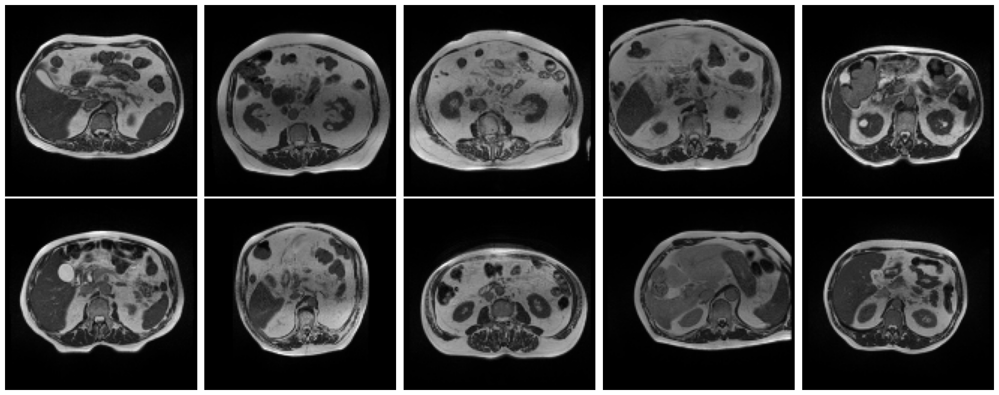

In [26]:
plt.figure(figsize=(20,8))
for i in range(10):
    axs = plt.subplot(2,5,i+1)
    plt.imshow(X_train[i], cmap="gray")
    plt.axis('off')
    axs.set_xticklabels([])
    axs.set_yticklabels([])
    plt.subplots_adjust(wspace=None, hspace=None)
plt.tight_layout()

# The Architecture

In [27]:
def build_generator():

    """
        Generator model "generates" images using random noise. The random noise AKA Latent Vector
        is sampled from a Normal Distribution which is given as the input to the Generator. Using
        Transposed Convolution, the latent vector is transformed to produce an image
        We use 3 Conv2DTranspose layers (which help in producing an image using features; opposite
        of Convolutional Learning)

        Input: Random Noise / Latent Vector
        Output: Image
    """

    model = Sequential([

        Dense(32*32*256, input_dim=NOISE_DIM),
        LeakyReLU(alpha=0.2),
        Reshape((32,32,256)),
        
        Conv2DTranspose(128, (4, 4), strides=2, padding='same'),
        LeakyReLU(alpha=0.2),

        Conv2DTranspose(128, (4, 4), strides=2, padding='same'),
        LeakyReLU(alpha=0.2),

        Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh')
    ], 
    name="generator")
    model.summary()
    model.compile(loss="binary_crossentropy", optimizer=OPTIMIZER)

    return model

In [28]:
def build_discriminator():
    
    """
        Discriminator is the model which is responsible for classifying the generated images
        as fake or real. Our end goal is to create a Generator so powerful that the Discriminator
        is unable to classify real and fake images
        A simple Convolutional Neural Network with 2 Conv2D layers connected to a Dense output layer
        Output layer activation is Sigmoid since this is a Binary Classifier

        Input: Generated / Real Image
        Output: Validity of Image (Fake or Real)

    """

    model = Sequential([

        Conv2D(64, (3, 3), padding='same', input_shape=(WIDTH, HEIGHT, CHANNELS)),
        LeakyReLU(alpha=0.2),

        Conv2D(128, (3, 3), strides=2, padding='same'),
        LeakyReLU(alpha=0.2),

        Conv2D(128, (3, 3), strides=2, padding='same'),
        LeakyReLU(alpha=0.2),
        
        Conv2D(256, (3, 3), strides=2, padding='same'),
        LeakyReLU(alpha=0.2),
        
        Flatten(),
        Dropout(0.4),
        Dense(1, activation="sigmoid", input_shape=(WIDTH, HEIGHT, CHANNELS))
    ], name="discriminator")
    model.summary()
    model.compile(loss="binary_crossentropy",
                        optimizer=OPTIMIZER)

    return model

# Putting it together

In [29]:
print('\n')
discriminator = build_discriminator()
print('\n')
generator = build_generator()

discriminator.trainable = False 

gan_input = Input(shape=(NOISE_DIM,))
fake_image = generator(gan_input)

gan_output = discriminator(fake_image)

gan = Model(gan_input, gan_output, name="gan_model")
gan.compile(loss="binary_crossentropy", optimizer=OPTIMIZER)

print("The Combined Network:\n")
gan.summary()



Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_5 (Conv2D)           (None, 128, 128, 64)      640       
                                                                 
 leaky_re_lu_7 (LeakyReLU)   (None, 128, 128, 64)      0         
                                                                 
 conv2d_6 (Conv2D)           (None, 64, 64, 128)       73856     
                                                                 
 leaky_re_lu_8 (LeakyReLU)   (None, 64, 64, 128)       0         
                                                                 
 conv2d_7 (Conv2D)           (None, 32, 32, 128)       147584    
                                                                 
 leaky_re_lu_9 (LeakyReLU)   (None, 32, 32, 128)       0         
                                                                 
 conv2d_8 (Conv2D)           (None, 16, 16, 256)   

In [30]:
def sample_images(noise, subplots, figsize=(22,8), save=False):
    generated_images = generator.predict(noise)
    plt.figure(figsize=figsize)
    
    for i, image in enumerate(generated_images):
        plt.subplot(subplots[0], subplots[1], i+1)
        if CHANNELS == 1:
            plt.imshow(image.reshape((WIDTH, HEIGHT)), cmap='gray')    
                                                                            
        else:
            plt.imshow(image.reshape((WIDTH, HEIGHT, CHANNELS)))
        if save == True:
            img_name = "gen" + str(i)
            plt.savefig(img_name)
        plt.subplots_adjust(wspace=None, hspace=None)
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

## The Training

  0%|                                                                                                                        | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 113ms/step


  0%|                                                                                                                | 1/3750 [00:00<54:43,  1.14it/s]

1/1 [==============================] - 0s 11ms/step


  0%|                                                                                                                | 2/3750 [00:00<26:42,  2.34it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 3/3750 [00:01<17:38,  3.54it/s]

1/1 [==============================] - 0s 10ms/step


  0%|                                                                                                                | 4/3750 [00:01<13:23,  4.66it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                                                                                               | 5/3750 [00:01<10:59,  5.68it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                                                                                               | 6/3750 [00:01<09:31,  6.55it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                                                                                               | 7/3750 [00:01<08:39,  7.21it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 8/3750 [00:01<08:03,  7.73it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                               | 9/3750 [00:01<07:40,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


  0%|▎                                                                                                              | 10/3750 [00:01<07:24,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                              | 11/3750 [00:01<07:11,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                              | 12/3750 [00:02<07:03,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 13/3750 [00:02<06:56,  8.98it/s]

1/1 [==============================] - 0s 12ms/step


  0%|▍                                                                                                              | 14/3750 [00:02<06:55,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 15/3750 [00:02<07:44,  8.04it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 16/3750 [00:02<07:29,  8.30it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▌                                                                                                              | 17/3750 [00:02<07:15,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▌                                                                                                              | 18/3750 [00:02<07:04,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 19/3750 [00:02<06:56,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 20/3750 [00:02<06:50,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 21/3750 [00:03<06:47,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▋                                                                                                              | 22/3750 [00:03<06:45,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▋                                                                                                              | 23/3750 [00:03<06:42,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 24/3750 [00:03<06:41,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▋                                                                                                              | 25/3750 [00:03<06:40,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 26/3750 [00:03<06:42,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▊                                                                                                              | 27/3750 [00:03<06:42,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▊                                                                                                              | 28/3750 [00:03<06:38,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▊                                                                                                              | 29/3750 [00:03<06:41,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 30/3750 [00:04<06:38,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▉                                                                                                              | 31/3750 [00:04<06:36,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 32/3750 [00:04<06:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▉                                                                                                              | 33/3750 [00:04<06:30,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 34/3750 [00:04<06:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█                                                                                                              | 35/3750 [00:04<06:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█                                                                                                              | 36/3750 [00:04<06:32,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 37/3750 [00:04<06:33,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 38/3750 [00:04<06:33,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


  1%|█▏                                                                                                             | 39/3750 [00:05<06:35,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


  1%|█▏                                                                                                             | 40/3750 [00:05<06:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 41/3750 [00:05<06:35,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▏                                                                                                             | 42/3750 [00:05<06:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 43/3750 [00:05<06:32,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 44/3750 [00:05<06:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 45/3750 [00:05<06:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 46/3750 [00:05<06:30,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 47/3750 [00:05<06:29,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 48/3750 [00:05<06:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 49/3750 [00:06<06:29,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 50/3750 [00:06<06:28,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 51/3750 [00:06<06:28,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 52/3750 [00:06<06:29,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 53/3750 [00:06<06:27,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 54/3750 [00:06<06:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▋                                                                                                             | 55/3750 [00:06<06:27,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▋                                                                                                             | 56/3750 [00:06<06:26,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▋                                                                                                             | 57/3750 [00:06<06:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▋                                                                                                             | 58/3750 [00:07<06:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▋                                                                                                             | 59/3750 [00:07<06:26,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 60/3750 [00:07<06:25,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 61/3750 [00:07<06:26,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 62/3750 [00:07<06:25,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 63/3750 [00:07<06:27,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 64/3750 [00:07<06:27,  9.52it/s]

1/1 [==============================] - 0s 10ms/step


  2%|█▉                                                                                                             | 65/3750 [00:07<06:29,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 66/3750 [00:07<06:28,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▉                                                                                                             | 67/3750 [00:07<06:26,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 68/3750 [00:08<06:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██                                                                                                             | 69/3750 [00:08<06:25,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 70/3750 [00:08<06:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██                                                                                                             | 71/3750 [00:08<06:25,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 72/3750 [00:08<06:26,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▏                                                                                                            | 73/3750 [00:08<06:25,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▏                                                                                                            | 74/3750 [00:08<06:26,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▏                                                                                                            | 75/3750 [00:08<06:25,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▏                                                                                                            | 76/3750 [00:08<06:24,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▎                                                                                                            | 77/3750 [00:09<06:24,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▎                                                                                                            | 78/3750 [00:09<06:23,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 79/3750 [00:09<06:23,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▎                                                                                                            | 80/3750 [00:09<06:23,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 81/3750 [00:09<06:25,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▍                                                                                                            | 82/3750 [00:09<06:24,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▍                                                                                                            | 83/3750 [00:09<06:24,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▍                                                                                                            | 84/3750 [00:09<06:24,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▌                                                                                                            | 85/3750 [00:09<06:23,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 86/3750 [00:09<06:24,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▌                                                                                                            | 87/3750 [00:10<06:22,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 88/3750 [00:10<06:23,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▋                                                                                                            | 89/3750 [00:10<06:22,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▋                                                                                                            | 90/3750 [00:10<06:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▋                                                                                                            | 91/3750 [00:10<06:23,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 92/3750 [00:10<06:23,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▊                                                                                                            | 93/3750 [00:10<06:22,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▊                                                                                                            | 94/3750 [00:10<06:22,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▊                                                                                                            | 95/3750 [00:10<06:22,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▊                                                                                                            | 96/3750 [00:10<06:22,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 97/3750 [00:11<06:21,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▉                                                                                                            | 98/3750 [00:11<06:21,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▉                                                                                                            | 99/3750 [00:11<06:23,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▉                                                                                                           | 100/3750 [00:11<06:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▉                                                                                                           | 101/3750 [00:11<06:22,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▉                                                                                                           | 102/3750 [00:11<06:22,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 103/3750 [00:11<06:22,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███                                                                                                           | 104/3750 [00:11<06:20,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 105/3750 [00:11<06:20,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███                                                                                                           | 106/3750 [00:12<06:20,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▏                                                                                                          | 107/3750 [00:12<06:20,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▏                                                                                                          | 108/3750 [00:12<06:22,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▏                                                                                                          | 109/3750 [00:12<06:22,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▏                                                                                                          | 110/3750 [00:12<06:21,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 111/3750 [00:12<06:19,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 112/3750 [00:12<06:20,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 113/3750 [00:12<06:20,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 114/3750 [00:12<06:20,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 115/3750 [00:12<06:19,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▍                                                                                                          | 116/3750 [00:13<06:19,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▍                                                                                                          | 117/3750 [00:13<06:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 118/3750 [00:13<06:25,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 119/3750 [00:13<06:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▌                                                                                                          | 120/3750 [00:13<06:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▌                                                                                                          | 121/3750 [00:13<06:21,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▌                                                                                                          | 122/3750 [00:13<06:20,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▌                                                                                                          | 123/3750 [00:13<06:19,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▋                                                                                                          | 124/3750 [00:13<06:17,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▋                                                                                                          | 125/3750 [00:14<06:17,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▋                                                                                                          | 126/3750 [00:14<06:19,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▋                                                                                                          | 127/3750 [00:14<06:22,  9.48it/s]

1/1 [==============================] - 0s 18ms/step


  3%|███▊                                                                                                          | 128/3750 [00:14<06:43,  8.98it/s]

1/1 [==============================] - 0s 11ms/step


  3%|███▊                                                                                                          | 129/3750 [00:14<06:46,  8.91it/s]

1/1 [==============================] - 0s 15ms/step


  3%|███▊                                                                                                          | 130/3750 [00:14<06:53,  8.76it/s]

1/1 [==============================] - 0s 16ms/step


  3%|███▊                                                                                                          | 131/3750 [00:14<06:56,  8.69it/s]

1/1 [==============================] - 0s 18ms/step


  4%|███▊                                                                                                          | 132/3750 [00:14<07:07,  8.47it/s]

1/1 [==============================] - 0s 13ms/step


  4%|███▉                                                                                                          | 133/3750 [00:14<06:57,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 134/3750 [00:15<06:56,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 135/3750 [00:15<07:08,  8.43it/s]

1/1 [==============================] - 0s 10ms/step


  4%|███▉                                                                                                          | 136/3750 [00:15<07:10,  8.39it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████                                                                                                          | 137/3750 [00:15<06:55,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 138/3750 [00:15<06:44,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████                                                                                                          | 139/3750 [00:15<06:36,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████                                                                                                          | 140/3750 [00:15<06:29,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 141/3750 [00:15<06:26,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 142/3750 [00:15<06:24,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 143/3750 [00:16<06:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 144/3750 [00:16<06:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▎                                                                                                         | 145/3750 [00:16<06:20,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▎                                                                                                         | 146/3750 [00:16<06:56,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 147/3750 [00:16<06:52,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 148/3750 [00:16<06:47,  8.83it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▎                                                                                                         | 149/3750 [00:16<06:38,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 150/3750 [00:16<06:31,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 151/3750 [00:16<06:26,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 152/3750 [00:17<06:23,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 153/3750 [00:17<06:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▌                                                                                                         | 154/3750 [00:17<06:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▌                                                                                                         | 155/3750 [00:17<06:20,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 156/3750 [00:17<06:19,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▌                                                                                                         | 157/3750 [00:17<06:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▋                                                                                                         | 158/3750 [00:17<06:16,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▋                                                                                                         | 159/3750 [00:17<06:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▋                                                                                                         | 160/3750 [00:17<06:14,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▋                                                                                                         | 161/3750 [00:17<06:14,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 162/3750 [00:18<06:15,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 163/3750 [00:18<06:15,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 164/3750 [00:18<06:14,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 165/3750 [00:18<06:14,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 166/3750 [00:18<06:13,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▉                                                                                                         | 167/3750 [00:18<06:13,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▉                                                                                                         | 168/3750 [00:18<06:13,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  5%|████▉                                                                                                         | 169/3750 [00:18<06:12,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  5%|████▉                                                                                                         | 170/3750 [00:18<06:21,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████                                                                                                         | 171/3750 [00:19<06:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████                                                                                                         | 172/3750 [00:19<06:18,  9.45it/s]

1/1 [==============================] - 0s 20ms/step


  5%|█████                                                                                                         | 173/3750 [00:19<06:30,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████                                                                                                         | 174/3750 [00:19<06:26,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 175/3750 [00:19<06:25,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▏                                                                                                        | 176/3750 [00:19<06:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 177/3750 [00:19<06:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▏                                                                                                        | 178/3750 [00:19<06:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 179/3750 [00:19<06:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 180/3750 [00:19<06:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 181/3750 [00:20<06:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 182/3750 [00:20<06:16,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 183/3750 [00:20<06:18,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 184/3750 [00:20<06:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 185/3750 [00:20<06:14,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 186/3750 [00:20<06:14,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 187/3750 [00:20<06:13,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 188/3750 [00:20<06:13,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 189/3750 [00:20<06:12,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 190/3750 [00:21<06:13,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 191/3750 [00:21<06:12,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▋                                                                                                        | 192/3750 [00:21<06:12,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▋                                                                                                        | 193/3750 [00:21<06:12,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▋                                                                                                        | 194/3750 [00:21<06:11,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▋                                                                                                        | 195/3750 [00:21<06:10,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▋                                                                                                        | 196/3750 [00:21<06:10,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▊                                                                                                        | 197/3750 [00:21<06:10,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▊                                                                                                        | 198/3750 [00:21<06:17,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▊                                                                                                        | 199/3750 [00:21<06:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▊                                                                                                        | 200/3750 [00:22<06:14,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 201/3750 [00:22<06:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▉                                                                                                        | 202/3750 [00:22<06:12,  9.53it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█████▉                                                                                                        | 203/3750 [00:22<06:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▉                                                                                                        | 204/3750 [00:22<06:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██████                                                                                                        | 205/3750 [00:22<06:12,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██████                                                                                                        | 206/3750 [00:22<06:10,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████                                                                                                        | 207/3750 [00:22<06:10,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████                                                                                                        | 208/3750 [00:22<06:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 209/3750 [00:23<06:11,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 210/3750 [00:23<06:11,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 211/3750 [00:23<06:10,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 212/3750 [00:23<06:10,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 213/3750 [00:23<06:10,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 214/3750 [00:23<06:09,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 215/3750 [00:23<06:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 216/3750 [00:23<06:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 217/3750 [00:23<06:14,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 218/3750 [00:23<06:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 219/3750 [00:24<06:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 220/3750 [00:24<06:11,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 221/3750 [00:24<06:10,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 222/3750 [00:24<06:10,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 223/3750 [00:24<06:09,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 224/3750 [00:24<06:09,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 225/3750 [00:24<06:09,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▋                                                                                                       | 226/3750 [00:24<06:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▋                                                                                                       | 227/3750 [00:24<06:09,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▋                                                                                                       | 228/3750 [00:25<06:08,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▋                                                                                                       | 229/3750 [00:25<06:08,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▋                                                                                                       | 230/3750 [00:25<06:08,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▊                                                                                                       | 231/3750 [00:25<06:06,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▊                                                                                                       | 232/3750 [00:25<06:07,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▊                                                                                                       | 233/3750 [00:25<06:06,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▊                                                                                                       | 234/3750 [00:25<06:06,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 235/3750 [00:25<06:08,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 236/3750 [00:25<06:07,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 237/3750 [00:25<06:08,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 238/3750 [00:26<06:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 239/3750 [00:26<06:10,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 240/3750 [00:26<06:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 241/3750 [00:26<06:08,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 242/3750 [00:26<06:08,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████▏                                                                                                      | 243/3750 [00:26<06:07,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 244/3750 [00:26<06:08,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▏                                                                                                      | 245/3750 [00:26<06:08,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▏                                                                                                      | 246/3750 [00:26<06:08,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▏                                                                                                      | 247/3750 [00:27<06:07,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▎                                                                                                      | 248/3750 [00:27<06:06,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▎                                                                                                      | 249/3750 [00:27<06:06,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▎                                                                                                      | 250/3750 [00:27<06:06,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▎                                                                                                      | 251/3750 [00:27<06:06,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▍                                                                                                      | 252/3750 [00:27<06:05,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▍                                                                                                      | 253/3750 [00:27<06:07,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▍                                                                                                      | 254/3750 [00:27<06:07,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 255/3750 [00:27<06:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▌                                                                                                      | 256/3750 [00:27<06:07,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▌                                                                                                      | 257/3750 [00:28<06:06,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▌                                                                                                      | 258/3750 [00:28<06:05,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▌                                                                                                      | 259/3750 [00:28<06:06,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 260/3750 [00:28<06:06,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 261/3750 [00:28<06:05,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 262/3750 [00:28<06:12,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 263/3750 [00:28<06:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 264/3750 [00:28<06:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▊                                                                                                      | 265/3750 [00:28<06:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▊                                                                                                      | 266/3750 [00:29<06:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▊                                                                                                      | 267/3750 [00:29<06:05,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▊                                                                                                      | 268/3750 [00:29<06:04,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▉                                                                                                      | 269/3750 [00:29<06:04,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▉                                                                                                      | 270/3750 [00:29<06:04,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▉                                                                                                      | 271/3750 [00:29<06:06,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▉                                                                                                      | 272/3750 [00:29<06:05,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 273/3750 [00:29<06:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 274/3750 [00:29<06:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████                                                                                                      | 275/3750 [00:29<06:04,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████                                                                                                      | 276/3750 [00:30<06:04,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████▏                                                                                                     | 277/3750 [00:30<06:05,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 278/3750 [00:30<06:05,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████▏                                                                                                     | 279/3750 [00:30<06:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████▏                                                                                                     | 280/3750 [00:30<06:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████▏                                                                                                     | 281/3750 [00:30<06:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▎                                                                                                     | 282/3750 [00:30<06:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▎                                                                                                     | 283/3750 [00:30<06:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▎                                                                                                     | 284/3750 [00:30<06:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▎                                                                                                     | 285/3750 [00:31<06:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▍                                                                                                     | 286/3750 [00:31<06:04,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▍                                                                                                     | 287/3750 [00:31<06:03,  9.53it/s]

1/1 [==============================] - 0s 10ms/step


  8%|████████▍                                                                                                     | 288/3750 [00:31<06:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▍                                                                                                     | 289/3750 [00:31<06:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 290/3750 [00:31<06:03,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 291/3750 [00:31<06:02,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 292/3750 [00:31<06:02,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 293/3750 [00:31<06:02,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 294/3750 [00:31<06:01,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▋                                                                                                     | 295/3750 [00:32<06:00,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▋                                                                                                     | 296/3750 [00:32<06:00,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▋                                                                                                     | 297/3750 [00:32<06:00,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▋                                                                                                     | 298/3750 [00:32<06:01,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▊                                                                                                     | 299/3750 [00:32<06:01,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▊                                                                                                     | 300/3750 [00:32<06:00,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▊                                                                                                     | 301/3750 [00:32<06:00,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 302/3750 [00:32<06:00,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 303/3750 [00:32<06:01,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 304/3750 [00:33<06:00,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 305/3750 [00:33<06:00,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 306/3750 [00:33<06:00,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████                                                                                                     | 307/3750 [00:33<06:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████                                                                                                     | 308/3750 [00:33<06:00,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 309/3750 [00:33<06:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████                                                                                                     | 310/3750 [00:33<06:02,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 311/3750 [00:33<06:02,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 312/3750 [00:33<06:00,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 313/3750 [00:33<06:00,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 314/3750 [00:34<05:59,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 315/3750 [00:34<05:59,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▎                                                                                                    | 316/3750 [00:34<06:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▎                                                                                                    | 317/3750 [00:34<05:59,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▎                                                                                                    | 318/3750 [00:34<05:59,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▎                                                                                                    | 319/3750 [00:34<05:58,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 320/3750 [00:34<05:57,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 321/3750 [00:34<05:57,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 322/3750 [00:34<05:58,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 323/3750 [00:35<05:57,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 324/3750 [00:35<05:56,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 325/3750 [00:35<05:59,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 326/3750 [00:35<05:58,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 327/3750 [00:35<05:58,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 328/3750 [00:35<05:58,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 329/3750 [00:35<05:59,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 330/3750 [00:35<05:58,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 331/3750 [00:35<05:59,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 332/3750 [00:35<05:58,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▊                                                                                                    | 333/3750 [00:36<05:57,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▊                                                                                                    | 334/3750 [00:36<05:59,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▊                                                                                                    | 335/3750 [00:36<05:58,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▊                                                                                                    | 336/3750 [00:36<05:58,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▉                                                                                                    | 337/3750 [00:36<05:57,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▉                                                                                                    | 338/3750 [00:36<05:56,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▉                                                                                                    | 339/3750 [00:36<05:55,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▉                                                                                                    | 340/3750 [00:36<05:55,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 341/3750 [00:36<05:55,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 342/3750 [00:36<05:55,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 343/3750 [00:37<05:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 344/3750 [00:37<05:56,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 345/3750 [00:37<05:58,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 346/3750 [00:37<06:03,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▏                                                                                                   | 347/3750 [00:37<06:00,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▏                                                                                                   | 348/3750 [00:37<05:58,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 349/3750 [00:37<05:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 350/3750 [00:37<05:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 351/3750 [00:37<05:56,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▎                                                                                                   | 352/3750 [00:38<05:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 353/3750 [00:38<05:58,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▍                                                                                                   | 354/3750 [00:38<05:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▍                                                                                                   | 355/3750 [00:38<05:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▍                                                                                                   | 356/3750 [00:38<05:54,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▍                                                                                                   | 357/3750 [00:38<05:54,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 358/3750 [00:38<05:53,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 359/3750 [00:38<05:53,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 360/3750 [00:38<05:53,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 361/3750 [00:38<05:55,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▌                                                                                                   | 362/3750 [00:39<05:55,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▋                                                                                                   | 363/3750 [00:39<05:54,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▋                                                                                                   | 364/3750 [00:39<05:53,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▋                                                                                                   | 365/3750 [00:39<05:53,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 366/3750 [00:39<05:55,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 367/3750 [00:39<05:55,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 368/3750 [00:39<05:56,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▊                                                                                                   | 369/3750 [00:39<05:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 370/3750 [00:39<05:54,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▉                                                                                                   | 371/3750 [00:40<05:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▉                                                                                                   | 372/3750 [00:40<05:54,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▉                                                                                                   | 373/3750 [00:40<05:53,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▉                                                                                                   | 374/3750 [00:40<05:53,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 375/3750 [00:40<05:52,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 376/3750 [00:40<05:51,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 377/3750 [00:40<05:51,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 378/3750 [00:40<05:52,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 379/3750 [00:40<05:52,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 380/3750 [00:40<05:53,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 381/3750 [00:41<05:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 382/3750 [00:41<05:52,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 383/3750 [00:41<05:52,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 384/3750 [00:41<05:52,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 385/3750 [00:41<05:51,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 386/3750 [00:41<05:51,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 387/3750 [00:41<05:50,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 388/3750 [00:41<05:50,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 389/3750 [00:41<05:51,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 390/3750 [00:42<05:51,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 391/3750 [00:42<05:51,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 392/3750 [00:42<05:51,  9.56it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███████████▌                                                                                                  | 393/3750 [00:42<05:53,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▌                                                                                                  | 394/3750 [00:42<05:52,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▌                                                                                                  | 395/3750 [00:42<05:51,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▌                                                                                                  | 396/3750 [00:42<05:50,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 397/3750 [00:42<05:50,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 398/3750 [00:42<05:52,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 399/3750 [00:42<05:51,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 400/3750 [00:43<05:51,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 401/3750 [00:43<05:50,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 402/3750 [00:43<05:57,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 403/3750 [00:43<05:56,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 404/3750 [00:43<05:54,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 405/3750 [00:43<05:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 406/3750 [00:43<05:51,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 407/3750 [00:43<05:53,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 408/3750 [00:43<05:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 409/3750 [00:44<05:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 410/3750 [00:44<05:50,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 411/3750 [00:44<05:49,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 412/3750 [00:44<05:50,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 413/3750 [00:44<05:52,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 414/3750 [00:44<05:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 415/3750 [00:44<05:50,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 416/3750 [00:44<05:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 417/3750 [00:44<05:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 418/3750 [00:44<05:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 419/3750 [00:45<05:49,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 420/3750 [00:45<05:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 421/3750 [00:45<05:49,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 422/3750 [00:45<05:53,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 423/3750 [00:45<05:51,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 424/3750 [00:45<05:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 425/3750 [00:45<05:52,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 426/3750 [00:45<05:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▌                                                                                                 | 427/3750 [00:45<05:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▌                                                                                                 | 428/3750 [00:46<05:48,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▌                                                                                                 | 429/3750 [00:46<05:48,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▌                                                                                                 | 430/3750 [00:46<05:47,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▋                                                                                                 | 431/3750 [00:46<05:47,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▋                                                                                                 | 432/3750 [00:46<05:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▋                                                                                                 | 433/3750 [00:46<05:46,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▋                                                                                                 | 434/3750 [00:46<05:48,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▊                                                                                                 | 435/3750 [00:46<05:47,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▊                                                                                                 | 436/3750 [00:46<05:47,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▊                                                                                                 | 437/3750 [00:46<05:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▊                                                                                                 | 438/3750 [00:47<05:51,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 439/3750 [00:47<05:50,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 440/3750 [00:47<05:50,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 441/3750 [00:47<05:49,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 442/3750 [00:47<05:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 443/3750 [00:47<05:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████                                                                                                 | 444/3750 [00:47<05:48,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████                                                                                                 | 445/3750 [00:47<05:47,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 446/3750 [00:47<05:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████                                                                                                 | 447/3750 [00:48<05:46,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 448/3750 [00:48<05:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 449/3750 [00:48<05:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 450/3750 [00:48<05:46,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 451/3750 [00:48<05:45,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 452/3750 [00:48<05:46,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 453/3750 [00:48<05:46,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 454/3750 [00:48<05:46,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 455/3750 [00:48<05:45,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▍                                                                                                | 456/3750 [00:48<05:45,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▍                                                                                                | 457/3750 [00:49<05:44,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▍                                                                                                | 458/3750 [00:49<05:44,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 459/3750 [00:49<05:44,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▍                                                                                                | 460/3750 [00:49<05:44,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 461/3750 [00:49<05:49,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 462/3750 [00:49<05:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 463/3750 [00:49<05:47,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 464/3750 [00:49<05:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▋                                                                                                | 465/3750 [00:49<05:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▋                                                                                                | 466/3750 [00:50<05:44,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▋                                                                                                | 467/3750 [00:50<05:44,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▋                                                                                                | 468/3750 [00:50<05:43,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 469/3750 [00:50<05:42,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 470/3750 [00:50<05:42,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 471/3750 [00:50<05:44,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 472/3750 [00:50<05:44,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 473/3750 [00:50<05:43,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▉                                                                                                | 474/3750 [00:50<05:42,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▉                                                                                                | 475/3750 [00:50<05:42,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 476/3750 [00:51<05:42,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 477/3750 [00:51<05:43,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████                                                                                                | 478/3750 [00:51<05:42,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████                                                                                                | 479/3750 [00:51<05:42,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████                                                                                                | 480/3750 [00:51<05:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████                                                                                                | 481/3750 [00:51<05:43,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▏                                                                                               | 482/3750 [00:51<05:43,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▏                                                                                               | 483/3750 [00:51<05:42,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▏                                                                                               | 484/3750 [00:51<05:41,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▏                                                                                               | 485/3750 [00:52<05:40,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 486/3750 [00:52<05:40,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 487/3750 [00:52<05:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 488/3750 [00:52<05:43,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 489/3750 [00:52<05:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 490/3750 [00:52<05:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 491/3750 [00:52<05:42,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 492/3750 [00:52<05:41,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 493/3750 [00:52<05:40,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 494/3750 [00:52<05:40,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 495/3750 [00:53<05:40,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 496/3750 [00:53<05:39,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 497/3750 [00:53<05:38,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 498/3750 [00:53<05:42,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▋                                                                                               | 499/3750 [00:53<05:46,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 500/3750 [00:53<05:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 501/3750 [00:53<05:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 502/3750 [00:53<05:41,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▊                                                                                               | 503/3750 [00:53<05:41,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 504/3750 [00:54<05:40,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 505/3750 [00:54<05:41,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▊                                                                                               | 506/3750 [00:54<05:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▊                                                                                               | 507/3750 [00:54<05:39,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▉                                                                                               | 508/3750 [00:54<05:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▉                                                                                               | 509/3750 [00:54<05:40,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 510/3750 [00:54<05:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▉                                                                                               | 511/3750 [00:54<05:39,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████                                                                                               | 512/3750 [00:54<05:38,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████                                                                                               | 513/3750 [00:54<05:38,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 514/3750 [00:55<05:38,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████                                                                                               | 515/3750 [00:55<05:38,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 516/3750 [00:55<05:38,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 517/3750 [00:55<05:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 518/3750 [00:55<05:44,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 519/3750 [00:55<05:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 520/3750 [00:55<05:41,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 521/3750 [00:55<05:40,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 522/3750 [00:55<05:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 523/3750 [00:56<05:39,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 524/3750 [00:56<05:38,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 525/3750 [00:56<05:38,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 526/3750 [00:56<05:40,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 527/3750 [00:56<05:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 528/3750 [00:56<05:38,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 529/3750 [00:56<05:38,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 530/3750 [00:56<05:38,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 531/3750 [00:56<05:38,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 532/3750 [00:56<05:36,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 533/3750 [00:57<05:35,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 534/3750 [00:57<05:35,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 535/3750 [00:57<05:36,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 536/3750 [00:57<05:36,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 537/3750 [00:57<05:35,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 538/3750 [00:57<05:35,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 539/3750 [00:57<05:36,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 540/3750 [00:57<05:37,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 541/3750 [00:57<05:37,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▉                                                                                              | 542/3750 [00:58<05:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▉                                                                                              | 543/3750 [00:58<05:36,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 15%|███████████████▉                                                                                              | 544/3750 [00:58<05:38,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 15%|███████████████▉                                                                                              | 545/3750 [00:58<05:38,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 546/3750 [00:58<05:38,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 547/3750 [00:58<05:38,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 548/3750 [00:58<05:37,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 549/3750 [00:58<05:37,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 550/3750 [00:58<05:36,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 551/3750 [00:58<05:36,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 552/3750 [00:59<05:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 553/3750 [00:59<05:38,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 554/3750 [00:59<05:37,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 555/3750 [00:59<05:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 556/3750 [00:59<05:35,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 557/3750 [00:59<05:35,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 558/3750 [00:59<05:34,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 559/3750 [00:59<05:35,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 560/3750 [00:59<05:35,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 561/3750 [00:59<05:33,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 562/3750 [01:00<05:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 563/3750 [01:00<05:34,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 564/3750 [01:00<05:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 565/3750 [01:00<05:34,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 566/3750 [01:00<05:34,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 567/3750 [01:00<05:34,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 568/3750 [01:00<05:36,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 569/3750 [01:00<05:38,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 570/3750 [01:00<05:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 571/3750 [01:01<05:43,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 572/3750 [01:01<05:55,  8.94it/s]

1/1 [==============================] - 0s 12ms/step


 15%|████████████████▊                                                                                             | 573/3750 [01:01<05:53,  8.99it/s]

1/1 [==============================] - 0s 18ms/step


 15%|████████████████▊                                                                                             | 574/3750 [01:01<05:56,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 575/3750 [01:01<06:06,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 576/3750 [01:01<06:13,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 577/3750 [01:01<06:01,  8.78it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▉                                                                                             | 578/3750 [01:01<05:52,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 579/3750 [01:01<05:46,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████████████████                                                                                             | 580/3750 [01:02<05:43,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████████████████                                                                                             | 581/3750 [01:02<05:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████                                                                                             | 582/3750 [01:02<05:39,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████                                                                                             | 583/3750 [01:02<05:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 584/3750 [01:02<05:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 585/3750 [01:02<05:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 586/3750 [01:02<05:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 587/3750 [01:02<05:55,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 588/3750 [01:02<05:51,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 589/3750 [01:03<05:45,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 590/3750 [01:03<05:43,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▎                                                                                            | 591/3750 [01:03<05:40,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 592/3750 [01:03<05:37,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 593/3750 [01:03<05:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 594/3750 [01:03<05:33,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▍                                                                                            | 595/3750 [01:03<05:33,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 596/3750 [01:03<05:31,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 597/3750 [01:03<05:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 598/3750 [01:03<05:30,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 599/3750 [01:04<05:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 600/3750 [01:04<05:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 601/3750 [01:04<05:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 602/3750 [01:04<05:31,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 603/3750 [01:04<05:39,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 604/3750 [01:04<05:36,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 605/3750 [01:04<05:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 606/3750 [01:04<05:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 607/3750 [01:04<05:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 608/3750 [01:05<05:30,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 609/3750 [01:05<05:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 610/3750 [01:05<05:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 611/3750 [01:05<05:29,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 612/3750 [01:05<05:29,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 613/3750 [01:05<05:28,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 614/3750 [01:05<05:30,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████████████████                                                                                            | 615/3750 [01:05<05:32,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 616/3750 [01:05<05:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 617/3750 [01:06<05:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████▏                                                                                           | 618/3750 [01:06<05:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 619/3750 [01:06<05:33,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 620/3750 [01:06<05:32,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▏                                                                                           | 621/3750 [01:06<05:31,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▏                                                                                           | 622/3750 [01:06<05:29,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 623/3750 [01:06<05:29,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 624/3750 [01:06<05:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 625/3750 [01:06<05:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 626/3750 [01:06<05:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 627/3750 [01:07<05:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 628/3750 [01:07<05:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 629/3750 [01:07<05:29,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 630/3750 [01:07<05:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 631/3750 [01:07<05:31,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▌                                                                                           | 632/3750 [01:07<05:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▌                                                                                           | 633/3750 [01:07<05:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▌                                                                                           | 634/3750 [01:07<05:27,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 635/3750 [01:07<05:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 636/3750 [01:08<05:28,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 637/3750 [01:08<05:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 638/3750 [01:08<05:26,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 639/3750 [01:08<05:26,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 640/3750 [01:08<05:26,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 641/3750 [01:08<05:26,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 642/3750 [01:08<05:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 643/3750 [01:08<05:25,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 644/3750 [01:08<05:25,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▉                                                                                           | 645/3750 [01:08<05:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 646/3750 [01:09<05:26,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 647/3750 [01:09<05:25,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 648/3750 [01:09<05:25,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 649/3750 [01:09<05:25,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 650/3750 [01:09<05:25,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 651/3750 [01:09<05:29,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 652/3750 [01:09<05:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 653/3750 [01:09<05:26,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 654/3750 [01:09<05:27,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 655/3750 [01:10<05:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 656/3750 [01:10<05:25,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 657/3750 [01:10<05:26,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 658/3750 [01:10<05:26,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 659/3750 [01:10<05:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▎                                                                                          | 660/3750 [01:10<05:26,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▍                                                                                          | 661/3750 [01:10<05:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▍                                                                                          | 662/3750 [01:10<05:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▍                                                                                          | 663/3750 [01:10<05:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▍                                                                                          | 664/3750 [01:10<05:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 665/3750 [01:11<05:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 666/3750 [01:11<05:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 667/3750 [01:11<05:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 668/3750 [01:11<05:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 669/3750 [01:11<05:23,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▋                                                                                          | 670/3750 [01:11<05:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▋                                                                                          | 671/3750 [01:11<05:22,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 672/3750 [01:11<05:27,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▋                                                                                          | 673/3750 [01:11<05:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▊                                                                                          | 674/3750 [01:12<05:26,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▊                                                                                          | 675/3750 [01:12<05:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 676/3750 [01:12<05:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▊                                                                                          | 677/3750 [01:12<05:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▉                                                                                          | 678/3750 [01:12<05:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▉                                                                                          | 679/3750 [01:12<05:22,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 680/3750 [01:12<05:22,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▉                                                                                          | 681/3750 [01:12<05:22,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 682/3750 [01:12<05:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 683/3750 [01:12<05:31,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 684/3750 [01:13<05:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 685/3750 [01:13<05:27,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 686/3750 [01:13<05:24,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▏                                                                                         | 687/3750 [01:13<05:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▏                                                                                         | 688/3750 [01:13<05:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▏                                                                                         | 689/3750 [01:13<05:21,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 690/3750 [01:13<05:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▎                                                                                         | 691/3750 [01:13<05:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 692/3750 [01:13<05:22,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▎                                                                                         | 693/3750 [01:14<05:22,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▎                                                                                         | 694/3750 [01:14<05:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▍                                                                                         | 695/3750 [01:14<05:23,  9.45it/s]

1/1 [==============================] - 0s 11ms/step


 19%|████████████████████▍                                                                                         | 696/3750 [01:14<05:29,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 697/3750 [01:14<05:30,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 698/3750 [01:14<05:30,  9.25it/s]

1/1 [==============================] - 0s 13ms/step


 19%|████████████████████▌                                                                                         | 699/3750 [01:14<05:46,  8.80it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▌                                                                                         | 700/3750 [01:14<05:41,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 701/3750 [01:14<05:36,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 702/3750 [01:15<05:32,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 703/3750 [01:15<05:29,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▋                                                                                         | 704/3750 [01:15<05:26,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▋                                                                                         | 705/3750 [01:15<05:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▋                                                                                         | 706/3750 [01:15<05:27,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 707/3750 [01:15<05:25,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▊                                                                                         | 708/3750 [01:15<05:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 709/3750 [01:15<05:22,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▊                                                                                         | 710/3750 [01:15<05:23,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▊                                                                                         | 711/3750 [01:15<05:22,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▉                                                                                         | 712/3750 [01:16<05:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 713/3750 [01:16<05:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 714/3750 [01:16<05:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 715/3750 [01:16<05:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 716/3750 [01:16<05:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 717/3750 [01:16<05:18,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 718/3750 [01:16<05:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 719/3750 [01:16<05:20,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 720/3750 [01:16<05:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▏                                                                                        | 721/3750 [01:17<05:19,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 722/3750 [01:17<05:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▏                                                                                        | 723/3750 [01:17<05:18,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 724/3750 [01:17<05:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 725/3750 [01:17<05:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 726/3750 [01:17<05:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 727/3750 [01:17<05:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 728/3750 [01:17<05:19,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 19%|█████████████████████▍                                                                                        | 729/3750 [01:18<11:54,  4.23it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▍                                                                                        | 730/3750 [01:18<09:56,  5.07it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▍                                                                                        | 731/3750 [01:18<08:35,  5.86it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▍                                                                                        | 732/3750 [01:18<07:36,  6.61it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 733/3750 [01:18<06:56,  7.25it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 734/3750 [01:18<06:27,  7.78it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▌                                                                                        | 735/3750 [01:18<06:06,  8.23it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▌                                                                                        | 736/3750 [01:19<05:50,  8.60it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▌                                                                                        | 737/3750 [01:19<05:41,  8.83it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 738/3750 [01:19<05:33,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▋                                                                                        | 739/3750 [01:19<05:29,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▋                                                                                        | 740/3750 [01:19<05:25,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▋                                                                                        | 741/3750 [01:19<05:24,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 742/3750 [01:19<05:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 743/3750 [01:19<05:18,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 744/3750 [01:19<05:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 745/3750 [01:19<05:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 746/3750 [01:20<05:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 747/3750 [01:20<05:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 748/3750 [01:20<05:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 749/3750 [01:20<05:15,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 750/3750 [01:20<05:15,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 751/3750 [01:20<05:15,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 752/3750 [01:20<05:15,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 753/3750 [01:20<05:13,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 754/3750 [01:20<05:13,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 755/3750 [01:21<05:14,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 756/3750 [01:21<05:15,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 757/3750 [01:21<05:15,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 758/3750 [01:21<05:15,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▎                                                                                       | 759/3750 [01:21<05:22,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 760/3750 [01:21<05:20,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 761/3750 [01:21<05:17,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▎                                                                                       | 762/3750 [01:21<05:16,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 763/3750 [01:21<05:15,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 764/3750 [01:22<05:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 765/3750 [01:22<05:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 766/3750 [01:22<05:16,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 767/3750 [01:22<05:15,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▌                                                                                       | 768/3750 [01:22<05:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▌                                                                                       | 769/3750 [01:22<05:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▌                                                                                       | 770/3750 [01:22<05:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▌                                                                                       | 771/3750 [01:22<05:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▋                                                                                       | 772/3750 [01:22<05:14,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 773/3750 [01:22<05:15,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 774/3750 [01:23<05:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 775/3750 [01:23<05:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▊                                                                                       | 776/3750 [01:23<05:13,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 777/3750 [01:23<05:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▊                                                                                       | 778/3750 [01:23<05:12,  9.53it/s]

1/1 [==============================] - 0s 10ms/step


 21%|██████████████████████▊                                                                                       | 779/3750 [01:23<05:13,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 780/3750 [01:23<05:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 781/3750 [01:23<05:12,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 782/3750 [01:23<05:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 783/3750 [01:24<05:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 784/3750 [01:24<05:13,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 785/3750 [01:24<05:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████                                                                                       | 786/3750 [01:24<05:11,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████                                                                                       | 787/3750 [01:24<05:11,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████                                                                                       | 788/3750 [01:24<05:10,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 789/3750 [01:24<05:09,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▏                                                                                      | 790/3750 [01:24<05:09,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 791/3750 [01:24<05:11,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 792/3750 [01:24<05:11,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 793/3750 [01:25<05:12,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 794/3750 [01:25<05:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▎                                                                                      | 795/3750 [01:25<05:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▎                                                                                      | 796/3750 [01:25<05:10,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 797/3750 [01:25<05:10,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 798/3750 [01:25<05:11,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 799/3750 [01:25<05:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 800/3750 [01:25<05:15,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 21%|███████████████████████▍                                                                                      | 801/3750 [01:25<05:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 802/3750 [01:26<05:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 803/3750 [01:26<05:13,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 804/3750 [01:26<05:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 805/3750 [01:26<05:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▋                                                                                      | 806/3750 [01:26<05:11,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▋                                                                                      | 807/3750 [01:26<05:10,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 808/3750 [01:26<05:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▋                                                                                      | 809/3750 [01:26<05:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▊                                                                                      | 810/3750 [01:26<05:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▊                                                                                      | 811/3750 [01:26<05:09,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 812/3750 [01:27<05:09,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 813/3750 [01:27<05:09,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 814/3750 [01:27<05:08,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 815/3750 [01:27<05:08,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 816/3750 [01:27<05:07,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 817/3750 [01:27<05:07,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 818/3750 [01:27<05:07,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 819/3750 [01:27<05:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 820/3750 [01:27<05:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 821/3750 [01:28<05:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 822/3750 [01:28<05:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▏                                                                                     | 823/3750 [01:28<05:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 824/3750 [01:28<05:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▏                                                                                     | 825/3750 [01:28<05:12,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▏                                                                                     | 826/3750 [01:28<05:12,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▎                                                                                     | 827/3750 [01:28<05:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 828/3750 [01:28<05:11,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▎                                                                                     | 829/3750 [01:28<05:09,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▎                                                                                     | 830/3750 [01:28<05:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 831/3750 [01:29<05:07,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 832/3750 [01:29<05:06,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 833/3750 [01:29<05:06,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 834/3750 [01:29<05:05,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 835/3750 [01:29<05:05,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 836/3750 [01:29<05:04,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 837/3750 [01:29<05:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 838/3750 [01:29<05:06,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 839/3750 [01:29<05:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▋                                                                                     | 840/3750 [01:30<05:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▋                                                                                     | 841/3750 [01:30<05:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▋                                                                                     | 842/3750 [01:30<05:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▋                                                                                     | 843/3750 [01:30<05:05,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 844/3750 [01:30<05:04,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 845/3750 [01:30<05:03,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 846/3750 [01:30<05:05,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 847/3750 [01:30<05:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 848/3750 [01:30<05:12,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 849/3750 [01:30<05:11,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▉                                                                                     | 850/3750 [01:31<05:09,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▉                                                                                     | 851/3750 [01:31<05:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▉                                                                                     | 852/3750 [01:31<05:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 853/3750 [01:31<05:04,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 854/3750 [01:31<05:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 855/3750 [01:31<05:10,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 856/3750 [01:31<05:13,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 857/3750 [01:31<05:10,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▏                                                                                    | 858/3750 [01:31<05:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 859/3750 [01:32<05:06,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▏                                                                                    | 860/3750 [01:32<05:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 861/3750 [01:32<05:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 862/3750 [01:32<05:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 863/3750 [01:32<05:03,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 864/3750 [01:32<05:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 865/3750 [01:32<05:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 866/3750 [01:32<05:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 867/3750 [01:32<05:02,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 868/3750 [01:32<05:02,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 869/3750 [01:33<05:02,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▌                                                                                    | 870/3750 [01:33<05:02,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 871/3750 [01:33<05:03,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 872/3750 [01:33<05:03,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 873/3750 [01:33<05:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 874/3750 [01:33<05:05,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▋                                                                                    | 875/3750 [01:33<05:08,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▋                                                                                    | 876/3750 [01:33<05:07,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 877/3750 [01:33<05:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 878/3750 [01:34<05:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 879/3750 [01:34<05:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 880/3750 [01:34<05:02,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 881/3750 [01:34<05:01,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▊                                                                                    | 882/3750 [01:34<05:00,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▉                                                                                    | 883/3750 [01:34<05:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▉                                                                                    | 884/3750 [01:34<05:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▉                                                                                    | 885/3750 [01:34<05:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▉                                                                                    | 886/3750 [01:34<05:00,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 887/3750 [01:35<05:04,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 888/3750 [01:35<05:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 889/3750 [01:35<05:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 890/3750 [01:35<05:00,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▏                                                                                   | 891/3750 [01:35<05:00,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▏                                                                                   | 892/3750 [01:35<05:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▏                                                                                   | 893/3750 [01:35<04:59,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▏                                                                                   | 894/3750 [01:35<04:58,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 895/3750 [01:35<04:58,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 896/3750 [01:35<04:59,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 897/3750 [01:36<04:59,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 898/3750 [01:36<04:59,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 899/3750 [01:36<04:58,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 900/3750 [01:36<04:57,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 901/3750 [01:36<05:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 902/3750 [01:36<05:00,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 903/3750 [01:36<05:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 904/3750 [01:36<05:00,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 905/3750 [01:36<04:59,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 906/3750 [01:36<04:59,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 907/3750 [01:37<05:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▋                                                                                   | 908/3750 [01:37<05:00,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▋                                                                                   | 909/3750 [01:37<05:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▋                                                                                   | 910/3750 [01:37<05:01,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▋                                                                                   | 911/3750 [01:37<05:00,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 912/3750 [01:37<04:59,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 913/3750 [01:37<04:59,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 914/3750 [01:37<04:57,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 915/3750 [01:37<04:58,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 916/3750 [01:38<04:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▉                                                                                   | 917/3750 [01:38<05:02,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 24%|██████████████████████████▉                                                                                   | 918/3750 [01:38<05:03,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████████████████████▉                                                                                   | 919/3750 [01:38<05:03,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████████████████████▉                                                                                   | 920/3750 [01:38<05:01,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 921/3750 [01:38<04:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 922/3750 [01:38<04:58,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 923/3750 [01:38<04:57,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 924/3750 [01:38<04:57,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▏                                                                                  | 925/3750 [01:39<04:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▏                                                                                  | 926/3750 [01:39<04:56,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▏                                                                                  | 927/3750 [01:39<04:55,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▏                                                                                  | 928/3750 [01:39<04:57,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 929/3750 [01:39<04:56,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 930/3750 [01:39<04:56,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 931/3750 [01:39<04:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 932/3750 [01:39<04:55,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 933/3750 [01:39<04:55,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▍                                                                                  | 934/3750 [01:39<04:55,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 935/3750 [01:40<04:55,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▍                                                                                  | 936/3750 [01:40<04:55,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▍                                                                                  | 937/3750 [01:40<04:56,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▌                                                                                  | 938/3750 [01:40<04:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▌                                                                                  | 939/3750 [01:40<04:56,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 940/3750 [01:40<04:56,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▌                                                                                  | 941/3750 [01:40<04:55,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▋                                                                                  | 942/3750 [01:40<04:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 943/3750 [01:40<04:54,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 944/3750 [01:41<04:53,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 945/3750 [01:41<04:53,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 946/3750 [01:41<04:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▊                                                                                  | 947/3750 [01:41<04:55,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 948/3750 [01:41<04:55,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▊                                                                                  | 949/3750 [01:41<04:54,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 950/3750 [01:41<04:54,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 951/3750 [01:41<04:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▉                                                                                  | 952/3750 [01:41<04:55,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 953/3750 [01:41<04:55,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 954/3750 [01:42<04:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 25%|████████████████████████████                                                                                  | 955/3750 [01:42<04:54,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 25%|████████████████████████████                                                                                  | 956/3750 [01:42<04:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████                                                                                  | 957/3750 [01:42<04:55,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████                                                                                  | 958/3750 [01:42<04:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 959/3750 [01:42<04:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 960/3750 [01:42<04:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 961/3750 [01:42<04:53,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 962/3750 [01:42<04:52,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 963/3750 [01:43<04:52,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▎                                                                                 | 964/3750 [01:43<04:51,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 965/3750 [01:43<04:53,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 966/3750 [01:43<04:54,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▎                                                                                 | 967/3750 [01:43<04:53,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 968/3750 [01:43<04:53,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▍                                                                                 | 969/3750 [01:43<04:53,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 970/3750 [01:43<04:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▍                                                                                 | 971/3750 [01:43<04:52,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 26%|████████████████████████████▌                                                                                 | 972/3750 [01:43<04:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▌                                                                                 | 973/3750 [01:44<04:52,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▌                                                                                 | 974/3750 [01:44<04:54,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▌                                                                                 | 975/3750 [01:44<04:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 976/3750 [01:44<04:53,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 26%|████████████████████████████▋                                                                                 | 977/3750 [01:44<04:54,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 978/3750 [01:44<04:54,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 979/3750 [01:44<04:57,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 980/3750 [01:44<04:56,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▊                                                                                 | 981/3750 [01:44<04:54,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▊                                                                                 | 982/3750 [01:45<04:53,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 983/3750 [01:45<04:53,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▊                                                                                 | 984/3750 [01:45<04:53,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 985/3750 [01:45<04:53,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▉                                                                                 | 986/3750 [01:45<04:52,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▉                                                                                 | 987/3750 [01:45<04:51,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 988/3750 [01:45<04:52,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████                                                                                 | 989/3750 [01:45<04:51,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████                                                                                 | 990/3750 [01:45<04:50,  9.52it/s]

1/1 [==============================] - 0s 10ms/step


 26%|█████████████████████████████                                                                                 | 991/3750 [01:45<04:51,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 992/3750 [01:46<04:51,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████▏                                                                                | 993/3750 [01:46<04:53,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                                | 994/3750 [01:46<04:51,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                                | 995/3750 [01:46<04:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                                | 996/3750 [01:46<04:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                                | 997/3750 [01:46<04:49,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                                | 998/3750 [01:46<04:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                                | 999/3750 [01:46<04:48,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████                                                                                | 1000/3750 [01:46<04:48,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████                                                                                | 1001/3750 [01:47<04:48,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████                                                                                | 1002/3750 [01:47<04:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                               | 1003/3750 [01:47<04:48,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1004/3750 [01:47<04:48,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                               | 1005/3750 [01:47<04:48,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1006/3750 [01:47<04:49,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1007/3750 [01:47<04:48,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1008/3750 [01:47<04:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1009/3750 [01:47<04:50,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 27%|█████████████████████████████▎                                                                               | 1010/3750 [01:47<04:51,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▍                                                                               | 1011/3750 [01:48<04:51,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1012/3750 [01:48<04:50,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1013/3750 [01:48<04:50,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1014/3750 [01:48<04:49,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1015/3750 [01:48<04:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1016/3750 [01:48<04:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1017/3750 [01:48<04:48,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1018/3750 [01:48<04:47,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1019/3750 [01:48<04:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▋                                                                               | 1020/3750 [01:49<04:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▋                                                                               | 1021/3750 [01:49<04:47,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▋                                                                               | 1022/3750 [01:49<04:46,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1023/3750 [01:49<04:47,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1024/3750 [01:49<04:47,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▊                                                                               | 1025/3750 [01:49<04:47,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1026/3750 [01:49<04:47,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1027/3750 [01:49<04:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▉                                                                               | 1028/3750 [01:49<04:46,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1029/3750 [01:49<04:48,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▉                                                                               | 1030/3750 [01:50<04:47,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1031/3750 [01:50<04:48,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 28%|█████████████████████████████▉                                                                               | 1032/3750 [01:50<04:47,  9.45it/s]

1/1 [==============================] - 0s 11ms/step


 28%|██████████████████████████████                                                                               | 1033/3750 [01:50<04:48,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████                                                                               | 1034/3750 [01:50<04:51,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████                                                                               | 1035/3750 [01:50<04:49,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████                                                                               | 1036/3750 [01:50<04:47,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▏                                                                              | 1037/3750 [01:50<04:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▏                                                                              | 1038/3750 [01:50<04:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▏                                                                              | 1039/3750 [01:51<04:46,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1040/3750 [01:51<04:46,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1041/3750 [01:51<04:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1042/3750 [01:51<04:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1043/3750 [01:51<04:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1044/3750 [01:51<04:44,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1045/3750 [01:51<04:44,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▍                                                                              | 1046/3750 [01:51<04:43,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▍                                                                              | 1047/3750 [01:51<04:43,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▍                                                                              | 1048/3750 [01:51<04:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▍                                                                              | 1049/3750 [01:52<04:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▌                                                                              | 1050/3750 [01:52<04:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▌                                                                              | 1051/3750 [01:52<04:43,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▌                                                                              | 1052/3750 [01:52<04:43,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▌                                                                              | 1053/3750 [01:52<04:43,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▋                                                                              | 1054/3750 [01:52<04:43,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▋                                                                              | 1055/3750 [01:52<04:42,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1056/3750 [01:52<04:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▋                                                                              | 1057/3750 [01:52<04:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1058/3750 [01:53<04:44,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1059/3750 [01:53<04:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1060/3750 [01:53<04:43,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1061/3750 [01:53<04:43,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1062/3750 [01:53<04:42,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1063/3750 [01:53<04:43,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1064/3750 [01:53<04:42,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1065/3750 [01:53<04:42,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1066/3750 [01:53<04:47,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████████████████████████                                                                              | 1067/3750 [01:53<04:46,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████████████████████████                                                                              | 1068/3750 [01:54<04:44,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████                                                                              | 1069/3750 [01:54<04:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████                                                                              | 1070/3750 [01:54<04:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1071/3750 [01:54<04:41,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1072/3750 [01:54<04:51,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1073/3750 [01:54<04:49,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1074/3750 [01:54<04:46,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1075/3750 [01:54<04:46,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▎                                                                             | 1076/3750 [01:54<04:44,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1077/3750 [01:55<04:44,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1078/3750 [01:55<04:46,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▎                                                                             | 1079/3750 [01:55<04:45,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▍                                                                             | 1080/3750 [01:55<04:42,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1081/3750 [01:55<04:42,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▍                                                                             | 1082/3750 [01:55<04:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▍                                                                             | 1083/3750 [01:55<04:41,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1084/3750 [01:55<04:42,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1085/3750 [01:55<04:43,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1086/3750 [01:56<04:42,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1087/3750 [01:56<04:45,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1088/3750 [01:56<04:43,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1089/3750 [01:56<04:43,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1090/3750 [01:56<04:43,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▋                                                                             | 1091/3750 [01:56<04:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1092/3750 [01:56<04:40,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▊                                                                             | 1093/3750 [01:56<04:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▊                                                                             | 1094/3750 [01:56<04:41,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▊                                                                             | 1095/3750 [01:56<04:40,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▊                                                                             | 1096/3750 [01:57<04:40,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▉                                                                             | 1097/3750 [01:57<04:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▉                                                                             | 1098/3750 [01:57<04:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▉                                                                             | 1099/3750 [01:57<04:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▉                                                                             | 1100/3750 [01:57<04:38,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1101/3750 [01:57<04:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 29%|████████████████████████████████                                                                             | 1102/3750 [01:57<04:38,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 29%|████████████████████████████████                                                                             | 1103/3750 [01:57<04:40,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1104/3750 [01:57<04:40,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1105/3750 [01:58<04:40,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 29%|████████████████████████████████▏                                                                            | 1106/3750 [01:58<04:39,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▏                                                                            | 1107/3750 [01:58<04:38,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▏                                                                            | 1108/3750 [01:58<04:37,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▏                                                                            | 1109/3750 [01:58<04:37,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▎                                                                            | 1110/3750 [01:58<04:36,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1111/3750 [01:58<04:37,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1112/3750 [01:58<04:40,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▎                                                                            | 1113/3750 [01:58<04:39,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1114/3750 [01:58<04:39,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1115/3750 [01:59<04:38,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1116/3750 [01:59<04:38,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1117/3750 [01:59<04:37,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1118/3750 [01:59<04:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▌                                                                            | 1119/3750 [01:59<04:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▌                                                                            | 1120/3750 [01:59<04:36,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▌                                                                            | 1121/3750 [01:59<04:37,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▌                                                                            | 1122/3750 [01:59<04:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▋                                                                            | 1123/3750 [01:59<04:36,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1124/3750 [02:00<04:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▋                                                                            | 1125/3750 [02:00<04:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▋                                                                            | 1126/3750 [02:00<04:36,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1127/3750 [02:00<04:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1128/3750 [02:00<04:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1129/3750 [02:00<04:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1130/3750 [02:00<04:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1131/3750 [02:00<04:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▉                                                                            | 1132/3750 [02:00<04:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▉                                                                            | 1133/3750 [02:00<04:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▉                                                                            | 1134/3750 [02:01<04:34,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▉                                                                            | 1135/3750 [02:01<04:34,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████                                                                            | 1136/3750 [02:01<04:33,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████                                                                            | 1137/3750 [02:01<04:33,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1138/3750 [02:01<04:33,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████                                                                            | 1139/3750 [02:01<04:35,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1140/3750 [02:01<04:35,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1141/3750 [02:01<04:35,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1142/3750 [02:01<04:35,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1143/3750 [02:02<04:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1144/3750 [02:02<04:34,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1145/3750 [02:02<04:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1146/3750 [02:02<04:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1147/3750 [02:02<04:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1148/3750 [02:02<04:36,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▍                                                                           | 1149/3750 [02:02<04:35,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▍                                                                           | 1150/3750 [02:02<04:34,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▍                                                                           | 1151/3750 [02:02<04:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▍                                                                           | 1152/3750 [02:02<04:31,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1153/3750 [02:03<04:32,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▌                                                                           | 1154/3750 [02:03<04:32,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1155/3750 [02:03<04:32,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1156/3750 [02:03<04:32,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1157/3750 [02:03<04:34,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1158/3750 [02:03<04:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1159/3750 [02:03<04:32,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1160/3750 [02:03<04:32,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1161/3750 [02:03<04:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1162/3750 [02:04<04:35,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1163/3750 [02:04<04:34,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1164/3750 [02:04<04:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1165/3750 [02:04<04:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▉                                                                           | 1166/3750 [02:04<04:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▉                                                                           | 1167/3750 [02:04<04:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▉                                                                           | 1168/3750 [02:04<04:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▉                                                                           | 1169/3750 [02:04<04:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1170/3750 [02:04<04:31,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1171/3750 [02:04<04:30,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1172/3750 [02:05<04:30,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1173/3750 [02:05<04:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1174/3750 [02:05<04:30,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1175/3750 [02:05<04:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▏                                                                          | 1176/3750 [02:05<04:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▏                                                                          | 1177/3750 [02:05<04:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▏                                                                          | 1178/3750 [02:05<04:29,  9.53it/s]

1/1 [==============================] - 0s 10ms/step


 31%|██████████████████████████████████▎                                                                          | 1179/3750 [02:05<04:31,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1180/3750 [02:05<04:31,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1181/3750 [02:06<04:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▎                                                                          | 1182/3750 [02:06<04:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1183/3750 [02:06<04:31,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▍                                                                          | 1184/3750 [02:06<04:31,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1185/3750 [02:06<04:33,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1186/3750 [02:06<04:35,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1187/3750 [02:06<04:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1188/3750 [02:06<04:34,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 32%|██████████████████████████████████▌                                                                          | 1189/3750 [02:06<04:35,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1190/3750 [02:07<04:33,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1191/3750 [02:07<04:35,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▋                                                                          | 1192/3750 [02:07<04:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1193/3750 [02:07<04:34,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▋                                                                          | 1194/3750 [02:07<04:32,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1195/3750 [02:07<04:33,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1196/3750 [02:07<04:32,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1197/3750 [02:07<04:31,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1198/3750 [02:07<04:31,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1199/3750 [02:07<04:30,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1200/3750 [02:08<04:31,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1201/3750 [02:08<04:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1202/3750 [02:08<04:28,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1203/3750 [02:08<04:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1204/3750 [02:08<04:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████                                                                          | 1205/3750 [02:08<04:28,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████                                                                          | 1206/3750 [02:08<04:27,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████                                                                          | 1207/3750 [02:08<04:26,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████                                                                          | 1208/3750 [02:08<04:26,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1209/3750 [02:09<04:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1210/3750 [02:09<04:27,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1211/3750 [02:09<04:26,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1212/3750 [02:09<04:27,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1213/3750 [02:09<04:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1214/3750 [02:09<04:29,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1215/3750 [02:09<04:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1216/3750 [02:09<04:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1217/3750 [02:09<04:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▍                                                                         | 1218/3750 [02:09<04:25,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1219/3750 [02:10<04:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▍                                                                         | 1220/3750 [02:10<04:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▍                                                                         | 1221/3750 [02:10<04:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▌                                                                         | 1222/3750 [02:10<04:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▌                                                                         | 1223/3750 [02:10<04:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▌                                                                         | 1224/3750 [02:10<04:26,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▌                                                                         | 1225/3750 [02:10<04:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1226/3750 [02:10<04:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1227/3750 [02:10<04:25,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1228/3750 [02:11<04:24,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1229/3750 [02:11<04:24,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1230/3750 [02:11<04:26,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▊                                                                         | 1231/3750 [02:11<04:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▊                                                                         | 1232/3750 [02:11<04:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▊                                                                         | 1233/3750 [02:11<04:26,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1234/3750 [02:11<04:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1235/3750 [02:11<04:25,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1236/3750 [02:11<04:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1237/3750 [02:11<04:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1238/3750 [02:12<04:24,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1239/3750 [02:12<04:24,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████                                                                         | 1240/3750 [02:12<04:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1241/3750 [02:12<04:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████                                                                         | 1242/3750 [02:12<04:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1243/3750 [02:12<04:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1244/3750 [02:12<04:24,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1245/3750 [02:12<04:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1246/3750 [02:12<04:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1247/3750 [02:13<04:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▎                                                                        | 1248/3750 [02:13<04:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▎                                                                        | 1249/3750 [02:13<04:22,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1250/3750 [02:13<04:28,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▎                                                                        | 1251/3750 [02:13<04:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1252/3750 [02:13<04:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1253/3750 [02:13<04:25,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1254/3750 [02:13<04:26,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████████████████████████████▍                                                                        | 1255/3750 [02:13<04:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▌                                                                        | 1256/3750 [02:13<04:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▌                                                                        | 1257/3750 [02:14<04:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▌                                                                        | 1258/3750 [02:14<04:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▌                                                                        | 1259/3750 [02:14<04:24,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 34%|████████████████████████████████████▌                                                                        | 1260/3750 [02:14<04:28,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1261/3750 [02:14<04:27,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▋                                                                        | 1262/3750 [02:14<04:26,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▋                                                                        | 1263/3750 [02:14<04:24,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▋                                                                        | 1264/3750 [02:14<04:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▊                                                                        | 1265/3750 [02:14<04:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▊                                                                        | 1266/3750 [02:15<04:22,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▊                                                                        | 1267/3750 [02:15<04:21,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▊                                                                        | 1268/3750 [02:15<04:21,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1269/3750 [02:15<04:24,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1270/3750 [02:15<04:24,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▉                                                                        | 1271/3750 [02:15<04:23,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▉                                                                        | 1272/3750 [02:15<04:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1273/3750 [02:15<04:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1274/3750 [02:15<04:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1275/3750 [02:15<04:20,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1276/3750 [02:16<04:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1277/3750 [02:16<04:19,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1278/3750 [02:16<04:20,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████████████████████████████▏                                                                       | 1279/3750 [02:16<04:21,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1280/3750 [02:16<04:23,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1281/3750 [02:16<04:22,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1282/3750 [02:16<04:21,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1283/3750 [02:16<04:21,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▎                                                                       | 1284/3750 [02:16<04:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▎                                                                       | 1285/3750 [02:17<04:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1286/3750 [02:17<04:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1287/3750 [02:17<04:18,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1288/3750 [02:17<04:20,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1289/3750 [02:17<04:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1290/3750 [02:17<04:18,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▌                                                                       | 1291/3750 [02:17<04:17,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▌                                                                       | 1292/3750 [02:17<04:17,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▌                                                                       | 1293/3750 [02:17<04:16,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▌                                                                       | 1294/3750 [02:17<04:18,  9.51it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████████████████████████████▋                                                                       | 1295/3750 [02:18<04:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▋                                                                       | 1296/3750 [02:18<04:18,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1297/3750 [02:18<04:20,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▋                                                                       | 1298/3750 [02:18<04:20,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1299/3750 [02:18<04:19,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1300/3750 [02:18<04:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1301/3750 [02:18<04:18,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1302/3750 [02:18<04:17,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1303/3750 [02:18<04:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▉                                                                       | 1304/3750 [02:19<04:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▉                                                                       | 1305/3750 [02:19<04:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▉                                                                       | 1306/3750 [02:19<04:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▉                                                                       | 1307/3750 [02:19<04:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1308/3750 [02:19<04:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1309/3750 [02:19<04:20,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1310/3750 [02:19<04:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1311/3750 [02:19<04:18,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1312/3750 [02:19<04:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▏                                                                      | 1313/3750 [02:20<04:17,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1314/3750 [02:20<04:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1315/3750 [02:20<04:18,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1316/3750 [02:20<04:18,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▎                                                                      | 1317/3750 [02:20<04:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▎                                                                      | 1318/3750 [02:20<04:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▎                                                                      | 1319/3750 [02:20<04:15,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1320/3750 [02:20<04:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▍                                                                      | 1321/3750 [02:20<04:15,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▍                                                                      | 1322/3750 [02:20<04:15,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▍                                                                      | 1323/3750 [02:21<04:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▍                                                                      | 1324/3750 [02:21<04:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▌                                                                      | 1325/3750 [02:21<04:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1326/3750 [02:21<04:17,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1327/3750 [02:21<04:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▌                                                                      | 1328/3750 [02:21<04:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▋                                                                      | 1329/3750 [02:21<04:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▋                                                                      | 1330/3750 [02:21<04:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▋                                                                      | 1331/3750 [02:21<04:19,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▋                                                                      | 1332/3750 [02:22<04:17,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████████████████████████████▋                                                                      | 1333/3750 [02:22<04:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1334/3750 [02:22<04:18,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1335/3750 [02:22<04:16,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1336/3750 [02:22<04:16,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1337/3750 [02:22<04:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1338/3750 [02:22<04:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1339/3750 [02:22<04:13,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1340/3750 [02:22<04:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1341/3750 [02:22<04:13,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1342/3750 [02:23<04:12,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1343/3750 [02:23<04:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1344/3750 [02:23<04:14,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1345/3750 [02:23<04:13,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1346/3750 [02:23<04:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1347/3750 [02:23<04:13,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1348/3750 [02:23<04:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1349/3750 [02:23<04:11,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1350/3750 [02:23<04:11,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1351/3750 [02:24<04:12,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1352/3750 [02:24<04:14,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1353/3750 [02:24<04:13,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1354/3750 [02:24<04:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1355/3750 [02:24<04:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1356/3750 [02:24<04:13,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1357/3750 [02:24<04:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▍                                                                     | 1358/3750 [02:24<04:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1359/3750 [02:24<04:12,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1360/3750 [02:24<04:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1361/3750 [02:25<04:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1362/3750 [02:25<04:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1363/3750 [02:25<04:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1364/3750 [02:25<04:11,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1365/3750 [02:25<04:12,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1366/3750 [02:25<04:24,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1367/3750 [02:25<04:27,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▊                                                                     | 1368/3750 [02:25<04:22,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1369/3750 [02:25<04:18,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▊                                                                     | 1370/3750 [02:26<04:17,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▊                                                                     | 1371/3750 [02:26<04:15,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1372/3750 [02:26<04:13,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1373/3750 [02:26<04:12,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1374/3750 [02:26<04:11,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1375/3750 [02:26<04:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1376/3750 [02:26<04:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████                                                                     | 1377/3750 [02:26<04:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████                                                                     | 1378/3750 [02:26<04:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████                                                                     | 1379/3750 [02:27<04:09,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 37%|████████████████████████████████████████                                                                     | 1380/3750 [02:27<04:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1381/3750 [02:27<04:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1382/3750 [02:27<04:10,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1383/3750 [02:27<04:09,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1384/3750 [02:27<04:09,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1385/3750 [02:27<04:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1386/3750 [02:27<04:08,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1387/3750 [02:27<04:16,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1388/3750 [02:27<04:15,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1389/3750 [02:28<04:14,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▍                                                                    | 1390/3750 [02:28<04:12,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▍                                                                    | 1391/3750 [02:28<04:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▍                                                                    | 1392/3750 [02:28<04:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▍                                                                    | 1393/3750 [02:28<04:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▌                                                                    | 1394/3750 [02:28<04:07,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▌                                                                    | 1395/3750 [02:28<04:07,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▌                                                                    | 1396/3750 [02:28<04:06,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▌                                                                    | 1397/3750 [02:28<04:06,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▋                                                                    | 1398/3750 [02:29<04:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1399/3750 [02:29<04:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1400/3750 [02:29<04:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1401/3750 [02:29<04:07,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1402/3750 [02:29<04:07,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1403/3750 [02:29<04:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1404/3750 [02:29<04:06,  9.51it/s]

1/1 [==============================] - 0s 10ms/step


 37%|████████████████████████████████████████▊                                                                    | 1405/3750 [02:29<04:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1406/3750 [02:29<04:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|████████████████████████████████████████▉                                                                    | 1407/3750 [02:29<04:09,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 38%|████████████████████████████████████████▉                                                                    | 1408/3750 [02:30<04:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 38%|████████████████████████████████████████▉                                                                    | 1409/3750 [02:30<04:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|████████████████████████████████████████▉                                                                    | 1410/3750 [02:30<04:11,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1411/3750 [02:30<04:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1412/3750 [02:30<04:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1413/3750 [02:30<04:06,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1414/3750 [02:30<04:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1415/3750 [02:30<04:05,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1416/3750 [02:30<04:06,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1417/3750 [02:31<04:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1418/3750 [02:31<04:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1419/3750 [02:31<04:05,  9.48it/s]

1/1 [==============================] - 0s 11ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1420/3750 [02:31<04:07,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1421/3750 [02:31<04:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1422/3750 [02:31<04:06,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1423/3750 [02:31<04:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1424/3750 [02:31<04:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1425/3750 [02:31<04:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1426/3750 [02:31<04:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1427/3750 [02:32<04:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1428/3750 [02:32<04:06,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1429/3750 [02:32<04:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1430/3750 [02:32<04:08,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1431/3750 [02:32<04:07,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1432/3750 [02:32<04:06,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1433/3750 [02:32<04:05,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1434/3750 [02:32<04:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1435/3750 [02:32<04:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1436/3750 [02:33<04:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1437/3750 [02:33<04:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1438/3750 [02:33<04:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1439/3750 [02:33<04:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1440/3750 [02:33<04:02,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1441/3750 [02:33<04:01,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1442/3750 [02:33<04:01,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1443/3750 [02:33<04:01,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 39%|█████████████████████████████████████████▉                                                                   | 1444/3750 [02:33<04:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1445/3750 [02:33<04:01,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1446/3750 [02:34<04:00,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1447/3750 [02:34<04:01,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1448/3750 [02:34<04:01,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1449/3750 [02:34<04:01,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1450/3750 [02:34<04:01,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1451/3750 [02:34<04:01,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1452/3750 [02:34<04:01,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1453/3750 [02:34<04:04,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1454/3750 [02:34<04:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1455/3750 [02:35<04:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1456/3750 [02:35<04:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1457/3750 [02:35<04:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1458/3750 [02:35<04:00,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1459/3750 [02:35<04:00,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1460/3750 [02:35<04:00,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1461/3750 [02:35<04:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1462/3750 [02:35<04:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1463/3750 [02:35<04:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1464/3750 [02:35<04:00,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1465/3750 [02:36<04:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1466/3750 [02:36<04:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1467/3750 [02:36<04:00,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1468/3750 [02:36<03:59,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1469/3750 [02:36<03:59,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1470/3750 [02:36<03:59,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1471/3750 [02:36<04:00,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1472/3750 [02:36<03:59,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1473/3750 [02:36<03:59,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1474/3750 [02:37<03:58,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1475/3750 [02:37<03:58,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1476/3750 [02:37<04:01,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1477/3750 [02:37<04:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1478/3750 [02:37<03:59,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1479/3750 [02:37<04:00,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████████████████████████████████                                                                  | 1480/3750 [02:37<03:59,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████████████████████████████████                                                                  | 1481/3750 [02:37<04:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████                                                                  | 1482/3750 [02:37<04:01,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████                                                                  | 1483/3750 [02:37<04:00,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1484/3750 [02:38<04:00,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1485/3750 [02:38<03:59,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1486/3750 [02:38<03:58,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1487/3750 [02:38<03:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1488/3750 [02:38<03:57,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1489/3750 [02:38<03:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1490/3750 [02:38<04:01,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1491/3750 [02:38<03:59,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1492/3750 [02:38<03:58,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1493/3750 [02:39<03:57,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1494/3750 [02:39<03:57,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1495/3750 [02:39<03:57,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1496/3750 [02:39<03:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1497/3750 [02:39<03:56,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1498/3750 [02:39<03:55,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1499/3750 [02:39<03:57,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1500/3750 [02:39<03:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1501/3750 [02:39<03:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1502/3750 [02:39<03:56,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1503/3750 [02:40<03:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1504/3750 [02:40<03:56,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1505/3750 [02:40<03:56,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1506/3750 [02:40<03:56,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1507/3750 [02:40<03:55,  9.52it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1508/3750 [02:40<03:57,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1509/3750 [02:40<03:57,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1510/3750 [02:40<03:56,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1511/3750 [02:40<03:56,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1512/3750 [02:41<03:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1513/3750 [02:41<03:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1514/3750 [02:41<03:54,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1515/3750 [02:41<03:53,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1516/3750 [02:41<03:53,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1517/3750 [02:41<03:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1518/3750 [02:41<03:54,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▏                                                                | 1519/3750 [02:41<03:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▏                                                                | 1520/3750 [02:41<03:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▏                                                                | 1521/3750 [02:41<03:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▏                                                                | 1522/3750 [02:42<03:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1523/3750 [02:42<03:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1524/3750 [02:42<03:53,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1525/3750 [02:42<03:53,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1526/3750 [02:42<03:54,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1527/3750 [02:42<03:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▍                                                                | 1528/3750 [02:42<03:53,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▍                                                                | 1529/3750 [02:42<03:53,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▍                                                                | 1530/3750 [02:42<03:53,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1531/3750 [02:43<03:52,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1532/3750 [02:43<03:52,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1533/3750 [02:43<03:52,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1534/3750 [02:43<03:51,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1535/3750 [02:43<03:52,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▋                                                                | 1536/3750 [02:43<03:52,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▋                                                                | 1537/3750 [02:43<03:52,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▋                                                                | 1538/3750 [02:43<03:52,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▋                                                                | 1539/3750 [02:43<03:51,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1540/3750 [02:43<03:51,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1541/3750 [02:44<03:51,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1542/3750 [02:44<03:52,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1543/3750 [02:44<03:51,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1544/3750 [02:44<03:51,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1545/3750 [02:44<03:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1546/3750 [02:44<03:56,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1547/3750 [02:44<03:55,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1548/3750 [02:44<03:54,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1549/3750 [02:44<03:53,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1550/3750 [02:45<03:52,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1551/3750 [02:45<03:51,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1552/3750 [02:45<03:50,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1553/3750 [02:45<03:50,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1554/3750 [02:45<03:51,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1555/3750 [02:45<03:50,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1556/3750 [02:45<03:50,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1557/3750 [02:45<03:50,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1558/3750 [02:45<03:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1559/3750 [02:45<03:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1560/3750 [02:46<03:49,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1561/3750 [02:46<03:49,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1562/3750 [02:46<03:48,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1563/3750 [02:46<03:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1564/3750 [02:46<03:49,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1565/3750 [02:46<03:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1566/3750 [02:46<03:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1567/3750 [02:46<03:49,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1568/3750 [02:46<03:48,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1569/3750 [02:47<03:48,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1570/3750 [02:47<03:47,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1571/3750 [02:47<03:47,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1572/3750 [02:47<03:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1573/3750 [02:47<03:48,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1574/3750 [02:47<03:48,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1575/3750 [02:47<03:48,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1576/3750 [02:47<03:47,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1577/3750 [02:47<03:50,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1578/3750 [02:47<03:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1579/3750 [02:48<03:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1580/3750 [02:48<03:48,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1581/3750 [02:48<03:49,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1582/3750 [02:48<03:48,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████                                                               | 1583/3750 [02:48<03:48,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████                                                               | 1584/3750 [02:48<03:47,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████                                                               | 1585/3750 [02:48<03:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████                                                               | 1586/3750 [02:48<03:46,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1587/3750 [02:48<03:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1588/3750 [02:49<03:45,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1589/3750 [02:49<03:47,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1590/3750 [02:49<03:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1591/3750 [02:49<03:46,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1592/3750 [02:49<03:46,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1593/3750 [02:49<03:46,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1594/3750 [02:49<03:46,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1595/3750 [02:49<03:45,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1596/3750 [02:49<03:48,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1597/3750 [02:49<03:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1598/3750 [02:50<03:46,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1599/3750 [02:50<03:47,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1600/3750 [02:50<03:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1601/3750 [02:50<03:46,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1602/3750 [02:50<03:45,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1603/3750 [02:50<03:45,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1604/3750 [02:50<03:44,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1605/3750 [02:50<03:44,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1606/3750 [02:50<03:45,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1607/3750 [02:51<03:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1608/3750 [02:51<03:47,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1609/3750 [02:51<03:47,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1610/3750 [02:51<03:46,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1611/3750 [02:51<03:46,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1612/3750 [02:51<03:46,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1613/3750 [02:51<03:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1614/3750 [02:51<03:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1615/3750 [02:51<03:44,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1616/3750 [02:51<03:44,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1617/3750 [02:52<03:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1618/3750 [02:52<03:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1619/3750 [02:52<03:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1620/3750 [02:52<03:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1621/3750 [02:52<03:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1622/3750 [02:52<03:43,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1623/3750 [02:52<03:42,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1624/3750 [02:52<03:42,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1625/3750 [02:52<03:42,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1626/3750 [02:53<03:43,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1627/3750 [02:53<03:43,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1628/3750 [02:53<03:42,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1629/3750 [02:53<03:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1630/3750 [02:53<03:43,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1631/3750 [02:53<03:44,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1632/3750 [02:53<03:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1633/3750 [02:53<03:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1634/3750 [02:53<03:43,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1635/3750 [02:53<03:42,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1636/3750 [02:54<03:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1637/3750 [02:54<03:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1638/3750 [02:54<03:42,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1639/3750 [02:54<03:42,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1640/3750 [02:54<03:41,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1641/3750 [02:54<03:41,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1642/3750 [02:54<03:40,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1643/3750 [02:54<03:40,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1644/3750 [02:54<03:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1645/3750 [02:55<03:41,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1646/3750 [02:55<03:41,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1647/3750 [02:55<03:41,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1648/3750 [02:55<03:41,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1649/3750 [02:55<03:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1650/3750 [02:55<03:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1651/3750 [02:55<03:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1652/3750 [02:55<03:39,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1653/3750 [02:55<03:40,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1654/3750 [02:55<03:41,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████                                                             | 1655/3750 [02:56<03:41,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1656/3750 [02:56<03:40,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1657/3750 [02:56<03:39,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1658/3750 [02:56<03:38,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1659/3750 [02:56<03:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1660/3750 [02:56<03:39,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1661/3750 [02:56<03:39,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1662/3750 [02:56<03:44,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1663/3750 [02:56<03:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1664/3750 [02:57<03:42,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1665/3750 [02:57<03:41,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1666/3750 [02:57<03:41,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1667/3750 [02:57<03:40,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1668/3750 [02:57<03:39,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1669/3750 [02:57<03:40,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1670/3750 [02:57<03:39,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1671/3750 [02:57<03:39,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1672/3750 [02:57<03:40,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1673/3750 [02:58<03:39,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1674/3750 [02:58<03:38,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1675/3750 [02:58<03:38,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1676/3750 [02:58<03:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1677/3750 [02:58<03:37,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1678/3750 [02:58<03:37,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1679/3750 [02:58<03:36,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1680/3750 [02:58<03:36,  9.54it/s]

1/1 [==============================] - 0s 10ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1681/3750 [02:58<03:40,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1682/3750 [02:58<03:39,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1683/3750 [02:59<03:38,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1684/3750 [02:59<03:38,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1685/3750 [02:59<03:37,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1686/3750 [02:59<03:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1687/3750 [02:59<03:36,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1688/3750 [02:59<03:36,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1689/3750 [02:59<03:38,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1690/3750 [02:59<03:39,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1691/3750 [02:59<03:38,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1692/3750 [03:00<03:38,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1693/3750 [03:00<03:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1694/3750 [03:00<03:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1695/3750 [03:00<03:36,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1696/3750 [03:00<03:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1697/3750 [03:00<03:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1698/3750 [03:00<03:35,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1699/3750 [03:00<03:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1700/3750 [03:00<03:35,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1701/3750 [03:00<03:36,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1702/3750 [03:01<03:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1703/3750 [03:01<03:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1704/3750 [03:01<03:35,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1705/3750 [03:01<03:36,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1706/3750 [03:01<03:36,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▌                                                           | 1707/3750 [03:01<03:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1708/3750 [03:01<03:36,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1709/3750 [03:01<03:38,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1710/3750 [03:01<03:37,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1711/3750 [03:02<03:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1712/3750 [03:02<03:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1713/3750 [03:02<03:35,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1714/3750 [03:02<03:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1715/3750 [03:02<03:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1716/3750 [03:02<03:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1717/3750 [03:02<03:34,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1718/3750 [03:02<03:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1719/3750 [03:02<03:33,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1720/3750 [03:02<03:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1721/3750 [03:03<03:34,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1722/3750 [03:03<03:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1723/3750 [03:03<03:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1724/3750 [03:03<03:33,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1725/3750 [03:03<03:32,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1726/3750 [03:03<03:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1727/3750 [03:03<03:32,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1728/3750 [03:03<03:32,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1729/3750 [03:03<03:31,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1730/3750 [03:04<03:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1731/3750 [03:04<03:31,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1732/3750 [03:04<03:31,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1733/3750 [03:04<03:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1734/3750 [03:04<03:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1735/3750 [03:04<03:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1736/3750 [03:04<03:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1737/3750 [03:04<03:30,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1738/3750 [03:04<03:30,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1739/3750 [03:04<03:30,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1740/3750 [03:05<03:30,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1741/3750 [03:05<03:30,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1742/3750 [03:05<03:30,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1743/3750 [03:05<03:31,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1744/3750 [03:05<03:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1745/3750 [03:05<03:33,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1746/3750 [03:05<03:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1747/3750 [03:05<03:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1748/3750 [03:05<03:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1749/3750 [03:06<03:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1750/3750 [03:06<03:32,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1751/3750 [03:06<03:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1752/3750 [03:06<03:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1753/3750 [03:06<03:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1754/3750 [03:06<03:31,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████                                                          | 1755/3750 [03:06<03:31,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1756/3750 [03:06<03:31,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████                                                          | 1757/3750 [03:06<03:31,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████                                                          | 1758/3750 [03:06<03:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1759/3750 [03:07<03:37,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1760/3750 [03:07<03:36,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1761/3750 [03:07<03:34,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1762/3750 [03:07<03:32,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1763/3750 [03:07<03:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1764/3750 [03:07<04:41,  7.06it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1765/3750 [03:07<04:19,  7.65it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1766/3750 [03:07<04:04,  8.13it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1767/3750 [03:08<03:53,  8.48it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1768/3750 [03:08<03:46,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1769/3750 [03:08<03:41,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1770/3750 [03:08<03:36,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1771/3750 [03:08<03:33,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1772/3750 [03:08<03:32,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1773/3750 [03:08<03:30,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1774/3750 [03:08<03:29,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1775/3750 [03:08<03:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1776/3750 [03:08<03:28,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1777/3750 [03:09<03:30,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1778/3750 [03:09<03:30,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1779/3750 [03:09<03:29,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1780/3750 [03:09<03:29,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▊                                                         | 1781/3750 [03:09<03:29,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1782/3750 [03:09<03:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1783/3750 [03:09<03:27,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1784/3750 [03:09<03:27,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1785/3750 [03:09<03:26,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1786/3750 [03:10<03:27,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1787/3750 [03:10<03:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1788/3750 [03:10<03:27,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1789/3750 [03:10<03:27,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1790/3750 [03:10<03:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1791/3750 [03:10<03:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1792/3750 [03:10<03:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1793/3750 [03:10<03:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1794/3750 [03:10<03:25,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1795/3750 [03:11<03:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1796/3750 [03:11<03:28,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1797/3750 [03:11<03:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1798/3750 [03:11<03:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1799/3750 [03:11<03:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1800/3750 [03:11<03:27,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1801/3750 [03:11<03:26,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1802/3750 [03:11<03:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1803/3750 [03:11<03:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1804/3750 [03:11<03:23,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1805/3750 [03:12<03:23,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1806/3750 [03:12<03:23,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1807/3750 [03:12<03:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1808/3750 [03:12<03:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1809/3750 [03:12<03:26,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1810/3750 [03:12<03:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1811/3750 [03:12<03:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1812/3750 [03:12<03:24,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1813/3750 [03:12<03:23,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1814/3750 [03:13<03:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1815/3750 [03:13<03:22,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1816/3750 [03:13<03:22,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1817/3750 [03:13<03:24,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1818/3750 [03:13<03:24,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▊                                                        | 1819/3750 [03:13<03:24,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1820/3750 [03:13<03:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1821/3750 [03:13<03:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1822/3750 [03:13<03:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1823/3750 [03:13<03:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1824/3750 [03:14<03:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1825/3750 [03:14<03:24,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1826/3750 [03:14<03:25,  9.35it/s]

1/1 [==============================] - 0s 12ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1827/3750 [03:14<03:32,  9.07it/s]

1/1 [==============================] - 0s 11ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1828/3750 [03:14<03:33,  8.98it/s]

1/1 [==============================] - 0s 13ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1829/3750 [03:14<03:36,  8.86it/s]

1/1 [==============================] - 0s 12ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1830/3750 [03:14<03:40,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1831/3750 [03:14<03:50,  8.33it/s]

1/1 [==============================] - 0s 10ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1832/3750 [03:15<03:52,  8.25it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1833/3750 [03:15<03:55,  8.15it/s]

1/1 [==============================] - 0s 10ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1834/3750 [03:15<04:00,  7.95it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1835/3750 [03:15<03:49,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1836/3750 [03:15<03:43,  8.57it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1837/3750 [03:15<03:37,  8.81it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1838/3750 [03:15<03:31,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1839/3750 [03:15<03:28,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1840/3750 [03:15<03:29,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1841/3750 [03:16<03:26,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1842/3750 [03:16<03:24,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1843/3750 [03:16<03:22,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1844/3750 [03:16<03:35,  8.83it/s]

1/1 [==============================] - 0s 31ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1845/3750 [03:16<03:48,  8.33it/s]

1/1 [==============================] - 0s 29ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1846/3750 [03:16<03:53,  8.16it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1847/3750 [03:16<03:43,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1848/3750 [03:16<03:38,  8.72it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1849/3750 [03:16<03:32,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1850/3750 [03:17<03:28,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1851/3750 [03:17<03:25,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1852/3750 [03:17<03:23,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1853/3750 [03:17<03:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1854/3750 [03:17<03:23,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1855/3750 [03:17<03:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1856/3750 [03:17<03:20,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 50%|█████████████████████████████████████████████████████▉                                                       | 1857/3750 [03:17<03:25,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1858/3750 [03:17<03:25,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1859/3750 [03:18<03:24,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1860/3750 [03:18<03:29,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1861/3750 [03:18<03:26,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1862/3750 [03:18<03:24,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1863/3750 [03:18<03:22,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1864/3750 [03:18<03:21,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1865/3750 [03:18<03:20,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1866/3750 [03:18<03:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1867/3750 [03:18<03:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1868/3750 [03:18<03:18,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1869/3750 [03:19<03:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1870/3750 [03:19<03:17,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1871/3750 [03:19<03:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1872/3750 [03:19<03:21,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1873/3750 [03:19<03:20,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1874/3750 [03:19<03:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1875/3750 [03:19<03:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1876/3750 [03:19<03:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1877/3750 [03:19<03:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1878/3750 [03:20<03:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1879/3750 [03:20<03:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1880/3750 [03:20<03:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1881/3750 [03:20<03:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1882/3750 [03:20<03:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1883/3750 [03:20<03:15,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1884/3750 [03:20<03:15,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1885/3750 [03:20<03:15,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1886/3750 [03:20<03:15,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1887/3750 [03:20<03:15,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1888/3750 [03:21<03:14,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1889/3750 [03:21<03:14,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1890/3750 [03:21<03:15,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1891/3750 [03:21<03:15,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1892/3750 [03:21<03:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████████████████████████████████████████                                                      | 1893/3750 [03:21<03:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1894/3750 [03:21<03:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1895/3750 [03:21<03:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1896/3750 [03:21<03:14,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1897/3750 [03:22<03:13,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1898/3750 [03:22<03:13,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1899/3750 [03:22<03:13,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1900/3750 [03:22<03:14,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1901/3750 [03:22<03:14,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1902/3750 [03:22<03:14,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1903/3750 [03:22<03:14,  9.52it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1904/3750 [03:22<03:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1905/3750 [03:22<03:15,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1906/3750 [03:22<03:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1907/3750 [03:23<03:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1908/3750 [03:23<03:13,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1909/3750 [03:23<03:13,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1910/3750 [03:23<03:13,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1911/3750 [03:23<03:12,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1912/3750 [03:23<03:12,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1913/3750 [03:23<03:12,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1914/3750 [03:23<03:12,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1915/3750 [03:23<03:11,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1916/3750 [03:24<03:11,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1917/3750 [03:24<03:11,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1918/3750 [03:24<03:12,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1919/3750 [03:24<03:12,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1920/3750 [03:24<03:11,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1921/3750 [03:24<03:11,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1922/3750 [03:24<03:11,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1923/3750 [03:24<03:11,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1924/3750 [03:24<03:10,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1925/3750 [03:24<03:10,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1926/3750 [03:25<03:11,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1927/3750 [03:25<03:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1928/3750 [03:25<03:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1929/3750 [03:25<03:11,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1930/3750 [03:25<03:11,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████▏                                                    | 1931/3750 [03:25<03:10,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1932/3750 [03:25<03:10,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1933/3750 [03:25<03:10,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1934/3750 [03:25<03:10,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1935/3750 [03:26<03:10,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1936/3750 [03:26<03:11,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1937/3750 [03:26<03:10,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1938/3750 [03:26<03:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1939/3750 [03:26<03:11,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1940/3750 [03:26<03:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1941/3750 [03:26<03:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1942/3750 [03:26<03:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1943/3750 [03:26<03:09,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1944/3750 [03:26<03:09,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1945/3750 [03:27<03:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1946/3750 [03:27<03:09,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1947/3750 [03:27<03:09,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1948/3750 [03:27<03:09,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1949/3750 [03:27<03:09,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1950/3750 [03:27<03:08,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1951/3750 [03:27<03:08,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1952/3750 [03:27<03:08,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1953/3750 [03:27<03:07,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1954/3750 [03:28<03:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1955/3750 [03:28<03:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1956/3750 [03:28<03:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1957/3750 [03:28<03:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1958/3750 [03:28<03:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1959/3750 [03:28<03:12,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1960/3750 [03:28<03:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1961/3750 [03:28<03:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1962/3750 [03:28<03:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1963/3750 [03:28<03:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1964/3750 [03:29<03:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1965/3750 [03:29<03:08,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1966/3750 [03:29<03:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1967/3750 [03:29<03:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1968/3750 [03:29<03:07,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▏                                                   | 1969/3750 [03:29<03:07,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1970/3750 [03:29<03:06,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1971/3750 [03:29<03:07,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1972/3750 [03:29<03:06,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1973/3750 [03:30<03:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1974/3750 [03:30<03:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1975/3750 [03:30<03:07,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1976/3750 [03:30<03:07,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1977/3750 [03:30<03:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1978/3750 [03:30<03:07,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1979/3750 [03:30<03:07,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1980/3750 [03:30<03:07,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1981/3750 [03:30<03:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1982/3750 [03:30<03:08,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1983/3750 [03:31<03:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1984/3750 [03:31<03:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1985/3750 [03:31<03:07,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1986/3750 [03:31<03:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1987/3750 [03:31<03:12,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1988/3750 [03:31<03:10,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1989/3750 [03:31<03:17,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1990/3750 [03:31<03:13,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1991/3750 [03:31<03:11,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1992/3750 [03:32<03:11,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1993/3750 [03:32<03:11,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1994/3750 [03:32<03:12,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1995/3750 [03:32<03:10,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1996/3750 [03:32<03:08,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1997/3750 [03:32<03:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1998/3750 [03:32<03:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1999/3750 [03:32<03:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2000/3750 [03:32<03:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2001/3750 [03:33<03:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2002/3750 [03:33<03:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2003/3750 [03:33<03:03,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2004/3750 [03:33<03:03,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2005/3750 [03:33<03:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2006/3750 [03:33<03:02,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2007/3750 [03:33<03:02,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2008/3750 [03:33<03:02,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2009/3750 [03:33<03:01,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2010/3750 [03:33<03:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2011/3750 [03:34<03:02,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2012/3750 [03:34<03:02,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2013/3750 [03:34<03:02,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2014/3750 [03:34<03:02,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2015/3750 [03:34<03:02,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2016/3750 [03:34<03:02,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2017/3750 [03:34<03:01,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2018/3750 [03:34<03:02,  9.51it/s]

1/1 [==============================] - 0s 11ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2019/3750 [03:34<03:05,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2020/3750 [03:35<03:07,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2021/3750 [03:35<03:07,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2022/3750 [03:35<03:06,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2023/3750 [03:35<03:04,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2024/3750 [03:35<03:03,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2025/3750 [03:35<03:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2026/3750 [03:35<03:01,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2027/3750 [03:35<03:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2028/3750 [03:35<03:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2029/3750 [03:35<03:00,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2030/3750 [03:36<03:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2031/3750 [03:36<03:00,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2032/3750 [03:36<02:59,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2033/3750 [03:36<02:59,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2034/3750 [03:36<02:59,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2035/3750 [03:36<02:58,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2036/3750 [03:36<02:59,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2037/3750 [03:36<02:59,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2038/3750 [03:36<02:59,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2039/3750 [03:37<02:59,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2040/3750 [03:37<02:59,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2041/3750 [03:37<02:59,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2042/3750 [03:37<02:59,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▍                                                 | 2043/3750 [03:37<02:58,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2044/3750 [03:37<02:58,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2045/3750 [03:37<02:58,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2046/3750 [03:37<02:58,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2047/3750 [03:37<02:58,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2048/3750 [03:37<03:00,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2049/3750 [03:38<02:59,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2050/3750 [03:38<02:59,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2051/3750 [03:38<02:58,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2052/3750 [03:38<02:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2053/3750 [03:38<02:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2054/3750 [03:38<02:58,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2055/3750 [03:38<02:59,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2056/3750 [03:38<02:58,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2057/3750 [03:38<02:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2058/3750 [03:39<02:58,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2059/3750 [03:39<02:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2060/3750 [03:39<02:59,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2061/3750 [03:39<02:58,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2062/3750 [03:39<02:57,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2063/3750 [03:39<02:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2064/3750 [03:39<02:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2065/3750 [03:39<02:57,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2066/3750 [03:39<02:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2067/3750 [03:39<02:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2068/3750 [03:40<02:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2069/3750 [03:40<02:55,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2070/3750 [03:40<02:55,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2071/3750 [03:40<02:56,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2072/3750 [03:40<02:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2073/3750 [03:40<02:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2074/3750 [03:40<02:56,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2075/3750 [03:40<02:58,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2076/3750 [03:40<02:57,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2077/3750 [03:41<02:56,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2078/3750 [03:41<02:56,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2079/3750 [03:41<02:55,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2080/3750 [03:41<02:54,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2081/3750 [03:41<02:54,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2082/3750 [03:41<02:54,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2083/3750 [03:41<02:54,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2084/3750 [03:41<02:54,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2085/3750 [03:41<02:56,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2086/3750 [03:41<02:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2087/3750 [03:42<02:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2088/3750 [03:42<02:54,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2089/3750 [03:42<02:54,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2090/3750 [03:42<02:54,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2091/3750 [03:42<02:53,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2092/3750 [03:42<02:58,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2093/3750 [03:42<02:56,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2094/3750 [03:42<02:55,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2095/3750 [03:42<02:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2096/3750 [03:43<02:53,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2097/3750 [03:43<02:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2098/3750 [03:43<02:53,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2099/3750 [03:43<02:52,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2100/3750 [03:43<02:52,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2101/3750 [03:43<02:53,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2102/3750 [03:43<02:53,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2103/3750 [03:43<02:52,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2104/3750 [03:43<02:52,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2105/3750 [03:43<02:52,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2106/3750 [03:44<02:52,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2107/3750 [03:44<02:52,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2108/3750 [03:44<02:52,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2109/3750 [03:44<02:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2110/3750 [03:44<02:57,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2111/3750 [03:44<02:56,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2112/3750 [03:44<02:55,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2113/3750 [03:44<02:53,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2114/3750 [03:44<02:52,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2115/3750 [03:45<02:51,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2116/3750 [03:45<02:51,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2117/3750 [03:45<02:53,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2118/3750 [03:45<02:52,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2119/3750 [03:45<02:51,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2120/3750 [03:45<02:52,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2121/3750 [03:45<02:52,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2122/3750 [03:45<02:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2123/3750 [03:45<02:51,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2124/3750 [03:45<02:51,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2125/3750 [03:46<02:51,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2126/3750 [03:46<02:51,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2127/3750 [03:46<02:50,  9.53it/s]

1/1 [==============================] - 0s 11ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2128/3750 [03:46<02:51,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2129/3750 [03:46<02:53,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2130/3750 [03:46<02:52,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2131/3750 [03:46<02:52,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2132/3750 [03:46<02:54,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2133/3750 [03:46<02:53,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2134/3750 [03:47<02:52,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2135/3750 [03:47<02:51,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2136/3750 [03:47<02:50,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2137/3750 [03:47<02:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2138/3750 [03:47<02:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2139/3750 [03:47<02:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2140/3750 [03:47<02:48,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2141/3750 [03:47<02:49,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2142/3750 [03:47<02:49,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2143/3750 [03:47<02:49,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2144/3750 [03:48<02:48,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2145/3750 [03:48<02:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2146/3750 [03:48<02:48,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2147/3750 [03:48<02:49,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2148/3750 [03:48<02:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2149/3750 [03:48<02:48,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2150/3750 [03:48<02:48,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2151/3750 [03:48<02:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2152/3750 [03:48<02:47,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2153/3750 [03:49<02:46,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2154/3750 [03:49<02:46,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2155/3750 [03:49<02:46,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2156/3750 [03:49<02:47,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2157/3750 [03:49<02:47,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2158/3750 [03:49<02:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2159/3750 [03:49<02:46,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2160/3750 [03:49<02:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2161/3750 [03:49<02:46,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2162/3750 [03:49<02:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2163/3750 [03:50<02:45,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2164/3750 [03:50<02:45,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2165/3750 [03:50<02:46,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2166/3750 [03:50<02:47,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2167/3750 [03:50<02:50,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2168/3750 [03:50<02:50,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2169/3750 [03:50<02:49,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2170/3750 [03:50<02:49,  9.32it/s]

1/1 [==============================] - 0s 11ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2171/3750 [03:50<02:51,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2172/3750 [03:51<02:52,  9.13it/s]

1/1 [==============================] - 0s 17ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2173/3750 [03:51<02:53,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2174/3750 [03:51<02:57,  8.87it/s]

1/1 [==============================] - 0s 11ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2175/3750 [03:51<03:02,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2176/3750 [03:51<03:04,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2177/3750 [03:51<03:11,  8.19it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2178/3750 [03:51<03:05,  8.46it/s]

1/1 [==============================] - 0s 10ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2179/3750 [03:51<03:01,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2180/3750 [03:52<02:58,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2181/3750 [03:52<02:55,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2182/3750 [03:52<02:54,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2183/3750 [03:52<02:52,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2184/3750 [03:52<02:51,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2185/3750 [03:52<03:04,  8.50it/s]

1/1 [==============================] - 0s 38ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2186/3750 [03:52<03:16,  7.96it/s]

1/1 [==============================] - 0s 10ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2187/3750 [03:52<03:20,  7.81it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2188/3750 [03:52<03:11,  8.16it/s]

1/1 [==============================] - 0s 32ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2189/3750 [03:53<03:18,  7.86it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2190/3750 [03:53<03:10,  8.19it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2191/3750 [03:53<03:10,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2192/3750 [03:53<03:03,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2193/3750 [03:53<02:58,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2194/3750 [03:53<02:54,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2195/3750 [03:53<02:51,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2196/3750 [03:53<02:49,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2197/3750 [03:53<02:47,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2198/3750 [03:54<02:45,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2199/3750 [03:54<02:44,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2200/3750 [03:54<02:44,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2201/3750 [03:54<02:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2202/3750 [03:54<02:44,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2203/3750 [03:54<02:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2204/3750 [03:54<02:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2205/3750 [03:54<02:43,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2206/3750 [03:54<02:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2207/3750 [03:55<02:43,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2208/3750 [03:55<02:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2209/3750 [03:55<02:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2210/3750 [03:55<02:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2211/3750 [03:55<02:41,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2212/3750 [03:55<02:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2213/3750 [03:55<02:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2214/3750 [03:55<02:41,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2215/3750 [03:55<02:43,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2216/3750 [03:55<02:43,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2217/3750 [03:56<02:42,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2218/3750 [03:56<02:42,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2219/3750 [03:56<02:41,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2220/3750 [03:56<02:41,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2221/3750 [03:56<02:42,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2222/3750 [03:56<02:42,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2223/3750 [03:56<02:42,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2224/3750 [03:56<02:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2225/3750 [03:56<02:41,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2226/3750 [03:57<02:40,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2227/3750 [03:57<02:40,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2228/3750 [03:57<02:41,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2229/3750 [03:57<02:41,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2230/3750 [03:57<02:42,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2231/3750 [03:57<02:42,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2232/3750 [03:57<02:41,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2233/3750 [03:57<02:41,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2234/3750 [03:57<02:40,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2235/3750 [03:57<02:40,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2236/3750 [03:58<02:40,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2237/3750 [03:58<02:40,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2238/3750 [03:58<02:40,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2239/3750 [03:58<02:40,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2240/3750 [03:58<02:40,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2241/3750 [03:58<02:40,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2242/3750 [03:58<02:39,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2243/3750 [03:58<02:39,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2244/3750 [03:58<02:38,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2245/3750 [03:59<02:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2246/3750 [03:59<02:39,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2247/3750 [03:59<02:38,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2248/3750 [03:59<02:39,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2249/3750 [03:59<02:39,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2250/3750 [03:59<02:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2251/3750 [03:59<02:38,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2252/3750 [03:59<02:38,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2253/3750 [03:59<02:38,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2254/3750 [04:00<02:38,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2255/3750 [04:00<02:38,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2256/3750 [04:00<02:38,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2257/3750 [04:00<02:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2258/3750 [04:00<02:38,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2259/3750 [04:00<02:38,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2260/3750 [04:00<02:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2261/3750 [04:00<02:37,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2262/3750 [04:00<02:36,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2263/3750 [04:00<02:37,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2264/3750 [04:01<02:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2265/3750 [04:01<02:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2266/3750 [04:01<02:37,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2267/3750 [04:01<02:37,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2268/3750 [04:01<02:36,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2269/3750 [04:01<02:38,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2270/3750 [04:01<02:38,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2271/3750 [04:01<02:37,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2272/3750 [04:01<02:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2273/3750 [04:02<02:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2274/3750 [04:02<02:36,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2275/3750 [04:02<02:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2276/3750 [04:02<02:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2277/3750 [04:02<02:36,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2278/3750 [04:02<02:36,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2279/3750 [04:02<02:35,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2280/3750 [04:02<02:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2281/3750 [04:02<02:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2282/3750 [04:02<02:35,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2283/3750 [04:03<02:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2284/3750 [04:03<02:35,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2285/3750 [04:03<02:36,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2286/3750 [04:03<02:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2287/3750 [04:03<02:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2288/3750 [04:03<02:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2289/3750 [04:03<02:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2290/3750 [04:03<02:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2291/3750 [04:03<02:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2292/3750 [04:04<02:33,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2293/3750 [04:04<02:33,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2294/3750 [04:04<02:34,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2295/3750 [04:04<02:34,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2296/3750 [04:04<02:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2297/3750 [04:04<02:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2298/3750 [04:04<02:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2299/3750 [04:04<02:32,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2300/3750 [04:04<02:32,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2301/3750 [04:04<02:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2302/3750 [04:05<02:32,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2303/3750 [04:05<02:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2304/3750 [04:05<02:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2305/3750 [04:05<02:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████████████████████████████████████████████████                                          | 2306/3750 [04:05<02:32,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2307/3750 [04:05<02:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2308/3750 [04:05<02:34,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2309/3750 [04:05<02:33,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2310/3750 [04:05<02:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2311/3750 [04:06<02:33,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2312/3750 [04:06<02:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2313/3750 [04:06<02:32,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2314/3750 [04:06<02:32,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2315/3750 [04:06<02:32,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2316/3750 [04:06<02:32,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2317/3750 [04:06<02:32,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2318/3750 [04:06<02:32,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2319/3750 [04:06<02:34,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2320/3750 [04:07<02:33,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2321/3750 [04:07<02:32,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2322/3750 [04:07<02:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2323/3750 [04:07<02:33,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2324/3750 [04:07<02:33,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2325/3750 [04:07<02:33,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2326/3750 [04:07<02:32,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2327/3750 [04:07<02:33,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2328/3750 [04:07<02:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2329/3750 [04:07<02:32,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2330/3750 [04:08<02:32,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2331/3750 [04:08<02:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2332/3750 [04:08<02:36,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2333/3750 [04:08<02:37,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2334/3750 [04:08<02:35,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2335/3750 [04:08<02:33,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2336/3750 [04:08<02:32,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2337/3750 [04:08<02:31,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2338/3750 [04:08<02:30,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2339/3750 [04:09<02:29,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2340/3750 [04:09<02:29,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2341/3750 [04:09<02:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2342/3750 [04:09<02:30,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2343/3750 [04:09<02:29,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2344/3750 [04:09<02:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2345/3750 [04:09<02:28,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2346/3750 [04:09<02:27,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2347/3750 [04:09<02:28,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2348/3750 [04:10<02:29,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2349/3750 [04:10<02:29,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2350/3750 [04:10<02:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2351/3750 [04:10<02:28,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2352/3750 [04:10<02:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2353/3750 [04:10<02:29,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2354/3750 [04:10<02:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2355/3750 [04:10<02:27,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2356/3750 [04:10<02:27,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2357/3750 [04:10<02:28,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2358/3750 [04:11<02:28,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2359/3750 [04:11<02:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2360/3750 [04:11<02:29,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2361/3750 [04:11<02:28,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2362/3750 [04:11<02:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2363/3750 [04:11<02:28,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2364/3750 [04:11<02:27,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2365/3750 [04:11<02:27,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2366/3750 [04:11<02:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2367/3750 [04:12<02:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2368/3750 [04:12<02:26,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2369/3750 [04:12<02:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2370/3750 [04:12<02:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2371/3750 [04:12<02:26,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2372/3750 [04:12<02:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2373/3750 [04:12<02:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2374/3750 [04:12<02:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2375/3750 [04:12<02:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2376/3750 [04:12<02:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2377/3750 [04:13<02:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2378/3750 [04:13<02:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2379/3750 [04:13<02:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2380/3750 [04:13<02:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2381/3750 [04:13<02:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▏                                       | 2382/3750 [04:13<02:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2383/3750 [04:13<02:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2384/3750 [04:13<02:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2385/3750 [04:13<02:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2386/3750 [04:14<02:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2387/3750 [04:14<02:24,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2388/3750 [04:14<02:24,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2389/3750 [04:14<02:25,  9.35it/s]

1/1 [==============================] - 0s 11ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2390/3750 [04:14<02:27,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2391/3750 [04:14<02:29,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2392/3750 [04:14<02:29,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2393/3750 [04:14<02:28,  9.16it/s]

1/1 [==============================] - 0s 15ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2394/3750 [04:14<02:29,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2395/3750 [04:15<02:27,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2396/3750 [04:15<02:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2397/3750 [04:15<02:26,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2398/3750 [04:15<02:28,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2399/3750 [04:15<02:26,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2400/3750 [04:15<02:25,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2401/3750 [04:15<02:24,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2402/3750 [04:15<02:23,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2403/3750 [04:15<02:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2404/3750 [04:15<02:22,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2405/3750 [04:16<02:22,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2406/3750 [04:16<02:23,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2407/3750 [04:16<02:23,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2408/3750 [04:16<02:23,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2409/3750 [04:16<02:22,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2410/3750 [04:16<02:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2411/3750 [04:16<02:21,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2412/3750 [04:16<02:21,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2413/3750 [04:16<02:21,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2414/3750 [04:17<02:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2415/3750 [04:17<02:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2416/3750 [04:17<02:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2417/3750 [04:17<02:22,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2418/3750 [04:17<02:21,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2419/3750 [04:17<02:23,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2420/3750 [04:17<02:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2421/3750 [04:17<02:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2422/3750 [04:17<02:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2423/3750 [04:18<02:20,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2424/3750 [04:18<02:20,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2425/3750 [04:18<02:22,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2426/3750 [04:18<02:21,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2427/3750 [04:18<02:21,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2428/3750 [04:18<02:20,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2429/3750 [04:18<02:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2430/3750 [04:18<02:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2431/3750 [04:18<02:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2432/3750 [04:18<02:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2433/3750 [04:19<02:19,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2434/3750 [04:19<02:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2435/3750 [04:19<02:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2436/3750 [04:19<02:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2437/3750 [04:19<02:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2438/3750 [04:19<02:21,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2439/3750 [04:19<02:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2440/3750 [04:19<02:20,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2441/3750 [04:19<02:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2442/3750 [04:20<02:19,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2443/3750 [04:20<02:18,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2444/3750 [04:20<02:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2445/3750 [04:20<02:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2446/3750 [04:20<02:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2447/3750 [04:20<02:22,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2448/3750 [04:20<02:21,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2449/3750 [04:20<02:22,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2450/3750 [04:20<02:20,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2451/3750 [04:21<02:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2452/3750 [04:21<02:18,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2453/3750 [04:21<02:23,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2454/3750 [04:21<02:21,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2455/3750 [04:21<02:19,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▍                                     | 2456/3750 [04:21<02:18,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2457/3750 [04:21<02:18,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2458/3750 [04:21<02:17,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2459/3750 [04:21<02:17,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2460/3750 [04:21<02:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2461/3750 [04:22<02:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2462/3750 [04:22<02:18,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2463/3750 [04:22<02:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2464/3750 [04:22<02:18,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2465/3750 [04:22<02:17,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2466/3750 [04:22<02:16,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2467/3750 [04:22<02:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2468/3750 [04:22<02:15,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2469/3750 [04:22<02:15,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2470/3750 [04:23<02:15,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2471/3750 [04:23<02:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2472/3750 [04:23<02:15,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2473/3750 [04:23<02:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2474/3750 [04:23<02:15,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2475/3750 [04:23<02:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2476/3750 [04:23<02:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2477/3750 [04:23<02:13,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2478/3750 [04:23<02:15,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2479/3750 [04:23<02:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2480/3750 [04:24<02:14,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2481/3750 [04:24<02:14,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2482/3750 [04:24<02:14,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2483/3750 [04:24<02:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2484/3750 [04:24<02:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2485/3750 [04:24<02:13,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2486/3750 [04:24<02:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2487/3750 [04:24<02:13,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2488/3750 [04:24<02:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2489/3750 [04:25<02:13,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2490/3750 [04:25<02:14,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2491/3750 [04:25<02:14,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2492/3750 [04:25<02:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2493/3750 [04:25<02:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▍                                    | 2494/3750 [04:25<02:13,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2495/3750 [04:25<02:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2496/3750 [04:25<02:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2497/3750 [04:25<02:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2498/3750 [04:26<02:12,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2499/3750 [04:26<02:12,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2500/3750 [04:26<02:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2501/3750 [04:26<02:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2502/3750 [04:26<02:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2503/3750 [04:26<02:14,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2504/3750 [04:26<02:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2505/3750 [04:26<02:12,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2506/3750 [04:26<02:12,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2507/3750 [04:26<02:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2508/3750 [04:27<02:11,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2509/3750 [04:27<02:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2510/3750 [04:27<02:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2511/3750 [04:27<02:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2512/3750 [04:27<02:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2513/3750 [04:27<02:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2514/3750 [04:27<02:11,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2515/3750 [04:27<02:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2516/3750 [04:27<02:10,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2517/3750 [04:28<02:10,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2518/3750 [04:28<02:11,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2519/3750 [04:28<02:11,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2520/3750 [04:28<02:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2521/3750 [04:28<02:10,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2522/3750 [04:28<02:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2523/3750 [04:28<02:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2524/3750 [04:28<02:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2525/3750 [04:28<02:09,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2526/3750 [04:28<02:09,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2527/3750 [04:29<02:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2528/3750 [04:29<02:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2529/3750 [04:29<02:09,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2530/3750 [04:29<02:10,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2531/3750 [04:29<02:10,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▌                                   | 2532/3750 [04:29<02:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2533/3750 [04:29<02:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2534/3750 [04:29<02:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2535/3750 [04:29<02:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2536/3750 [04:30<02:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2537/3750 [04:30<02:08,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2538/3750 [04:30<02:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2539/3750 [04:30<02:08,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2540/3750 [04:30<02:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2541/3750 [04:30<02:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2542/3750 [04:30<02:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2543/3750 [04:30<02:07,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2544/3750 [04:30<02:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2545/3750 [04:30<02:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2546/3750 [04:31<02:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2547/3750 [04:31<02:06,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2548/3750 [04:31<02:06,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2549/3750 [04:31<02:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2550/3750 [04:31<02:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2551/3750 [04:31<02:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2552/3750 [04:31<02:06,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2553/3750 [04:31<02:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2554/3750 [04:31<02:06,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2555/3750 [04:32<02:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2556/3750 [04:32<02:06,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2557/3750 [04:32<02:06,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2558/3750 [04:32<02:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2559/3750 [04:32<02:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2560/3750 [04:32<02:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2561/3750 [04:32<02:05,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2562/3750 [04:32<02:07,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2563/3750 [04:32<02:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2564/3750 [04:33<02:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2565/3750 [04:33<02:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2566/3750 [04:33<02:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2567/3750 [04:33<02:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▋                                  | 2568/3750 [04:33<02:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2569/3750 [04:33<02:04,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2570/3750 [04:33<02:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2571/3750 [04:33<02:04,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2572/3750 [04:33<02:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2573/3750 [04:33<02:04,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2574/3750 [04:34<02:04,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2575/3750 [04:34<02:04,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2576/3750 [04:34<02:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2577/3750 [04:34<02:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2578/3750 [04:34<02:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2579/3750 [04:34<02:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2580/3750 [04:34<02:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2581/3750 [04:34<02:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2582/3750 [04:34<02:04,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2583/3750 [04:35<02:04,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2584/3750 [04:35<02:03,  9.42it/s]

1/1 [==============================] - 0s 11ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2585/3750 [04:35<02:04,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2586/3750 [04:35<02:04,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2587/3750 [04:35<02:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2588/3750 [04:35<02:03,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2589/3750 [04:35<02:03,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2590/3750 [04:35<02:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2591/3750 [04:35<02:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2592/3750 [04:35<02:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2593/3750 [04:36<02:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2594/3750 [04:36<02:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2595/3750 [04:36<02:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2596/3750 [04:36<02:01,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2597/3750 [04:36<02:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2598/3750 [04:36<02:01,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2599/3750 [04:36<02:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2600/3750 [04:36<02:01,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2601/3750 [04:36<02:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2602/3750 [04:37<02:01,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2603/3750 [04:37<02:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2604/3750 [04:37<02:01,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2605/3750 [04:37<02:01,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2606/3750 [04:37<02:01,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2607/3750 [04:37<02:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2608/3750 [04:37<02:01,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2609/3750 [04:37<02:00,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2610/3750 [04:37<02:00,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2611/3750 [04:37<02:00,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2612/3750 [04:38<02:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2613/3750 [04:38<02:03,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2614/3750 [04:38<02:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2615/3750 [04:38<02:01,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2616/3750 [04:38<02:01,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2617/3750 [04:38<02:00,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2618/3750 [04:38<01:59,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2619/3750 [04:38<02:00,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2620/3750 [04:38<02:00,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2621/3750 [04:39<01:59,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2622/3750 [04:39<01:59,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2623/3750 [04:39<01:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2624/3750 [04:39<01:58,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2625/3750 [04:39<01:58,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2626/3750 [04:39<01:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2627/3750 [04:39<01:57,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2628/3750 [04:39<01:58,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2629/3750 [04:39<01:58,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2630/3750 [04:39<01:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2631/3750 [04:40<01:57,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2632/3750 [04:40<01:57,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2633/3750 [04:40<01:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2634/3750 [04:40<01:57,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2635/3750 [04:40<01:57,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2636/3750 [04:40<01:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2637/3750 [04:40<01:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2638/3750 [04:40<01:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2639/3750 [04:40<01:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2640/3750 [04:41<01:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2641/3750 [04:41<01:56,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2642/3750 [04:41<01:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2643/3750 [04:41<01:56,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▊                                | 2644/3750 [04:41<01:56,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2645/3750 [04:41<01:56,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2646/3750 [04:41<01:57,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2647/3750 [04:41<01:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2648/3750 [04:41<01:56,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2649/3750 [04:41<01:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2650/3750 [04:42<01:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2651/3750 [04:42<01:55,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2652/3750 [04:42<01:55,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2653/3750 [04:42<01:55,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2654/3750 [04:42<01:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2655/3750 [04:42<01:57,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2656/3750 [04:42<01:57,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2657/3750 [04:42<01:57,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2658/3750 [04:42<01:56,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2659/3750 [04:43<01:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2660/3750 [04:43<01:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2661/3750 [04:43<01:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2662/3750 [04:43<01:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2663/3750 [04:43<01:55,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2664/3750 [04:43<01:55,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2665/3750 [04:43<01:55,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2666/3750 [04:43<01:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2667/3750 [04:43<01:55,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2668/3750 [04:44<01:55,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2669/3750 [04:44<01:54,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2670/3750 [04:44<01:56,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2671/3750 [04:44<01:55,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2672/3750 [04:44<01:54,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2673/3750 [04:44<01:54,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2674/3750 [04:44<01:54,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2675/3750 [04:44<01:53,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2676/3750 [04:44<01:53,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2677/3750 [04:44<01:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2678/3750 [04:45<01:53,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2679/3750 [04:45<01:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2680/3750 [04:45<01:53,  9.46it/s]

1/1 [==============================] - 0s 11ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2681/3750 [04:45<01:53,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2682/3750 [04:45<01:53,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2683/3750 [04:45<01:54,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2684/3750 [04:45<01:54,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2685/3750 [04:45<01:54,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2686/3750 [04:45<01:53,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2687/3750 [04:46<01:53,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2688/3750 [04:46<01:52,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2689/3750 [04:46<01:52,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2690/3750 [04:46<01:51,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2691/3750 [04:46<01:51,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2692/3750 [04:46<01:51,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2693/3750 [04:46<01:52,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2694/3750 [04:46<01:52,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2695/3750 [04:46<01:52,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2696/3750 [04:46<01:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2697/3750 [04:47<01:51,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2698/3750 [04:47<01:51,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2699/3750 [04:47<01:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2700/3750 [04:47<01:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2701/3750 [04:47<01:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2702/3750 [04:47<01:50,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2703/3750 [04:47<01:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2704/3750 [04:47<01:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2705/3750 [04:47<01:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2706/3750 [04:48<01:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2707/3750 [04:48<01:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2708/3750 [04:48<01:50,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2709/3750 [04:48<01:51,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2710/3750 [04:48<01:50,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2711/3750 [04:48<01:50,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2712/3750 [04:48<01:50,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2713/3750 [04:48<01:49,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2714/3750 [04:48<01:49,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2715/3750 [04:49<01:49,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2716/3750 [04:49<01:48,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2717/3750 [04:49<01:48,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████████████████████████████████████████████████████████                              | 2718/3750 [04:49<01:48,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2719/3750 [04:49<01:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2720/3750 [04:49<01:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2721/3750 [04:49<01:51,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2722/3750 [04:49<01:50,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2723/3750 [04:49<01:49,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2724/3750 [04:49<01:49,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2725/3750 [04:50<01:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2726/3750 [04:50<01:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2727/3750 [04:50<01:47,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2728/3750 [04:50<01:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2729/3750 [04:50<01:48,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2730/3750 [04:50<01:47,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2731/3750 [04:50<01:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2732/3750 [04:50<01:47,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2733/3750 [04:50<01:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2734/3750 [04:51<01:47,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2735/3750 [04:51<01:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2736/3750 [04:51<01:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2737/3750 [04:51<01:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2738/3750 [04:51<01:47,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2739/3750 [04:51<01:47,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2740/3750 [04:51<01:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2741/3750 [04:51<01:46,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2742/3750 [04:51<01:46,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2743/3750 [04:51<01:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2744/3750 [04:52<01:45,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2745/3750 [04:52<01:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2746/3750 [04:52<01:45,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2747/3750 [04:52<01:45,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2748/3750 [04:52<01:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2749/3750 [04:52<01:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2750/3750 [04:52<01:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2751/3750 [04:52<01:45,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2752/3750 [04:52<01:44,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2753/3750 [04:53<01:44,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2754/3750 [04:53<01:44,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2755/3750 [04:53<01:45,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2756/3750 [04:53<01:45,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2757/3750 [04:53<01:45,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2758/3750 [04:53<01:44,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2759/3750 [04:53<01:46,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2760/3750 [04:53<01:45,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2761/3750 [04:53<01:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2762/3750 [04:53<01:44,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2763/3750 [04:54<01:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2764/3750 [04:54<01:43,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2765/3750 [04:54<01:43,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2766/3750 [04:54<01:43,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2767/3750 [04:54<01:43,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2768/3750 [04:54<01:43,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2769/3750 [04:54<01:42,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2770/3750 [04:54<01:42,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2771/3750 [04:54<01:42,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2772/3750 [04:55<01:43,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2773/3750 [04:55<01:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2774/3750 [04:55<01:43,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2775/3750 [04:55<01:44,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2776/3750 [04:55<01:43,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2777/3750 [04:55<01:43,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2778/3750 [04:55<01:42,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2779/3750 [04:55<01:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2780/3750 [04:55<01:41,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2781/3750 [04:55<01:41,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2782/3750 [04:56<01:41,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2783/3750 [04:56<01:41,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2784/3750 [04:56<01:42,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2785/3750 [04:56<02:27,  6.54it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2786/3750 [04:56<02:13,  7.24it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2787/3750 [04:56<02:03,  7.80it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2788/3750 [04:56<01:56,  8.25it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2789/3750 [04:56<01:51,  8.59it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2790/3750 [04:57<01:48,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2791/3750 [04:57<01:45,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2792/3750 [04:57<01:44,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2793/3750 [04:57<01:43,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2794/3750 [04:57<01:42,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2795/3750 [04:57<01:41,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2796/3750 [04:57<01:41,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2797/3750 [04:57<01:40,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2798/3750 [04:57<01:40,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2799/3750 [04:58<01:42,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2800/3750 [04:58<01:42,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2801/3750 [04:58<01:41,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2802/3750 [04:58<01:41,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2803/3750 [04:58<01:41,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2804/3750 [04:58<01:41,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2805/3750 [04:58<01:40,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2806/3750 [04:58<01:40,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2807/3750 [04:58<01:39,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2808/3750 [04:58<01:39,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2809/3750 [04:59<01:39,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2810/3750 [04:59<01:39,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2811/3750 [04:59<01:40,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2812/3750 [04:59<01:41,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2813/3750 [04:59<01:40,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2814/3750 [04:59<01:40,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2815/3750 [04:59<01:39,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2816/3750 [04:59<01:39,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2817/3750 [04:59<01:39,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2818/3750 [05:00<01:39,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2819/3750 [05:00<01:39,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2820/3750 [05:00<01:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2821/3750 [05:00<01:38,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2822/3750 [05:00<01:38,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2823/3750 [05:00<01:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2824/3750 [05:00<01:38,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2825/3750 [05:00<01:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2826/3750 [05:00<01:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2827/3750 [05:01<01:37,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2828/3750 [05:01<01:37,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2829/3750 [05:01<01:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2830/3750 [05:01<01:37,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2831/3750 [05:01<01:37,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2832/3750 [05:01<01:37,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2833/3750 [05:01<01:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2834/3750 [05:01<01:36,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2835/3750 [05:01<01:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2836/3750 [05:01<01:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2837/3750 [05:02<01:36,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2838/3750 [05:02<01:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2839/3750 [05:02<01:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2840/3750 [05:02<01:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2841/3750 [05:02<01:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2842/3750 [05:02<01:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2843/3750 [05:02<01:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2844/3750 [05:02<01:37,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2845/3750 [05:02<01:36,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2846/3750 [05:03<01:36,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2847/3750 [05:03<01:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2848/3750 [05:03<01:36,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2849/3750 [05:03<01:36,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2850/3750 [05:03<01:36,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2851/3750 [05:03<01:35,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2852/3750 [05:03<01:35,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2853/3750 [05:03<01:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2854/3750 [05:03<01:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2855/3750 [05:03<01:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2856/3750 [05:04<01:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2857/3750 [05:04<01:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2858/3750 [05:04<01:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2859/3750 [05:04<01:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2860/3750 [05:04<01:35,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2861/3750 [05:04<01:35,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2862/3750 [05:04<01:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2863/3750 [05:04<01:34,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2864/3750 [05:04<01:34,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2865/3750 [05:05<01:34,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2866/3750 [05:05<01:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2867/3750 [05:05<01:34,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2868/3750 [05:05<01:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2869/3750 [05:05<01:33,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2870/3750 [05:05<01:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2871/3750 [05:05<01:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2872/3750 [05:05<01:32,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2873/3750 [05:05<01:32,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2874/3750 [05:06<01:32,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2875/3750 [05:06<01:32,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2876/3750 [05:06<01:32,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2877/3750 [05:06<01:32,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2878/3750 [05:06<01:32,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2879/3750 [05:06<01:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2880/3750 [05:06<01:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2881/3750 [05:06<01:32,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2882/3750 [05:06<01:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2883/3750 [05:06<01:31,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2884/3750 [05:07<01:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2885/3750 [05:07<01:32,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2886/3750 [05:07<01:31,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2887/3750 [05:07<01:31,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2888/3750 [05:07<01:31,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2889/3750 [05:07<01:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2890/3750 [05:07<01:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2891/3750 [05:07<01:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2892/3750 [05:07<01:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2893/3750 [05:08<01:29,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2894/3750 [05:08<01:31,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2895/3750 [05:08<01:30,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2896/3750 [05:08<01:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2897/3750 [05:08<01:30,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2898/3750 [05:08<01:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2899/3750 [05:08<01:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2900/3750 [05:08<01:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2901/3750 [05:08<01:30,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2902/3750 [05:08<01:30,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2903/3750 [05:09<01:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2904/3750 [05:09<01:30,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2905/3750 [05:09<01:29,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2906/3750 [05:09<01:29,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2907/3750 [05:09<01:29,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2908/3750 [05:09<01:29,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2909/3750 [05:09<01:29,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2910/3750 [05:09<01:29,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2911/3750 [05:09<01:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2912/3750 [05:10<01:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2913/3750 [05:10<01:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2914/3750 [05:10<01:29,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2915/3750 [05:10<01:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2916/3750 [05:10<01:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2917/3750 [05:10<01:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2918/3750 [05:10<01:27,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2919/3750 [05:10<01:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2920/3750 [05:10<01:27,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2921/3750 [05:11<01:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2922/3750 [05:11<01:27,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2923/3750 [05:11<01:27,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2924/3750 [05:11<01:27,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2925/3750 [05:11<01:28,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2926/3750 [05:11<01:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2927/3750 [05:11<01:27,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2928/3750 [05:11<01:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2929/3750 [05:11<01:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2930/3750 [05:11<01:26,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2931/3750 [05:12<01:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2932/3750 [05:12<01:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2933/3750 [05:12<01:27,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2934/3750 [05:12<01:27,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2935/3750 [05:12<01:28,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2936/3750 [05:12<01:27,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2937/3750 [05:12<01:26,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2938/3750 [05:12<01:26,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2939/3750 [05:12<01:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2940/3750 [05:13<01:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2941/3750 [05:13<01:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2942/3750 [05:13<01:25,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2943/3750 [05:13<01:25,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2944/3750 [05:13<01:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2945/3750 [05:13<01:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2946/3750 [05:13<01:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2947/3750 [05:13<01:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2948/3750 [05:13<01:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2949/3750 [05:13<01:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2950/3750 [05:14<01:24,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2951/3750 [05:14<01:24,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2952/3750 [05:14<01:25,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2953/3750 [05:14<01:26,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2954/3750 [05:14<01:26,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2955/3750 [05:14<01:27,  9.08it/s]

1/1 [==============================] - 0s 13ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2956/3750 [05:14<01:28,  8.95it/s]

1/1 [==============================] - 0s 22ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2957/3750 [05:14<01:35,  8.32it/s]

1/1 [==============================] - 0s 10ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2958/3750 [05:15<01:39,  7.94it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2959/3750 [05:15<01:39,  7.97it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2960/3750 [05:15<01:41,  7.77it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2961/3750 [05:15<01:36,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2962/3750 [05:15<01:32,  8.52it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2963/3750 [05:15<01:29,  8.77it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2964/3750 [05:15<01:27,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2965/3750 [05:15<01:26,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2966/3750 [05:15<01:25,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2967/3750 [05:16<01:24,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2968/3750 [05:16<01:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2969/3750 [05:16<01:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2970/3750 [05:16<01:26,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2971/3750 [05:16<01:26,  9.05it/s]

1/1 [==============================] - 0s 12ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2972/3750 [05:16<01:29,  8.68it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2973/3750 [05:16<01:27,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2974/3750 [05:16<01:25,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2975/3750 [05:16<01:24,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2976/3750 [05:17<01:23,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2977/3750 [05:17<01:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2978/3750 [05:17<01:23,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2979/3750 [05:17<01:22,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2980/3750 [05:17<01:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2981/3750 [05:17<01:21,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2982/3750 [05:17<01:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2983/3750 [05:17<01:21,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2984/3750 [05:17<01:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2985/3750 [05:17<01:20,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2986/3750 [05:18<01:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2987/3750 [05:18<01:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2988/3750 [05:18<01:20,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2989/3750 [05:18<01:20,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2990/3750 [05:18<01:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2991/3750 [05:18<01:21,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2992/3750 [05:18<01:20,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2993/3750 [05:18<01:20,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2994/3750 [05:18<01:20,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2995/3750 [05:19<01:20,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2996/3750 [05:19<01:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2997/3750 [05:19<01:20,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2998/3750 [05:19<01:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2999/3750 [05:19<01:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3000/3750 [05:19<01:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3001/3750 [05:19<01:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3002/3750 [05:19<01:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3003/3750 [05:19<01:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3004/3750 [05:19<01:18,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3005/3750 [05:20<01:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3006/3750 [05:20<01:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3007/3750 [05:20<01:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3008/3750 [05:20<01:18,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3009/3750 [05:20<01:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3010/3750 [05:20<01:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3011/3750 [05:20<01:19,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3012/3750 [05:20<01:19,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3013/3750 [05:20<01:18,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3014/3750 [05:21<01:18,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3015/3750 [05:21<01:18,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3016/3750 [05:21<01:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3017/3750 [05:21<01:17,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3018/3750 [05:21<01:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3019/3750 [05:21<01:16,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3020/3750 [05:21<01:16,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3021/3750 [05:21<01:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3022/3750 [05:21<01:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3023/3750 [05:22<01:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3024/3750 [05:22<01:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3025/3750 [05:22<01:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3026/3750 [05:22<01:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3027/3750 [05:22<01:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3028/3750 [05:22<01:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3029/3750 [05:22<01:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3030/3750 [05:22<01:15,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3031/3750 [05:22<01:15,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3032/3750 [05:22<01:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3033/3750 [05:23<01:15,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3034/3750 [05:23<01:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3035/3750 [05:23<01:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3036/3750 [05:23<01:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3037/3750 [05:23<01:14,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3038/3750 [05:23<01:14,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3039/3750 [05:23<01:14,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3040/3750 [05:23<01:14,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3041/3750 [05:23<01:14,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3042/3750 [05:24<01:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3043/3750 [05:24<01:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3044/3750 [05:24<01:14,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3045/3750 [05:24<01:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3046/3750 [05:24<01:14,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3047/3750 [05:24<01:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3048/3750 [05:24<01:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3049/3750 [05:24<01:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3050/3750 [05:24<01:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3051/3750 [05:24<01:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3052/3750 [05:25<01:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3053/3750 [05:25<01:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3054/3750 [05:25<01:13,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3055/3750 [05:25<01:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3056/3750 [05:25<01:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3057/3750 [05:25<01:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3058/3750 [05:25<01:12,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3059/3750 [05:25<01:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3060/3750 [05:25<01:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3061/3750 [05:26<01:12,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3062/3750 [05:26<01:12,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3063/3750 [05:26<01:12,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3064/3750 [05:26<01:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3065/3750 [05:26<01:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3066/3750 [05:26<01:11,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3067/3750 [05:26<01:11,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3068/3750 [05:26<01:11,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3069/3750 [05:26<01:11,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3070/3750 [05:26<01:11,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3071/3750 [05:27<01:11,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3072/3750 [05:27<01:11,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3073/3750 [05:27<01:10,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3074/3750 [05:27<01:10,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3075/3750 [05:27<01:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3076/3750 [05:27<01:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3077/3750 [05:27<01:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3078/3750 [05:27<01:11,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3079/3750 [05:27<01:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3080/3750 [05:28<01:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3081/3750 [05:28<01:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3082/3750 [05:28<01:10,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3083/3750 [05:28<01:10,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3084/3750 [05:28<01:10,  9.40it/s]

1/1 [==============================] - 0s 11ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3085/3750 [05:28<01:11,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3086/3750 [05:28<01:11,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3087/3750 [05:28<01:12,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3088/3750 [05:28<01:12,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3089/3750 [05:28<01:11,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3090/3750 [05:29<01:10,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3091/3750 [05:29<01:10,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3092/3750 [05:29<01:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3093/3750 [05:29<01:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3094/3750 [05:29<01:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3095/3750 [05:29<01:08,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3096/3750 [05:29<01:08,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3097/3750 [05:29<01:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3098/3750 [05:29<01:08,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3099/3750 [05:30<01:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3100/3750 [05:30<01:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3101/3750 [05:30<01:08,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3102/3750 [05:30<01:08,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3103/3750 [05:30<01:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3104/3750 [05:30<01:07,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3105/3750 [05:30<01:07,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3106/3750 [05:30<01:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3107/3750 [05:30<01:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3108/3750 [05:30<01:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3109/3750 [05:31<01:07,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3110/3750 [05:31<01:07,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3111/3750 [05:31<01:07,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3112/3750 [05:31<01:06,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3113/3750 [05:31<01:06,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3114/3750 [05:31<01:06,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3115/3750 [05:31<01:06,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3116/3750 [05:31<01:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3117/3750 [05:31<01:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3118/3750 [05:32<01:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3119/3750 [05:32<01:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3120/3750 [05:32<01:06,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3121/3750 [05:32<01:06,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3122/3750 [05:32<01:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3123/3750 [05:32<01:06,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3124/3750 [05:32<01:06,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3125/3750 [05:32<01:06,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3126/3750 [05:32<01:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3127/3750 [05:32<01:06,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3128/3750 [05:33<01:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3129/3750 [05:33<01:05,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3130/3750 [05:33<01:05,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 83%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3131/3750 [05:33<01:05,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3132/3750 [05:33<01:04,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3133/3750 [05:33<01:06,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3134/3750 [05:33<01:05,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3135/3750 [05:33<01:05,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3136/3750 [05:33<01:05,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3137/3750 [05:34<01:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3138/3750 [05:34<01:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3139/3750 [05:34<01:04,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3140/3750 [05:34<01:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3141/3750 [05:34<01:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3142/3750 [05:34<01:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3143/3750 [05:34<01:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3144/3750 [05:34<01:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3145/3750 [05:34<01:03,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3146/3750 [05:34<01:03,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3147/3750 [05:35<01:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3148/3750 [05:35<01:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3149/3750 [05:35<01:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3150/3750 [05:35<01:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3151/3750 [05:35<01:02,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3152/3750 [05:35<01:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3153/3750 [05:35<01:03,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3154/3750 [05:35<01:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3155/3750 [05:35<01:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3156/3750 [05:36<01:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3157/3750 [05:36<01:02,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3158/3750 [05:36<01:02,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3159/3750 [05:36<01:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3160/3750 [05:36<01:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3161/3750 [05:36<01:02,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3162/3750 [05:36<01:02,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3163/3750 [05:36<01:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3164/3750 [05:36<01:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3165/3750 [05:37<01:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3166/3750 [05:37<01:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3167/3750 [05:37<01:01,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3168/3750 [05:37<01:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3169/3750 [05:37<01:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3170/3750 [05:37<01:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3171/3750 [05:37<01:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3172/3750 [05:37<01:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3173/3750 [05:37<01:00,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3174/3750 [05:37<01:00,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3175/3750 [05:38<01:00,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3176/3750 [05:38<01:00,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3177/3750 [05:38<01:00,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3178/3750 [05:38<00:59,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3179/3750 [05:38<01:00,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3180/3750 [05:38<01:00,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3181/3750 [05:38<00:59,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3182/3750 [05:38<00:59,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3183/3750 [05:38<00:59,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3184/3750 [05:39<00:59,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3185/3750 [05:39<00:59,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3186/3750 [05:39<00:59,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3187/3750 [05:39<00:59,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3188/3750 [05:39<00:59,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3189/3750 [05:39<00:59,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3190/3750 [05:39<01:00,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3191/3750 [05:39<00:59,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3192/3750 [05:39<00:59,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3193/3750 [05:39<00:58,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3194/3750 [05:40<00:58,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3195/3750 [05:40<00:58,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3196/3750 [05:40<00:58,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3197/3750 [05:40<00:57,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3198/3750 [05:40<00:58,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3199/3750 [05:40<00:58,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3200/3750 [05:40<00:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3201/3750 [05:40<00:57,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3202/3750 [05:40<00:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3203/3750 [05:41<00:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3204/3750 [05:41<00:57,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3205/3750 [05:41<00:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3206/3750 [05:41<00:57,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3207/3750 [05:41<00:57,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3208/3750 [05:41<00:57,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3209/3750 [05:41<00:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3210/3750 [05:41<00:56,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3211/3750 [05:41<00:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3212/3750 [05:41<00:56,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3213/3750 [05:42<00:56,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3214/3750 [05:42<00:56,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3215/3750 [05:42<00:56,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3216/3750 [05:42<00:56,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3217/3750 [05:42<00:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3218/3750 [05:42<00:56,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3219/3750 [05:42<00:56,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3220/3750 [05:42<00:56,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3221/3750 [05:42<00:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3222/3750 [05:43<00:55,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3223/3750 [05:43<00:55,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3224/3750 [05:43<00:55,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3225/3750 [05:43<00:56,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3226/3750 [05:43<00:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3227/3750 [05:43<00:55,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3228/3750 [05:43<00:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3229/3750 [05:43<00:55,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3230/3750 [05:43<00:55,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3231/3750 [05:43<00:55,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3232/3750 [05:44<00:54,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3233/3750 [05:44<00:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3234/3750 [05:44<00:55,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3235/3750 [05:44<00:54,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3236/3750 [05:44<00:57,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3237/3750 [05:44<00:56,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3238/3750 [05:44<00:55,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3239/3750 [05:44<00:54,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3240/3750 [05:44<00:54,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3241/3750 [05:45<00:54,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3242/3750 [05:45<00:54,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3243/3750 [05:45<00:54,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3244/3750 [05:45<00:54,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3245/3750 [05:45<00:53,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3246/3750 [05:45<00:53,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3247/3750 [05:45<00:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3248/3750 [05:45<00:53,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3249/3750 [05:45<00:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3250/3750 [05:46<00:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3251/3750 [05:46<00:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3252/3750 [05:46<00:52,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3253/3750 [05:46<00:52,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3254/3750 [05:46<00:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3255/3750 [05:46<00:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3256/3750 [05:46<00:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3257/3750 [05:46<00:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3258/3750 [05:46<00:51,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3259/3750 [05:46<00:51,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3260/3750 [05:47<00:51,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3261/3750 [05:47<00:51,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3262/3750 [05:47<00:51,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3263/3750 [05:47<00:51,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3264/3750 [05:47<00:51,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3265/3750 [05:47<00:51,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3266/3750 [05:47<00:51,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3267/3750 [05:47<00:51,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3268/3750 [05:47<00:50,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3269/3750 [05:48<00:51,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3270/3750 [05:48<00:50,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3271/3750 [05:48<00:50,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3272/3750 [05:48<00:50,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3273/3750 [05:48<00:50,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3274/3750 [05:48<00:50,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3275/3750 [05:48<00:50,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3276/3750 [05:48<00:50,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3277/3750 [05:48<00:49,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3278/3750 [05:48<00:49,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3279/3750 [05:49<00:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3280/3750 [05:49<00:49,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3281/3750 [05:49<00:49,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3282/3750 [05:49<00:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3283/3750 [05:49<00:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3284/3750 [05:49<00:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3285/3750 [05:49<00:49,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3286/3750 [05:49<00:49,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3287/3750 [05:49<00:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3288/3750 [05:50<00:48,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3289/3750 [05:50<00:48,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3290/3750 [05:50<00:48,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3291/3750 [05:50<00:48,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3292/3750 [05:50<00:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3293/3750 [05:50<00:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3294/3750 [05:50<00:48,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3295/3750 [05:50<00:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3296/3750 [05:50<00:47,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3297/3750 [05:50<00:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3298/3750 [05:51<00:47,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3299/3750 [05:51<00:47,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3300/3750 [05:51<00:47,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3301/3750 [05:51<00:48,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3302/3750 [05:51<00:47,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3303/3750 [05:51<00:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3304/3750 [05:51<00:46,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3305/3750 [05:51<00:46,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3306/3750 [05:51<00:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3307/3750 [05:52<00:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3308/3750 [05:52<00:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3309/3750 [05:52<00:46,  9.51it/s]

1/1 [==============================] - 0s 10ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3310/3750 [05:52<00:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3311/3750 [05:52<00:46,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3312/3750 [05:52<00:46,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3313/3750 [05:52<00:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3314/3750 [05:52<00:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3315/3750 [05:52<00:45,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3316/3750 [05:52<00:45,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3317/3750 [05:53<00:45,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3318/3750 [05:53<00:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3319/3750 [05:53<00:45,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3320/3750 [05:53<00:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3321/3750 [05:53<00:45,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3322/3750 [05:53<00:45,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3323/3750 [05:53<00:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3324/3750 [05:53<00:45,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3325/3750 [05:53<00:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3326/3750 [05:54<00:44,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3327/3750 [05:54<00:44,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3328/3750 [05:54<00:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3329/3750 [05:54<00:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3330/3750 [05:54<00:44,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3331/3750 [05:54<00:44,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3332/3750 [05:54<00:44,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3333/3750 [05:54<00:44,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3334/3750 [05:54<00:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3335/3750 [05:54<00:43,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3336/3750 [05:55<00:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3337/3750 [05:55<00:43,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3338/3750 [05:55<00:44,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3339/3750 [05:55<00:43,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3340/3750 [05:55<00:43,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3341/3750 [05:55<00:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3342/3750 [05:55<00:42,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3343/3750 [05:55<00:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3344/3750 [05:55<00:42,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3345/3750 [05:56<00:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3346/3750 [05:56<00:42,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3347/3750 [05:56<00:42,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3348/3750 [05:56<00:41,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3349/3750 [05:56<00:41,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3350/3750 [05:56<00:41,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3351/3750 [05:56<00:41,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3352/3750 [05:56<00:41,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3353/3750 [05:56<00:41,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3354/3750 [05:56<00:41,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3355/3750 [05:57<00:41,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3356/3750 [05:57<00:41,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3357/3750 [05:57<00:41,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3358/3750 [05:57<00:41,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3359/3750 [05:57<00:41,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3360/3750 [05:57<00:41,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3361/3750 [05:57<00:41,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3362/3750 [05:57<00:40,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3363/3750 [05:57<00:40,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3364/3750 [05:58<00:40,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3365/3750 [05:58<00:41,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3366/3750 [05:58<00:40,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3367/3750 [05:58<00:40,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3368/3750 [05:58<00:40,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3369/3750 [05:58<00:40,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3370/3750 [05:58<00:40,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3371/3750 [05:58<00:39,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3372/3750 [05:58<00:39,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3373/3750 [05:58<00:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3374/3750 [05:59<00:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3375/3750 [05:59<00:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3376/3750 [05:59<00:39,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3377/3750 [05:59<00:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3378/3750 [05:59<00:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3379/3750 [05:59<00:39,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3380/3750 [05:59<00:39,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3381/3750 [05:59<00:39,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3382/3750 [05:59<00:38,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3383/3750 [06:00<00:38,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3384/3750 [06:00<00:38,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3385/3750 [06:00<00:38,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3386/3750 [06:00<00:38,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3387/3750 [06:00<00:38,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3388/3750 [06:00<00:38,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3389/3750 [06:00<00:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3390/3750 [06:00<00:38,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3391/3750 [06:00<00:37,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3392/3750 [06:00<00:37,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3393/3750 [06:01<00:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3394/3750 [06:01<00:37,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3395/3750 [06:01<00:37,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3396/3750 [06:01<00:37,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3397/3750 [06:01<00:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3398/3750 [06:01<00:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3399/3750 [06:01<00:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3400/3750 [06:01<00:37,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3401/3750 [06:01<00:37,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3402/3750 [06:02<00:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3403/3750 [06:02<00:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3404/3750 [06:02<00:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3405/3750 [06:02<00:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3406/3750 [06:02<00:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3407/3750 [06:02<00:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3408/3750 [06:02<00:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3409/3750 [06:02<00:36,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3410/3750 [06:02<00:35,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3411/3750 [06:03<00:35,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3412/3750 [06:03<00:35,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3413/3750 [06:03<00:35,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3414/3750 [06:03<00:35,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3415/3750 [06:03<00:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3416/3750 [06:03<00:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3417/3750 [06:03<00:35,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3418/3750 [06:03<00:35,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3419/3750 [06:03<00:35,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3420/3750 [06:03<00:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3421/3750 [06:04<00:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3422/3750 [06:04<00:34,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3423/3750 [06:04<00:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3424/3750 [06:04<00:34,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3425/3750 [06:04<00:34,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3426/3750 [06:04<00:34,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3427/3750 [06:04<00:33,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3428/3750 [06:04<00:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3429/3750 [06:04<00:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3430/3750 [06:05<00:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3431/3750 [06:05<00:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3432/3750 [06:05<00:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3433/3750 [06:05<00:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3434/3750 [06:05<00:33,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3435/3750 [06:05<00:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3436/3750 [06:05<00:33,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3437/3750 [06:05<00:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3438/3750 [06:05<00:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3439/3750 [06:05<00:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3440/3750 [06:06<00:32,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3441/3750 [06:06<00:32,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3442/3750 [06:06<00:32,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3443/3750 [06:06<00:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3444/3750 [06:06<00:32,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3445/3750 [06:06<00:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3446/3750 [06:06<00:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3447/3750 [06:06<00:32,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3448/3750 [06:06<00:32,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3449/3750 [06:07<00:32,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3450/3750 [06:07<00:31,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3451/3750 [06:07<00:31,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3452/3750 [06:07<00:31,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3453/3750 [06:07<00:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3454/3750 [06:07<00:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3455/3750 [06:07<00:31,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3456/3750 [06:07<00:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3457/3750 [06:07<00:31,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3458/3750 [06:07<00:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3459/3750 [06:08<00:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3460/3750 [06:08<00:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3461/3750 [06:08<00:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3462/3750 [06:08<00:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3463/3750 [06:08<00:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3464/3750 [06:08<00:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3465/3750 [06:08<00:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3466/3750 [06:08<00:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3467/3750 [06:08<00:29,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3468/3750 [06:09<00:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3469/3750 [06:09<00:29,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3470/3750 [06:09<00:29,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3471/3750 [06:09<00:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3472/3750 [06:09<00:29,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3473/3750 [06:09<00:29,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3474/3750 [06:09<00:29,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3475/3750 [06:09<00:29,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3476/3750 [06:09<00:29,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3477/3750 [06:09<00:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3478/3750 [06:10<00:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3479/3750 [06:10<00:28,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3480/3750 [06:10<00:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3481/3750 [06:10<00:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3482/3750 [06:10<00:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3483/3750 [06:10<00:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3484/3750 [06:10<00:28,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3485/3750 [06:10<00:27,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3486/3750 [06:10<00:27,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3487/3750 [06:11<00:27,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3488/3750 [06:11<00:27,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3489/3750 [06:11<00:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3490/3750 [06:11<00:27,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3491/3750 [06:11<00:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3492/3750 [06:11<00:27,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3493/3750 [06:11<00:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3494/3750 [06:11<00:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3495/3750 [06:11<00:26,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3496/3750 [06:11<00:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3497/3750 [06:12<00:26,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3498/3750 [06:12<00:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3499/3750 [06:12<00:26,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3500/3750 [06:12<00:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3501/3750 [06:12<00:26,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3502/3750 [06:12<00:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3503/3750 [06:12<00:26,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3504/3750 [06:12<00:26,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3505/3750 [06:12<00:25,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3506/3750 [06:13<00:25,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3507/3750 [06:13<00:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3508/3750 [06:13<00:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3509/3750 [06:13<00:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3510/3750 [06:13<00:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3511/3750 [06:13<00:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3512/3750 [06:13<00:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3513/3750 [06:13<00:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3514/3750 [06:13<00:24,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3515/3750 [06:14<00:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3516/3750 [06:14<00:24,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3517/3750 [06:14<00:24,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3518/3750 [06:14<00:24,  9.44it/s]

1/1 [==============================] - 0s 11ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3519/3750 [06:14<00:25,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3520/3750 [06:14<00:25,  9.08it/s]

1/1 [==============================] - 0s 12ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3521/3750 [06:14<00:25,  8.87it/s]

1/1 [==============================] - 0s 17ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3522/3750 [06:14<00:26,  8.46it/s]

1/1 [==============================] - 0s 10ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3523/3750 [06:14<00:27,  8.16it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3524/3750 [06:15<00:29,  7.67it/s]

1/1 [==============================] - 0s 10ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3525/3750 [06:15<00:29,  7.70it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3526/3750 [06:15<00:28,  7.90it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3527/3750 [06:15<00:26,  8.32it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3528/3750 [06:15<00:25,  8.65it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3529/3750 [06:15<00:25,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3530/3750 [06:15<00:24,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3531/3750 [06:15<00:23,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3532/3750 [06:15<00:23,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3533/3750 [06:16<00:23,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3534/3750 [06:16<00:23,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3535/3750 [06:16<00:23,  9.33it/s]

1/1 [==============================] - 0s 12ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3536/3750 [06:16<00:24,  8.64it/s]

1/1 [==============================] - 0s 10ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3537/3750 [06:16<00:24,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3538/3750 [06:16<00:24,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3539/3750 [06:16<00:23,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3540/3750 [06:16<00:22,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3541/3750 [06:16<00:22,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3542/3750 [06:17<00:22,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3543/3750 [06:17<00:21,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3544/3750 [06:17<00:21,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3545/3750 [06:17<00:21,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3546/3750 [06:17<00:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3547/3750 [06:17<00:21,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3548/3750 [06:17<00:21,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3549/3750 [06:17<00:21,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3550/3750 [06:17<00:21,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3551/3750 [06:18<00:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3552/3750 [06:18<00:20,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3553/3750 [06:18<00:20,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3554/3750 [06:18<00:20,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3555/3750 [06:18<00:20,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3556/3750 [06:18<00:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3557/3750 [06:18<00:20,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3558/3750 [06:18<00:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3559/3750 [06:18<00:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3560/3750 [06:18<00:19,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3561/3750 [06:19<00:19,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3562/3750 [06:19<00:19,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3563/3750 [06:19<00:19,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3564/3750 [06:19<00:19,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3565/3750 [06:19<00:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3566/3750 [06:19<00:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3567/3750 [06:19<00:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3568/3750 [06:19<00:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3569/3750 [06:19<00:19,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3570/3750 [06:20<00:18,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3571/3750 [06:20<00:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3572/3750 [06:20<00:18,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3573/3750 [06:20<00:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3574/3750 [06:20<00:18,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3575/3750 [06:20<00:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3576/3750 [06:20<00:18,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3577/3750 [06:20<00:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3578/3750 [06:20<00:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3579/3750 [06:20<00:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3580/3750 [06:21<00:17,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3581/3750 [06:21<00:17,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3582/3750 [06:21<00:17,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3583/3750 [06:21<00:17,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3584/3750 [06:21<00:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3585/3750 [06:21<00:17,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3586/3750 [06:21<00:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3587/3750 [06:21<00:17,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3588/3750 [06:21<00:17,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3589/3750 [06:22<00:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3590/3750 [06:22<00:16,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3591/3750 [06:22<00:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3592/3750 [06:22<00:16,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3593/3750 [06:22<00:16,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3594/3750 [06:22<00:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3595/3750 [06:22<00:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3596/3750 [06:22<00:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3597/3750 [06:22<00:16,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3598/3750 [06:22<00:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3599/3750 [06:23<00:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3600/3750 [06:23<00:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3601/3750 [06:23<00:15,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3602/3750 [06:23<00:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3603/3750 [06:23<00:15,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3604/3750 [06:23<00:15,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3605/3750 [06:23<00:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3606/3750 [06:23<00:15,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3607/3750 [06:23<00:15,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3608/3750 [06:24<00:14,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3609/3750 [06:24<00:14,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3610/3750 [06:24<00:14,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3611/3750 [06:24<00:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3612/3750 [06:24<00:14,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3613/3750 [06:24<00:14,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3614/3750 [06:24<00:14,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3615/3750 [06:24<00:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3616/3750 [06:24<00:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3617/3750 [06:24<00:14,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3618/3750 [06:25<00:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3619/3750 [06:25<00:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3620/3750 [06:25<00:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3621/3750 [06:25<00:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3622/3750 [06:25<00:13,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3623/3750 [06:25<00:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3624/3750 [06:25<00:13,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3625/3750 [06:25<00:13,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3626/3750 [06:25<00:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3627/3750 [06:26<00:12,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3628/3750 [06:26<00:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3629/3750 [06:26<00:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3630/3750 [06:26<00:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3631/3750 [06:26<00:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3632/3750 [06:26<00:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3633/3750 [06:26<00:12,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3634/3750 [06:26<00:12,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3635/3750 [06:26<00:12,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3636/3750 [06:26<00:11,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3637/3750 [06:27<00:11,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3638/3750 [06:27<00:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3639/3750 [06:27<00:11,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3640/3750 [06:27<00:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3641/3750 [06:27<00:11,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3642/3750 [06:27<00:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3643/3750 [06:27<00:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3644/3750 [06:27<00:11,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3645/3750 [06:27<00:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3646/3750 [06:28<00:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3647/3750 [06:28<00:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3648/3750 [06:28<00:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3649/3750 [06:28<00:10,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3650/3750 [06:28<00:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3651/3750 [06:28<00:10,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3652/3750 [06:28<00:10,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3653/3750 [06:28<00:10,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3654/3750 [06:28<00:10,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3655/3750 [06:28<00:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3656/3750 [06:29<00:10,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3657/3750 [06:29<00:09,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3658/3750 [06:29<00:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3659/3750 [06:29<00:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3660/3750 [06:29<00:09,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3661/3750 [06:29<00:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3662/3750 [06:29<00:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3663/3750 [06:29<00:09,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3664/3750 [06:29<00:09,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3665/3750 [06:30<00:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3666/3750 [06:30<00:08,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3667/3750 [06:30<00:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3668/3750 [06:30<00:08,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3669/3750 [06:30<00:08,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3670/3750 [06:30<00:08,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3671/3750 [06:30<00:08,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3672/3750 [06:30<00:08,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3673/3750 [06:30<00:08,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3674/3750 [06:31<00:08,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3675/3750 [06:31<00:08,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3676/3750 [06:31<00:07,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3677/3750 [06:31<00:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3678/3750 [06:31<00:07,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3679/3750 [06:31<00:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3680/3750 [06:31<00:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3681/3750 [06:31<00:07,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3682/3750 [06:31<00:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3683/3750 [06:31<00:07,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3684/3750 [06:32<00:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3685/3750 [06:32<00:06,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3686/3750 [06:32<00:06,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3687/3750 [06:32<00:06,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3688/3750 [06:32<00:06,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3689/3750 [06:32<00:06,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3690/3750 [06:32<00:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3691/3750 [06:32<00:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3692/3750 [06:32<00:06,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3693/3750 [06:33<00:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3694/3750 [06:33<00:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3695/3750 [06:33<00:05,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3696/3750 [06:33<00:05,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3697/3750 [06:33<00:05,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3698/3750 [06:33<00:05,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3699/3750 [06:33<00:05,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3700/3750 [06:33<00:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3701/3750 [06:33<00:05,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3702/3750 [06:33<00:05,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3703/3750 [06:34<00:04,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3704/3750 [06:34<00:04,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3705/3750 [06:34<00:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3706/3750 [06:34<00:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3707/3750 [06:34<00:04,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3708/3750 [06:34<00:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3709/3750 [06:34<00:04,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3710/3750 [06:34<00:04,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3711/3750 [06:34<00:04,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3712/3750 [06:35<00:04,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3713/3750 [06:35<00:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3714/3750 [06:35<00:03,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3715/3750 [06:35<00:03,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3716/3750 [06:35<00:03,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3717/3750 [06:35<00:03,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3718/3750 [06:35<00:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3719/3750 [06:35<00:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3720/3750 [06:35<00:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3721/3750 [06:35<00:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3722/3750 [06:36<00:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3723/3750 [06:36<00:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3724/3750 [06:36<00:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3725/3750 [06:36<00:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3726/3750 [06:36<00:02,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3727/3750 [06:36<00:02,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3728/3750 [06:36<00:02,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3729/3750 [06:36<00:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3730/3750 [06:36<00:02,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3731/3750 [06:37<00:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3732/3750 [06:37<00:01,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3733/3750 [06:37<00:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3734/3750 [06:37<00:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3735/3750 [06:37<00:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3736/3750 [06:37<00:01,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3737/3750 [06:37<00:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3738/3750 [06:37<00:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3739/3750 [06:37<00:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3740/3750 [06:38<00:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3741/3750 [06:38<00:00,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3742/3750 [06:38<00:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3743/3750 [06:38<00:00,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3744/3750 [06:38<00:00,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3745/3750 [06:38<00:00,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3746/3750 [06:38<00:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3747/3750 [06:38<00:00,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3748/3750 [06:38<00:00,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3749/3750 [06:38<00:00,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3750/3750 [06:39<00:00,  9.40it/s]

EPOCH: 1 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 27ms/step


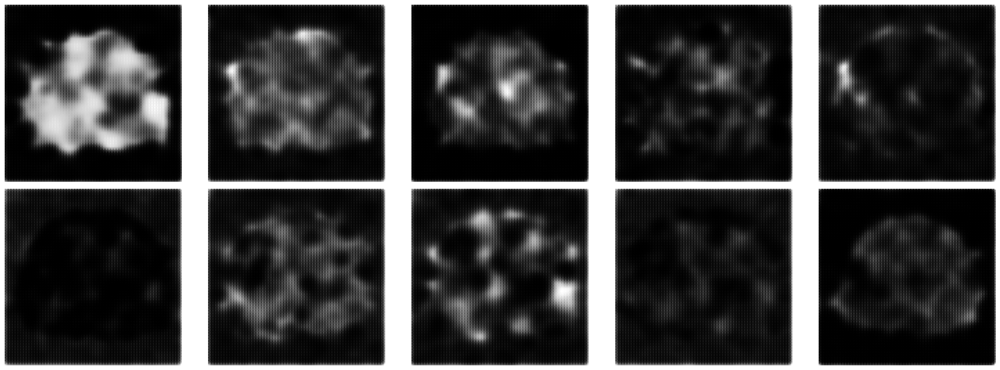

  0%|                                                                                                                        | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step


  0%|                                                                                                                | 1/3750 [00:00<07:11,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 2/3750 [00:00<06:50,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                                                                                                | 3/3750 [00:00<06:57,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 4/3750 [00:00<06:49,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                                                                                               | 5/3750 [00:00<06:45,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 6/3750 [00:00<06:41,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 7/3750 [00:00<06:38,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                                                                                               | 8/3750 [00:00<06:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                               | 9/3750 [00:00<06:34,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                              | 10/3750 [00:01<06:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                              | 11/3750 [00:01<06:39,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                              | 12/3750 [00:01<06:38,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 13/3750 [00:01<06:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 14/3750 [00:01<06:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 15/3750 [00:01<06:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 16/3750 [00:01<06:35,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▌                                                                                                              | 17/3750 [00:01<06:34,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▌                                                                                                              | 18/3750 [00:01<06:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                                                                                              | 19/3750 [00:02<06:32,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 20/3750 [00:02<06:31,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 21/3750 [00:02<06:31,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 22/3750 [00:02<06:33,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 23/3750 [00:02<06:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▋                                                                                                              | 24/3750 [00:02<06:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 25/3750 [00:02<06:34,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 26/3750 [00:02<06:34,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▊                                                                                                              | 27/3750 [00:02<06:33,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 28/3750 [00:02<06:32,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 29/3750 [00:03<06:32,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 30/3750 [00:03<06:31,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 31/3750 [00:03<06:31,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 32/3750 [00:03<06:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 33/3750 [00:03<06:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 34/3750 [00:03<06:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 35/3750 [00:03<06:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 36/3750 [00:03<06:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█                                                                                                              | 37/3750 [00:03<06:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█                                                                                                              | 38/3750 [00:04<06:31,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 39/3750 [00:04<06:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▏                                                                                                             | 40/3750 [00:04<06:30,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 41/3750 [00:04<06:32,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 42/3750 [00:04<06:33,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 43/3750 [00:04<06:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 44/3750 [00:04<06:35,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 45/3750 [00:04<06:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 46/3750 [00:04<06:34,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 47/3750 [00:04<06:34,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 48/3750 [00:05<06:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 49/3750 [00:05<06:32,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 50/3750 [00:05<06:34,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


  1%|█▌                                                                                                             | 51/3750 [00:05<06:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 52/3750 [00:05<06:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 53/3750 [00:05<06:33,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


  1%|█▌                                                                                                             | 54/3750 [00:05<06:33,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▋                                                                                                             | 55/3750 [00:05<06:31,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


  1%|█▋                                                                                                             | 56/3750 [00:05<06:33,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


  2%|█▋                                                                                                             | 57/3750 [00:06<06:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▋                                                                                                             | 58/3750 [00:06<06:32,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▋                                                                                                             | 59/3750 [00:06<06:34,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▊                                                                                                             | 60/3750 [00:06<06:32,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▊                                                                                                             | 61/3750 [00:06<06:37,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▊                                                                                                             | 62/3750 [00:06<06:34,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 63/3750 [00:06<06:32,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▉                                                                                                             | 64/3750 [00:06<06:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▉                                                                                                             | 65/3750 [00:06<06:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▉                                                                                                             | 66/3750 [00:07<06:28,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▉                                                                                                             | 67/3750 [00:07<06:26,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 68/3750 [00:07<06:25,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 69/3750 [00:07<06:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 70/3750 [00:07<06:29,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██                                                                                                             | 71/3750 [00:07<06:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▏                                                                                                            | 72/3750 [00:07<06:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▏                                                                                                            | 73/3750 [00:07<06:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 74/3750 [00:07<06:31,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 75/3750 [00:07<06:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▏                                                                                                            | 76/3750 [00:08<06:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▎                                                                                                            | 77/3750 [00:08<06:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 78/3750 [00:08<06:30,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 79/3750 [00:08<06:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 80/3750 [00:08<06:29,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 81/3750 [00:08<06:29,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▍                                                                                                            | 82/3750 [00:08<06:27,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 83/3750 [00:08<06:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▍                                                                                                            | 84/3750 [00:08<06:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▌                                                                                                            | 85/3750 [00:09<06:24,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▌                                                                                                            | 86/3750 [00:09<06:24,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 87/3750 [00:09<06:27,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 88/3750 [00:09<06:26,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 89/3750 [00:09<06:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▋                                                                                                            | 90/3750 [00:09<06:26,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 91/3750 [00:09<06:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▋                                                                                                            | 92/3750 [00:09<06:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▊                                                                                                            | 93/3750 [00:09<06:24,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 94/3750 [00:09<06:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▊                                                                                                            | 95/3750 [00:10<06:23,  9.53it/s]

1/1 [==============================] - 0s 10ms/step


  3%|██▊                                                                                                            | 96/3750 [00:10<06:28,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 97/3750 [00:10<06:29,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


  3%|██▉                                                                                                            | 98/3750 [00:10<06:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                            | 99/3750 [00:10<06:32,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▉                                                                                                           | 100/3750 [00:10<06:30,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▉                                                                                                           | 101/3750 [00:10<06:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▉                                                                                                           | 102/3750 [00:10<06:27,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███                                                                                                           | 103/3750 [00:10<06:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███                                                                                                           | 104/3750 [00:11<06:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 105/3750 [00:11<06:24,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 106/3750 [00:11<06:26,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▏                                                                                                          | 107/3750 [00:11<06:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▏                                                                                                          | 108/3750 [00:11<06:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▏                                                                                                          | 109/3750 [00:11<06:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▏                                                                                                          | 110/3750 [00:11<06:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 111/3750 [00:11<06:24,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 112/3750 [00:11<06:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 113/3750 [00:11<06:27,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 114/3750 [00:12<06:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 115/3750 [00:12<06:26,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▍                                                                                                          | 116/3750 [00:12<06:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▍                                                                                                          | 117/3750 [00:12<06:24,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▍                                                                                                          | 118/3750 [00:12<06:23,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▍                                                                                                          | 119/3750 [00:12<06:22,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 120/3750 [00:12<06:22,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▌                                                                                                          | 121/3750 [00:12<06:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▌                                                                                                          | 122/3750 [00:12<06:21,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 123/3750 [00:13<06:21,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 124/3750 [00:13<06:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 125/3750 [00:13<06:22,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▋                                                                                                          | 126/3750 [00:13<06:22,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 127/3750 [00:13<06:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 128/3750 [00:13<06:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 129/3750 [00:13<06:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 130/3750 [00:13<06:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 131/3750 [00:13<06:23,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▊                                                                                                          | 132/3750 [00:13<06:21,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▉                                                                                                          | 133/3750 [00:14<06:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▉                                                                                                          | 134/3750 [00:14<06:27,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▉                                                                                                          | 135/3750 [00:14<06:24,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 136/3750 [00:14<06:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████                                                                                                          | 137/3750 [00:14<06:22,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████                                                                                                          | 138/3750 [00:14<06:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████                                                                                                          | 139/3750 [00:14<06:20,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████                                                                                                          | 140/3750 [00:14<06:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 141/3750 [00:14<06:19,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 142/3750 [00:15<06:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 143/3750 [00:15<06:20,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▏                                                                                                         | 144/3750 [00:15<06:21,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 145/3750 [00:15<06:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 146/3750 [00:15<06:27,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 147/3750 [00:15<06:25,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▎                                                                                                         | 148/3750 [00:15<06:23,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▎                                                                                                         | 149/3750 [00:15<06:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 150/3750 [00:15<06:18,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 151/3750 [00:16<06:17,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 152/3750 [00:16<06:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 153/3750 [00:16<06:18,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▌                                                                                                         | 154/3750 [00:16<06:17,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▌                                                                                                         | 155/3750 [00:16<06:17,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▌                                                                                                         | 156/3750 [00:16<06:17,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▌                                                                                                         | 157/3750 [00:16<06:16,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▋                                                                                                         | 158/3750 [00:16<06:16,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 159/3750 [00:16<06:16,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▋                                                                                                         | 160/3750 [00:16<06:15,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▋                                                                                                         | 161/3750 [00:17<06:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 162/3750 [00:17<06:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 163/3750 [00:17<06:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 164/3750 [00:17<06:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 165/3750 [00:17<06:15,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 166/3750 [00:17<06:15,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▉                                                                                                         | 167/3750 [00:17<06:15,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▉                                                                                                         | 168/3750 [00:17<06:15,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  5%|████▉                                                                                                         | 169/3750 [00:17<06:15,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  5%|████▉                                                                                                         | 170/3750 [00:18<06:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████                                                                                                         | 171/3750 [00:18<06:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 172/3750 [00:18<06:20,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████                                                                                                         | 173/3750 [00:18<06:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████                                                                                                         | 174/3750 [00:18<06:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▏                                                                                                        | 175/3750 [00:18<06:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▏                                                                                                        | 176/3750 [00:18<06:15,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▏                                                                                                        | 177/3750 [00:18<06:14,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 178/3750 [00:18<06:14,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 179/3750 [00:18<06:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 180/3750 [00:19<06:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 181/3750 [00:19<06:15,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 182/3750 [00:19<06:14,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 183/3750 [00:19<06:15,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 184/3750 [00:19<06:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 185/3750 [00:19<06:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 186/3750 [00:19<06:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 187/3750 [00:19<06:21,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 188/3750 [00:19<06:20,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 189/3750 [00:20<06:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▌                                                                                                        | 190/3750 [00:20<06:19,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 191/3750 [00:20<06:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▋                                                                                                        | 192/3750 [00:20<06:16,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 193/3750 [00:20<06:15,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 194/3750 [00:20<06:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▋                                                                                                        | 195/3750 [00:20<06:13,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▋                                                                                                        | 196/3750 [00:20<06:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▊                                                                                                        | 197/3750 [00:20<06:13,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 198/3750 [00:20<06:14,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 199/3750 [00:21<06:14,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 200/3750 [00:21<06:15,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▉                                                                                                        | 201/3750 [00:21<06:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▉                                                                                                        | 202/3750 [00:21<06:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▉                                                                                                        | 203/3750 [00:21<06:13,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 204/3750 [00:21<06:19,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██████                                                                                                        | 205/3750 [00:21<06:17,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


  5%|██████                                                                                                        | 206/3750 [00:21<06:17,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████                                                                                                        | 207/3750 [00:21<06:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████                                                                                                        | 208/3750 [00:22<06:17,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██████▏                                                                                                       | 209/3750 [00:22<06:18,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 210/3750 [00:22<06:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 211/3750 [00:22<06:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 212/3750 [00:22<06:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 213/3750 [00:22<06:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▎                                                                                                       | 214/3750 [00:22<06:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 215/3750 [00:22<06:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 216/3750 [00:22<06:11,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▎                                                                                                       | 217/3750 [00:22<06:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 218/3750 [00:23<06:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 219/3750 [00:23<06:11,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 220/3750 [00:23<06:11,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 221/3750 [00:23<06:10,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 222/3750 [00:23<06:10,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 223/3750 [00:23<06:10,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 224/3750 [00:23<06:10,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 225/3750 [00:23<06:10,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 226/3750 [00:23<06:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▋                                                                                                       | 227/3750 [00:24<06:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▋                                                                                                       | 228/3750 [00:24<06:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▋                                                                                                       | 229/3750 [00:24<06:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▋                                                                                                       | 230/3750 [00:24<06:09,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 231/3750 [00:24<06:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▊                                                                                                       | 232/3750 [00:24<06:09,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 233/3750 [00:24<06:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▊                                                                                                       | 234/3750 [00:24<06:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 235/3750 [00:24<06:14,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 236/3750 [00:24<06:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 237/3750 [00:25<06:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 238/3750 [00:25<06:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 239/3750 [00:25<06:15,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 240/3750 [00:25<06:13,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 241/3750 [00:25<06:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 242/3750 [00:25<06:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████▏                                                                                                      | 243/3750 [00:25<06:09,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 244/3750 [00:25<06:09,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 245/3750 [00:25<06:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▏                                                                                                      | 246/3750 [00:26<06:10,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 247/3750 [00:26<06:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▎                                                                                                      | 248/3750 [00:26<06:10,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 249/3750 [00:26<06:09,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▎                                                                                                      | 250/3750 [00:26<06:07,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 251/3750 [00:26<06:10,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 252/3750 [00:26<06:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▍                                                                                                      | 253/3750 [00:26<06:08,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▍                                                                                                      | 254/3750 [00:26<06:09,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 255/3750 [00:26<06:09,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


  7%|███████▌                                                                                                      | 256/3750 [00:27<06:11,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▌                                                                                                      | 257/3750 [00:27<06:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 258/3750 [00:27<06:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 259/3750 [00:27<06:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 260/3750 [00:27<06:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 261/3750 [00:27<06:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 262/3750 [00:27<06:08,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 263/3750 [00:27<06:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 264/3750 [00:27<06:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 265/3750 [00:28<06:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▊                                                                                                      | 266/3750 [00:28<06:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▊                                                                                                      | 267/3750 [00:28<06:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▊                                                                                                      | 268/3750 [00:28<06:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▉                                                                                                      | 269/3750 [00:28<06:06,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▉                                                                                                      | 270/3750 [00:28<06:07,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▉                                                                                                      | 271/3750 [00:28<06:06,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▉                                                                                                      | 272/3750 [00:28<06:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 273/3750 [00:28<06:08,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████                                                                                                      | 274/3750 [00:29<06:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████                                                                                                      | 275/3750 [00:29<06:06,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████                                                                                                      | 276/3750 [00:29<06:05,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████▏                                                                                                     | 277/3750 [00:29<06:05,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 278/3750 [00:29<06:05,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 279/3750 [00:29<06:04,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 280/3750 [00:29<06:07,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


  7%|████████▏                                                                                                     | 281/3750 [00:29<06:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 282/3750 [00:29<06:12,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


  8%|████████▎                                                                                                     | 283/3750 [00:29<06:13,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▎                                                                                                     | 284/3750 [00:30<06:12,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 285/3750 [00:30<06:10,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 286/3750 [00:30<06:09,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▍                                                                                                     | 287/3750 [00:30<06:07,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▍                                                                                                     | 288/3750 [00:30<06:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▍                                                                                                     | 289/3750 [00:30<06:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 290/3750 [00:30<06:04,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 291/3750 [00:30<06:07,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 292/3750 [00:30<06:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 293/3750 [00:31<06:05,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 294/3750 [00:31<06:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▋                                                                                                     | 295/3750 [00:31<06:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▋                                                                                                     | 296/3750 [00:31<06:03,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 297/3750 [00:31<06:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▋                                                                                                     | 298/3750 [00:31<06:08,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


  8%|████████▊                                                                                                     | 299/3750 [00:31<06:07,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▊                                                                                                     | 300/3750 [00:31<06:08,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▊                                                                                                     | 301/3750 [00:31<06:05,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▊                                                                                                     | 302/3750 [00:31<06:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 303/3750 [00:32<06:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 304/3750 [00:32<06:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 305/3750 [00:32<06:02,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 306/3750 [00:32<06:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████                                                                                                     | 307/3750 [00:32<06:01,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████                                                                                                     | 308/3750 [00:32<06:00,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████                                                                                                     | 309/3750 [00:32<06:03,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 310/3750 [00:32<06:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████                                                                                                     | 311/3750 [00:32<06:06,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 312/3750 [00:33<06:04,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 313/3750 [00:33<06:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 314/3750 [00:33<06:02,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 315/3750 [00:33<06:01,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▎                                                                                                    | 316/3750 [00:33<06:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▎                                                                                                    | 317/3750 [00:33<06:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▎                                                                                                    | 318/3750 [00:33<06:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▎                                                                                                    | 319/3750 [00:33<06:02,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 320/3750 [00:33<06:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 321/3750 [00:33<06:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 322/3750 [00:34<06:01,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 323/3750 [00:34<06:00,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 324/3750 [00:34<06:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 325/3750 [00:34<05:59,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 326/3750 [00:34<06:04,  9.40it/s]

1/1 [==============================] - 0s 11ms/step


  9%|█████████▌                                                                                                    | 327/3750 [00:34<06:14,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 328/3750 [00:34<06:18,  9.05it/s]

1/1 [==============================] - 0s 12ms/step


  9%|█████████▋                                                                                                    | 329/3750 [00:34<06:27,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 330/3750 [00:34<06:24,  8.89it/s]

1/1 [==============================] - 0s 19ms/step


  9%|█████████▋                                                                                                    | 331/3750 [00:35<06:32,  8.71it/s]

1/1 [==============================] - 0s 10ms/step


  9%|█████████▋                                                                                                    | 332/3750 [00:35<06:46,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 333/3750 [00:35<07:01,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


  9%|█████████▊                                                                                                    | 334/3750 [00:35<07:07,  8.00it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 335/3750 [00:35<06:50,  8.32it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 336/3750 [00:35<06:35,  8.64it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▉                                                                                                    | 337/3750 [00:35<06:25,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▉                                                                                                    | 338/3750 [00:35<06:17,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▉                                                                                                    | 339/3750 [00:36<06:11,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 340/3750 [00:36<06:09,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 341/3750 [00:36<06:08,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 342/3750 [00:36<06:04,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 343/3750 [00:36<06:02,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 344/3750 [00:36<06:01,  9.43it/s]

1/1 [==============================] - 0s 16ms/step


  9%|██████████                                                                                                    | 345/3750 [00:36<06:25,  8.84it/s]

1/1 [==============================] - 0s 11ms/step


  9%|██████████▏                                                                                                   | 346/3750 [00:36<06:34,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 347/3750 [00:36<06:24,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▏                                                                                                   | 348/3750 [00:37<06:25,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 349/3750 [00:37<06:17,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 350/3750 [00:37<06:10,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 351/3750 [00:37<06:06,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 352/3750 [00:37<06:02,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▎                                                                                                   | 353/3750 [00:37<06:00,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▍                                                                                                   | 354/3750 [00:37<05:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▍                                                                                                   | 355/3750 [00:37<06:00,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▍                                                                                                   | 356/3750 [00:37<05:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▍                                                                                                   | 357/3750 [00:37<05:58,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▌                                                                                                   | 358/3750 [00:38<05:58,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▌                                                                                                   | 359/3750 [00:38<06:01,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 360/3750 [00:38<05:59,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 361/3750 [00:38<05:58,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 362/3750 [00:38<05:56,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 363/3750 [00:38<05:56,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▋                                                                                                   | 364/3750 [00:38<05:55,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▋                                                                                                   | 365/3750 [00:38<05:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▋                                                                                                   | 366/3750 [00:38<05:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 367/3750 [00:39<06:02,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 368/3750 [00:39<05:59,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 369/3750 [00:39<05:58,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 370/3750 [00:39<05:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▉                                                                                                   | 371/3750 [00:39<05:55,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 372/3750 [00:39<05:55,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▉                                                                                                   | 373/3750 [00:39<05:54,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▉                                                                                                   | 374/3750 [00:39<05:55,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 375/3750 [00:39<05:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 376/3750 [00:39<05:53,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 377/3750 [00:40<05:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 378/3750 [00:40<05:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 379/3750 [00:40<05:57,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 380/3750 [00:40<05:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 381/3750 [00:40<05:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 382/3750 [00:40<05:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 383/3750 [00:40<05:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 384/3750 [00:40<05:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 385/3750 [00:40<05:53,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 386/3750 [00:41<05:52,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▎                                                                                                  | 387/3750 [00:41<05:53,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 388/3750 [00:41<05:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 389/3750 [00:41<05:53,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 390/3750 [00:41<05:52,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 391/3750 [00:41<05:51,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 392/3750 [00:41<05:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▌                                                                                                  | 393/3750 [00:41<05:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▌                                                                                                  | 394/3750 [00:41<05:53,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▌                                                                                                  | 395/3750 [00:41<05:52,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▌                                                                                                  | 396/3750 [00:42<05:53,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 397/3750 [00:42<05:52,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▋                                                                                                  | 398/3750 [00:42<05:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 399/3750 [00:42<05:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 400/3750 [00:42<05:51,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 401/3750 [00:42<05:53,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 402/3750 [00:42<05:53,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 403/3750 [00:42<05:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 404/3750 [00:42<05:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 405/3750 [00:43<05:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 406/3750 [00:43<05:50,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 407/3750 [00:43<05:49,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 408/3750 [00:43<05:48,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 409/3750 [00:43<05:54,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 410/3750 [00:43<05:55,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 411/3750 [00:43<05:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 412/3750 [00:43<05:53,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 413/3750 [00:43<05:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 414/3750 [00:43<05:50,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▏                                                                                                 | 415/3750 [00:44<05:51,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 416/3750 [00:44<05:50,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 417/3750 [00:44<05:49,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 418/3750 [00:44<05:48,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 419/3750 [00:44<05:52,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 420/3750 [00:44<05:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 421/3750 [00:44<05:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 422/3750 [00:44<05:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 423/3750 [00:44<05:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 424/3750 [00:45<05:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 425/3750 [00:45<05:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 426/3750 [00:45<05:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▌                                                                                                 | 427/3750 [00:45<05:48,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 428/3750 [00:45<05:52,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 429/3750 [00:45<05:51,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 430/3750 [00:45<05:51,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▋                                                                                                 | 431/3750 [00:45<05:50,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▋                                                                                                 | 432/3750 [00:45<05:50,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▋                                                                                                 | 433/3750 [00:45<05:50,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▋                                                                                                 | 434/3750 [00:46<05:50,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▊                                                                                                 | 435/3750 [00:46<05:49,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▊                                                                                                 | 436/3750 [00:46<05:48,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▊                                                                                                 | 437/3750 [00:46<05:49,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 438/3750 [00:46<05:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 439/3750 [00:46<05:52,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 440/3750 [00:46<05:51,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 441/3750 [00:46<05:50,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 442/3750 [00:46<05:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 443/3750 [00:47<05:46,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████                                                                                                 | 444/3750 [00:47<05:46,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████                                                                                                 | 445/3750 [00:47<05:46,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 446/3750 [00:47<05:47,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 447/3750 [00:47<05:47,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 448/3750 [00:47<05:47,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 449/3750 [00:47<05:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 450/3750 [00:47<05:46,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 451/3750 [00:47<05:46,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 452/3750 [00:47<05:45,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 453/3750 [00:48<05:46,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 454/3750 [00:48<05:45,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 455/3750 [00:48<05:46,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 456/3750 [00:48<05:46,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 457/3750 [00:48<05:46,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▍                                                                                                | 458/3750 [00:48<05:44,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▍                                                                                                | 459/3750 [00:48<05:44,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▍                                                                                                | 460/3750 [00:48<05:44,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 461/3750 [00:48<05:44,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 462/3750 [00:49<05:44,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 463/3750 [00:49<05:44,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 464/3750 [00:49<05:46,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 465/3750 [00:49<05:45,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 466/3750 [00:49<05:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 467/3750 [00:49<05:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▋                                                                                                | 468/3750 [00:49<05:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 469/3750 [00:49<05:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 470/3750 [00:49<05:46,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 471/3750 [00:49<05:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 472/3750 [00:50<05:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 473/3750 [00:50<05:47,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 474/3750 [00:50<05:46,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 475/3750 [00:50<05:47,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 476/3750 [00:50<05:47,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▉                                                                                                | 477/3750 [00:50<05:48,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 478/3750 [00:50<05:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 479/3750 [00:50<05:46,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████                                                                                                | 480/3750 [00:50<05:45,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 481/3750 [00:51<05:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▏                                                                                               | 482/3750 [00:51<05:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▏                                                                                               | 483/3750 [00:51<05:45,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▏                                                                                               | 484/3750 [00:51<05:44,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 485/3750 [00:51<05:44,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 13%|██████████████▎                                                                                               | 486/3750 [00:51<05:45,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 487/3750 [00:51<05:45,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 488/3750 [00:51<05:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 489/3750 [00:51<05:43,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 490/3750 [00:51<05:43,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 491/3750 [00:52<05:42,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 492/3750 [00:52<05:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 493/3750 [00:52<05:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 494/3750 [00:52<05:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 495/3750 [00:52<05:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 496/3750 [00:52<05:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 497/3750 [00:52<05:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 498/3750 [00:52<05:41,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 499/3750 [00:52<05:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 500/3750 [00:53<05:42,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▋                                                                                               | 501/3750 [00:53<05:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 502/3750 [00:53<05:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 503/3750 [00:53<05:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▊                                                                                               | 504/3750 [00:53<05:42,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 505/3750 [00:53<05:42,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 506/3750 [00:53<05:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▊                                                                                               | 507/3750 [00:53<05:41,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 508/3750 [00:53<05:41,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 14%|██████████████▉                                                                                               | 509/3750 [00:53<05:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▉                                                                                               | 510/3750 [00:54<05:43,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▉                                                                                               | 511/3750 [00:54<05:41,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████                                                                                               | 512/3750 [00:54<05:41,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████                                                                                               | 513/3750 [00:54<05:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████                                                                                               | 514/3750 [00:54<05:39,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████                                                                                               | 515/3750 [00:54<05:39,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 516/3750 [00:54<05:38,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 517/3750 [00:54<05:38,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 518/3750 [00:54<05:37,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 519/3750 [00:55<05:40,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 520/3750 [00:55<05:39,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 521/3750 [00:55<05:39,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 522/3750 [00:55<05:39,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 523/3750 [00:55<05:38,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 524/3750 [00:55<05:39,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 525/3750 [00:55<05:38,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 526/3750 [00:55<05:38,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 527/3750 [00:55<05:38,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 528/3750 [00:55<05:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 529/3750 [00:56<05:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 530/3750 [00:56<05:38,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 531/3750 [00:56<05:37,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 532/3750 [00:56<05:37,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 533/3750 [00:56<05:37,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 534/3750 [00:56<05:36,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 535/3750 [00:56<05:36,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 536/3750 [00:56<05:40,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 537/3750 [00:56<05:41,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 538/3750 [00:57<05:40,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 539/3750 [00:57<05:39,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 540/3750 [00:57<05:38,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 541/3750 [00:57<05:38,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▉                                                                                              | 542/3750 [00:57<05:37,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▉                                                                                              | 543/3750 [00:57<05:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 15%|███████████████▉                                                                                              | 544/3750 [00:57<05:36,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 15%|███████████████▉                                                                                              | 545/3750 [00:57<05:36,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 546/3750 [00:57<05:38,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 547/3750 [00:57<05:37,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 548/3750 [00:58<05:37,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 549/3750 [00:58<05:36,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 550/3750 [00:58<05:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 551/3750 [00:58<05:35,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 552/3750 [00:58<05:35,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 553/3750 [00:58<05:35,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 554/3750 [00:58<05:34,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 555/3750 [00:58<05:36,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 556/3750 [00:58<05:38,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 557/3750 [00:59<05:37,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 558/3750 [00:59<05:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 559/3750 [00:59<05:37,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 560/3750 [00:59<05:37,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 561/3750 [00:59<05:37,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 562/3750 [00:59<05:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 563/3750 [00:59<05:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 564/3750 [00:59<05:35,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 565/3750 [00:59<05:37,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 566/3750 [00:59<05:36,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 567/3750 [01:00<05:41,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 568/3750 [01:00<05:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 569/3750 [01:00<05:38,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 570/3750 [01:00<05:37,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 571/3750 [01:00<05:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▊                                                                                             | 572/3750 [01:00<05:35,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 15%|████████████████▊                                                                                             | 573/3750 [01:00<05:37,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▊                                                                                             | 574/3750 [01:00<05:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 575/3750 [01:00<05:37,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 576/3750 [01:01<05:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 577/3750 [01:01<05:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 578/3750 [01:01<05:35,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 579/3750 [01:01<05:51,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████████████████                                                                                             | 580/3750 [01:01<05:46,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████████████████                                                                                             | 581/3750 [01:01<05:43,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████                                                                                             | 582/3750 [01:01<05:40,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████                                                                                             | 583/3750 [01:01<05:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 584/3750 [01:01<05:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 585/3750 [01:02<05:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 586/3750 [01:02<05:35,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 16%|█████████████████▏                                                                                            | 587/3750 [01:02<05:36,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 588/3750 [01:02<05:34,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▎                                                                                            | 589/3750 [01:02<05:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 590/3750 [01:02<05:33,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▎                                                                                            | 591/3750 [01:02<05:33,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 592/3750 [01:02<05:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 593/3750 [01:02<05:40,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 594/3750 [01:02<05:37,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 595/3750 [01:03<05:34,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 596/3750 [01:03<05:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 597/3750 [01:03<05:33,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 598/3750 [01:03<05:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 599/3750 [01:03<05:31,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▌                                                                                            | 600/3750 [01:03<05:31,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 601/3750 [01:03<05:31,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 602/3750 [01:03<05:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 603/3750 [01:03<05:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 604/3750 [01:04<05:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 605/3750 [01:04<05:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 606/3750 [01:04<05:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 607/3750 [01:04<05:30,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 608/3750 [01:04<05:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 609/3750 [01:04<05:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 610/3750 [01:04<05:31,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 611/3750 [01:04<05:37,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 612/3750 [01:04<05:36,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 613/3750 [01:04<05:34,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 614/3750 [01:05<05:34,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 615/3750 [01:05<05:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 616/3750 [01:05<05:33,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 617/3750 [01:05<05:32,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████▏                                                                                           | 618/3750 [01:05<05:31,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████████████████▏                                                                                           | 619/3750 [01:05<05:32,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▏                                                                                           | 620/3750 [01:05<05:31,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▏                                                                                           | 621/3750 [01:05<05:32,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▏                                                                                           | 622/3750 [01:05<05:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 623/3750 [01:06<05:30,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 624/3750 [01:06<05:29,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 625/3750 [01:06<05:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 626/3750 [01:06<05:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 627/3750 [01:06<05:31,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 628/3750 [01:06<05:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 629/3750 [01:06<05:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 630/3750 [01:06<05:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▌                                                                                           | 631/3750 [01:06<05:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▌                                                                                           | 632/3750 [01:06<05:28,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 633/3750 [01:07<05:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▌                                                                                           | 634/3750 [01:07<05:27,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 635/3750 [01:07<05:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 636/3750 [01:07<05:26,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 637/3750 [01:07<05:25,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 638/3750 [01:07<05:28,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 639/3750 [01:07<05:29,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▊                                                                                           | 640/3750 [01:07<05:28,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▊                                                                                           | 641/3750 [01:07<05:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 642/3750 [01:08<05:31,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 643/3750 [01:08<05:29,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 644/3750 [01:08<05:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 645/3750 [01:08<05:27,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▉                                                                                           | 646/3750 [01:08<05:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 647/3750 [01:08<05:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 648/3750 [01:08<05:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████                                                                                           | 649/3750 [01:08<05:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████                                                                                           | 650/3750 [01:08<05:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████                                                                                           | 651/3750 [01:08<05:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 652/3750 [01:09<05:27,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 653/3750 [01:09<05:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 654/3750 [01:09<05:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 655/3750 [01:09<05:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 656/3750 [01:09<05:24,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 657/3750 [01:09<05:26,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 658/3750 [01:09<05:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▎                                                                                          | 659/3750 [01:09<05:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▎                                                                                          | 660/3750 [01:09<05:24,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 661/3750 [01:10<05:26,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▍                                                                                          | 662/3750 [01:10<05:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▍                                                                                          | 663/3750 [01:10<05:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▍                                                                                          | 664/3750 [01:10<05:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 665/3750 [01:10<05:25,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 666/3750 [01:10<05:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 667/3750 [01:10<05:25,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▌                                                                                          | 668/3750 [01:10<05:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 669/3750 [01:10<05:26,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▋                                                                                          | 670/3750 [01:11<05:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▋                                                                                          | 671/3750 [01:11<05:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 672/3750 [01:11<05:24,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▋                                                                                          | 673/3750 [01:11<05:24,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 674/3750 [01:11<05:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▊                                                                                          | 675/3750 [01:11<05:24,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 676/3750 [01:11<05:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 677/3750 [01:11<05:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▉                                                                                          | 678/3750 [01:11<05:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▉                                                                                          | 679/3750 [01:11<05:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 680/3750 [01:12<05:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▉                                                                                          | 681/3750 [01:12<05:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 682/3750 [01:12<05:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 683/3750 [01:12<05:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 684/3750 [01:12<05:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 685/3750 [01:12<05:23,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 686/3750 [01:12<05:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▏                                                                                         | 687/3750 [01:12<05:27,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▏                                                                                         | 688/3750 [01:12<05:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▏                                                                                         | 689/3750 [01:13<05:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▏                                                                                         | 690/3750 [01:13<05:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▎                                                                                         | 691/3750 [01:13<05:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▎                                                                                         | 692/3750 [01:13<05:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▎                                                                                         | 693/3750 [01:13<05:20,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▎                                                                                         | 694/3750 [01:13<05:22,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▍                                                                                         | 695/3750 [01:13<05:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 696/3750 [01:13<05:21,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▍                                                                                         | 697/3750 [01:13<05:25,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▍                                                                                         | 698/3750 [01:13<05:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▌                                                                                         | 699/3750 [01:14<05:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▌                                                                                         | 700/3750 [01:14<05:21,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▌                                                                                         | 701/3750 [01:14<05:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▌                                                                                         | 702/3750 [01:14<05:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▌                                                                                         | 703/3750 [01:14<05:21,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▋                                                                                         | 704/3750 [01:14<05:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▋                                                                                         | 705/3750 [01:14<05:19,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▋                                                                                         | 706/3750 [01:14<05:19,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 707/3750 [01:14<05:19,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▊                                                                                         | 708/3750 [01:15<05:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▊                                                                                         | 709/3750 [01:15<05:18,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▊                                                                                         | 710/3750 [01:15<05:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▊                                                                                         | 711/3750 [01:15<05:17,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 712/3750 [01:15<05:19,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 713/3750 [01:15<05:19,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▉                                                                                         | 714/3750 [01:15<05:19,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 715/3750 [01:15<05:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 716/3750 [01:15<05:18,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 717/3750 [01:15<05:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 718/3750 [01:16<05:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 719/3750 [01:16<05:17,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 720/3750 [01:16<05:16,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▏                                                                                        | 721/3750 [01:16<05:22,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▏                                                                                        | 722/3750 [01:16<05:21,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▏                                                                                        | 723/3750 [01:16<05:21,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▏                                                                                        | 724/3750 [01:16<05:20,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 725/3750 [01:16<05:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 726/3750 [01:16<05:17,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 727/3750 [01:17<05:17,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 728/3750 [01:17<05:16,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▍                                                                                        | 729/3750 [01:17<05:16,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▍                                                                                        | 730/3750 [01:17<05:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▍                                                                                        | 731/3750 [01:17<05:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▍                                                                                        | 732/3750 [01:17<05:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▌                                                                                        | 733/3750 [01:17<05:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▌                                                                                        | 734/3750 [01:17<05:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▌                                                                                        | 735/3750 [01:17<05:16,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 736/3750 [01:17<05:17,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 737/3750 [01:18<05:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 738/3750 [01:18<05:16,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▋                                                                                        | 739/3750 [01:18<05:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 740/3750 [01:18<05:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 741/3750 [01:18<05:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 742/3750 [01:18<05:16,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 743/3750 [01:18<05:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 744/3750 [01:18<05:15,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 745/3750 [01:18<05:16,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 746/3750 [01:19<05:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 747/3750 [01:19<05:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 748/3750 [01:19<05:15,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 749/3750 [01:19<05:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 750/3750 [01:19<05:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 751/3750 [01:19<05:16,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 752/3750 [01:19<05:15,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 753/3750 [01:19<05:14,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 754/3750 [01:19<05:18,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 755/3750 [01:19<05:18,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 756/3750 [01:20<05:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 757/3750 [01:20<05:17,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▏                                                                                       | 758/3750 [01:20<05:18,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 759/3750 [01:20<05:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▎                                                                                       | 760/3750 [01:20<05:15,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 761/3750 [01:20<05:14,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 762/3750 [01:20<05:14,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 763/3750 [01:20<05:14,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 764/3750 [01:20<05:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 765/3750 [01:21<05:13,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 766/3750 [01:21<05:13,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 767/3750 [01:21<05:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▌                                                                                       | 768/3750 [01:21<05:13,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▌                                                                                       | 769/3750 [01:21<05:18,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▌                                                                                       | 770/3750 [01:21<05:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▌                                                                                       | 771/3750 [01:21<05:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▋                                                                                       | 772/3750 [01:21<05:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▋                                                                                       | 773/3750 [01:21<05:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▋                                                                                       | 774/3750 [01:21<05:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▋                                                                                       | 775/3750 [01:22<05:11,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▊                                                                                       | 776/3750 [01:22<05:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▊                                                                                       | 777/3750 [01:22<05:13,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 778/3750 [01:22<05:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▊                                                                                       | 779/3750 [01:22<05:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 780/3750 [01:22<05:13,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 781/3750 [01:22<05:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 782/3750 [01:22<05:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 783/3750 [01:22<05:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 784/3750 [01:23<05:12,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 785/3750 [01:23<05:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 786/3750 [01:23<05:13,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 787/3750 [01:23<05:12,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 788/3750 [01:23<05:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▏                                                                                      | 789/3750 [01:23<05:11,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▏                                                                                      | 790/3750 [01:23<05:11,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▏                                                                                      | 791/3750 [01:23<05:10,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▏                                                                                      | 792/3750 [01:23<05:10,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▎                                                                                      | 793/3750 [01:23<05:10,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▎                                                                                      | 794/3750 [01:24<05:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▎                                                                                      | 795/3750 [01:24<05:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▎                                                                                      | 796/3750 [01:24<05:13,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 797/3750 [01:24<05:12,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 798/3750 [01:24<05:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 799/3750 [01:24<05:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 800/3750 [01:24<05:10,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 801/3750 [01:24<05:10,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▌                                                                                      | 802/3750 [01:24<05:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▌                                                                                      | 803/3750 [01:25<05:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▌                                                                                      | 804/3750 [01:25<05:10,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 805/3750 [01:25<05:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▋                                                                                      | 806/3750 [01:25<05:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 807/3750 [01:25<05:11,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 808/3750 [01:25<05:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▋                                                                                      | 809/3750 [01:25<05:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▊                                                                                      | 810/3750 [01:25<05:09,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 811/3750 [01:25<05:10,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▊                                                                                      | 812/3750 [01:25<05:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▊                                                                                      | 813/3750 [01:26<05:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 814/3750 [01:26<05:10,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 815/3750 [01:26<05:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 816/3750 [01:26<05:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 817/3750 [01:26<05:09,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 818/3750 [01:26<05:08,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 819/3750 [01:26<05:08,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 820/3750 [01:26<05:07,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 821/3750 [01:26<05:07,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 822/3750 [01:27<05:08,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████████████████████▏                                                                                     | 823/3750 [01:27<05:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 824/3750 [01:27<05:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▏                                                                                     | 825/3750 [01:27<05:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▏                                                                                     | 826/3750 [01:27<05:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▎                                                                                     | 827/3750 [01:27<05:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 828/3750 [01:27<05:10,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▎                                                                                     | 829/3750 [01:27<05:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▎                                                                                     | 830/3750 [01:27<05:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 831/3750 [01:27<05:11,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 832/3750 [01:28<05:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 833/3750 [01:28<05:09,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 834/3750 [01:28<05:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 835/3750 [01:28<05:12,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 836/3750 [01:28<05:10,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 837/3750 [01:28<05:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 838/3750 [01:28<05:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 839/3750 [01:28<05:07,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████████████████████▋                                                                                     | 840/3750 [01:28<05:10,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 841/3750 [01:29<05:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 842/3750 [01:29<05:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 843/3750 [01:29<05:09,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 844/3750 [01:29<05:08,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 845/3750 [01:29<05:08,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 846/3750 [01:29<05:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 847/3750 [01:29<05:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 848/3750 [01:29<05:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▉                                                                                     | 849/3750 [01:29<05:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 850/3750 [01:30<05:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 851/3750 [01:30<05:07,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 852/3750 [01:30<05:07,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 853/3750 [01:30<05:07,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 854/3750 [01:30<05:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 855/3750 [01:30<05:07,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 856/3750 [01:30<05:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 857/3750 [01:30<05:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▏                                                                                    | 858/3750 [01:30<05:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 859/3750 [01:30<05:11,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▏                                                                                    | 860/3750 [01:31<05:09,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 861/3750 [01:31<05:07,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 862/3750 [01:31<05:06,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 863/3750 [01:31<05:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 864/3750 [01:31<05:04,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 865/3750 [01:31<05:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 866/3750 [01:31<05:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 867/3750 [01:31<05:04,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 868/3750 [01:31<05:05,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 869/3750 [01:32<05:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▌                                                                                    | 870/3750 [01:32<05:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▌                                                                                    | 871/3750 [01:32<05:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▌                                                                                    | 872/3750 [01:32<05:03,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 873/3750 [01:32<05:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 874/3750 [01:32<05:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 875/3750 [01:32<05:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 876/3750 [01:32<05:01,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 877/3750 [01:32<05:04,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 878/3750 [01:32<05:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 879/3750 [01:33<05:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 880/3750 [01:33<05:08,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 881/3750 [01:33<05:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▊                                                                                    | 882/3750 [01:33<05:05,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▉                                                                                    | 883/3750 [01:33<05:04,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 884/3750 [01:33<05:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 885/3750 [01:33<05:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▉                                                                                    | 886/3750 [01:33<05:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 887/3750 [01:33<05:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 888/3750 [01:34<05:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 889/3750 [01:34<05:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 890/3750 [01:34<05:04,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▏                                                                                   | 891/3750 [01:34<05:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▏                                                                                   | 892/3750 [01:34<05:09,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 24%|██████████████████████████▏                                                                                   | 893/3750 [01:34<05:10,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 894/3750 [01:34<05:08,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 895/3750 [01:34<05:06,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 896/3750 [01:34<05:06,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 897/3750 [01:35<05:04,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 898/3750 [01:35<05:04,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 24%|██████████████████████████▎                                                                                   | 899/3750 [01:35<05:08,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 900/3750 [01:35<05:07,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 901/3750 [01:35<05:15,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 902/3750 [01:35<05:12,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 903/3750 [01:35<05:09,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 904/3750 [01:35<05:06,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 905/3750 [01:35<05:06,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 906/3750 [01:35<05:04,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 907/3750 [01:36<05:02,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 908/3750 [01:36<05:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▋                                                                                   | 909/3750 [01:36<05:00,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▋                                                                                   | 910/3750 [01:36<04:59,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▋                                                                                   | 911/3750 [01:36<04:59,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 912/3750 [01:36<04:59,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 913/3750 [01:36<04:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 914/3750 [01:36<04:59,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 915/3750 [01:36<04:58,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 916/3750 [01:37<04:58,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▉                                                                                   | 917/3750 [01:37<05:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▉                                                                                   | 918/3750 [01:37<05:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████████████████████▉                                                                                   | 919/3750 [01:37<05:02,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████████████████████▉                                                                                   | 920/3750 [01:37<05:01,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 921/3750 [01:37<04:59,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 922/3750 [01:37<04:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 923/3750 [01:37<05:00,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████                                                                                   | 924/3750 [01:37<04:59,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▏                                                                                  | 925/3750 [01:37<04:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▏                                                                                  | 926/3750 [01:38<04:58,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▏                                                                                  | 927/3750 [01:38<04:57,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 928/3750 [01:38<04:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 929/3750 [01:38<04:57,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 930/3750 [01:38<04:56,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 931/3750 [01:38<04:55,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 932/3750 [01:38<04:57,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 933/3750 [01:38<04:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▍                                                                                  | 934/3750 [01:38<04:57,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 935/3750 [01:39<04:57,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▍                                                                                  | 936/3750 [01:39<04:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▍                                                                                  | 937/3750 [01:39<04:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▌                                                                                  | 938/3750 [01:39<04:56,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 939/3750 [01:39<04:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▌                                                                                  | 940/3750 [01:39<04:55,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 941/3750 [01:39<04:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 942/3750 [01:39<06:44,  6.94it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 943/3750 [01:40<06:11,  7.56it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 944/3750 [01:40<05:47,  8.07it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 945/3750 [01:40<05:36,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▋                                                                                  | 946/3750 [01:40<05:24,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 947/3750 [01:40<05:16,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 948/3750 [01:40<05:09,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 949/3750 [01:40<05:05,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▊                                                                                  | 950/3750 [01:40<05:03,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 951/3750 [01:40<05:01,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▉                                                                                  | 952/3750 [01:40<04:59,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▉                                                                                  | 953/3750 [01:41<04:57,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 954/3750 [01:41<04:56,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 25%|████████████████████████████                                                                                  | 955/3750 [01:41<04:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 25%|████████████████████████████                                                                                  | 956/3750 [01:41<04:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████                                                                                  | 957/3750 [01:41<04:54,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████                                                                                  | 958/3750 [01:41<04:55,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 959/3750 [01:41<04:57,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 960/3750 [01:41<04:56,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 961/3750 [01:41<04:55,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 962/3750 [01:42<04:56,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 963/3750 [01:42<04:55,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 964/3750 [01:42<04:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 965/3750 [01:42<04:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 966/3750 [01:42<04:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 967/3750 [01:42<04:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 968/3750 [01:42<05:00,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 969/3750 [01:42<04:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 970/3750 [01:42<04:57,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▍                                                                                 | 971/3750 [01:42<04:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 972/3750 [01:43<04:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▌                                                                                 | 973/3750 [01:43<04:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▌                                                                                 | 974/3750 [01:43<04:52,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 975/3750 [01:43<04:52,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 976/3750 [01:43<04:52,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 977/3750 [01:43<04:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 978/3750 [01:43<04:53,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 979/3750 [01:43<04:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 980/3750 [01:43<04:52,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▊                                                                                 | 981/3750 [01:44<04:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▊                                                                                 | 982/3750 [01:44<04:51,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 983/3750 [01:44<04:53,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 984/3750 [01:44<04:51,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 985/3750 [01:44<04:51,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 986/3750 [01:44<04:53,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 987/3750 [01:44<04:57,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 988/3750 [01:44<04:55,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 989/3750 [01:44<04:54,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████                                                                                 | 990/3750 [01:45<04:53,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████                                                                                 | 991/3750 [01:45<04:52,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████                                                                                 | 992/3750 [01:45<04:51,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████▏                                                                                | 993/3750 [01:45<04:50,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 994/3750 [01:45<04:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                                | 995/3750 [01:45<04:50,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 996/3750 [01:45<04:51,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 997/3750 [01:45<04:51,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                                | 998/3750 [01:45<04:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                                | 999/3750 [01:45<04:49,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████                                                                                | 1000/3750 [01:46<04:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████                                                                                | 1001/3750 [01:46<04:51,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████                                                                                | 1002/3750 [01:46<04:50,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1003/3750 [01:46<04:53,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 27%|█████████████████████████████▏                                                                               | 1004/3750 [01:46<04:53,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 27%|█████████████████████████████▏                                                                               | 1005/3750 [01:46<04:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1006/3750 [01:46<04:55,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 27%|█████████████████████████████▎                                                                               | 1007/3750 [01:46<04:54,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1008/3750 [01:46<04:52,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                               | 1009/3750 [01:47<04:51,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1010/3750 [01:47<04:49,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1011/3750 [01:47<04:48,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▍                                                                               | 1012/3750 [01:47<04:47,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1013/3750 [01:47<04:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▍                                                                               | 1014/3750 [01:47<04:47,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1015/3750 [01:47<04:49,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1016/3750 [01:47<04:51,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1017/3750 [01:47<04:50,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1018/3750 [01:47<04:49,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1019/3750 [01:48<04:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▋                                                                               | 1020/3750 [01:48<04:48,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▋                                                                               | 1021/3750 [01:48<04:47,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1022/3750 [01:48<04:46,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▋                                                                               | 1023/3750 [01:48<04:46,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1024/3750 [01:48<04:48,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▊                                                                               | 1025/3750 [01:48<04:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▊                                                                               | 1026/3750 [01:48<04:47,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1027/3750 [01:48<04:46,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▉                                                                               | 1028/3750 [01:49<04:46,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▉                                                                               | 1029/3750 [01:49<04:46,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▉                                                                               | 1030/3750 [01:49<04:46,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1031/3750 [01:49<04:46,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 28%|█████████████████████████████▉                                                                               | 1032/3750 [01:49<04:45,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████                                                                               | 1033/3750 [01:49<04:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1034/3750 [01:49<04:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1035/3750 [01:49<04:50,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████                                                                               | 1036/3750 [01:49<04:48,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▏                                                                              | 1037/3750 [01:49<04:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▏                                                                              | 1038/3750 [01:50<04:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▏                                                                              | 1039/3750 [01:50<04:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▏                                                                              | 1040/3750 [01:50<04:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1041/3750 [01:50<04:44,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1042/3750 [01:50<04:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1043/3750 [01:50<04:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1044/3750 [01:50<04:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1045/3750 [01:50<04:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▍                                                                              | 1046/3750 [01:50<04:44,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1047/3750 [01:51<04:44,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▍                                                                              | 1048/3750 [01:51<04:44,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1049/3750 [01:51<04:49,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1050/3750 [01:51<04:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1051/3750 [01:51<04:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1052/3750 [01:51<04:47,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1053/3750 [01:51<04:46,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1054/3750 [01:51<04:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1055/3750 [01:51<04:45,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▋                                                                              | 1056/3750 [01:51<04:44,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1057/3750 [01:52<04:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1058/3750 [01:52<04:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1059/3750 [01:52<04:42,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1060/3750 [01:52<04:44,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1061/3750 [01:52<04:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1062/3750 [01:52<04:43,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1063/3750 [01:52<04:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1064/3750 [01:52<04:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1065/3750 [01:52<04:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1066/3750 [01:53<04:42,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████████████████████████                                                                              | 1067/3750 [01:53<04:42,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████████████████████████                                                                              | 1068/3750 [01:53<04:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████                                                                              | 1069/3750 [01:53<04:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████                                                                              | 1070/3750 [01:53<04:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1071/3750 [01:53<04:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1072/3750 [01:53<04:41,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1073/3750 [01:53<04:42,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1074/3750 [01:53<04:42,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1075/3750 [01:53<04:42,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1076/3750 [01:54<04:42,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1077/3750 [01:54<04:43,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1078/3750 [01:54<04:44,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▎                                                                             | 1079/3750 [01:54<04:43,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▍                                                                             | 1080/3750 [01:54<04:44,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▍                                                                             | 1081/3750 [01:54<04:46,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▍                                                                             | 1082/3750 [01:54<04:44,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▍                                                                             | 1083/3750 [01:54<04:42,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1084/3750 [01:54<04:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1085/3750 [01:55<04:41,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1086/3750 [01:55<04:40,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1087/3750 [01:55<04:42,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1088/3750 [01:55<04:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▋                                                                             | 1089/3750 [01:55<04:45,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▋                                                                             | 1090/3750 [01:55<04:42,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▋                                                                             | 1091/3750 [01:55<04:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1092/3750 [01:55<04:40,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▊                                                                             | 1093/3750 [01:55<04:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▊                                                                             | 1094/3750 [01:56<04:39,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▊                                                                             | 1095/3750 [01:56<04:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▊                                                                             | 1096/3750 [01:56<04:40,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▉                                                                             | 1097/3750 [01:56<04:40,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▉                                                                             | 1098/3750 [01:56<04:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1099/3750 [01:56<04:39,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▉                                                                             | 1100/3750 [01:56<04:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 29%|████████████████████████████████                                                                             | 1101/3750 [01:56<04:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 29%|████████████████████████████████                                                                             | 1102/3750 [01:56<04:38,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 29%|████████████████████████████████                                                                             | 1103/3750 [01:56<04:37,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 29%|████████████████████████████████                                                                             | 1104/3750 [01:57<04:37,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1105/3750 [01:57<04:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████▏                                                                            | 1106/3750 [01:57<04:38,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▏                                                                            | 1107/3750 [01:57<04:38,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▏                                                                            | 1108/3750 [01:57<04:38,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 30%|████████████████████████████████▏                                                                            | 1109/3750 [01:57<04:38,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1110/3750 [01:57<04:37,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1111/3750 [01:57<04:37,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1112/3750 [01:57<04:40,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▎                                                                            | 1113/3750 [01:58<04:39,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1114/3750 [01:58<04:40,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1115/3750 [01:58<04:38,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1116/3750 [01:58<04:38,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1117/3750 [01:58<04:37,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1118/3750 [01:58<04:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▌                                                                            | 1119/3750 [01:58<04:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▌                                                                            | 1120/3750 [01:58<04:36,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▌                                                                            | 1121/3750 [01:58<04:35,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▌                                                                            | 1122/3750 [01:58<04:34,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▋                                                                            | 1123/3750 [01:59<04:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▋                                                                            | 1124/3750 [01:59<04:36,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1125/3750 [01:59<04:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▋                                                                            | 1126/3750 [01:59<04:35,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1127/3750 [01:59<04:34,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1128/3750 [01:59<04:34,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1129/3750 [01:59<04:34,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1130/3750 [01:59<04:34,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1131/3750 [01:59<04:34,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▉                                                                            | 1132/3750 [02:00<04:35,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1133/3750 [02:00<04:35,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▉                                                                            | 1134/3750 [02:00<04:35,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1135/3750 [02:00<04:34,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1136/3750 [02:00<04:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████                                                                            | 1137/3750 [02:00<04:34,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████                                                                            | 1138/3750 [02:00<04:34,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████                                                                            | 1139/3750 [02:00<04:33,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1140/3750 [02:00<04:37,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1141/3750 [02:00<04:35,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1142/3750 [02:01<04:37,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1143/3750 [02:01<04:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1144/3750 [02:01<04:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1145/3750 [02:01<04:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1146/3750 [02:01<04:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1147/3750 [02:01<04:34,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1148/3750 [02:01<04:33,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▍                                                                           | 1149/3750 [02:01<04:33,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▍                                                                           | 1150/3750 [02:01<04:32,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▍                                                                           | 1151/3750 [02:02<04:34,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▍                                                                           | 1152/3750 [02:02<04:33,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▌                                                                           | 1153/3750 [02:02<04:33,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1154/3750 [02:02<04:34,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1155/3750 [02:02<04:34,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▌                                                                           | 1156/3750 [02:02<04:34,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1157/3750 [02:02<04:33,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1158/3750 [02:02<04:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1159/3750 [02:02<04:32,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1160/3750 [02:02<04:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1161/3750 [02:03<04:33,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1162/3750 [02:03<04:32,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1163/3750 [02:03<04:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1164/3750 [02:03<04:32,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1165/3750 [02:03<04:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▉                                                                           | 1166/3750 [02:03<04:30,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▉                                                                           | 1167/3750 [02:03<04:30,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▉                                                                           | 1168/3750 [02:03<04:31,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1169/3750 [02:03<04:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1170/3750 [02:04<04:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1171/3750 [02:04<04:31,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1172/3750 [02:04<04:31,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1173/3750 [02:04<04:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1174/3750 [02:04<04:30,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▏                                                                          | 1175/3750 [02:04<04:34,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1176/3750 [02:04<04:33,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▏                                                                          | 1177/3750 [02:04<04:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▏                                                                          | 1178/3750 [02:04<04:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▎                                                                          | 1179/3750 [02:04<04:31,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1180/3750 [02:05<04:31,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▎                                                                          | 1181/3750 [02:05<04:30,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▎                                                                          | 1182/3750 [02:05<04:30,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1183/3750 [02:05<04:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▍                                                                          | 1184/3750 [02:05<04:29,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▍                                                                          | 1185/3750 [02:05<04:29,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1186/3750 [02:05<04:29,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1187/3750 [02:05<04:32,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1188/3750 [02:05<04:31,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1189/3750 [02:06<04:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1190/3750 [02:06<04:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1191/3750 [02:06<04:29,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▋                                                                          | 1192/3750 [02:06<04:29,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1193/3750 [02:06<04:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▋                                                                          | 1194/3750 [02:06<04:28,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1195/3750 [02:06<04:28,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1196/3750 [02:06<04:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1197/3750 [02:06<04:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1198/3750 [02:06<04:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1199/3750 [02:07<04:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1200/3750 [02:07<04:27,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1201/3750 [02:07<04:28,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1202/3750 [02:07<04:27,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1203/3750 [02:07<04:27,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1204/3750 [02:07<04:26,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1205/3750 [02:07<04:28,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1206/3750 [02:07<04:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████                                                                          | 1207/3750 [02:07<04:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████                                                                          | 1208/3750 [02:08<04:28,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1209/3750 [02:08<04:27,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1210/3750 [02:08<04:26,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1211/3750 [02:08<04:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1212/3750 [02:08<04:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1213/3750 [02:08<04:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1214/3750 [02:08<04:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1215/3750 [02:08<04:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1216/3750 [02:08<04:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1217/3750 [02:08<04:26,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▍                                                                         | 1218/3750 [02:09<04:25,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▍                                                                         | 1219/3750 [02:09<04:25,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▍                                                                         | 1220/3750 [02:09<04:25,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▍                                                                         | 1221/3750 [02:09<04:24,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▌                                                                         | 1222/3750 [02:09<04:24,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▌                                                                         | 1223/3750 [02:09<04:25,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1224/3750 [02:09<04:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▌                                                                         | 1225/3750 [02:09<04:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1226/3750 [02:09<04:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1227/3750 [02:10<04:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1228/3750 [02:10<04:25,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1229/3750 [02:10<04:25,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1230/3750 [02:10<04:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▊                                                                         | 1231/3750 [02:10<04:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▊                                                                         | 1232/3750 [02:10<04:26,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▊                                                                         | 1233/3750 [02:10<04:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▊                                                                         | 1234/3750 [02:10<04:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1235/3750 [02:10<04:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1236/3750 [02:10<04:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1237/3750 [02:11<04:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1238/3750 [02:11<04:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████                                                                         | 1239/3750 [02:11<04:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████                                                                         | 1240/3750 [02:11<04:23,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1241/3750 [02:11<04:28,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1242/3750 [02:11<04:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1243/3750 [02:11<04:27,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1244/3750 [02:11<04:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1245/3750 [02:11<04:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1246/3750 [02:12<04:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1247/3750 [02:12<04:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1248/3750 [02:12<04:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▎                                                                        | 1249/3750 [02:12<04:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1250/3750 [02:12<04:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1251/3750 [02:12<04:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▍                                                                        | 1252/3750 [02:12<04:24,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1253/3750 [02:12<04:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▍                                                                        | 1254/3750 [02:12<04:22,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▍                                                                        | 1255/3750 [02:12<04:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▌                                                                        | 1256/3750 [02:13<04:21,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▌                                                                        | 1257/3750 [02:13<04:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▌                                                                        | 1258/3750 [02:13<04:20,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▌                                                                        | 1259/3750 [02:13<04:20,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▌                                                                        | 1260/3750 [02:13<04:21,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▋                                                                        | 1261/3750 [02:13<04:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▋                                                                        | 1262/3750 [02:13<04:21,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▋                                                                        | 1263/3750 [02:13<04:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▋                                                                        | 1264/3750 [02:13<04:21,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▊                                                                        | 1265/3750 [02:14<04:21,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▊                                                                        | 1266/3750 [02:14<04:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▊                                                                        | 1267/3750 [02:14<04:19,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▊                                                                        | 1268/3750 [02:14<04:18,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▉                                                                        | 1269/3750 [02:14<04:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▉                                                                        | 1270/3750 [02:14<04:20,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▉                                                                        | 1271/3750 [02:14<04:20,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▉                                                                        | 1272/3750 [02:14<04:19,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1273/3750 [02:14<04:19,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1274/3750 [02:14<04:19,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1275/3750 [02:15<04:18,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1276/3750 [02:15<04:18,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1277/3750 [02:15<04:18,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1278/3750 [02:15<04:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1279/3750 [02:15<04:19,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1280/3750 [02:15<04:19,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1281/3750 [02:15<04:18,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▎                                                                       | 1282/3750 [02:15<04:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▎                                                                       | 1283/3750 [02:15<04:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▎                                                                       | 1284/3750 [02:16<04:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▎                                                                       | 1285/3750 [02:16<04:17,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1286/3750 [02:16<04:17,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1287/3750 [02:16<04:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1288/3750 [02:16<04:19,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1289/3750 [02:16<04:19,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1290/3750 [02:16<04:19,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▌                                                                       | 1291/3750 [02:16<04:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▌                                                                       | 1292/3750 [02:16<04:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▌                                                                       | 1293/3750 [02:16<04:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▌                                                                       | 1294/3750 [02:17<04:17,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▋                                                                       | 1295/3750 [02:17<04:17,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▋                                                                       | 1296/3750 [02:17<04:18,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1297/3750 [02:17<04:18,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1298/3750 [02:17<04:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1299/3750 [02:17<04:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1300/3750 [02:17<04:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1301/3750 [02:17<04:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1302/3750 [02:17<04:17,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1303/3750 [02:18<04:20,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▉                                                                       | 1304/3750 [02:18<04:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1305/3750 [02:18<04:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1306/3750 [02:18<04:19,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1307/3750 [02:18<04:18,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1308/3750 [02:18<04:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1309/3750 [02:18<04:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1310/3750 [02:18<04:16,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1311/3750 [02:18<04:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▏                                                                      | 1312/3750 [02:18<04:15,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▏                                                                      | 1313/3750 [02:19<04:15,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▏                                                                      | 1314/3750 [02:19<04:16,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1315/3750 [02:19<04:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▎                                                                      | 1316/3750 [02:19<04:16,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1317/3750 [02:19<04:21,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1318/3750 [02:19<04:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1319/3750 [02:19<04:18,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▎                                                                      | 1320/3750 [02:19<04:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▍                                                                      | 1321/3750 [02:19<04:15,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▍                                                                      | 1322/3750 [02:20<04:14,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▍                                                                      | 1323/3750 [02:20<04:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▍                                                                      | 1324/3750 [02:20<04:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▌                                                                      | 1325/3750 [02:20<04:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▌                                                                      | 1326/3750 [02:20<04:14,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1327/3750 [02:20<04:15,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▌                                                                      | 1328/3750 [02:20<04:18,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▋                                                                      | 1329/3750 [02:20<04:21,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▋                                                                      | 1330/3750 [02:20<04:20,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▋                                                                      | 1331/3750 [02:20<04:18,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▋                                                                      | 1332/3750 [02:21<04:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▋                                                                      | 1333/3750 [02:21<04:17,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1334/3750 [02:21<04:16,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1335/3750 [02:21<04:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1336/3750 [02:21<04:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1337/3750 [02:21<04:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1338/3750 [02:21<04:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1339/3750 [02:21<04:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1340/3750 [02:21<04:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1341/3750 [02:22<04:13,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1342/3750 [02:22<04:15,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1343/3750 [02:22<04:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1344/3750 [02:22<04:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1345/3750 [02:22<04:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1346/3750 [02:22<04:14,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1347/3750 [02:22<04:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1348/3750 [02:22<04:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1349/3750 [02:22<04:12,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1350/3750 [02:22<04:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1351/3750 [02:23<04:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1352/3750 [02:23<04:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1353/3750 [02:23<04:13,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1354/3750 [02:23<04:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▍                                                                     | 1355/3750 [02:23<04:11,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▍                                                                     | 1356/3750 [02:23<04:11,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1357/3750 [02:23<04:11,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▍                                                                     | 1358/3750 [02:23<04:11,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1359/3750 [02:23<04:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1360/3750 [02:24<04:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1361/3750 [02:24<04:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1362/3750 [02:24<04:12,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1363/3750 [02:24<04:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1364/3750 [02:24<04:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1365/3750 [02:24<04:11,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1366/3750 [02:24<04:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1367/3750 [02:24<04:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▊                                                                     | 1368/3750 [02:24<04:13,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▊                                                                     | 1369/3750 [02:24<04:13,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▊                                                                     | 1370/3750 [02:25<04:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1371/3750 [02:25<04:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1372/3750 [02:25<04:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1373/3750 [02:25<04:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1374/3750 [02:25<04:10,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1375/3750 [02:25<04:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1376/3750 [02:25<04:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████                                                                     | 1377/3750 [02:25<04:10,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████                                                                     | 1378/3750 [02:25<04:17,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1379/3750 [02:26<04:15,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████                                                                     | 1380/3750 [02:26<04:13,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1381/3750 [02:26<04:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▏                                                                    | 1382/3750 [02:26<04:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▏                                                                    | 1383/3750 [02:26<04:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▏                                                                    | 1384/3750 [02:26<04:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1385/3750 [02:26<04:11,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1386/3750 [02:26<04:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1387/3750 [02:26<04:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1388/3750 [02:27<04:10,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 37%|████████████████████████████████████████▎                                                                    | 1389/3750 [02:27<04:12,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▍                                                                    | 1390/3750 [02:27<04:12,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▍                                                                    | 1391/3750 [02:27<04:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▍                                                                    | 1392/3750 [02:27<04:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▍                                                                    | 1393/3750 [02:27<04:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▌                                                                    | 1394/3750 [02:27<04:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▌                                                                    | 1395/3750 [02:27<04:08,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 37%|████████████████████████████████████████▌                                                                    | 1396/3750 [02:27<04:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▌                                                                    | 1397/3750 [02:27<04:10,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1398/3750 [02:28<04:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1399/3750 [02:28<04:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1400/3750 [02:28<04:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1401/3750 [02:28<04:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1402/3750 [02:28<04:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1403/3750 [02:28<04:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1404/3750 [02:28<04:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1405/3750 [02:28<04:07,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1406/3750 [02:28<04:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 38%|████████████████████████████████████████▉                                                                    | 1407/3750 [02:29<04:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1408/3750 [02:29<04:11,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 38%|████████████████████████████████████████▉                                                                    | 1409/3750 [02:29<04:10,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1410/3750 [02:29<04:10,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1411/3750 [02:29<04:09,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1412/3750 [02:29<04:08,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1413/3750 [02:29<04:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1414/3750 [02:29<04:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1415/3750 [02:29<04:06,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1416/3750 [02:29<04:07,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1417/3750 [02:30<04:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1418/3750 [02:30<04:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1419/3750 [02:30<04:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1420/3750 [02:30<04:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1421/3750 [02:30<04:04,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1422/3750 [02:30<04:05,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1423/3750 [02:30<04:04,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1424/3750 [02:30<04:04,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1425/3750 [02:30<04:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1426/3750 [02:31<04:07,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1427/3750 [02:31<04:09,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1428/3750 [02:31<04:10,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1429/3750 [02:31<04:09,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1430/3750 [02:31<04:11,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1431/3750 [02:31<04:09,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1432/3750 [02:31<04:07,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1433/3750 [02:31<04:06,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1434/3750 [02:31<04:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1435/3750 [02:32<04:06,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1436/3750 [02:32<04:05,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1437/3750 [02:32<04:05,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1438/3750 [02:32<04:05,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1439/3750 [02:32<04:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1440/3750 [02:32<04:04,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1441/3750 [02:32<04:03,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1442/3750 [02:32<04:05,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1443/3750 [02:32<04:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 39%|█████████████████████████████████████████▉                                                                   | 1444/3750 [02:32<04:05,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1445/3750 [02:33<04:04,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1446/3750 [02:33<04:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1447/3750 [02:33<04:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1448/3750 [02:33<04:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1449/3750 [02:33<04:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1450/3750 [02:33<04:04,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1451/3750 [02:33<04:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1452/3750 [02:33<04:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1453/3750 [02:33<04:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1454/3750 [02:34<04:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1455/3750 [02:34<04:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1456/3750 [02:34<04:02,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1457/3750 [02:34<04:02,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1458/3750 [02:34<04:03,  9.43it/s]

1/1 [==============================] - 0s 12ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1459/3750 [02:34<04:09,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1460/3750 [02:34<04:11,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1461/3750 [02:34<04:13,  9.03it/s]

1/1 [==============================] - 0s 11ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1462/3750 [02:34<04:17,  8.88it/s]

1/1 [==============================] - 0s 12ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1463/3750 [02:35<04:20,  8.79it/s]

1/1 [==============================] - 0s 18ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1464/3750 [02:35<04:22,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1465/3750 [02:35<04:21,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1466/3750 [02:35<04:26,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1467/3750 [02:35<04:32,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1468/3750 [02:35<04:25,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1469/3750 [02:35<04:18,  8.83it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1470/3750 [02:35<04:12,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1471/3750 [02:35<04:10,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1472/3750 [02:36<04:08,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1473/3750 [02:36<04:05,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1474/3750 [02:36<04:04,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1475/3750 [02:36<04:03,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1476/3750 [02:36<04:01,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1477/3750 [02:36<04:07,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1478/3750 [02:36<04:14,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1479/3750 [02:36<04:19,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████████████████████████████████                                                                  | 1480/3750 [02:36<04:15,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████████████████████████████████                                                                  | 1481/3750 [02:37<04:10,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████                                                                  | 1482/3750 [02:37<04:07,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████                                                                  | 1483/3750 [02:37<04:04,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1484/3750 [02:37<04:07,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1485/3750 [02:37<04:05,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1486/3750 [02:37<04:03,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1487/3750 [02:37<04:00,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1488/3750 [02:37<04:00,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1489/3750 [02:37<04:00,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1490/3750 [02:37<03:59,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1491/3750 [02:38<03:58,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1492/3750 [02:38<03:58,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1493/3750 [02:38<03:58,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1494/3750 [02:38<03:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1495/3750 [02:38<03:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1496/3750 [02:38<03:57,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1497/3750 [02:38<03:56,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1498/3750 [02:38<03:57,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1499/3750 [02:38<03:57,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1500/3750 [02:39<04:01,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1501/3750 [02:39<04:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1502/3750 [02:39<03:59,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1503/3750 [02:39<03:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1504/3750 [02:39<03:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1505/3750 [02:39<03:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1506/3750 [02:39<03:56,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1507/3750 [02:39<03:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1508/3750 [02:39<03:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1509/3750 [02:39<03:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1510/3750 [02:40<03:57,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1511/3750 [02:40<03:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1512/3750 [02:40<03:58,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1513/3750 [02:40<03:57,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1514/3750 [02:40<03:56,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1515/3750 [02:40<03:56,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1516/3750 [02:40<03:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1517/3750 [02:40<03:56,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1518/3750 [02:40<03:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▏                                                                | 1519/3750 [02:41<03:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▏                                                                | 1520/3750 [02:41<03:55,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▏                                                                | 1521/3750 [02:41<03:54,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1522/3750 [02:41<03:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1523/3750 [02:41<03:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1524/3750 [02:41<03:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1525/3750 [02:41<03:56,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1526/3750 [02:41<03:56,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1527/3750 [02:41<03:56,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1528/3750 [02:42<03:55,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▍                                                                | 1529/3750 [02:42<03:54,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▍                                                                | 1530/3750 [02:42<03:54,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1531/3750 [02:42<03:54,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1532/3750 [02:42<03:54,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████████████████████████████████▌                                                                | 1533/3750 [02:42<03:57,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1534/3750 [02:42<03:56,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1535/3750 [02:42<03:54,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1536/3750 [02:42<03:55,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1537/3750 [02:42<03:54,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▋                                                                | 1538/3750 [02:43<03:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▋                                                                | 1539/3750 [02:43<03:53,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1540/3750 [02:43<03:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1541/3750 [02:43<03:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1542/3750 [02:43<03:52,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1543/3750 [02:43<03:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1544/3750 [02:43<03:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1545/3750 [02:43<03:53,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1546/3750 [02:43<03:53,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1547/3750 [02:44<03:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1548/3750 [02:44<03:51,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1549/3750 [02:44<03:51,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1550/3750 [02:44<03:51,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████                                                                | 1551/3750 [02:44<03:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1552/3750 [02:44<03:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1553/3750 [02:44<03:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1554/3750 [02:44<03:51,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1555/3750 [02:44<03:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1556/3750 [02:44<03:54,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1557/3750 [02:45<03:53,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1558/3750 [02:45<03:53,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1559/3750 [02:45<03:51,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1560/3750 [02:45<03:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1561/3750 [02:45<03:50,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1562/3750 [02:45<03:49,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1563/3750 [02:45<03:51,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1564/3750 [02:45<03:50,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1565/3750 [02:45<03:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1566/3750 [02:46<03:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1567/3750 [02:46<03:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1568/3750 [02:46<03:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1569/3750 [02:46<03:49,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1570/3750 [02:46<03:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1571/3750 [02:46<03:48,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1572/3750 [02:46<03:50,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1573/3750 [02:46<03:49,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1574/3750 [02:46<03:48,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1575/3750 [02:46<03:48,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1576/3750 [02:47<03:47,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1577/3750 [02:47<03:47,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1578/3750 [02:47<03:47,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1579/3750 [02:47<03:47,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1580/3750 [02:47<03:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1581/3750 [02:47<03:48,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1582/3750 [02:47<03:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████                                                               | 1583/3750 [02:47<03:48,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████                                                               | 1584/3750 [02:47<03:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████                                                               | 1585/3750 [02:48<03:47,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1586/3750 [02:48<03:47,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1587/3750 [02:48<03:46,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1588/3750 [02:48<03:46,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1589/3750 [02:48<03:46,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1590/3750 [02:48<03:47,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1591/3750 [02:48<03:47,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1592/3750 [02:48<03:48,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1593/3750 [02:48<03:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1594/3750 [02:48<03:47,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1595/3750 [02:49<03:48,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1596/3750 [02:49<03:47,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1597/3750 [02:49<03:47,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1598/3750 [02:49<03:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1599/3750 [02:49<03:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1600/3750 [02:49<03:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1601/3750 [02:49<03:47,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1602/3750 [02:49<03:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1603/3750 [02:49<03:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1604/3750 [02:50<03:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1605/3750 [02:50<03:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1606/3750 [02:50<03:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1607/3750 [02:50<03:45,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1608/3750 [02:50<03:46,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1609/3750 [02:50<03:46,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1610/3750 [02:50<03:46,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1611/3750 [02:50<03:48,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1612/3750 [02:50<03:47,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1613/3750 [02:50<03:46,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1614/3750 [02:51<03:46,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1615/3750 [02:51<03:46,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1616/3750 [02:51<03:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1617/3750 [02:51<03:45,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1618/3750 [02:51<03:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1619/3750 [02:51<03:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1620/3750 [02:51<03:44,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1621/3750 [02:51<03:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1622/3750 [02:51<03:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1623/3750 [02:52<03:43,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1624/3750 [02:52<03:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1625/3750 [02:52<03:42,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1626/3750 [02:52<03:44,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1627/3750 [02:52<03:44,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1628/3750 [02:52<03:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1629/3750 [02:52<03:43,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1630/3750 [02:52<03:43,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1631/3750 [02:52<03:42,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1632/3750 [02:52<03:42,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1633/3750 [02:53<03:42,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1634/3750 [02:53<03:42,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1635/3750 [02:53<03:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1636/3750 [02:53<03:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1637/3750 [02:53<03:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1638/3750 [02:53<03:42,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1639/3750 [02:53<03:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1640/3750 [02:53<03:42,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1641/3750 [02:53<03:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1642/3750 [02:54<03:42,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1643/3750 [02:54<03:43,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1644/3750 [02:54<03:43,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1645/3750 [02:54<03:43,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1646/3750 [02:54<03:42,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1647/3750 [02:54<03:41,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1648/3750 [02:54<03:41,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1649/3750 [02:54<03:41,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1650/3750 [02:54<03:41,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1651/3750 [02:54<03:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1652/3750 [02:55<03:40,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1653/3750 [02:55<03:41,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1654/3750 [02:55<03:41,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████                                                             | 1655/3750 [02:55<03:40,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1656/3750 [02:55<03:41,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1657/3750 [02:55<03:40,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1658/3750 [02:55<03:40,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1659/3750 [02:55<03:40,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1660/3750 [02:55<03:39,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1661/3750 [02:56<03:39,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1662/3750 [02:56<03:40,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1663/3750 [02:56<03:39,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1664/3750 [02:56<03:39,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1665/3750 [02:56<03:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1666/3750 [02:56<03:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1667/3750 [02:56<03:38,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1668/3750 [02:56<03:38,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1669/3750 [02:56<03:37,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1670/3750 [02:56<03:37,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1671/3750 [02:57<03:39,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1672/3750 [02:57<03:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1673/3750 [02:57<03:38,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1674/3750 [02:57<03:38,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1675/3750 [02:57<03:37,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1676/3750 [02:57<03:37,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1677/3750 [02:57<03:37,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1678/3750 [02:57<03:37,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1679/3750 [02:57<03:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1680/3750 [02:58<03:42,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1681/3750 [02:58<03:40,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1682/3750 [02:58<03:39,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1683/3750 [02:58<03:38,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1684/3750 [02:58<03:38,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1685/3750 [02:58<03:38,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1686/3750 [02:58<03:37,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1687/3750 [02:58<03:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1688/3750 [02:58<03:36,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1689/3750 [02:58<03:37,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1690/3750 [02:59<03:37,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1691/3750 [02:59<03:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1692/3750 [02:59<03:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1693/3750 [02:59<03:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1694/3750 [02:59<03:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1695/3750 [02:59<03:35,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1696/3750 [02:59<03:35,  9.54it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1697/3750 [02:59<03:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1698/3750 [02:59<03:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1699/3750 [03:00<03:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1700/3750 [03:00<03:36,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1701/3750 [03:00<03:35,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1702/3750 [03:00<03:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1703/3750 [03:00<03:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1704/3750 [03:00<03:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1705/3750 [03:00<03:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1706/3750 [03:00<03:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▌                                                           | 1707/3750 [03:00<03:36,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1708/3750 [03:00<03:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1709/3750 [03:01<03:35,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1710/3750 [03:01<03:34,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1711/3750 [03:01<03:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1712/3750 [03:01<03:33,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1713/3750 [03:01<03:33,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1714/3750 [03:01<03:33,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1715/3750 [03:01<03:33,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1716/3750 [03:01<03:34,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1717/3750 [03:01<03:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1718/3750 [03:02<03:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1719/3750 [03:02<03:36,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1720/3750 [03:02<03:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1721/3750 [03:02<03:34,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1722/3750 [03:02<03:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1723/3750 [03:02<03:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1724/3750 [03:02<03:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1725/3750 [03:02<03:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1726/3750 [03:02<03:33,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1727/3750 [03:02<03:34,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1728/3750 [03:03<03:33,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1729/3750 [03:03<03:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1730/3750 [03:03<03:32,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1731/3750 [03:03<03:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1732/3750 [03:03<03:32,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1733/3750 [03:03<03:31,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1734/3750 [03:03<03:32,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1735/3750 [03:03<03:32,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1736/3750 [03:03<03:33,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1737/3750 [03:04<03:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1738/3750 [03:04<03:32,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1739/3750 [03:04<03:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1740/3750 [03:04<03:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1741/3750 [03:04<03:34,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1742/3750 [03:04<03:33,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1743/3750 [03:04<03:38,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1744/3750 [03:04<03:40,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1745/3750 [03:04<03:38,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1746/3750 [03:05<03:36,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1747/3750 [03:05<03:34,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1748/3750 [03:05<03:33,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1749/3750 [03:05<03:38,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1750/3750 [03:05<03:36,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1751/3750 [03:05<03:35,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1752/3750 [03:05<03:33,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1753/3750 [03:05<03:33,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1754/3750 [03:05<03:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1755/3750 [03:05<03:32,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1756/3750 [03:06<03:31,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████                                                          | 1757/3750 [03:06<03:31,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1758/3750 [03:06<03:30,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1759/3750 [03:06<03:31,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1760/3750 [03:06<03:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1761/3750 [03:06<03:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1762/3750 [03:06<03:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1763/3750 [03:06<03:30,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1764/3750 [03:06<03:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1765/3750 [03:07<03:29,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1766/3750 [03:07<03:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1767/3750 [03:07<03:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1768/3750 [03:07<03:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1769/3750 [03:07<03:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1770/3750 [03:07<03:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1771/3750 [03:07<03:29,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1772/3750 [03:07<03:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1773/3750 [03:07<03:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1774/3750 [03:07<03:29,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1775/3750 [03:08<03:32,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1776/3750 [03:08<03:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1777/3750 [03:08<03:30,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1778/3750 [03:08<03:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1779/3750 [03:08<03:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1780/3750 [03:08<03:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▊                                                         | 1781/3750 [03:08<03:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1782/3750 [03:08<03:27,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1783/3750 [03:08<03:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1784/3750 [03:09<03:26,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1785/3750 [03:09<03:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1786/3750 [03:09<03:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1787/3750 [03:09<03:26,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1788/3750 [03:09<03:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1789/3750 [03:09<03:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1790/3750 [03:09<03:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1791/3750 [03:09<03:27,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1792/3750 [03:09<03:27,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1793/3750 [03:09<03:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1794/3750 [03:10<03:26,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1795/3750 [03:10<03:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1796/3750 [03:10<03:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1797/3750 [03:10<03:25,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1798/3750 [03:10<03:26,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1799/3750 [03:10<03:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1800/3750 [03:10<03:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1801/3750 [03:10<03:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1802/3750 [03:10<03:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1803/3750 [03:11<03:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1804/3750 [03:11<03:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1805/3750 [03:11<03:25,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1806/3750 [03:11<03:24,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1807/3750 [03:11<03:24,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1808/3750 [03:11<03:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1809/3750 [03:11<03:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1810/3750 [03:11<03:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1811/3750 [03:11<03:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1812/3750 [03:12<03:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1813/3750 [03:12<03:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1814/3750 [03:12<03:24,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1815/3750 [03:12<03:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1816/3750 [03:12<03:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1817/3750 [03:12<03:24,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1818/3750 [03:12<03:27,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▊                                                        | 1819/3750 [03:12<03:25,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1820/3750 [03:12<03:25,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1821/3750 [03:12<03:24,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1822/3750 [03:13<03:23,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1823/3750 [03:13<03:22,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1824/3750 [03:13<03:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1825/3750 [03:13<03:22,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1826/3750 [03:13<03:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1827/3750 [03:13<03:22,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1828/3750 [03:13<03:22,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1829/3750 [03:13<03:22,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1830/3750 [03:13<03:22,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1831/3750 [03:14<03:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1832/3750 [03:14<03:22,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1833/3750 [03:14<03:22,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1834/3750 [03:14<03:22,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1835/3750 [03:14<03:23,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1836/3750 [03:14<03:23,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1837/3750 [03:14<03:22,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1838/3750 [03:14<03:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1839/3750 [03:14<03:22,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1840/3750 [03:14<03:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1841/3750 [03:15<03:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1842/3750 [03:15<03:21,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1843/3750 [03:15<03:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1844/3750 [03:15<03:22,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1845/3750 [03:15<03:21,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1846/3750 [03:15<03:20,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1847/3750 [03:15<03:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1848/3750 [03:15<03:21,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1849/3750 [03:15<03:20,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1850/3750 [03:16<03:20,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1851/3750 [03:16<03:20,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1852/3750 [03:16<03:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1853/3750 [03:16<03:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1854/3750 [03:16<03:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1855/3750 [03:16<03:21,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1856/3750 [03:16<03:20,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 50%|█████████████████████████████████████████████████████▉                                                       | 1857/3750 [03:16<03:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1858/3750 [03:16<03:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1859/3750 [03:16<03:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1860/3750 [03:17<03:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1861/3750 [03:17<03:24,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1862/3750 [03:17<03:22,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1863/3750 [03:17<03:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1864/3750 [03:17<03:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1865/3750 [03:17<03:20,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1866/3750 [03:17<03:19,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1867/3750 [03:17<03:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1868/3750 [03:17<03:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1869/3750 [03:18<03:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1870/3750 [03:18<03:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1871/3750 [03:18<03:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1872/3750 [03:18<03:18,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1873/3750 [03:18<03:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1874/3750 [03:18<03:17,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1875/3750 [03:18<03:18,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1876/3750 [03:18<03:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1877/3750 [03:18<03:18,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1878/3750 [03:18<03:18,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1879/3750 [03:19<03:18,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1880/3750 [03:19<03:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1881/3750 [03:19<03:18,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1882/3750 [03:19<03:17,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1883/3750 [03:19<03:17,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1884/3750 [03:19<03:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1885/3750 [03:19<03:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1886/3750 [03:19<03:16,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1887/3750 [03:19<03:16,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1888/3750 [03:20<03:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1889/3750 [03:20<03:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1890/3750 [03:20<03:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1891/3750 [03:20<03:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1892/3750 [03:20<03:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████████████████████████████████████████                                                      | 1893/3750 [03:20<03:18,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1894/3750 [03:20<03:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1895/3750 [03:20<03:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1896/3750 [03:20<03:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1897/3750 [03:21<03:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1898/3750 [03:21<03:15,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1899/3750 [03:21<03:15,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1900/3750 [03:21<03:17,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1901/3750 [03:21<03:17,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1902/3750 [03:21<03:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1903/3750 [03:21<03:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1904/3750 [03:21<03:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1905/3750 [03:21<03:15,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1906/3750 [03:21<03:15,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1907/3750 [03:22<03:14,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1908/3750 [03:22<03:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1909/3750 [03:22<03:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1910/3750 [03:22<03:14,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1911/3750 [03:22<03:14,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1912/3750 [03:22<03:14,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1913/3750 [03:22<03:15,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1914/3750 [03:22<03:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1915/3750 [03:22<03:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1916/3750 [03:23<03:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1917/3750 [03:23<03:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1918/3750 [03:23<03:13,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1919/3750 [03:23<03:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1920/3750 [03:23<03:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1921/3750 [03:23<03:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1922/3750 [03:23<03:12,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1923/3750 [03:23<03:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1924/3750 [03:23<03:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1925/3750 [03:23<03:11,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1926/3750 [03:24<03:11,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1927/3750 [03:24<03:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1928/3750 [03:24<03:11,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1929/3750 [03:24<03:11,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1930/3750 [03:24<03:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████▏                                                    | 1931/3750 [03:24<03:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1932/3750 [03:24<03:11,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1933/3750 [03:24<03:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1934/3750 [03:24<03:11,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1935/3750 [03:25<03:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1936/3750 [03:25<03:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1937/3750 [03:25<03:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1938/3750 [03:25<03:11,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1939/3750 [03:25<03:11,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1940/3750 [03:25<03:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1941/3750 [03:25<03:10,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1942/3750 [03:25<03:09,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1943/3750 [03:25<03:10,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1944/3750 [03:25<03:09,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1945/3750 [03:26<03:11,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1946/3750 [03:26<04:23,  6.84it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1947/3750 [03:26<04:03,  7.40it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1948/3750 [03:26<03:47,  7.92it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1949/3750 [03:26<03:35,  8.35it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1950/3750 [03:26<03:27,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1951/3750 [03:26<03:21,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1952/3750 [03:26<03:17,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1953/3750 [03:27<03:15,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1954/3750 [03:27<03:14,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1955/3750 [03:27<03:13,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1956/3750 [03:27<03:11,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1957/3750 [03:27<03:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1958/3750 [03:27<03:09,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1959/3750 [03:27<03:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1960/3750 [03:27<03:08,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1961/3750 [03:27<03:08,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1962/3750 [03:28<03:08,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1963/3750 [03:28<03:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1964/3750 [03:28<03:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1965/3750 [03:28<03:08,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1966/3750 [03:28<03:07,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1967/3750 [03:28<03:07,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1968/3750 [03:28<03:07,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▏                                                   | 1969/3750 [03:28<03:07,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1970/3750 [03:28<03:09,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1971/3750 [03:28<03:08,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1972/3750 [03:29<03:09,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1973/3750 [03:29<03:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1974/3750 [03:29<03:08,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1975/3750 [03:29<03:08,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1976/3750 [03:29<03:07,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1977/3750 [03:29<03:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1978/3750 [03:29<03:06,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1979/3750 [03:29<03:05,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1980/3750 [03:29<03:05,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1981/3750 [03:30<03:07,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1982/3750 [03:30<03:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1983/3750 [03:30<03:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1984/3750 [03:30<03:06,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1985/3750 [03:30<03:06,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1986/3750 [03:30<03:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1987/3750 [03:30<03:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1988/3750 [03:30<03:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1989/3750 [03:30<03:05,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1990/3750 [03:30<03:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1991/3750 [03:31<03:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1992/3750 [03:31<03:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1993/3750 [03:31<03:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1994/3750 [03:31<03:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1995/3750 [03:31<03:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1996/3750 [03:31<03:04,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1997/3750 [03:31<03:05,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1998/3750 [03:31<03:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1999/3750 [03:31<03:08,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2000/3750 [03:32<03:08,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2001/3750 [03:32<03:08,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2002/3750 [03:32<03:07,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2003/3750 [03:32<03:07,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2004/3750 [03:32<03:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2005/3750 [03:32<03:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2006/3750 [03:32<03:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2007/3750 [03:32<03:07,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2008/3750 [03:32<03:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2009/3750 [03:32<03:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2010/3750 [03:33<03:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2011/3750 [03:33<03:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2012/3750 [03:33<03:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2013/3750 [03:33<03:04,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2014/3750 [03:33<03:04,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2015/3750 [03:33<03:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2016/3750 [03:33<03:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2017/3750 [03:33<03:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2018/3750 [03:33<03:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2019/3750 [03:34<03:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2020/3750 [03:34<03:04,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2021/3750 [03:34<03:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2022/3750 [03:34<03:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2023/3750 [03:34<03:05,  9.33it/s]

1/1 [==============================] - 0s 26ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2024/3750 [03:34<03:17,  8.75it/s]

1/1 [==============================] - 0s 11ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2025/3750 [03:34<03:16,  8.76it/s]

1/1 [==============================] - 0s 11ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2026/3750 [03:34<03:19,  8.64it/s]

1/1 [==============================] - 0s 14ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2027/3750 [03:34<03:19,  8.62it/s]

1/1 [==============================] - 0s 16ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2028/3750 [03:35<03:27,  8.30it/s]

1/1 [==============================] - 0s 10ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2029/3750 [03:35<03:23,  8.46it/s]

1/1 [==============================] - 0s 10ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2030/3750 [03:35<03:22,  8.49it/s]

1/1 [==============================] - 0s 10ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2031/3750 [03:35<03:25,  8.35it/s]

1/1 [==============================] - 0s 10ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2032/3750 [03:35<03:30,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2033/3750 [03:35<03:23,  8.46it/s]

1/1 [==============================] - 0s 11ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2034/3750 [03:35<03:18,  8.63it/s]

1/1 [==============================] - 0s 11ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2035/3750 [03:35<03:15,  8.75it/s]

1/1 [==============================] - 0s 10ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2036/3750 [03:36<03:13,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2037/3750 [03:36<03:11,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2038/3750 [03:36<03:08,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2039/3750 [03:36<03:06,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2040/3750 [03:36<03:05,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2041/3750 [03:36<03:04,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2042/3750 [03:36<03:15,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 54%|███████████████████████████████████████████████████████████▍                                                 | 2043/3750 [03:36<03:18,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2044/3750 [03:36<03:14,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2045/3750 [03:37<03:09,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2046/3750 [03:37<03:06,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2047/3750 [03:37<03:05,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2048/3750 [03:37<03:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2049/3750 [03:37<03:02,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2050/3750 [03:37<03:01,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2051/3750 [03:37<03:00,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2052/3750 [03:37<03:00,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2053/3750 [03:37<03:00,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2054/3750 [03:37<02:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2055/3750 [03:38<02:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2056/3750 [03:38<02:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2057/3750 [03:38<02:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2058/3750 [03:38<02:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2059/3750 [03:38<02:59,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2060/3750 [03:38<02:59,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2061/3750 [03:38<02:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2062/3750 [03:38<02:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2063/3750 [03:38<02:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2064/3750 [03:39<02:56,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2065/3750 [03:39<03:21,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2066/3750 [03:39<03:14,  8.64it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2067/3750 [03:39<03:09,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2068/3750 [03:39<03:05,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2069/3750 [03:39<03:02,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2070/3750 [03:39<03:01,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2071/3750 [03:39<02:59,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2072/3750 [03:39<02:58,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2073/3750 [03:40<02:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2074/3750 [03:40<02:57,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2075/3750 [03:40<02:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2076/3750 [03:40<02:57,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2077/3750 [03:40<02:57,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2078/3750 [03:40<02:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2079/3750 [03:40<02:57,  9.42it/s]

1/1 [==============================] - 0s 11ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2080/3750 [03:40<02:58,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2081/3750 [03:40<02:57,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2082/3750 [03:40<02:56,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2083/3750 [03:41<02:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2084/3750 [03:41<02:57,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2085/3750 [03:41<02:56,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2086/3750 [03:41<02:55,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2087/3750 [03:41<02:56,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2088/3750 [03:41<03:02,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2089/3750 [03:41<03:00,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2090/3750 [03:41<02:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2091/3750 [03:41<02:57,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2092/3750 [03:42<02:56,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2093/3750 [03:42<02:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2094/3750 [03:42<02:56,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2095/3750 [03:42<02:55,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2096/3750 [03:42<02:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2097/3750 [03:42<02:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2098/3750 [03:42<02:53,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2099/3750 [03:42<02:52,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2100/3750 [03:42<02:52,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2101/3750 [03:42<02:52,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2102/3750 [03:43<02:53,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2103/3750 [03:43<02:53,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2104/3750 [03:43<02:53,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2105/3750 [03:43<02:53,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2106/3750 [03:43<02:53,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2107/3750 [03:43<02:53,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2108/3750 [03:43<02:59,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2109/3750 [03:43<02:57,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2110/3750 [03:43<02:55,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2111/3750 [03:44<02:55,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2112/3750 [03:44<02:54,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2113/3750 [03:44<02:53,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2114/3750 [03:44<02:52,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2115/3750 [03:44<02:52,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2116/3750 [03:44<02:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2117/3750 [03:44<02:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2118/3750 [03:44<02:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2119/3750 [03:44<02:51,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2120/3750 [03:45<02:54,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2121/3750 [03:45<02:53,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2122/3750 [03:45<02:52,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2123/3750 [03:45<02:51,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2124/3750 [03:45<02:51,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2125/3750 [03:45<02:51,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2126/3750 [03:45<02:51,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2127/3750 [03:45<02:50,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2128/3750 [03:45<02:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2129/3750 [03:45<02:51,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2130/3750 [03:46<02:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2131/3750 [03:46<02:50,  9.48it/s]

1/1 [==============================] - 0s 11ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2132/3750 [03:46<02:51,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2133/3750 [03:46<02:50,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2134/3750 [03:46<02:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2135/3750 [03:46<02:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2136/3750 [03:46<02:49,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2137/3750 [03:46<02:49,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2138/3750 [03:46<02:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2139/3750 [03:47<02:49,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2140/3750 [03:47<02:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2141/3750 [03:47<02:49,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2142/3750 [03:47<02:48,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2143/3750 [03:47<02:48,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2144/3750 [03:47<02:48,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2145/3750 [03:47<02:48,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2146/3750 [03:47<02:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2147/3750 [03:47<02:49,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2148/3750 [03:47<02:49,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2149/3750 [03:48<02:49,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2150/3750 [03:48<02:48,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2151/3750 [03:48<02:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2152/3750 [03:48<02:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2153/3750 [03:48<02:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2154/3750 [03:48<02:47,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2155/3750 [03:48<02:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2156/3750 [03:48<02:47,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2157/3750 [03:48<02:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2158/3750 [03:49<02:47,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2159/3750 [03:49<02:47,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2160/3750 [03:49<02:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2161/3750 [03:49<02:48,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2162/3750 [03:49<02:50,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2163/3750 [03:49<02:49,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2164/3750 [03:49<02:48,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2165/3750 [03:49<02:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2166/3750 [03:49<02:48,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2167/3750 [03:49<02:47,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2168/3750 [03:50<02:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2169/3750 [03:50<02:46,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2170/3750 [03:50<02:45,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2171/3750 [03:50<02:45,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2172/3750 [03:50<02:45,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2173/3750 [03:50<02:45,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2174/3750 [03:50<02:45,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2175/3750 [03:50<02:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2176/3750 [03:50<02:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2177/3750 [03:51<02:45,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2178/3750 [03:51<02:45,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2179/3750 [03:51<02:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2180/3750 [03:51<02:45,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2181/3750 [03:51<02:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2182/3750 [03:51<02:45,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2183/3750 [03:51<02:46,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2184/3750 [03:51<02:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2185/3750 [03:51<02:46,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2186/3750 [03:51<02:48,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2187/3750 [03:52<02:47,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2188/3750 [03:52<02:45,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2189/3750 [03:52<02:45,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2190/3750 [03:52<02:45,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2191/3750 [03:52<02:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2192/3750 [03:52<02:44,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2193/3750 [03:52<02:43,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2194/3750 [03:52<02:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2195/3750 [03:52<02:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2196/3750 [03:53<02:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2197/3750 [03:53<02:43,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2198/3750 [03:53<02:43,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2199/3750 [03:53<02:43,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2200/3750 [03:53<02:43,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2201/3750 [03:53<02:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2202/3750 [03:53<02:42,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2203/3750 [03:53<02:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2204/3750 [03:53<02:44,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2205/3750 [03:53<02:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2206/3750 [03:54<02:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2207/3750 [03:54<02:43,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2208/3750 [03:54<02:43,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2209/3750 [03:54<02:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2210/3750 [03:54<02:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2211/3750 [03:54<02:44,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2212/3750 [03:54<02:43,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2213/3750 [03:54<02:44,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2214/3750 [03:54<02:43,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2215/3750 [03:55<02:42,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2216/3750 [03:55<02:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2217/3750 [03:55<02:41,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2218/3750 [03:55<02:41,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2219/3750 [03:55<02:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2220/3750 [03:55<02:40,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2221/3750 [03:55<02:40,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2222/3750 [03:55<02:41,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2223/3750 [03:55<02:40,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2224/3750 [03:55<02:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2225/3750 [03:56<02:40,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2226/3750 [03:56<02:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2227/3750 [03:56<02:40,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2228/3750 [03:56<02:42,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2229/3750 [03:56<02:42,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2230/3750 [03:56<02:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2231/3750 [03:56<02:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2232/3750 [03:56<02:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2233/3750 [03:56<02:41,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2234/3750 [03:57<02:41,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2235/3750 [03:57<02:40,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2236/3750 [03:57<02:39,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2237/3750 [03:57<02:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2238/3750 [03:57<02:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2239/3750 [03:57<02:39,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2240/3750 [03:57<02:39,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2241/3750 [03:57<02:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2242/3750 [03:57<02:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2243/3750 [03:58<02:38,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2244/3750 [03:58<02:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2245/3750 [03:58<02:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2246/3750 [03:58<02:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2247/3750 [03:58<02:37,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2248/3750 [03:58<02:37,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2249/3750 [03:58<02:38,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2250/3750 [03:58<02:38,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2251/3750 [03:58<02:37,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2252/3750 [03:58<02:37,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2253/3750 [03:59<02:37,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2254/3750 [03:59<02:37,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2255/3750 [03:59<02:37,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2256/3750 [03:59<02:37,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2257/3750 [03:59<02:37,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2258/3750 [03:59<02:38,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2259/3750 [03:59<02:37,  9.44it/s]

1/1 [==============================] - 0s 11ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2260/3750 [03:59<02:38,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2261/3750 [03:59<02:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2262/3750 [04:00<02:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2263/3750 [04:00<02:37,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2264/3750 [04:00<02:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2265/3750 [04:00<02:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2266/3750 [04:00<02:37,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2267/3750 [04:00<02:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2268/3750 [04:00<02:37,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2269/3750 [04:00<02:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2270/3750 [04:00<02:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2271/3750 [04:00<02:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2272/3750 [04:01<02:35,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2273/3750 [04:01<02:35,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2274/3750 [04:01<02:34,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2275/3750 [04:01<02:34,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2276/3750 [04:01<02:34,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2277/3750 [04:01<02:35,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2278/3750 [04:01<02:35,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2279/3750 [04:01<02:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2280/3750 [04:01<02:34,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2281/3750 [04:02<02:34,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2282/3750 [04:02<02:34,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2283/3750 [04:02<02:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2284/3750 [04:02<02:33,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2285/3750 [04:02<02:33,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2286/3750 [04:02<02:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2287/3750 [04:02<02:34,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2288/3750 [04:02<02:34,  9.49it/s]

1/1 [==============================] - 0s 14ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2289/3750 [04:02<02:37,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2290/3750 [04:02<02:36,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2291/3750 [04:03<02:35,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2292/3750 [04:03<02:34,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2293/3750 [04:03<02:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2294/3750 [04:03<02:32,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2295/3750 [04:03<02:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2296/3750 [04:03<02:32,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2297/3750 [04:03<02:32,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2298/3750 [04:03<02:35,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2299/3750 [04:03<02:34,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2300/3750 [04:04<02:34,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2301/3750 [04:04<02:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2302/3750 [04:04<02:33,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2303/3750 [04:04<02:32,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2304/3750 [04:04<02:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2305/3750 [04:04<02:32,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████████████████████████████████████████████████                                          | 2306/3750 [04:04<02:34,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2307/3750 [04:04<02:41,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2308/3750 [04:04<02:38,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2309/3750 [04:05<02:36,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2310/3750 [04:05<02:35,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2311/3750 [04:05<02:33,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2312/3750 [04:05<02:33,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2313/3750 [04:05<02:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2314/3750 [04:05<02:32,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2315/3750 [04:05<02:32,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2316/3750 [04:05<02:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2317/3750 [04:05<02:31,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2318/3750 [04:05<02:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2319/3750 [04:06<02:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2320/3750 [04:06<02:30,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2321/3750 [04:06<02:29,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2322/3750 [04:06<02:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2323/3750 [04:06<02:30,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2324/3750 [04:06<02:30,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2325/3750 [04:06<02:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2326/3750 [04:06<02:29,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2327/3750 [04:06<02:29,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2328/3750 [04:07<02:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2329/3750 [04:07<02:28,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2330/3750 [04:07<02:28,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2331/3750 [04:07<02:29,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2332/3750 [04:07<02:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2333/3750 [04:07<02:29,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2334/3750 [04:07<02:29,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2335/3750 [04:07<02:29,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2336/3750 [04:07<02:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2337/3750 [04:07<02:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2338/3750 [04:08<02:28,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2339/3750 [04:08<02:28,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2340/3750 [04:08<02:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2341/3750 [04:08<02:29,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2342/3750 [04:08<02:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2343/3750 [04:08<02:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2344/3750 [04:08<02:27,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2345/3750 [04:08<02:27,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2346/3750 [04:08<02:27,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2347/3750 [04:09<02:27,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2348/3750 [04:09<02:27,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2349/3750 [04:09<02:29,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2350/3750 [04:09<02:29,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2351/3750 [04:09<02:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2352/3750 [04:09<02:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2353/3750 [04:09<02:27,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2354/3750 [04:09<02:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2355/3750 [04:09<02:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2356/3750 [04:09<02:26,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2357/3750 [04:10<02:26,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2358/3750 [04:10<02:25,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2359/3750 [04:10<02:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2360/3750 [04:10<02:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2361/3750 [04:10<02:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2362/3750 [04:10<02:25,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2363/3750 [04:10<02:25,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2364/3750 [04:10<02:24,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2365/3750 [04:10<02:24,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2366/3750 [04:11<02:24,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2367/3750 [04:11<02:24,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2368/3750 [04:11<02:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2369/3750 [04:11<02:25,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2370/3750 [04:11<02:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2371/3750 [04:11<02:24,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2372/3750 [04:11<02:24,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2373/3750 [04:11<02:24,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2374/3750 [04:11<02:24,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2375/3750 [04:11<02:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2376/3750 [04:12<02:23,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2377/3750 [04:12<02:24,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2378/3750 [04:12<02:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2379/3750 [04:12<02:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2380/3750 [04:12<02:24,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2381/3750 [04:12<02:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▏                                       | 2382/3750 [04:12<02:23,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2383/3750 [04:12<02:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2384/3750 [04:12<02:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2385/3750 [04:12<02:22,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2386/3750 [04:13<02:25,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2387/3750 [04:13<02:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2388/3750 [04:13<02:24,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2389/3750 [04:13<02:23,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2390/3750 [04:13<02:23,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2391/3750 [04:13<02:23,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2392/3750 [04:13<02:22,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2393/3750 [04:13<02:22,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2394/3750 [04:13<02:22,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2395/3750 [04:14<02:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2396/3750 [04:14<02:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2397/3750 [04:14<02:22,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2398/3750 [04:14<02:22,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2399/3750 [04:14<02:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2400/3750 [04:14<02:21,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2401/3750 [04:14<02:22,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2402/3750 [04:14<02:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2403/3750 [04:14<02:21,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2404/3750 [04:15<02:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2405/3750 [04:15<02:22,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2406/3750 [04:15<02:21,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2407/3750 [04:15<02:21,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2408/3750 [04:15<02:21,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2409/3750 [04:15<02:21,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2410/3750 [04:15<02:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2411/3750 [04:15<02:21,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2412/3750 [04:15<02:20,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2413/3750 [04:15<02:21,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2414/3750 [04:16<02:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2415/3750 [04:16<02:20,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2416/3750 [04:16<02:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2417/3750 [04:16<02:20,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2418/3750 [04:16<02:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2419/3750 [04:16<02:21,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2420/3750 [04:16<02:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2421/3750 [04:16<02:21,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2422/3750 [04:16<02:20,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2423/3750 [04:17<02:20,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2424/3750 [04:17<02:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2425/3750 [04:17<02:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2426/3750 [04:17<02:19,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2427/3750 [04:17<02:19,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2428/3750 [04:17<02:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2429/3750 [04:17<02:18,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2430/3750 [04:17<02:18,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2431/3750 [04:17<02:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2432/3750 [04:17<02:19,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2433/3750 [04:18<02:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2434/3750 [04:18<02:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2435/3750 [04:18<02:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2436/3750 [04:18<02:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2437/3750 [04:18<02:18,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2438/3750 [04:18<02:17,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2439/3750 [04:18<02:17,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2440/3750 [04:18<02:17,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2441/3750 [04:18<02:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2442/3750 [04:19<02:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2443/3750 [04:19<02:19,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2444/3750 [04:19<02:18,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2445/3750 [04:19<02:17,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2446/3750 [04:19<02:17,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2447/3750 [04:19<02:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2448/3750 [04:19<02:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2449/3750 [04:19<02:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2450/3750 [04:19<02:17,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2451/3750 [04:19<02:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2452/3750 [04:20<02:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2453/3750 [04:20<02:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2454/3750 [04:20<02:15,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2455/3750 [04:20<02:15,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▍                                     | 2456/3750 [04:20<02:15,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2457/3750 [04:20<02:15,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2458/3750 [04:20<02:14,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2459/3750 [04:20<02:15,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2460/3750 [04:20<02:15,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2461/3750 [04:21<02:15,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2462/3750 [04:21<02:15,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2463/3750 [04:21<02:15,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2464/3750 [04:21<02:17,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2465/3750 [04:21<02:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2466/3750 [04:21<02:16,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2467/3750 [04:21<02:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2468/3750 [04:21<02:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2469/3750 [04:21<02:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2470/3750 [04:21<02:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2471/3750 [04:22<02:15,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2472/3750 [04:22<02:15,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2473/3750 [04:22<02:15,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2474/3750 [04:22<02:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2475/3750 [04:22<02:15,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2476/3750 [04:22<02:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2477/3750 [04:22<02:15,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2478/3750 [04:22<02:14,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2479/3750 [04:22<02:14,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2480/3750 [04:23<02:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2481/3750 [04:23<02:14,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2482/3750 [04:23<02:13,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2483/3750 [04:23<02:13,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2484/3750 [04:23<02:14,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2485/3750 [04:23<02:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2486/3750 [04:23<02:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2487/3750 [04:23<02:14,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2488/3750 [04:23<02:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2489/3750 [04:23<02:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2490/3750 [04:24<02:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2491/3750 [04:24<02:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2492/3750 [04:24<02:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2493/3750 [04:24<02:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▍                                    | 2494/3750 [04:24<02:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2495/3750 [04:24<02:12,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2496/3750 [04:24<02:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2497/3750 [04:24<02:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2498/3750 [04:24<02:12,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2499/3750 [04:25<02:12,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2500/3750 [04:25<02:11,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2501/3750 [04:25<02:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2502/3750 [04:25<02:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2503/3750 [04:25<02:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2504/3750 [04:25<02:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2505/3750 [04:25<02:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2506/3750 [04:25<02:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2507/3750 [04:25<02:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2508/3750 [04:25<02:14,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2509/3750 [04:26<02:13,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2510/3750 [04:26<02:14,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2511/3750 [04:26<02:13,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2512/3750 [04:26<02:12,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2513/3750 [04:26<02:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2514/3750 [04:26<02:12,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2515/3750 [04:26<02:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2516/3750 [04:26<02:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2517/3750 [04:26<02:10,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2518/3750 [04:27<02:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2519/3750 [04:27<02:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2520/3750 [04:27<02:10,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2521/3750 [04:27<02:10,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2522/3750 [04:27<02:09,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2523/3750 [04:27<02:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2524/3750 [04:27<02:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2525/3750 [04:27<02:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2526/3750 [04:27<02:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2527/3750 [04:28<02:09,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2528/3750 [04:28<02:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2529/3750 [04:28<02:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2530/3750 [04:28<02:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2531/3750 [04:28<02:08,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▌                                   | 2532/3750 [04:28<02:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2533/3750 [04:28<02:09,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2534/3750 [04:28<02:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2535/3750 [04:28<02:08,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2536/3750 [04:28<02:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2537/3750 [04:29<02:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2538/3750 [04:29<02:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2539/3750 [04:29<02:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2540/3750 [04:29<02:07,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2541/3750 [04:29<02:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2542/3750 [04:29<02:09,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2543/3750 [04:29<02:09,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2544/3750 [04:29<02:08,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2545/3750 [04:29<02:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2546/3750 [04:30<02:07,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2547/3750 [04:30<02:07,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2548/3750 [04:30<02:07,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2549/3750 [04:30<02:07,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2550/3750 [04:30<02:07,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2551/3750 [04:30<02:07,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2552/3750 [04:30<02:07,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2553/3750 [04:30<02:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2554/3750 [04:30<02:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2555/3750 [04:30<02:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2556/3750 [04:31<02:05,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2557/3750 [04:31<02:05,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2558/3750 [04:31<02:04,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2559/3750 [04:31<02:05,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2560/3750 [04:31<02:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2561/3750 [04:31<02:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2562/3750 [04:31<02:05,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2563/3750 [04:31<02:06,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2564/3750 [04:31<02:06,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2565/3750 [04:32<02:05,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2566/3750 [04:32<02:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2567/3750 [04:32<02:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▋                                  | 2568/3750 [04:32<02:05,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2569/3750 [04:32<02:06,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2570/3750 [04:32<02:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2571/3750 [04:32<02:05,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2572/3750 [04:32<02:05,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2573/3750 [04:32<02:04,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2574/3750 [04:32<02:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2575/3750 [04:33<02:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2576/3750 [04:33<02:03,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2577/3750 [04:33<02:03,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2578/3750 [04:33<02:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2579/3750 [04:33<02:05,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2580/3750 [04:33<02:04,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2581/3750 [04:33<02:04,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2582/3750 [04:33<02:04,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2583/3750 [04:33<02:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2584/3750 [04:34<02:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2585/3750 [04:34<02:02,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2586/3750 [04:34<02:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2587/3750 [04:34<02:02,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2588/3750 [04:34<02:03,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2589/3750 [04:34<02:04,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2590/3750 [04:34<02:04,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2591/3750 [04:34<02:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2592/3750 [04:34<02:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2593/3750 [04:35<02:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2594/3750 [04:35<02:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2595/3750 [04:35<02:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2596/3750 [04:35<02:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2597/3750 [04:35<02:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2598/3750 [04:35<02:01,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2599/3750 [04:35<02:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2600/3750 [04:35<02:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2601/3750 [04:35<02:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2602/3750 [04:35<02:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2603/3750 [04:36<02:00,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2604/3750 [04:36<02:00,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2605/3750 [04:36<01:59,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2606/3750 [04:36<02:00,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2607/3750 [04:36<02:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2608/3750 [04:36<01:59,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2609/3750 [04:36<01:59,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2610/3750 [04:36<01:59,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2611/3750 [04:36<01:59,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2612/3750 [04:37<01:59,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2613/3750 [04:37<01:59,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2614/3750 [04:37<01:59,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2615/3750 [04:37<02:01,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2616/3750 [04:37<02:01,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2617/3750 [04:37<02:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2618/3750 [04:37<02:00,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2619/3750 [04:37<02:03,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2620/3750 [04:37<02:02,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2621/3750 [04:37<02:02,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2622/3750 [04:38<02:01,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2623/3750 [04:38<01:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2624/3750 [04:38<01:59,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2625/3750 [04:38<01:59,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2626/3750 [04:38<01:59,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2627/3750 [04:38<01:59,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2628/3750 [04:38<01:58,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2629/3750 [04:38<01:58,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2630/3750 [04:38<01:58,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2631/3750 [04:39<01:58,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2632/3750 [04:39<01:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2633/3750 [04:39<01:57,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2634/3750 [04:39<01:58,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2635/3750 [04:39<01:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2636/3750 [04:39<01:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2637/3750 [04:39<01:57,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2638/3750 [04:39<01:57,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2639/3750 [04:39<01:57,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2640/3750 [04:39<01:57,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2641/3750 [04:40<01:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2642/3750 [04:40<01:56,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2643/3750 [04:40<01:57,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▊                                | 2644/3750 [04:40<01:57,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2645/3750 [04:40<01:56,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2646/3750 [04:40<01:56,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2647/3750 [04:40<01:56,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2648/3750 [04:40<01:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2649/3750 [04:40<01:56,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2650/3750 [04:41<01:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2651/3750 [04:41<01:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2652/3750 [04:41<01:56,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2653/3750 [04:41<01:57,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2654/3750 [04:41<01:56,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2655/3750 [04:41<01:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2656/3750 [04:41<01:55,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2657/3750 [04:41<01:55,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2658/3750 [04:41<01:55,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2659/3750 [04:41<01:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2660/3750 [04:42<01:54,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2661/3750 [04:42<01:54,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2662/3750 [04:42<01:55,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2663/3750 [04:42<01:55,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2664/3750 [04:42<01:54,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2665/3750 [04:42<01:54,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2666/3750 [04:42<01:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2667/3750 [04:42<01:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2668/3750 [04:42<01:55,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2669/3750 [04:43<01:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2670/3750 [04:43<01:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2671/3750 [04:43<01:54,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2672/3750 [04:43<01:54,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2673/3750 [04:43<01:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2674/3750 [04:43<01:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2675/3750 [04:43<01:53,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2676/3750 [04:43<01:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2677/3750 [04:43<01:53,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2678/3750 [04:44<01:53,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2679/3750 [04:44<01:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2680/3750 [04:44<01:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2681/3750 [04:44<01:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2682/3750 [04:44<01:53,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2683/3750 [04:44<01:53,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2684/3750 [04:44<01:53,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2685/3750 [04:44<01:53,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2686/3750 [04:44<01:52,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2687/3750 [04:44<01:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2688/3750 [04:45<01:51,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2689/3750 [04:45<01:53,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2690/3750 [04:45<01:53,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2691/3750 [04:45<01:52,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2692/3750 [04:45<01:52,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2693/3750 [04:45<01:51,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2694/3750 [04:45<01:51,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2695/3750 [04:45<01:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2696/3750 [04:45<01:51,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2697/3750 [04:46<01:50,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2698/3750 [04:46<01:51,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2699/3750 [04:46<01:51,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2700/3750 [04:46<01:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2701/3750 [04:46<01:50,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2702/3750 [04:46<01:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2703/3750 [04:46<01:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2704/3750 [04:46<01:50,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2705/3750 [04:46<01:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2706/3750 [04:46<01:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2707/3750 [04:47<01:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2708/3750 [04:47<01:50,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2709/3750 [04:47<01:50,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2710/3750 [04:47<01:49,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2711/3750 [04:47<01:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2712/3750 [04:47<01:49,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2713/3750 [04:47<01:49,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2714/3750 [04:47<01:50,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2715/3750 [04:47<01:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2716/3750 [04:48<01:51,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2717/3750 [04:48<01:51,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████████████████████████████████████████████████████████                              | 2718/3750 [04:48<01:50,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2719/3750 [04:48<01:49,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2720/3750 [04:48<01:49,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2721/3750 [04:48<01:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2722/3750 [04:48<01:48,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2723/3750 [04:48<01:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2724/3750 [04:48<01:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2725/3750 [04:48<01:47,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2726/3750 [04:49<01:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2727/3750 [04:49<01:48,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2728/3750 [04:49<01:48,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2729/3750 [04:49<01:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2730/3750 [04:49<01:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2731/3750 [04:49<01:47,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2732/3750 [04:49<01:47,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2733/3750 [04:49<01:47,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2734/3750 [04:49<01:48,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2735/3750 [04:50<01:47,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2736/3750 [04:50<01:47,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2737/3750 [04:50<01:47,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2738/3750 [04:50<01:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2739/3750 [04:50<01:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2740/3750 [04:50<01:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2741/3750 [04:50<01:46,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2742/3750 [04:50<01:46,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2743/3750 [04:50<01:45,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2744/3750 [04:50<01:45,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2745/3750 [04:51<01:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2746/3750 [04:51<01:45,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2747/3750 [04:51<01:45,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2748/3750 [04:51<01:45,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2749/3750 [04:51<01:46,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2750/3750 [04:51<01:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2751/3750 [04:51<01:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2752/3750 [04:51<01:44,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2753/3750 [04:51<01:44,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2754/3750 [04:52<01:45,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2755/3750 [04:52<01:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2756/3750 [04:52<01:46,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2757/3750 [04:52<01:46,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2758/3750 [04:52<01:45,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2759/3750 [04:52<01:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2760/3750 [04:52<01:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2761/3750 [04:52<01:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2762/3750 [04:52<01:43,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2763/3750 [04:52<01:43,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2764/3750 [04:53<01:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2765/3750 [04:53<01:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2766/3750 [04:53<01:43,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2767/3750 [04:53<01:43,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2768/3750 [04:53<01:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2769/3750 [04:53<01:42,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2770/3750 [04:53<01:42,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2771/3750 [04:53<01:43,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2772/3750 [04:53<01:43,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2773/3750 [04:54<01:43,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2774/3750 [04:54<01:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2775/3750 [04:54<01:42,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2776/3750 [04:54<01:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2777/3750 [04:54<01:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2778/3750 [04:54<01:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2779/3750 [04:54<01:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2780/3750 [04:54<01:41,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2781/3750 [04:54<01:41,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2782/3750 [04:55<01:42,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2783/3750 [04:55<01:41,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2784/3750 [04:55<01:41,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2785/3750 [04:55<01:41,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2786/3750 [04:55<01:41,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2787/3750 [04:55<01:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2788/3750 [04:55<01:40,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2789/3750 [04:55<01:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2790/3750 [04:55<01:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2791/3750 [04:55<01:40,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2792/3750 [04:56<01:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2793/3750 [04:56<01:40,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2794/3750 [04:56<01:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2795/3750 [04:56<01:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2796/3750 [04:56<01:39,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2797/3750 [04:56<01:39,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2798/3750 [04:56<01:39,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2799/3750 [04:56<01:39,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2800/3750 [04:56<01:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2801/3750 [04:56<01:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2802/3750 [04:57<01:39,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2803/3750 [04:57<01:39,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2804/3750 [04:57<01:39,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2805/3750 [04:57<01:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2806/3750 [04:57<01:40,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2807/3750 [04:57<01:39,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2808/3750 [04:57<01:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2809/3750 [04:57<01:39,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2810/3750 [04:57<01:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2811/3750 [04:58<01:39,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2812/3750 [04:58<01:38,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2813/3750 [04:58<01:38,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2814/3750 [04:58<01:38,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2815/3750 [04:58<01:38,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2816/3750 [04:58<01:37,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2817/3750 [04:58<01:37,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2818/3750 [04:58<01:38,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2819/3750 [04:58<01:38,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2820/3750 [04:59<01:38,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2821/3750 [04:59<01:37,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2822/3750 [04:59<01:37,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2823/3750 [04:59<01:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2824/3750 [04:59<01:37,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2825/3750 [04:59<01:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2826/3750 [04:59<01:37,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2827/3750 [04:59<01:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2828/3750 [04:59<01:37,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2829/3750 [04:59<01:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2830/3750 [05:00<01:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2831/3750 [05:00<01:36,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2832/3750 [05:00<01:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2833/3750 [05:00<01:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2834/3750 [05:00<01:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2835/3750 [05:00<01:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2836/3750 [05:00<01:36,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2837/3750 [05:00<01:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2838/3750 [05:00<01:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2839/3750 [05:01<01:35,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2840/3750 [05:01<01:35,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2841/3750 [05:01<01:35,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2842/3750 [05:01<01:35,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2843/3750 [05:01<01:35,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2844/3750 [05:01<01:35,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2845/3750 [05:01<01:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2846/3750 [05:01<01:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2847/3750 [05:01<01:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2848/3750 [05:01<01:35,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2849/3750 [05:02<01:35,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2850/3750 [05:02<01:35,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2851/3750 [05:02<01:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2852/3750 [05:02<01:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2853/3750 [05:02<01:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2854/3750 [05:02<01:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2855/3750 [05:02<01:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2856/3750 [05:02<01:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2857/3750 [05:02<01:34,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2858/3750 [05:03<01:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2859/3750 [05:03<01:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2860/3750 [05:03<01:33,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2861/3750 [05:03<01:33,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2862/3750 [05:03<01:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2863/3750 [05:03<01:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2864/3750 [05:03<01:33,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2865/3750 [05:03<01:33,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2866/3750 [05:03<01:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2867/3750 [05:03<01:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2868/3750 [05:04<01:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2869/3750 [05:04<01:32,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2870/3750 [05:04<01:32,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2871/3750 [05:04<01:32,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2872/3750 [05:04<01:34,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2873/3750 [05:04<01:33,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2874/3750 [05:04<01:33,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2875/3750 [05:04<01:32,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2876/3750 [05:04<01:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2877/3750 [05:05<01:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2878/3750 [05:05<01:31,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2879/3750 [05:05<01:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2880/3750 [05:05<01:31,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2881/3750 [05:05<01:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2882/3750 [05:05<01:31,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2883/3750 [05:05<01:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2884/3750 [05:05<01:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2885/3750 [05:05<01:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2886/3750 [05:05<01:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2887/3750 [05:06<01:30,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2888/3750 [05:06<01:30,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2889/3750 [05:06<01:30,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2890/3750 [05:06<01:30,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2891/3750 [05:06<01:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2892/3750 [05:06<01:30,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2893/3750 [05:06<01:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2894/3750 [05:06<01:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2895/3750 [05:06<01:29,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2896/3750 [05:07<01:29,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2897/3750 [05:07<01:29,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2898/3750 [05:07<01:29,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2899/3750 [05:07<01:30,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2900/3750 [05:07<01:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2901/3750 [05:07<01:29,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2902/3750 [05:07<01:29,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2903/3750 [05:07<01:30,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2904/3750 [05:07<01:29,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2905/3750 [05:07<01:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2906/3750 [05:08<01:28,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2907/3750 [05:08<01:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2908/3750 [05:08<01:28,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2909/3750 [05:08<01:28,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2910/3750 [05:08<01:28,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2911/3750 [05:08<01:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2912/3750 [05:08<01:28,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2913/3750 [05:08<01:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2914/3750 [05:08<01:27,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2915/3750 [05:09<01:27,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2916/3750 [05:09<01:27,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2917/3750 [05:09<01:27,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2918/3750 [05:09<01:29,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2919/3750 [05:09<01:28,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2920/3750 [05:09<01:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2921/3750 [05:09<01:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2922/3750 [05:09<01:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2923/3750 [05:09<01:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2924/3750 [05:09<01:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2925/3750 [05:10<01:26,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2926/3750 [05:10<01:26,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2927/3750 [05:10<01:27,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2928/3750 [05:10<01:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2929/3750 [05:10<01:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2930/3750 [05:10<01:26,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2931/3750 [05:10<01:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2932/3750 [05:10<01:25,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2933/3750 [05:10<01:25,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2934/3750 [05:11<01:25,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2935/3750 [05:11<01:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2936/3750 [05:11<01:26,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2937/3750 [05:11<01:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2938/3750 [05:11<01:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2939/3750 [05:11<01:25,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2940/3750 [05:11<01:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2941/3750 [05:11<01:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2942/3750 [05:11<01:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2943/3750 [05:11<01:25,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2944/3750 [05:12<01:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2945/3750 [05:12<01:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2946/3750 [05:12<01:24,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2947/3750 [05:12<01:24,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2948/3750 [05:12<01:24,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2949/3750 [05:12<01:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2950/3750 [05:12<01:23,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2951/3750 [05:12<01:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2952/3750 [05:12<01:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2953/3750 [05:13<01:23,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2954/3750 [05:13<01:23,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2955/3750 [05:13<01:54,  6.92it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2956/3750 [05:13<01:45,  7.51it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2957/3750 [05:13<01:38,  8.01it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2958/3750 [05:13<01:34,  8.42it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2959/3750 [05:13<01:30,  8.74it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2960/3750 [05:13<01:27,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2961/3750 [05:14<01:26,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2962/3750 [05:14<01:25,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2963/3750 [05:14<01:24,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2964/3750 [05:14<01:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2965/3750 [05:14<01:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2966/3750 [05:14<01:23,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2967/3750 [05:14<01:22,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2968/3750 [05:14<01:22,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2969/3750 [05:14<01:22,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2970/3750 [05:14<01:22,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2971/3750 [05:15<01:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2972/3750 [05:15<01:22,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2973/3750 [05:15<01:22,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2974/3750 [05:15<01:21,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2975/3750 [05:15<01:22,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2976/3750 [05:15<01:22,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2977/3750 [05:15<01:21,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2978/3750 [05:15<01:21,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2979/3750 [05:15<01:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2980/3750 [05:16<01:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2981/3750 [05:16<01:22,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2982/3750 [05:16<01:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2983/3750 [05:16<01:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2984/3750 [05:16<01:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2985/3750 [05:16<01:21,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2986/3750 [05:16<01:21,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2987/3750 [05:16<01:20,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2988/3750 [05:16<01:20,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2989/3750 [05:16<01:20,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2990/3750 [05:17<01:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2991/3750 [05:17<01:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2992/3750 [05:17<01:22,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2993/3750 [05:17<01:22,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2994/3750 [05:17<01:21,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2995/3750 [05:17<01:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2996/3750 [05:17<01:20,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2997/3750 [05:17<01:19,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2998/3750 [05:17<01:19,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2999/3750 [05:18<01:19,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3000/3750 [05:18<01:19,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3001/3750 [05:18<01:19,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3002/3750 [05:18<01:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3003/3750 [05:18<01:19,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3004/3750 [05:18<01:19,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3005/3750 [05:18<01:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3006/3750 [05:18<01:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3007/3750 [05:18<01:18,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3008/3750 [05:18<01:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3009/3750 [05:19<01:18,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3010/3750 [05:19<01:18,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3011/3750 [05:19<01:18,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3012/3750 [05:19<01:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3013/3750 [05:19<01:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3014/3750 [05:19<01:18,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3015/3750 [05:19<01:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3016/3750 [05:19<01:17,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3017/3750 [05:19<01:17,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3018/3750 [05:20<01:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3019/3750 [05:20<01:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3020/3750 [05:20<01:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3021/3750 [05:20<01:17,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3022/3750 [05:20<01:17,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3023/3750 [05:20<01:17,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3024/3750 [05:20<01:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3025/3750 [05:20<01:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3026/3750 [05:20<01:16,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3027/3750 [05:21<01:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3028/3750 [05:21<01:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3029/3750 [05:21<01:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3030/3750 [05:21<01:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3031/3750 [05:21<01:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3032/3750 [05:21<01:15,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3033/3750 [05:21<01:15,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3034/3750 [05:21<01:15,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3035/3750 [05:21<01:15,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3036/3750 [05:21<01:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3037/3750 [05:22<01:15,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3038/3750 [05:22<01:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3039/3750 [05:22<01:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3040/3750 [05:22<01:15,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3041/3750 [05:22<01:15,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3042/3750 [05:22<01:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3043/3750 [05:22<01:15,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3044/3750 [05:22<01:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3045/3750 [05:22<01:15,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3046/3750 [05:23<01:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3047/3750 [05:23<01:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3048/3750 [05:23<01:14,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3049/3750 [05:23<01:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3050/3750 [05:23<01:14,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3051/3750 [05:23<01:13,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3052/3750 [05:23<01:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3053/3750 [05:23<01:13,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3054/3750 [05:23<01:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3055/3750 [05:23<01:13,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3056/3750 [05:24<01:13,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3057/3750 [05:24<01:14,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3058/3750 [05:24<01:14,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3059/3750 [05:24<01:13,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3060/3750 [05:24<01:13,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3061/3750 [05:24<01:13,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3062/3750 [05:24<01:13,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3063/3750 [05:24<01:13,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3064/3750 [05:24<01:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3065/3750 [05:25<01:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3066/3750 [05:25<01:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3067/3750 [05:25<01:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3068/3750 [05:25<01:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3069/3750 [05:25<01:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3070/3750 [05:25<01:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3071/3750 [05:25<01:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3072/3750 [05:25<01:11,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3073/3750 [05:25<01:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3074/3750 [05:25<01:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3075/3750 [05:26<01:11,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3076/3750 [05:26<01:11,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3077/3750 [05:26<01:11,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3078/3750 [05:26<01:10,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3079/3750 [05:26<01:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3080/3750 [05:26<01:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3081/3750 [05:26<01:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3082/3750 [05:26<01:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3083/3750 [05:26<01:10,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3084/3750 [05:27<01:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3085/3750 [05:27<01:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3086/3750 [05:27<01:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3087/3750 [05:27<01:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3088/3750 [05:27<01:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3089/3750 [05:27<01:09,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3090/3750 [05:27<01:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3091/3750 [05:27<01:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3092/3750 [05:27<01:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3093/3750 [05:28<01:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3094/3750 [05:28<01:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3095/3750 [05:28<01:09,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3096/3750 [05:28<01:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3097/3750 [05:28<01:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3098/3750 [05:28<01:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3099/3750 [05:28<01:08,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3100/3750 [05:28<01:08,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3101/3750 [05:28<01:09,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3102/3750 [05:28<01:08,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3103/3750 [05:29<01:08,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3104/3750 [05:29<01:08,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3105/3750 [05:29<01:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3106/3750 [05:29<01:08,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3107/3750 [05:29<01:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3108/3750 [05:29<01:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3109/3750 [05:29<01:07,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3110/3750 [05:29<01:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3111/3750 [05:29<01:07,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3112/3750 [05:30<01:07,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3113/3750 [05:30<01:07,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3114/3750 [05:30<01:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3115/3750 [05:30<01:06,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3116/3750 [05:30<01:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3117/3750 [05:30<01:06,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3118/3750 [05:30<01:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3119/3750 [05:30<01:06,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3120/3750 [05:30<01:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3121/3750 [05:30<01:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3122/3750 [05:31<01:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3123/3750 [05:31<01:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3124/3750 [05:31<01:05,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3125/3750 [05:31<01:05,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3126/3750 [05:31<01:05,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3127/3750 [05:31<01:05,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3128/3750 [05:31<01:05,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3129/3750 [05:31<01:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3130/3750 [05:31<01:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 83%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3131/3750 [05:32<01:05,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3132/3750 [05:32<01:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3133/3750 [05:32<01:05,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3134/3750 [05:32<01:05,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3135/3750 [05:32<01:05,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3136/3750 [05:32<01:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3137/3750 [05:32<01:04,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3138/3750 [05:32<01:05,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3139/3750 [05:32<01:05,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3140/3750 [05:32<01:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3141/3750 [05:33<01:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3142/3750 [05:33<01:05,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3143/3750 [05:33<01:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3144/3750 [05:33<01:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3145/3750 [05:33<01:04,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3146/3750 [05:33<01:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3147/3750 [05:33<01:04,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3148/3750 [05:33<01:03,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3149/3750 [05:33<01:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3150/3750 [05:34<01:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3151/3750 [05:34<01:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3152/3750 [05:34<01:03,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3153/3750 [05:34<01:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3154/3750 [05:34<01:02,  9.47it/s]

1/1 [==============================] - 0s 11ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3155/3750 [05:34<01:04,  9.24it/s]

1/1 [==============================] - 0s 11ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3156/3750 [05:34<01:05,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3157/3750 [05:34<01:06,  8.95it/s]

1/1 [==============================] - 0s 11ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3158/3750 [05:34<01:06,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3159/3750 [05:35<01:12,  8.17it/s]

1/1 [==============================] - 0s 11ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3160/3750 [05:35<01:11,  8.29it/s]

1/1 [==============================] - 0s 11ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3161/3750 [05:35<01:10,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3162/3750 [05:35<01:11,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3163/3750 [05:35<01:12,  8.12it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3164/3750 [05:35<01:09,  8.49it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3165/3750 [05:35<01:07,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3166/3750 [05:35<01:05,  8.87it/s]

1/1 [==============================] - 0s 11ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3167/3750 [05:35<01:04,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3168/3750 [05:36<01:04,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3169/3750 [05:36<01:04,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3170/3750 [05:36<01:03,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3171/3750 [05:36<01:03,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3172/3750 [05:36<01:06,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3173/3750 [05:36<01:07,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3174/3750 [05:36<01:09,  8.32it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3175/3750 [05:36<01:07,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3176/3750 [05:37<01:05,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3177/3750 [05:37<01:03,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3178/3750 [05:37<01:02,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3179/3750 [05:37<01:02,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3180/3750 [05:37<01:01,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3181/3750 [05:37<01:00,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3182/3750 [05:37<01:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3183/3750 [05:37<01:00,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3184/3750 [05:37<01:00,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3185/3750 [05:37<01:00,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3186/3750 [05:38<00:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3187/3750 [05:38<00:59,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3188/3750 [05:38<00:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3189/3750 [05:38<00:59,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3190/3750 [05:38<00:59,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3191/3750 [05:38<00:59,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3192/3750 [05:38<00:59,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3193/3750 [05:38<00:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3194/3750 [05:38<00:59,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3195/3750 [05:39<00:59,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3196/3750 [05:39<00:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3197/3750 [05:39<00:58,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3198/3750 [05:39<00:58,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3199/3750 [05:39<00:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3200/3750 [05:39<00:58,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3201/3750 [05:39<00:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3202/3750 [05:39<00:57,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3203/3750 [05:39<00:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3204/3750 [05:39<00:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3205/3750 [05:40<00:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3206/3750 [05:40<00:57,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3207/3750 [05:40<00:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3208/3750 [05:40<00:57,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3209/3750 [05:40<00:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3210/3750 [05:40<00:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3211/3750 [05:40<00:57,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3212/3750 [05:40<00:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3213/3750 [05:40<00:56,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3214/3750 [05:41<00:56,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3215/3750 [05:41<00:56,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3216/3750 [05:41<00:56,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3217/3750 [05:41<00:56,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3218/3750 [05:41<00:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3219/3750 [05:41<00:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3220/3750 [05:41<00:55,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3221/3750 [05:41<00:55,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3222/3750 [05:41<00:56,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3223/3750 [05:41<00:55,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3224/3750 [05:42<00:55,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3225/3750 [05:42<00:55,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3226/3750 [05:42<00:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3227/3750 [05:42<00:55,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3228/3750 [05:42<00:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3229/3750 [05:42<00:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3230/3750 [05:42<00:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3231/3750 [05:42<00:55,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3232/3750 [05:42<00:55,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3233/3750 [05:43<00:54,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3234/3750 [05:43<00:54,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3235/3750 [05:43<00:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3236/3750 [05:43<00:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3237/3750 [05:43<00:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3238/3750 [05:43<00:53,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3239/3750 [05:43<00:53,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3240/3750 [05:43<00:54,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3241/3750 [05:43<00:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3242/3750 [05:44<00:53,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3243/3750 [05:44<00:53,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3244/3750 [05:44<00:53,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3245/3750 [05:44<00:53,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3246/3750 [05:44<00:53,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3247/3750 [05:44<00:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3248/3750 [05:44<00:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3249/3750 [05:44<00:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3250/3750 [05:44<00:53,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3251/3750 [05:44<00:53,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3252/3750 [05:45<00:52,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3253/3750 [05:45<00:52,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3254/3750 [05:45<00:53,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3255/3750 [05:45<00:52,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3256/3750 [05:45<00:52,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3257/3750 [05:45<00:52,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3258/3750 [05:45<00:52,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3259/3750 [05:45<00:52,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3260/3750 [05:45<00:51,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3261/3750 [05:46<00:51,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3262/3750 [05:46<00:51,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3263/3750 [05:46<00:51,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3264/3750 [05:46<00:51,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3265/3750 [05:46<00:51,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3266/3750 [05:46<00:51,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3267/3750 [05:46<00:51,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3268/3750 [05:46<00:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3269/3750 [05:46<00:50,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3270/3750 [05:46<00:50,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3271/3750 [05:47<00:50,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3272/3750 [05:47<00:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3273/3750 [05:47<00:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3274/3750 [05:47<00:50,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3275/3750 [05:47<00:50,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3276/3750 [05:47<00:49,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3277/3750 [05:47<00:50,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3278/3750 [05:47<00:49,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3279/3750 [05:47<00:49,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3280/3750 [05:48<00:49,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3281/3750 [05:48<00:49,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3282/3750 [05:48<00:49,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3283/3750 [05:48<00:49,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3284/3750 [05:48<00:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3285/3750 [05:48<00:49,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3286/3750 [05:48<00:49,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3287/3750 [05:48<00:49,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3288/3750 [05:48<00:49,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3289/3750 [05:48<00:49,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3290/3750 [05:49<00:48,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3291/3750 [05:49<00:48,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3292/3750 [05:49<00:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3293/3750 [05:49<00:48,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3294/3750 [05:49<00:48,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3295/3750 [05:49<00:48,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3296/3750 [05:49<00:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3297/3750 [05:49<00:47,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3298/3750 [05:49<00:47,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3299/3750 [05:50<00:47,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3300/3750 [05:50<00:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3301/3750 [05:50<00:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3302/3750 [05:50<00:47,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3303/3750 [05:50<00:46,  9.52it/s]

1/1 [==============================] - 0s 10ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3304/3750 [05:50<00:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3305/3750 [05:50<00:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3306/3750 [05:50<00:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3307/3750 [05:50<00:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3308/3750 [05:50<00:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3309/3750 [05:51<00:46,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3310/3750 [05:51<00:46,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3311/3750 [05:51<00:46,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3312/3750 [05:51<00:45,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3313/3750 [05:51<00:46,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3314/3750 [05:51<00:46,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3315/3750 [05:51<00:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3316/3750 [05:51<00:45,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3317/3750 [05:51<00:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3318/3750 [05:52<00:45,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3319/3750 [05:52<00:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3320/3750 [05:52<00:45,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3321/3750 [05:52<00:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3322/3750 [05:52<00:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3323/3750 [05:52<00:45,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3324/3750 [05:52<00:45,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3325/3750 [05:52<00:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3326/3750 [05:52<00:44,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3327/3750 [05:52<00:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3328/3750 [05:53<00:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3329/3750 [05:53<00:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3330/3750 [05:53<00:44,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3331/3750 [05:53<00:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3332/3750 [05:53<00:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3333/3750 [05:53<00:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3334/3750 [05:53<00:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3335/3750 [05:53<00:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3336/3750 [05:53<00:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3337/3750 [05:54<00:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3338/3750 [05:54<00:43,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3339/3750 [05:54<00:43,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3340/3750 [05:54<00:43,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3341/3750 [05:54<00:43,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3342/3750 [05:54<00:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3343/3750 [05:54<00:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3344/3750 [05:54<00:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3345/3750 [05:54<00:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3346/3750 [05:54<00:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3347/3750 [05:55<00:42,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3348/3750 [05:55<00:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3349/3750 [05:55<00:42,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3350/3750 [05:55<00:42,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3351/3750 [05:55<00:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3352/3750 [05:55<00:41,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3353/3750 [05:55<00:41,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3354/3750 [05:55<00:41,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3355/3750 [05:55<00:41,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3356/3750 [05:56<00:41,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3357/3750 [05:56<00:41,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3358/3750 [05:56<00:41,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3359/3750 [05:56<00:41,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3360/3750 [05:56<00:41,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3361/3750 [05:56<00:41,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3362/3750 [05:56<00:41,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3363/3750 [05:56<00:41,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3364/3750 [05:56<00:40,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3365/3750 [05:57<00:40,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3366/3750 [05:57<00:40,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3367/3750 [05:57<00:40,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3368/3750 [05:57<00:40,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3369/3750 [05:57<00:40,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3370/3750 [05:57<00:40,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3371/3750 [05:57<00:40,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3372/3750 [05:57<00:39,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3373/3750 [05:57<00:39,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3374/3750 [05:57<00:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3375/3750 [05:58<00:39,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3376/3750 [05:58<00:39,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3377/3750 [05:58<00:39,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3378/3750 [05:58<00:39,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3379/3750 [05:58<00:40,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3380/3750 [05:58<00:39,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3381/3750 [05:58<00:39,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3382/3750 [05:58<00:39,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3383/3750 [05:58<00:38,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3384/3750 [05:59<00:38,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3385/3750 [05:59<00:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3386/3750 [05:59<00:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3387/3750 [05:59<00:38,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3388/3750 [05:59<00:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3389/3750 [05:59<00:38,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3390/3750 [05:59<00:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3391/3750 [05:59<00:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3392/3750 [05:59<00:38,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3393/3750 [05:59<00:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3394/3750 [06:00<00:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3395/3750 [06:00<00:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3396/3750 [06:00<00:37,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3397/3750 [06:00<00:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3398/3750 [06:00<00:37,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3399/3750 [06:00<00:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3400/3750 [06:00<00:36,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3401/3750 [06:00<00:36,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3402/3750 [06:00<00:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3403/3750 [06:01<00:36,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3404/3750 [06:01<00:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3405/3750 [06:01<00:36,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3406/3750 [06:01<00:36,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3407/3750 [06:01<00:36,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3408/3750 [06:01<00:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3409/3750 [06:01<00:36,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3410/3750 [06:01<00:35,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3411/3750 [06:01<00:35,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3412/3750 [06:01<00:35,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3413/3750 [06:02<00:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3414/3750 [06:02<00:35,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3415/3750 [06:02<00:35,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3416/3750 [06:02<00:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3417/3750 [06:02<00:35,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3418/3750 [06:02<00:35,  9.43it/s]

1/1 [==============================] - 0s 11ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3419/3750 [06:02<00:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3420/3750 [06:02<00:35,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3421/3750 [06:02<00:35,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3422/3750 [06:03<00:34,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3423/3750 [06:03<00:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3424/3750 [06:03<00:34,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3425/3750 [06:03<00:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3426/3750 [06:03<00:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3427/3750 [06:03<00:34,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3428/3750 [06:03<00:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3429/3750 [06:03<00:33,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3430/3750 [06:03<00:33,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3431/3750 [06:04<00:33,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3432/3750 [06:04<00:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3433/3750 [06:04<00:33,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3434/3750 [06:04<00:33,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3435/3750 [06:04<00:33,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3436/3750 [06:04<00:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3437/3750 [06:04<00:33,  9.45it/s]

1/1 [==============================] - 0s 17ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3438/3750 [06:04<00:34,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3439/3750 [06:04<00:33,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3440/3750 [06:04<00:33,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3441/3750 [06:05<00:33,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3442/3750 [06:05<00:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3443/3750 [06:05<00:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3444/3750 [06:05<00:33,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3445/3750 [06:05<00:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3446/3750 [06:05<00:32,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3447/3750 [06:05<00:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3448/3750 [06:05<00:32,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3449/3750 [06:05<00:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3450/3750 [06:06<00:31,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3451/3750 [06:06<00:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3452/3750 [06:06<00:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3453/3750 [06:06<00:31,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3454/3750 [06:06<00:31,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3455/3750 [06:06<00:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3456/3750 [06:06<00:31,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3457/3750 [06:06<00:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3458/3750 [06:06<00:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3459/3750 [06:06<00:31,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3460/3750 [06:07<00:30,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3461/3750 [06:07<00:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3462/3750 [06:07<00:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3463/3750 [06:07<00:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3464/3750 [06:07<00:30,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3465/3750 [06:07<00:30,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3466/3750 [06:07<00:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3467/3750 [06:07<00:29,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3468/3750 [06:07<00:29,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3469/3750 [06:08<00:29,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3470/3750 [06:08<00:29,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3471/3750 [06:08<00:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3472/3750 [06:08<00:29,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3473/3750 [06:08<00:29,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3474/3750 [06:08<00:29,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3475/3750 [06:08<00:28,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3476/3750 [06:08<00:28,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3477/3750 [06:08<00:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3478/3750 [06:09<00:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3479/3750 [06:09<00:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3480/3750 [06:09<00:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3481/3750 [06:09<00:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3482/3750 [06:09<00:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3483/3750 [06:09<00:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3484/3750 [06:09<00:28,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3485/3750 [06:09<00:28,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3486/3750 [06:09<00:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3487/3750 [06:09<00:28,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3488/3750 [06:10<00:27,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3489/3750 [06:10<00:27,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3490/3750 [06:10<00:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3491/3750 [06:10<00:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3492/3750 [06:10<00:27,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3493/3750 [06:10<00:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3494/3750 [06:10<00:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3495/3750 [06:10<00:26,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3496/3750 [06:10<00:26,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3497/3750 [06:11<00:26,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3498/3750 [06:11<00:26,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3499/3750 [06:11<00:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3500/3750 [06:11<00:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3501/3750 [06:11<00:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3502/3750 [06:11<00:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3503/3750 [06:11<00:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3504/3750 [06:11<00:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3505/3750 [06:11<00:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3506/3750 [06:11<00:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3507/3750 [06:12<00:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3508/3750 [06:12<00:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3509/3750 [06:12<00:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3510/3750 [06:12<00:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3511/3750 [06:12<00:25,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3512/3750 [06:12<00:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3513/3750 [06:12<00:25,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3514/3750 [06:12<00:25,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3515/3750 [06:12<00:25,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3516/3750 [06:13<00:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3517/3750 [06:13<00:24,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3518/3750 [06:13<00:24,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3519/3750 [06:13<00:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3520/3750 [06:13<00:24,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3521/3750 [06:13<00:24,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3522/3750 [06:13<00:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3523/3750 [06:13<00:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3524/3750 [06:13<00:23,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3525/3750 [06:13<00:23,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3526/3750 [06:14<00:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3527/3750 [06:14<00:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3528/3750 [06:14<00:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3529/3750 [06:14<00:23,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3530/3750 [06:14<00:23,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3531/3750 [06:14<00:23,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3532/3750 [06:14<00:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3533/3750 [06:14<00:23,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3534/3750 [06:14<00:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3535/3750 [06:15<00:23,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3536/3750 [06:15<00:22,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3537/3750 [06:15<00:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3538/3750 [06:15<00:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3539/3750 [06:15<00:22,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3540/3750 [06:15<00:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3541/3750 [06:15<00:22,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3542/3750 [06:15<00:22,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3543/3750 [06:15<00:21,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3544/3750 [06:16<00:21,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3545/3750 [06:16<00:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3546/3750 [06:16<00:21,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3547/3750 [06:16<00:21,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3548/3750 [06:16<00:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3549/3750 [06:16<00:21,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3550/3750 [06:16<00:21,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3551/3750 [06:16<00:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3552/3750 [06:16<00:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3553/3750 [06:16<00:20,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3554/3750 [06:17<00:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3555/3750 [06:17<00:20,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3556/3750 [06:17<00:20,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3557/3750 [06:17<00:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3558/3750 [06:17<00:20,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3559/3750 [06:17<00:20,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3560/3750 [06:17<00:20,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3561/3750 [06:17<00:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3562/3750 [06:17<00:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3563/3750 [06:18<00:19,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3564/3750 [06:18<00:19,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3565/3750 [06:18<00:19,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3566/3750 [06:18<00:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3567/3750 [06:18<00:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3568/3750 [06:18<00:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3569/3750 [06:18<00:19,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3570/3750 [06:18<00:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3571/3750 [06:18<00:18,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3572/3750 [06:18<00:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3573/3750 [06:19<00:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3574/3750 [06:19<00:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3575/3750 [06:19<00:18,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3576/3750 [06:19<00:18,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3577/3750 [06:19<00:18,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3578/3750 [06:19<00:18,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3579/3750 [06:19<00:18,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3580/3750 [06:19<00:17,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3581/3750 [06:19<00:17,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3582/3750 [06:20<00:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3583/3750 [06:20<00:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3584/3750 [06:20<00:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3585/3750 [06:20<00:17,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3586/3750 [06:20<00:17,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3587/3750 [06:20<00:17,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3588/3750 [06:20<00:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3589/3750 [06:20<00:17,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3590/3750 [06:20<00:17,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3591/3750 [06:20<00:16,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3592/3750 [06:21<00:16,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3593/3750 [06:21<00:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3594/3750 [06:21<00:16,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3595/3750 [06:21<00:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3596/3750 [06:21<00:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3597/3750 [06:21<00:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3598/3750 [06:21<00:16,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3599/3750 [06:21<00:15,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3600/3750 [06:21<00:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3601/3750 [06:22<00:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3602/3750 [06:22<00:15,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3603/3750 [06:22<00:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3604/3750 [06:22<00:15,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3605/3750 [06:22<00:15,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3606/3750 [06:22<00:15,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3607/3750 [06:22<00:15,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3608/3750 [06:22<00:14,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3609/3750 [06:22<00:14,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3610/3750 [06:22<00:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3611/3750 [06:23<00:14,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3612/3750 [06:23<00:14,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3613/3750 [06:23<00:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3614/3750 [06:23<00:14,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3615/3750 [06:23<00:14,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3616/3750 [06:23<00:14,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3617/3750 [06:23<00:14,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3618/3750 [06:23<00:14,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3619/3750 [06:23<00:14,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3620/3750 [06:24<00:13,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3621/3750 [06:24<00:13,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3622/3750 [06:24<00:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3623/3750 [06:24<00:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3624/3750 [06:24<00:13,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3625/3750 [06:24<00:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3626/3750 [06:24<00:13,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3627/3750 [06:24<00:13,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3628/3750 [06:24<00:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3629/3750 [06:24<00:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3630/3750 [06:25<00:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3631/3750 [06:25<00:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3632/3750 [06:25<00:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3633/3750 [06:25<00:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3634/3750 [06:25<00:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3635/3750 [06:25<00:12,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3636/3750 [06:25<00:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3637/3750 [06:25<00:11,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3638/3750 [06:25<00:11,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3639/3750 [06:26<00:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3640/3750 [06:26<00:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3641/3750 [06:26<00:11,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3642/3750 [06:26<00:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3643/3750 [06:26<00:11,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3644/3750 [06:26<00:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3645/3750 [06:26<00:11,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3646/3750 [06:26<00:11,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3647/3750 [06:26<00:10,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3648/3750 [06:27<00:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3649/3750 [06:27<00:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3650/3750 [06:27<00:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3651/3750 [06:27<00:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3652/3750 [06:27<00:10,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3653/3750 [06:27<00:10,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3654/3750 [06:27<00:10,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3655/3750 [06:27<00:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3656/3750 [06:27<00:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3657/3750 [06:27<00:09,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3658/3750 [06:28<00:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3659/3750 [06:28<00:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3660/3750 [06:28<00:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3661/3750 [06:28<00:09,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3662/3750 [06:28<00:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3663/3750 [06:28<00:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3664/3750 [06:28<00:09,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3665/3750 [06:28<00:09,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3666/3750 [06:28<00:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3667/3750 [06:29<00:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3668/3750 [06:29<00:08,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3669/3750 [06:29<00:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3670/3750 [06:29<00:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3671/3750 [06:29<00:08,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3672/3750 [06:29<00:08,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3673/3750 [06:29<00:08,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3674/3750 [06:29<00:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3675/3750 [06:29<00:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3676/3750 [06:29<00:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3677/3750 [06:30<00:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3678/3750 [06:30<00:07,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3679/3750 [06:30<00:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3680/3750 [06:30<00:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3681/3750 [06:30<00:07,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3682/3750 [06:30<00:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3683/3750 [06:30<00:07,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3684/3750 [06:30<00:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3685/3750 [06:30<00:06,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3686/3750 [06:31<00:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3687/3750 [06:31<00:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3688/3750 [06:31<00:06,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3689/3750 [06:31<00:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3690/3750 [06:31<00:06,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3691/3750 [06:31<00:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3692/3750 [06:31<00:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3693/3750 [06:31<00:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3694/3750 [06:31<00:05,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3695/3750 [06:31<00:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3696/3750 [06:32<00:05,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3697/3750 [06:32<00:05,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3698/3750 [06:32<00:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3699/3750 [06:32<00:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3700/3750 [06:32<00:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3701/3750 [06:32<00:05,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3702/3750 [06:32<00:05,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3703/3750 [06:32<00:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3704/3750 [06:32<00:04,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3705/3750 [06:33<00:04,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3706/3750 [06:33<00:04,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3707/3750 [06:33<00:04,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3708/3750 [06:33<00:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3709/3750 [06:33<00:04,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3710/3750 [06:33<00:04,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3711/3750 [06:33<00:04,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3712/3750 [06:33<00:04,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3713/3750 [06:33<00:03,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3714/3750 [06:34<00:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3715/3750 [06:34<00:03,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3716/3750 [06:34<00:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3717/3750 [06:34<00:03,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3718/3750 [06:34<00:03,  9.24it/s]

1/1 [==============================] - 0s 11ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3719/3750 [06:34<00:03,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3720/3750 [06:34<00:03,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3721/3750 [06:34<00:03,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3722/3750 [06:34<00:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3723/3750 [06:34<00:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3724/3750 [06:35<00:02,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3725/3750 [06:35<00:02,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3726/3750 [06:35<00:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3727/3750 [06:35<00:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3728/3750 [06:35<00:02,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3729/3750 [06:35<00:02,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3730/3750 [06:35<00:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3731/3750 [06:35<00:02,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3732/3750 [06:35<00:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3733/3750 [06:36<00:01,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3734/3750 [06:36<00:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3735/3750 [06:36<00:01,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3736/3750 [06:36<00:01,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3737/3750 [06:36<00:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3738/3750 [06:36<00:01,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3739/3750 [06:36<00:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3740/3750 [06:36<00:01,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3741/3750 [06:36<00:00,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3742/3750 [06:36<00:00,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3743/3750 [06:37<00:00,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3744/3750 [06:37<00:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3745/3750 [06:37<00:00,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3746/3750 [06:37<00:00,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3747/3750 [06:37<00:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3748/3750 [06:37<00:00,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3749/3750 [06:37<00:00,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3750/3750 [06:37<00:00,  9.43it/s]

EPOCH: 2 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 11ms/step


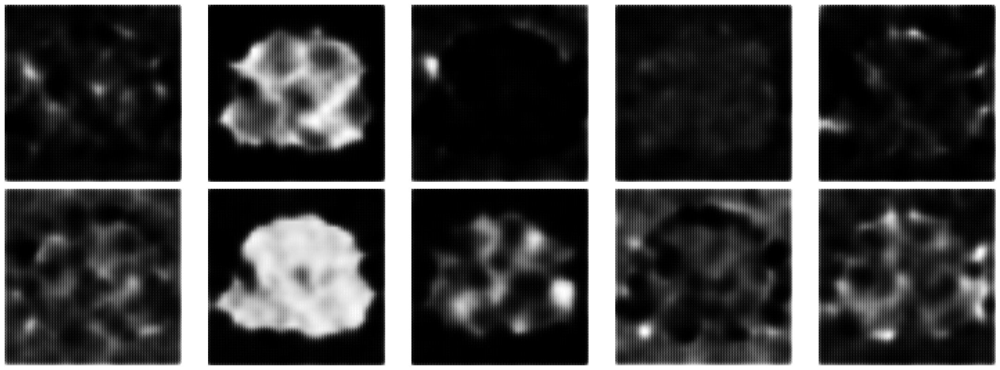

  0%|                                                                                                                        | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 1/3750 [00:00<07:19,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 2/3750 [00:00<06:53,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 3/3750 [00:00<06:45,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                                                                                                | 4/3750 [00:00<06:40,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                                                                                               | 5/3750 [00:00<06:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                                                                                               | 6/3750 [00:00<06:35,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                                                                                               | 7/3750 [00:00<06:35,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                                                                                               | 8/3750 [00:00<06:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                               | 9/3750 [00:00<06:33,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                              | 10/3750 [00:01<06:42,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                              | 11/3750 [00:01<06:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                              | 12/3750 [00:01<06:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 13/3750 [00:01<06:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 14/3750 [00:01<06:36,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▍                                                                                                              | 15/3750 [00:01<06:34,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 16/3750 [00:01<06:35,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▌                                                                                                              | 17/3750 [00:01<06:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▌                                                                                                              | 18/3750 [00:01<06:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                                                                                              | 19/3750 [00:02<06:34,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 20/3750 [00:02<06:33,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 21/3750 [00:02<06:32,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 22/3750 [00:02<06:32,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▋                                                                                                              | 23/3750 [00:02<06:31,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 24/3750 [00:02<06:30,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 25/3750 [00:02<06:31,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▊                                                                                                              | 26/3750 [00:02<06:30,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 27/3750 [00:02<06:30,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▊                                                                                                              | 28/3750 [00:02<06:32,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 29/3750 [00:03<06:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▉                                                                                                              | 30/3750 [00:03<06:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▉                                                                                                              | 31/3750 [00:03<06:36,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▉                                                                                                              | 32/3750 [00:03<06:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▉                                                                                                              | 33/3750 [00:03<06:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█                                                                                                              | 34/3750 [00:03<06:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█                                                                                                              | 35/3750 [00:03<06:30,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█                                                                                                              | 36/3750 [00:03<06:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█                                                                                                              | 37/3750 [00:03<06:31,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 38/3750 [00:04<06:31,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 39/3750 [00:04<06:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▏                                                                                                             | 40/3750 [00:04<06:29,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▏                                                                                                             | 41/3750 [00:04<06:29,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 42/3750 [00:04<06:29,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 43/3750 [00:04<06:28,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 44/3750 [00:04<06:27,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 45/3750 [00:04<06:27,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 46/3750 [00:04<06:29,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 47/3750 [00:04<06:28,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 48/3750 [00:05<06:28,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 49/3750 [00:05<06:28,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 50/3750 [00:05<06:28,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 51/3750 [00:05<06:28,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 52/3750 [00:05<06:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 53/3750 [00:05<06:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 54/3750 [00:05<06:29,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▋                                                                                                             | 55/3750 [00:05<06:30,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▋                                                                                                             | 56/3750 [00:05<06:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▋                                                                                                             | 57/3750 [00:06<06:29,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▋                                                                                                             | 58/3750 [00:06<06:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▋                                                                                                             | 59/3750 [00:06<06:27,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 60/3750 [00:06<06:26,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 61/3750 [00:06<06:26,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▊                                                                                                             | 62/3750 [00:06<06:25,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▊                                                                                                             | 63/3750 [00:06<06:27,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▉                                                                                                             | 64/3750 [00:06<06:30,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 65/3750 [00:07<09:26,  6.50it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 66/3750 [00:07<08:33,  7.17it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 67/3750 [00:07<08:01,  7.65it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 68/3750 [00:07<07:34,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


  2%|██                                                                                                             | 69/3750 [00:07<07:32,  8.14it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 70/3750 [00:07<07:14,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 71/3750 [00:07<07:02,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 72/3750 [00:07<06:52,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 73/3750 [00:07<06:52,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 74/3750 [00:08<06:44,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 75/3750 [00:08<06:40,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 76/3750 [00:08<06:38,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 77/3750 [00:08<06:35,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 78/3750 [00:08<06:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 79/3750 [00:08<06:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 80/3750 [00:08<06:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 81/3750 [00:08<06:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 82/3750 [00:08<06:30,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 83/3750 [00:08<06:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 84/3750 [00:09<06:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 85/3750 [00:09<06:29,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 86/3750 [00:09<06:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 87/3750 [00:09<06:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▌                                                                                                            | 88/3750 [00:09<06:26,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 89/3750 [00:09<06:26,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 90/3750 [00:09<06:26,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 91/3750 [00:09<06:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 92/3750 [00:09<06:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▊                                                                                                            | 93/3750 [00:10<06:27,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


  3%|██▊                                                                                                            | 94/3750 [00:10<06:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 95/3750 [00:10<06:28,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 96/3750 [00:10<06:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 97/3750 [00:10<06:27,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                            | 98/3750 [00:10<06:25,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                            | 99/3750 [00:10<06:25,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                           | 100/3750 [00:10<06:28,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


  3%|██▉                                                                                                           | 101/3750 [00:10<06:28,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


  3%|██▉                                                                                                           | 102/3750 [00:10<06:29,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


  3%|███                                                                                                           | 103/3750 [00:11<06:31,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


  3%|███                                                                                                           | 104/3750 [00:11<06:32,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 105/3750 [00:11<06:30,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 106/3750 [00:11<06:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 107/3750 [00:11<06:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 108/3750 [00:11<06:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 109/3750 [00:11<06:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 110/3750 [00:11<06:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 111/3750 [00:11<06:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 112/3750 [00:12<06:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 113/3750 [00:12<06:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 114/3750 [00:12<06:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 115/3750 [00:12<06:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 116/3750 [00:12<06:23,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 117/3750 [00:12<06:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 118/3750 [00:12<06:25,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 119/3750 [00:12<06:25,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 120/3750 [00:12<06:25,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 121/3750 [00:12<06:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 122/3750 [00:13<06:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▌                                                                                                          | 123/3750 [00:13<06:23,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▋                                                                                                          | 124/3750 [00:13<06:22,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▋                                                                                                          | 125/3750 [00:13<06:21,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 126/3750 [00:13<06:21,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 127/3750 [00:13<06:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 128/3750 [00:13<06:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 129/3750 [00:13<06:25,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 130/3750 [00:13<06:23,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 131/3750 [00:14<06:23,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▊                                                                                                          | 132/3750 [00:14<06:22,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 133/3750 [00:14<06:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▉                                                                                                          | 134/3750 [00:14<06:20,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 135/3750 [00:14<06:20,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 136/3750 [00:14<06:23,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████                                                                                                          | 137/3750 [00:14<06:25,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 138/3750 [00:14<06:24,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 139/3750 [00:14<06:23,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 140/3750 [00:15<06:22,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▏                                                                                                         | 141/3750 [00:15<06:22,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▏                                                                                                         | 142/3750 [00:15<06:21,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▏                                                                                                         | 143/3750 [00:15<06:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▏                                                                                                         | 144/3750 [00:15<06:21,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 145/3750 [00:15<06:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 146/3750 [00:15<06:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 147/3750 [00:15<06:22,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 148/3750 [00:15<06:28,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 149/3750 [00:15<06:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▍                                                                                                         | 150/3750 [00:16<06:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▍                                                                                                         | 151/3750 [00:16<06:22,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▍                                                                                                         | 152/3750 [00:16<06:21,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▍                                                                                                         | 153/3750 [00:16<06:21,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 154/3750 [00:16<06:22,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 155/3750 [00:16<06:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 156/3750 [00:16<06:20,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 157/3750 [00:16<06:21,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 158/3750 [00:16<06:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 159/3750 [00:17<06:20,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 160/3750 [00:17<06:20,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 161/3750 [00:17<06:21,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 162/3750 [00:17<06:20,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 163/3750 [00:17<06:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 164/3750 [00:17<06:20,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 165/3750 [00:17<06:19,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 166/3750 [00:17<06:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▉                                                                                                         | 167/3750 [00:17<06:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▉                                                                                                         | 168/3750 [00:17<06:17,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  5%|████▉                                                                                                         | 169/3750 [00:18<06:22,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  5%|████▉                                                                                                         | 170/3750 [00:18<06:20,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████                                                                                                         | 171/3750 [00:18<06:18,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 172/3750 [00:18<06:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 173/3750 [00:18<06:20,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 174/3750 [00:18<06:19,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 175/3750 [00:18<06:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▏                                                                                                        | 176/3750 [00:18<06:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▏                                                                                                        | 177/3750 [00:18<06:17,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 178/3750 [00:19<06:18,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█████▎                                                                                                        | 179/3750 [00:19<06:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 180/3750 [00:19<06:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 181/3750 [00:19<06:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 182/3750 [00:19<06:18,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 183/3750 [00:19<06:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 184/3750 [00:19<06:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 185/3750 [00:19<06:15,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 186/3750 [00:19<06:15,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 187/3750 [00:19<06:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 188/3750 [00:20<06:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 189/3750 [00:20<06:14,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 190/3750 [00:20<06:17,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▌                                                                                                        | 191/3750 [00:20<06:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 192/3750 [00:20<06:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▋                                                                                                        | 193/3750 [00:20<06:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 194/3750 [00:20<06:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 195/3750 [00:20<06:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▋                                                                                                        | 196/3750 [00:20<06:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▊                                                                                                        | 197/3750 [00:21<06:14,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 198/3750 [00:21<06:13,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 199/3750 [00:21<06:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 200/3750 [00:21<06:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 201/3750 [00:21<06:15,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▉                                                                                                        | 202/3750 [00:21<06:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▉                                                                                                        | 203/3750 [00:21<06:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▉                                                                                                        | 204/3750 [00:21<06:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██████                                                                                                        | 205/3750 [00:21<06:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██████                                                                                                        | 206/3750 [00:21<06:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████                                                                                                        | 207/3750 [00:22<06:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████                                                                                                        | 208/3750 [00:22<06:14,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 209/3750 [00:22<06:13,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██████▏                                                                                                       | 210/3750 [00:22<06:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 211/3750 [00:22<06:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 212/3750 [00:22<06:15,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 213/3750 [00:22<06:13,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▎                                                                                                       | 214/3750 [00:22<06:17,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 215/3750 [00:22<06:15,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 216/3750 [00:23<06:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▎                                                                                                       | 217/3750 [00:23<06:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 218/3750 [00:23<06:15,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 219/3750 [00:23<06:13,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 220/3750 [00:23<06:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 221/3750 [00:23<06:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 222/3750 [00:23<06:10,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 223/3750 [00:23<06:10,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 224/3750 [00:23<06:10,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 225/3750 [00:24<06:09,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▋                                                                                                       | 226/3750 [00:24<06:08,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▋                                                                                                       | 227/3750 [00:24<06:12,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 228/3750 [00:24<06:12,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 229/3750 [00:24<06:12,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 230/3750 [00:24<06:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 231/3750 [00:24<06:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▊                                                                                                       | 232/3750 [00:24<06:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▊                                                                                                       | 233/3750 [00:24<06:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▊                                                                                                       | 234/3750 [00:24<06:08,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 235/3750 [00:25<06:07,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 236/3750 [00:25<06:14,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 237/3750 [00:25<06:13,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 238/3750 [00:25<06:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 239/3750 [00:25<06:10,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████                                                                                                       | 240/3750 [00:25<06:10,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 241/3750 [00:25<06:09,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 242/3750 [00:25<06:09,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████▏                                                                                                      | 243/3750 [00:25<06:08,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▏                                                                                                      | 244/3750 [00:26<06:07,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▏                                                                                                      | 245/3750 [00:26<06:09,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 246/3750 [00:26<06:09,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▏                                                                                                      | 247/3750 [00:26<06:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 248/3750 [00:26<06:14,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


  7%|███████▎                                                                                                      | 249/3750 [00:26<06:14,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▎                                                                                                      | 250/3750 [00:26<06:13,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▎                                                                                                      | 251/3750 [00:26<06:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 252/3750 [00:26<06:11,  9.42it/s]

1/1 [==============================] - 0s 11ms/step


  7%|███████▍                                                                                                      | 253/3750 [00:26<06:12,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


  7%|███████▍                                                                                                      | 254/3750 [00:27<06:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▍                                                                                                      | 255/3750 [00:27<06:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 256/3750 [00:27<06:10,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▌                                                                                                      | 257/3750 [00:27<06:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▌                                                                                                      | 258/3750 [00:27<06:08,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 259/3750 [00:27<06:08,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 260/3750 [00:27<06:07,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 261/3750 [00:27<06:06,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 262/3750 [00:27<06:06,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 263/3750 [00:28<06:06,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 264/3750 [00:28<06:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 265/3750 [00:28<06:08,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 266/3750 [00:28<06:08,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 267/3750 [00:28<06:13,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 268/3750 [00:28<06:11,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▉                                                                                                      | 269/3750 [00:28<06:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▉                                                                                                      | 270/3750 [00:28<06:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▉                                                                                                      | 271/3750 [00:28<06:07,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▉                                                                                                      | 272/3750 [00:28<06:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████                                                                                                      | 273/3750 [00:29<06:08,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 274/3750 [00:29<06:08,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 275/3750 [00:29<06:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 276/3750 [00:29<06:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 277/3750 [00:29<06:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 278/3750 [00:29<06:06,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 279/3750 [00:29<06:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████▏                                                                                                     | 280/3750 [00:29<06:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 281/3750 [00:29<06:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▎                                                                                                     | 282/3750 [00:30<06:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 283/3750 [00:30<06:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▎                                                                                                     | 284/3750 [00:30<06:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▎                                                                                                     | 285/3750 [00:30<06:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 286/3750 [00:30<06:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▍                                                                                                     | 287/3750 [00:30<06:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▍                                                                                                     | 288/3750 [00:30<06:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▍                                                                                                     | 289/3750 [00:30<06:03,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 290/3750 [00:30<06:02,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 291/3750 [00:30<06:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 292/3750 [00:31<06:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 293/3750 [00:31<06:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 294/3750 [00:31<06:02,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▋                                                                                                     | 295/3750 [00:31<06:02,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 296/3750 [00:31<06:02,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▋                                                                                                     | 297/3750 [00:31<06:01,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▋                                                                                                     | 298/3750 [00:31<06:01,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 299/3750 [00:31<06:01,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 300/3750 [00:31<06:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▊                                                                                                     | 301/3750 [00:32<06:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▊                                                                                                     | 302/3750 [00:32<06:02,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 303/3750 [00:32<06:01,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 304/3750 [00:32<06:00,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 305/3750 [00:32<06:00,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 306/3750 [00:32<06:00,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 307/3750 [00:32<06:00,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████                                                                                                     | 308/3750 [00:32<06:00,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████                                                                                                     | 309/3750 [00:32<06:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████                                                                                                     | 310/3750 [00:32<06:02,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████                                                                                                     | 311/3750 [00:33<06:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 312/3750 [00:33<06:02,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 313/3750 [00:33<06:02,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 314/3750 [00:33<06:01,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 315/3750 [00:33<06:07,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▎                                                                                                    | 316/3750 [00:33<06:05,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▎                                                                                                    | 317/3750 [00:33<06:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▎                                                                                                    | 318/3750 [00:33<06:03,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▎                                                                                                    | 319/3750 [00:33<06:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 320/3750 [00:34<06:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 321/3750 [00:34<06:01,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 322/3750 [00:34<06:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 323/3750 [00:34<06:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 324/3750 [00:34<06:00,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 325/3750 [00:34<06:00,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 326/3750 [00:34<06:01,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 327/3750 [00:34<06:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 328/3750 [00:34<06:03,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 329/3750 [00:34<06:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 330/3750 [00:35<06:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 331/3750 [00:35<06:02,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 332/3750 [00:35<06:00,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 333/3750 [00:35<05:59,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▊                                                                                                    | 334/3750 [00:35<05:58,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 335/3750 [00:35<05:58,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▊                                                                                                    | 336/3750 [00:35<05:58,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▉                                                                                                    | 337/3750 [00:35<06:00,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▉                                                                                                    | 338/3750 [00:35<05:59,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▉                                                                                                    | 339/3750 [00:36<05:59,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▉                                                                                                    | 340/3750 [00:36<05:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 341/3750 [00:36<05:57,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 342/3750 [00:36<05:57,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 343/3750 [00:36<05:57,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 344/3750 [00:36<05:56,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 345/3750 [00:36<05:56,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▏                                                                                                   | 346/3750 [00:36<05:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▏                                                                                                   | 347/3750 [00:36<06:03,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▏                                                                                                   | 348/3750 [00:36<06:01,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 349/3750 [00:37<06:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 350/3750 [00:37<05:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 351/3750 [00:37<05:58,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▎                                                                                                   | 352/3750 [00:37<05:57,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 353/3750 [00:37<05:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▍                                                                                                   | 354/3750 [00:37<05:56,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▍                                                                                                   | 355/3750 [00:37<05:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▍                                                                                                   | 356/3750 [00:37<05:57,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▍                                                                                                   | 357/3750 [00:37<05:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 358/3750 [00:38<05:56,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 359/3750 [00:38<05:57,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 360/3750 [00:38<05:56,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 361/3750 [00:38<05:55,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 362/3750 [00:38<05:55,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▋                                                                                                   | 363/3750 [00:38<05:55,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▋                                                                                                   | 364/3750 [00:38<05:57,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 365/3750 [00:38<05:56,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 366/3750 [00:38<05:56,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 367/3750 [00:38<05:56,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 368/3750 [00:39<05:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 369/3750 [00:39<05:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 370/3750 [00:39<05:55,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 371/3750 [00:39<05:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▉                                                                                                   | 372/3750 [00:39<05:54,  9.53it/s]

1/1 [==============================] - 0s 10ms/step


 10%|██████████▉                                                                                                   | 373/3750 [00:39<05:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 374/3750 [00:39<05:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 375/3750 [00:39<05:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 376/3750 [00:39<05:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 377/3750 [00:40<05:55,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 378/3750 [00:40<05:55,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 379/3750 [00:40<05:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 380/3750 [00:40<05:54,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 381/3750 [00:40<05:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 382/3750 [00:40<05:56,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 383/3750 [00:40<05:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 384/3750 [00:40<05:54,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▎                                                                                                  | 385/3750 [00:40<05:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 386/3750 [00:40<05:59,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 387/3750 [00:41<05:57,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 388/3750 [00:41<05:55,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 389/3750 [00:41<05:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 390/3750 [00:41<05:52,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 391/3750 [00:41<05:52,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 392/3750 [00:41<05:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▌                                                                                                  | 393/3750 [00:41<05:53,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▌                                                                                                  | 394/3750 [00:41<05:53,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▌                                                                                                  | 395/3750 [00:41<05:52,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▌                                                                                                  | 396/3750 [00:42<05:51,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 397/3750 [00:42<05:51,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 398/3750 [00:42<05:51,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▋                                                                                                  | 399/3750 [00:42<05:53,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 400/3750 [00:42<05:52,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 401/3750 [00:42<05:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 402/3750 [00:42<05:55,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 403/3750 [00:42<05:55,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 404/3750 [00:42<05:59,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 405/3750 [00:42<05:57,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 406/3750 [00:43<05:56,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 407/3750 [00:43<05:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 408/3750 [00:43<05:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 409/3750 [00:43<05:52,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 410/3750 [00:43<05:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 411/3750 [00:43<05:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 412/3750 [00:43<05:52,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 413/3750 [00:43<05:51,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 414/3750 [00:43<05:50,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▏                                                                                                 | 415/3750 [00:44<05:51,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▏                                                                                                 | 416/3750 [00:44<05:51,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▏                                                                                                 | 417/3750 [00:44<05:51,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 418/3750 [00:44<05:50,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 419/3750 [00:44<05:52,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 420/3750 [00:44<05:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 421/3750 [00:44<05:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 422/3750 [00:44<05:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 423/3750 [00:44<05:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 424/3750 [00:45<05:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 425/3750 [00:45<05:49,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 426/3750 [00:45<05:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▌                                                                                                 | 427/3750 [00:45<05:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▌                                                                                                 | 428/3750 [00:45<05:51,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 429/3750 [00:45<05:50,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 430/3750 [00:45<05:51,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▋                                                                                                 | 431/3750 [00:45<05:51,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▋                                                                                                 | 432/3750 [00:45<05:51,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▋                                                                                                 | 433/3750 [00:45<05:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▋                                                                                                 | 434/3750 [00:46<05:51,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 435/3750 [00:46<05:51,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 436/3750 [00:46<05:49,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▊                                                                                                 | 437/3750 [00:46<05:49,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▊                                                                                                 | 438/3750 [00:46<05:51,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 12%|████████████▉                                                                                                 | 439/3750 [00:46<05:53,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 440/3750 [00:46<05:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 441/3750 [00:46<05:52,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 442/3750 [00:46<05:50,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 443/3750 [00:47<05:49,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████                                                                                                 | 444/3750 [00:47<05:49,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████                                                                                                 | 445/3750 [00:47<05:48,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████                                                                                                 | 446/3750 [00:47<05:56,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 447/3750 [00:47<05:56,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 448/3750 [00:47<05:53,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 449/3750 [00:47<05:52,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 450/3750 [00:47<05:51,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 451/3750 [00:47<05:50,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 452/3750 [00:47<05:49,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 453/3750 [00:48<05:48,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 454/3750 [00:48<05:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 455/3750 [00:48<05:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▍                                                                                                | 456/3750 [00:48<05:49,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▍                                                                                                | 457/3750 [00:48<05:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▍                                                                                                | 458/3750 [00:48<05:48,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 459/3750 [00:48<05:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 460/3750 [00:48<05:52,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 461/3750 [00:48<05:51,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 462/3750 [00:49<05:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 463/3750 [00:49<05:48,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 464/3750 [00:49<05:47,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 465/3750 [00:49<05:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▋                                                                                                | 466/3750 [00:49<05:48,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 467/3750 [00:49<05:48,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▋                                                                                                | 468/3750 [00:49<05:47,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 469/3750 [00:49<05:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 470/3750 [00:49<05:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 471/3750 [00:49<05:49,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 472/3750 [00:50<05:48,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 473/3750 [00:50<05:47,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 474/3750 [00:50<05:46,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 475/3750 [00:50<05:49,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 476/3750 [00:50<05:49,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▉                                                                                                | 477/3750 [00:50<05:48,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 478/3750 [00:50<05:47,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████                                                                                                | 479/3750 [00:50<05:46,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████                                                                                                | 480/3750 [00:50<05:45,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 481/3750 [00:51<05:45,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 13%|██████████████▏                                                                                               | 482/3750 [00:51<05:47,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 13%|██████████████▏                                                                                               | 483/3750 [00:51<05:50,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 484/3750 [00:51<05:49,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▏                                                                                               | 485/3750 [00:51<05:49,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 486/3750 [00:51<05:47,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 487/3750 [00:51<05:46,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 488/3750 [00:51<05:46,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 489/3750 [00:51<05:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 490/3750 [00:52<05:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 491/3750 [00:52<05:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 492/3750 [00:52<05:43,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 493/3750 [00:52<05:43,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 494/3750 [00:52<05:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 495/3750 [00:52<05:45,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 496/3750 [00:52<05:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 497/3750 [00:52<05:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 498/3750 [00:52<05:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▋                                                                                               | 499/3750 [00:52<05:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 500/3750 [00:53<05:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 501/3750 [00:53<05:41,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 502/3750 [00:53<05:41,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▊                                                                                               | 503/3750 [00:53<05:49,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▊                                                                                               | 504/3750 [00:53<05:47,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▊                                                                                               | 505/3750 [00:53<05:45,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▊                                                                                               | 506/3750 [00:53<05:44,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▊                                                                                               | 507/3750 [00:53<05:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▉                                                                                               | 508/3750 [00:53<05:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▉                                                                                               | 509/3750 [00:54<05:42,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 510/3750 [00:54<05:41,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 511/3750 [00:54<05:41,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████                                                                                               | 512/3750 [00:54<05:44,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████                                                                                               | 513/3750 [00:54<05:42,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 514/3750 [00:54<05:43,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 515/3750 [00:54<05:43,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 516/3750 [00:54<05:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 517/3750 [00:54<05:41,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 518/3750 [00:54<05:40,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▏                                                                                              | 519/3750 [00:55<05:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 520/3750 [00:55<05:40,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 521/3750 [00:55<05:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 522/3750 [00:55<05:41,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 523/3750 [00:55<05:41,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 524/3750 [00:55<05:42,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 525/3750 [00:55<05:42,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 526/3750 [00:55<05:41,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 14%|███████████████▍                                                                                              | 527/3750 [00:55<05:42,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 528/3750 [00:56<05:43,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 529/3750 [00:56<05:46,  9.29it/s]

1/1 [==============================] - 0s 11ms/step


 14%|███████████████▌                                                                                              | 530/3750 [00:56<05:54,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 14%|███████████████▌                                                                                              | 531/3750 [00:56<06:00,  8.93it/s]

1/1 [==============================] - 0s 12ms/step


 14%|███████████████▌                                                                                              | 532/3750 [00:56<06:12,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


 14%|███████████████▋                                                                                              | 533/3750 [00:56<06:06,  8.77it/s]

1/1 [==============================] - 0s 10ms/step


 14%|███████████████▋                                                                                              | 534/3750 [00:56<06:08,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▋                                                                                              | 535/3750 [00:56<06:53,  7.77it/s]

1/1 [==============================] - 0s 10ms/step


 14%|███████████████▋                                                                                              | 536/3750 [00:57<06:57,  7.69it/s]

1/1 [==============================] - 0s 10ms/step


 14%|███████████████▊                                                                                              | 537/3750 [00:57<07:09,  7.48it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 538/3750 [00:57<06:42,  7.98it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 539/3750 [00:57<06:23,  8.37it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 540/3750 [00:57<06:11,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 541/3750 [00:57<06:02,  8.86it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▉                                                                                              | 542/3750 [00:57<05:54,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▉                                                                                              | 543/3750 [00:57<05:57,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 15%|███████████████▉                                                                                              | 544/3750 [00:57<05:52,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 15%|███████████████▉                                                                                              | 545/3750 [00:58<05:54,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 546/3750 [00:58<06:02,  8.83it/s]

1/1 [==============================] - 0s 11ms/step


 15%|████████████████                                                                                              | 547/3750 [00:58<06:14,  8.55it/s]

1/1 [==============================] - 0s 11ms/step


 15%|████████████████                                                                                              | 548/3750 [00:58<06:22,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 549/3750 [00:58<06:12,  8.59it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 550/3750 [00:58<06:04,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 551/3750 [00:58<05:57,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 552/3750 [00:58<05:52,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 553/3750 [00:58<05:47,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 554/3750 [00:59<05:44,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 555/3750 [00:59<05:43,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 556/3750 [00:59<05:42,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 557/3750 [00:59<05:40,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 558/3750 [00:59<05:39,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 559/3750 [00:59<05:39,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 560/3750 [00:59<05:38,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 561/3750 [00:59<05:36,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 562/3750 [00:59<05:36,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 563/3750 [00:59<05:36,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 564/3750 [01:00<05:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 565/3750 [01:00<05:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 566/3750 [01:00<05:42,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 567/3750 [01:00<05:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 568/3750 [01:00<05:41,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 569/3750 [01:00<05:39,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 570/3750 [01:00<05:38,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 571/3750 [01:00<05:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▊                                                                                             | 572/3750 [01:00<05:35,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 573/3750 [01:01<05:35,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▊                                                                                             | 574/3750 [01:01<05:33,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 575/3750 [01:01<05:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▉                                                                                             | 576/3750 [01:01<05:34,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▉                                                                                             | 577/3750 [01:01<05:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 578/3750 [01:01<05:45,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▉                                                                                             | 579/3750 [01:01<05:42,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████████████████                                                                                             | 580/3750 [01:01<05:40,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████████████████                                                                                             | 581/3750 [01:01<05:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████                                                                                             | 582/3750 [01:02<05:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████                                                                                             | 583/3750 [01:02<05:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 584/3750 [01:02<05:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 585/3750 [01:02<05:34,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 586/3750 [01:02<05:35,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 587/3750 [01:02<05:35,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 588/3750 [01:02<05:33,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▎                                                                                            | 589/3750 [01:02<05:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 590/3750 [01:02<05:38,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 591/3750 [01:02<05:36,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 592/3750 [01:03<05:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 593/3750 [01:03<05:34,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 594/3750 [01:03<05:33,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 595/3750 [01:03<05:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▍                                                                                            | 596/3750 [01:03<05:37,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 597/3750 [01:03<05:36,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 598/3750 [01:03<05:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 599/3750 [01:03<05:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 600/3750 [01:03<05:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 601/3750 [01:04<05:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 602/3750 [01:04<05:33,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 603/3750 [01:04<05:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 604/3750 [01:04<05:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 605/3750 [01:04<05:37,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 606/3750 [01:04<05:36,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 607/3750 [01:04<05:39,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 608/3750 [01:04<05:37,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 609/3750 [01:04<05:35,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 610/3750 [01:04<05:34,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 611/3750 [01:05<05:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 612/3750 [01:05<05:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 613/3750 [01:05<05:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 614/3750 [01:05<05:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 615/3750 [01:05<05:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 616/3750 [01:05<05:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 617/3750 [01:05<05:31,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████▏                                                                                           | 618/3750 [01:05<05:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▏                                                                                           | 619/3750 [01:05<05:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▏                                                                                           | 620/3750 [01:06<05:30,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████████████████▏                                                                                           | 621/3750 [01:06<05:31,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 622/3750 [01:06<05:32,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 623/3750 [01:06<05:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 624/3750 [01:06<05:33,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 625/3750 [01:06<05:32,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 626/3750 [01:06<05:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 627/3750 [01:06<05:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 628/3750 [01:06<05:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 629/3750 [01:07<05:29,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 630/3750 [01:07<05:29,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████████████████▌                                                                                           | 631/3750 [01:07<05:33,  9.36it/s]

1/1 [==============================] - 0s 11ms/step


 17%|██████████████████▌                                                                                           | 632/3750 [01:07<05:35,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▌                                                                                           | 633/3750 [01:07<05:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 634/3750 [01:07<05:33,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 635/3750 [01:07<05:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 636/3750 [01:07<05:31,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 637/3750 [01:07<05:30,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 638/3750 [01:07<05:29,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 639/3750 [01:08<05:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 640/3750 [01:08<05:27,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▊                                                                                           | 641/3750 [01:08<05:27,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▊                                                                                           | 642/3750 [01:08<05:29,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 643/3750 [01:08<05:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 644/3750 [01:08<05:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 645/3750 [01:08<05:27,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 646/3750 [01:08<05:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 647/3750 [01:08<05:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 648/3750 [01:09<05:25,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 649/3750 [01:09<05:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 650/3750 [01:09<05:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 651/3750 [01:09<05:29,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 652/3750 [01:09<05:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 653/3750 [01:09<05:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 654/3750 [01:09<05:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 655/3750 [01:09<05:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 656/3750 [01:09<05:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▎                                                                                          | 657/3750 [01:09<05:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▎                                                                                          | 658/3750 [01:10<05:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▎                                                                                          | 659/3750 [01:10<05:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▎                                                                                          | 660/3750 [01:10<05:27,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 661/3750 [01:10<05:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▍                                                                                          | 662/3750 [01:10<05:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 663/3750 [01:10<05:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▍                                                                                          | 664/3750 [01:10<05:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 665/3750 [01:10<05:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 666/3750 [01:10<05:24,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 667/3750 [01:11<05:24,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 668/3750 [01:11<05:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 669/3750 [01:11<05:25,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▋                                                                                          | 670/3750 [01:11<05:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 671/3750 [01:11<05:26,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▋                                                                                          | 672/3750 [01:11<05:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 673/3750 [01:11<05:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▊                                                                                          | 674/3750 [01:11<05:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▊                                                                                          | 675/3750 [01:11<05:24,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▊                                                                                          | 676/3750 [01:11<05:23,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▊                                                                                          | 677/3750 [01:12<05:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▉                                                                                          | 678/3750 [01:12<05:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 679/3750 [01:12<05:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▉                                                                                          | 680/3750 [01:12<05:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▉                                                                                          | 681/3750 [01:12<05:23,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 682/3750 [01:12<05:23,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 683/3750 [01:12<05:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 684/3750 [01:12<05:22,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 685/3750 [01:12<05:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 686/3750 [01:13<05:21,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▏                                                                                         | 687/3750 [01:13<05:23,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 688/3750 [01:13<05:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 689/3750 [01:13<05:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▏                                                                                         | 690/3750 [01:13<05:24,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 691/3750 [01:13<05:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▎                                                                                         | 692/3750 [01:13<05:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▎                                                                                         | 693/3750 [01:13<05:22,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▎                                                                                         | 694/3750 [01:13<05:21,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▍                                                                                         | 695/3750 [01:13<05:21,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▍                                                                                         | 696/3750 [01:14<05:21,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▍                                                                                         | 697/3750 [01:14<05:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 698/3750 [01:14<05:22,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 699/3750 [01:14<05:22,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 700/3750 [01:14<05:21,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▌                                                                                         | 701/3750 [01:14<05:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▌                                                                                         | 702/3750 [01:14<05:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▌                                                                                         | 703/3750 [01:14<05:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▋                                                                                         | 704/3750 [01:14<05:21,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 705/3750 [01:15<05:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▋                                                                                         | 706/3750 [01:15<05:23,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 707/3750 [01:15<05:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 708/3750 [01:15<05:22,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 709/3750 [01:15<05:21,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 710/3750 [01:15<05:22,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 711/3750 [01:15<05:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 712/3750 [01:15<05:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 713/3750 [01:15<05:20,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 714/3750 [01:15<05:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 715/3750 [01:16<05:21,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 716/3750 [01:16<05:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 717/3750 [01:16<05:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 718/3750 [01:16<05:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 719/3750 [01:16<05:19,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 720/3750 [01:16<05:19,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 721/3750 [01:16<05:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▏                                                                                        | 722/3750 [01:16<05:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▏                                                                                        | 723/3750 [01:16<05:19,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 724/3750 [01:17<05:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 725/3750 [01:17<05:20,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 726/3750 [01:17<05:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 727/3750 [01:17<05:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 728/3750 [01:17<05:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▍                                                                                        | 729/3750 [01:17<05:17,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▍                                                                                        | 730/3750 [01:17<05:17,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▍                                                                                        | 731/3750 [01:17<05:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▍                                                                                        | 732/3750 [01:17<05:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 733/3750 [01:17<05:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 734/3750 [01:18<05:29,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 735/3750 [01:18<05:25,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 736/3750 [01:18<05:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 737/3750 [01:18<05:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 738/3750 [01:18<05:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 739/3750 [01:18<05:18,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▋                                                                                        | 740/3750 [01:18<05:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 741/3750 [01:18<05:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 742/3750 [01:18<05:16,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 743/3750 [01:19<05:18,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 744/3750 [01:19<05:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 745/3750 [01:19<05:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 746/3750 [01:19<05:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 747/3750 [01:19<05:16,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 748/3750 [01:19<05:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 749/3750 [01:19<05:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 750/3750 [01:19<05:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 751/3750 [01:19<05:15,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 752/3750 [01:20<05:15,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 753/3750 [01:20<05:21,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 754/3750 [01:20<05:20,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▏                                                                                       | 755/3750 [01:20<05:18,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▏                                                                                       | 756/3750 [01:20<05:17,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 757/3750 [01:20<05:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 758/3750 [01:20<05:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 759/3750 [01:20<05:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 760/3750 [01:20<05:14,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 761/3750 [01:20<05:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 762/3750 [01:21<05:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 763/3750 [01:21<05:15,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 764/3750 [01:21<05:15,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 765/3750 [01:21<05:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 766/3750 [01:21<05:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 767/3750 [01:21<05:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▌                                                                                       | 768/3750 [01:21<05:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▌                                                                                       | 769/3750 [01:21<05:14,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▌                                                                                       | 770/3750 [01:21<05:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▌                                                                                       | 771/3750 [01:22<05:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 772/3750 [01:22<05:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 773/3750 [01:22<05:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 774/3750 [01:22<05:15,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▋                                                                                       | 775/3750 [01:22<05:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▊                                                                                       | 776/3750 [01:22<05:13,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 777/3750 [01:22<05:18,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▊                                                                                       | 778/3750 [01:22<05:16,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 779/3750 [01:22<05:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 780/3750 [01:22<05:15,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 781/3750 [01:23<05:16,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 782/3750 [01:23<05:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 783/3750 [01:23<05:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 784/3750 [01:23<05:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████                                                                                       | 785/3750 [01:23<05:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████                                                                                       | 786/3750 [01:23<05:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████                                                                                       | 787/3750 [01:23<05:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████                                                                                       | 788/3750 [01:23<05:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▏                                                                                      | 789/3750 [01:23<05:11,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 790/3750 [01:24<05:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▏                                                                                      | 791/3750 [01:24<05:12,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 792/3750 [01:24<05:11,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 793/3750 [01:24<05:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▎                                                                                      | 794/3750 [01:24<05:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▎                                                                                      | 795/3750 [01:24<05:10,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 796/3750 [01:24<05:11,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 797/3750 [01:24<05:10,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 798/3750 [01:24<05:09,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 799/3750 [01:24<05:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 800/3750 [01:25<05:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 801/3750 [01:25<05:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▌                                                                                      | 802/3750 [01:25<05:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▌                                                                                      | 803/3750 [01:25<05:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▌                                                                                      | 804/3750 [01:25<05:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▌                                                                                      | 805/3750 [01:25<05:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▋                                                                                      | 806/3750 [01:25<05:09,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▋                                                                                      | 807/3750 [01:25<05:08,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 808/3750 [01:25<05:10,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 809/3750 [01:26<05:10,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 810/3750 [01:26<05:09,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 811/3750 [01:26<05:09,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 812/3750 [01:26<05:19,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▊                                                                                      | 813/3750 [01:26<05:17,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 814/3750 [01:26<05:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 815/3750 [01:26<05:14,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 816/3750 [01:26<05:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 817/3750 [01:26<05:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 818/3750 [01:27<05:15,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 819/3750 [01:27<05:13,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 820/3750 [01:27<05:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 821/3750 [01:27<05:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 822/3750 [01:27<05:10,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 823/3750 [01:27<05:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▏                                                                                     | 824/3750 [01:27<05:09,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 825/3750 [01:27<05:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▏                                                                                     | 826/3750 [01:27<05:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 827/3750 [01:27<05:09,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 828/3750 [01:28<05:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▎                                                                                     | 829/3750 [01:28<05:09,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 830/3750 [01:28<05:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 831/3750 [01:28<05:08,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 832/3750 [01:28<05:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 833/3750 [01:28<05:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 834/3750 [01:28<05:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 835/3750 [01:28<05:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 836/3750 [01:28<05:13,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 837/3750 [01:29<05:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 838/3750 [01:29<05:10,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 839/3750 [01:29<05:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▋                                                                                     | 840/3750 [01:29<05:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▋                                                                                     | 841/3750 [01:29<05:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▋                                                                                     | 842/3750 [01:29<05:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▋                                                                                     | 843/3750 [01:29<05:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 844/3750 [01:29<05:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 845/3750 [01:29<05:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 846/3750 [01:29<05:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 847/3750 [01:30<05:07,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 848/3750 [01:30<05:07,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 849/3750 [01:30<05:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 850/3750 [01:30<05:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▉                                                                                     | 851/3750 [01:30<05:05,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 852/3750 [01:30<05:05,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 853/3750 [01:30<05:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 854/3750 [01:30<05:07,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 855/3750 [01:30<05:07,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 856/3750 [01:31<05:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 857/3750 [01:31<05:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 858/3750 [01:31<05:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▏                                                                                    | 859/3750 [01:31<05:06,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 860/3750 [01:31<05:07,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 861/3750 [01:31<05:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 862/3750 [01:31<05:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 863/3750 [01:31<05:07,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 864/3750 [01:31<05:06,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 865/3750 [01:31<05:05,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 866/3750 [01:32<05:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 867/3750 [01:32<05:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 868/3750 [01:32<05:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 869/3750 [01:32<05:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▌                                                                                    | 870/3750 [01:32<05:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▌                                                                                    | 871/3750 [01:32<05:07,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 872/3750 [01:32<05:08,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▌                                                                                    | 873/3750 [01:32<05:05,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 874/3750 [01:32<05:05,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▋                                                                                    | 875/3750 [01:33<05:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 876/3750 [01:33<05:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 877/3750 [01:33<05:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 878/3750 [01:33<05:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 879/3750 [01:33<05:01,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 880/3750 [01:33<05:01,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 881/3750 [01:33<05:06,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▊                                                                                    | 882/3750 [01:33<05:05,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▉                                                                                    | 883/3750 [01:33<05:04,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 884/3750 [01:34<05:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▉                                                                                    | 885/3750 [01:34<05:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 886/3750 [01:34<05:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 887/3750 [01:34<05:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 888/3750 [01:34<05:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 889/3750 [01:34<05:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 890/3750 [01:34<05:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 891/3750 [01:34<05:03,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 892/3750 [01:34<05:03,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 893/3750 [01:34<05:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 894/3750 [01:35<05:05,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 895/3750 [01:35<05:03,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 896/3750 [01:35<05:02,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 897/3750 [01:35<05:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 898/3750 [01:35<05:00,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 899/3750 [01:35<05:02,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 900/3750 [01:35<05:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 901/3750 [01:35<05:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 902/3750 [01:35<05:00,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 903/3750 [01:36<04:59,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 904/3750 [01:36<04:59,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 905/3750 [01:36<04:58,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 906/3750 [01:36<04:59,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 907/3750 [01:36<04:58,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▋                                                                                   | 908/3750 [01:36<05:00,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 909/3750 [01:36<05:00,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 910/3750 [01:36<05:01,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 911/3750 [01:36<05:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 912/3750 [01:36<05:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 913/3750 [01:37<05:04,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 914/3750 [01:37<05:02,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 915/3750 [01:37<05:01,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 916/3750 [01:37<05:00,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▉                                                                                   | 917/3750 [01:37<04:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▉                                                                                   | 918/3750 [01:37<05:01,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████████████████████▉                                                                                   | 919/3750 [01:37<05:00,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████████████████████▉                                                                                   | 920/3750 [01:37<05:00,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 921/3750 [01:37<04:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 922/3750 [01:38<04:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 923/3750 [01:38<04:58,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 924/3750 [01:38<05:02,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▏                                                                                  | 925/3750 [01:38<05:00,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▏                                                                                  | 926/3750 [01:38<04:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▏                                                                                  | 927/3750 [01:38<05:00,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 928/3750 [01:38<04:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 929/3750 [01:38<04:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 930/3750 [01:38<04:59,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 931/3750 [01:38<04:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 932/3750 [01:39<04:57,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 933/3750 [01:39<04:57,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 934/3750 [01:39<04:57,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 935/3750 [01:39<04:58,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▍                                                                                  | 936/3750 [01:39<04:59,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▍                                                                                  | 937/3750 [01:39<04:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 938/3750 [01:39<04:58,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▌                                                                                  | 939/3750 [01:39<04:57,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▌                                                                                  | 940/3750 [01:39<04:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▌                                                                                  | 941/3750 [01:40<04:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 942/3750 [01:40<04:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 943/3750 [01:40<04:56,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 944/3750 [01:40<04:55,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▋                                                                                  | 945/3750 [01:40<04:56,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 946/3750 [01:40<04:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▊                                                                                  | 947/3750 [01:40<04:57,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 948/3750 [01:40<04:57,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 949/3750 [01:40<04:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▊                                                                                  | 950/3750 [01:40<04:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▉                                                                                  | 951/3750 [01:41<04:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▉                                                                                  | 952/3750 [01:41<04:55,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 953/3750 [01:41<04:54,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 954/3750 [01:41<04:55,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 25%|████████████████████████████                                                                                  | 955/3750 [01:41<04:58,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 25%|████████████████████████████                                                                                  | 956/3750 [01:41<04:57,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████                                                                                  | 957/3750 [01:41<04:57,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████                                                                                  | 958/3750 [01:41<04:57,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 959/3750 [01:41<04:56,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 960/3750 [01:42<04:55,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 961/3750 [01:42<04:54,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 962/3750 [01:42<04:55,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 963/3750 [01:42<04:54,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 964/3750 [01:42<04:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 965/3750 [01:42<04:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▎                                                                                 | 966/3750 [01:42<04:54,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 967/3750 [01:42<04:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 968/3750 [01:42<04:54,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 969/3750 [01:43<04:54,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▍                                                                                 | 970/3750 [01:43<04:54,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▍                                                                                 | 971/3750 [01:43<04:53,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 972/3750 [01:43<04:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▌                                                                                 | 973/3750 [01:43<04:54,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 974/3750 [01:43<04:54,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▌                                                                                 | 975/3750 [01:43<04:53,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 976/3750 [01:43<04:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 977/3750 [01:43<04:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 978/3750 [01:43<04:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 979/3750 [01:44<04:51,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 980/3750 [01:44<04:51,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▊                                                                                 | 981/3750 [01:44<04:51,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▊                                                                                 | 982/3750 [01:44<04:53,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 983/3750 [01:44<04:52,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▊                                                                                 | 984/3750 [01:44<04:52,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▉                                                                                 | 985/3750 [01:44<04:52,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 26%|████████████████████████████▉                                                                                 | 986/3750 [01:44<04:52,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 987/3750 [01:44<04:52,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 988/3750 [01:45<04:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████                                                                                 | 989/3750 [01:45<04:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████                                                                                 | 990/3750 [01:45<04:50,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 991/3750 [01:45<04:52,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 992/3750 [01:45<04:51,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████▏                                                                                | 993/3750 [01:45<04:51,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                                | 994/3750 [01:45<04:51,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 995/3750 [01:45<04:51,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                                | 996/3750 [01:45<04:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                                | 997/3750 [01:45<04:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                                | 998/3750 [01:46<04:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                                | 999/3750 [01:46<04:53,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████                                                                                | 1000/3750 [01:46<04:52,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████                                                                                | 1001/3750 [01:46<04:53,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████                                                                                | 1002/3750 [01:46<04:52,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1003/3750 [01:46<04:51,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                               | 1004/3750 [01:46<04:50,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1005/3750 [01:46<04:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1006/3750 [01:46<04:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                               | 1007/3750 [01:47<04:51,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1008/3750 [01:47<04:50,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                               | 1009/3750 [01:47<04:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1010/3750 [01:47<04:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1011/3750 [01:47<04:50,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1012/3750 [01:47<04:50,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1013/3750 [01:47<04:51,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▍                                                                               | 1014/3750 [01:47<04:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1015/3750 [01:47<04:49,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1016/3750 [01:47<04:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1017/3750 [01:48<04:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1018/3750 [01:48<04:47,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1019/3750 [01:48<04:49,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1020/3750 [01:48<04:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▋                                                                               | 1021/3750 [01:48<04:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▋                                                                               | 1022/3750 [01:48<04:48,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 27%|█████████████████████████████▋                                                                               | 1023/3750 [01:48<04:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1024/3750 [01:48<04:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▊                                                                               | 1025/3750 [01:48<04:49,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▊                                                                               | 1026/3750 [01:49<04:48,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1027/3750 [01:49<04:53,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▉                                                                               | 1028/3750 [01:49<04:52,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▉                                                                               | 1029/3750 [01:49<04:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1030/3750 [01:49<04:49,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▉                                                                               | 1031/3750 [01:49<04:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 28%|█████████████████████████████▉                                                                               | 1032/3750 [01:49<04:47,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1033/3750 [01:49<04:46,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1034/3750 [01:49<04:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████                                                                               | 1035/3750 [01:49<04:45,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1036/3750 [01:50<04:45,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▏                                                                              | 1037/3750 [01:50<04:46,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1038/3750 [01:50<04:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1039/3750 [01:50<04:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▏                                                                              | 1040/3750 [01:50<04:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1041/3750 [01:50<04:44,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1042/3750 [01:50<04:44,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1043/3750 [01:50<04:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1044/3750 [01:50<04:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1045/3750 [01:51<04:44,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▍                                                                              | 1046/3750 [01:51<04:46,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1047/3750 [01:51<04:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▍                                                                              | 1048/3750 [01:51<04:44,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1049/3750 [01:51<04:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▌                                                                              | 1050/3750 [01:51<04:44,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1051/3750 [01:51<04:44,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▌                                                                              | 1052/3750 [01:51<04:43,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1053/3750 [01:51<04:43,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▋                                                                              | 1054/3750 [01:51<04:43,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1055/3750 [01:52<04:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1056/3750 [01:52<04:45,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▋                                                                              | 1057/3750 [01:52<04:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1058/3750 [01:52<04:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1059/3750 [01:52<04:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1060/3750 [01:52<04:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1061/3750 [01:52<04:43,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1062/3750 [01:52<04:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1063/3750 [01:52<04:43,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1064/3750 [01:53<04:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1065/3750 [01:53<04:46,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1066/3750 [01:53<04:52,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████████████████████████                                                                              | 1067/3750 [01:53<04:50,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████████████████████████                                                                              | 1068/3750 [01:53<04:49,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████                                                                              | 1069/3750 [01:53<04:47,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████                                                                              | 1070/3750 [01:53<04:46,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1071/3750 [01:53<04:44,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1072/3750 [01:53<04:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1073/3750 [01:54<04:44,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1074/3750 [01:54<06:27,  6.90it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1075/3750 [01:54<05:56,  7.51it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1076/3750 [01:54<05:34,  7.99it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1077/3750 [01:54<05:22,  8.29it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1078/3750 [01:54<05:09,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1079/3750 [01:54<05:00,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1080/3750 [01:54<04:54,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1081/3750 [01:54<04:51,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1082/3750 [01:55<04:49,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1083/3750 [01:55<04:47,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1084/3750 [01:55<04:46,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1085/3750 [01:55<04:44,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1086/3750 [01:55<04:42,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1087/3750 [01:55<04:42,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1088/3750 [01:55<04:41,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1089/3750 [01:55<04:40,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1090/3750 [01:55<04:44,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1091/3750 [01:56<04:44,  9.34it/s]

1/1 [==============================] - 0s 11ms/step


 29%|███████████████████████████████▋                                                                             | 1092/3750 [01:56<04:54,  9.02it/s]

1/1 [==============================] - 0s 11ms/step


 29%|███████████████████████████████▊                                                                             | 1093/3750 [01:56<04:55,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▊                                                                             | 1094/3750 [01:56<04:57,  8.94it/s]

1/1 [==============================] - 0s 13ms/step


 29%|███████████████████████████████▊                                                                             | 1095/3750 [01:56<05:05,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▊                                                                             | 1096/3750 [01:56<05:10,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1097/3750 [01:56<05:13,  8.47it/s]

1/1 [==============================] - 0s 11ms/step


 29%|███████████████████████████████▉                                                                             | 1098/3750 [01:56<05:22,  8.22it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▉                                                                             | 1099/3750 [01:57<05:24,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▉                                                                             | 1100/3750 [01:57<05:25,  8.13it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1101/3750 [01:57<05:13,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1102/3750 [01:57<05:04,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1103/3750 [01:57<05:01,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1104/3750 [01:57<04:55,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1105/3750 [01:57<04:51,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████▏                                                                            | 1106/3750 [01:57<04:48,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▏                                                                            | 1107/3750 [01:57<04:46,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▏                                                                            | 1108/3750 [01:58<04:44,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▏                                                                            | 1109/3750 [01:58<04:47,  9.20it/s]

1/1 [==============================] - 0s 15ms/step


 30%|████████████████████████████████▎                                                                            | 1110/3750 [01:58<04:58,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 30%|████████████████████████████████▎                                                                            | 1111/3750 [01:58<04:59,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 30%|████████████████████████████████▎                                                                            | 1112/3750 [01:58<05:02,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1113/3750 [01:58<04:56,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1114/3750 [01:58<04:51,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1115/3750 [01:58<04:47,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1116/3750 [01:58<04:45,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1117/3750 [01:59<04:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1118/3750 [01:59<04:44,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1119/3750 [01:59<04:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1120/3750 [01:59<04:49,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1121/3750 [01:59<04:46,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1122/3750 [01:59<04:44,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1123/3750 [01:59<04:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1124/3750 [01:59<04:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1125/3750 [01:59<04:41,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1126/3750 [01:59<04:40,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 30%|████████████████████████████████▊                                                                            | 1127/3750 [02:00<04:42,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 30%|████████████████████████████████▊                                                                            | 1128/3750 [02:00<04:42,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1129/3750 [02:00<04:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1130/3750 [02:00<04:41,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1131/3750 [02:00<04:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1132/3750 [02:00<04:40,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 30%|████████████████████████████████▉                                                                            | 1133/3750 [02:00<04:40,  9.34it/s]

1/1 [==============================] - 0s 11ms/step


 30%|████████████████████████████████▉                                                                            | 1134/3750 [02:00<04:42,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1135/3750 [02:00<04:41,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1136/3750 [02:01<04:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1137/3750 [02:01<04:41,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1138/3750 [02:01<04:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1139/3750 [02:01<04:40,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1140/3750 [02:01<04:40,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1141/3750 [02:01<04:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1142/3750 [02:01<04:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1143/3750 [02:01<04:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1144/3750 [02:01<04:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1145/3750 [02:02<04:36,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1146/3750 [02:02<04:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1147/3750 [02:02<04:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1148/3750 [02:02<04:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1149/3750 [02:02<04:36,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1150/3750 [02:02<04:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1151/3750 [02:02<04:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▍                                                                           | 1152/3750 [02:02<04:35,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1153/3750 [02:02<04:34,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1154/3750 [02:02<04:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▌                                                                           | 1155/3750 [02:03<04:34,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1156/3750 [02:03<04:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1157/3750 [02:03<04:35,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1158/3750 [02:03<04:35,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1159/3750 [02:03<04:35,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1160/3750 [02:03<04:35,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1161/3750 [02:03<04:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1162/3750 [02:03<04:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1163/3750 [02:03<04:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1164/3750 [02:04<04:32,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1165/3750 [02:04<04:34,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1166/3750 [02:04<04:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1167/3750 [02:04<04:33,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1168/3750 [02:04<04:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▉                                                                           | 1169/3750 [02:04<04:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1170/3750 [02:04<04:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1171/3750 [02:04<04:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1172/3750 [02:04<04:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1173/3750 [02:04<04:32,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1174/3750 [02:05<04:37,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1175/3750 [02:05<04:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1176/3750 [02:05<04:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1177/3750 [02:05<04:33,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▏                                                                          | 1178/3750 [02:05<04:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▎                                                                          | 1179/3750 [02:05<04:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▎                                                                          | 1180/3750 [02:05<04:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▎                                                                          | 1181/3750 [02:05<04:30,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▎                                                                          | 1182/3750 [02:05<04:30,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1183/3750 [02:06<04:32,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 32%|██████████████████████████████████▍                                                                          | 1184/3750 [02:06<04:33,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1185/3750 [02:06<04:32,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1186/3750 [02:06<04:32,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1187/3750 [02:06<04:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1188/3750 [02:06<04:31,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1189/3750 [02:06<04:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1190/3750 [02:06<04:29,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1191/3750 [02:06<04:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▋                                                                          | 1192/3750 [02:06<04:29,  9.49it/s]

1/1 [==============================] - 0s 11ms/step


 32%|██████████████████████████████████▋                                                                          | 1193/3750 [02:07<04:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1194/3750 [02:07<04:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1195/3750 [02:07<04:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1196/3750 [02:07<04:32,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1197/3750 [02:07<04:31,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1198/3750 [02:07<04:30,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1199/3750 [02:07<04:33,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1200/3750 [02:07<04:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1201/3750 [02:07<04:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1202/3750 [02:08<04:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1203/3750 [02:08<04:31,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1204/3750 [02:08<04:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1205/3750 [02:08<04:29,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1206/3750 [02:08<04:30,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1207/3750 [02:08<04:30,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1208/3750 [02:08<04:30,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 32%|███████████████████████████████████▏                                                                         | 1209/3750 [02:08<04:30,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1210/3750 [02:08<04:29,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1211/3750 [02:09<04:30,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1212/3750 [02:09<04:32,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1213/3750 [02:09<04:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1214/3750 [02:09<04:29,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1215/3750 [02:09<04:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1216/3750 [02:09<04:28,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 32%|███████████████████████████████████▎                                                                         | 1217/3750 [02:09<04:29,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▍                                                                         | 1218/3750 [02:09<04:32,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▍                                                                         | 1219/3750 [02:09<04:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1220/3750 [02:09<04:29,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▍                                                                         | 1221/3750 [02:10<04:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1222/3750 [02:10<04:30,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1223/3750 [02:10<04:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1224/3750 [02:10<04:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▌                                                                         | 1225/3750 [02:10<04:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1226/3750 [02:10<04:26,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1227/3750 [02:10<04:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1228/3750 [02:10<04:25,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1229/3750 [02:10<04:25,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1230/3750 [02:11<04:27,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1231/3750 [02:11<04:27,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▊                                                                         | 1232/3750 [02:11<04:27,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1233/3750 [02:11<04:26,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1234/3750 [02:11<04:26,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1235/3750 [02:11<04:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1236/3750 [02:11<04:24,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1237/3750 [02:11<04:24,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1238/3750 [02:11<04:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████                                                                         | 1239/3750 [02:11<04:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████                                                                         | 1240/3750 [02:12<04:25,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1241/3750 [02:12<04:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████                                                                         | 1242/3750 [02:12<04:24,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1243/3750 [02:12<04:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1244/3750 [02:12<04:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1245/3750 [02:12<04:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1246/3750 [02:12<04:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1247/3750 [02:12<04:22,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1248/3750 [02:12<04:22,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1249/3750 [02:13<04:24,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▎                                                                        | 1250/3750 [02:13<04:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1251/3750 [02:13<04:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1252/3750 [02:13<04:24,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▍                                                                        | 1253/3750 [02:13<04:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▍                                                                        | 1254/3750 [02:13<04:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▍                                                                        | 1255/3750 [02:13<04:22,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▌                                                                        | 1256/3750 [02:13<04:22,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1257/3750 [02:13<04:25,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▌                                                                        | 1258/3750 [02:14<04:26,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1259/3750 [02:14<04:26,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1260/3750 [02:14<04:25,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1261/3750 [02:14<04:24,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1262/3750 [02:14<04:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▋                                                                        | 1263/3750 [02:14<04:27,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 34%|████████████████████████████████████▋                                                                        | 1264/3750 [02:14<04:31,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▊                                                                        | 1265/3750 [02:14<04:29,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▊                                                                        | 1266/3750 [02:14<04:26,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▊                                                                        | 1267/3750 [02:14<04:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▊                                                                        | 1268/3750 [02:15<04:25,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▉                                                                        | 1269/3750 [02:15<04:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1270/3750 [02:15<04:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▉                                                                        | 1271/3750 [02:15<04:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▉                                                                        | 1272/3750 [02:15<04:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1273/3750 [02:15<04:20,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1274/3750 [02:15<04:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1275/3750 [02:15<04:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1276/3750 [02:15<04:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1277/3750 [02:16<04:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1278/3750 [02:16<04:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1279/3750 [02:16<04:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1280/3750 [02:16<04:20,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▏                                                                       | 1281/3750 [02:16<04:20,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1282/3750 [02:16<04:21,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1283/3750 [02:16<04:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1284/3750 [02:16<04:22,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▎                                                                       | 1285/3750 [02:16<04:22,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1286/3750 [02:16<04:23,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1287/3750 [02:17<04:21,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1288/3750 [02:17<04:21,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1289/3750 [02:17<04:19,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1290/3750 [02:17<04:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▌                                                                       | 1291/3750 [02:17<04:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▌                                                                       | 1292/3750 [02:17<04:18,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▌                                                                       | 1293/3750 [02:17<04:17,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▌                                                                       | 1294/3750 [02:17<04:17,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1295/3750 [02:17<04:18,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1296/3750 [02:18<04:18,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1297/3750 [02:18<04:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▋                                                                       | 1298/3750 [02:18<04:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1299/3750 [02:18<04:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1300/3750 [02:18<04:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1301/3750 [02:18<04:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1302/3750 [02:18<04:17,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1303/3750 [02:18<04:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▉                                                                       | 1304/3750 [02:18<04:18,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1305/3750 [02:18<04:18,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1306/3750 [02:19<04:18,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1307/3750 [02:19<04:19,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1308/3750 [02:19<04:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1309/3750 [02:19<04:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1310/3750 [02:19<04:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1311/3750 [02:19<04:16,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1312/3750 [02:19<04:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▏                                                                      | 1313/3750 [02:19<04:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▏                                                                      | 1314/3750 [02:19<04:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▏                                                                      | 1315/3750 [02:20<04:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▎                                                                      | 1316/3750 [02:20<04:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1317/3750 [02:20<04:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▎                                                                      | 1318/3750 [02:20<04:16,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1319/3750 [02:20<04:15,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▎                                                                      | 1320/3750 [02:20<04:15,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▍                                                                      | 1321/3750 [02:20<04:15,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▍                                                                      | 1322/3750 [02:20<04:14,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▍                                                                      | 1323/3750 [02:20<04:16,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1324/3750 [02:20<04:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▌                                                                      | 1325/3750 [02:21<04:15,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1326/3750 [02:21<04:15,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▌                                                                      | 1327/3750 [02:21<04:14,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▌                                                                      | 1328/3750 [02:21<04:14,  9.51it/s]

1/1 [==============================] - 0s 10ms/step


 35%|██████████████████████████████████████▋                                                                      | 1329/3750 [02:21<04:15,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▋                                                                      | 1330/3750 [02:21<04:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▋                                                                      | 1331/3750 [02:21<04:14,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▋                                                                      | 1332/3750 [02:21<04:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▋                                                                      | 1333/3750 [02:21<04:15,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1334/3750 [02:22<04:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1335/3750 [02:22<04:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1336/3750 [02:22<04:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1337/3750 [02:22<04:14,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1338/3750 [02:22<04:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1339/3750 [02:22<04:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1340/3750 [02:22<04:12,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1341/3750 [02:22<04:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1342/3750 [02:22<04:13,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1343/3750 [02:22<04:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1344/3750 [02:23<04:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1345/3750 [02:23<04:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1346/3750 [02:23<04:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1347/3750 [02:23<04:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1348/3750 [02:23<04:12,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1349/3750 [02:23<04:12,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1350/3750 [02:23<04:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1351/3750 [02:23<04:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1352/3750 [02:23<04:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1353/3750 [02:24<04:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1354/3750 [02:24<04:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▍                                                                     | 1355/3750 [02:24<04:11,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1356/3750 [02:24<04:12,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1357/3750 [02:24<04:12,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1358/3750 [02:24<04:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1359/3750 [02:24<04:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1360/3750 [02:24<04:12,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 36%|███████████████████████████████████████▌                                                                     | 1361/3750 [02:24<04:13,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 36%|███████████████████████████████████████▌                                                                     | 1362/3750 [02:24<04:14,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1363/3750 [02:25<04:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1364/3750 [02:25<04:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1365/3750 [02:25<04:12,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1366/3750 [02:25<04:11,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1367/3750 [02:25<04:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▊                                                                     | 1368/3750 [02:25<04:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1369/3750 [02:25<04:11,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▊                                                                     | 1370/3750 [02:25<04:11,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1371/3750 [02:25<04:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1372/3750 [02:26<04:10,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1373/3750 [02:26<04:10,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1374/3750 [02:26<04:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1375/3750 [02:26<04:17,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1376/3750 [02:26<04:16,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████                                                                     | 1377/3750 [02:26<04:16,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████                                                                     | 1378/3750 [02:26<04:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1379/3750 [02:26<04:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1380/3750 [02:26<04:12,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▏                                                                    | 1381/3750 [02:27<04:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▏                                                                    | 1382/3750 [02:27<04:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1383/3750 [02:27<04:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1384/3750 [02:27<04:15,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1385/3750 [02:27<04:12,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1386/3750 [02:27<04:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1387/3750 [02:27<04:11,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1388/3750 [02:27<04:11,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1389/3750 [02:27<04:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▍                                                                    | 1390/3750 [02:27<04:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▍                                                                    | 1391/3750 [02:28<04:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▍                                                                    | 1392/3750 [02:28<04:08,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▍                                                                    | 1393/3750 [02:28<04:07,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▌                                                                    | 1394/3750 [02:28<04:11,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▌                                                                    | 1395/3750 [02:28<04:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▌                                                                    | 1396/3750 [02:28<04:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▌                                                                    | 1397/3750 [02:28<04:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▋                                                                    | 1398/3750 [02:28<04:08,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▋                                                                    | 1399/3750 [02:28<04:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1400/3750 [02:29<04:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1401/3750 [02:29<04:07,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1402/3750 [02:29<04:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1403/3750 [02:29<04:07,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1404/3750 [02:29<04:07,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1405/3750 [02:29<04:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1406/3750 [02:29<04:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1407/3750 [02:29<04:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1408/3750 [02:29<04:08,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1409/3750 [02:29<04:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 38%|████████████████████████████████████████▉                                                                    | 1410/3750 [02:30<04:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1411/3750 [02:30<04:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1412/3750 [02:30<04:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1413/3750 [02:30<04:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1414/3750 [02:30<04:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1415/3750 [02:30<04:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1416/3750 [02:30<04:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1417/3750 [02:30<04:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1418/3750 [02:30<04:08,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1419/3750 [02:31<04:07,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1420/3750 [02:31<04:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1421/3750 [02:31<04:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1422/3750 [02:31<04:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1423/3750 [02:31<04:07,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1424/3750 [02:31<04:06,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1425/3750 [02:31<04:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1426/3750 [02:31<04:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1427/3750 [02:31<04:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1428/3750 [02:31<04:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1429/3750 [02:32<04:04,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1430/3750 [02:32<04:04,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1431/3750 [02:32<04:04,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1432/3750 [02:32<04:05,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1433/3750 [02:32<04:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1434/3750 [02:32<04:04,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1435/3750 [02:32<04:05,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1436/3750 [02:32<04:05,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1437/3750 [02:32<04:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1438/3750 [02:33<04:05,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1439/3750 [02:33<04:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1440/3750 [02:33<04:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1441/3750 [02:33<04:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1442/3750 [02:33<04:04,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1443/3750 [02:33<04:04,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 39%|█████████████████████████████████████████▉                                                                   | 1444/3750 [02:33<04:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1445/3750 [02:33<04:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1446/3750 [02:33<04:02,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1447/3750 [02:34<04:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1448/3750 [02:34<04:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1449/3750 [02:34<04:04,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1450/3750 [02:34<04:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1451/3750 [02:34<04:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1452/3750 [02:34<04:03,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1453/3750 [02:34<04:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1454/3750 [02:34<04:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1455/3750 [02:34<04:02,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1456/3750 [02:34<04:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1457/3750 [02:35<04:00,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1458/3750 [02:35<04:00,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1459/3750 [02:35<04:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1460/3750 [02:35<04:03,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1461/3750 [02:35<04:01,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1462/3750 [02:35<04:01,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1463/3750 [02:35<04:01,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1464/3750 [02:35<04:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1465/3750 [02:35<04:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1466/3750 [02:36<04:00,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1467/3750 [02:36<04:00,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1468/3750 [02:36<04:00,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1469/3750 [02:36<04:01,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1470/3750 [02:36<04:01,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1471/3750 [02:36<04:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1472/3750 [02:36<04:00,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1473/3750 [02:36<03:59,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1474/3750 [02:36<04:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1475/3750 [02:36<04:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1476/3750 [02:37<04:00,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1477/3750 [02:37<04:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1478/3750 [02:37<03:59,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1479/3750 [02:37<04:00,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████████████████████████████████                                                                  | 1480/3750 [02:37<03:59,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████████████████████████████████                                                                  | 1481/3750 [02:37<03:59,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████                                                                  | 1482/3750 [02:37<03:58,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████                                                                  | 1483/3750 [02:37<03:58,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1484/3750 [02:37<03:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1485/3750 [02:38<03:57,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1486/3750 [02:38<03:57,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1487/3750 [02:38<03:57,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1488/3750 [02:38<03:59,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1489/3750 [02:38<03:59,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1490/3750 [02:38<03:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1491/3750 [02:38<03:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1492/3750 [02:38<03:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1493/3750 [02:38<03:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1494/3750 [02:38<03:57,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1495/3750 [02:39<03:57,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1496/3750 [02:39<03:57,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1497/3750 [02:39<04:01,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1498/3750 [02:39<04:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1499/3750 [02:39<03:59,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1500/3750 [02:39<03:59,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1501/3750 [02:39<03:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1502/3750 [02:39<03:58,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1503/3750 [02:39<03:57,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1504/3750 [02:40<03:57,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1505/3750 [02:40<03:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1506/3750 [02:40<03:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1507/3750 [02:40<03:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1508/3750 [02:40<03:57,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1509/3750 [02:40<03:58,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1510/3750 [02:40<03:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1511/3750 [02:40<03:57,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1512/3750 [02:40<03:56,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1513/3750 [02:40<03:56,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1514/3750 [02:41<03:55,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1515/3750 [02:41<03:55,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1516/3750 [02:41<03:56,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1517/3750 [02:41<03:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1518/3750 [02:41<03:55,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1519/3750 [02:41<03:55,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▏                                                                | 1520/3750 [02:41<03:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▏                                                                | 1521/3750 [02:41<03:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▏                                                                | 1522/3750 [02:41<03:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1523/3750 [02:42<03:53,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▎                                                                | 1524/3750 [02:42<03:53,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1525/3750 [02:42<03:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1526/3750 [02:42<03:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▍                                                                | 1527/3750 [02:42<03:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▍                                                                | 1528/3750 [02:42<03:53,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1529/3750 [02:42<03:53,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▍                                                                | 1530/3750 [02:42<03:52,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1531/3750 [02:42<03:52,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1532/3750 [02:42<03:52,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1533/3750 [02:43<03:52,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1534/3750 [02:43<03:54,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1535/3750 [02:43<03:56,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1536/3750 [02:43<03:55,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▋                                                                | 1537/3750 [02:43<03:54,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▋                                                                | 1538/3750 [02:43<03:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▋                                                                | 1539/3750 [02:43<03:53,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1540/3750 [02:43<03:51,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1541/3750 [02:43<03:51,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1542/3750 [02:44<03:51,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1543/3750 [02:44<03:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1544/3750 [02:44<03:53,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1545/3750 [02:44<03:53,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1546/3750 [02:44<03:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1547/3750 [02:44<03:52,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1548/3750 [02:44<03:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1549/3750 [02:44<03:51,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████                                                                | 1550/3750 [02:44<03:56,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1551/3750 [02:44<03:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████                                                                | 1552/3750 [02:45<03:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1553/3750 [02:45<03:54,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1554/3750 [02:45<03:53,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1555/3750 [02:45<03:52,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1556/3750 [02:45<03:51,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1557/3750 [02:45<03:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1558/3750 [02:45<03:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1559/3750 [02:45<03:50,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1560/3750 [02:45<03:50,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1561/3750 [02:46<03:51,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1562/3750 [02:46<03:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1563/3750 [02:46<03:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1564/3750 [02:46<03:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1565/3750 [02:46<03:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1566/3750 [02:46<03:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1567/3750 [02:46<03:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1568/3750 [02:46<03:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1569/3750 [02:46<03:49,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1570/3750 [02:46<03:51,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1571/3750 [02:47<03:50,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1572/3750 [02:47<03:49,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1573/3750 [02:47<03:53,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1574/3750 [02:47<03:51,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1575/3750 [02:47<03:51,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1576/3750 [02:47<03:49,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1577/3750 [02:47<03:49,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1578/3750 [02:47<03:48,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1579/3750 [02:47<03:50,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1580/3750 [02:48<03:49,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1581/3750 [02:48<03:49,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1582/3750 [02:48<03:48,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1583/3750 [02:48<03:49,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1584/3750 [02:48<03:49,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████                                                               | 1585/3750 [02:48<03:47,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1586/3750 [02:48<03:48,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1587/3750 [02:48<03:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1588/3750 [02:48<03:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1589/3750 [02:49<03:49,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1590/3750 [02:49<03:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1591/3750 [02:49<03:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1592/3750 [02:49<03:47,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1593/3750 [02:49<03:47,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1594/3750 [02:49<03:46,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1595/3750 [02:49<03:46,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1596/3750 [02:49<03:46,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1597/3750 [02:49<03:46,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1598/3750 [02:49<03:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1599/3750 [02:50<03:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1600/3750 [02:50<03:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1601/3750 [02:50<03:47,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1602/3750 [02:50<03:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1603/3750 [02:50<03:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1604/3750 [02:50<03:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1605/3750 [02:50<03:49,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1606/3750 [02:50<03:48,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1607/3750 [02:50<03:48,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1608/3750 [02:51<03:47,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1609/3750 [02:51<03:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1610/3750 [02:51<03:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1611/3750 [02:51<03:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1612/3750 [02:51<03:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1613/3750 [02:51<03:45,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1614/3750 [02:51<03:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1615/3750 [02:51<03:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1616/3750 [02:51<03:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1617/3750 [02:51<03:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1618/3750 [02:52<03:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1619/3750 [02:52<03:44,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1620/3750 [02:52<03:44,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1621/3750 [02:52<03:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1622/3750 [02:52<03:43,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1623/3750 [02:52<03:43,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1624/3750 [02:52<03:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1625/3750 [02:52<03:45,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1626/3750 [02:52<03:44,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1627/3750 [02:53<03:44,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1628/3750 [02:53<03:44,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1629/3750 [02:53<03:43,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1630/3750 [02:53<03:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1631/3750 [02:53<03:44,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1632/3750 [02:53<03:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1633/3750 [02:53<03:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1634/3750 [02:53<03:44,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1635/3750 [02:53<03:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1636/3750 [02:53<03:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1637/3750 [02:54<03:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1638/3750 [02:54<03:42,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1639/3750 [02:54<03:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1640/3750 [02:54<03:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1641/3750 [02:54<03:41,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1642/3750 [02:54<03:41,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1643/3750 [02:54<03:42,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1644/3750 [02:54<03:42,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1645/3750 [02:54<03:42,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1646/3750 [02:55<03:42,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1647/3750 [02:55<03:42,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1648/3750 [02:55<03:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1649/3750 [02:55<03:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1650/3750 [02:55<03:41,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1651/3750 [02:55<03:41,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1652/3750 [02:55<03:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1653/3750 [02:55<03:41,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1654/3750 [02:55<03:44,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████                                                             | 1655/3750 [02:55<03:43,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1656/3750 [02:56<03:42,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1657/3750 [02:56<03:44,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1658/3750 [02:56<03:45,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1659/3750 [02:56<03:44,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1660/3750 [02:56<03:43,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1661/3750 [02:56<03:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1662/3750 [02:56<03:42,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1663/3750 [02:56<03:41,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1664/3750 [02:56<03:41,  9.42it/s]

1/1 [==============================] - 0s 11ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1665/3750 [02:57<03:42,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1666/3750 [02:57<03:41,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1667/3750 [02:57<03:41,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1668/3750 [02:57<03:42,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1669/3750 [02:57<03:42,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1670/3750 [02:57<03:43,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1671/3750 [02:57<03:44,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1672/3750 [02:57<03:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1673/3750 [02:57<03:42,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1674/3750 [02:58<03:41,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1675/3750 [02:58<03:40,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1676/3750 [02:58<03:39,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1677/3750 [02:58<03:42,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1678/3750 [02:58<03:41,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1679/3750 [02:58<03:41,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1680/3750 [02:58<03:44,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1681/3750 [02:58<03:45,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1682/3750 [02:58<03:52,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1683/3750 [02:59<03:51,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1684/3750 [02:59<03:49,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1685/3750 [02:59<03:47,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1686/3750 [02:59<03:45,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1687/3750 [02:59<03:42,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1688/3750 [02:59<03:40,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1689/3750 [02:59<03:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1690/3750 [02:59<03:39,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1691/3750 [02:59<03:38,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1692/3750 [02:59<03:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1693/3750 [03:00<03:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1694/3750 [03:00<03:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1695/3750 [03:00<03:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1696/3750 [03:00<03:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1697/3750 [03:00<03:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1698/3750 [03:00<03:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1699/3750 [03:00<03:37,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1700/3750 [03:00<03:36,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1701/3750 [03:00<03:36,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1702/3750 [03:01<03:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1703/3750 [03:01<03:35,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1704/3750 [03:01<03:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1705/3750 [03:01<03:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1706/3750 [03:01<03:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▌                                                           | 1707/3750 [03:01<03:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1708/3750 [03:01<03:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1709/3750 [03:01<03:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1710/3750 [03:01<03:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1711/3750 [03:01<03:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1712/3750 [03:02<03:35,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1713/3750 [03:02<03:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1714/3750 [03:02<03:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1715/3750 [03:02<03:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1716/3750 [03:02<03:33,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1717/3750 [03:02<03:35,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1718/3750 [03:02<03:34,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1719/3750 [03:02<03:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1720/3750 [03:02<03:34,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1721/3750 [03:03<03:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1722/3750 [03:03<03:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1723/3750 [03:03<03:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1724/3750 [03:03<03:33,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1725/3750 [03:03<03:32,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1726/3750 [03:03<03:34,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1727/3750 [03:03<03:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1728/3750 [03:03<03:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1729/3750 [03:03<03:33,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1730/3750 [03:03<03:32,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1731/3750 [03:04<03:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1732/3750 [03:04<03:32,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1733/3750 [03:04<03:33,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1734/3750 [03:04<03:32,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1735/3750 [03:04<03:33,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1736/3750 [03:04<03:33,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1737/3750 [03:04<03:33,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1738/3750 [03:04<03:34,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1739/3750 [03:04<03:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1740/3750 [03:05<03:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1741/3750 [03:05<03:31,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1742/3750 [03:05<03:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1743/3750 [03:05<03:31,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1744/3750 [03:05<03:32,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1745/3750 [03:05<03:31,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1746/3750 [03:05<03:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1747/3750 [03:05<03:31,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1748/3750 [03:05<03:31,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1749/3750 [03:05<03:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1750/3750 [03:06<03:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1751/3750 [03:06<03:32,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1752/3750 [03:06<03:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1753/3750 [03:06<03:31,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1754/3750 [03:06<03:31,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1755/3750 [03:06<03:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████                                                          | 1756/3750 [03:06<03:30,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████                                                          | 1757/3750 [03:06<03:30,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1758/3750 [03:06<03:30,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1759/3750 [03:07<03:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1760/3750 [03:07<03:29,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1761/3750 [03:07<03:29,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1762/3750 [03:07<03:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1763/3750 [03:07<03:30,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1764/3750 [03:07<03:29,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1765/3750 [03:07<03:29,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1766/3750 [03:07<03:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1767/3750 [03:07<03:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1768/3750 [03:07<03:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1769/3750 [03:08<03:28,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1770/3750 [03:08<03:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1771/3750 [03:08<03:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1772/3750 [03:08<03:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1773/3750 [03:08<03:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1774/3750 [03:08<03:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1775/3750 [03:08<03:28,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1776/3750 [03:08<03:28,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1777/3750 [03:08<03:27,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1778/3750 [03:09<03:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1779/3750 [03:09<03:27,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1780/3750 [03:09<03:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▊                                                         | 1781/3750 [03:09<03:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1782/3750 [03:09<03:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1783/3750 [03:09<03:27,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1784/3750 [03:09<03:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1785/3750 [03:09<03:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1786/3750 [03:09<03:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1787/3750 [03:09<03:27,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1788/3750 [03:10<03:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1789/3750 [03:10<03:26,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1790/3750 [03:10<03:27,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1791/3750 [03:10<03:29,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1792/3750 [03:10<03:29,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1793/3750 [03:10<03:27,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1794/3750 [03:10<03:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1795/3750 [03:10<03:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1796/3750 [03:10<03:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1797/3750 [03:11<03:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1798/3750 [03:11<03:24,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1799/3750 [03:11<03:26,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1800/3750 [03:11<03:26,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1801/3750 [03:11<03:27,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1802/3750 [03:11<03:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1803/3750 [03:11<03:27,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1804/3750 [03:11<03:26,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1805/3750 [03:11<03:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1806/3750 [03:12<03:24,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1807/3750 [03:12<03:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1808/3750 [03:12<03:24,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1809/3750 [03:12<03:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1810/3750 [03:12<03:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1811/3750 [03:12<03:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1812/3750 [03:12<03:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1813/3750 [03:12<03:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1814/3750 [03:12<03:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1815/3750 [03:12<03:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1816/3750 [03:13<03:23,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1817/3750 [03:13<03:23,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1818/3750 [03:13<03:24,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▊                                                        | 1819/3750 [03:13<03:23,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1820/3750 [03:13<03:23,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1821/3750 [03:13<03:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1822/3750 [03:13<03:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1823/3750 [03:13<03:22,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1824/3750 [03:13<03:22,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1825/3750 [03:14<03:22,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1826/3750 [03:14<03:22,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1827/3750 [03:14<03:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1828/3750 [03:14<03:23,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1829/3750 [03:14<03:23,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1830/3750 [03:14<03:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1831/3750 [03:14<03:23,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1832/3750 [03:14<03:26,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1833/3750 [03:14<03:25,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1834/3750 [03:14<03:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1835/3750 [03:15<03:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1836/3750 [03:15<03:22,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1837/3750 [03:15<03:23,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1838/3750 [03:15<03:23,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1839/3750 [03:15<03:22,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1840/3750 [03:15<03:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1841/3750 [03:15<03:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1842/3750 [03:15<03:20,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1843/3750 [03:15<03:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1844/3750 [03:16<03:20,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1845/3750 [03:16<03:20,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1846/3750 [03:16<03:21,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1847/3750 [03:16<03:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1848/3750 [03:16<03:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1849/3750 [03:16<03:19,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1850/3750 [03:16<03:19,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1851/3750 [03:16<03:19,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1852/3750 [03:16<03:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1853/3750 [03:16<03:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1854/3750 [03:17<03:21,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1855/3750 [03:17<03:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1856/3750 [03:17<03:21,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 50%|█████████████████████████████████████████████████████▉                                                       | 1857/3750 [03:17<03:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1858/3750 [03:17<03:19,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1859/3750 [03:17<03:19,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1860/3750 [03:17<03:20,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1861/3750 [03:17<03:20,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1862/3750 [03:17<03:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1863/3750 [03:18<03:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1864/3750 [03:18<03:20,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1865/3750 [03:18<03:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1866/3750 [03:18<03:19,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1867/3750 [03:18<03:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1868/3750 [03:18<03:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1869/3750 [03:18<03:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1870/3750 [03:18<03:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1871/3750 [03:18<03:17,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1872/3750 [03:18<03:17,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1873/3750 [03:19<03:19,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1874/3750 [03:19<03:18,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1875/3750 [03:19<03:18,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1876/3750 [03:19<03:18,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1877/3750 [03:19<03:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1878/3750 [03:19<03:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1879/3750 [03:19<03:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1880/3750 [03:19<03:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1881/3750 [03:19<03:17,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1882/3750 [03:20<03:18,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1883/3750 [03:20<03:17,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1884/3750 [03:20<03:17,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1885/3750 [03:20<03:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1886/3750 [03:20<03:16,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1887/3750 [03:20<03:17,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1888/3750 [03:20<03:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1889/3750 [03:20<03:16,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1890/3750 [03:20<03:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1891/3750 [03:20<03:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1892/3750 [03:21<03:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████████████████████████████████████████                                                      | 1893/3750 [03:21<03:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1894/3750 [03:21<03:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1895/3750 [03:21<03:15,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1896/3750 [03:21<03:15,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1897/3750 [03:21<03:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1898/3750 [03:21<03:18,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1899/3750 [03:21<03:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1900/3750 [03:21<03:16,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1901/3750 [03:22<03:16,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1902/3750 [03:22<03:15,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1903/3750 [03:22<03:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1904/3750 [03:22<03:14,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1905/3750 [03:22<03:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1906/3750 [03:22<03:14,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1907/3750 [03:22<03:13,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1908/3750 [03:22<03:13,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1909/3750 [03:22<03:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1910/3750 [03:23<03:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1911/3750 [03:23<03:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1912/3750 [03:23<03:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1913/3750 [03:23<03:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1914/3750 [03:23<03:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1915/3750 [03:23<03:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1916/3750 [03:23<03:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1917/3750 [03:23<03:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1918/3750 [03:23<03:12,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1919/3750 [03:23<03:14,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1920/3750 [03:24<03:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1921/3750 [03:24<03:16,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1922/3750 [03:24<03:15,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1923/3750 [03:24<03:14,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1924/3750 [03:24<03:13,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1925/3750 [03:24<03:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1926/3750 [03:24<03:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1927/3750 [03:24<03:12,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1928/3750 [03:24<03:11,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1929/3750 [03:25<03:13,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1930/3750 [03:25<03:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████▏                                                    | 1931/3750 [03:25<03:11,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1932/3750 [03:25<03:11,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1933/3750 [03:25<03:11,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1934/3750 [03:25<03:10,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1935/3750 [03:25<03:10,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1936/3750 [03:25<03:10,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1937/3750 [03:25<03:10,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1938/3750 [03:25<03:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1939/3750 [03:26<03:10,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1940/3750 [03:26<03:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1941/3750 [03:26<03:10,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1942/3750 [03:26<03:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1943/3750 [03:26<03:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1944/3750 [03:26<03:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1945/3750 [03:26<03:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1946/3750 [03:26<03:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1947/3750 [03:26<03:10,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1948/3750 [03:27<03:10,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1949/3750 [03:27<03:10,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1950/3750 [03:27<03:10,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1951/3750 [03:27<03:09,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1952/3750 [03:27<03:09,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1953/3750 [03:27<03:09,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1954/3750 [03:27<03:08,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1955/3750 [03:27<03:11,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1956/3750 [03:27<03:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1957/3750 [03:27<03:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1958/3750 [03:28<03:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1959/3750 [03:28<03:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1960/3750 [03:28<03:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1961/3750 [03:28<03:09,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1962/3750 [03:28<03:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1963/3750 [03:28<03:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1964/3750 [03:28<03:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1965/3750 [03:28<03:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1966/3750 [03:28<03:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1967/3750 [03:29<03:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1968/3750 [03:29<03:08,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▏                                                   | 1969/3750 [03:29<03:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1970/3750 [03:29<03:08,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1971/3750 [03:29<03:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1972/3750 [03:29<03:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1973/3750 [03:29<03:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1974/3750 [03:29<03:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1975/3750 [03:29<03:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1976/3750 [03:29<03:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1977/3750 [03:30<03:08,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1978/3750 [03:30<03:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1979/3750 [03:30<03:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1980/3750 [03:30<03:06,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1981/3750 [03:30<03:06,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1982/3750 [03:30<03:06,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1983/3750 [03:30<03:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1984/3750 [03:30<03:07,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1985/3750 [03:30<03:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1986/3750 [03:31<03:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1987/3750 [03:31<03:09,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1988/3750 [03:31<03:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1989/3750 [03:31<03:07,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1990/3750 [03:31<03:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1991/3750 [03:31<03:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1992/3750 [03:31<03:05,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1993/3750 [03:31<03:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1994/3750 [03:31<03:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1995/3750 [03:31<03:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1996/3750 [03:32<03:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1997/3750 [03:32<03:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1998/3750 [03:32<03:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1999/3750 [03:32<03:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2000/3750 [03:32<03:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2001/3750 [03:32<03:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2002/3750 [03:32<03:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2003/3750 [03:32<03:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2004/3750 [03:32<03:03,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2005/3750 [03:33<03:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2006/3750 [03:33<03:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2007/3750 [03:33<03:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2008/3750 [03:33<03:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2009/3750 [03:33<03:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2010/3750 [03:33<03:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2011/3750 [03:33<03:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2012/3750 [03:33<03:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2013/3750 [03:33<03:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2014/3750 [03:34<03:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2015/3750 [03:34<03:02,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2016/3750 [03:34<03:02,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2017/3750 [03:34<03:01,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2018/3750 [03:34<03:01,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2019/3750 [03:34<03:01,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2020/3750 [03:34<03:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2021/3750 [03:34<03:01,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2022/3750 [03:34<03:04,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2023/3750 [03:34<03:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2024/3750 [03:35<03:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2025/3750 [03:35<03:02,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2026/3750 [03:35<03:01,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2027/3750 [03:35<03:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2028/3750 [03:35<03:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2029/3750 [03:35<03:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2030/3750 [03:35<03:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2031/3750 [03:35<03:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2032/3750 [03:35<03:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2033/3750 [03:36<03:00,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2034/3750 [03:36<03:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2035/3750 [03:36<03:00,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2036/3750 [03:36<03:00,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2037/3750 [03:36<03:00,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2038/3750 [03:36<03:00,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2039/3750 [03:36<03:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2040/3750 [03:36<03:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2041/3750 [03:36<03:00,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2042/3750 [03:36<03:02,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▍                                                 | 2043/3750 [03:37<03:01,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2044/3750 [03:37<03:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2045/3750 [03:37<03:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2046/3750 [03:37<02:59,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2047/3750 [03:37<02:58,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2048/3750 [03:37<02:59,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2049/3750 [03:37<02:59,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2050/3750 [03:37<02:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2051/3750 [03:37<02:58,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2052/3750 [03:38<02:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2053/3750 [03:38<02:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2054/3750 [03:38<02:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2055/3750 [03:38<02:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2056/3750 [03:38<02:57,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2057/3750 [03:38<02:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2058/3750 [03:38<02:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2059/3750 [03:38<02:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2060/3750 [03:38<02:57,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2061/3750 [03:38<02:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2062/3750 [03:39<02:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2063/3750 [03:39<02:56,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2064/3750 [03:39<02:56,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2065/3750 [03:39<02:56,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2066/3750 [03:39<03:00,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2067/3750 [03:39<02:59,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2068/3750 [03:39<02:58,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2069/3750 [03:39<02:58,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2070/3750 [03:39<02:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2071/3750 [03:40<02:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2072/3750 [03:40<02:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2073/3750 [03:40<02:56,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2074/3750 [03:40<02:56,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2075/3750 [03:40<02:56,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2076/3750 [03:40<02:56,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2077/3750 [03:40<02:56,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2078/3750 [03:40<02:58,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2079/3750 [03:40<02:57,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2080/3750 [03:40<02:56,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2081/3750 [03:41<02:55,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2082/3750 [03:41<02:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2083/3750 [03:41<02:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2084/3750 [03:41<02:57,  9.37it/s]

1/1 [==============================] - 0s 15ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2085/3750 [03:41<03:05,  8.98it/s]

1/1 [==============================] - 0s 16ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2086/3750 [03:41<03:19,  8.36it/s]

1/1 [==============================] - 0s 12ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2087/3750 [03:41<03:24,  8.12it/s]

1/1 [==============================] - 0s 12ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2088/3750 [03:41<03:28,  7.96it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2089/3750 [03:42<03:19,  8.31it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2090/3750 [03:42<03:12,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2091/3750 [03:42<03:07,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2092/3750 [03:42<03:04,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2093/3750 [03:42<03:01,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2094/3750 [03:42<04:32,  6.08it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2095/3750 [03:42<04:02,  6.83it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2096/3750 [03:42<03:41,  7.47it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2097/3750 [03:43<03:27,  7.98it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2098/3750 [03:43<03:17,  8.38it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2099/3750 [03:43<03:10,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2100/3750 [03:43<03:05,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2101/3750 [03:43<03:01,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2102/3750 [03:43<03:00,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2103/3750 [03:43<02:57,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2104/3750 [03:43<02:57,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2105/3750 [03:43<02:56,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2106/3750 [03:44<02:55,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2107/3750 [03:44<02:58,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2108/3750 [03:44<02:57,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2109/3750 [03:44<02:55,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2110/3750 [03:44<02:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2111/3750 [03:44<02:54,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2112/3750 [03:44<02:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2113/3750 [03:44<02:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2114/3750 [03:44<02:54,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2115/3750 [03:44<02:55,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2116/3750 [03:45<02:54,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2117/3750 [03:45<02:53,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2118/3750 [03:45<02:53,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2119/3750 [03:45<02:52,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2120/3750 [03:45<02:53,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2121/3750 [03:45<02:52,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2122/3750 [03:45<02:52,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2123/3750 [03:45<02:52,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2124/3750 [03:45<02:51,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2125/3750 [03:46<02:51,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2126/3750 [03:46<02:51,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2127/3750 [03:46<02:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2128/3750 [03:46<02:59,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2129/3750 [03:46<02:58,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2130/3750 [03:46<02:56,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2131/3750 [03:46<02:54,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2132/3750 [03:46<02:53,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2133/3750 [03:46<02:53,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2134/3750 [03:47<02:52,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2135/3750 [03:47<02:51,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2136/3750 [03:47<02:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2137/3750 [03:47<02:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2138/3750 [03:47<02:52,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2139/3750 [03:47<02:51,  9.38it/s]

1/1 [==============================] - 0s 12ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2140/3750 [03:47<02:54,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2141/3750 [03:47<02:53,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2142/3750 [03:47<02:53,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2143/3750 [03:47<02:53,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2144/3750 [03:48<02:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2145/3750 [03:48<02:52,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2146/3750 [03:48<02:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2147/3750 [03:48<02:51,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2148/3750 [03:48<02:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2149/3750 [03:48<02:51,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2150/3750 [03:48<02:53,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2151/3750 [03:48<02:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2152/3750 [03:48<02:52,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2153/3750 [03:49<02:52,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2154/3750 [03:49<02:51,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2155/3750 [03:49<02:49,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2156/3750 [03:49<02:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2157/3750 [03:49<02:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2158/3750 [03:49<02:50,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2159/3750 [03:49<02:51,  9.29it/s]

1/1 [==============================] - 0s 11ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2160/3750 [03:49<02:51,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2161/3750 [03:49<02:51,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2162/3750 [03:50<02:50,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2163/3750 [03:50<02:49,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2164/3750 [03:50<02:49,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2165/3750 [03:50<02:48,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2166/3750 [03:50<02:49,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2167/3750 [03:50<02:49,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2168/3750 [03:50<02:52,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2169/3750 [03:50<02:50,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2170/3750 [03:50<02:49,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2171/3750 [03:50<02:48,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2172/3750 [03:51<02:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2173/3750 [03:51<02:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2174/3750 [03:51<02:48,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2175/3750 [03:51<02:47,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2176/3750 [03:51<02:49,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2177/3750 [03:51<02:48,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2178/3750 [03:51<02:48,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2179/3750 [03:51<02:48,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2180/3750 [03:51<02:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2181/3750 [03:52<02:47,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2182/3750 [03:52<02:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2183/3750 [03:52<02:46,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2184/3750 [03:52<02:46,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2185/3750 [03:52<02:46,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2186/3750 [03:52<02:46,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2187/3750 [03:52<02:45,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2188/3750 [03:52<02:48,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2189/3750 [03:52<02:48,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2190/3750 [03:53<02:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2191/3750 [03:53<02:46,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2192/3750 [03:53<02:45,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2193/3750 [03:53<02:45,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2194/3750 [03:53<02:46,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2195/3750 [03:53<02:46,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2196/3750 [03:53<02:45,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2197/3750 [03:53<02:45,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2198/3750 [03:53<02:44,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2199/3750 [03:53<02:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2200/3750 [03:54<02:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2201/3750 [03:54<02:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2202/3750 [03:54<02:43,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2203/3750 [03:54<02:42,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2204/3750 [03:54<02:44,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2205/3750 [03:54<02:43,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2206/3750 [03:54<02:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2207/3750 [03:54<02:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2208/3750 [03:54<02:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2209/3750 [03:55<02:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2210/3750 [03:55<02:41,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2211/3750 [03:55<02:41,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2212/3750 [03:55<02:46,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2213/3750 [03:55<02:46,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2214/3750 [03:55<02:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2215/3750 [03:55<02:44,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2216/3750 [03:55<02:46,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2217/3750 [03:55<02:45,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2218/3750 [03:55<02:44,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2219/3750 [03:56<02:44,  9.32it/s]

1/1 [==============================] - 0s 12ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2220/3750 [03:56<02:49,  9.03it/s]

1/1 [==============================] - 0s 12ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2221/3750 [03:56<02:53,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2222/3750 [03:56<02:54,  8.74it/s]

1/1 [==============================] - 0s 12ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2223/3750 [03:56<02:57,  8.59it/s]

1/1 [==============================] - 0s 11ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2224/3750 [03:56<03:05,  8.23it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2225/3750 [03:56<03:01,  8.42it/s]

1/1 [==============================] - 0s 11ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2226/3750 [03:56<03:06,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2227/3750 [03:57<03:09,  8.05it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2228/3750 [03:57<03:08,  8.06it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2229/3750 [03:57<03:02,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2230/3750 [03:57<02:56,  8.63it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2231/3750 [03:57<02:51,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2232/3750 [03:57<02:49,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2233/3750 [03:57<02:46,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2234/3750 [03:57<02:45,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2235/3750 [03:57<02:44,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2236/3750 [03:58<02:43,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2237/3750 [03:58<02:55,  8.62it/s]

1/1 [==============================] - 0s 11ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2238/3750 [03:58<02:58,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2239/3750 [03:58<02:58,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2240/3750 [03:58<02:53,  8.70it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2241/3750 [03:58<02:50,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2242/3750 [03:58<02:46,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2243/3750 [03:58<02:48,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2244/3750 [03:58<02:45,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2245/3750 [03:59<02:42,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2246/3750 [03:59<02:41,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2247/3750 [03:59<02:40,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2248/3750 [03:59<02:39,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2249/3750 [03:59<02:38,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2250/3750 [03:59<02:39,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2251/3750 [03:59<02:38,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2252/3750 [03:59<02:38,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2253/3750 [03:59<02:37,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2254/3750 [04:00<02:37,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2255/3750 [04:00<02:37,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2256/3750 [04:00<02:37,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2257/3750 [04:00<02:36,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2258/3750 [04:00<02:36,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2259/3750 [04:00<02:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2260/3750 [04:00<02:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2261/3750 [04:00<02:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2262/3750 [04:00<02:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2263/3750 [04:00<02:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2264/3750 [04:01<02:36,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2265/3750 [04:01<02:36,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2266/3750 [04:01<02:35,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2267/3750 [04:01<02:37,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2268/3750 [04:01<02:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2269/3750 [04:01<02:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2270/3750 [04:01<02:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2271/3750 [04:01<02:37,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2272/3750 [04:01<02:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2273/3750 [04:02<02:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2274/3750 [04:02<02:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2275/3750 [04:02<02:40,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2276/3750 [04:02<02:38,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2277/3750 [04:02<02:42,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2278/3750 [04:02<02:40,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2279/3750 [04:02<02:40,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2280/3750 [04:02<02:38,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2281/3750 [04:02<02:37,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2282/3750 [04:03<02:36,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2283/3750 [04:03<02:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2284/3750 [04:03<02:35,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2285/3750 [04:03<02:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2286/3750 [04:03<02:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2287/3750 [04:03<02:34,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2288/3750 [04:03<02:36,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2289/3750 [04:03<02:35,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2290/3750 [04:03<02:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2291/3750 [04:03<02:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2292/3750 [04:04<02:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2293/3750 [04:04<02:34,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2294/3750 [04:04<02:33,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2295/3750 [04:04<02:34,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2296/3750 [04:04<02:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2297/3750 [04:04<02:33,  9.45it/s]

1/1 [==============================] - 0s 12ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2298/3750 [04:04<02:34,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2299/3750 [04:04<02:37,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2300/3750 [04:04<02:35,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2301/3750 [04:05<02:34,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2302/3750 [04:05<02:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2303/3750 [04:05<02:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2304/3750 [04:05<02:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2305/3750 [04:05<02:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████████████████████████████████████████████████                                          | 2306/3750 [04:05<02:32,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2307/3750 [04:05<02:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2308/3750 [04:05<02:31,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2309/3750 [04:05<02:32,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2310/3750 [04:05<02:32,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2311/3750 [04:06<02:33,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2312/3750 [04:06<02:32,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2313/3750 [04:06<02:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2314/3750 [04:06<02:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2315/3750 [04:06<02:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2316/3750 [04:06<02:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2317/3750 [04:06<02:31,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2318/3750 [04:06<02:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2319/3750 [04:06<02:32,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2320/3750 [04:07<02:31,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2321/3750 [04:07<02:31,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2322/3750 [04:07<02:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2323/3750 [04:07<02:32,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2324/3750 [04:07<02:31,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2325/3750 [04:07<02:31,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2326/3750 [04:07<02:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2327/3750 [04:07<02:30,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2328/3750 [04:07<02:30,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2329/3750 [04:07<02:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2330/3750 [04:08<02:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2331/3750 [04:08<02:29,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2332/3750 [04:08<02:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2333/3750 [04:08<02:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2334/3750 [04:08<02:29,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2335/3750 [04:08<02:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2336/3750 [04:08<02:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2337/3750 [04:08<02:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2338/3750 [04:08<02:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2339/3750 [04:09<02:28,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2340/3750 [04:09<02:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2341/3750 [04:09<02:29,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2342/3750 [04:09<02:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2343/3750 [04:09<02:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2344/3750 [04:09<02:28,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2345/3750 [04:09<02:27,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2346/3750 [04:09<02:27,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2347/3750 [04:09<02:29,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2348/3750 [04:09<02:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2349/3750 [04:10<02:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2350/3750 [04:10<02:28,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2351/3750 [04:10<02:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2352/3750 [04:10<02:27,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2353/3750 [04:10<02:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2354/3750 [04:10<02:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2355/3750 [04:10<02:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2356/3750 [04:10<02:26,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2357/3750 [04:10<02:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2358/3750 [04:11<02:26,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2359/3750 [04:11<02:27,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2360/3750 [04:11<02:27,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2361/3750 [04:11<02:26,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2362/3750 [04:11<02:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2363/3750 [04:11<02:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2364/3750 [04:11<02:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2365/3750 [04:11<02:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2366/3750 [04:11<02:26,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2367/3750 [04:12<02:26,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2368/3750 [04:12<02:27,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2369/3750 [04:12<02:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2370/3750 [04:12<02:27,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2371/3750 [04:12<02:26,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2372/3750 [04:12<02:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2373/3750 [04:12<02:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2374/3750 [04:12<02:24,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2375/3750 [04:12<02:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2376/3750 [04:12<02:26,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2377/3750 [04:13<02:26,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2378/3750 [04:13<02:26,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2379/3750 [04:13<02:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2380/3750 [04:13<02:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2381/3750 [04:13<02:24,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▏                                       | 2382/3750 [04:13<02:24,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2383/3750 [04:13<02:24,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2384/3750 [04:13<02:24,  9.47it/s]

1/1 [==============================] - 0s 11ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2385/3750 [04:13<02:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2386/3750 [04:14<02:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2387/3750 [04:14<02:25,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2388/3750 [04:14<02:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2389/3750 [04:14<02:24,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2390/3750 [04:14<02:23,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2391/3750 [04:14<02:23,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2392/3750 [04:14<02:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2393/3750 [04:14<02:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2394/3750 [04:14<02:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2395/3750 [04:14<02:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2396/3750 [04:15<02:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2397/3750 [04:15<02:22,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2398/3750 [04:15<02:22,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2399/3750 [04:15<02:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2400/3750 [04:15<02:21,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2401/3750 [04:15<02:21,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2402/3750 [04:15<02:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2403/3750 [04:15<02:21,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2404/3750 [04:15<02:21,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2405/3750 [04:16<02:22,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2406/3750 [04:16<02:21,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2407/3750 [04:16<02:21,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2408/3750 [04:16<02:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2409/3750 [04:16<02:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2410/3750 [04:16<02:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2411/3750 [04:16<02:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2412/3750 [04:16<02:21,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2413/3750 [04:16<02:20,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2414/3750 [04:16<02:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2415/3750 [04:17<02:20,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2416/3750 [04:17<02:20,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2417/3750 [04:17<02:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2418/3750 [04:17<02:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2419/3750 [04:17<02:19,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2420/3750 [04:17<02:19,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2421/3750 [04:17<02:19,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2422/3750 [04:17<02:19,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2423/3750 [04:17<02:19,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2424/3750 [04:18<02:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2425/3750 [04:18<02:19,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2426/3750 [04:18<02:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2427/3750 [04:18<02:19,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2428/3750 [04:18<02:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2429/3750 [04:18<02:18,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2430/3750 [04:18<02:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2431/3750 [04:18<02:17,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2432/3750 [04:18<02:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2433/3750 [04:18<02:18,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2434/3750 [04:19<02:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2435/3750 [04:19<02:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2436/3750 [04:19<02:17,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2437/3750 [04:19<02:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2438/3750 [04:19<02:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2439/3750 [04:19<02:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2440/3750 [04:19<02:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2441/3750 [04:19<02:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2442/3750 [04:19<02:18,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2443/3750 [04:20<02:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2444/3750 [04:20<02:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2445/3750 [04:20<02:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2446/3750 [04:20<02:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2447/3750 [04:20<02:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2448/3750 [04:20<02:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2449/3750 [04:20<02:16,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2450/3750 [04:20<02:16,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2451/3750 [04:20<02:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2452/3750 [04:20<02:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2453/3750 [04:21<02:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2454/3750 [04:21<02:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2455/3750 [04:21<02:15,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▍                                     | 2456/3750 [04:21<02:17,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2457/3750 [04:21<02:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2458/3750 [04:21<02:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2459/3750 [04:21<02:15,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2460/3750 [04:21<02:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2461/3750 [04:21<02:16,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2462/3750 [04:22<02:15,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2463/3750 [04:22<02:15,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2464/3750 [04:22<02:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2465/3750 [04:22<02:15,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2466/3750 [04:22<02:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2467/3750 [04:22<02:14,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2468/3750 [04:22<02:14,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2469/3750 [04:22<02:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2470/3750 [04:22<02:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2471/3750 [04:22<02:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2472/3750 [04:23<02:14,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2473/3750 [04:23<02:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2474/3750 [04:23<02:15,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2475/3750 [04:23<02:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2476/3750 [04:23<02:15,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2477/3750 [04:23<02:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2478/3750 [04:23<02:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2479/3750 [04:23<02:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2480/3750 [04:23<02:14,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2481/3750 [04:24<02:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2482/3750 [04:24<02:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2483/3750 [04:24<02:13,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2484/3750 [04:24<02:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2485/3750 [04:24<02:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2486/3750 [04:24<02:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2487/3750 [04:24<02:12,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2488/3750 [04:24<02:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2489/3750 [04:24<02:12,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2490/3750 [04:24<02:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2491/3750 [04:25<02:12,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2492/3750 [04:25<02:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2493/3750 [04:25<02:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▍                                    | 2494/3750 [04:25<02:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2495/3750 [04:25<02:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2496/3750 [04:25<02:11,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2497/3750 [04:25<02:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2498/3750 [04:25<02:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2499/3750 [04:25<02:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2500/3750 [04:26<02:11,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2501/3750 [04:26<02:11,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2502/3750 [04:26<02:10,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2503/3750 [04:26<02:11,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2504/3750 [04:26<02:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2505/3750 [04:26<02:12,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2506/3750 [04:26<02:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2507/3750 [04:26<02:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2508/3750 [04:26<02:11,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2509/3750 [04:27<02:16,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2510/3750 [04:27<02:14,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2511/3750 [04:27<02:13,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2512/3750 [04:27<02:14,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2513/3750 [04:27<02:13,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2514/3750 [04:27<02:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2515/3750 [04:27<02:12,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2516/3750 [04:27<02:11,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2517/3750 [04:27<02:10,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2518/3750 [04:27<02:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2519/3750 [04:28<02:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2520/3750 [04:28<02:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2521/3750 [04:28<02:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2522/3750 [04:28<02:09,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2523/3750 [04:28<02:09,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2524/3750 [04:28<02:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2525/3750 [04:28<02:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2526/3750 [04:28<02:09,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2527/3750 [04:28<02:10,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2528/3750 [04:29<02:10,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2529/3750 [04:29<02:09,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2530/3750 [04:29<02:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2531/3750 [04:29<02:08,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▌                                   | 2532/3750 [04:29<02:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2533/3750 [04:29<02:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2534/3750 [04:29<02:09,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2535/3750 [04:29<02:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2536/3750 [04:29<02:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2537/3750 [04:29<02:09,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2538/3750 [04:30<02:09,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2539/3750 [04:30<02:11,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2540/3750 [04:30<02:10,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2541/3750 [04:30<02:09,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2542/3750 [04:30<02:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2543/3750 [04:30<02:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2544/3750 [04:30<02:08,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2545/3750 [04:30<02:07,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2546/3750 [04:30<02:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2547/3750 [04:31<02:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2548/3750 [04:31<02:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2549/3750 [04:31<02:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2550/3750 [04:31<02:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2551/3750 [04:31<02:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2552/3750 [04:31<02:07,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2553/3750 [04:31<02:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2554/3750 [04:31<02:06,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2555/3750 [04:31<02:07,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2556/3750 [04:32<02:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2557/3750 [04:32<02:06,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2558/3750 [04:32<02:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2559/3750 [04:32<02:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2560/3750 [04:32<02:05,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2561/3750 [04:32<02:05,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2562/3750 [04:32<02:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2563/3750 [04:32<02:07,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2564/3750 [04:32<02:06,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2565/3750 [04:32<02:05,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2566/3750 [04:33<02:05,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2567/3750 [04:33<02:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▋                                  | 2568/3750 [04:33<02:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2569/3750 [04:33<02:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2570/3750 [04:33<02:05,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2571/3750 [04:33<02:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2572/3750 [04:33<02:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2573/3750 [04:33<02:03,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2574/3750 [04:33<02:03,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2575/3750 [04:34<02:03,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2576/3750 [04:34<02:03,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2577/3750 [04:34<02:03,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2578/3750 [04:34<02:03,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2579/3750 [04:34<02:05,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2580/3750 [04:34<02:04,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2581/3750 [04:34<02:04,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2582/3750 [04:34<02:03,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2583/3750 [04:34<02:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2584/3750 [04:34<02:02,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2585/3750 [04:35<02:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2586/3750 [04:35<02:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2587/3750 [04:35<02:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2588/3750 [04:35<02:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2589/3750 [04:35<02:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2590/3750 [04:35<02:03,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2591/3750 [04:35<02:03,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2592/3750 [04:35<02:02,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2593/3750 [04:35<02:02,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2594/3750 [04:36<02:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2595/3750 [04:36<02:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2596/3750 [04:36<02:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2597/3750 [04:36<02:01,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2598/3750 [04:36<02:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2599/3750 [04:36<02:03,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2600/3750 [04:36<02:03,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2601/3750 [04:36<02:02,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2602/3750 [04:36<02:02,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2603/3750 [04:36<02:01,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2604/3750 [04:37<02:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2605/3750 [04:37<02:00,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2606/3750 [04:37<02:00,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2607/3750 [04:37<02:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2608/3750 [04:37<02:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2609/3750 [04:37<02:00,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2610/3750 [04:37<02:00,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2611/3750 [04:37<02:00,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2612/3750 [04:37<02:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2613/3750 [04:38<02:00,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2614/3750 [04:38<02:00,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2615/3750 [04:38<02:00,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2616/3750 [04:38<02:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2617/3750 [04:38<02:00,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2618/3750 [04:38<02:00,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2619/3750 [04:38<01:59,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2620/3750 [04:38<01:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2621/3750 [04:38<01:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2622/3750 [04:38<01:59,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2623/3750 [04:39<01:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2624/3750 [04:39<01:58,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2625/3750 [04:39<01:59,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2626/3750 [04:39<01:58,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2627/3750 [04:39<01:58,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2628/3750 [04:39<01:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2629/3750 [04:39<01:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2630/3750 [04:39<01:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2631/3750 [04:39<01:58,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2632/3750 [04:40<01:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2633/3750 [04:40<01:58,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2634/3750 [04:40<01:58,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2635/3750 [04:40<01:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2636/3750 [04:40<01:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2637/3750 [04:40<01:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2638/3750 [04:40<01:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2639/3750 [04:40<01:57,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2640/3750 [04:40<01:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2641/3750 [04:41<01:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2642/3750 [04:41<01:58,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2643/3750 [04:41<01:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▊                                | 2644/3750 [04:41<01:58,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2645/3750 [04:41<01:58,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2646/3750 [04:41<01:57,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2647/3750 [04:41<01:57,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2648/3750 [04:41<01:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2649/3750 [04:41<01:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2650/3750 [04:41<01:55,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2651/3750 [04:42<01:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2652/3750 [04:42<01:55,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2653/3750 [04:42<01:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2654/3750 [04:42<01:56,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2655/3750 [04:42<01:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2656/3750 [04:42<01:55,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2657/3750 [04:42<01:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2658/3750 [04:42<01:55,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2659/3750 [04:42<01:55,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2660/3750 [04:43<01:54,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2661/3750 [04:43<01:54,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2662/3750 [04:43<01:55,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2663/3750 [04:43<01:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2664/3750 [04:43<01:54,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2665/3750 [04:43<01:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2666/3750 [04:43<01:54,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2667/3750 [04:43<01:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2668/3750 [04:43<01:53,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2669/3750 [04:43<01:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2670/3750 [04:44<01:53,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2671/3750 [04:44<01:53,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2672/3750 [04:44<01:53,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2673/3750 [04:44<01:54,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2674/3750 [04:44<01:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2675/3750 [04:44<01:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2676/3750 [04:44<01:53,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2677/3750 [04:44<01:52,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2678/3750 [04:44<01:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2679/3750 [04:45<01:52,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2680/3750 [04:45<01:52,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2681/3750 [04:45<01:52,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2682/3750 [04:45<01:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2683/3750 [04:45<01:52,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2684/3750 [04:45<01:52,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2685/3750 [04:45<01:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2686/3750 [04:45<01:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2687/3750 [04:45<01:51,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2688/3750 [04:45<01:51,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2689/3750 [04:46<01:51,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2690/3750 [04:46<01:52,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2691/3750 [04:46<01:52,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2692/3750 [04:46<01:52,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2693/3750 [04:46<01:52,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2694/3750 [04:46<01:51,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2695/3750 [04:46<01:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2696/3750 [04:46<01:51,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2697/3750 [04:46<01:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2698/3750 [04:47<01:54,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2699/3750 [04:47<01:54,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2700/3750 [04:47<01:53,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2701/3750 [04:47<01:52,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2702/3750 [04:47<01:51,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2703/3750 [04:47<01:50,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2704/3750 [04:47<01:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2705/3750 [04:47<01:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2706/3750 [04:47<01:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2707/3750 [04:47<01:49,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2708/3750 [04:48<01:49,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2709/3750 [04:48<01:49,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2710/3750 [04:48<01:50,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2711/3750 [04:48<01:51,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2712/3750 [04:48<01:51,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2713/3750 [04:48<01:50,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2714/3750 [04:48<01:50,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2715/3750 [04:48<01:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2716/3750 [04:48<01:50,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2717/3750 [04:49<01:50,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████████████████████████████████████████████████████████                              | 2718/3750 [04:49<01:49,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2719/3750 [04:49<01:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2720/3750 [04:49<01:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2721/3750 [04:49<01:48,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2722/3750 [04:49<01:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2723/3750 [04:49<01:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2724/3750 [04:49<01:48,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2725/3750 [04:49<01:47,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2726/3750 [04:50<01:48,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2727/3750 [04:50<01:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2728/3750 [04:50<01:48,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2729/3750 [04:50<01:48,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2730/3750 [04:50<01:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2731/3750 [04:50<01:47,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2732/3750 [04:50<01:47,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2733/3750 [04:50<01:47,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2734/3750 [04:50<01:46,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2735/3750 [04:50<01:47,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2736/3750 [04:51<01:47,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2737/3750 [04:51<01:46,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2738/3750 [04:51<01:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2739/3750 [04:51<01:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2740/3750 [04:51<01:46,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2741/3750 [04:51<01:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2742/3750 [04:51<01:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2743/3750 [04:51<01:46,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2744/3750 [04:51<01:46,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2745/3750 [04:52<01:46,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2746/3750 [04:52<01:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2747/3750 [04:52<01:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2748/3750 [04:52<01:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2749/3750 [04:52<01:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2750/3750 [04:52<01:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2751/3750 [04:52<01:45,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2752/3750 [04:52<01:44,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2753/3750 [04:52<01:45,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2754/3750 [04:52<01:45,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2755/3750 [04:53<01:45,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2756/3750 [04:53<01:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2757/3750 [04:53<01:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2758/3750 [04:53<01:44,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2759/3750 [04:53<01:44,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2760/3750 [04:53<01:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2761/3750 [04:53<01:44,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2762/3750 [04:53<01:44,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2763/3750 [04:53<01:44,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2764/3750 [04:54<01:44,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2765/3750 [04:54<01:45,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2766/3750 [04:54<01:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2767/3750 [04:54<01:45,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2768/3750 [04:54<01:44,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2769/3750 [04:54<01:43,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2770/3750 [04:54<01:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2771/3750 [04:54<01:43,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2772/3750 [04:54<01:43,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2773/3750 [04:54<01:43,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2774/3750 [04:55<01:43,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2775/3750 [04:55<01:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2776/3750 [04:55<01:42,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2777/3750 [04:55<01:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2778/3750 [04:55<01:42,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2779/3750 [04:55<01:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2780/3750 [04:55<01:42,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2781/3750 [04:55<01:42,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2782/3750 [04:55<01:42,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2783/3750 [04:56<01:42,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2784/3750 [04:56<01:42,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2785/3750 [04:56<01:42,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2786/3750 [04:56<01:42,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2787/3750 [04:56<01:42,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2788/3750 [04:56<01:41,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2789/3750 [04:56<01:41,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2790/3750 [04:56<01:41,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2791/3750 [04:56<01:41,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2792/3750 [04:56<01:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2793/3750 [04:57<01:42,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2794/3750 [04:57<01:42,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2795/3750 [04:57<01:41,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2796/3750 [04:57<01:40,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2797/3750 [04:57<01:40,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2798/3750 [04:57<01:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2799/3750 [04:57<01:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2800/3750 [04:57<01:40,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2801/3750 [04:57<01:40,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2802/3750 [04:58<01:40,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2803/3750 [04:58<01:40,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2804/3750 [04:58<01:40,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2805/3750 [04:58<01:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2806/3750 [04:58<01:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2807/3750 [04:58<01:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2808/3750 [04:58<01:39,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2809/3750 [04:58<01:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2810/3750 [04:58<01:41,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2811/3750 [04:59<01:41,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2812/3750 [04:59<01:41,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2813/3750 [04:59<01:42,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2814/3750 [04:59<01:42,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2815/3750 [04:59<01:41,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2816/3750 [04:59<01:42,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2817/3750 [04:59<01:41,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2818/3750 [04:59<01:42,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2819/3750 [04:59<01:44,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2820/3750 [04:59<01:43,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2821/3750 [05:00<01:41,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2822/3750 [05:00<01:40,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2823/3750 [05:00<01:40,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2824/3750 [05:00<01:39,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2825/3750 [05:00<01:38,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2826/3750 [05:00<01:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2827/3750 [05:00<01:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2828/3750 [05:00<01:38,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2829/3750 [05:00<01:37,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2830/3750 [05:01<01:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2831/3750 [05:01<01:37,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2832/3750 [05:01<01:37,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2833/3750 [05:01<01:37,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2834/3750 [05:01<01:36,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2835/3750 [05:01<01:36,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2836/3750 [05:01<01:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2837/3750 [05:01<01:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2838/3750 [05:01<01:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2839/3750 [05:02<01:36,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2840/3750 [05:02<01:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2841/3750 [05:02<01:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2842/3750 [05:02<01:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2843/3750 [05:02<01:36,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2844/3750 [05:02<01:35,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2845/3750 [05:02<01:35,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2846/3750 [05:02<01:36,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2847/3750 [05:02<01:35,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2848/3750 [05:02<01:35,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2849/3750 [05:03<01:35,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2850/3750 [05:03<01:35,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2851/3750 [05:03<01:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2852/3750 [05:03<01:35,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2853/3750 [05:03<01:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2854/3750 [05:03<01:34,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2855/3750 [05:03<01:34,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2856/3750 [05:03<01:34,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2857/3750 [05:03<01:34,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2858/3750 [05:04<01:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2859/3750 [05:04<01:33,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2860/3750 [05:04<01:34,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2861/3750 [05:04<01:34,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2862/3750 [05:04<01:33,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2863/3750 [05:04<01:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2864/3750 [05:04<01:33,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2865/3750 [05:04<01:33,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2866/3750 [05:04<01:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2867/3750 [05:04<01:33,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2868/3750 [05:05<01:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2869/3750 [05:05<01:32,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2870/3750 [05:05<01:32,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2871/3750 [05:05<01:32,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2872/3750 [05:05<01:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2873/3750 [05:05<01:32,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2874/3750 [05:05<01:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2875/3750 [05:05<01:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2876/3750 [05:05<01:33,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2877/3750 [05:06<01:32,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2878/3750 [05:06<01:32,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2879/3750 [05:06<01:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2880/3750 [05:06<01:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2881/3750 [05:06<01:31,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2882/3750 [05:06<01:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2883/3750 [05:06<01:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2884/3750 [05:06<01:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2885/3750 [05:06<01:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2886/3750 [05:06<01:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2887/3750 [05:07<01:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2888/3750 [05:07<01:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2889/3750 [05:07<01:30,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2890/3750 [05:07<01:30,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2891/3750 [05:07<01:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2892/3750 [05:07<01:30,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2893/3750 [05:07<01:30,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2894/3750 [05:07<01:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2895/3750 [05:07<01:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2896/3750 [05:08<01:29,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2897/3750 [05:08<01:29,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2898/3750 [05:08<01:29,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2899/3750 [05:08<01:29,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2900/3750 [05:08<01:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2901/3750 [05:08<01:30,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2902/3750 [05:08<01:30,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2903/3750 [05:08<01:29,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2904/3750 [05:08<01:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2905/3750 [05:08<01:28,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2906/3750 [05:09<01:28,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2907/3750 [05:09<01:28,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2908/3750 [05:09<01:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2909/3750 [05:09<01:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2910/3750 [05:09<01:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2911/3750 [05:09<01:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2912/3750 [05:09<01:28,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2913/3750 [05:09<01:28,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2914/3750 [05:09<01:29,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2915/3750 [05:10<01:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2916/3750 [05:10<01:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2917/3750 [05:10<01:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2918/3750 [05:10<01:28,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2919/3750 [05:10<01:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2920/3750 [05:10<01:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2921/3750 [05:10<01:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2922/3750 [05:10<01:27,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2923/3750 [05:10<01:27,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2924/3750 [05:10<01:26,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2925/3750 [05:11<01:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2926/3750 [05:11<01:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2927/3750 [05:11<01:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2928/3750 [05:11<01:26,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2929/3750 [05:11<01:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2930/3750 [05:11<01:26,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2931/3750 [05:11<01:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2932/3750 [05:11<01:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2933/3750 [05:11<01:26,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2934/3750 [05:12<01:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2935/3750 [05:12<01:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2936/3750 [05:12<01:25,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2937/3750 [05:12<01:25,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2938/3750 [05:12<01:26,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2939/3750 [05:12<01:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2940/3750 [05:12<01:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2941/3750 [05:12<01:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2942/3750 [05:12<01:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2943/3750 [05:13<01:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2944/3750 [05:13<01:24,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2945/3750 [05:13<01:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2946/3750 [05:13<01:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2947/3750 [05:13<01:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2948/3750 [05:13<01:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2949/3750 [05:13<01:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2950/3750 [05:13<01:24,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2951/3750 [05:13<01:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2952/3750 [05:13<01:24,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2953/3750 [05:14<01:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2954/3750 [05:14<01:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2955/3750 [05:14<01:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2956/3750 [05:14<01:23,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2957/3750 [05:14<01:24,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2958/3750 [05:14<01:23,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2959/3750 [05:14<01:23,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2960/3750 [05:14<01:23,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2961/3750 [05:14<01:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2962/3750 [05:15<01:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2963/3750 [05:15<01:22,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2964/3750 [05:15<01:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2965/3750 [05:15<01:22,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2966/3750 [05:15<01:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2967/3750 [05:15<01:22,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2968/3750 [05:15<01:22,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2969/3750 [05:15<01:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2970/3750 [05:15<01:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2971/3750 [05:15<01:22,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2972/3750 [05:16<01:21,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2973/3750 [05:16<01:21,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2974/3750 [05:16<01:21,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2975/3750 [05:16<01:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2976/3750 [05:16<01:21,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2977/3750 [05:16<01:21,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2978/3750 [05:16<01:21,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2979/3750 [05:16<01:20,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2980/3750 [05:16<01:22,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2981/3750 [05:17<01:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2982/3750 [05:17<01:21,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2983/3750 [05:17<01:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2984/3750 [05:17<01:21,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2985/3750 [05:17<01:20,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2986/3750 [05:17<01:20,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2987/3750 [05:17<01:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2988/3750 [05:17<01:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2989/3750 [05:17<01:20,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2990/3750 [05:17<01:20,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2991/3750 [05:18<01:20,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2992/3750 [05:18<01:20,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2993/3750 [05:18<01:20,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2994/3750 [05:18<01:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2995/3750 [05:18<01:20,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2996/3750 [05:18<01:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2997/3750 [05:18<01:19,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2998/3750 [05:18<01:20,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2999/3750 [05:18<01:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3000/3750 [05:19<01:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3001/3750 [05:19<01:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3002/3750 [05:19<01:19,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3003/3750 [05:19<01:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3004/3750 [05:19<01:18,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3005/3750 [05:19<01:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3006/3750 [05:19<01:18,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3007/3750 [05:19<01:18,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3008/3750 [05:19<01:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3009/3750 [05:19<01:18,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3010/3750 [05:20<01:17,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3011/3750 [05:20<01:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3012/3750 [05:20<01:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3013/3750 [05:20<01:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3014/3750 [05:20<01:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3015/3750 [05:20<01:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3016/3750 [05:20<01:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3017/3750 [05:20<01:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3018/3750 [05:20<01:17,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3019/3750 [05:21<01:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3020/3750 [05:21<01:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3021/3750 [05:21<01:17,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3022/3750 [05:21<01:17,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3023/3750 [05:21<01:17,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3024/3750 [05:21<01:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3025/3750 [05:21<01:16,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3026/3750 [05:21<01:16,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3027/3750 [05:21<01:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3028/3750 [05:21<01:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3029/3750 [05:22<01:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3030/3750 [05:22<01:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3031/3750 [05:22<01:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3032/3750 [05:22<01:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3033/3750 [05:22<01:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3034/3750 [05:22<01:15,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3035/3750 [05:22<01:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3036/3750 [05:22<01:15,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3037/3750 [05:22<01:15,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3038/3750 [05:23<01:15,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3039/3750 [05:23<01:15,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3040/3750 [05:23<01:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3041/3750 [05:23<01:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3042/3750 [05:23<01:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3043/3750 [05:23<01:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3044/3750 [05:23<01:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3045/3750 [05:23<01:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3046/3750 [05:23<01:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3047/3750 [05:23<01:14,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3048/3750 [05:24<01:14,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3049/3750 [05:24<01:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3050/3750 [05:24<01:14,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3051/3750 [05:24<01:13,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3052/3750 [05:24<01:13,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3053/3750 [05:24<01:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3054/3750 [05:24<01:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3055/3750 [05:24<01:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3056/3750 [05:24<01:13,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3057/3750 [05:25<01:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3058/3750 [05:25<01:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3059/3750 [05:25<01:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3060/3750 [05:25<01:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3061/3750 [05:25<01:13,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3062/3750 [05:25<01:13,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3063/3750 [05:25<01:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3064/3750 [05:25<01:12,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3065/3750 [05:25<01:12,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3066/3750 [05:26<01:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3067/3750 [05:26<01:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3068/3750 [05:26<01:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3069/3750 [05:26<01:12,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3070/3750 [05:26<01:12,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3071/3750 [05:26<01:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3072/3750 [05:26<01:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3073/3750 [05:26<01:11,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3074/3750 [05:26<01:11,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3075/3750 [05:26<01:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3076/3750 [05:27<01:11,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3077/3750 [05:27<01:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3078/3750 [05:27<01:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3079/3750 [05:27<01:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3080/3750 [05:27<01:11,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3081/3750 [05:27<01:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3082/3750 [05:27<01:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3083/3750 [05:27<01:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3084/3750 [05:27<01:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3085/3750 [05:28<01:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3086/3750 [05:28<01:10,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3087/3750 [05:28<01:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3088/3750 [05:28<01:09,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3089/3750 [05:28<01:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3090/3750 [05:28<01:09,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3091/3750 [05:28<01:09,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3092/3750 [05:28<01:09,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3093/3750 [05:28<01:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3094/3750 [05:28<01:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3095/3750 [05:29<01:09,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3096/3750 [05:29<01:09,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3097/3750 [05:29<01:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3098/3750 [05:29<01:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3099/3750 [05:29<01:08,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3100/3750 [05:29<01:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3101/3750 [05:29<01:08,  9.51it/s]

1/1 [==============================] - 0s 10ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3102/3750 [05:29<01:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3103/3750 [05:29<01:08,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3104/3750 [05:30<01:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3105/3750 [05:30<01:08,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3106/3750 [05:30<01:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3107/3750 [05:30<01:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3108/3750 [05:30<01:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3109/3750 [05:30<01:08,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3110/3750 [05:30<01:08,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3111/3750 [05:30<01:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3112/3750 [05:30<01:08,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3113/3750 [05:31<01:32,  6.87it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3114/3750 [05:31<01:24,  7.51it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3115/3750 [05:31<01:19,  8.01it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3116/3750 [05:31<01:15,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3117/3750 [05:31<01:12,  8.69it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3118/3750 [05:31<01:10,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3119/3750 [05:31<01:09,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3120/3750 [05:31<01:08,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3121/3750 [05:31<01:08,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3122/3750 [05:32<01:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3123/3750 [05:32<01:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3124/3750 [05:32<01:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3125/3750 [05:32<01:06,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3126/3750 [05:32<01:06,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3127/3750 [05:32<01:05,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3128/3750 [05:32<01:05,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3129/3750 [05:32<01:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3130/3750 [05:32<01:05,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 83%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3131/3750 [05:33<01:05,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3132/3750 [05:33<01:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3133/3750 [05:33<01:05,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3134/3750 [05:33<01:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3135/3750 [05:33<01:04,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3136/3750 [05:33<01:04,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3137/3750 [05:33<01:04,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3138/3750 [05:33<01:04,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3139/3750 [05:33<01:04,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3140/3750 [05:33<01:04,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3141/3750 [05:34<01:04,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3142/3750 [05:34<01:05,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3143/3750 [05:34<01:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3144/3750 [05:34<01:04,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3145/3750 [05:34<01:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3146/3750 [05:34<01:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3147/3750 [05:34<01:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3148/3750 [05:34<01:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3149/3750 [05:34<01:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3150/3750 [05:35<01:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3151/3750 [05:35<01:03,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3152/3750 [05:35<01:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3153/3750 [05:35<01:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3154/3750 [05:35<01:02,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3155/3750 [05:35<01:02,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3156/3750 [05:35<01:02,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3157/3750 [05:35<01:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3158/3750 [05:35<01:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3159/3750 [05:35<01:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3160/3750 [05:36<01:02,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3161/3750 [05:36<01:02,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3162/3750 [05:36<01:01,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3163/3750 [05:36<01:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3164/3750 [05:36<01:01,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3165/3750 [05:36<01:01,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3166/3750 [05:36<01:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3167/3750 [05:36<01:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3168/3750 [05:36<01:01,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3169/3750 [05:37<01:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3170/3750 [05:37<01:01,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3171/3750 [05:37<01:01,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3172/3750 [05:37<01:00,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3173/3750 [05:37<01:00,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3174/3750 [05:37<01:00,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3175/3750 [05:37<01:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3176/3750 [05:37<01:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3177/3750 [05:37<01:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3178/3750 [05:38<01:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3179/3750 [05:38<01:00,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3180/3750 [05:38<01:00,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3181/3750 [05:38<01:00,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3182/3750 [05:38<01:00,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3183/3750 [05:38<01:00,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3184/3750 [05:38<01:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3185/3750 [05:38<01:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3186/3750 [05:38<00:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3187/3750 [05:38<00:59,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3188/3750 [05:39<00:59,  9.41it/s]

1/1 [==============================] - 0s 11ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3189/3750 [05:39<01:00,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3190/3750 [05:39<00:59,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3191/3750 [05:39<00:59,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3192/3750 [05:39<00:59,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3193/3750 [05:39<00:58,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3194/3750 [05:39<00:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3195/3750 [05:39<00:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3196/3750 [05:39<00:58,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3197/3750 [05:40<00:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3198/3750 [05:40<00:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3199/3750 [05:40<00:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3200/3750 [05:40<00:57,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3201/3750 [05:40<00:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3202/3750 [05:40<00:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3203/3750 [05:40<00:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3204/3750 [05:40<00:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3205/3750 [05:40<00:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3206/3750 [05:40<00:57,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3207/3750 [05:41<00:57,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3208/3750 [05:41<00:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3209/3750 [05:41<00:57,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3210/3750 [05:41<00:56,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3211/3750 [05:41<00:56,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3212/3750 [05:41<00:56,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3213/3750 [05:41<00:56,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3214/3750 [05:41<00:56,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3215/3750 [05:41<00:56,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3216/3750 [05:42<00:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3217/3750 [05:42<00:56,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3218/3750 [05:42<00:56,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3219/3750 [05:42<00:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3220/3750 [05:42<00:55,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3221/3750 [05:42<00:55,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3222/3750 [05:42<00:55,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3223/3750 [05:42<00:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3224/3750 [05:42<00:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3225/3750 [05:42<00:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3226/3750 [05:43<00:55,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3227/3750 [05:43<00:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3228/3750 [05:43<00:54,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3229/3750 [05:43<00:54,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3230/3750 [05:43<00:54,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3231/3750 [05:43<00:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3232/3750 [05:43<00:54,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3233/3750 [05:43<00:54,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3234/3750 [05:43<00:54,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3235/3750 [05:44<00:54,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3236/3750 [05:44<00:54,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3237/3750 [05:44<00:54,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3238/3750 [05:44<00:54,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3239/3750 [05:44<00:54,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3240/3750 [05:44<00:54,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3241/3750 [05:44<00:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3242/3750 [05:44<00:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3243/3750 [05:44<00:53,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3244/3750 [05:44<00:53,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3245/3750 [05:45<00:53,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3246/3750 [05:45<00:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3247/3750 [05:45<00:53,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3248/3750 [05:45<00:53,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3249/3750 [05:45<00:53,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3250/3750 [05:45<00:52,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3251/3750 [05:45<00:52,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3252/3750 [05:45<00:52,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3253/3750 [05:45<00:52,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3254/3750 [05:46<00:52,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3255/3750 [05:46<00:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3256/3750 [05:46<00:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3257/3750 [05:46<00:52,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3258/3750 [05:46<00:52,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3259/3750 [05:46<00:52,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3260/3750 [05:46<00:52,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3261/3750 [05:46<00:52,  9.38it/s]

1/1 [==============================] - 0s 11ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3262/3750 [05:46<00:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3263/3750 [05:47<00:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3264/3750 [05:47<00:51,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3265/3750 [05:47<00:51,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3266/3750 [05:47<00:51,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3267/3750 [05:47<00:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3268/3750 [05:47<00:51,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3269/3750 [05:47<00:50,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3270/3750 [05:47<00:50,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3271/3750 [05:47<00:50,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3272/3750 [05:47<00:50,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3273/3750 [05:48<00:50,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3274/3750 [05:48<00:50,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3275/3750 [05:48<00:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3276/3750 [05:48<00:50,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3277/3750 [05:48<00:50,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3278/3750 [05:48<00:50,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3279/3750 [05:48<00:50,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3280/3750 [05:48<00:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3281/3750 [05:48<00:50,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3282/3750 [05:49<00:49,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3283/3750 [05:49<00:49,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3284/3750 [05:49<00:49,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3285/3750 [05:49<00:49,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3286/3750 [05:49<00:49,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3287/3750 [05:49<00:49,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3288/3750 [05:49<00:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3289/3750 [05:49<00:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3290/3750 [05:49<00:48,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3291/3750 [05:49<00:49,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3292/3750 [05:50<00:49,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3293/3750 [05:50<00:48,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3294/3750 [05:50<00:48,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3295/3750 [05:50<00:48,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3296/3750 [05:50<00:48,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3297/3750 [05:50<00:48,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3298/3750 [05:50<00:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3299/3750 [05:50<00:47,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3300/3750 [05:50<00:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3301/3750 [05:51<00:47,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3302/3750 [05:51<00:47,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3303/3750 [05:51<00:47,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3304/3750 [05:51<00:47,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3305/3750 [05:51<00:47,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3306/3750 [05:51<00:47,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3307/3750 [05:51<00:46,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3308/3750 [05:51<00:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3309/3750 [05:51<00:46,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3310/3750 [05:52<00:46,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3311/3750 [05:52<00:46,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3312/3750 [05:52<00:46,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3313/3750 [05:52<00:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3314/3750 [05:52<00:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3315/3750 [05:52<00:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3316/3750 [05:52<00:46,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3317/3750 [05:52<00:46,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3318/3750 [05:52<00:45,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3319/3750 [05:52<00:45,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3320/3750 [05:53<00:45,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3321/3750 [05:53<00:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3322/3750 [05:53<00:45,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3323/3750 [05:53<00:45,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3324/3750 [05:53<00:45,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3325/3750 [05:53<00:44,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3326/3750 [05:53<00:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3327/3750 [05:53<00:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3328/3750 [05:53<00:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3329/3750 [05:54<00:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3330/3750 [05:54<00:44,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3331/3750 [05:54<00:44,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3332/3750 [05:54<00:44,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3333/3750 [05:54<00:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3334/3750 [05:54<00:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3335/3750 [05:54<00:44,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3336/3750 [05:54<00:44,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3337/3750 [05:54<00:44,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3338/3750 [05:54<00:43,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3339/3750 [05:55<00:43,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3340/3750 [05:55<00:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3341/3750 [05:55<00:43,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3342/3750 [05:55<00:43,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3343/3750 [05:55<00:43,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3344/3750 [05:55<00:42,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3345/3750 [05:55<00:42,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3346/3750 [05:55<00:42,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3347/3750 [05:55<00:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3348/3750 [05:56<00:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3349/3750 [05:56<00:42,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3350/3750 [05:56<00:43,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3351/3750 [05:56<00:44,  8.99it/s]

1/1 [==============================] - 0s 15ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3352/3750 [05:56<00:45,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3353/3750 [05:56<00:45,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3354/3750 [05:56<00:46,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3355/3750 [05:56<00:47,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3356/3750 [05:56<00:47,  8.30it/s]

1/1 [==============================] - 0s 10ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3357/3750 [05:57<00:48,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3358/3750 [05:57<00:47,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3359/3750 [05:57<00:46,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3360/3750 [05:57<00:44,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3361/3750 [05:57<00:43,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3362/3750 [05:57<00:42,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3363/3750 [05:57<00:41,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3364/3750 [05:57<00:41,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3365/3750 [05:57<00:41,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3366/3750 [05:58<00:40,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3367/3750 [05:58<00:40,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3368/3750 [05:58<00:43,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3369/3750 [05:58<00:43,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3370/3750 [05:58<00:42,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3371/3750 [05:58<00:41,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3372/3750 [05:58<00:40,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3373/3750 [05:58<00:40,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3374/3750 [05:58<00:40,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3375/3750 [05:59<00:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3376/3750 [05:59<00:41,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3377/3750 [05:59<00:41,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3378/3750 [05:59<00:40,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3379/3750 [05:59<00:40,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3380/3750 [05:59<00:39,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3381/3750 [05:59<00:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3382/3750 [05:59<00:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3383/3750 [05:59<00:39,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3384/3750 [06:00<00:38,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3385/3750 [06:00<00:38,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3386/3750 [06:00<00:38,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3387/3750 [06:00<00:38,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3388/3750 [06:00<00:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3389/3750 [06:00<00:38,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3390/3750 [06:00<00:38,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3391/3750 [06:00<00:37,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3392/3750 [06:00<00:37,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3393/3750 [06:00<00:37,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3394/3750 [06:01<00:37,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3395/3750 [06:01<00:37,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3396/3750 [06:01<00:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3397/3750 [06:01<00:37,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3398/3750 [06:01<00:37,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3399/3750 [06:01<00:37,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3400/3750 [06:01<00:36,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3401/3750 [06:01<00:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3402/3750 [06:01<00:36,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3403/3750 [06:02<00:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3404/3750 [06:02<00:36,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3405/3750 [06:02<00:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3406/3750 [06:02<00:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3407/3750 [06:02<00:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3408/3750 [06:02<00:36,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3409/3750 [06:02<00:36,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3410/3750 [06:02<00:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3411/3750 [06:02<00:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3412/3750 [06:02<00:35,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3413/3750 [06:03<00:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3414/3750 [06:03<00:35,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3415/3750 [06:03<00:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3416/3750 [06:03<00:36,  9.26it/s]

1/1 [==============================] - 0s 11ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3417/3750 [06:03<00:36,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3418/3750 [06:03<00:36,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3419/3750 [06:03<00:36,  9.13it/s]

1/1 [==============================] - 0s 11ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3420/3750 [06:03<00:35,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3421/3750 [06:03<00:35,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3422/3750 [06:04<00:35,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3423/3750 [06:04<00:35,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3424/3750 [06:04<00:35,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3425/3750 [06:04<00:34,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3426/3750 [06:04<00:34,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3427/3750 [06:04<00:34,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3428/3750 [06:04<00:34,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3429/3750 [06:04<00:34,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3430/3750 [06:04<00:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3431/3750 [06:05<00:34,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3432/3750 [06:05<00:33,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3433/3750 [06:05<00:33,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3434/3750 [06:05<00:33,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3435/3750 [06:05<00:33,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3436/3750 [06:05<00:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3437/3750 [06:05<00:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3438/3750 [06:05<00:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3439/3750 [06:05<00:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3440/3750 [06:05<00:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3441/3750 [06:06<00:32,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3442/3750 [06:06<00:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3443/3750 [06:06<00:32,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3444/3750 [06:06<00:32,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3445/3750 [06:06<00:32,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3446/3750 [06:06<00:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3447/3750 [06:06<00:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3448/3750 [06:06<00:31,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3449/3750 [06:06<00:31,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3450/3750 [06:07<00:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3451/3750 [06:07<00:32,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3452/3750 [06:07<00:31,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3453/3750 [06:07<00:31,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3454/3750 [06:07<00:31,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3455/3750 [06:07<00:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3456/3750 [06:07<00:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3457/3750 [06:07<00:30,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3458/3750 [06:07<00:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3459/3750 [06:08<00:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3460/3750 [06:08<00:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3461/3750 [06:08<00:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3462/3750 [06:08<00:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3463/3750 [06:08<00:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3464/3750 [06:08<00:30,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3465/3750 [06:08<00:30,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3466/3750 [06:08<00:30,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3467/3750 [06:08<00:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3468/3750 [06:08<00:29,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3469/3750 [06:09<00:29,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3470/3750 [06:09<00:29,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3471/3750 [06:09<00:29,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3472/3750 [06:09<00:29,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3473/3750 [06:09<00:29,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3474/3750 [06:09<00:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3475/3750 [06:09<00:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3476/3750 [06:09<00:28,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3477/3750 [06:09<00:28,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3478/3750 [06:10<00:28,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3479/3750 [06:10<00:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3480/3750 [06:10<00:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3481/3750 [06:10<00:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3482/3750 [06:10<00:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3483/3750 [06:10<00:28,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3484/3750 [06:10<00:28,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3485/3750 [06:10<00:28,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3486/3750 [06:10<00:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3487/3750 [06:10<00:28,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3488/3750 [06:11<00:27,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3489/3750 [06:11<00:27,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3490/3750 [06:11<00:27,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3491/3750 [06:11<00:27,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3492/3750 [06:11<00:27,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3493/3750 [06:11<00:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3494/3750 [06:11<00:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3495/3750 [06:11<00:26,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3496/3750 [06:11<00:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3497/3750 [06:12<00:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3498/3750 [06:12<00:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3499/3750 [06:12<00:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3500/3750 [06:12<00:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3501/3750 [06:12<00:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3502/3750 [06:12<00:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3503/3750 [06:12<00:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3504/3750 [06:12<00:26,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3505/3750 [06:12<00:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3506/3750 [06:12<00:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3507/3750 [06:13<00:25,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3508/3750 [06:13<00:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3509/3750 [06:13<00:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3510/3750 [06:13<00:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3511/3750 [06:13<00:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3512/3750 [06:13<00:25,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3513/3750 [06:13<00:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3514/3750 [06:13<00:24,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3515/3750 [06:13<00:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3516/3750 [06:14<00:24,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3517/3750 [06:14<00:24,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3518/3750 [06:14<00:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3519/3750 [06:14<00:24,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3520/3750 [06:14<00:24,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3521/3750 [06:14<00:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3522/3750 [06:14<00:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3523/3750 [06:14<00:23,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3524/3750 [06:14<00:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3525/3750 [06:15<00:24,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3526/3750 [06:15<00:24,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3527/3750 [06:15<00:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3528/3750 [06:15<00:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3529/3750 [06:15<00:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3530/3750 [06:15<00:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3531/3750 [06:15<00:23,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3532/3750 [06:15<00:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3533/3750 [06:15<00:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3534/3750 [06:15<00:22,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3535/3750 [06:16<00:22,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3536/3750 [06:16<00:22,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3537/3750 [06:16<00:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3538/3750 [06:16<00:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3539/3750 [06:16<00:22,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3540/3750 [06:16<00:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3541/3750 [06:16<00:21,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3542/3750 [06:16<00:21,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3543/3750 [06:16<00:21,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3544/3750 [06:17<00:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3545/3750 [06:17<00:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3546/3750 [06:17<00:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3547/3750 [06:17<00:21,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3548/3750 [06:17<00:21,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3549/3750 [06:17<00:21,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3550/3750 [06:17<00:21,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3551/3750 [06:17<00:21,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3552/3750 [06:17<00:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3553/3750 [06:17<00:20,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3554/3750 [06:18<00:20,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3555/3750 [06:18<00:20,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3556/3750 [06:18<00:20,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3557/3750 [06:18<00:20,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3558/3750 [06:18<00:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3559/3750 [06:18<00:20,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3560/3750 [06:18<00:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3561/3750 [06:18<00:19,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3562/3750 [06:18<00:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3563/3750 [06:19<00:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3564/3750 [06:19<00:19,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3565/3750 [06:19<00:19,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3566/3750 [06:19<00:19,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3567/3750 [06:19<00:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3568/3750 [06:19<00:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3569/3750 [06:19<00:19,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3570/3750 [06:19<00:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3571/3750 [06:19<00:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3572/3750 [06:19<00:18,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3573/3750 [06:20<00:18,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3574/3750 [06:20<00:18,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3575/3750 [06:20<00:18,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3576/3750 [06:20<00:18,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3577/3750 [06:20<00:18,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3578/3750 [06:20<00:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3579/3750 [06:20<00:18,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3580/3750 [06:20<00:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3581/3750 [06:20<00:17,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3582/3750 [06:21<00:17,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3583/3750 [06:21<00:17,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3584/3750 [06:21<00:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3585/3750 [06:21<00:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3586/3750 [06:21<00:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3587/3750 [06:21<00:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3588/3750 [06:21<00:17,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3589/3750 [06:21<00:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3590/3750 [06:21<00:16,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3591/3750 [06:21<00:16,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3592/3750 [06:22<00:16,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3593/3750 [06:22<00:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3594/3750 [06:22<00:16,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3595/3750 [06:22<00:16,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3596/3750 [06:22<00:16,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3597/3750 [06:22<00:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3598/3750 [06:22<00:16,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3599/3750 [06:22<00:15,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3600/3750 [06:22<00:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3601/3750 [06:23<00:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3602/3750 [06:23<00:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3603/3750 [06:23<00:15,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3604/3750 [06:23<00:15,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3605/3750 [06:23<00:15,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3606/3750 [06:23<00:15,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3607/3750 [06:23<00:15,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3608/3750 [06:23<00:14,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3609/3750 [06:23<00:14,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3610/3750 [06:23<00:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3611/3750 [06:24<00:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3612/3750 [06:24<00:14,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3613/3750 [06:24<00:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3614/3750 [06:24<00:14,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3615/3750 [06:24<00:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3616/3750 [06:24<00:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3617/3750 [06:24<00:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3618/3750 [06:24<00:13,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3619/3750 [06:24<00:13,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3620/3750 [06:25<00:13,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3621/3750 [06:25<00:13,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3622/3750 [06:25<00:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3623/3750 [06:25<00:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3624/3750 [06:25<00:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3625/3750 [06:25<00:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3626/3750 [06:25<00:13,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3627/3750 [06:25<00:13,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3628/3750 [06:25<00:13,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3629/3750 [06:26<00:13,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3630/3750 [06:26<00:12,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3631/3750 [06:26<00:12,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3632/3750 [06:26<00:13,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3633/3750 [06:26<00:12,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3634/3750 [06:26<00:12,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3635/3750 [06:26<00:12,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3636/3750 [06:26<00:12,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3637/3750 [06:26<00:12,  9.40it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3638/3750 [06:26<00:12,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3639/3750 [06:27<00:11,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3640/3750 [06:27<00:11,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3641/3750 [06:27<00:11,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3642/3750 [06:27<00:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3643/3750 [06:27<00:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3644/3750 [06:27<00:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3645/3750 [06:27<00:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3646/3750 [06:27<00:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3647/3750 [06:27<00:10,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3648/3750 [06:28<00:10,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3649/3750 [06:28<00:10,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3650/3750 [06:28<00:10,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3651/3750 [06:28<00:10,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3652/3750 [06:28<00:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3653/3750 [06:28<00:10,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3654/3750 [06:28<00:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3655/3750 [06:28<00:09,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3656/3750 [06:28<00:09,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3657/3750 [06:28<00:09,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3658/3750 [06:29<00:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3659/3750 [06:29<00:09,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3660/3750 [06:29<00:09,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3661/3750 [06:29<00:09,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3662/3750 [06:29<00:09,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3663/3750 [06:29<00:09,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3664/3750 [06:29<00:09,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3665/3750 [06:29<00:08,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3666/3750 [06:29<00:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3667/3750 [06:30<00:08,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3668/3750 [06:30<00:08,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3669/3750 [06:30<00:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3670/3750 [06:30<00:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3671/3750 [06:30<00:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3672/3750 [06:30<00:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3673/3750 [06:30<00:08,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3674/3750 [06:30<00:07,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3675/3750 [06:30<00:07,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3676/3750 [06:30<00:07,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3677/3750 [06:31<00:07,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3678/3750 [06:31<00:07,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3679/3750 [06:31<00:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3680/3750 [06:31<00:07,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3681/3750 [06:31<00:07,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3682/3750 [06:31<00:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3683/3750 [06:31<00:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3684/3750 [06:31<00:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3685/3750 [06:31<00:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3686/3750 [06:32<00:06,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3687/3750 [06:32<00:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3688/3750 [06:32<00:06,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3689/3750 [06:32<00:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3690/3750 [06:32<00:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3691/3750 [06:32<00:06,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3692/3750 [06:32<00:06,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3693/3750 [06:32<00:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3694/3750 [06:32<00:05,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3695/3750 [06:32<00:05,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3696/3750 [06:33<00:05,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3697/3750 [06:33<00:05,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3698/3750 [06:33<00:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3699/3750 [06:33<00:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3700/3750 [06:33<00:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3701/3750 [06:33<00:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3702/3750 [06:33<00:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3703/3750 [06:33<00:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3704/3750 [06:33<00:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3705/3750 [06:34<00:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3706/3750 [06:34<00:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3707/3750 [06:34<00:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3708/3750 [06:34<00:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3709/3750 [06:34<00:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3710/3750 [06:34<00:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3711/3750 [06:34<00:04,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3712/3750 [06:34<00:03,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3713/3750 [06:34<00:03,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3714/3750 [06:34<00:03,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3715/3750 [06:35<00:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3716/3750 [06:35<00:03,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3717/3750 [06:35<00:03,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3718/3750 [06:35<00:03,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3719/3750 [06:35<00:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3720/3750 [06:35<00:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3721/3750 [06:35<00:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3722/3750 [06:35<00:02,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3723/3750 [06:35<00:02,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3724/3750 [06:36<00:02,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3725/3750 [06:36<00:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3726/3750 [06:36<00:02,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3727/3750 [06:36<00:02,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3728/3750 [06:36<00:02,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3729/3750 [06:36<00:02,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3730/3750 [06:36<00:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3731/3750 [06:36<00:02,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3732/3750 [06:36<00:01,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3733/3750 [06:36<00:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3734/3750 [06:37<00:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3735/3750 [06:37<00:01,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3736/3750 [06:37<00:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3737/3750 [06:37<00:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3738/3750 [06:37<00:01,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3739/3750 [06:37<00:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3740/3750 [06:37<00:01,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3741/3750 [06:37<00:00,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3742/3750 [06:37<00:00,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3743/3750 [06:38<00:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3744/3750 [06:38<00:00,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3745/3750 [06:38<00:00,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3746/3750 [06:38<00:00,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3747/3750 [06:38<00:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3748/3750 [06:38<00:00,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3749/3750 [06:38<00:00,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3750/3750 [06:38<00:00,  9.40it/s]

EPOCH: 3 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 13ms/step


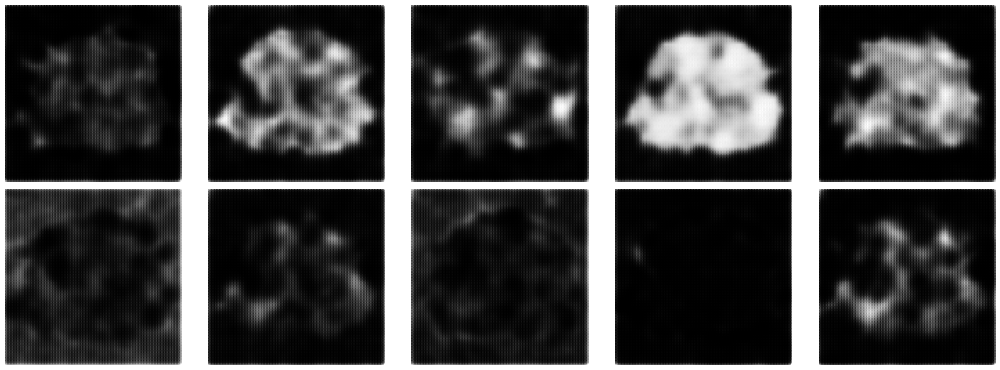

  0%|                                                                                                                        | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 13ms/step


  0%|                                                                                                                | 1/3750 [00:00<07:35,  8.24it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 2/3750 [00:00<07:00,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                                                                                                | 3/3750 [00:00<06:48,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 4/3750 [00:00<06:42,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                                                                                               | 5/3750 [00:00<06:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 6/3750 [00:00<06:36,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                                                                                               | 7/3750 [00:00<06:35,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 8/3750 [00:00<06:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                               | 9/3750 [00:00<06:35,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                              | 10/3750 [00:01<06:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                              | 11/3750 [00:01<06:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                              | 12/3750 [00:01<06:32,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 13/3750 [00:01<06:32,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▍                                                                                                              | 14/3750 [00:01<06:31,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▍                                                                                                              | 15/3750 [00:01<06:30,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 16/3750 [00:01<06:30,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▌                                                                                                              | 17/3750 [00:01<06:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▌                                                                                                              | 18/3750 [00:01<06:39,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                                                                                              | 19/3750 [00:02<06:36,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                                                                                              | 20/3750 [00:02<06:34,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 21/3750 [00:02<06:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▋                                                                                                              | 22/3750 [00:02<06:32,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▋                                                                                                              | 23/3750 [00:02<06:31,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▋                                                                                                              | 24/3750 [00:02<06:30,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▋                                                                                                              | 25/3750 [00:02<06:30,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▊                                                                                                              | 26/3750 [00:02<06:31,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 27/3750 [00:02<06:32,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 28/3750 [00:02<06:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▊                                                                                                              | 29/3750 [00:03<06:31,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▉                                                                                                              | 30/3750 [00:03<06:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▉                                                                                                              | 31/3750 [00:03<06:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▉                                                                                                              | 32/3750 [00:03<06:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▉                                                                                                              | 33/3750 [00:03<06:30,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█                                                                                                              | 34/3750 [00:03<06:28,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█                                                                                                              | 35/3750 [00:03<06:28,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 36/3750 [00:03<06:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█                                                                                                              | 37/3750 [00:03<06:29,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 38/3750 [00:04<06:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▏                                                                                                             | 39/3750 [00:04<06:29,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 40/3750 [00:04<06:29,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 41/3750 [00:04<06:30,  9.50it/s]

1/1 [==============================] - 0s 11ms/step


  1%|█▏                                                                                                             | 42/3750 [00:04<06:37,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 43/3750 [00:04<06:36,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 44/3750 [00:04<06:33,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 45/3750 [00:04<06:34,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 46/3750 [00:04<06:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 47/3750 [00:04<06:32,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 48/3750 [00:05<06:31,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 49/3750 [00:05<06:30,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 50/3750 [00:05<06:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 51/3750 [00:05<06:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 52/3750 [00:05<06:27,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 53/3750 [00:05<06:27,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 54/3750 [00:05<06:30,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▋                                                                                                             | 55/3750 [00:05<06:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▋                                                                                                             | 56/3750 [00:05<06:29,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▋                                                                                                             | 57/3750 [00:06<06:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▋                                                                                                             | 58/3750 [00:06<06:29,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▋                                                                                                             | 59/3750 [00:06<06:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 60/3750 [00:06<06:27,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 61/3750 [00:06<06:26,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 62/3750 [00:06<06:26,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 63/3750 [00:06<06:28,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▉                                                                                                             | 64/3750 [00:06<06:28,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▉                                                                                                             | 65/3750 [00:06<06:27,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▉                                                                                                             | 66/3750 [00:06<06:26,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▉                                                                                                             | 67/3750 [00:07<06:25,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██                                                                                                             | 68/3750 [00:07<06:25,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██                                                                                                             | 69/3750 [00:07<06:25,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██                                                                                                             | 70/3750 [00:07<06:25,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██                                                                                                             | 71/3750 [00:07<06:25,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▏                                                                                                            | 72/3750 [00:07<06:27,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 73/3750 [00:07<06:26,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 74/3750 [00:07<06:27,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 75/3750 [00:07<06:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▏                                                                                                            | 76/3750 [00:08<06:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▎                                                                                                            | 77/3750 [00:08<06:25,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▎                                                                                                            | 78/3750 [00:08<06:25,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▎                                                                                                            | 79/3750 [00:08<06:25,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▎                                                                                                            | 80/3750 [00:08<06:24,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 81/3750 [00:08<06:27,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▍                                                                                                            | 82/3750 [00:08<06:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▍                                                                                                            | 83/3750 [00:08<06:25,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 84/3750 [00:08<06:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▌                                                                                                            | 85/3750 [00:08<06:24,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▌                                                                                                            | 86/3750 [00:09<06:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▌                                                                                                            | 87/3750 [00:09<06:24,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▌                                                                                                            | 88/3750 [00:09<06:24,  9.52it/s]

1/1 [==============================] - 0s 10ms/step


  2%|██▋                                                                                                            | 89/3750 [00:09<06:32,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▋                                                                                                            | 90/3750 [00:09<06:33,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 91/3750 [00:09<06:30,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▋                                                                                                            | 92/3750 [00:09<06:28,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▊                                                                                                            | 93/3750 [00:09<06:26,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▊                                                                                                            | 94/3750 [00:09<06:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 95/3750 [00:10<06:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▊                                                                                                            | 96/3750 [00:10<06:23,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▊                                                                                                            | 97/3750 [00:10<06:22,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▉                                                                                                            | 98/3750 [00:10<06:22,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                            | 99/3750 [00:10<06:24,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                           | 100/3750 [00:10<06:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                           | 101/3750 [00:10<06:24,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                           | 102/3750 [00:10<06:24,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 103/3750 [00:10<06:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███                                                                                                           | 104/3750 [00:10<06:24,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 105/3750 [00:11<06:24,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███                                                                                                           | 106/3750 [00:11<06:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▏                                                                                                          | 107/3750 [00:11<06:22,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 108/3750 [00:11<06:25,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 109/3750 [00:11<06:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 110/3750 [00:11<06:23,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 111/3750 [00:11<06:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 112/3750 [00:11<06:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 113/3750 [00:11<06:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 114/3750 [00:12<06:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 115/3750 [00:12<06:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 116/3750 [00:12<06:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 117/3750 [00:12<06:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 118/3750 [00:12<06:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▍                                                                                                          | 119/3750 [00:12<06:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 120/3750 [00:12<06:24,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▌                                                                                                          | 121/3750 [00:12<06:24,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 122/3750 [00:12<06:24,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▌                                                                                                          | 123/3750 [00:12<06:23,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 124/3750 [00:13<06:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 125/3750 [00:13<06:28,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▋                                                                                                          | 126/3750 [00:13<06:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 127/3750 [00:13<06:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 128/3750 [00:13<06:25,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 129/3750 [00:13<06:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▊                                                                                                          | 130/3750 [00:13<06:23,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 131/3750 [00:13<06:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▊                                                                                                          | 132/3750 [00:13<06:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 133/3750 [00:14<06:22,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▉                                                                                                          | 134/3750 [00:14<06:19,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▉                                                                                                          | 135/3750 [00:14<06:19,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 136/3750 [00:14<06:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 137/3750 [00:14<06:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████                                                                                                          | 138/3750 [00:14<06:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████                                                                                                          | 139/3750 [00:14<06:21,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 140/3750 [00:14<06:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 141/3750 [00:14<06:20,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 142/3750 [00:14<06:20,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 143/3750 [00:15<06:19,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▏                                                                                                         | 144/3750 [00:15<06:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 145/3750 [00:15<06:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 146/3750 [00:15<06:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 147/3750 [00:15<06:24,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▎                                                                                                         | 148/3750 [00:15<06:22,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 149/3750 [00:15<06:22,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 150/3750 [00:15<06:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 151/3750 [00:15<06:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 152/3750 [00:16<06:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 153/3750 [00:16<06:19,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 154/3750 [00:16<06:22,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 155/3750 [00:16<06:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 156/3750 [00:16<06:21,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 157/3750 [00:16<06:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 158/3750 [00:16<06:20,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▋                                                                                                         | 159/3750 [00:16<06:29,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▋                                                                                                         | 160/3750 [00:16<06:35,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 161/3750 [00:17<06:37,  9.04it/s]

1/1 [==============================] - 0s 12ms/step


  4%|████▊                                                                                                         | 162/3750 [00:17<06:43,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 163/3750 [00:17<06:40,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▊                                                                                                         | 164/3750 [00:17<07:27,  8.01it/s]

1/1 [==============================] - 0s 24ms/step


  4%|████▊                                                                                                         | 165/3750 [00:17<07:40,  7.79it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▊                                                                                                         | 166/3750 [00:17<07:50,  7.62it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▉                                                                                                         | 167/3750 [00:17<07:50,  7.62it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▉                                                                                                         | 168/3750 [00:17<07:24,  8.07it/s]

1/1 [==============================] - 0s 8ms/step


  5%|████▉                                                                                                         | 169/3750 [00:18<07:03,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


  5%|████▉                                                                                                         | 170/3750 [00:18<06:49,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 171/3750 [00:18<06:40,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 172/3750 [00:18<06:43,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 173/3750 [00:18<06:38,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████                                                                                                         | 174/3750 [00:18<06:32,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 175/3750 [00:18<06:27,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▏                                                                                                        | 176/3750 [00:18<06:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 177/3750 [00:18<06:33,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 178/3750 [00:19<06:34,  9.04it/s]

1/1 [==============================] - 0s 11ms/step


  5%|█████▎                                                                                                        | 179/3750 [00:19<06:55,  8.60it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 180/3750 [00:19<06:44,  8.83it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█████▎                                                                                                        | 181/3750 [00:19<06:38,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 182/3750 [00:19<06:37,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 183/3750 [00:19<06:30,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 184/3750 [00:19<06:25,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 185/3750 [00:19<06:22,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 186/3750 [00:19<06:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 187/3750 [00:19<06:18,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 188/3750 [00:20<06:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 189/3750 [00:20<06:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▌                                                                                                        | 190/3750 [00:20<06:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 191/3750 [00:20<06:18,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█████▋                                                                                                        | 192/3750 [00:20<06:23,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█████▋                                                                                                        | 193/3750 [00:20<06:25,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█████▋                                                                                                        | 194/3750 [00:20<06:29,  9.12it/s]

1/1 [==============================] - 0s 13ms/step


  5%|█████▋                                                                                                        | 195/3750 [00:20<06:32,  9.05it/s]

1/1 [==============================] - 0s 11ms/step


  5%|█████▋                                                                                                        | 196/3750 [00:20<06:34,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█████▊                                                                                                        | 197/3750 [00:21<06:33,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 198/3750 [00:21<06:31,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 199/3750 [00:21<06:30,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 200/3750 [00:21<06:28,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 201/3750 [00:21<06:26,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 202/3750 [00:21<06:23,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▉                                                                                                        | 203/3750 [00:21<06:20,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▉                                                                                                        | 204/3750 [00:21<06:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██████                                                                                                        | 205/3750 [00:21<06:16,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██████                                                                                                        | 206/3750 [00:22<06:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████                                                                                                        | 207/3750 [00:22<06:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████                                                                                                        | 208/3750 [00:22<06:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 209/3750 [00:22<06:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 210/3750 [00:22<06:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 211/3750 [00:22<06:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 212/3750 [00:22<06:12,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 213/3750 [00:22<06:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 214/3750 [00:22<06:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 215/3750 [00:22<06:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 216/3750 [00:23<06:12,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▎                                                                                                       | 217/3750 [00:23<06:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 218/3750 [00:23<06:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 219/3750 [00:23<06:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 220/3750 [00:23<06:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 221/3750 [00:23<06:12,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 222/3750 [00:23<06:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 223/3750 [00:23<06:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 224/3750 [00:23<06:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 225/3750 [00:24<06:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▋                                                                                                       | 226/3750 [00:24<06:11,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 227/3750 [00:24<06:11,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 228/3750 [00:24<06:13,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 229/3750 [00:24<06:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 230/3750 [00:24<06:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▊                                                                                                       | 231/3750 [00:24<06:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▊                                                                                                       | 232/3750 [00:24<06:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▊                                                                                                       | 233/3750 [00:24<06:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▊                                                                                                       | 234/3750 [00:24<06:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 235/3750 [00:25<06:17,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 236/3750 [00:25<06:15,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 237/3750 [00:25<06:17,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██████▉                                                                                                       | 238/3750 [00:25<08:51,  6.60it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 239/3750 [00:25<08:02,  7.28it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 240/3750 [00:25<07:28,  7.83it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 241/3750 [00:25<07:03,  8.28it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 242/3750 [00:25<06:46,  8.62it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████▏                                                                                                      | 243/3750 [00:26<06:35,  8.87it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▏                                                                                                      | 244/3750 [00:26<06:26,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 245/3750 [00:26<06:20,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 246/3750 [00:26<06:18,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 247/3750 [00:26<06:15,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▎                                                                                                      | 248/3750 [00:26<06:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 249/3750 [00:26<06:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▎                                                                                                      | 250/3750 [00:26<06:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▎                                                                                                      | 251/3750 [00:26<06:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▍                                                                                                      | 252/3750 [00:27<06:08,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 253/3750 [00:27<06:07,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▍                                                                                                      | 254/3750 [00:27<06:07,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 255/3750 [00:27<06:08,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 256/3750 [00:27<06:07,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 257/3750 [00:27<06:07,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 258/3750 [00:27<06:08,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 259/3750 [00:27<06:08,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 260/3750 [00:27<06:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 261/3750 [00:27<06:06,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 262/3750 [00:28<06:06,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 263/3750 [00:28<06:05,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 264/3750 [00:28<06:07,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 265/3750 [00:28<06:07,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 266/3750 [00:28<06:07,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 267/3750 [00:28<06:07,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 268/3750 [00:28<06:07,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▉                                                                                                      | 269/3750 [00:28<06:07,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▉                                                                                                      | 270/3750 [00:28<06:07,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▉                                                                                                      | 271/3750 [00:29<06:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▉                                                                                                      | 272/3750 [00:29<06:13,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 273/3750 [00:29<06:13,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 274/3750 [00:29<06:11,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 275/3750 [00:29<06:10,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


  7%|████████                                                                                                      | 276/3750 [00:29<06:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 277/3750 [00:29<06:10,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 278/3750 [00:29<06:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████▏                                                                                                     | 279/3750 [00:29<06:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████▏                                                                                                     | 280/3750 [00:30<06:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████▏                                                                                                     | 281/3750 [00:30<06:05,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 282/3750 [00:30<06:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 283/3750 [00:30<06:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 284/3750 [00:30<06:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 285/3750 [00:30<06:05,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 286/3750 [00:30<06:05,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 287/3750 [00:30<06:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▍                                                                                                     | 288/3750 [00:30<06:04,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▍                                                                                                     | 289/3750 [00:30<06:03,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 290/3750 [00:31<06:03,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 291/3750 [00:31<06:06,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 292/3750 [00:31<06:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 293/3750 [00:31<06:05,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 294/3750 [00:31<06:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▋                                                                                                     | 295/3750 [00:31<06:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 296/3750 [00:31<06:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▋                                                                                                     | 297/3750 [00:31<06:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▋                                                                                                     | 298/3750 [00:31<06:03,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


  8%|████████▊                                                                                                     | 299/3750 [00:32<06:07,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 300/3750 [00:32<06:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 301/3750 [00:32<06:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 302/3750 [00:32<06:07,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 303/3750 [00:32<06:05,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 304/3750 [00:32<06:07,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 305/3750 [00:32<06:06,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 306/3750 [00:32<06:04,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 307/3750 [00:32<06:05,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 308/3750 [00:32<06:05,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


  8%|█████████                                                                                                     | 309/3750 [00:33<06:07,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 310/3750 [00:33<06:08,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


  8%|█████████                                                                                                     | 311/3750 [00:33<06:07,  9.35it/s]

1/1 [==============================] - 0s 11ms/step


  8%|█████████▏                                                                                                    | 312/3750 [00:33<06:10,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 313/3750 [00:33<06:10,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 314/3750 [00:33<06:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 315/3750 [00:33<06:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▎                                                                                                    | 316/3750 [00:33<06:04,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▎                                                                                                    | 317/3750 [00:33<06:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▎                                                                                                    | 318/3750 [00:34<06:02,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▎                                                                                                    | 319/3750 [00:34<06:04,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 320/3750 [00:34<06:02,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 321/3750 [00:34<06:02,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 322/3750 [00:34<06:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 323/3750 [00:34<06:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 324/3750 [00:34<06:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 325/3750 [00:34<06:04,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 326/3750 [00:34<06:03,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 327/3750 [00:34<06:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 328/3750 [00:35<06:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 329/3750 [00:35<06:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 330/3750 [00:35<06:03,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 331/3750 [00:35<06:02,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 332/3750 [00:35<06:03,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▊                                                                                                    | 333/3750 [00:35<06:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 334/3750 [00:35<06:01,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 335/3750 [00:35<06:03,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▊                                                                                                    | 336/3750 [00:35<06:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 337/3750 [00:36<06:01,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▉                                                                                                    | 338/3750 [00:36<06:02,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 339/3750 [00:36<06:01,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▉                                                                                                    | 340/3750 [00:36<06:00,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 341/3750 [00:36<05:59,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 342/3750 [00:36<05:59,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 343/3750 [00:36<05:58,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 344/3750 [00:36<05:58,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 345/3750 [00:36<05:58,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 346/3750 [00:37<05:58,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 347/3750 [00:37<06:00,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 348/3750 [00:37<05:59,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 349/3750 [00:37<06:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 350/3750 [00:37<05:57,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 351/3750 [00:37<05:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 352/3750 [00:37<05:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 353/3750 [00:37<05:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▍                                                                                                   | 354/3750 [00:37<05:56,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▍                                                                                                   | 355/3750 [00:37<05:56,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▍                                                                                                   | 356/3750 [00:38<05:58,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▍                                                                                                   | 357/3750 [00:38<05:58,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 358/3750 [00:38<05:57,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▌                                                                                                   | 359/3750 [00:38<05:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 360/3750 [00:38<05:57,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▌                                                                                                   | 361/3750 [00:38<05:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 362/3750 [00:38<05:59,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▋                                                                                                   | 363/3750 [00:38<06:02,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▋                                                                                                   | 364/3750 [00:38<06:00,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 365/3750 [00:39<06:03,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 366/3750 [00:39<06:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▊                                                                                                   | 367/3750 [00:39<06:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▊                                                                                                   | 368/3750 [00:39<05:59,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 369/3750 [00:39<05:58,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 370/3750 [00:39<05:56,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 371/3750 [00:39<05:55,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 372/3750 [00:39<05:55,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 373/3750 [00:39<05:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 374/3750 [00:39<05:56,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 375/3750 [00:40<05:58,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 376/3750 [00:40<05:56,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 377/3750 [00:40<05:56,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 378/3750 [00:40<05:55,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 379/3750 [00:40<05:55,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 380/3750 [00:40<05:55,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 381/3750 [00:40<05:55,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 382/3750 [00:40<05:57,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 383/3750 [00:40<05:59,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▎                                                                                                  | 384/3750 [00:41<06:00,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███████████▎                                                                                                  | 385/3750 [00:41<06:01,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▎                                                                                                  | 386/3750 [00:41<06:00,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███████████▎                                                                                                  | 387/3750 [00:41<06:01,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 388/3750 [00:41<06:00,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 389/3750 [00:41<05:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 390/3750 [00:41<05:59,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 391/3750 [00:41<05:58,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 392/3750 [00:41<05:56,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▌                                                                                                  | 393/3750 [00:41<05:59,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▌                                                                                                  | 394/3750 [00:42<05:57,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▌                                                                                                  | 395/3750 [00:42<06:04,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▌                                                                                                  | 396/3750 [00:42<06:00,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 397/3750 [00:42<05:58,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 398/3750 [00:42<05:56,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 399/3750 [00:42<05:53,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 400/3750 [00:42<05:53,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 401/3750 [00:42<05:53,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 402/3750 [00:42<05:56,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 403/3750 [00:43<05:54,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 404/3750 [00:43<05:54,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 405/3750 [00:43<05:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 406/3750 [00:43<05:53,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 407/3750 [00:43<05:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 408/3750 [00:43<05:51,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 409/3750 [00:43<05:51,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 410/3750 [00:43<05:51,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 411/3750 [00:43<05:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 412/3750 [00:44<05:52,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 413/3750 [00:44<05:52,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 414/3750 [00:44<05:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 415/3750 [00:44<05:56,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 416/3750 [00:44<05:54,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 417/3750 [00:44<05:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 418/3750 [00:44<05:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 419/3750 [00:44<05:52,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 420/3750 [00:44<05:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 421/3750 [00:44<05:53,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 422/3750 [00:45<05:53,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 423/3750 [00:45<05:52,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 424/3750 [00:45<05:51,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 425/3750 [00:45<05:50,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 426/3750 [00:45<05:50,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 427/3750 [00:45<05:49,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 428/3750 [00:45<05:49,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 429/3750 [00:45<05:51,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 430/3750 [00:45<05:49,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▋                                                                                                 | 431/3750 [00:46<05:50,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▋                                                                                                 | 432/3750 [00:46<05:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▋                                                                                                 | 433/3750 [00:46<05:50,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▋                                                                                                 | 434/3750 [00:46<05:50,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 435/3750 [00:46<05:49,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 436/3750 [00:46<05:49,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▊                                                                                                 | 437/3750 [00:46<05:48,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 438/3750 [00:46<05:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 439/3750 [00:46<05:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 440/3750 [00:46<06:03,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 441/3750 [00:47<06:00,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 442/3750 [00:47<05:57,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 443/3750 [00:47<05:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 444/3750 [00:47<05:53,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 445/3750 [00:47<05:51,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████                                                                                                 | 446/3750 [00:47<06:01,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 447/3750 [00:47<06:00,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 448/3750 [00:47<05:57,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 449/3750 [00:47<05:54,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 450/3750 [00:48<05:53,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 451/3750 [00:48<05:51,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 452/3750 [00:48<05:50,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 453/3750 [00:48<05:51,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 454/3750 [00:48<05:49,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 12%|█████████████▎                                                                                                | 455/3750 [00:48<05:50,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 12%|█████████████▍                                                                                                | 456/3750 [00:48<05:51,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 457/3750 [00:48<05:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 458/3750 [00:48<05:50,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▍                                                                                                | 459/3750 [00:49<05:49,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▍                                                                                                | 460/3750 [00:49<05:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 461/3750 [00:49<05:47,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 462/3750 [00:49<05:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 463/3750 [00:49<05:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 464/3750 [00:49<05:45,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 465/3750 [00:49<05:45,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 466/3750 [00:49<05:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 467/3750 [00:49<05:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▋                                                                                                | 468/3750 [00:49<05:47,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 469/3750 [00:50<05:46,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 470/3750 [00:50<05:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 471/3750 [00:50<05:45,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 472/3750 [00:50<05:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 473/3750 [00:50<05:44,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▉                                                                                                | 474/3750 [00:50<05:44,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 475/3750 [00:50<05:47,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▉                                                                                                | 476/3750 [00:50<05:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▉                                                                                                | 477/3750 [00:50<05:45,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 478/3750 [00:51<05:50,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 479/3750 [00:51<05:49,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████                                                                                                | 480/3750 [00:51<05:47,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████                                                                                                | 481/3750 [00:51<05:46,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 482/3750 [00:51<05:45,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▏                                                                                               | 483/3750 [00:51<05:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▏                                                                                               | 484/3750 [00:51<05:45,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 485/3750 [00:51<05:44,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 486/3750 [00:51<05:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 487/3750 [00:51<05:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 488/3750 [00:52<05:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 489/3750 [00:52<05:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 490/3750 [00:52<05:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 491/3750 [00:52<05:43,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 492/3750 [00:52<05:42,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 493/3750 [00:52<05:44,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 494/3750 [00:52<05:44,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 495/3750 [00:52<05:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 496/3750 [00:52<05:43,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 497/3750 [00:53<05:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 498/3750 [00:53<05:47,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 499/3750 [00:53<05:45,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 500/3750 [00:53<05:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▋                                                                                               | 501/3750 [00:53<05:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 502/3750 [00:53<05:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▊                                                                                               | 503/3750 [00:53<05:44,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 504/3750 [00:53<05:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 505/3750 [00:53<05:41,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 506/3750 [00:53<05:41,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▊                                                                                               | 507/3750 [00:54<05:41,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▉                                                                                               | 508/3750 [00:54<05:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▉                                                                                               | 509/3750 [00:54<05:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▉                                                                                               | 510/3750 [00:54<05:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▉                                                                                               | 511/3750 [00:54<05:39,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████                                                                                               | 512/3750 [00:54<05:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████                                                                                               | 513/3750 [00:54<05:41,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 514/3750 [00:54<05:41,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████                                                                                               | 515/3750 [00:54<05:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 516/3750 [00:55<05:40,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▏                                                                                              | 517/3750 [00:55<05:40,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 518/3750 [00:55<05:39,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 519/3750 [00:55<05:39,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 520/3750 [00:55<05:39,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 521/3750 [00:55<05:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 522/3750 [00:55<05:41,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 523/3750 [00:55<05:41,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 524/3750 [00:55<05:40,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 525/3750 [00:55<05:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 526/3750 [00:56<05:39,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 527/3750 [00:56<05:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 528/3750 [00:56<05:38,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 529/3750 [00:56<05:37,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 530/3750 [00:56<05:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 531/3750 [00:56<05:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 532/3750 [00:56<05:38,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▋                                                                                              | 533/3750 [00:56<05:39,  9.48it/s]

1/1 [==============================] - 0s 11ms/step


 14%|███████████████▋                                                                                              | 534/3750 [00:56<05:40,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▋                                                                                              | 535/3750 [00:57<05:40,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▋                                                                                              | 536/3750 [00:57<05:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 537/3750 [00:57<05:38,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 538/3750 [00:57<05:38,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 539/3750 [00:57<05:40,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 540/3750 [00:57<05:39,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 541/3750 [00:57<05:39,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▉                                                                                              | 542/3750 [00:57<05:38,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▉                                                                                              | 543/3750 [00:57<05:38,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 15%|███████████████▉                                                                                              | 544/3750 [00:57<05:37,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 15%|███████████████▉                                                                                              | 545/3750 [00:58<05:38,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 546/3750 [00:58<05:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 547/3750 [00:58<05:36,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 548/3750 [00:58<05:38,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 549/3750 [00:58<05:41,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 550/3750 [00:58<05:39,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 551/3750 [00:58<05:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 552/3750 [00:58<05:38,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 553/3750 [00:58<05:39,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 554/3750 [00:59<05:38,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 555/3750 [00:59<05:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 556/3750 [00:59<05:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 557/3750 [00:59<05:35,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 558/3750 [00:59<05:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 559/3750 [00:59<05:38,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 560/3750 [00:59<05:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 561/3750 [00:59<05:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 562/3750 [00:59<05:35,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 563/3750 [00:59<05:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 564/3750 [01:00<05:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 565/3750 [01:00<05:34,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 566/3750 [01:00<05:35,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 567/3750 [01:00<05:37,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 568/3750 [01:00<05:36,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 569/3750 [01:00<05:36,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 570/3750 [01:00<05:35,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 571/3750 [01:00<05:34,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▊                                                                                             | 572/3750 [01:00<05:34,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▊                                                                                             | 573/3750 [01:01<05:34,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▊                                                                                             | 574/3750 [01:01<05:33,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 575/3750 [01:01<05:34,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 576/3750 [01:01<05:36,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 577/3750 [01:01<05:35,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 578/3750 [01:01<05:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▉                                                                                             | 579/3750 [01:01<05:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████████████████                                                                                             | 580/3750 [01:01<05:34,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████████████████                                                                                             | 581/3750 [01:01<05:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████                                                                                             | 582/3750 [01:01<05:33,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████                                                                                             | 583/3750 [01:02<05:32,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 584/3750 [01:02<05:32,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 585/3750 [01:02<05:34,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 586/3750 [01:02<05:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 587/3750 [01:02<05:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 588/3750 [01:02<05:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 589/3750 [01:02<05:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 590/3750 [01:02<05:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 591/3750 [01:02<05:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 592/3750 [01:03<05:32,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 593/3750 [01:03<05:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▍                                                                                            | 594/3750 [01:03<05:36,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 595/3750 [01:03<05:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▍                                                                                            | 596/3750 [01:03<05:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 597/3750 [01:03<05:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 598/3750 [01:03<05:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 599/3750 [01:03<05:31,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 600/3750 [01:03<05:30,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 601/3750 [01:03<05:30,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 602/3750 [01:04<05:29,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 603/3750 [01:04<05:32,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 604/3750 [01:04<05:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 605/3750 [01:04<05:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 606/3750 [01:04<05:31,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 607/3750 [01:04<05:31,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 608/3750 [01:04<05:33,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 609/3750 [01:04<05:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 610/3750 [01:04<05:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 611/3750 [01:05<05:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 612/3750 [01:05<05:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 613/3750 [01:05<05:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 614/3750 [01:05<05:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 615/3750 [01:05<05:30,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 616/3750 [01:05<05:29,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 617/3750 [01:05<05:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████▏                                                                                           | 618/3750 [01:05<05:29,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▏                                                                                           | 619/3750 [01:05<05:29,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▏                                                                                           | 620/3750 [01:06<05:28,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 621/3750 [01:06<05:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 622/3750 [01:06<05:33,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 623/3750 [01:06<05:31,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 624/3750 [01:06<05:31,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 625/3750 [01:06<05:31,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 626/3750 [01:06<05:30,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 627/3750 [01:06<05:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 628/3750 [01:06<05:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 629/3750 [01:06<05:28,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 630/3750 [01:07<05:30,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 631/3750 [01:07<05:29,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 632/3750 [01:07<05:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▌                                                                                           | 633/3750 [01:07<05:28,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▌                                                                                           | 634/3750 [01:07<05:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 635/3750 [01:07<05:27,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 636/3750 [01:07<05:27,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 637/3750 [01:07<05:27,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 638/3750 [01:07<05:27,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 639/3750 [01:08<05:29,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 640/3750 [01:08<05:28,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▊                                                                                           | 641/3750 [01:08<05:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 642/3750 [01:08<05:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 643/3750 [01:08<05:26,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 644/3750 [01:08<05:26,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▉                                                                                           | 645/3750 [01:08<05:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 646/3750 [01:08<05:26,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 647/3750 [01:08<05:25,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 648/3750 [01:08<05:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 649/3750 [01:09<05:26,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████                                                                                           | 650/3750 [01:09<05:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 651/3750 [01:09<05:26,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 652/3750 [01:09<05:29,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 653/3750 [01:09<05:29,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 654/3750 [01:09<05:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 655/3750 [01:09<05:28,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 656/3750 [01:09<05:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▎                                                                                          | 657/3750 [01:09<05:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▎                                                                                          | 658/3750 [01:10<05:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▎                                                                                          | 659/3750 [01:10<05:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▎                                                                                          | 660/3750 [01:10<05:25,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 661/3750 [01:10<05:26,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▍                                                                                          | 662/3750 [01:10<05:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 663/3750 [01:10<05:31,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 664/3750 [01:10<05:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 665/3750 [01:10<05:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 666/3750 [01:10<05:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 667/3750 [01:10<05:28,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 668/3750 [01:11<05:27,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 669/3750 [01:11<05:29,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▋                                                                                          | 670/3750 [01:11<05:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 671/3750 [01:11<05:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 672/3750 [01:11<05:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 673/3750 [01:11<05:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 674/3750 [01:11<05:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 675/3750 [01:11<05:27,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 676/3750 [01:11<05:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 677/3750 [01:12<05:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 678/3750 [01:12<05:28,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▉                                                                                          | 679/3750 [01:12<05:27,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 680/3750 [01:12<05:26,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▉                                                                                          | 681/3750 [01:12<05:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 682/3750 [01:12<05:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 683/3750 [01:12<05:23,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 684/3750 [01:12<05:23,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 18%|████████████████████                                                                                          | 685/3750 [01:12<05:26,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 686/3750 [01:13<05:31,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 687/3750 [01:13<05:30,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 688/3750 [01:13<05:28,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▏                                                                                         | 689/3750 [01:13<05:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 690/3750 [01:13<05:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▎                                                                                         | 691/3750 [01:13<05:23,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 692/3750 [01:13<05:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▎                                                                                         | 693/3750 [01:13<05:22,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▎                                                                                         | 694/3750 [01:13<05:20,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 695/3750 [01:13<05:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 696/3750 [01:14<05:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 697/3750 [01:14<05:22,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 698/3750 [01:14<05:22,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▌                                                                                         | 699/3750 [01:14<05:22,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 700/3750 [01:14<05:21,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 701/3750 [01:14<05:25,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 702/3750 [01:14<05:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▌                                                                                         | 703/3750 [01:14<05:23,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 704/3750 [01:14<05:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▋                                                                                         | 705/3750 [01:15<05:22,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▋                                                                                         | 706/3750 [01:15<05:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 707/3750 [01:15<05:23,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▊                                                                                         | 708/3750 [01:15<05:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▊                                                                                         | 709/3750 [01:15<05:21,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 710/3750 [01:15<05:21,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 711/3750 [01:15<05:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▉                                                                                         | 712/3750 [01:15<05:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 713/3750 [01:15<05:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 714/3750 [01:15<05:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▉                                                                                         | 715/3750 [01:16<05:21,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 716/3750 [01:16<05:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 717/3750 [01:16<05:20,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 718/3750 [01:16<05:19,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 719/3750 [01:16<05:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 720/3750 [01:16<05:19,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 721/3750 [01:16<05:19,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 19%|█████████████████████▏                                                                                        | 722/3750 [01:16<05:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 723/3750 [01:16<05:27,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 724/3750 [01:17<05:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 725/3750 [01:17<05:24,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 726/3750 [01:17<05:27,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 727/3750 [01:17<05:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 728/3750 [01:17<05:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▍                                                                                        | 729/3750 [01:17<05:21,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▍                                                                                        | 730/3750 [01:17<05:20,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▍                                                                                        | 731/3750 [01:17<05:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▍                                                                                        | 732/3750 [01:17<05:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 733/3750 [01:17<05:19,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 734/3750 [01:18<05:19,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▌                                                                                        | 735/3750 [01:18<05:19,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 736/3750 [01:18<05:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 737/3750 [01:18<05:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 738/3750 [01:18<05:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 739/3750 [01:18<05:16,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 740/3750 [01:18<05:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 741/3750 [01:18<05:15,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 742/3750 [01:18<05:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 743/3750 [01:19<05:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 744/3750 [01:19<05:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 745/3750 [01:19<05:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 746/3750 [01:19<05:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 747/3750 [01:19<05:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 748/3750 [01:19<05:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 749/3750 [01:19<05:16,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 750/3750 [01:19<05:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 751/3750 [01:19<05:20,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 752/3750 [01:19<05:19,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 753/3750 [01:20<05:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 754/3750 [01:20<05:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▏                                                                                       | 755/3750 [01:20<05:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▏                                                                                       | 756/3750 [01:20<05:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▏                                                                                       | 757/3750 [01:20<05:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▏                                                                                       | 758/3750 [01:20<05:14,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▎                                                                                       | 759/3750 [01:20<05:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▎                                                                                       | 760/3750 [01:20<05:17,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 761/3750 [01:20<05:16,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 20%|██████████████████████▎                                                                                       | 762/3750 [01:21<05:20,  9.31it/s]

1/1 [==============================] - 0s 12ms/step


 20%|██████████████████████▍                                                                                       | 763/3750 [01:21<05:23,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 764/3750 [01:21<05:22,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 765/3750 [01:21<05:19,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 766/3750 [01:21<05:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 767/3750 [01:21<05:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▌                                                                                       | 768/3750 [01:21<05:17,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▌                                                                                       | 769/3750 [01:21<05:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▌                                                                                       | 770/3750 [01:21<05:17,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▌                                                                                       | 771/3750 [01:22<05:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 772/3750 [01:22<05:15,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▋                                                                                       | 773/3750 [01:22<05:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 774/3750 [01:22<05:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▋                                                                                       | 775/3750 [01:22<05:15,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▊                                                                                       | 776/3750 [01:22<05:14,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▊                                                                                       | 777/3750 [01:22<05:13,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 778/3750 [01:22<05:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▊                                                                                       | 779/3750 [01:22<05:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 780/3750 [01:22<05:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 781/3750 [01:23<05:13,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 782/3750 [01:23<05:13,  9.46it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██████████████████████▉                                                                                       | 783/3750 [01:23<05:28,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 784/3750 [01:23<05:24,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████                                                                                       | 785/3750 [01:23<05:20,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████                                                                                       | 786/3750 [01:23<05:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 787/3750 [01:23<05:21,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 788/3750 [01:23<05:20,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 789/3750 [01:23<05:17,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 790/3750 [01:24<05:15,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▏                                                                                      | 791/3750 [01:24<05:14,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 792/3750 [01:24<05:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▎                                                                                      | 793/3750 [01:24<05:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▎                                                                                      | 794/3750 [01:24<05:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▎                                                                                      | 795/3750 [01:24<05:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▎                                                                                      | 796/3750 [01:24<05:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 797/3750 [01:24<05:13,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 798/3750 [01:24<05:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 799/3750 [01:25<05:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 800/3750 [01:25<05:11,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 801/3750 [01:25<05:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▌                                                                                      | 802/3750 [01:25<05:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▌                                                                                      | 803/3750 [01:25<05:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 804/3750 [01:25<05:11,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 805/3750 [01:25<05:15,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▋                                                                                      | 806/3750 [01:25<05:32,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 807/3750 [01:25<05:29,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▋                                                                                      | 808/3750 [01:25<05:23,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 809/3750 [01:26<05:19,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 810/3750 [01:26<05:16,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▊                                                                                      | 811/3750 [01:26<05:14,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 812/3750 [01:26<05:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▊                                                                                      | 813/3750 [01:26<05:42,  8.58it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 814/3750 [01:26<05:32,  8.83it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 815/3750 [01:26<05:25,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 816/3750 [01:26<05:22,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 817/3750 [01:26<05:18,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 818/3750 [01:27<05:15,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 819/3750 [01:27<05:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 820/3750 [01:27<05:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 821/3750 [01:27<05:12,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 822/3750 [01:27<05:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▏                                                                                     | 823/3750 [01:27<05:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 824/3750 [01:27<05:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▏                                                                                     | 825/3750 [01:27<05:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 826/3750 [01:27<05:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 827/3750 [01:28<05:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 828/3750 [01:28<05:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 829/3750 [01:28<05:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▎                                                                                     | 830/3750 [01:28<05:08,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 831/3750 [01:28<05:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 832/3750 [01:28<05:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 833/3750 [01:28<05:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 834/3750 [01:28<05:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 835/3750 [01:28<05:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 836/3750 [01:28<05:09,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████████████████████▌                                                                                     | 837/3750 [01:29<05:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 838/3750 [01:29<05:13,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 839/3750 [01:29<05:11,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▋                                                                                     | 840/3750 [01:29<05:10,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▋                                                                                     | 841/3750 [01:29<05:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▋                                                                                     | 842/3750 [01:29<05:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 843/3750 [01:29<05:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 844/3750 [01:29<05:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 845/3750 [01:29<05:08,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 846/3750 [01:30<05:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 847/3750 [01:30<05:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 848/3750 [01:30<05:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▉                                                                                     | 849/3750 [01:30<05:05,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▉                                                                                     | 850/3750 [01:30<05:04,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▉                                                                                     | 851/3750 [01:30<05:04,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 852/3750 [01:30<05:04,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 853/3750 [01:30<05:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 854/3750 [01:30<05:07,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 855/3750 [01:31<05:12,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 856/3750 [01:31<05:10,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 857/3750 [01:31<05:09,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▏                                                                                    | 858/3750 [01:31<05:07,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▏                                                                                    | 859/3750 [01:31<05:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 860/3750 [01:31<05:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 861/3750 [01:31<05:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 862/3750 [01:31<05:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 863/3750 [01:31<05:05,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 864/3750 [01:31<05:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 865/3750 [01:32<05:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 866/3750 [01:32<05:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 867/3750 [01:32<05:04,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 868/3750 [01:32<05:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 869/3750 [01:32<05:03,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 870/3750 [01:32<05:03,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 871/3750 [01:32<05:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 872/3750 [01:32<05:05,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▌                                                                                    | 873/3750 [01:32<05:05,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▋                                                                                    | 874/3750 [01:33<05:05,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 875/3750 [01:33<05:04,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▋                                                                                    | 876/3750 [01:33<05:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 877/3750 [01:33<05:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 878/3750 [01:33<05:02,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 879/3750 [01:33<05:05,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 880/3750 [01:33<05:04,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 881/3750 [01:33<05:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▊                                                                                    | 882/3750 [01:33<05:04,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 883/3750 [01:33<05:04,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 884/3750 [01:34<05:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▉                                                                                    | 885/3750 [01:34<05:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▉                                                                                    | 886/3750 [01:34<05:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 887/3750 [01:34<05:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 888/3750 [01:34<05:02,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 889/3750 [01:34<05:02,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 890/3750 [01:34<05:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 891/3750 [01:34<05:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 892/3750 [01:34<05:03,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▏                                                                                   | 893/3750 [01:35<05:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▏                                                                                   | 894/3750 [01:35<05:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 895/3750 [01:35<05:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 896/3750 [01:35<05:03,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 897/3750 [01:35<05:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 898/3750 [01:35<05:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 899/3750 [01:35<05:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 900/3750 [01:35<05:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 901/3750 [01:35<05:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 902/3750 [01:35<05:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 903/3750 [01:36<05:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 904/3750 [01:36<05:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 905/3750 [01:36<05:04,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 906/3750 [01:36<05:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 907/3750 [01:36<05:01,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▋                                                                                   | 908/3750 [01:36<05:02,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▋                                                                                   | 909/3750 [01:36<05:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▋                                                                                   | 910/3750 [01:36<05:00,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 911/3750 [01:36<05:00,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 912/3750 [01:37<05:00,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 24%|██████████████████████████▊                                                                                   | 913/3750 [01:37<05:00,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 914/3750 [01:37<05:00,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 915/3750 [01:37<04:59,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 916/3750 [01:37<04:58,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▉                                                                                   | 917/3750 [01:37<05:00,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▉                                                                                   | 918/3750 [01:37<05:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████████████████████▉                                                                                   | 919/3750 [01:37<04:59,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████████████████████▉                                                                                   | 920/3750 [01:37<04:59,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 921/3750 [01:37<04:58,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████                                                                                   | 922/3750 [01:38<04:58,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████                                                                                   | 923/3750 [01:38<04:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 924/3750 [01:38<04:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▏                                                                                  | 925/3750 [01:38<04:57,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 926/3750 [01:38<04:58,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 927/3750 [01:38<04:57,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 928/3750 [01:38<04:57,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 929/3750 [01:38<04:56,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 930/3750 [01:38<04:56,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 931/3750 [01:39<04:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 932/3750 [01:39<04:55,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 933/3750 [01:39<04:56,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▍                                                                                  | 934/3750 [01:39<04:55,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 935/3750 [01:39<04:57,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 936/3750 [01:39<04:56,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 937/3750 [01:39<05:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 938/3750 [01:39<05:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 939/3750 [01:39<04:58,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▌                                                                                  | 940/3750 [01:40<04:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 941/3750 [01:40<04:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 942/3750 [01:40<04:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 943/3750 [01:40<04:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 944/3750 [01:40<04:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 945/3750 [01:40<04:56,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▋                                                                                  | 946/3750 [01:40<04:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▊                                                                                  | 947/3750 [01:40<04:54,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 948/3750 [01:40<04:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▊                                                                                  | 949/3750 [01:40<04:55,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 950/3750 [01:41<04:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▉                                                                                  | 951/3750 [01:41<04:55,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 25%|███████████████████████████▉                                                                                  | 952/3750 [01:41<04:56,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 953/3750 [01:41<04:56,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 954/3750 [01:41<04:57,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 25%|████████████████████████████                                                                                  | 955/3750 [01:41<04:56,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 25%|████████████████████████████                                                                                  | 956/3750 [01:41<04:56,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████                                                                                  | 957/3750 [01:41<04:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████                                                                                  | 958/3750 [01:41<04:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 959/3750 [01:42<04:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 960/3750 [01:42<04:55,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 961/3750 [01:42<04:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 962/3750 [01:42<04:52,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 963/3750 [01:42<04:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 964/3750 [01:42<04:55,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▎                                                                                 | 965/3750 [01:42<04:54,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 966/3750 [01:42<04:53,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▎                                                                                 | 967/3750 [01:42<04:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▍                                                                                 | 968/3750 [01:42<04:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▍                                                                                 | 969/3750 [01:43<04:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▍                                                                                 | 970/3750 [01:43<04:53,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 971/3750 [01:43<04:53,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 972/3750 [01:43<04:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▌                                                                                 | 973/3750 [01:43<04:53,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 974/3750 [01:43<04:53,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 975/3750 [01:43<04:52,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 976/3750 [01:43<04:52,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 977/3750 [01:43<04:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 978/3750 [01:44<04:51,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 979/3750 [01:44<04:51,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 980/3750 [01:44<04:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▊                                                                                 | 981/3750 [01:44<04:52,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 982/3750 [01:44<04:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▊                                                                                 | 983/3750 [01:44<04:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▊                                                                                 | 984/3750 [01:44<04:50,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 985/3750 [01:44<04:50,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 986/3750 [01:44<04:51,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 987/3750 [01:44<04:51,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 988/3750 [01:45<04:51,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 989/3750 [01:45<04:52,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 990/3750 [01:45<04:53,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 991/3750 [01:45<04:53,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 992/3750 [01:45<04:52,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████▏                                                                                | 993/3750 [01:45<04:52,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 994/3750 [01:45<04:51,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                                | 995/3750 [01:45<04:51,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                                | 996/3750 [01:45<04:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                                | 997/3750 [01:46<04:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                                | 998/3750 [01:46<04:48,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                                | 999/3750 [01:46<04:50,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████                                                                                | 1000/3750 [01:46<04:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████                                                                                | 1001/3750 [01:46<04:50,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████                                                                                | 1002/3750 [01:46<04:50,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                               | 1003/3750 [01:46<04:49,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                               | 1004/3750 [01:46<04:49,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1005/3750 [01:46<04:49,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1006/3750 [01:46<04:50,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1007/3750 [01:47<04:49,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                               | 1008/3750 [01:47<04:50,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 27%|█████████████████████████████▎                                                                               | 1009/3750 [01:47<04:50,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                               | 1010/3750 [01:47<04:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▍                                                                               | 1011/3750 [01:47<04:50,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1012/3750 [01:47<04:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▍                                                                               | 1013/3750 [01:47<04:49,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1014/3750 [01:47<04:49,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1015/3750 [01:47<04:49,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1016/3750 [01:48<04:48,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1017/3750 [01:48<04:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1018/3750 [01:48<04:49,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1019/3750 [01:48<04:49,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1020/3750 [01:48<04:49,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1021/3750 [01:48<04:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1022/3750 [01:48<04:52,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▋                                                                               | 1023/3750 [01:48<04:51,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▊                                                                               | 1024/3750 [01:48<04:49,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▊                                                                               | 1025/3750 [01:48<04:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1026/3750 [01:49<04:48,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1027/3750 [01:49<04:50,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1028/3750 [01:49<04:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1029/3750 [01:49<04:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1030/3750 [01:49<04:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1031/3750 [01:49<04:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 28%|█████████████████████████████▉                                                                               | 1032/3750 [01:49<04:48,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████                                                                               | 1033/3750 [01:49<04:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████                                                                               | 1034/3750 [01:49<04:50,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1035/3750 [01:50<04:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1036/3750 [01:50<04:48,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1037/3750 [01:50<04:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1038/3750 [01:50<04:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1039/3750 [01:50<04:47,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▏                                                                              | 1040/3750 [01:50<04:47,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1041/3750 [01:50<04:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1042/3750 [01:50<04:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1043/3750 [01:50<04:44,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1044/3750 [01:50<04:44,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1045/3750 [01:51<04:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1046/3750 [01:51<04:46,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████████████████████████▍                                                                              | 1047/3750 [01:51<04:47,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1048/3750 [01:51<04:46,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1049/3750 [01:51<04:46,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1050/3750 [01:51<04:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▌                                                                              | 1051/3750 [01:51<04:44,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1052/3750 [01:51<04:44,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1053/3750 [01:51<04:44,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1054/3750 [01:52<04:43,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1055/3750 [01:52<04:45,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1056/3750 [01:52<04:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1057/3750 [01:52<04:45,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1058/3750 [01:52<04:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1059/3750 [01:52<04:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1060/3750 [01:52<04:43,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1061/3750 [01:52<04:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1062/3750 [01:52<04:49,  9.28it/s]

1/1 [==============================] - 0s 11ms/step


 28%|██████████████████████████████▉                                                                              | 1063/3750 [01:53<04:51,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1064/3750 [01:53<04:51,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1065/3750 [01:53<04:49,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1066/3750 [01:53<04:48,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████████████████████████                                                                              | 1067/3750 [01:53<04:47,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████████████████████████                                                                              | 1068/3750 [01:53<04:45,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████                                                                              | 1069/3750 [01:53<04:44,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████                                                                              | 1070/3750 [01:53<04:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1071/3750 [01:53<04:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1072/3750 [01:53<04:42,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1073/3750 [01:54<04:43,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1074/3750 [01:54<04:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1075/3750 [01:54<04:42,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1076/3750 [01:54<04:44,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▎                                                                             | 1077/3750 [01:54<04:43,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▎                                                                             | 1078/3750 [01:54<04:42,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1079/3750 [01:54<04:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▍                                                                             | 1080/3750 [01:54<04:41,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▍                                                                             | 1081/3750 [01:54<04:44,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1082/3750 [01:55<04:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1083/3750 [01:55<04:45,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1084/3750 [01:55<04:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1085/3750 [01:55<04:42,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1086/3750 [01:55<04:42,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1087/3750 [01:55<04:41,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1088/3750 [01:55<04:41,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1089/3750 [01:55<04:41,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▋                                                                             | 1090/3750 [01:55<04:40,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▋                                                                             | 1091/3750 [01:55<04:40,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1092/3750 [01:56<04:41,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▊                                                                             | 1093/3750 [01:56<04:41,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▊                                                                             | 1094/3750 [01:56<04:40,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▊                                                                             | 1095/3750 [01:56<04:40,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▊                                                                             | 1096/3750 [01:56<04:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▉                                                                             | 1097/3750 [01:56<04:39,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1098/3750 [01:56<04:39,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1099/3750 [01:56<04:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▉                                                                             | 1100/3750 [01:56<04:39,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1101/3750 [01:57<04:40,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1102/3750 [01:57<04:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1103/3750 [01:57<04:43,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1104/3750 [01:57<04:41,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1105/3750 [01:57<04:40,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████▏                                                                            | 1106/3750 [01:57<04:39,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▏                                                                            | 1107/3750 [01:57<04:39,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▏                                                                            | 1108/3750 [01:57<04:38,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▏                                                                            | 1109/3750 [01:57<04:38,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1110/3750 [01:57<04:39,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1111/3750 [01:58<04:38,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1112/3750 [01:58<04:38,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▎                                                                            | 1113/3750 [01:58<04:38,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1114/3750 [01:58<04:38,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1115/3750 [01:58<04:38,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1116/3750 [01:58<04:37,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1117/3750 [01:58<04:41,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1118/3750 [01:58<04:40,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▌                                                                            | 1119/3750 [01:58<04:38,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▌                                                                            | 1120/3750 [01:59<04:39,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1121/3750 [01:59<04:39,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1122/3750 [01:59<04:39,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1123/3750 [01:59<04:38,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1124/3750 [01:59<04:38,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▋                                                                            | 1125/3750 [01:59<04:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▋                                                                            | 1126/3750 [01:59<04:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1127/3750 [01:59<04:36,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1128/3750 [01:59<04:37,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1129/3750 [02:00<04:38,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1130/3750 [02:00<04:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1131/3750 [02:00<04:37,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1132/3750 [02:00<04:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1133/3750 [02:00<04:38,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1134/3750 [02:00<04:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▉                                                                            | 1135/3750 [02:00<04:36,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1136/3750 [02:00<04:37,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1137/3750 [02:00<04:37,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1138/3750 [02:00<04:38,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████                                                                            | 1139/3750 [02:01<04:38,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1140/3750 [02:01<04:37,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1141/3750 [02:01<04:36,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 30%|█████████████████████████████████▏                                                                           | 1142/3750 [02:01<04:36,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1143/3750 [02:01<04:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1144/3750 [02:01<04:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1145/3750 [02:01<04:36,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1146/3750 [02:01<04:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1147/3750 [02:01<04:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1148/3750 [02:02<04:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1149/3750 [02:02<04:37,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1150/3750 [02:02<04:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1151/3750 [02:02<04:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▍                                                                           | 1152/3750 [02:02<04:33,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1153/3750 [02:02<04:33,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1154/3750 [02:02<04:33,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 31%|█████████████████████████████████▌                                                                           | 1155/3750 [02:02<04:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▌                                                                           | 1156/3750 [02:02<04:34,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1157/3750 [02:02<04:36,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1158/3750 [02:03<04:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1159/3750 [02:03<04:35,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1160/3750 [02:03<04:34,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1161/3750 [02:03<04:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1162/3750 [02:03<04:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1163/3750 [02:03<04:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1164/3750 [02:03<04:31,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1165/3750 [02:03<04:32,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1166/3750 [02:03<04:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1167/3750 [02:04<04:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▉                                                                           | 1168/3750 [02:04<04:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▉                                                                           | 1169/3750 [02:04<04:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1170/3750 [02:04<04:34,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1171/3750 [02:04<04:33,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1172/3750 [02:04<04:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1173/3750 [02:04<04:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1174/3750 [02:04<04:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▏                                                                          | 1175/3750 [02:04<04:32,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▏                                                                          | 1176/3750 [02:04<04:30,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1177/3750 [02:05<04:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▏                                                                          | 1178/3750 [02:05<04:30,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1179/3750 [02:05<04:30,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1180/3750 [02:05<04:30,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1181/3750 [02:05<04:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▎                                                                          | 1182/3750 [02:05<04:30,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1183/3750 [02:05<04:29,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▍                                                                          | 1184/3750 [02:05<04:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▍                                                                          | 1185/3750 [02:05<04:29,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1186/3750 [02:06<04:29,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1187/3750 [02:06<04:29,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1188/3750 [02:06<04:29,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1189/3750 [02:06<04:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1190/3750 [02:06<04:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1191/3750 [02:06<04:28,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1192/3750 [02:06<04:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▋                                                                          | 1193/3750 [02:06<04:30,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1194/3750 [02:06<04:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▋                                                                          | 1195/3750 [02:06<04:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1196/3750 [02:07<04:32,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1197/3750 [02:07<04:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1198/3750 [02:07<04:31,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1199/3750 [02:07<04:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1200/3750 [02:07<04:29,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1201/3750 [02:07<04:28,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1202/3750 [02:07<04:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1203/3750 [02:07<04:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1204/3750 [02:07<04:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████                                                                          | 1205/3750 [02:08<04:28,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████                                                                          | 1206/3750 [02:08<04:27,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████                                                                          | 1207/3750 [02:08<04:27,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1208/3750 [02:08<04:26,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1209/3750 [02:08<04:26,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1210/3750 [02:08<04:26,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1211/3750 [02:08<04:27,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1212/3750 [02:08<04:27,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1213/3750 [02:08<04:27,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1214/3750 [02:09<04:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1215/3750 [02:09<04:27,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1216/3750 [02:09<04:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1217/3750 [02:09<04:27,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 32%|███████████████████████████████████▍                                                                         | 1218/3750 [02:09<04:29,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1219/3750 [02:09<04:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1220/3750 [02:09<04:27,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1221/3750 [02:09<04:29,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1222/3750 [02:09<04:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1223/3750 [02:09<04:31,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▌                                                                         | 1224/3750 [02:10<04:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1225/3750 [02:10<04:29,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1226/3750 [02:10<04:28,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1227/3750 [02:10<04:28,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1228/3750 [02:10<04:28,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1229/3750 [02:10<04:27,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1230/3750 [02:10<04:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1231/3750 [02:10<04:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▊                                                                         | 1232/3750 [02:10<04:27,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1233/3750 [02:11<04:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▊                                                                         | 1234/3750 [02:11<04:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1235/3750 [02:11<04:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1236/3750 [02:11<04:25,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1237/3750 [02:11<04:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1238/3750 [02:11<04:24,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1239/3750 [02:11<04:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1240/3750 [02:11<04:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1241/3750 [02:11<04:26,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████                                                                         | 1242/3750 [02:11<04:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1243/3750 [02:12<04:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1244/3750 [02:12<04:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1245/3750 [02:12<04:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1246/3750 [02:12<04:24,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1247/3750 [02:12<04:24,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▎                                                                        | 1248/3750 [02:12<04:23,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1249/3750 [02:12<04:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▎                                                                        | 1250/3750 [02:12<04:24,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1251/3750 [02:12<04:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1252/3750 [02:13<04:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1253/3750 [02:13<04:24,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▍                                                                        | 1254/3750 [02:13<04:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1255/3750 [02:13<04:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▌                                                                        | 1256/3750 [02:13<04:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1257/3750 [02:13<04:25,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1258/3750 [02:13<04:27,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▌                                                                        | 1259/3750 [02:13<06:09,  6.74it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1260/3750 [02:14<05:42,  7.28it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1261/3750 [02:14<05:21,  7.75it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1262/3750 [02:14<05:03,  8.19it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1263/3750 [02:14<04:51,  8.53it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▋                                                                        | 1264/3750 [02:14<04:42,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1265/3750 [02:14<04:36,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1266/3750 [02:14<04:33,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1267/3750 [02:14<04:31,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1268/3750 [02:14<04:28,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1269/3750 [02:14<04:27,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1270/3750 [02:15<04:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1271/3750 [02:15<04:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1272/3750 [02:15<04:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1273/3750 [02:15<04:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1274/3750 [02:15<04:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1275/3750 [02:15<04:24,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1276/3750 [02:15<04:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1277/3750 [02:15<04:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▏                                                                       | 1278/3750 [02:15<04:23,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▏                                                                       | 1279/3750 [02:16<04:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▏                                                                       | 1280/3750 [02:16<04:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▏                                                                       | 1281/3750 [02:16<04:22,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1282/3750 [02:16<04:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1283/3750 [02:16<04:27,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1284/3750 [02:16<04:25,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1285/3750 [02:16<04:26,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████████████████████████████▍                                                                       | 1286/3750 [02:16<04:37,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████████████████████████████▍                                                                       | 1287/3750 [02:16<04:37,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████████████████████████████▍                                                                       | 1288/3750 [02:17<04:39,  8.82it/s]

1/1 [==============================] - 0s 14ms/step


 34%|█████████████████████████████████████▍                                                                       | 1289/3750 [02:17<04:44,  8.64it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████████████████████████████▍                                                                       | 1290/3750 [02:17<04:51,  8.43it/s]

1/1 [==============================] - 0s 11ms/step


 34%|█████████████████████████████████████▌                                                                       | 1291/3750 [02:17<04:54,  8.35it/s]

1/1 [==============================] - 0s 11ms/step


 34%|█████████████████████████████████████▌                                                                       | 1292/3750 [02:17<05:05,  8.05it/s]

1/1 [==============================] - 0s 11ms/step


 34%|█████████████████████████████████████▌                                                                       | 1293/3750 [02:17<05:09,  7.95it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▌                                                                       | 1294/3750 [02:17<05:25,  7.55it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1295/3750 [02:17<05:07,  7.99it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████████████████████████████▋                                                                       | 1296/3750 [02:18<04:55,  8.31it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1297/3750 [02:18<04:45,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1298/3750 [02:18<04:36,  8.85it/s]

1/1 [==============================] - 0s 11ms/step


 35%|█████████████████████████████████████▊                                                                       | 1299/3750 [02:18<04:34,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████████████████████████████▊                                                                       | 1300/3750 [02:18<04:30,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1301/3750 [02:18<04:27,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1302/3750 [02:18<04:24,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1303/3750 [02:18<04:28,  9.11it/s]

1/1 [==============================] - 0s 12ms/step


 35%|█████████████████████████████████████▉                                                                       | 1304/3750 [02:18<04:45,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████████████████████████████▉                                                                       | 1305/3750 [02:19<04:47,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1306/3750 [02:19<04:39,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1307/3750 [02:19<04:33,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1308/3750 [02:19<04:29,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1309/3750 [02:19<04:33,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1310/3750 [02:19<04:29,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1311/3750 [02:19<04:26,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1312/3750 [02:19<04:24,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1313/3750 [02:19<04:24,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 35%|██████████████████████████████████████▏                                                                      | 1314/3750 [02:20<04:23,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 35%|██████████████████████████████████████▏                                                                      | 1315/3750 [02:20<04:23,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1316/3750 [02:20<04:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1317/3750 [02:20<04:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1318/3750 [02:20<04:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1319/3750 [02:20<04:19,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1320/3750 [02:20<04:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1321/3750 [02:20<04:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1322/3750 [02:20<04:22,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 35%|██████████████████████████████████████▍                                                                      | 1323/3750 [02:20<04:22,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1324/3750 [02:21<04:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1325/3750 [02:21<04:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1326/3750 [02:21<04:21,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 35%|██████████████████████████████████████▌                                                                      | 1327/3750 [02:21<04:22,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1328/3750 [02:21<04:22,  9.23it/s]

1/1 [==============================] - 0s 12ms/step


 35%|██████████████████████████████████████▋                                                                      | 1329/3750 [02:21<04:24,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▋                                                                      | 1330/3750 [02:21<04:24,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 35%|██████████████████████████████████████▋                                                                      | 1331/3750 [02:21<04:26,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▋                                                                      | 1332/3750 [02:21<04:25,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████████████████████████████▋                                                                      | 1333/3750 [02:22<04:26,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████████████████████████████▊                                                                      | 1334/3750 [02:22<04:25,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████████████████████████████▊                                                                      | 1335/3750 [02:22<04:25,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████████████████████████████▊                                                                      | 1336/3750 [02:22<04:24,  9.12it/s]

1/1 [==============================] - 0s 11ms/step


 36%|██████████████████████████████████████▊                                                                      | 1337/3750 [02:22<04:26,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████████████████████████████▉                                                                      | 1338/3750 [02:22<04:25,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1339/3750 [02:22<04:23,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1340/3750 [02:22<04:25,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1341/3750 [02:22<04:24,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 36%|███████████████████████████████████████                                                                      | 1342/3750 [02:23<04:23,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1343/3750 [02:23<04:22,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1344/3750 [02:23<04:20,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1345/3750 [02:23<04:18,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1346/3750 [02:23<04:17,  9.32it/s]

1/1 [==============================] - 0s 11ms/step


 36%|███████████████████████████████████████▏                                                                     | 1347/3750 [02:23<04:20,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1348/3750 [02:23<04:19,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1349/3750 [02:23<04:17,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1350/3750 [02:23<04:18,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1351/3750 [02:24<04:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1352/3750 [02:24<04:15,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1353/3750 [02:24<04:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1354/3750 [02:24<04:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1355/3750 [02:24<04:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▍                                                                     | 1356/3750 [02:24<04:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▍                                                                     | 1357/3750 [02:24<04:13,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1358/3750 [02:24<04:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1359/3750 [02:24<04:12,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1360/3750 [02:24<04:14,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1361/3750 [02:25<04:14,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1362/3750 [02:25<04:13,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1363/3750 [02:25<04:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1364/3750 [02:25<04:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1365/3750 [02:25<04:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1366/3750 [02:25<04:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1367/3750 [02:25<04:15,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▊                                                                     | 1368/3750 [02:25<04:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1369/3750 [02:25<04:14,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1370/3750 [02:26<04:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1371/3750 [02:26<04:13,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1372/3750 [02:26<04:12,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1373/3750 [02:26<04:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1374/3750 [02:26<04:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1375/3750 [02:26<04:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1376/3750 [02:26<04:11,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████                                                                     | 1377/3750 [02:26<04:11,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1378/3750 [02:26<04:12,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1379/3750 [02:27<04:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████                                                                     | 1380/3750 [02:27<04:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1381/3750 [02:27<04:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1382/3750 [02:27<04:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1383/3750 [02:27<04:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1384/3750 [02:27<04:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1385/3750 [02:27<04:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1386/3750 [02:27<04:10,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1387/3750 [02:27<04:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1388/3750 [02:27<04:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1389/3750 [02:28<04:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▍                                                                    | 1390/3750 [02:28<04:10,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▍                                                                    | 1391/3750 [02:28<04:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▍                                                                    | 1392/3750 [02:28<04:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▍                                                                    | 1393/3750 [02:28<04:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▌                                                                    | 1394/3750 [02:28<04:08,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▌                                                                    | 1395/3750 [02:28<04:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▌                                                                    | 1396/3750 [02:28<04:08,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▌                                                                    | 1397/3750 [02:28<04:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▋                                                                    | 1398/3750 [02:29<04:10,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1399/3750 [02:29<04:12,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1400/3750 [02:29<04:11,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1401/3750 [02:29<04:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1402/3750 [02:29<04:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1403/3750 [02:29<04:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1404/3750 [02:29<04:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1405/3750 [02:29<04:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1406/3750 [02:29<04:09,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1407/3750 [02:29<04:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1408/3750 [02:30<04:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1409/3750 [02:30<04:09,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1410/3750 [02:30<04:09,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████                                                                    | 1411/3750 [02:30<04:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████                                                                    | 1412/3750 [02:30<04:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████                                                                    | 1413/3750 [02:30<04:09,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1414/3750 [02:30<04:08,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1415/3750 [02:30<04:09,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1416/3750 [02:30<04:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1417/3750 [02:31<04:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1418/3750 [02:31<04:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1419/3750 [02:31<04:07,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1420/3750 [02:31<04:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1421/3750 [02:31<04:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1422/3750 [02:31<04:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1423/3750 [02:31<04:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1424/3750 [02:31<04:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1425/3750 [02:31<04:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1426/3750 [02:32<04:06,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1427/3750 [02:32<04:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1428/3750 [02:32<04:05,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1429/3750 [02:32<04:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1430/3750 [02:32<04:05,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1431/3750 [02:32<04:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1432/3750 [02:32<04:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1433/3750 [02:32<04:07,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1434/3750 [02:32<04:08,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1435/3750 [02:32<04:08,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1436/3750 [02:33<04:09,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1437/3750 [02:33<04:09,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1438/3750 [02:33<04:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1439/3750 [02:33<04:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1440/3750 [02:33<04:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1441/3750 [02:33<04:06,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1442/3750 [02:33<04:05,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1443/3750 [02:33<04:04,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 39%|█████████████████████████████████████████▉                                                                   | 1444/3750 [02:33<04:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1445/3750 [02:34<04:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1446/3750 [02:34<04:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1447/3750 [02:34<04:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1448/3750 [02:34<04:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1449/3750 [02:34<04:09,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1450/3750 [02:34<04:07,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1451/3750 [02:34<04:06,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1452/3750 [02:34<04:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1453/3750 [02:34<04:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1454/3750 [02:34<04:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1455/3750 [02:35<04:04,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1456/3750 [02:35<04:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1457/3750 [02:35<04:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1458/3750 [02:35<04:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1459/3750 [02:35<04:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1460/3750 [02:35<04:02,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1461/3750 [02:35<04:02,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1462/3750 [02:35<04:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1463/3750 [02:35<04:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1464/3750 [02:36<04:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1465/3750 [02:36<04:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1466/3750 [02:36<04:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1467/3750 [02:36<04:01,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1468/3750 [02:36<04:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1469/3750 [02:36<04:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1470/3750 [02:36<04:02,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1471/3750 [02:36<04:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1472/3750 [02:36<04:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1473/3750 [02:37<04:02,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1474/3750 [02:37<04:02,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1475/3750 [02:37<04:02,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1476/3750 [02:37<04:01,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1477/3750 [02:37<04:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1478/3750 [02:37<03:59,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1479/3750 [02:37<03:59,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████████████████████████████████                                                                  | 1480/3750 [02:37<03:59,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████████████████████████████████                                                                  | 1481/3750 [02:37<04:02,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████                                                                  | 1482/3750 [02:37<04:01,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████                                                                  | 1483/3750 [02:38<04:00,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1484/3750 [02:38<04:01,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1485/3750 [02:38<04:04,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1486/3750 [02:38<04:04,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1487/3750 [02:38<04:03,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1488/3750 [02:38<04:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1489/3750 [02:38<04:00,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1490/3750 [02:38<04:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1491/3750 [02:38<04:00,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1492/3750 [02:39<04:00,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1493/3750 [02:39<03:59,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1494/3750 [02:39<03:58,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1495/3750 [02:39<03:58,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1496/3750 [02:39<03:58,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1497/3750 [02:39<03:57,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1498/3750 [02:39<03:58,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1499/3750 [02:39<03:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1500/3750 [02:39<04:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1501/3750 [02:39<03:59,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1502/3750 [02:40<03:58,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1503/3750 [02:40<03:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1504/3750 [02:40<03:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1505/3750 [02:40<03:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1506/3750 [02:40<03:57,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1507/3750 [02:40<03:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1508/3750 [02:40<03:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1509/3750 [02:40<03:57,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1510/3750 [02:40<04:00,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1511/3750 [02:41<03:58,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1512/3750 [02:41<03:58,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1513/3750 [02:41<03:57,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1514/3750 [02:41<03:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1515/3750 [02:41<03:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1516/3750 [02:41<03:55,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1517/3750 [02:41<03:56,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1518/3750 [02:41<03:57,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1519/3750 [02:41<03:56,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1520/3750 [02:42<03:55,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1521/3750 [02:42<03:55,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1522/3750 [02:42<03:55,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▎                                                                | 1523/3750 [02:42<03:55,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▎                                                                | 1524/3750 [02:42<03:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1525/3750 [02:42<03:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1526/3750 [02:42<03:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▍                                                                | 1527/3750 [02:42<03:56,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1528/3750 [02:42<03:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1529/3750 [02:42<03:55,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1530/3750 [02:43<03:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1531/3750 [02:43<03:58,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1532/3750 [02:43<03:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1533/3750 [02:43<03:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1534/3750 [02:43<03:55,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1535/3750 [02:43<03:55,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▋                                                                | 1536/3750 [02:43<03:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1537/3750 [02:43<03:55,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▋                                                                | 1538/3750 [02:43<03:54,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1539/3750 [02:44<03:54,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1540/3750 [02:44<03:53,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1541/3750 [02:44<03:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1542/3750 [02:44<03:52,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1543/3750 [02:44<03:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1544/3750 [02:44<03:52,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1545/3750 [02:44<03:53,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1546/3750 [02:44<03:52,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1547/3750 [02:44<03:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1548/3750 [02:44<03:52,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1549/3750 [02:45<03:52,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 41%|█████████████████████████████████████████████                                                                | 1550/3750 [02:45<03:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████                                                                | 1551/3750 [02:45<03:53,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1552/3750 [02:45<03:53,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1553/3750 [02:45<03:52,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1554/3750 [02:45<03:51,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1555/3750 [02:45<03:53,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1556/3750 [02:45<03:56,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1557/3750 [02:45<03:55,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1558/3750 [02:46<03:53,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1559/3750 [02:46<03:52,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1560/3750 [02:46<03:52,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1561/3750 [02:46<03:52,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1562/3750 [02:46<03:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1563/3750 [02:46<03:53,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1564/3750 [02:46<03:54,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1565/3750 [02:46<03:53,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1566/3750 [02:46<03:52,  9.39it/s]

1/1 [==============================] - 0s 19ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1567/3750 [02:47<03:59,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1568/3750 [02:47<03:57,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1569/3750 [02:47<03:55,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1570/3750 [02:47<03:53,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1571/3750 [02:47<03:51,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1572/3750 [02:47<03:52,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1573/3750 [02:47<03:57,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1574/3750 [02:47<03:57,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1575/3750 [02:47<03:55,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1576/3750 [02:47<03:54,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1577/3750 [02:48<03:52,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1578/3750 [02:48<03:51,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1579/3750 [02:48<03:51,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1580/3750 [02:48<03:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1581/3750 [02:48<03:49,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1582/3750 [02:48<03:49,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████                                                               | 1583/3750 [02:48<03:50,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1584/3750 [02:48<03:50,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1585/3750 [02:48<03:49,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████                                                               | 1586/3750 [02:49<03:49,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1587/3750 [02:49<03:52,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1588/3750 [02:49<03:50,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1589/3750 [02:49<03:50,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1590/3750 [02:49<03:49,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1591/3750 [02:49<03:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1592/3750 [02:49<03:49,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1593/3750 [02:49<03:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1594/3750 [02:49<03:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1595/3750 [02:49<03:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1596/3750 [02:50<03:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1597/3750 [02:50<03:47,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1598/3750 [02:50<03:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1599/3750 [02:50<03:45,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1600/3750 [02:50<03:45,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1601/3750 [02:50<03:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1602/3750 [02:50<03:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1603/3750 [02:50<03:46,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1604/3750 [02:50<03:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1605/3750 [02:51<03:46,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1606/3750 [02:51<03:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1607/3750 [02:51<03:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1608/3750 [02:51<03:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1609/3750 [02:51<03:45,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1610/3750 [02:51<03:45,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1611/3750 [02:51<03:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1612/3750 [02:51<03:45,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1613/3750 [02:51<03:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1614/3750 [02:51<03:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1615/3750 [02:52<03:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1616/3750 [02:52<03:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1617/3750 [02:52<03:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1618/3750 [02:52<03:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1619/3750 [02:52<03:46,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1620/3750 [02:52<03:44,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1621/3750 [02:52<03:45,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1622/3750 [02:52<03:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1623/3750 [02:52<03:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1624/3750 [02:53<03:43,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1625/3750 [02:53<03:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1626/3750 [02:53<03:43,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1627/3750 [02:53<03:45,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1628/3750 [02:53<03:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1629/3750 [02:53<03:45,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1630/3750 [02:53<03:45,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1631/3750 [02:53<03:44,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1632/3750 [02:53<03:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1633/3750 [02:54<03:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1634/3750 [02:54<03:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1635/3750 [02:54<03:42,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1636/3750 [02:54<03:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1637/3750 [02:54<03:42,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1638/3750 [02:54<03:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1639/3750 [02:54<03:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1640/3750 [02:54<03:43,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1641/3750 [02:54<03:44,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1642/3750 [02:54<03:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1643/3750 [02:55<03:42,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1644/3750 [02:55<03:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1645/3750 [02:55<03:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1646/3750 [02:55<03:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1647/3750 [02:55<03:46,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1648/3750 [02:55<03:45,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1649/3750 [02:55<03:44,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1650/3750 [02:55<03:43,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1651/3750 [02:55<03:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1652/3750 [02:56<03:41,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1653/3750 [02:56<03:41,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1654/3750 [02:56<03:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1655/3750 [02:56<03:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1656/3750 [02:56<03:42,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1657/3750 [02:56<03:41,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1658/3750 [02:56<03:41,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1659/3750 [02:56<03:40,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1660/3750 [02:56<03:40,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1661/3750 [02:56<03:40,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1662/3750 [02:57<03:39,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1663/3750 [02:57<03:40,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1664/3750 [02:57<03:40,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1665/3750 [02:57<03:41,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1666/3750 [02:57<03:42,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1667/3750 [02:57<03:41,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1668/3750 [02:57<03:41,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1669/3750 [02:57<03:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1670/3750 [02:57<03:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1671/3750 [02:58<03:41,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1672/3750 [02:58<03:40,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1673/3750 [02:58<03:39,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1674/3750 [02:58<03:39,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1675/3750 [02:58<03:40,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1676/3750 [02:58<03:39,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1677/3750 [02:58<03:39,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1678/3750 [02:58<03:38,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1679/3750 [02:58<03:38,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1680/3750 [02:58<03:38,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1681/3750 [02:59<03:38,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1682/3750 [02:59<03:38,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1683/3750 [02:59<03:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1684/3750 [02:59<03:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1685/3750 [02:59<03:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1686/3750 [02:59<03:38,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1687/3750 [02:59<03:38,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1688/3750 [02:59<03:37,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1689/3750 [02:59<03:37,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1690/3750 [03:00<03:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1691/3750 [03:00<03:39,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1692/3750 [03:00<03:38,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1693/3750 [03:00<03:39,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1694/3750 [03:00<03:38,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1695/3750 [03:00<03:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1696/3750 [03:00<03:37,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1697/3750 [03:00<03:37,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1698/3750 [03:00<03:37,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1699/3750 [03:00<03:36,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1700/3750 [03:01<03:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1701/3750 [03:01<03:36,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1702/3750 [03:01<03:37,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1703/3750 [03:01<03:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1704/3750 [03:01<03:36,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1705/3750 [03:01<03:36,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1706/3750 [03:01<03:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▌                                                           | 1707/3750 [03:01<03:36,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1708/3750 [03:01<03:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1709/3750 [03:02<03:36,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1710/3750 [03:02<03:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1711/3750 [03:02<03:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1712/3750 [03:02<03:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1713/3750 [03:02<03:35,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1714/3750 [03:02<03:35,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1715/3750 [03:02<03:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1716/3750 [03:02<03:38,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1717/3750 [03:02<03:37,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1718/3750 [03:03<03:35,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1719/3750 [03:03<03:35,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1720/3750 [03:03<03:34,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1721/3750 [03:03<03:36,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1722/3750 [03:03<03:35,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1723/3750 [03:03<03:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1724/3750 [03:03<03:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1725/3750 [03:03<03:33,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1726/3750 [03:03<03:33,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1727/3750 [03:03<03:33,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1728/3750 [03:04<03:33,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1729/3750 [03:04<03:33,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1730/3750 [03:04<03:34,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1731/3750 [03:04<03:33,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1732/3750 [03:04<03:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1733/3750 [03:04<03:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1734/3750 [03:04<03:32,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1735/3750 [03:04<03:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1736/3750 [03:04<03:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1737/3750 [03:05<03:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1738/3750 [03:05<03:32,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1739/3750 [03:05<03:33,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1740/3750 [03:05<03:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1741/3750 [03:05<03:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1742/3750 [03:05<03:32,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1743/3750 [03:05<03:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1744/3750 [03:05<03:34,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1745/3750 [03:05<03:33,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1746/3750 [03:05<03:32,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1747/3750 [03:06<03:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1748/3750 [03:06<03:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1749/3750 [03:06<03:32,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1750/3750 [03:06<03:32,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1751/3750 [03:06<03:32,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1752/3750 [03:06<03:31,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1753/3750 [03:06<03:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1754/3750 [03:06<03:30,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████                                                          | 1755/3750 [03:06<03:30,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████                                                          | 1756/3750 [03:07<03:30,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1757/3750 [03:07<03:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████                                                          | 1758/3750 [03:07<03:31,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1759/3750 [03:07<03:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1760/3750 [03:07<03:30,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1761/3750 [03:07<03:30,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1762/3750 [03:07<03:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1763/3750 [03:07<03:30,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1764/3750 [03:07<03:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1765/3750 [03:07<03:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1766/3750 [03:08<03:29,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1767/3750 [03:08<03:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1768/3750 [03:08<03:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1769/3750 [03:08<03:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1770/3750 [03:08<03:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1771/3750 [03:08<03:29,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1772/3750 [03:08<03:29,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1773/3750 [03:08<03:29,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1774/3750 [03:08<03:28,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1775/3750 [03:09<03:28,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1776/3750 [03:09<03:27,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1777/3750 [03:09<03:29,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1778/3750 [03:09<03:30,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1779/3750 [03:09<03:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1780/3750 [03:09<03:29,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▊                                                         | 1781/3750 [03:09<03:29,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1782/3750 [03:09<03:32,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1783/3750 [03:09<03:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1784/3750 [03:10<03:29,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1785/3750 [03:10<03:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1786/3750 [03:10<03:29,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1787/3750 [03:10<03:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1788/3750 [03:10<03:27,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1789/3750 [03:10<03:27,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1790/3750 [03:10<03:27,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1791/3750 [03:10<03:27,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 48%|████████████████████████████████████████████████████                                                         | 1792/3750 [03:10<03:27,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1793/3750 [03:10<03:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1794/3750 [03:11<03:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1795/3750 [03:11<03:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1796/3750 [03:11<03:30,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1797/3750 [03:11<03:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1798/3750 [03:11<03:27,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1799/3750 [03:11<03:26,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1800/3750 [03:11<03:26,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1801/3750 [03:11<03:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1802/3750 [03:11<03:26,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1803/3750 [03:12<03:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1804/3750 [03:12<03:26,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1805/3750 [03:12<03:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1806/3750 [03:12<03:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1807/3750 [03:12<03:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1808/3750 [03:12<03:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1809/3750 [03:12<03:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1810/3750 [03:12<03:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1811/3750 [03:12<03:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1812/3750 [03:12<03:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1813/3750 [03:13<03:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1814/3750 [03:13<03:25,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1815/3750 [03:13<03:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1816/3750 [03:13<03:27,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1817/3750 [03:13<03:27,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1818/3750 [03:13<03:25,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▊                                                        | 1819/3750 [03:13<03:25,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1820/3750 [03:13<03:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1821/3750 [03:13<03:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1822/3750 [03:14<03:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1823/3750 [03:14<03:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1824/3750 [03:14<03:24,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1825/3750 [03:14<03:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1826/3750 [03:14<03:25,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1827/3750 [03:14<03:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1828/3750 [03:14<03:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1829/3750 [03:14<03:23,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1830/3750 [03:14<03:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1831/3750 [03:14<03:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1832/3750 [03:15<03:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1833/3750 [03:15<03:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1834/3750 [03:15<03:24,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1835/3750 [03:15<03:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1836/3750 [03:15<03:22,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1837/3750 [03:15<03:22,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1838/3750 [03:15<03:22,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1839/3750 [03:15<03:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1840/3750 [03:15<03:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1841/3750 [03:16<03:25,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1842/3750 [03:16<03:24,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1843/3750 [03:16<03:23,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1844/3750 [03:16<03:22,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1845/3750 [03:16<03:21,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1846/3750 [03:16<03:20,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1847/3750 [03:16<03:20,  9.51it/s]

1/1 [==============================] - 0s 12ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1848/3750 [03:16<03:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1849/3750 [03:16<03:23,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1850/3750 [03:17<03:22,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1851/3750 [03:17<03:23,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1852/3750 [03:17<03:22,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1853/3750 [03:17<03:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1854/3750 [03:17<03:20,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1855/3750 [03:17<03:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1856/3750 [03:17<03:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|█████████████████████████████████████████████████████▉                                                       | 1857/3750 [03:17<03:19,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1858/3750 [03:17<03:19,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1859/3750 [03:17<03:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1860/3750 [03:18<03:20,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1861/3750 [03:18<03:20,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1862/3750 [03:18<03:19,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1863/3750 [03:18<03:19,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1864/3750 [03:18<03:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1865/3750 [03:18<03:19,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1866/3750 [03:18<03:19,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1867/3750 [03:18<03:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1868/3750 [03:18<03:19,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1869/3750 [03:19<03:20,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1870/3750 [03:19<03:19,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1871/3750 [03:19<03:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1872/3750 [03:19<03:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1873/3750 [03:19<03:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1874/3750 [03:19<03:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1875/3750 [03:19<03:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1876/3750 [03:19<03:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1877/3750 [03:19<03:19,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1878/3750 [03:19<03:20,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1879/3750 [03:20<03:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1880/3750 [03:20<03:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1881/3750 [03:20<03:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1882/3750 [03:20<03:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1883/3750 [03:20<03:16,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1884/3750 [03:20<03:16,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1885/3750 [03:20<03:16,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1886/3750 [03:20<03:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1887/3750 [03:20<03:17,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1888/3750 [03:21<03:17,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1889/3750 [03:21<03:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1890/3750 [03:21<03:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1891/3750 [03:21<03:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1892/3750 [03:21<03:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████████████████████████████████████████                                                      | 1893/3750 [03:21<03:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1894/3750 [03:21<03:15,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1895/3750 [03:21<03:15,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1896/3750 [03:21<03:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1897/3750 [03:21<03:18,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1898/3750 [03:22<03:17,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1899/3750 [03:22<03:16,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1900/3750 [03:22<03:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1901/3750 [03:22<03:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1902/3750 [03:22<03:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1903/3750 [03:22<03:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1904/3750 [03:22<03:14,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1905/3750 [03:22<03:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1906/3750 [03:22<03:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1907/3750 [03:23<03:15,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1908/3750 [03:23<03:15,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1909/3750 [03:23<03:16,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1910/3750 [03:23<03:16,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1911/3750 [03:23<03:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1912/3750 [03:23<03:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1913/3750 [03:23<03:14,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1914/3750 [03:23<03:14,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1915/3750 [03:23<03:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1916/3750 [03:24<03:14,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1917/3750 [03:24<03:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1918/3750 [03:24<03:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1919/3750 [03:24<03:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1920/3750 [03:24<03:13,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1921/3750 [03:24<03:12,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1922/3750 [03:24<03:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1923/3750 [03:24<03:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1924/3750 [03:24<03:13,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1925/3750 [03:24<03:13,  9.45it/s]

1/1 [==============================] - 0s 28ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1926/3750 [03:25<03:23,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1927/3750 [03:25<03:21,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1928/3750 [03:25<03:18,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1929/3750 [03:25<03:16,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1930/3750 [03:25<03:15,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████▏                                                    | 1931/3750 [03:25<03:14,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1932/3750 [03:25<03:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1933/3750 [03:25<03:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1934/3750 [03:25<03:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1935/3750 [03:26<03:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1936/3750 [03:26<03:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1937/3750 [03:26<03:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1938/3750 [03:26<03:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1939/3750 [03:26<03:11,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1940/3750 [03:26<03:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1941/3750 [03:26<03:11,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1942/3750 [03:26<03:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1943/3750 [03:26<03:14,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1944/3750 [03:26<03:14,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1945/3750 [03:27<03:13,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1946/3750 [03:27<03:12,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1947/3750 [03:27<03:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1948/3750 [03:27<03:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1949/3750 [03:27<03:10,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1950/3750 [03:27<03:09,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1951/3750 [03:27<03:10,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1952/3750 [03:27<03:10,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1953/3750 [03:27<03:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1954/3750 [03:28<03:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1955/3750 [03:28<03:09,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1956/3750 [03:28<03:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1957/3750 [03:28<03:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1958/3750 [03:28<03:08,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1959/3750 [03:28<03:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1960/3750 [03:28<03:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1961/3750 [03:28<03:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1962/3750 [03:28<03:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1963/3750 [03:29<03:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1964/3750 [03:29<03:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1965/3750 [03:29<03:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1966/3750 [03:29<03:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1967/3750 [03:29<03:08,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1968/3750 [03:29<03:07,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▏                                                   | 1969/3750 [03:29<03:07,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1970/3750 [03:29<03:08,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1971/3750 [03:29<03:08,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1972/3750 [03:29<03:08,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1973/3750 [03:30<03:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1974/3750 [03:30<03:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1975/3750 [03:30<03:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1976/3750 [03:30<03:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1977/3750 [03:30<03:06,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1978/3750 [03:30<03:06,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1979/3750 [03:30<03:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1980/3750 [03:30<03:07,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1981/3750 [03:30<03:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1982/3750 [03:31<03:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1983/3750 [03:31<03:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1984/3750 [03:31<03:06,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1985/3750 [03:31<03:06,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1986/3750 [03:31<03:06,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1987/3750 [03:31<03:05,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1988/3750 [03:31<03:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1989/3750 [03:31<03:06,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1990/3750 [03:31<03:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1991/3750 [03:31<03:07,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1992/3750 [03:32<03:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1993/3750 [03:32<03:06,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1994/3750 [03:32<03:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1995/3750 [03:32<03:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1996/3750 [03:32<03:05,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1997/3750 [03:32<03:04,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1998/3750 [03:32<03:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1999/3750 [03:32<03:05,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2000/3750 [03:32<03:08,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2001/3750 [03:33<03:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2002/3750 [03:33<03:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2003/3750 [03:33<03:05,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2004/3750 [03:33<03:04,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2005/3750 [03:33<03:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2006/3750 [03:33<03:04,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2007/3750 [03:33<03:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2008/3750 [03:33<03:04,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2009/3750 [03:33<03:04,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2010/3750 [03:33<03:04,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2011/3750 [03:34<03:04,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2012/3750 [03:34<03:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2013/3750 [03:34<03:03,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2014/3750 [03:34<03:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2015/3750 [03:34<03:03,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2016/3750 [03:34<03:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2017/3750 [03:34<03:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2018/3750 [03:34<03:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2019/3750 [03:34<03:04,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2020/3750 [03:35<03:04,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2021/3750 [03:35<03:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2022/3750 [03:35<03:03,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2023/3750 [03:35<03:03,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2024/3750 [03:35<03:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2025/3750 [03:35<03:03,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2026/3750 [03:35<03:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2027/3750 [03:35<03:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2028/3750 [03:35<03:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2029/3750 [03:36<03:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2030/3750 [03:36<03:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2031/3750 [03:36<03:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2032/3750 [03:36<03:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2033/3750 [03:36<03:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2034/3750 [03:36<03:00,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2035/3750 [03:36<03:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2036/3750 [03:36<03:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2037/3750 [03:36<03:01,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2038/3750 [03:36<03:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2039/3750 [03:37<03:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2040/3750 [03:37<03:00,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2041/3750 [03:37<03:00,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2042/3750 [03:37<02:59,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▍                                                 | 2043/3750 [03:37<02:59,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2044/3750 [03:37<03:00,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2045/3750 [03:37<03:00,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2046/3750 [03:37<03:00,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2047/3750 [03:37<03:00,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2048/3750 [03:38<03:00,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2049/3750 [03:38<03:00,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2050/3750 [03:38<02:59,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2051/3750 [03:38<02:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2052/3750 [03:38<02:58,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2053/3750 [03:38<02:59,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2054/3750 [03:38<02:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2055/3750 [03:38<02:58,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2056/3750 [03:38<02:59,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2057/3750 [03:38<02:58,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2058/3750 [03:39<02:58,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2059/3750 [03:39<02:58,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2060/3750 [03:39<02:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2061/3750 [03:39<02:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2062/3750 [03:39<02:59,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2063/3750 [03:39<02:58,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2064/3750 [03:39<02:58,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2065/3750 [03:39<02:58,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2066/3750 [03:39<02:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2067/3750 [03:40<02:58,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2068/3750 [03:40<02:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2069/3750 [03:40<02:59,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2070/3750 [03:40<02:58,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2071/3750 [03:40<02:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2072/3750 [03:40<02:58,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2073/3750 [03:40<02:57,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2074/3750 [03:40<02:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2075/3750 [03:40<02:57,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2076/3750 [03:40<02:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2077/3750 [03:41<02:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2078/3750 [03:41<02:56,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2079/3750 [03:41<02:55,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2080/3750 [03:41<02:55,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2081/3750 [03:41<02:56,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2082/3750 [03:41<02:55,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2083/3750 [03:41<02:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2084/3750 [03:41<02:55,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2085/3750 [03:41<02:55,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2086/3750 [03:42<02:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2087/3750 [03:42<02:55,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2088/3750 [03:42<02:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2089/3750 [03:42<02:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2090/3750 [03:42<02:55,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2091/3750 [03:42<02:55,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2092/3750 [03:42<02:55,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2093/3750 [03:42<02:55,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2094/3750 [03:42<02:56,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2095/3750 [03:42<02:55,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2096/3750 [03:43<02:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2097/3750 [03:43<02:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2098/3750 [03:43<02:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2099/3750 [03:43<02:54,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2100/3750 [03:43<02:54,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2101/3750 [03:43<02:56,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2102/3750 [03:43<02:55,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2103/3750 [03:43<02:54,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2104/3750 [03:43<02:54,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2105/3750 [03:44<02:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2106/3750 [03:44<02:53,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2107/3750 [03:44<02:53,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2108/3750 [03:44<02:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2109/3750 [03:44<02:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2110/3750 [03:44<02:53,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2111/3750 [03:44<02:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2112/3750 [03:44<02:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2113/3750 [03:44<02:52,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2114/3750 [03:44<02:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2115/3750 [03:45<02:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2116/3750 [03:45<02:51,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2117/3750 [03:45<02:51,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2118/3750 [03:45<02:52,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2119/3750 [03:45<02:52,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2120/3750 [03:45<02:52,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2121/3750 [03:45<02:52,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2122/3750 [03:45<02:52,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2123/3750 [03:45<02:52,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2124/3750 [03:46<02:51,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2125/3750 [03:46<02:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2126/3750 [03:46<02:51,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2127/3750 [03:46<02:52,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2128/3750 [03:46<02:51,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2129/3750 [03:46<02:53,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2130/3750 [03:46<02:52,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2131/3750 [03:46<02:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2132/3750 [03:46<02:51,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2133/3750 [03:46<02:51,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2134/3750 [03:47<02:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2135/3750 [03:47<02:50,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2136/3750 [03:47<02:51,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2137/3750 [03:47<02:50,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2138/3750 [03:47<02:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2139/3750 [03:47<02:51,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2140/3750 [03:47<02:50,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2141/3750 [03:47<02:50,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2142/3750 [03:47<02:50,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2143/3750 [03:48<02:50,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2144/3750 [03:48<02:49,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2145/3750 [03:48<02:49,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2146/3750 [03:48<02:49,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2147/3750 [03:48<02:49,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2148/3750 [03:48<02:49,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2149/3750 [03:48<02:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2150/3750 [03:48<02:48,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2151/3750 [03:48<02:48,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2152/3750 [03:49<02:49,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2153/3750 [03:49<02:48,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2154/3750 [03:49<02:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2155/3750 [03:49<02:49,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2156/3750 [03:49<02:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2157/3750 [03:49<02:49,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2158/3750 [03:49<02:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2159/3750 [03:49<02:48,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2160/3750 [03:49<02:47,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2161/3750 [03:49<02:48,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2162/3750 [03:50<02:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2163/3750 [03:50<02:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2164/3750 [03:50<02:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2165/3750 [03:50<02:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2166/3750 [03:50<02:49,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2167/3750 [03:50<02:48,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2168/3750 [03:50<02:48,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2169/3750 [03:50<02:48,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2170/3750 [03:50<02:47,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2171/3750 [03:51<02:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2172/3750 [03:51<02:46,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2173/3750 [03:51<02:47,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2174/3750 [03:51<02:46,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2175/3750 [03:51<02:46,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2176/3750 [03:51<02:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2177/3750 [03:51<02:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2178/3750 [03:51<02:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2179/3750 [03:51<02:45,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2180/3750 [03:51<02:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2181/3750 [03:52<02:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2182/3750 [03:52<02:45,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2183/3750 [03:52<02:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2184/3750 [03:52<02:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2185/3750 [03:52<02:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2186/3750 [03:52<02:44,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2187/3750 [03:52<02:44,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2188/3750 [03:52<02:44,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2189/3750 [03:52<02:44,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2190/3750 [03:53<02:44,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2191/3750 [03:53<02:44,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2192/3750 [03:53<02:46,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2193/3750 [03:53<02:45,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2194/3750 [03:53<02:45,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2195/3750 [03:53<02:45,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2196/3750 [03:53<02:44,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2197/3750 [03:53<02:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2198/3750 [03:53<02:43,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2199/3750 [03:53<02:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2200/3750 [03:54<02:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2201/3750 [03:54<02:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2202/3750 [03:54<02:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2203/3750 [03:54<02:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2204/3750 [03:54<02:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2205/3750 [03:54<02:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2206/3750 [03:54<02:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2207/3750 [03:54<02:42,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2208/3750 [03:54<02:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2209/3750 [03:55<02:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2210/3750 [03:55<02:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2211/3750 [03:55<02:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2212/3750 [03:55<02:41,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2213/3750 [03:55<02:41,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2214/3750 [03:55<02:41,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2215/3750 [03:55<02:41,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2216/3750 [03:55<02:41,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2217/3750 [03:55<02:41,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2218/3750 [03:55<02:44,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2219/3750 [03:56<02:43,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2220/3750 [03:56<02:43,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2221/3750 [03:56<02:42,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2222/3750 [03:56<02:42,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2223/3750 [03:56<02:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2224/3750 [03:56<02:41,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2225/3750 [03:56<02:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2226/3750 [03:56<02:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2227/3750 [03:56<02:41,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2228/3750 [03:57<02:40,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2229/3750 [03:57<02:40,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2230/3750 [03:57<02:40,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2231/3750 [03:57<02:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2232/3750 [03:57<02:39,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2233/3750 [03:57<02:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2234/3750 [03:57<02:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2235/3750 [03:57<02:41,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2236/3750 [03:57<02:40,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2237/3750 [03:58<02:41,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2238/3750 [03:58<02:40,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2239/3750 [03:58<02:40,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2240/3750 [03:58<02:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2241/3750 [03:58<02:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2242/3750 [03:58<02:40,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2243/3750 [03:58<02:40,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2244/3750 [03:58<02:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2245/3750 [03:58<02:39,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2246/3750 [03:58<02:40,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2247/3750 [03:59<02:39,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2248/3750 [03:59<02:38,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2249/3750 [03:59<02:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2250/3750 [03:59<02:37,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2251/3750 [03:59<02:37,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2252/3750 [03:59<02:37,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2253/3750 [03:59<02:37,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2254/3750 [03:59<02:37,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2255/3750 [03:59<02:38,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2256/3750 [04:00<02:38,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2257/3750 [04:00<02:38,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2258/3750 [04:00<02:38,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2259/3750 [04:00<02:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2260/3750 [04:00<02:37,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2261/3750 [04:00<02:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2262/3750 [04:00<02:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2263/3750 [04:00<02:36,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2264/3750 [04:00<02:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2265/3750 [04:00<02:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2266/3750 [04:01<02:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2267/3750 [04:01<02:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2268/3750 [04:01<02:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2269/3750 [04:01<02:35,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2270/3750 [04:01<02:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2271/3750 [04:01<02:35,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2272/3750 [04:01<02:35,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2273/3750 [04:01<02:36,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2274/3750 [04:01<02:36,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2275/3750 [04:02<02:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2276/3750 [04:02<02:35,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2277/3750 [04:02<02:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2278/3750 [04:02<02:35,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2279/3750 [04:02<02:35,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2280/3750 [04:02<02:35,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2281/3750 [04:02<02:35,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2282/3750 [04:02<02:35,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2283/3750 [04:02<02:36,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2284/3750 [04:02<02:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2285/3750 [04:03<02:35,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2286/3750 [04:03<02:35,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2287/3750 [04:03<02:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2288/3750 [04:03<02:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2289/3750 [04:03<02:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2290/3750 [04:03<02:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2291/3750 [04:03<02:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2292/3750 [04:03<02:34,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2293/3750 [04:04<03:31,  6.90it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2294/3750 [04:04<03:13,  7.53it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2295/3750 [04:04<03:00,  8.04it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2296/3750 [04:04<02:52,  8.44it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2297/3750 [04:04<02:46,  8.74it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2298/3750 [04:04<02:41,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2299/3750 [04:04<02:38,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2300/3750 [04:04<02:36,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2301/3750 [04:04<02:35,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2302/3750 [04:04<02:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2303/3750 [04:05<02:34,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2304/3750 [04:05<02:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2305/3750 [04:05<02:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████████████████████████████████████████████████                                          | 2306/3750 [04:05<02:31,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2307/3750 [04:05<02:31,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2308/3750 [04:05<02:31,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2309/3750 [04:05<02:31,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2310/3750 [04:05<02:32,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2311/3750 [04:05<02:31,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2312/3750 [04:06<02:31,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2313/3750 [04:06<02:31,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2314/3750 [04:06<02:30,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2315/3750 [04:06<02:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2316/3750 [04:06<02:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2317/3750 [04:06<02:30,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2318/3750 [04:06<02:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2319/3750 [04:06<02:31,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2320/3750 [04:06<02:30,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2321/3750 [04:06<02:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2322/3750 [04:07<02:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2323/3750 [04:07<02:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2324/3750 [04:07<02:30,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2325/3750 [04:07<02:30,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2326/3750 [04:07<02:29,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2327/3750 [04:07<02:29,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2328/3750 [04:07<02:30,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2329/3750 [04:07<02:29,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2330/3750 [04:07<02:29,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2331/3750 [04:08<02:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2332/3750 [04:08<02:29,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2333/3750 [04:08<02:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2334/3750 [04:08<02:29,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2335/3750 [04:08<02:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2336/3750 [04:08<02:31,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2337/3750 [04:08<02:31,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2338/3750 [04:08<02:30,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2339/3750 [04:08<02:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2340/3750 [04:09<02:30,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2341/3750 [04:09<02:29,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2342/3750 [04:09<02:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2343/3750 [04:09<02:28,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2344/3750 [04:09<02:28,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2345/3750 [04:09<02:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2346/3750 [04:09<02:29,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2347/3750 [04:09<02:29,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2348/3750 [04:09<02:29,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2349/3750 [04:09<02:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2350/3750 [04:10<02:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2351/3750 [04:10<02:27,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2352/3750 [04:10<02:27,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2353/3750 [04:10<02:27,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2354/3750 [04:10<02:27,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2355/3750 [04:10<02:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2356/3750 [04:10<02:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2357/3750 [04:10<02:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2358/3750 [04:10<02:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2359/3750 [04:11<02:27,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2360/3750 [04:11<02:27,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2361/3750 [04:11<02:26,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2362/3750 [04:11<02:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2363/3750 [04:11<02:27,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2364/3750 [04:11<02:27,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2365/3750 [04:11<02:30,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2366/3750 [04:11<02:28,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2367/3750 [04:11<02:28,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2368/3750 [04:11<02:27,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2369/3750 [04:12<02:26,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2370/3750 [04:12<02:26,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2371/3750 [04:12<02:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2372/3750 [04:12<02:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2373/3750 [04:12<02:24,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2374/3750 [04:12<02:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2375/3750 [04:12<02:25,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2376/3750 [04:12<02:25,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2377/3750 [04:12<02:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2378/3750 [04:13<02:25,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2379/3750 [04:13<02:25,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2380/3750 [04:13<02:25,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2381/3750 [04:13<02:27,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▏                                       | 2382/3750 [04:13<02:26,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2383/3750 [04:13<02:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2384/3750 [04:13<02:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2385/3750 [04:13<02:25,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2386/3750 [04:13<02:25,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2387/3750 [04:14<02:25,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2388/3750 [04:14<02:24,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2389/3750 [04:14<02:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2390/3750 [04:14<02:23,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2391/3750 [04:14<02:23,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2392/3750 [04:14<02:24,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2393/3750 [04:14<02:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2394/3750 [04:14<02:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2395/3750 [04:14<02:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2396/3750 [04:14<02:22,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2397/3750 [04:15<02:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2398/3750 [04:15<02:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2399/3750 [04:15<02:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2400/3750 [04:15<02:22,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2401/3750 [04:15<02:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2402/3750 [04:15<02:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2403/3750 [04:15<02:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2404/3750 [04:15<02:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2405/3750 [04:15<02:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2406/3750 [04:16<02:23,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2407/3750 [04:16<02:23,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2408/3750 [04:16<02:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2409/3750 [04:16<02:22,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2410/3750 [04:16<02:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2411/3750 [04:16<02:23,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2412/3750 [04:16<02:22,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2413/3750 [04:16<02:23,  9.32it/s]

1/1 [==============================] - 0s 11ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2414/3750 [04:16<02:26,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2415/3750 [04:17<02:28,  9.01it/s]

1/1 [==============================] - 0s 11ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2416/3750 [04:17<02:31,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2417/3750 [04:17<02:30,  8.87it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2418/3750 [04:17<02:34,  8.63it/s]

1/1 [==============================] - 0s 10ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2419/3750 [04:17<02:41,  8.22it/s]

1/1 [==============================] - 0s 10ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2420/3750 [04:17<02:43,  8.15it/s]

1/1 [==============================] - 0s 10ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2421/3750 [04:17<02:48,  7.89it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2422/3750 [04:17<02:40,  8.25it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2423/3750 [04:17<02:35,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2424/3750 [04:18<02:31,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2425/3750 [04:18<02:27,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2426/3750 [04:18<02:25,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2427/3750 [04:18<02:23,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2428/3750 [04:18<02:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2429/3750 [04:18<02:22,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2430/3750 [04:18<02:21,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2431/3750 [04:18<02:27,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2432/3750 [04:18<02:32,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2433/3750 [04:19<02:33,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2434/3750 [04:19<02:29,  8.79it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2435/3750 [04:19<02:26,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2436/3750 [04:19<02:24,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2437/3750 [04:19<02:22,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2438/3750 [04:19<02:22,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2439/3750 [04:19<02:20,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2440/3750 [04:19<02:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2441/3750 [04:19<02:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2442/3750 [04:20<02:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2443/3750 [04:20<02:19,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2444/3750 [04:20<02:18,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2445/3750 [04:20<02:18,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2446/3750 [04:20<02:18,  9.45it/s]

1/1 [==============================] - 0s 24ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2447/3750 [04:20<02:23,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2448/3750 [04:20<02:23,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2449/3750 [04:20<02:37,  8.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2450/3750 [04:20<02:31,  8.58it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2451/3750 [04:21<02:27,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2452/3750 [04:21<02:24,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2453/3750 [04:21<02:21,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2454/3750 [04:21<02:20,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2455/3750 [04:21<02:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▍                                     | 2456/3750 [04:21<02:17,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2457/3750 [04:21<02:18,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2458/3750 [04:21<02:17,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2459/3750 [04:21<02:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2460/3750 [04:21<02:16,  9.43it/s]

1/1 [==============================] - 0s 11ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2461/3750 [04:22<02:19,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2462/3750 [04:22<02:18,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2463/3750 [04:22<02:21,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2464/3750 [04:22<02:20,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2465/3750 [04:22<02:19,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2466/3750 [04:22<02:20,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2467/3750 [04:22<02:19,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2468/3750 [04:22<02:19,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2469/3750 [04:22<02:18,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2470/3750 [04:23<02:18,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2471/3750 [04:23<02:17,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2472/3750 [04:23<02:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2473/3750 [04:23<02:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2474/3750 [04:23<02:20,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2475/3750 [04:23<02:18,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2476/3750 [04:23<02:18,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2477/3750 [04:23<02:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2478/3750 [04:23<02:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2479/3750 [04:24<02:15,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2480/3750 [04:24<02:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2481/3750 [04:24<02:15,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2482/3750 [04:24<02:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2483/3750 [04:24<02:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2484/3750 [04:24<02:13,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2485/3750 [04:24<02:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2486/3750 [04:24<02:14,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2487/3750 [04:24<02:14,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2488/3750 [04:25<02:14,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2489/3750 [04:25<02:14,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2490/3750 [04:25<02:13,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2491/3750 [04:25<02:13,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2492/3750 [04:25<02:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2493/3750 [04:25<02:12,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▍                                    | 2494/3750 [04:25<02:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2495/3750 [04:25<02:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2496/3750 [04:25<02:13,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2497/3750 [04:25<02:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2498/3750 [04:26<02:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2499/3750 [04:26<02:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2500/3750 [04:26<02:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2501/3750 [04:26<02:13,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2502/3750 [04:26<02:13,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2503/3750 [04:26<02:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2504/3750 [04:26<02:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2505/3750 [04:26<02:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2506/3750 [04:26<02:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2507/3750 [04:27<02:11,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2508/3750 [04:27<02:11,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2509/3750 [04:27<02:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2510/3750 [04:27<02:11,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2511/3750 [04:27<02:10,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2512/3750 [04:27<02:11,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2513/3750 [04:27<02:11,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2514/3750 [04:27<02:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2515/3750 [04:27<02:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2516/3750 [04:27<02:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2517/3750 [04:28<02:11,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2518/3750 [04:28<02:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2519/3750 [04:28<02:10,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2520/3750 [04:28<02:09,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2521/3750 [04:28<02:11,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2522/3750 [04:28<02:12,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2523/3750 [04:28<02:11,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2524/3750 [04:28<02:10,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2525/3750 [04:28<02:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2526/3750 [04:29<02:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2527/3750 [04:29<02:09,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2528/3750 [04:29<02:08,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2529/3750 [04:29<02:08,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2530/3750 [04:29<02:08,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2531/3750 [04:29<02:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▌                                   | 2532/3750 [04:29<02:10,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2533/3750 [04:29<02:09,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2534/3750 [04:29<02:09,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2535/3750 [04:30<02:08,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2536/3750 [04:30<02:08,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2537/3750 [04:30<02:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2538/3750 [04:30<02:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2539/3750 [04:30<02:07,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2540/3750 [04:30<02:08,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2541/3750 [04:30<02:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2542/3750 [04:30<02:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2543/3750 [04:30<02:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2544/3750 [04:30<02:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2545/3750 [04:31<02:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2546/3750 [04:31<02:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2547/3750 [04:31<02:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2548/3750 [04:31<02:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2549/3750 [04:31<02:07,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2550/3750 [04:31<02:07,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2551/3750 [04:31<02:07,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2552/3750 [04:31<02:07,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2553/3750 [04:31<02:09,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2554/3750 [04:32<02:11,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2555/3750 [04:32<02:13,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2556/3750 [04:32<02:15,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2557/3750 [04:32<02:21,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2558/3750 [04:32<02:28,  8.05it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2559/3750 [04:32<02:23,  8.27it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2560/3750 [04:32<02:19,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2561/3750 [04:32<02:15,  8.77it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2562/3750 [04:32<02:12,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2563/3750 [04:33<02:10,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2564/3750 [04:33<02:08,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2565/3750 [04:33<02:07,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2566/3750 [04:33<02:06,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2567/3750 [04:33<02:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▋                                  | 2568/3750 [04:33<02:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2569/3750 [04:33<02:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2570/3750 [04:33<02:05,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2571/3750 [04:33<02:05,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2572/3750 [04:34<02:04,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2573/3750 [04:34<02:04,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2574/3750 [04:34<02:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2575/3750 [04:34<02:04,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2576/3750 [04:34<02:04,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2577/3750 [04:34<02:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2578/3750 [04:34<02:04,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2579/3750 [04:34<02:04,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2580/3750 [04:34<02:03,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2581/3750 [04:34<02:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2582/3750 [04:35<02:03,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2583/3750 [04:35<02:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2584/3750 [04:35<02:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2585/3750 [04:35<02:02,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2586/3750 [04:35<02:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2587/3750 [04:35<02:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2588/3750 [04:35<02:03,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2589/3750 [04:35<02:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2590/3750 [04:35<02:02,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2591/3750 [04:36<02:03,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2592/3750 [04:36<02:02,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2593/3750 [04:36<02:02,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2594/3750 [04:36<02:02,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2595/3750 [04:36<02:01,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2596/3750 [04:36<02:02,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2597/3750 [04:36<02:04,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2598/3750 [04:36<02:03,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2599/3750 [04:36<02:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2600/3750 [04:36<02:02,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2601/3750 [04:37<02:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2602/3750 [04:37<02:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2603/3750 [04:37<02:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2604/3750 [04:37<02:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2605/3750 [04:37<02:01,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2606/3750 [04:37<02:01,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2607/3750 [04:37<02:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2608/3750 [04:37<02:00,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2609/3750 [04:37<02:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2610/3750 [04:38<02:00,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2611/3750 [04:38<02:00,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2612/3750 [04:38<02:00,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2613/3750 [04:38<01:59,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2614/3750 [04:38<02:00,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2615/3750 [04:38<02:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2616/3750 [04:38<02:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2617/3750 [04:38<02:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2618/3750 [04:38<02:01,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2619/3750 [04:39<02:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2620/3750 [04:39<02:00,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2621/3750 [04:39<01:59,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2622/3750 [04:39<01:59,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2623/3750 [04:39<01:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2624/3750 [04:39<01:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2625/3750 [04:39<01:58,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2626/3750 [04:39<01:58,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2627/3750 [04:39<01:58,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2628/3750 [04:39<01:58,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2629/3750 [04:40<01:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2630/3750 [04:40<01:58,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2631/3750 [04:40<01:58,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2632/3750 [04:40<01:58,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2633/3750 [04:40<01:58,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2634/3750 [04:40<01:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2635/3750 [04:40<01:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2636/3750 [04:40<01:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2637/3750 [04:40<01:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2638/3750 [04:41<01:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2639/3750 [04:41<01:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2640/3750 [04:41<01:57,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2641/3750 [04:41<01:57,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2642/3750 [04:41<01:57,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2643/3750 [04:41<01:57,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▊                                | 2644/3750 [04:41<01:57,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2645/3750 [04:41<01:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2646/3750 [04:41<01:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2647/3750 [04:41<01:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2648/3750 [04:42<01:57,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2649/3750 [04:42<01:56,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2650/3750 [04:42<01:56,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2651/3750 [04:42<01:57,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2652/3750 [04:42<01:56,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2653/3750 [04:42<01:56,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2654/3750 [04:42<01:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2655/3750 [04:42<01:56,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2656/3750 [04:42<01:55,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2657/3750 [04:43<01:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2658/3750 [04:43<01:56,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2659/3750 [04:43<01:56,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2660/3750 [04:43<01:56,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2661/3750 [04:43<01:56,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2662/3750 [04:43<01:55,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2663/3750 [04:43<01:55,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2664/3750 [04:43<01:55,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2665/3750 [04:43<01:54,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2666/3750 [04:44<01:57,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2667/3750 [04:44<01:56,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2668/3750 [04:44<01:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2669/3750 [04:44<01:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2670/3750 [04:44<01:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2671/3750 [04:44<01:55,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2672/3750 [04:44<01:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2673/3750 [04:44<01:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2674/3750 [04:44<01:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2675/3750 [04:44<01:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2676/3750 [04:45<01:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2677/3750 [04:45<01:54,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2678/3750 [04:45<01:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2679/3750 [04:45<01:54,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2680/3750 [04:45<01:53,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2681/3750 [04:45<01:53,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2682/3750 [04:45<01:53,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2683/3750 [04:45<01:53,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2684/3750 [04:45<01:53,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2685/3750 [04:46<01:53,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2686/3750 [04:46<01:52,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2687/3750 [04:46<01:52,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2688/3750 [04:46<01:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2689/3750 [04:46<01:52,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2690/3750 [04:46<01:52,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2691/3750 [04:46<01:52,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2692/3750 [04:46<01:52,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2693/3750 [04:46<01:51,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2694/3750 [04:46<01:53,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2695/3750 [04:47<01:52,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2696/3750 [04:47<01:52,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2697/3750 [04:47<01:52,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2698/3750 [04:47<01:52,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2699/3750 [04:47<01:52,  9.37it/s]

1/1 [==============================] - 0s 19ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2700/3750 [04:47<01:54,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2701/3750 [04:47<01:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2702/3750 [04:47<01:54,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2703/3750 [04:47<01:53,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2704/3750 [04:48<01:52,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2705/3750 [04:48<01:51,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2706/3750 [04:48<01:50,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2707/3750 [04:48<01:51,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2708/3750 [04:48<01:51,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2709/3750 [04:48<01:50,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2710/3750 [04:48<01:50,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2711/3750 [04:48<01:50,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2712/3750 [04:48<01:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2713/3750 [04:49<01:49,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2714/3750 [04:49<01:49,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2715/3750 [04:49<01:49,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2716/3750 [04:49<01:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2717/3750 [04:49<01:50,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████████████████████████████████████████████████████████                              | 2718/3750 [04:49<01:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2719/3750 [04:49<01:49,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2720/3750 [04:49<01:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2721/3750 [04:49<01:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2722/3750 [04:49<01:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2723/3750 [04:50<01:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2724/3750 [04:50<01:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2725/3750 [04:50<01:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2726/3750 [04:50<01:48,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2727/3750 [04:50<01:48,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2728/3750 [04:50<01:48,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2729/3750 [04:50<01:47,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2730/3750 [04:50<01:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2731/3750 [04:50<01:48,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2732/3750 [04:51<01:47,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2733/3750 [04:51<01:47,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2734/3750 [04:51<01:47,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2735/3750 [04:51<01:49,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2736/3750 [04:51<01:48,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2737/3750 [04:51<01:47,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2738/3750 [04:51<01:47,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2739/3750 [04:51<01:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2740/3750 [04:51<01:47,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2741/3750 [04:51<01:46,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2742/3750 [04:52<01:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2743/3750 [04:52<01:46,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2744/3750 [04:52<01:47,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2745/3750 [04:52<01:46,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2746/3750 [04:52<01:46,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2747/3750 [04:52<01:46,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2748/3750 [04:52<01:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2749/3750 [04:52<01:45,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2750/3750 [04:52<01:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2751/3750 [04:53<01:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2752/3750 [04:53<01:45,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2753/3750 [04:53<01:45,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2754/3750 [04:53<01:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2755/3750 [04:53<01:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2756/3750 [04:53<01:45,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2757/3750 [04:53<01:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2758/3750 [04:53<01:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2759/3750 [04:53<01:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2760/3750 [04:54<01:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2761/3750 [04:54<01:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2762/3750 [04:54<01:45,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2763/3750 [04:54<01:44,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2764/3750 [04:54<01:44,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2765/3750 [04:54<01:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2766/3750 [04:54<01:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2767/3750 [04:54<01:45,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2768/3750 [04:54<01:44,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2769/3750 [04:54<01:44,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2770/3750 [04:55<01:43,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2771/3750 [04:55<01:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2772/3750 [04:55<01:43,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2773/3750 [04:55<01:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2774/3750 [04:55<01:43,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2775/3750 [04:55<01:43,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2776/3750 [04:55<01:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2777/3750 [04:55<01:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2778/3750 [04:55<01:43,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2779/3750 [04:56<01:43,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2780/3750 [04:56<01:42,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2781/3750 [04:56<01:43,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2782/3750 [04:56<01:42,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2783/3750 [04:56<01:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2784/3750 [04:56<01:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2785/3750 [04:56<01:42,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2786/3750 [04:56<01:42,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2787/3750 [04:56<01:42,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2788/3750 [04:56<01:42,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2789/3750 [04:57<01:41,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2790/3750 [04:57<01:41,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2791/3750 [04:57<01:41,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2792/3750 [04:57<01:41,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2793/3750 [04:57<01:41,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2794/3750 [04:57<01:41,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2795/3750 [04:57<01:41,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2796/3750 [04:57<01:40,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2797/3750 [04:57<01:40,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2798/3750 [04:58<01:40,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2799/3750 [04:58<01:40,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2800/3750 [04:58<01:40,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2801/3750 [04:58<01:40,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2802/3750 [04:58<01:40,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2803/3750 [04:58<01:40,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2804/3750 [04:58<01:40,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2805/3750 [04:58<01:40,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2806/3750 [04:58<01:40,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2807/3750 [04:58<01:39,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2808/3750 [04:59<01:39,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2809/3750 [04:59<01:40,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2810/3750 [04:59<01:39,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2811/3750 [04:59<01:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2812/3750 [04:59<01:39,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2813/3750 [04:59<01:39,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2814/3750 [04:59<01:39,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2815/3750 [04:59<01:38,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2816/3750 [04:59<01:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2817/3750 [05:00<01:38,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2818/3750 [05:00<01:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2819/3750 [05:00<01:38,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2820/3750 [05:00<01:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2821/3750 [05:00<01:38,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2822/3750 [05:00<01:38,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2823/3750 [05:00<01:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2824/3750 [05:00<01:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2825/3750 [05:00<01:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2826/3750 [05:01<01:38,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2827/3750 [05:01<01:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2828/3750 [05:01<01:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2829/3750 [05:01<01:37,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2830/3750 [05:01<01:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2831/3750 [05:01<01:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2832/3750 [05:01<01:37,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2833/3750 [05:01<01:37,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2834/3750 [05:01<01:36,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2835/3750 [05:01<01:36,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2836/3750 [05:02<01:36,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2837/3750 [05:02<01:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2838/3750 [05:02<01:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2839/3750 [05:02<01:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2840/3750 [05:02<01:36,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2841/3750 [05:02<01:36,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2842/3750 [05:02<01:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2843/3750 [05:02<01:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2844/3750 [05:02<01:37,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2845/3750 [05:03<01:36,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2846/3750 [05:03<01:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2847/3750 [05:03<01:36,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2848/3750 [05:03<01:36,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2849/3750 [05:03<01:36,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2850/3750 [05:03<01:35,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2851/3750 [05:03<01:35,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2852/3750 [05:03<01:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2853/3750 [05:03<01:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2854/3750 [05:03<01:34,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2855/3750 [05:04<01:34,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2856/3750 [05:04<01:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2857/3750 [05:04<01:34,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2858/3750 [05:04<01:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2859/3750 [05:04<01:34,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2860/3750 [05:04<01:34,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2861/3750 [05:04<01:35,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2862/3750 [05:04<01:34,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2863/3750 [05:04<01:34,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2864/3750 [05:05<01:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2865/3750 [05:05<01:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2866/3750 [05:05<01:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2867/3750 [05:05<01:33,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2868/3750 [05:05<01:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2869/3750 [05:05<01:33,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2870/3750 [05:05<01:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2871/3750 [05:05<01:32,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2872/3750 [05:05<01:32,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2873/3750 [05:05<01:32,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2874/3750 [05:06<01:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2875/3750 [05:06<01:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2876/3750 [05:06<01:33,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2877/3750 [05:06<01:32,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2878/3750 [05:06<01:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2879/3750 [05:06<01:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2880/3750 [05:06<01:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2881/3750 [05:06<01:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2882/3750 [05:06<01:31,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2883/3750 [05:07<01:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2884/3750 [05:07<01:31,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2885/3750 [05:07<01:31,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2886/3750 [05:07<01:31,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2887/3750 [05:07<01:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2888/3750 [05:07<01:30,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2889/3750 [05:07<01:30,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2890/3750 [05:07<01:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2891/3750 [05:07<01:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2892/3750 [05:08<01:31,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2893/3750 [05:08<01:31,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2894/3750 [05:08<01:31,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2895/3750 [05:08<01:31,  9.39it/s]

1/1 [==============================] - 0s 11ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2896/3750 [05:08<01:31,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2897/3750 [05:08<01:30,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2898/3750 [05:08<01:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2899/3750 [05:08<01:30,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2900/3750 [05:08<01:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2901/3750 [05:08<01:29,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2902/3750 [05:09<01:29,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2903/3750 [05:09<01:29,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2904/3750 [05:09<01:29,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2905/3750 [05:09<01:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2906/3750 [05:09<01:29,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2907/3750 [05:09<01:29,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2908/3750 [05:09<01:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2909/3750 [05:09<01:28,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2910/3750 [05:09<01:28,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2911/3750 [05:10<01:28,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2912/3750 [05:10<01:28,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2913/3750 [05:10<01:28,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2914/3750 [05:10<01:28,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2915/3750 [05:10<01:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2916/3750 [05:10<01:27,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2917/3750 [05:10<01:27,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2918/3750 [05:10<01:27,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2919/3750 [05:10<01:27,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2920/3750 [05:10<01:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2921/3750 [05:11<01:27,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2922/3750 [05:11<01:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2923/3750 [05:11<01:27,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2924/3750 [05:11<01:26,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2925/3750 [05:11<01:26,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2926/3750 [05:11<01:27,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2927/3750 [05:11<01:27,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2928/3750 [05:11<01:26,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2929/3750 [05:11<01:26,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2930/3750 [05:12<01:26,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2931/3750 [05:12<01:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2932/3750 [05:12<01:26,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2933/3750 [05:12<01:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2934/3750 [05:12<01:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2935/3750 [05:12<01:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2936/3750 [05:12<01:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2937/3750 [05:12<01:25,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2938/3750 [05:12<01:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2939/3750 [05:12<01:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2940/3750 [05:13<01:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2941/3750 [05:13<01:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2942/3750 [05:13<01:25,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2943/3750 [05:13<01:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2944/3750 [05:13<01:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2945/3750 [05:13<01:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2946/3750 [05:13<01:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2947/3750 [05:13<01:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2948/3750 [05:13<01:25,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2949/3750 [05:14<01:25,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2950/3750 [05:14<01:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2951/3750 [05:14<01:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2952/3750 [05:14<01:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2953/3750 [05:14<01:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2954/3750 [05:14<01:24,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2955/3750 [05:14<01:24,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2956/3750 [05:14<01:26,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2957/3750 [05:14<01:26,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2958/3750 [05:15<01:25,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2959/3750 [05:15<01:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2960/3750 [05:15<01:24,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2961/3750 [05:15<01:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2962/3750 [05:15<01:23,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2963/3750 [05:15<01:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2964/3750 [05:15<01:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2965/3750 [05:15<01:22,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2966/3750 [05:15<01:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2967/3750 [05:15<01:23,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2968/3750 [05:16<01:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2969/3750 [05:16<01:22,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2970/3750 [05:16<01:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2971/3750 [05:16<01:22,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2972/3750 [05:16<01:21,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2973/3750 [05:16<01:22,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2974/3750 [05:16<01:23,  9.34it/s]

1/1 [==============================] - 0s 11ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2975/3750 [05:16<01:25,  9.05it/s]

1/1 [==============================] - 0s 11ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2976/3750 [05:16<01:26,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2977/3750 [05:17<01:26,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2978/3750 [05:17<01:28,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2979/3750 [05:17<01:28,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2980/3750 [05:17<01:27,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2981/3750 [05:17<01:29,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2982/3750 [05:17<01:29,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2983/3750 [05:17<01:31,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2984/3750 [05:17<01:31,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2985/3750 [05:17<01:28,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2986/3750 [05:18<01:26,  8.79it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2987/3750 [05:18<01:24,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2988/3750 [05:18<01:23,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2989/3750 [05:18<01:22,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2990/3750 [05:18<01:21,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2991/3750 [05:18<01:21,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2992/3750 [05:18<01:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2993/3750 [05:18<01:20,  9.40it/s]

1/1 [==============================] - 0s 11ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2994/3750 [05:18<01:25,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2995/3750 [05:19<01:25,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2996/3750 [05:19<01:24,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2997/3750 [05:19<01:22,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2998/3750 [05:19<01:21,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2999/3750 [05:19<01:20,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3000/3750 [05:19<01:20,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3001/3750 [05:19<01:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3002/3750 [05:19<01:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3003/3750 [05:19<01:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3004/3750 [05:20<01:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3005/3750 [05:20<01:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3006/3750 [05:20<01:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3007/3750 [05:20<01:18,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3008/3750 [05:20<01:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3009/3750 [05:20<01:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3010/3750 [05:20<01:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3011/3750 [05:20<01:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3012/3750 [05:20<01:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3013/3750 [05:20<01:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3014/3750 [05:21<01:17,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3015/3750 [05:21<01:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3016/3750 [05:21<01:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3017/3750 [05:21<01:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3018/3750 [05:21<01:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3019/3750 [05:21<01:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3020/3750 [05:21<01:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3021/3750 [05:21<01:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3022/3750 [05:21<01:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3023/3750 [05:22<01:16,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3024/3750 [05:22<01:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3025/3750 [05:22<01:17,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3026/3750 [05:22<01:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3027/3750 [05:22<01:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3028/3750 [05:22<01:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3029/3750 [05:22<01:16,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3030/3750 [05:22<01:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3031/3750 [05:22<01:16,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3032/3750 [05:22<01:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3033/3750 [05:23<01:16,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3034/3750 [05:23<01:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3035/3750 [05:23<01:15,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3036/3750 [05:23<01:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3037/3750 [05:23<01:15,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3038/3750 [05:23<01:15,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3039/3750 [05:23<01:15,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3040/3750 [05:23<01:15,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3041/3750 [05:23<01:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3042/3750 [05:24<01:15,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3043/3750 [05:24<01:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3044/3750 [05:24<01:15,  9.30it/s]

1/1 [==============================] - 0s 11ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3045/3750 [05:24<01:16,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3046/3750 [05:24<01:16,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3047/3750 [05:24<01:15,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3048/3750 [05:24<01:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3049/3750 [05:24<01:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3050/3750 [05:24<01:14,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3051/3750 [05:25<01:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3052/3750 [05:25<01:13,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3053/3750 [05:25<01:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3054/3750 [05:25<01:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3055/3750 [05:25<01:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3056/3750 [05:25<01:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3057/3750 [05:25<01:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3058/3750 [05:25<01:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3059/3750 [05:25<01:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3060/3750 [05:25<01:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3061/3750 [05:26<01:12,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3062/3750 [05:26<01:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3063/3750 [05:26<01:12,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3064/3750 [05:26<01:12,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3065/3750 [05:26<01:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3066/3750 [05:26<01:12,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3067/3750 [05:26<01:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3068/3750 [05:26<01:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3069/3750 [05:26<01:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3070/3750 [05:27<01:13,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3071/3750 [05:27<01:12,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3072/3750 [05:27<01:12,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3073/3750 [05:27<01:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3074/3750 [05:27<01:11,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3075/3750 [05:27<01:11,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3076/3750 [05:27<01:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3077/3750 [05:27<01:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3078/3750 [05:27<01:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3079/3750 [05:27<01:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3080/3750 [05:28<01:10,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3081/3750 [05:28<01:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3082/3750 [05:28<01:10,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3083/3750 [05:28<01:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3084/3750 [05:28<01:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3085/3750 [05:28<01:10,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3086/3750 [05:28<01:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3087/3750 [05:28<01:12,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3088/3750 [05:28<01:13,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3089/3750 [05:29<01:12,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3090/3750 [05:29<01:11,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3091/3750 [05:29<01:10,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3092/3750 [05:29<01:10,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3093/3750 [05:29<01:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3094/3750 [05:29<01:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3095/3750 [05:29<01:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3096/3750 [05:29<01:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3097/3750 [05:29<01:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3098/3750 [05:30<01:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3099/3750 [05:30<01:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3100/3750 [05:30<01:08,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3101/3750 [05:30<01:09,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3102/3750 [05:30<01:08,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3103/3750 [05:30<01:08,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3104/3750 [05:30<01:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3105/3750 [05:30<01:08,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3106/3750 [05:30<01:08,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3107/3750 [05:30<01:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3108/3750 [05:31<01:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3109/3750 [05:31<01:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3110/3750 [05:31<01:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3111/3750 [05:31<01:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3112/3750 [05:31<01:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3113/3750 [05:31<01:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3114/3750 [05:31<01:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3115/3750 [05:31<01:07,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3116/3750 [05:31<01:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3117/3750 [05:32<01:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3118/3750 [05:32<01:06,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3119/3750 [05:32<01:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3120/3750 [05:32<01:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3121/3750 [05:32<01:06,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3122/3750 [05:32<01:06,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3123/3750 [05:32<01:06,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3124/3750 [05:32<01:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3125/3750 [05:32<01:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3126/3750 [05:32<01:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3127/3750 [05:33<01:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3128/3750 [05:33<01:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3129/3750 [05:33<01:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3130/3750 [05:33<01:05,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 83%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3131/3750 [05:33<01:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3132/3750 [05:33<01:05,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3133/3750 [05:33<01:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3134/3750 [05:33<01:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3135/3750 [05:33<01:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3136/3750 [05:34<01:04,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3137/3750 [05:34<01:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3138/3750 [05:34<01:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3139/3750 [05:34<01:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3140/3750 [05:34<01:04,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3141/3750 [05:34<01:04,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3142/3750 [05:34<01:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3143/3750 [05:34<01:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3144/3750 [05:34<01:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3145/3750 [05:34<01:03,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3146/3750 [05:35<01:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3147/3750 [05:35<01:04,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3148/3750 [05:35<01:03,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3149/3750 [05:35<01:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3150/3750 [05:35<01:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3151/3750 [05:35<01:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3152/3750 [05:35<01:03,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3153/3750 [05:35<01:03,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3154/3750 [05:35<01:02,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3155/3750 [05:36<01:03,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3156/3750 [05:36<01:02,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3157/3750 [05:36<01:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3158/3750 [05:36<01:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3159/3750 [05:36<01:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3160/3750 [05:36<01:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3161/3750 [05:36<01:02,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3162/3750 [05:36<01:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3163/3750 [05:36<01:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3164/3750 [05:36<01:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3165/3750 [05:37<01:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3166/3750 [05:37<01:01,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3167/3750 [05:37<01:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3168/3750 [05:37<01:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3169/3750 [05:37<01:01,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3170/3750 [05:37<01:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3171/3750 [05:37<01:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3172/3750 [05:37<01:00,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3173/3750 [05:37<01:00,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3174/3750 [05:38<01:01,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3175/3750 [05:38<01:01,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3176/3750 [05:38<01:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3177/3750 [05:38<01:00,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3178/3750 [05:38<01:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3179/3750 [05:38<01:00,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3180/3750 [05:38<01:00,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3181/3750 [05:38<01:00,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3182/3750 [05:38<00:59,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3183/3750 [05:39<00:59,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3184/3750 [05:39<00:59,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3185/3750 [05:39<00:59,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3186/3750 [05:39<00:59,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3187/3750 [05:39<00:59,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3188/3750 [05:39<00:59,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3189/3750 [05:39<00:59,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3190/3750 [05:39<00:58,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3191/3750 [05:39<00:58,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3192/3750 [05:39<00:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3193/3750 [05:40<00:58,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3194/3750 [05:40<00:58,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3195/3750 [05:40<00:58,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3196/3750 [05:40<00:58,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3197/3750 [05:40<00:58,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3198/3750 [05:40<00:58,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3199/3750 [05:40<00:58,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3200/3750 [05:40<00:58,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3201/3750 [05:40<00:58,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3202/3750 [05:41<00:58,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3203/3750 [05:41<00:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3204/3750 [05:41<00:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3205/3750 [05:41<00:57,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3206/3750 [05:41<00:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3207/3750 [05:41<00:57,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3208/3750 [05:41<00:57,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3209/3750 [05:41<00:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3210/3750 [05:41<00:57,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3211/3750 [05:41<00:56,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3212/3750 [05:42<00:57,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3213/3750 [05:42<00:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3214/3750 [05:42<00:56,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3215/3750 [05:42<00:57,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3216/3750 [05:42<00:56,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3217/3750 [05:42<00:56,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3218/3750 [05:42<00:56,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3219/3750 [05:42<00:56,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3220/3750 [05:42<00:56,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3221/3750 [05:43<00:56,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3222/3750 [05:43<00:55,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3223/3750 [05:43<00:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3224/3750 [05:43<00:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3225/3750 [05:43<00:55,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3226/3750 [05:43<00:55,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3227/3750 [05:43<00:55,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3228/3750 [05:43<00:55,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3229/3750 [05:43<00:55,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3230/3750 [05:43<00:55,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3231/3750 [05:44<00:54,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3232/3750 [05:44<00:54,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3233/3750 [05:44<00:54,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3234/3750 [05:44<00:54,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3235/3750 [05:44<00:54,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3236/3750 [05:44<00:54,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3237/3750 [05:44<00:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3238/3750 [05:44<00:53,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3239/3750 [05:44<00:53,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3240/3750 [05:45<00:53,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3241/3750 [05:45<00:53,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3242/3750 [05:45<00:53,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3243/3750 [05:45<00:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3244/3750 [05:45<00:53,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3245/3750 [05:45<00:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3246/3750 [05:45<00:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3247/3750 [05:45<00:53,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3248/3750 [05:45<00:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3249/3750 [05:45<00:52,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3250/3750 [05:46<00:52,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3251/3750 [05:46<00:52,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3252/3750 [05:46<00:52,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3253/3750 [05:46<00:52,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3254/3750 [05:46<00:52,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3255/3750 [05:46<00:52,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3256/3750 [05:46<00:52,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3257/3750 [05:46<00:52,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3258/3750 [05:46<00:52,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3259/3750 [05:47<00:52,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3260/3750 [05:47<00:52,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3261/3750 [05:47<00:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3262/3750 [05:47<00:53,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3263/3750 [05:47<00:52,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3264/3750 [05:47<00:54,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3265/3750 [05:47<00:53,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3266/3750 [05:47<00:52,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3267/3750 [05:47<00:52,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3268/3750 [05:48<00:51,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3269/3750 [05:48<00:51,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3270/3750 [05:48<00:51,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3271/3750 [05:48<00:50,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3272/3750 [05:48<00:50,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3273/3750 [05:48<00:50,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3274/3750 [05:48<00:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3275/3750 [05:48<00:50,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3276/3750 [05:48<00:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3277/3750 [05:48<00:49,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3278/3750 [05:49<00:49,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3279/3750 [05:49<00:49,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3280/3750 [05:49<00:49,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3281/3750 [05:49<00:49,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3282/3750 [05:49<00:49,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3283/3750 [05:49<00:49,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3284/3750 [05:49<00:49,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3285/3750 [05:49<00:48,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3286/3750 [05:49<00:48,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3287/3750 [05:50<00:48,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3288/3750 [05:50<00:48,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3289/3750 [05:50<00:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3290/3750 [05:50<00:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3291/3750 [05:50<00:49,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3292/3750 [05:50<00:48,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3293/3750 [05:50<00:48,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3294/3750 [05:50<00:48,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3295/3750 [05:50<00:48,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3296/3750 [05:50<00:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3297/3750 [05:51<00:48,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3298/3750 [05:51<00:47,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3299/3750 [05:51<00:47,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3300/3750 [05:51<00:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3301/3750 [05:51<00:47,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3302/3750 [05:51<00:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3303/3750 [05:51<00:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3304/3750 [05:51<00:46,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3305/3750 [05:51<00:46,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3306/3750 [05:52<00:47,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3307/3750 [05:52<00:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3308/3750 [05:52<00:46,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3309/3750 [05:52<00:46,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3310/3750 [05:52<00:46,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3311/3750 [05:52<00:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3312/3750 [05:52<00:46,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3313/3750 [05:52<00:46,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3314/3750 [05:52<00:46,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3315/3750 [05:53<00:46,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3316/3750 [05:53<01:07,  6.44it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3317/3750 [05:53<01:00,  7.15it/s]

1/1 [==============================] - 0s 10ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3318/3750 [05:53<00:56,  7.70it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3319/3750 [05:53<00:52,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3320/3750 [05:53<00:50,  8.54it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3321/3750 [05:53<00:48,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3322/3750 [05:53<00:47,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3323/3750 [05:54<00:46,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3324/3750 [05:54<00:46,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3325/3750 [05:54<00:45,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3326/3750 [05:54<00:45,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3327/3750 [05:54<00:45,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3328/3750 [05:54<00:44,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3329/3750 [05:54<00:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3330/3750 [05:54<00:44,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3331/3750 [05:54<00:44,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3332/3750 [05:54<00:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3333/3750 [05:55<00:44,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3334/3750 [05:55<00:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3335/3750 [05:55<00:43,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3336/3750 [05:55<00:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3337/3750 [05:55<00:43,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3338/3750 [05:55<00:43,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3339/3750 [05:55<00:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3340/3750 [05:55<00:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3341/3750 [05:55<00:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3342/3750 [05:56<00:43,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3343/3750 [05:56<00:43,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3344/3750 [05:56<00:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3345/3750 [05:56<00:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3346/3750 [05:56<00:42,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3347/3750 [05:56<00:43,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3348/3750 [05:56<00:42,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3349/3750 [05:56<00:42,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3350/3750 [05:56<00:42,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3351/3750 [05:56<00:42,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3352/3750 [05:57<00:42,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3353/3750 [05:57<00:42,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3354/3750 [05:57<00:41,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3355/3750 [05:57<00:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3356/3750 [05:57<00:41,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3357/3750 [05:57<00:41,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3358/3750 [05:57<00:41,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3359/3750 [05:57<00:41,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3360/3750 [05:57<00:41,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3361/3750 [05:58<00:41,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3362/3750 [05:58<00:40,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3363/3750 [05:58<00:40,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3364/3750 [05:58<00:40,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3365/3750 [05:58<00:40,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3366/3750 [05:58<00:40,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3367/3750 [05:58<00:40,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3368/3750 [05:58<00:40,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3369/3750 [05:58<00:40,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3370/3750 [05:58<00:40,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3371/3750 [05:59<00:40,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3372/3750 [05:59<00:40,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3373/3750 [05:59<00:39,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3374/3750 [05:59<00:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3375/3750 [05:59<00:39,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3376/3750 [05:59<00:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3377/3750 [05:59<00:39,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3378/3750 [05:59<00:39,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3379/3750 [05:59<00:39,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3380/3750 [06:00<00:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3381/3750 [06:00<00:39,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3382/3750 [06:00<00:38,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3383/3750 [06:00<00:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3384/3750 [06:00<00:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3385/3750 [06:00<00:38,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3386/3750 [06:00<00:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3387/3750 [06:00<00:38,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3388/3750 [06:00<00:38,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3389/3750 [06:00<00:38,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3390/3750 [06:01<00:38,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3391/3750 [06:01<00:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3392/3750 [06:01<00:38,  9.40it/s]

1/1 [==============================] - 0s 11ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3393/3750 [06:01<00:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3394/3750 [06:01<00:38,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3395/3750 [06:01<00:38,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3396/3750 [06:01<00:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3397/3750 [06:01<00:37,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3398/3750 [06:01<00:37,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3399/3750 [06:02<00:37,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3400/3750 [06:02<00:37,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3401/3750 [06:02<00:36,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3402/3750 [06:02<00:36,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3403/3750 [06:02<00:36,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3404/3750 [06:02<00:36,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3405/3750 [06:02<00:36,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3406/3750 [06:02<00:36,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3407/3750 [06:02<00:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3408/3750 [06:03<00:36,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3409/3750 [06:03<00:36,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3410/3750 [06:03<00:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3411/3750 [06:03<00:35,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3412/3750 [06:03<00:35,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3413/3750 [06:03<00:35,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3414/3750 [06:03<00:35,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3415/3750 [06:03<00:35,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3416/3750 [06:03<00:35,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3417/3750 [06:03<00:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3418/3750 [06:04<00:35,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3419/3750 [06:04<00:34,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3420/3750 [06:04<00:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3421/3750 [06:04<00:34,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3422/3750 [06:04<00:34,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3423/3750 [06:04<00:34,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3424/3750 [06:04<00:34,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3425/3750 [06:04<00:34,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3426/3750 [06:04<00:34,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3427/3750 [06:05<00:34,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3428/3750 [06:05<00:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3429/3750 [06:05<00:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3430/3750 [06:05<00:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3431/3750 [06:05<00:33,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3432/3750 [06:05<00:33,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3433/3750 [06:05<00:33,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3434/3750 [06:05<00:33,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3435/3750 [06:05<00:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3436/3750 [06:05<00:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3437/3750 [06:06<00:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3438/3750 [06:06<00:32,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3439/3750 [06:06<00:32,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3440/3750 [06:06<00:32,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3441/3750 [06:06<00:32,  9.52it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3442/3750 [06:06<00:32,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3443/3750 [06:06<00:32,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3444/3750 [06:06<00:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3445/3750 [06:06<00:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3446/3750 [06:07<00:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3447/3750 [06:07<00:32,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3448/3750 [06:07<00:32,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3449/3750 [06:07<00:31,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3450/3750 [06:07<00:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3451/3750 [06:07<00:31,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3452/3750 [06:07<00:31,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3453/3750 [06:07<00:31,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3454/3750 [06:07<00:31,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3455/3750 [06:07<00:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3456/3750 [06:08<00:31,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3457/3750 [06:08<00:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3458/3750 [06:08<00:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3459/3750 [06:08<00:30,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3460/3750 [06:08<00:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3461/3750 [06:08<00:30,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3462/3750 [06:08<00:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3463/3750 [06:08<00:30,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3464/3750 [06:08<00:30,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3465/3750 [06:09<00:30,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3466/3750 [06:09<00:30,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3467/3750 [06:09<00:30,  9.37it/s]

1/1 [==============================] - 0s 11ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3468/3750 [06:09<00:30,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3469/3750 [06:09<00:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3470/3750 [06:09<00:29,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3471/3750 [06:09<00:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3472/3750 [06:09<00:29,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3473/3750 [06:09<00:29,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3474/3750 [06:09<00:29,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3475/3750 [06:10<00:29,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3476/3750 [06:10<00:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3477/3750 [06:10<00:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3478/3750 [06:10<00:28,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3479/3750 [06:10<00:28,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3480/3750 [06:10<00:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3481/3750 [06:10<00:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3482/3750 [06:10<00:28,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3483/3750 [06:10<00:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3484/3750 [06:11<00:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3485/3750 [06:11<00:27,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3486/3750 [06:11<00:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3487/3750 [06:11<00:28,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3488/3750 [06:11<00:27,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3489/3750 [06:11<00:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3490/3750 [06:11<00:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3491/3750 [06:11<00:27,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3492/3750 [06:11<00:27,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3493/3750 [06:12<00:27,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3494/3750 [06:12<00:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3495/3750 [06:12<00:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3496/3750 [06:12<00:26,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3497/3750 [06:12<00:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3498/3750 [06:12<00:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3499/3750 [06:12<00:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3500/3750 [06:12<00:26,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3501/3750 [06:12<00:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3502/3750 [06:12<00:26,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3503/3750 [06:13<00:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3504/3750 [06:13<00:26,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3505/3750 [06:13<00:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3506/3750 [06:13<00:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3507/3750 [06:13<00:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3508/3750 [06:13<00:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3509/3750 [06:13<00:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3510/3750 [06:13<00:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3511/3750 [06:13<00:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3512/3750 [06:14<00:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3513/3750 [06:14<00:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3514/3750 [06:14<00:24,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3515/3750 [06:14<00:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3516/3750 [06:14<00:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3517/3750 [06:14<00:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3518/3750 [06:14<00:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3519/3750 [06:14<00:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3520/3750 [06:14<00:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3521/3750 [06:14<00:24,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3522/3750 [06:15<00:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3523/3750 [06:15<00:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3524/3750 [06:15<00:23,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3525/3750 [06:15<00:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3526/3750 [06:15<00:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3527/3750 [06:15<00:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3528/3750 [06:15<00:23,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3529/3750 [06:15<00:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3530/3750 [06:15<00:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3531/3750 [06:16<00:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3532/3750 [06:16<00:23,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3533/3750 [06:16<00:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3534/3750 [06:16<00:22,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3535/3750 [06:16<00:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3536/3750 [06:16<00:22,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3537/3750 [06:16<00:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3538/3750 [06:16<00:22,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3539/3750 [06:16<00:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3540/3750 [06:16<00:22,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3541/3750 [06:17<00:22,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3542/3750 [06:17<00:22,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3543/3750 [06:17<00:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3544/3750 [06:17<00:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3545/3750 [06:17<00:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3546/3750 [06:17<00:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3547/3750 [06:17<00:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3548/3750 [06:17<00:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3549/3750 [06:17<00:21,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3550/3750 [06:18<00:21,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3551/3750 [06:18<00:21,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3552/3750 [06:18<00:20,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3553/3750 [06:18<00:20,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3554/3750 [06:18<00:20,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3555/3750 [06:18<00:20,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3556/3750 [06:18<00:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3557/3750 [06:18<00:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3558/3750 [06:18<00:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3559/3750 [06:19<00:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3560/3750 [06:19<00:20,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3561/3750 [06:19<00:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3562/3750 [06:19<00:19,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3563/3750 [06:19<00:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3564/3750 [06:19<00:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3565/3750 [06:19<00:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3566/3750 [06:19<00:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3567/3750 [06:19<00:19,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3568/3750 [06:19<00:19,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3569/3750 [06:20<00:19,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3570/3750 [06:20<00:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3571/3750 [06:20<00:18,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3572/3750 [06:20<00:18,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3573/3750 [06:20<00:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3574/3750 [06:20<00:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3575/3750 [06:20<00:18,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3576/3750 [06:20<00:18,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3577/3750 [06:20<00:18,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3578/3750 [06:21<00:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3579/3750 [06:21<00:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3580/3750 [06:21<00:17,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3581/3750 [06:21<00:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3582/3750 [06:21<00:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3583/3750 [06:21<00:17,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3584/3750 [06:21<00:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3585/3750 [06:21<00:17,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3586/3750 [06:21<00:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3587/3750 [06:21<00:17,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3588/3750 [06:22<00:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3589/3750 [06:22<00:16,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3590/3750 [06:22<00:16,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3591/3750 [06:22<00:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3592/3750 [06:22<00:16,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3593/3750 [06:22<00:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3594/3750 [06:22<00:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3595/3750 [06:22<00:16,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3596/3750 [06:22<00:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3597/3750 [06:23<00:16,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3598/3750 [06:23<00:16,  9.20it/s]

1/1 [==============================] - 0s 27ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3599/3750 [06:23<00:17,  8.41it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3600/3750 [06:23<00:17,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3601/3750 [06:23<00:16,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3602/3750 [06:23<00:16,  8.95it/s]

1/1 [==============================] - 0s 15ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3603/3750 [06:23<00:16,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3604/3750 [06:23<00:16,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3605/3750 [06:23<00:16,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3606/3750 [06:24<00:16,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3607/3750 [06:24<00:15,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3608/3750 [06:24<00:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3609/3750 [06:24<00:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3610/3750 [06:24<00:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3611/3750 [06:24<00:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3612/3750 [06:24<00:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3613/3750 [06:24<00:14,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3614/3750 [06:24<00:14,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3615/3750 [06:25<00:14,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3616/3750 [06:25<00:14,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3617/3750 [06:25<00:14,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3618/3750 [06:25<00:14,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3619/3750 [06:25<00:14,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3620/3750 [06:25<00:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3621/3750 [06:25<00:13,  9.33it/s]

1/1 [==============================] - 0s 11ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3622/3750 [06:25<00:13,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3623/3750 [06:25<00:13,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3624/3750 [06:25<00:13,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3625/3750 [06:26<00:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3626/3750 [06:26<00:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3627/3750 [06:26<00:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3628/3750 [06:26<00:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3629/3750 [06:26<00:12,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3630/3750 [06:26<00:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3631/3750 [06:26<00:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3632/3750 [06:26<00:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3633/3750 [06:26<00:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3634/3750 [06:27<00:12,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3635/3750 [06:27<00:12,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3636/3750 [06:27<00:12,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3637/3750 [06:27<00:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3638/3750 [06:27<00:11,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3639/3750 [06:27<00:11,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3640/3750 [06:27<00:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3641/3750 [06:27<00:11,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3642/3750 [06:27<00:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3643/3750 [06:28<00:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3644/3750 [06:28<00:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3645/3750 [06:28<00:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3646/3750 [06:28<00:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3647/3750 [06:28<00:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3648/3750 [06:28<00:10,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3649/3750 [06:28<00:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3650/3750 [06:28<00:10,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3651/3750 [06:28<00:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3652/3750 [06:28<00:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3653/3750 [06:29<00:10,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3654/3750 [06:29<00:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3655/3750 [06:29<00:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3656/3750 [06:29<00:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3657/3750 [06:29<00:09,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3658/3750 [06:29<00:09,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3659/3750 [06:29<00:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3660/3750 [06:29<00:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3661/3750 [06:29<00:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3662/3750 [06:30<00:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3663/3750 [06:30<00:09,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3664/3750 [06:30<00:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3665/3750 [06:30<00:09,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3666/3750 [06:30<00:09,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3667/3750 [06:30<00:08,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3668/3750 [06:30<00:08,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3669/3750 [06:30<00:08,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3670/3750 [06:30<00:08,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3671/3750 [06:30<00:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3672/3750 [06:31<00:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3673/3750 [06:31<00:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3674/3750 [06:31<00:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3675/3750 [06:31<00:07,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3676/3750 [06:31<00:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3677/3750 [06:31<00:07,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3678/3750 [06:31<00:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3679/3750 [06:31<00:07,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3680/3750 [06:31<00:07,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3681/3750 [06:32<00:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3682/3750 [06:32<00:07,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3683/3750 [06:32<00:07,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3684/3750 [06:32<00:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3685/3750 [06:32<00:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3686/3750 [06:32<00:06,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3687/3750 [06:32<00:06,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3688/3750 [06:32<00:06,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3689/3750 [06:32<00:06,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3690/3750 [06:33<00:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3691/3750 [06:33<00:06,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3692/3750 [06:33<00:06,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3693/3750 [06:33<00:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3694/3750 [06:33<00:05,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3695/3750 [06:33<00:05,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3696/3750 [06:33<00:05,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3697/3750 [06:33<00:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3698/3750 [06:33<00:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3699/3750 [06:33<00:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3700/3750 [06:34<00:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3701/3750 [06:34<00:05,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3702/3750 [06:34<00:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3703/3750 [06:34<00:05,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3704/3750 [06:34<00:04,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3705/3750 [06:34<00:04,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3706/3750 [06:34<00:04,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3707/3750 [06:34<00:04,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3708/3750 [06:34<00:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3709/3750 [06:35<00:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3710/3750 [06:35<00:04,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3711/3750 [06:35<00:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3712/3750 [06:35<00:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3713/3750 [06:35<00:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3714/3750 [06:35<00:03,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3715/3750 [06:35<00:03,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3716/3750 [06:35<00:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3717/3750 [06:35<00:03,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3718/3750 [06:35<00:03,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3719/3750 [06:36<00:03,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3720/3750 [06:36<00:03,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3721/3750 [06:36<00:03,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3722/3750 [06:36<00:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3723/3750 [06:36<00:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3724/3750 [06:36<00:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3725/3750 [06:36<00:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3726/3750 [06:36<00:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3727/3750 [06:36<00:02,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3728/3750 [06:37<00:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3729/3750 [06:37<00:02,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3730/3750 [06:37<00:02,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3731/3750 [06:37<00:02,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3732/3750 [06:37<00:01,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3733/3750 [06:37<00:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3734/3750 [06:37<00:01,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3735/3750 [06:37<00:01,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3736/3750 [06:37<00:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3737/3750 [06:37<00:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3738/3750 [06:38<00:01,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3739/3750 [06:38<00:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3740/3750 [06:38<00:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3741/3750 [06:38<00:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3742/3750 [06:38<00:00,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3743/3750 [06:38<00:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3744/3750 [06:38<00:00,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3745/3750 [06:38<00:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3746/3750 [06:38<00:00,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3747/3750 [06:39<00:00,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3748/3750 [06:39<00:00,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3749/3750 [06:39<00:00,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3750/3750 [06:39<00:00,  9.39it/s]

EPOCH: 4 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 13ms/step


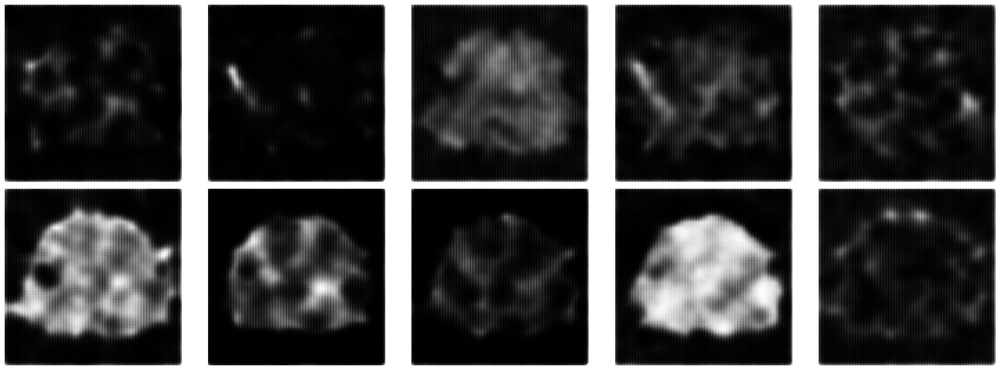

  0%|                                                                                                                        | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 1/3750 [00:00<07:14,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 2/3750 [00:00<06:51,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                                                                                                | 3/3750 [00:00<06:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 4/3750 [00:00<06:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 5/3750 [00:00<06:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                                                                                               | 6/3750 [00:00<06:36,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 7/3750 [00:00<06:36,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 8/3750 [00:00<06:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                               | 9/3750 [00:00<06:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                              | 10/3750 [00:01<06:35,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                              | 11/3750 [00:01<06:34,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                              | 12/3750 [00:01<06:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▍                                                                                                              | 13/3750 [00:01<06:32,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▍                                                                                                              | 14/3750 [00:01<06:31,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▍                                                                                                              | 15/3750 [00:01<06:33,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 16/3750 [00:01<06:32,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▌                                                                                                              | 17/3750 [00:01<06:32,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▌                                                                                                              | 18/3750 [00:01<06:33,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 19/3750 [00:02<06:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 20/3750 [00:02<06:39,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                                                                                              | 21/3750 [00:02<07:06,  8.75it/s]

1/1 [==============================] - 0s 11ms/step


  1%|▋                                                                                                              | 22/3750 [00:02<06:59,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 23/3750 [00:02<06:53,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 24/3750 [00:02<06:46,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▋                                                                                                              | 25/3750 [00:02<07:21,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 26/3750 [00:02<07:09,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 27/3750 [00:02<06:57,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 28/3750 [00:03<06:50,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▊                                                                                                              | 29/3750 [00:03<06:43,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 30/3750 [00:03<06:40,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 31/3750 [00:03<06:37,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▉                                                                                                              | 32/3750 [00:03<06:35,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▉                                                                                                              | 33/3750 [00:03<06:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█                                                                                                              | 34/3750 [00:03<06:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 35/3750 [00:03<06:35,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 36/3750 [00:03<06:33,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


  1%|█                                                                                                              | 37/3750 [00:03<06:35,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 38/3750 [00:04<06:34,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▏                                                                                                             | 39/3750 [00:04<06:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 40/3750 [00:04<06:32,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▏                                                                                                             | 41/3750 [00:04<06:31,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


  1%|█▏                                                                                                             | 42/3750 [00:04<06:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 43/3750 [00:04<06:34,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 44/3750 [00:04<06:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 45/3750 [00:04<06:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 46/3750 [00:04<06:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 47/3750 [00:05<06:29,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 48/3750 [00:05<06:28,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 49/3750 [00:05<06:27,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 50/3750 [00:05<06:28,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 51/3750 [00:05<06:27,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 52/3750 [00:05<06:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 53/3750 [00:05<06:29,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 54/3750 [00:05<06:29,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▋                                                                                                             | 55/3750 [00:05<06:40,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▋                                                                                                             | 56/3750 [00:05<06:37,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▋                                                                                                             | 57/3750 [00:06<06:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▋                                                                                                             | 58/3750 [00:06<06:32,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▋                                                                                                             | 59/3750 [00:06<06:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 60/3750 [00:06<06:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 61/3750 [00:06<06:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 62/3750 [00:06<06:29,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▊                                                                                                             | 63/3750 [00:06<06:29,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 64/3750 [00:06<06:29,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 65/3750 [00:06<06:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 66/3750 [00:07<06:26,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 67/3750 [00:07<06:26,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██                                                                                                             | 68/3750 [00:07<06:26,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 69/3750 [00:07<06:25,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██                                                                                                             | 70/3750 [00:07<06:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██                                                                                                             | 71/3750 [00:07<06:27,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 72/3750 [00:07<06:27,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 73/3750 [00:07<06:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▏                                                                                                            | 74/3750 [00:07<06:26,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 75/3750 [00:07<06:25,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▏                                                                                                            | 76/3750 [00:08<06:31,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 77/3750 [00:08<06:30,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▎                                                                                                            | 78/3750 [00:08<06:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 79/3750 [00:08<06:29,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 80/3750 [00:08<06:28,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 81/3750 [00:08<06:26,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 82/3750 [00:08<06:26,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 83/3750 [00:08<06:26,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 84/3750 [00:08<06:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▌                                                                                                            | 85/3750 [00:09<06:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▌                                                                                                            | 86/3750 [00:09<06:24,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 87/3750 [00:09<06:23,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▌                                                                                                            | 88/3750 [00:09<06:26,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 89/3750 [00:09<06:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▋                                                                                                            | 90/3750 [00:09<06:24,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 91/3750 [00:09<06:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▋                                                                                                            | 92/3750 [00:09<06:24,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▊                                                                                                            | 93/3750 [00:09<06:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▊                                                                                                            | 94/3750 [00:09<06:24,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 95/3750 [00:10<06:24,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 96/3750 [00:10<06:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▊                                                                                                            | 97/3750 [00:10<06:26,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                            | 98/3750 [00:10<06:25,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                            | 99/3750 [00:10<06:26,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


  3%|██▉                                                                                                           | 100/3750 [00:10<06:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▉                                                                                                           | 101/3750 [00:10<06:26,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                           | 102/3750 [00:10<06:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███                                                                                                           | 103/3750 [00:10<06:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 104/3750 [00:11<06:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 105/3750 [00:11<06:24,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███                                                                                                           | 106/3750 [00:11<06:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▏                                                                                                          | 107/3750 [00:11<06:24,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 108/3750 [00:11<06:23,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▏                                                                                                          | 109/3750 [00:11<06:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▏                                                                                                          | 110/3750 [00:11<06:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 111/3750 [00:11<06:22,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 112/3750 [00:11<06:22,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 113/3750 [00:12<06:21,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 114/3750 [00:12<06:21,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 115/3750 [00:12<06:23,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▍                                                                                                          | 116/3750 [00:12<06:22,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 117/3750 [00:12<06:22,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▍                                                                                                          | 118/3750 [00:12<06:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▍                                                                                                          | 119/3750 [00:12<06:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▌                                                                                                          | 120/3750 [00:12<06:21,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 121/3750 [00:12<06:24,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▌                                                                                                          | 122/3750 [00:12<06:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 123/3750 [00:13<06:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▋                                                                                                          | 124/3750 [00:13<06:23,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 125/3750 [00:13<06:22,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 126/3750 [00:13<06:22,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▋                                                                                                          | 127/3750 [00:13<06:21,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▊                                                                                                          | 128/3750 [00:13<06:21,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 129/3750 [00:13<06:20,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 130/3750 [00:13<06:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▊                                                                                                          | 131/3750 [00:13<06:20,  9.51it/s]

1/1 [==============================] - 0s 10ms/step


  4%|███▊                                                                                                          | 132/3750 [00:14<06:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▉                                                                                                          | 133/3750 [00:14<06:25,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▉                                                                                                          | 134/3750 [00:14<06:25,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▉                                                                                                          | 135/3750 [00:14<06:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▉                                                                                                          | 136/3750 [00:14<06:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████                                                                                                          | 137/3750 [00:14<06:21,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 138/3750 [00:14<06:20,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████                                                                                                          | 139/3750 [00:14<06:20,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 140/3750 [00:14<06:19,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 141/3750 [00:14<06:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 142/3750 [00:15<06:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 143/3750 [00:15<06:20,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 144/3750 [00:15<06:19,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▎                                                                                                         | 145/3750 [00:15<06:18,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 146/3750 [00:15<06:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▎                                                                                                         | 147/3750 [00:15<06:17,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▎                                                                                                         | 148/3750 [00:15<06:17,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▎                                                                                                         | 149/3750 [00:15<06:16,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 150/3750 [00:15<06:16,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 151/3750 [00:16<06:16,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 152/3750 [00:16<06:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 153/3750 [00:16<06:18,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 154/3750 [00:16<06:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▌                                                                                                         | 155/3750 [00:16<06:17,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▌                                                                                                         | 156/3750 [00:16<06:17,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▌                                                                                                         | 157/3750 [00:16<06:17,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▋                                                                                                         | 158/3750 [00:16<06:16,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▋                                                                                                         | 159/3750 [00:16<06:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▋                                                                                                         | 160/3750 [00:16<06:16,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▋                                                                                                         | 161/3750 [00:17<06:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 162/3750 [00:17<06:17,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 163/3750 [00:17<06:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 164/3750 [00:17<06:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 165/3750 [00:17<06:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 166/3750 [00:17<06:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▉                                                                                                         | 167/3750 [00:17<06:16,  9.52it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▉                                                                                                         | 168/3750 [00:17<06:18,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


  5%|████▉                                                                                                         | 169/3750 [00:17<06:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  5%|████▉                                                                                                         | 170/3750 [00:18<06:20,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████                                                                                                         | 171/3750 [00:18<06:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████                                                                                                         | 172/3750 [00:18<06:18,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 173/3750 [00:18<06:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████                                                                                                         | 174/3750 [00:18<06:16,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 175/3750 [00:18<06:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▏                                                                                                        | 176/3750 [00:18<06:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▏                                                                                                        | 177/3750 [00:18<06:15,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 178/3750 [00:18<06:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 179/3750 [00:18<06:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 180/3750 [00:19<06:18,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 181/3750 [00:19<06:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 182/3750 [00:19<06:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 183/3750 [00:19<06:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 184/3750 [00:19<06:14,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 185/3750 [00:19<06:13,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 186/3750 [00:19<06:12,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 187/3750 [00:19<06:12,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 188/3750 [00:19<06:13,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 189/3750 [00:20<06:13,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 190/3750 [00:20<06:13,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 191/3750 [00:20<06:13,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▋                                                                                                        | 192/3750 [00:20<06:12,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 193/3750 [00:20<06:13,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▋                                                                                                        | 194/3750 [00:20<06:13,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▋                                                                                                        | 195/3750 [00:20<06:12,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 196/3750 [00:20<06:12,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▊                                                                                                        | 197/3750 [00:20<06:15,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 198/3750 [00:20<06:15,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 199/3750 [00:21<06:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▊                                                                                                        | 200/3750 [00:21<06:20,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▉                                                                                                        | 201/3750 [00:21<06:18,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 202/3750 [00:21<06:16,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▉                                                                                                        | 203/3750 [00:21<06:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▉                                                                                                        | 204/3750 [00:21<06:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██████                                                                                                        | 205/3750 [00:21<06:13,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██████                                                                                                        | 206/3750 [00:21<06:14,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████                                                                                                        | 207/3750 [00:21<06:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████                                                                                                        | 208/3750 [00:22<06:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 209/3750 [00:22<06:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 210/3750 [00:22<06:11,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 211/3750 [00:22<06:11,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 212/3750 [00:22<06:10,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 213/3750 [00:22<06:09,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 214/3750 [00:22<06:08,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 215/3750 [00:22<06:11,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 216/3750 [00:22<06:11,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 217/3750 [00:22<06:11,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 218/3750 [00:23<06:13,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 219/3750 [00:23<06:17,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 220/3750 [00:23<06:15,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 221/3750 [00:23<06:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 222/3750 [00:23<06:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 223/3750 [00:23<06:11,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 224/3750 [00:23<06:09,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 225/3750 [00:23<06:11,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 226/3750 [00:23<06:11,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 227/3750 [00:24<06:11,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 228/3750 [00:24<06:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▋                                                                                                       | 229/3750 [00:24<06:10,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 230/3750 [00:24<06:11,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 231/3750 [00:24<06:15,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 232/3750 [00:24<06:14,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▊                                                                                                       | 233/3750 [00:24<06:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 234/3750 [00:24<06:26,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 235/3750 [00:24<06:22,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 236/3750 [00:24<06:19,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 237/3750 [00:25<06:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 238/3750 [00:25<06:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████                                                                                                       | 239/3750 [00:25<06:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 240/3750 [00:25<06:10,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████                                                                                                       | 241/3750 [00:25<06:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████                                                                                                       | 242/3750 [00:25<06:11,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████▏                                                                                                      | 243/3750 [00:25<06:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▏                                                                                                      | 244/3750 [00:25<06:10,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 245/3750 [00:25<06:09,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


  7%|███████▏                                                                                                      | 246/3750 [00:26<06:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 247/3750 [00:26<06:15,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 248/3750 [00:26<06:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▎                                                                                                      | 249/3750 [00:26<06:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▎                                                                                                      | 250/3750 [00:26<06:09,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▎                                                                                                      | 251/3750 [00:26<06:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▍                                                                                                      | 252/3750 [00:26<06:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▍                                                                                                      | 253/3750 [00:26<06:08,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 254/3750 [00:26<06:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▍                                                                                                      | 255/3750 [00:26<06:07,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 256/3750 [00:27<06:06,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 257/3750 [00:27<06:06,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▌                                                                                                      | 258/3750 [00:27<06:06,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▌                                                                                                      | 259/3750 [00:27<06:05,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 260/3750 [00:27<06:06,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 261/3750 [00:27<06:08,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 262/3750 [00:27<06:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 263/3750 [00:27<06:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 264/3750 [00:27<06:06,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 265/3750 [00:28<06:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▊                                                                                                      | 266/3750 [00:28<06:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▊                                                                                                      | 267/3750 [00:28<06:05,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▊                                                                                                      | 268/3750 [00:28<06:04,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▉                                                                                                      | 269/3750 [00:28<06:04,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▉                                                                                                      | 270/3750 [00:28<06:07,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▉                                                                                                      | 271/3750 [00:28<06:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▉                                                                                                      | 272/3750 [00:28<06:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 273/3750 [00:28<06:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████                                                                                                      | 274/3750 [00:28<06:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████                                                                                                      | 275/3750 [00:29<06:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████                                                                                                      | 276/3750 [00:29<06:05,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 277/3750 [00:29<06:04,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 278/3750 [00:29<06:06,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 279/3750 [00:29<06:06,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 280/3750 [00:29<06:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 281/3750 [00:29<06:07,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 282/3750 [00:29<06:05,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 283/3750 [00:29<06:05,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 284/3750 [00:30<06:04,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▎                                                                                                     | 285/3750 [00:30<06:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▍                                                                                                     | 286/3750 [00:30<06:02,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▍                                                                                                     | 287/3750 [00:30<06:02,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▍                                                                                                     | 288/3750 [00:30<06:02,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 289/3750 [00:30<06:04,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 290/3750 [00:30<06:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 291/3750 [00:30<06:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 292/3750 [00:30<06:03,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 293/3750 [00:30<06:04,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 294/3750 [00:31<06:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▋                                                                                                     | 295/3750 [00:31<06:03,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 296/3750 [00:31<06:03,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▋                                                                                                     | 297/3750 [00:31<06:02,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▋                                                                                                     | 298/3750 [00:31<06:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▊                                                                                                     | 299/3750 [00:31<06:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▊                                                                                                     | 300/3750 [00:31<06:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▊                                                                                                     | 301/3750 [00:31<06:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▊                                                                                                     | 302/3750 [00:31<06:02,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 303/3750 [00:32<06:01,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 304/3750 [00:32<06:01,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 305/3750 [00:32<06:01,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 306/3750 [00:32<06:01,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 307/3750 [00:32<06:03,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 308/3750 [00:32<06:03,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 309/3750 [00:32<06:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████                                                                                                     | 310/3750 [00:32<06:02,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████                                                                                                     | 311/3750 [00:32<06:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 312/3750 [00:32<06:00,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 313/3750 [00:33<06:00,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 314/3750 [00:33<05:59,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 315/3750 [00:33<05:59,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▎                                                                                                    | 316/3750 [00:33<06:01,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▎                                                                                                    | 317/3750 [00:33<06:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▎                                                                                                    | 318/3750 [00:33<06:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▎                                                                                                    | 319/3750 [00:33<06:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 320/3750 [00:33<06:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 321/3750 [00:33<06:00,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 322/3750 [00:34<06:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 323/3750 [00:34<06:00,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 324/3750 [00:34<05:59,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 325/3750 [00:34<06:01,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 326/3750 [00:34<06:00,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 327/3750 [00:34<06:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 328/3750 [00:34<05:59,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 329/3750 [00:34<05:59,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 330/3750 [00:34<06:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 331/3750 [00:34<06:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 332/3750 [00:35<06:01,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 333/3750 [00:35<06:00,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 334/3750 [00:35<06:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 335/3750 [00:35<06:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 336/3750 [00:35<06:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 337/3750 [00:35<06:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▉                                                                                                    | 338/3750 [00:35<06:00,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 339/3750 [00:35<06:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▉                                                                                                    | 340/3750 [00:35<05:59,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 341/3750 [00:36<05:59,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 342/3750 [00:36<05:59,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 343/3750 [00:36<06:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 344/3750 [00:36<06:00,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 345/3750 [00:36<05:59,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 346/3750 [00:36<05:59,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▏                                                                                                   | 347/3750 [00:36<05:58,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▏                                                                                                   | 348/3750 [00:36<05:59,  9.46it/s]

1/1 [==============================] - 0s 11ms/step


  9%|██████████▏                                                                                                   | 349/3750 [00:36<06:14,  9.09it/s]

1/1 [==============================] - 0s 11ms/step


  9%|██████████▎                                                                                                   | 350/3750 [00:37<06:23,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


  9%|██████████▎                                                                                                   | 351/3750 [00:37<06:26,  8.79it/s]

1/1 [==============================] - 0s 11ms/step


  9%|██████████▎                                                                                                   | 352/3750 [00:37<06:36,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▎                                                                                                   | 353/3750 [00:37<06:43,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▍                                                                                                   | 354/3750 [00:37<06:33,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▍                                                                                                   | 355/3750 [00:37<06:45,  8.37it/s]

1/1 [==============================] - 0s 10ms/step


  9%|██████████▍                                                                                                   | 356/3750 [00:37<06:50,  8.27it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▍                                                                                                   | 357/3750 [00:37<06:55,  8.16it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 358/3750 [00:37<06:39,  8.49it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 359/3750 [00:38<06:27,  8.75it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 360/3750 [00:38<06:18,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 361/3750 [00:38<06:14,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▌                                                                                                   | 362/3750 [00:38<06:10,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 363/3750 [00:38<06:07,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▋                                                                                                   | 364/3750 [00:38<06:05,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▋                                                                                                   | 365/3750 [00:38<06:03,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 10%|██████████▋                                                                                                   | 366/3750 [00:38<06:04,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 10%|██████████▊                                                                                                   | 367/3750 [00:38<06:09,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 10%|██████████▊                                                                                                   | 368/3750 [00:39<06:30,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▊                                                                                                   | 369/3750 [00:39<06:33,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▊                                                                                                   | 370/3750 [00:39<06:22,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 371/3750 [00:39<06:18,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▉                                                                                                   | 372/3750 [00:39<06:12,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 373/3750 [00:39<06:08,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▉                                                                                                   | 374/3750 [00:39<06:05,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 375/3750 [00:39<06:03,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 376/3750 [00:39<06:00,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 377/3750 [00:40<05:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 378/3750 [00:40<05:57,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 379/3750 [00:40<05:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 380/3750 [00:40<05:57,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 381/3750 [00:40<05:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 382/3750 [00:40<05:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 383/3750 [00:40<05:59,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 384/3750 [00:40<05:57,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 385/3750 [00:40<05:57,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 386/3750 [00:41<05:56,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▎                                                                                                  | 387/3750 [00:41<06:28,  8.65it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 388/3750 [00:41<06:19,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 389/3750 [00:41<06:12,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 390/3750 [00:41<06:10,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 391/3750 [00:41<06:05,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 392/3750 [00:41<06:02,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▌                                                                                                  | 393/3750 [00:41<05:59,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▌                                                                                                  | 394/3750 [00:41<05:57,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▌                                                                                                  | 395/3750 [00:41<05:56,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▌                                                                                                  | 396/3750 [00:42<05:55,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 397/3750 [00:42<05:54,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▋                                                                                                  | 398/3750 [00:42<05:54,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▋                                                                                                  | 399/3750 [00:42<05:57,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▋                                                                                                  | 400/3750 [00:42<05:57,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 11%|███████████▊                                                                                                  | 401/3750 [00:42<06:00,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 402/3750 [00:42<06:00,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 11%|███████████▊                                                                                                  | 403/3750 [00:42<05:59,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 404/3750 [00:42<05:57,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 405/3750 [00:43<05:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 406/3750 [00:43<05:57,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 407/3750 [00:43<05:55,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 408/3750 [00:43<05:55,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 409/3750 [00:43<05:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 410/3750 [00:43<05:57,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 411/3750 [00:43<05:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 412/3750 [00:43<05:56,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 413/3750 [00:43<06:00,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 414/3750 [00:44<05:58,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 415/3750 [00:44<05:56,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 416/3750 [00:44<05:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▏                                                                                                 | 417/3750 [00:44<05:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 418/3750 [00:44<05:55,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 419/3750 [00:44<05:54,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 420/3750 [00:44<05:54,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 421/3750 [00:44<05:54,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 422/3750 [00:44<05:53,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 423/3750 [00:44<05:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 424/3750 [00:45<05:54,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████████████▍                                                                                                 | 425/3750 [00:45<05:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 426/3750 [00:45<05:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 427/3750 [00:45<05:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 428/3750 [00:45<05:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 429/3750 [00:45<05:54,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 430/3750 [00:45<05:53,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▋                                                                                                 | 431/3750 [00:45<05:52,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▋                                                                                                 | 432/3750 [00:45<05:52,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▋                                                                                                 | 433/3750 [00:46<05:53,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▋                                                                                                 | 434/3750 [00:46<05:54,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 435/3750 [00:46<05:54,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▊                                                                                                 | 436/3750 [00:46<05:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 437/3750 [00:46<05:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 438/3750 [00:46<08:18,  6.64it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 439/3750 [00:46<07:33,  7.31it/s]

1/1 [==============================] - 0s 10ms/step


 12%|████████████▉                                                                                                 | 440/3750 [00:46<07:04,  7.79it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 441/3750 [00:47<06:41,  8.24it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 442/3750 [00:47<06:25,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 443/3750 [00:47<06:15,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 444/3750 [00:47<06:07,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████                                                                                                 | 445/3750 [00:47<06:01,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 446/3750 [00:47<06:06,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████                                                                                                 | 447/3750 [00:47<06:00,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 448/3750 [00:47<05:56,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 449/3750 [00:47<05:53,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 450/3750 [00:48<05:51,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 451/3750 [00:48<05:50,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 452/3750 [00:48<05:50,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 453/3750 [00:48<05:49,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 454/3750 [00:48<05:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 455/3750 [00:48<05:52,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 456/3750 [00:48<05:50,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 457/3750 [00:48<05:50,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 458/3750 [00:48<05:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 459/3750 [00:48<05:48,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 460/3750 [00:49<05:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 461/3750 [00:49<05:48,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 462/3750 [00:49<05:47,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 463/3750 [00:49<05:52,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 464/3750 [00:49<05:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 465/3750 [00:49<05:51,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▋                                                                                                | 466/3750 [00:49<05:49,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▋                                                                                                | 467/3750 [00:49<05:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 468/3750 [00:49<05:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 469/3750 [00:50<05:48,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 470/3750 [00:50<05:46,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 471/3750 [00:50<05:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 472/3750 [00:50<05:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 473/3750 [00:50<05:48,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 474/3750 [00:50<05:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 475/3750 [00:50<05:48,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 476/3750 [00:50<05:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 477/3750 [00:50<05:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 478/3750 [00:50<05:47,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 13%|██████████████                                                                                                | 479/3750 [00:51<05:53,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████                                                                                                | 480/3750 [00:51<05:50,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 481/3750 [00:51<05:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 482/3750 [00:51<05:51,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 483/3750 [00:51<05:49,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 484/3750 [00:51<05:48,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 485/3750 [00:51<05:49,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 486/3750 [00:51<05:48,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 487/3750 [00:51<05:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 488/3750 [00:52<05:47,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 489/3750 [00:52<05:46,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 490/3750 [00:52<05:44,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 13%|██████████████▍                                                                                               | 491/3750 [00:52<05:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 492/3750 [00:52<05:47,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 493/3750 [00:52<05:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 494/3750 [00:52<05:49,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 495/3750 [00:52<05:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 496/3750 [00:52<05:47,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 497/3750 [00:53<05:46,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 498/3750 [00:53<05:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▋                                                                                               | 499/3750 [00:53<05:45,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▋                                                                                               | 500/3750 [00:53<05:44,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▋                                                                                               | 501/3750 [00:53<05:46,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▋                                                                                               | 502/3750 [00:53<05:45,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 503/3750 [00:53<05:44,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▊                                                                                               | 504/3750 [00:53<05:44,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 505/3750 [00:53<05:45,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 13%|██████████████▊                                                                                               | 506/3750 [00:53<05:46,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▊                                                                                               | 507/3750 [00:54<05:45,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 508/3750 [00:54<05:44,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▉                                                                                               | 509/3750 [00:54<05:43,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 510/3750 [00:54<05:44,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 511/3750 [00:54<05:45,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 512/3750 [00:54<05:45,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 513/3750 [00:54<05:44,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 14%|███████████████                                                                                               | 514/3750 [00:54<05:45,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 515/3750 [00:54<05:46,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▏                                                                                              | 516/3750 [00:55<05:45,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 517/3750 [00:55<05:43,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▏                                                                                              | 518/3750 [00:55<05:42,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 519/3750 [00:55<05:41,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 520/3750 [00:55<05:43,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 521/3750 [00:55<05:43,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 522/3750 [00:55<05:42,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 523/3750 [00:55<05:42,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 524/3750 [00:55<05:42,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 525/3750 [00:55<05:40,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 526/3750 [00:56<05:39,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 527/3750 [00:56<05:39,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 528/3750 [00:56<05:39,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▌                                                                                              | 529/3750 [00:56<05:41,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 530/3750 [00:56<05:41,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▌                                                                                              | 531/3750 [00:56<05:40,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▌                                                                                              | 532/3750 [00:56<05:40,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 533/3750 [00:56<05:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 534/3750 [00:56<05:38,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 535/3750 [00:57<05:36,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 536/3750 [00:57<05:36,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 537/3750 [00:57<05:38,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 538/3750 [00:57<05:46,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 539/3750 [00:57<05:44,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 540/3750 [00:57<05:42,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 541/3750 [00:57<05:41,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▉                                                                                              | 542/3750 [00:57<05:40,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▉                                                                                              | 543/3750 [00:57<05:39,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 15%|███████████████▉                                                                                              | 544/3750 [00:58<05:41,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 15%|███████████████▉                                                                                              | 545/3750 [00:58<05:40,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 546/3750 [00:58<05:39,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 547/3750 [00:58<05:41,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 548/3750 [00:58<05:41,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 549/3750 [00:58<05:40,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 550/3750 [00:58<05:38,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 551/3750 [00:58<05:37,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 552/3750 [00:58<05:36,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 553/3750 [00:58<05:37,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 554/3750 [00:59<05:37,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 555/3750 [00:59<05:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 556/3750 [00:59<05:35,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 557/3750 [00:59<05:38,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 558/3750 [00:59<05:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 559/3750 [00:59<05:35,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 560/3750 [00:59<05:36,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 561/3750 [00:59<05:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 562/3750 [00:59<05:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 563/3750 [01:00<05:38,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 564/3750 [01:00<05:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 565/3750 [01:00<05:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 566/3750 [01:00<05:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 567/3750 [01:00<05:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 568/3750 [01:00<05:36,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 569/3750 [01:00<05:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 570/3750 [01:00<05:36,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 571/3750 [01:00<05:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▊                                                                                             | 572/3750 [01:00<05:34,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 573/3750 [01:01<05:36,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 574/3750 [01:01<05:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 575/3750 [01:01<05:39,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▉                                                                                             | 576/3750 [01:01<05:38,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▉                                                                                             | 577/3750 [01:01<05:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▉                                                                                             | 578/3750 [01:01<05:39,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▉                                                                                             | 579/3750 [01:01<05:37,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████████████████                                                                                             | 580/3750 [01:01<05:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████████████████                                                                                             | 581/3750 [01:01<05:36,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 16%|█████████████████                                                                                             | 582/3750 [01:02<05:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████                                                                                             | 583/3750 [01:02<05:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 584/3750 [01:02<05:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 585/3750 [01:02<05:36,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 586/3750 [01:02<05:36,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 16%|█████████████████▏                                                                                            | 587/3750 [01:02<05:36,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 588/3750 [01:02<05:35,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 589/3750 [01:02<05:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 590/3750 [01:02<05:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 591/3750 [01:02<05:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 592/3750 [01:03<05:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 593/3750 [01:03<05:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 594/3750 [01:03<05:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 595/3750 [01:03<05:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 596/3750 [01:03<05:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▌                                                                                            | 597/3750 [01:03<05:34,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 598/3750 [01:03<05:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 599/3750 [01:03<05:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 600/3750 [01:03<05:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 601/3750 [01:04<05:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 602/3750 [01:04<05:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 603/3750 [01:04<05:34,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 604/3750 [01:04<05:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 605/3750 [01:04<05:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 606/3750 [01:04<05:31,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 607/3750 [01:04<05:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 608/3750 [01:04<05:30,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 609/3750 [01:04<05:32,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 610/3750 [01:04<05:33,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 611/3750 [01:05<05:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 612/3750 [01:05<05:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 613/3750 [01:05<05:32,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 614/3750 [01:05<05:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 615/3750 [01:05<05:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 616/3750 [01:05<05:30,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 617/3750 [01:05<05:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████▏                                                                                           | 618/3750 [01:05<05:30,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▏                                                                                           | 619/3750 [01:05<05:29,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 620/3750 [01:06<05:29,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▏                                                                                           | 621/3750 [01:06<05:32,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 622/3750 [01:06<05:32,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 623/3750 [01:06<05:36,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 624/3750 [01:06<05:34,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 625/3750 [01:06<05:32,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 626/3750 [01:06<05:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 627/3750 [01:06<05:29,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 628/3750 [01:06<05:27,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 629/3750 [01:07<05:27,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 630/3750 [01:07<05:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▌                                                                                           | 631/3750 [01:07<05:31,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 632/3750 [01:07<05:32,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 633/3750 [01:07<05:32,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▌                                                                                           | 634/3750 [01:07<05:31,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 635/3750 [01:07<05:31,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 636/3750 [01:07<05:32,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 637/3750 [01:07<05:31,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 638/3750 [01:07<05:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 639/3750 [01:08<05:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 640/3750 [01:08<05:30,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 641/3750 [01:08<05:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 642/3750 [01:08<05:27,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▊                                                                                           | 643/3750 [01:08<05:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 644/3750 [01:08<05:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 645/3750 [01:08<05:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 646/3750 [01:08<05:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 647/3750 [01:08<05:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 648/3750 [01:09<05:26,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████                                                                                           | 649/3750 [01:09<05:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 650/3750 [01:09<05:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 651/3750 [01:09<05:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 652/3750 [01:09<05:28,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 653/3750 [01:09<05:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 654/3750 [01:09<05:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 655/3750 [01:09<05:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 656/3750 [01:09<05:26,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 657/3750 [01:09<05:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▎                                                                                          | 658/3750 [01:10<05:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▎                                                                                          | 659/3750 [01:10<05:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▎                                                                                          | 660/3750 [01:10<05:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▍                                                                                          | 661/3750 [01:10<05:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▍                                                                                          | 662/3750 [01:10<05:25,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 663/3750 [01:10<05:26,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▍                                                                                          | 664/3750 [01:10<05:28,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 665/3750 [01:10<05:26,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 666/3750 [01:10<05:31,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 667/3750 [01:11<05:29,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 668/3750 [01:11<05:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 669/3750 [01:11<05:26,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▋                                                                                          | 670/3750 [01:11<05:25,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 671/3750 [01:11<05:26,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▋                                                                                          | 672/3750 [01:11<05:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▋                                                                                          | 673/3750 [01:11<05:24,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 674/3750 [01:11<05:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▊                                                                                          | 675/3750 [01:11<05:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▊                                                                                          | 676/3750 [01:11<05:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▊                                                                                          | 677/3750 [01:12<05:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▉                                                                                          | 678/3750 [01:12<05:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▉                                                                                          | 679/3750 [01:12<05:23,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 680/3750 [01:12<05:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▉                                                                                          | 681/3750 [01:12<05:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 682/3750 [01:12<05:22,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 683/3750 [01:12<05:24,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 684/3750 [01:12<05:24,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 685/3750 [01:12<05:24,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 686/3750 [01:13<05:26,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▏                                                                                         | 687/3750 [01:13<05:28,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▏                                                                                         | 688/3750 [01:13<05:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 689/3750 [01:13<05:27,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▏                                                                                         | 690/3750 [01:13<05:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▎                                                                                         | 691/3750 [01:13<05:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 692/3750 [01:13<05:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 693/3750 [01:13<05:24,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▎                                                                                         | 694/3750 [01:13<05:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▍                                                                                         | 695/3750 [01:13<05:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▍                                                                                         | 696/3750 [01:14<05:23,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 697/3750 [01:14<05:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▍                                                                                         | 698/3750 [01:14<05:24,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▌                                                                                         | 699/3750 [01:14<05:23,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▌                                                                                         | 700/3750 [01:14<05:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▌                                                                                         | 701/3750 [01:14<05:21,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 702/3750 [01:14<05:21,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▌                                                                                         | 703/3750 [01:14<05:20,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▋                                                                                         | 704/3750 [01:14<05:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▋                                                                                         | 705/3750 [01:15<05:22,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 706/3750 [01:15<05:22,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 707/3750 [01:15<05:22,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▊                                                                                         | 708/3750 [01:15<05:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▊                                                                                         | 709/3750 [01:15<05:20,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 710/3750 [01:15<05:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 711/3750 [01:15<05:20,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 712/3750 [01:15<05:19,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 713/3750 [01:15<05:18,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▉                                                                                         | 714/3750 [01:16<05:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 715/3750 [01:16<05:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 716/3750 [01:16<05:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 717/3750 [01:16<05:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 718/3750 [01:16<05:21,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 719/3750 [01:16<05:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████                                                                                         | 720/3750 [01:16<05:19,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 721/3750 [01:16<05:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▏                                                                                        | 722/3750 [01:16<05:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▏                                                                                        | 723/3750 [01:16<05:20,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▏                                                                                        | 724/3750 [01:17<05:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 725/3750 [01:17<05:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 726/3750 [01:17<05:17,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 727/3750 [01:17<05:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 728/3750 [01:17<05:18,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▍                                                                                        | 729/3750 [01:17<05:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▍                                                                                        | 730/3750 [01:17<05:17,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▍                                                                                        | 731/3750 [01:17<05:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▍                                                                                        | 732/3750 [01:17<05:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▌                                                                                        | 733/3750 [01:18<05:17,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 734/3750 [01:18<05:18,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 735/3750 [01:18<05:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▌                                                                                        | 736/3750 [01:18<05:18,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 737/3750 [01:18<05:18,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▋                                                                                        | 738/3750 [01:18<05:18,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 20%|█████████████████████▋                                                                                        | 739/3750 [01:18<05:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 740/3750 [01:18<05:20,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 741/3750 [01:18<05:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 742/3750 [01:18<05:20,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 743/3750 [01:19<05:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 744/3750 [01:19<05:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 745/3750 [01:19<05:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 746/3750 [01:19<05:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 747/3750 [01:19<05:15,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 748/3750 [01:19<05:15,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 749/3750 [01:19<05:14,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 750/3750 [01:19<05:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 751/3750 [01:19<05:20,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 752/3750 [01:20<05:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 753/3750 [01:20<05:18,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 754/3750 [01:20<05:17,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 755/3750 [01:20<05:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▏                                                                                       | 756/3750 [01:20<05:16,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 757/3750 [01:20<05:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▏                                                                                       | 758/3750 [01:20<05:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 759/3750 [01:20<05:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 760/3750 [01:20<05:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▎                                                                                       | 761/3750 [01:20<05:17,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 762/3750 [01:21<05:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 763/3750 [01:21<05:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 764/3750 [01:21<05:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 765/3750 [01:21<05:14,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 766/3750 [01:21<05:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 767/3750 [01:21<05:12,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▌                                                                                       | 768/3750 [01:21<05:13,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▌                                                                                       | 769/3750 [01:21<05:15,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 21%|██████████████████████▌                                                                                       | 770/3750 [01:21<05:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▌                                                                                       | 771/3750 [01:22<05:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▋                                                                                       | 772/3750 [01:22<05:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▋                                                                                       | 773/3750 [01:22<05:13,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▋                                                                                       | 774/3750 [01:22<05:13,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 775/3750 [01:22<05:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▊                                                                                       | 776/3750 [01:22<05:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▊                                                                                       | 777/3750 [01:22<05:14,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 778/3750 [01:22<05:18,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▊                                                                                       | 779/3750 [01:22<05:16,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 780/3750 [01:22<05:15,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 781/3750 [01:23<05:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 782/3750 [01:23<05:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 783/3750 [01:23<05:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 784/3750 [01:23<05:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████                                                                                       | 785/3750 [01:23<05:16,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████                                                                                       | 786/3750 [01:23<05:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████                                                                                       | 787/3750 [01:23<05:23,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 788/3750 [01:23<05:21,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▏                                                                                      | 789/3750 [01:23<05:18,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▏                                                                                      | 790/3750 [01:24<05:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▏                                                                                      | 791/3750 [01:24<05:15,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▏                                                                                      | 792/3750 [01:24<05:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▎                                                                                      | 793/3750 [01:24<05:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▎                                                                                      | 794/3750 [01:24<05:11,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 795/3750 [01:24<05:12,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▎                                                                                      | 796/3750 [01:24<05:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 797/3750 [01:24<05:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 798/3750 [01:24<05:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 799/3750 [01:25<05:12,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 800/3750 [01:25<05:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 801/3750 [01:25<05:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▌                                                                                      | 802/3750 [01:25<05:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▌                                                                                      | 803/3750 [01:25<05:09,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▌                                                                                      | 804/3750 [01:25<05:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▌                                                                                      | 805/3750 [01:25<05:09,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▋                                                                                      | 806/3750 [01:25<05:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▋                                                                                      | 807/3750 [01:25<05:09,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▋                                                                                      | 808/3750 [01:25<05:08,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 809/3750 [01:26<05:10,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 810/3750 [01:26<05:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▊                                                                                      | 811/3750 [01:26<05:14,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▊                                                                                      | 812/3750 [01:26<05:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 813/3750 [01:26<05:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 814/3750 [01:26<05:12,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 815/3750 [01:26<05:14,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 816/3750 [01:26<05:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 817/3750 [01:26<05:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 818/3750 [01:27<05:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 819/3750 [01:27<05:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 820/3750 [01:27<05:09,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 821/3750 [01:27<05:08,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 822/3750 [01:27<05:07,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 823/3750 [01:27<05:09,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 824/3750 [01:27<05:09,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 825/3750 [01:27<05:12,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▏                                                                                     | 826/3750 [01:27<05:11,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▎                                                                                     | 827/3750 [01:27<05:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 828/3750 [01:28<05:15,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 829/3750 [01:28<05:13,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▎                                                                                     | 830/3750 [01:28<05:11,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 831/3750 [01:28<05:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 832/3750 [01:28<05:07,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 833/3750 [01:28<05:06,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 834/3750 [01:28<05:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 835/3750 [01:28<05:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 836/3750 [01:28<05:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 837/3750 [01:29<05:06,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 838/3750 [01:29<05:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 839/3750 [01:29<05:06,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 840/3750 [01:29<05:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 841/3750 [01:29<05:10,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▋                                                                                     | 842/3750 [01:29<05:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▋                                                                                     | 843/3750 [01:29<05:09,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 844/3750 [01:29<05:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 845/3750 [01:29<05:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 846/3750 [01:29<05:06,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 847/3750 [01:30<05:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 848/3750 [01:30<05:06,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▉                                                                                     | 849/3750 [01:30<05:05,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▉                                                                                     | 850/3750 [01:30<05:04,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▉                                                                                     | 851/3750 [01:30<05:02,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▉                                                                                     | 852/3750 [01:30<05:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 853/3750 [01:30<05:04,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 854/3750 [01:30<05:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 855/3750 [01:30<05:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 856/3750 [01:31<05:04,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 857/3750 [01:31<05:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▏                                                                                    | 858/3750 [01:31<05:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▏                                                                                    | 859/3750 [01:31<05:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▏                                                                                    | 860/3750 [01:31<05:03,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 861/3750 [01:31<05:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 862/3750 [01:31<05:03,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 863/3750 [01:31<05:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 864/3750 [01:31<05:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 865/3750 [01:31<05:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 866/3750 [01:32<05:05,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 867/3750 [01:32<05:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 868/3750 [01:32<05:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 869/3750 [01:32<05:02,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 870/3750 [01:32<05:05,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▌                                                                                    | 871/3750 [01:32<05:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▌                                                                                    | 872/3750 [01:32<05:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▌                                                                                    | 873/3750 [01:32<05:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 874/3750 [01:32<05:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 875/3750 [01:33<05:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 876/3750 [01:33<05:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 877/3750 [01:33<05:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 878/3750 [01:33<05:01,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 879/3750 [01:33<05:02,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 880/3750 [01:33<05:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 881/3750 [01:33<05:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▊                                                                                    | 882/3750 [01:33<05:02,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▉                                                                                    | 883/3750 [01:33<05:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 884/3750 [01:33<05:04,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▉                                                                                    | 885/3750 [01:34<05:03,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 886/3750 [01:34<05:04,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 887/3750 [01:34<05:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 888/3750 [01:34<05:02,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 889/3750 [01:34<05:04,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 890/3750 [01:34<05:03,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 891/3750 [01:34<05:02,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 24%|██████████████████████████▏                                                                                   | 892/3750 [01:34<05:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 893/3750 [01:34<05:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 894/3750 [01:35<05:04,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 895/3750 [01:35<05:02,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 896/3750 [01:35<05:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 897/3750 [01:35<05:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 898/3750 [01:35<05:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 899/3750 [01:35<05:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 900/3750 [01:35<05:00,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 901/3750 [01:35<04:59,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 902/3750 [01:35<05:00,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 903/3750 [01:36<05:01,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 904/3750 [01:36<05:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 905/3750 [01:36<05:00,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 906/3750 [01:36<05:05,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 907/3750 [01:36<05:05,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▋                                                                                   | 908/3750 [01:36<05:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 909/3750 [01:36<05:03,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▋                                                                                   | 910/3750 [01:36<05:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▋                                                                                   | 911/3750 [01:36<05:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 912/3750 [01:36<05:03,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 913/3750 [01:37<05:02,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 914/3750 [01:37<05:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 915/3750 [01:37<05:00,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 916/3750 [01:37<04:59,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▉                                                                                   | 917/3750 [01:37<05:00,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▉                                                                                   | 918/3750 [01:37<05:00,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████████████████████▉                                                                                   | 919/3750 [01:37<04:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████████████████████▉                                                                                   | 920/3750 [01:37<04:59,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 921/3750 [01:37<04:58,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 922/3750 [01:38<04:57,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 923/3750 [01:38<05:01,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 924/3750 [01:38<04:59,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 925/3750 [01:38<04:59,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▏                                                                                  | 926/3750 [01:38<05:00,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▏                                                                                  | 927/3750 [01:38<04:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▏                                                                                  | 928/3750 [01:38<04:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 929/3750 [01:38<04:58,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 930/3750 [01:38<04:58,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 931/3750 [01:38<04:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 932/3750 [01:39<04:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 933/3750 [01:39<04:57,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 934/3750 [01:39<04:58,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▍                                                                                  | 935/3750 [01:39<04:57,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 936/3750 [01:39<04:59,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▍                                                                                  | 937/3750 [01:39<04:58,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▌                                                                                  | 938/3750 [01:39<04:57,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 939/3750 [01:39<04:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 940/3750 [01:39<04:57,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▌                                                                                  | 941/3750 [01:40<04:56,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▋                                                                                  | 942/3750 [01:40<04:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 943/3750 [01:40<04:56,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▋                                                                                  | 944/3750 [01:40<04:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 945/3750 [01:40<05:02,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 946/3750 [01:40<04:59,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▊                                                                                  | 947/3750 [01:40<04:57,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▊                                                                                  | 948/3750 [01:40<04:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▊                                                                                  | 949/3750 [01:40<04:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▊                                                                                  | 950/3750 [01:40<04:54,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 951/3750 [01:41<04:56,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 952/3750 [01:41<04:57,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▉                                                                                  | 953/3750 [01:41<04:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▉                                                                                  | 954/3750 [01:41<04:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 25%|████████████████████████████                                                                                  | 955/3750 [01:41<04:55,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 25%|████████████████████████████                                                                                  | 956/3750 [01:41<04:57,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████                                                                                  | 957/3750 [01:41<04:56,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████                                                                                  | 958/3750 [01:41<04:55,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 959/3750 [01:41<04:55,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 960/3750 [01:42<04:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 961/3750 [01:42<04:57,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 962/3750 [01:42<04:55,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 963/3750 [01:42<04:56,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 964/3750 [01:42<04:56,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▎                                                                                 | 965/3750 [01:42<04:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 966/3750 [01:42<04:55,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 967/3750 [01:42<04:56,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 26%|████████████████████████████▍                                                                                 | 968/3750 [01:42<04:57,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 969/3750 [01:43<04:57,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▍                                                                                 | 970/3750 [01:43<04:55,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 971/3750 [01:43<04:55,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▌                                                                                 | 972/3750 [01:43<04:54,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▌                                                                                 | 973/3750 [01:43<04:54,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 974/3750 [01:43<04:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 975/3750 [01:43<04:54,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 976/3750 [01:43<04:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 977/3750 [01:43<04:53,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 978/3750 [01:43<04:53,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 26%|████████████████████████████▋                                                                                 | 979/3750 [01:44<04:55,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 980/3750 [01:44<04:55,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 981/3750 [01:44<04:54,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 26%|████████████████████████████▊                                                                                 | 982/3750 [01:44<04:58,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 983/3750 [01:44<04:57,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 984/3750 [01:44<04:58,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 985/3750 [01:44<04:59,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 986/3750 [01:44<04:57,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 26%|████████████████████████████▉                                                                                 | 987/3750 [01:44<04:59,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 988/3750 [01:45<05:00,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 26%|█████████████████████████████                                                                                 | 989/3750 [01:45<04:59,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 990/3750 [01:45<04:57,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████                                                                                 | 991/3750 [01:45<04:55,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████                                                                                 | 992/3750 [01:45<04:56,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████▏                                                                                | 993/3750 [01:45<04:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 994/3750 [01:45<04:54,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                                | 995/3750 [01:45<04:52,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                                | 996/3750 [01:45<04:51,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                                | 997/3750 [01:46<04:52,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                                | 998/3750 [01:46<04:50,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                                | 999/3750 [01:46<04:51,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████                                                                                | 1000/3750 [01:46<04:56,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████                                                                                | 1001/3750 [01:46<04:56,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████                                                                                | 1002/3750 [01:46<04:54,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                               | 1003/3750 [01:46<04:53,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1004/3750 [01:46<04:53,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1005/3750 [01:46<04:53,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                               | 1006/3750 [01:46<04:51,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1007/3750 [01:47<04:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1008/3750 [01:47<04:49,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1009/3750 [01:47<04:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1010/3750 [01:47<04:49,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1011/3750 [01:47<04:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▍                                                                               | 1012/3750 [01:47<04:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▍                                                                               | 1013/3750 [01:47<04:49,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▍                                                                               | 1014/3750 [01:47<04:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1015/3750 [01:47<04:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1016/3750 [01:48<04:48,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1017/3750 [01:48<04:48,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1018/3750 [01:48<04:48,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1019/3750 [01:48<04:50,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▋                                                                               | 1020/3750 [01:48<04:49,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▋                                                                               | 1021/3750 [01:48<04:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▋                                                                               | 1022/3750 [01:48<04:48,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▋                                                                               | 1023/3750 [01:48<04:48,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▊                                                                               | 1024/3750 [01:48<04:47,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▊                                                                               | 1025/3750 [01:48<04:47,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▊                                                                               | 1026/3750 [01:49<04:46,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1027/3750 [01:49<04:46,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▉                                                                               | 1028/3750 [01:49<04:48,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▉                                                                               | 1029/3750 [01:49<04:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1030/3750 [01:49<04:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1031/3750 [01:49<04:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 28%|█████████████████████████████▉                                                                               | 1032/3750 [01:49<04:49,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████                                                                               | 1033/3750 [01:49<04:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1034/3750 [01:49<04:49,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████                                                                               | 1035/3750 [01:50<04:48,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████                                                                               | 1036/3750 [01:50<04:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1037/3750 [01:50<04:47,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▏                                                                              | 1038/3750 [01:50<04:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1039/3750 [01:50<04:48,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▏                                                                              | 1040/3750 [01:50<04:47,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████████████████████████▎                                                                              | 1041/3750 [01:50<04:48,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1042/3750 [01:50<04:49,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1043/3750 [01:50<04:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1044/3750 [01:50<04:46,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1045/3750 [01:51<04:47,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▍                                                                              | 1046/3750 [01:51<04:47,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▍                                                                              | 1047/3750 [01:51<04:46,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▍                                                                              | 1048/3750 [01:51<04:47,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▍                                                                              | 1049/3750 [01:51<04:46,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▌                                                                              | 1050/3750 [01:51<04:45,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1051/3750 [01:51<04:45,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▌                                                                              | 1052/3750 [01:51<04:46,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▌                                                                              | 1053/3750 [01:51<04:50,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▋                                                                              | 1054/3750 [01:52<04:48,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▋                                                                              | 1055/3750 [01:52<04:47,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1056/3750 [01:52<04:47,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1057/3750 [01:52<04:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1058/3750 [01:52<04:47,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1059/3750 [01:52<04:46,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1060/3750 [01:52<04:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1061/3750 [01:52<04:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1062/3750 [01:52<04:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1063/3750 [01:53<04:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1064/3750 [01:53<04:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1065/3750 [01:53<04:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1066/3750 [01:53<04:44,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████████████████████████                                                                              | 1067/3750 [01:53<04:45,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████████████████████████                                                                              | 1068/3750 [01:53<04:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████                                                                              | 1069/3750 [01:53<04:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████                                                                              | 1070/3750 [01:53<04:44,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1071/3750 [01:53<04:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1072/3750 [01:53<04:44,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1073/3750 [01:54<04:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1074/3750 [01:54<04:41,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1075/3750 [01:54<04:41,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▎                                                                             | 1076/3750 [01:54<04:42,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▎                                                                             | 1077/3750 [01:54<04:42,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1078/3750 [01:54<04:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▎                                                                             | 1079/3750 [01:54<04:41,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1080/3750 [01:54<04:47,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▍                                                                             | 1081/3750 [01:54<04:45,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1082/3750 [01:55<04:44,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▍                                                                             | 1083/3750 [01:55<04:44,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1084/3750 [01:55<04:44,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1085/3750 [01:55<04:45,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1086/3750 [01:55<04:44,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1087/3750 [01:55<04:44,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1088/3750 [01:55<04:42,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▋                                                                             | 1089/3750 [01:55<04:41,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▋                                                                             | 1090/3750 [01:55<04:40,  9.47it/s]

1/1 [==============================] - 0s 11ms/step


 29%|███████████████████████████████▋                                                                             | 1091/3750 [01:55<04:42,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▋                                                                             | 1092/3750 [01:56<04:41,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▊                                                                             | 1093/3750 [01:56<04:40,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▊                                                                             | 1094/3750 [01:56<04:41,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▊                                                                             | 1095/3750 [01:56<04:44,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▊                                                                             | 1096/3750 [01:56<04:44,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▉                                                                             | 1097/3750 [01:56<04:43,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▉                                                                             | 1098/3750 [01:56<04:42,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▉                                                                             | 1099/3750 [01:56<04:41,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▉                                                                             | 1100/3750 [01:56<04:40,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1101/3750 [01:57<04:40,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 29%|████████████████████████████████                                                                             | 1102/3750 [01:57<04:40,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1103/3750 [01:57<04:41,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1104/3750 [01:57<04:43,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 29%|████████████████████████████████                                                                             | 1105/3750 [01:57<04:42,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 29%|████████████████████████████████▏                                                                            | 1106/3750 [01:57<04:40,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▏                                                                            | 1107/3750 [01:57<04:40,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▏                                                                            | 1108/3750 [01:57<04:39,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▏                                                                            | 1109/3750 [01:57<04:46,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 30%|████████████████████████████████▎                                                                            | 1110/3750 [01:58<04:47,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▎                                                                            | 1111/3750 [01:58<04:44,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▎                                                                            | 1112/3750 [01:58<04:41,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▎                                                                            | 1113/3750 [01:58<04:42,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1114/3750 [01:58<04:40,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1115/3750 [01:58<04:40,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1116/3750 [01:58<04:39,  9.42it/s]

1/1 [==============================] - 0s 11ms/step


 30%|████████████████████████████████▍                                                                            | 1117/3750 [01:58<04:41,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1118/3750 [01:58<04:40,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▌                                                                            | 1119/3750 [01:58<04:38,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▌                                                                            | 1120/3750 [01:59<04:37,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1121/3750 [01:59<04:41,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▌                                                                            | 1122/3750 [01:59<04:41,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▋                                                                            | 1123/3750 [01:59<04:40,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▋                                                                            | 1124/3750 [01:59<04:39,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1125/3750 [01:59<04:39,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▋                                                                            | 1126/3750 [01:59<04:37,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1127/3750 [01:59<04:38,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1128/3750 [01:59<04:37,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1129/3750 [02:00<04:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1130/3750 [02:00<04:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1131/3750 [02:00<04:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▉                                                                            | 1132/3750 [02:00<04:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1133/3750 [02:00<04:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▉                                                                            | 1134/3750 [02:00<04:38,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▉                                                                            | 1135/3750 [02:00<04:37,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████                                                                            | 1136/3750 [02:00<04:36,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1137/3750 [02:00<04:37,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████                                                                            | 1138/3750 [02:00<04:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████                                                                            | 1139/3750 [02:01<04:36,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1140/3750 [02:01<04:37,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1141/3750 [02:01<04:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1142/3750 [02:01<04:35,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 30%|█████████████████████████████████▏                                                                           | 1143/3750 [02:01<04:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1144/3750 [02:01<04:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1145/3750 [02:01<04:36,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1146/3750 [02:01<04:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1147/3750 [02:01<04:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1148/3750 [02:02<04:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▍                                                                           | 1149/3750 [02:02<04:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▍                                                                           | 1150/3750 [02:02<04:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▍                                                                           | 1151/3750 [02:02<04:35,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1152/3750 [02:02<04:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1153/3750 [02:02<04:36,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▌                                                                           | 1154/3750 [02:02<04:34,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▌                                                                           | 1155/3750 [02:02<04:33,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1156/3750 [02:02<04:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1157/3750 [02:02<04:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1158/3750 [02:03<04:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1159/3750 [02:03<04:34,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1160/3750 [02:03<04:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1161/3750 [02:03<04:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1162/3750 [02:03<04:31,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1163/3750 [02:03<04:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1164/3750 [02:03<04:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1165/3750 [02:03<04:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▉                                                                           | 1166/3750 [02:03<04:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▉                                                                           | 1167/3750 [02:04<04:34,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▉                                                                           | 1168/3750 [02:04<04:33,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▉                                                                           | 1169/3750 [02:04<04:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1170/3750 [02:04<04:37,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1171/3750 [02:04<04:35,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1172/3750 [02:04<04:33,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1173/3750 [02:04<04:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1174/3750 [02:04<04:31,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▏                                                                          | 1175/3750 [02:04<04:30,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 31%|██████████████████████████████████▏                                                                          | 1176/3750 [02:05<04:34,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▏                                                                          | 1177/3750 [02:05<04:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1178/3750 [02:05<04:33,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▎                                                                          | 1179/3750 [02:05<04:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1180/3750 [02:05<04:34,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1181/3750 [02:05<04:34,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▎                                                                          | 1182/3750 [02:05<04:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▍                                                                          | 1183/3750 [02:05<04:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▍                                                                          | 1184/3750 [02:05<04:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1185/3750 [02:05<04:31,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▍                                                                          | 1186/3750 [02:06<04:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1187/3750 [02:06<04:31,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1188/3750 [02:06<04:30,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1189/3750 [02:06<04:30,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1190/3750 [02:06<04:30,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1191/3750 [02:06<04:35,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▋                                                                          | 1192/3750 [02:06<04:33,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 32%|██████████████████████████████████▋                                                                          | 1193/3750 [02:06<04:34,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1194/3750 [02:06<04:32,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▋                                                                          | 1195/3750 [02:07<04:33,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1196/3750 [02:07<04:31,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1197/3750 [02:07<04:30,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1198/3750 [02:07<04:29,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1199/3750 [02:07<04:30,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1200/3750 [02:07<04:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1201/3750 [02:07<04:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1202/3750 [02:07<04:27,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1203/3750 [02:07<04:27,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1204/3750 [02:07<04:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████                                                                          | 1205/3750 [02:08<04:28,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1206/3750 [02:08<04:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████                                                                          | 1207/3750 [02:08<04:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████                                                                          | 1208/3750 [02:08<04:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1209/3750 [02:08<04:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1210/3750 [02:08<04:27,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1211/3750 [02:08<04:26,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1212/3750 [02:08<04:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1213/3750 [02:08<04:26,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1214/3750 [02:09<04:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1215/3750 [02:09<04:27,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1216/3750 [02:09<04:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1217/3750 [02:09<04:27,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 32%|███████████████████████████████████▍                                                                         | 1218/3750 [02:09<04:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1219/3750 [02:09<04:27,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1220/3750 [02:09<04:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▍                                                                         | 1221/3750 [02:09<04:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▌                                                                         | 1222/3750 [02:09<04:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▌                                                                         | 1223/3750 [02:09<04:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▌                                                                         | 1224/3750 [02:10<04:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▌                                                                         | 1225/3750 [02:10<04:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1226/3750 [02:10<04:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1227/3750 [02:10<04:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1228/3750 [02:10<04:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1229/3750 [02:10<04:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▊                                                                         | 1230/3750 [02:10<04:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1231/3750 [02:10<04:27,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1232/3750 [02:10<04:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1233/3750 [02:11<04:28,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▊                                                                         | 1234/3750 [02:11<04:27,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1235/3750 [02:11<04:26,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1236/3750 [02:11<04:26,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1237/3750 [02:11<04:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1238/3750 [02:11<04:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████                                                                         | 1239/3750 [02:11<04:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████                                                                         | 1240/3750 [02:11<04:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████                                                                         | 1241/3750 [02:11<04:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████                                                                         | 1242/3750 [02:11<04:24,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1243/3750 [02:12<04:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1244/3750 [02:12<04:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1245/3750 [02:12<04:23,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1246/3750 [02:12<04:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1247/3750 [02:12<04:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1248/3750 [02:12<04:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1249/3750 [02:12<04:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▎                                                                        | 1250/3750 [02:12<04:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1251/3750 [02:12<04:26,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▍                                                                        | 1252/3750 [02:13<04:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▍                                                                        | 1253/3750 [02:13<04:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▍                                                                        | 1254/3750 [02:13<04:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▍                                                                        | 1255/3750 [02:13<04:22,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▌                                                                        | 1256/3750 [02:13<04:22,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1257/3750 [02:13<04:23,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1258/3750 [02:13<04:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1259/3750 [02:13<04:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▌                                                                        | 1260/3750 [02:13<04:23,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1261/3750 [02:14<04:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1262/3750 [02:14<04:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▋                                                                        | 1263/3750 [02:14<04:22,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▋                                                                        | 1264/3750 [02:14<04:21,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1265/3750 [02:14<04:22,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1266/3750 [02:14<04:21,  9.48it/s]

1/1 [==============================] - 0s 11ms/step


 34%|████████████████████████████████████▊                                                                        | 1267/3750 [02:14<04:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1268/3750 [02:14<04:24,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▉                                                                        | 1269/3750 [02:14<04:24,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▉                                                                        | 1270/3750 [02:14<04:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▉                                                                        | 1271/3750 [02:15<04:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1272/3750 [02:15<04:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1273/3750 [02:15<04:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1274/3750 [02:15<04:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1275/3750 [02:15<04:20,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1276/3750 [02:15<04:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1277/3750 [02:15<04:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1278/3750 [02:15<04:22,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▏                                                                       | 1279/3750 [02:15<04:21,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1280/3750 [02:16<04:22,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1281/3750 [02:16<04:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▎                                                                       | 1282/3750 [02:16<04:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▎                                                                       | 1283/3750 [02:16<04:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▎                                                                       | 1284/3750 [02:16<04:19,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▎                                                                       | 1285/3750 [02:16<04:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1286/3750 [02:16<04:17,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1287/3750 [02:16<04:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1288/3750 [02:16<04:19,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1289/3750 [02:16<04:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1290/3750 [02:17<04:23,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▌                                                                       | 1291/3750 [02:17<04:22,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▌                                                                       | 1292/3750 [02:17<04:21,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▌                                                                       | 1293/3750 [02:17<04:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▌                                                                       | 1294/3750 [02:17<04:19,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▋                                                                       | 1295/3750 [02:17<04:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▋                                                                       | 1296/3750 [02:17<04:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▋                                                                       | 1297/3750 [02:17<04:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▋                                                                       | 1298/3750 [02:17<04:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1299/3750 [02:18<04:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1300/3750 [02:18<04:17,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1301/3750 [02:18<04:17,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1302/3750 [02:18<04:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1303/3750 [02:18<04:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▉                                                                       | 1304/3750 [02:18<04:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▉                                                                       | 1305/3750 [02:18<04:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▉                                                                       | 1306/3750 [02:18<04:17,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1307/3750 [02:18<04:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1308/3750 [02:18<04:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1309/3750 [02:19<04:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1310/3750 [02:19<04:21,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1311/3750 [02:19<04:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1312/3750 [02:19<04:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▏                                                                      | 1313/3750 [02:19<04:18,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▏                                                                      | 1314/3750 [02:19<04:18,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1315/3750 [02:19<04:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▎                                                                      | 1316/3750 [02:19<04:17,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▎                                                                      | 1317/3750 [02:19<04:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▎                                                                      | 1318/3750 [02:20<04:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▎                                                                      | 1319/3750 [02:20<04:15,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▎                                                                      | 1320/3750 [02:20<04:16,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1321/3750 [02:20<04:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1322/3750 [02:20<04:18,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▍                                                                      | 1323/3750 [02:20<04:17,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▍                                                                      | 1324/3750 [02:20<04:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1325/3750 [02:20<04:18,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1326/3750 [02:20<04:18,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▌                                                                      | 1327/3750 [02:20<04:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▌                                                                      | 1328/3750 [02:21<04:16,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▋                                                                      | 1329/3750 [02:21<04:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▋                                                                      | 1330/3750 [02:21<04:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▋                                                                      | 1331/3750 [02:21<04:14,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▋                                                                      | 1332/3750 [02:21<04:13,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▋                                                                      | 1333/3750 [02:21<04:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1334/3750 [02:21<04:14,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1335/3750 [02:21<04:14,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1336/3750 [02:21<04:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1337/3750 [02:22<04:12,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1338/3750 [02:22<04:12,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1339/3750 [02:22<04:12,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1340/3750 [02:22<04:12,  9.54it/s]

1/1 [==============================] - 0s 14ms/step


 36%|██████████████████████████████████████▉                                                                      | 1341/3750 [02:22<04:16,  9.38it/s]

1/1 [==============================] - 0s 11ms/step


 36%|███████████████████████████████████████                                                                      | 1342/3750 [02:22<04:16,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1343/3750 [02:22<04:16,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1344/3750 [02:22<04:15,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 36%|███████████████████████████████████████                                                                      | 1345/3750 [02:22<04:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1346/3750 [02:23<04:19,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1347/3750 [02:23<04:17,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1348/3750 [02:23<04:17,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1349/3750 [02:23<04:15,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1350/3750 [02:23<04:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1351/3750 [02:23<04:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1352/3750 [02:23<04:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1353/3750 [02:23<04:13,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1354/3750 [02:23<04:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1355/3750 [02:23<04:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▍                                                                     | 1356/3750 [02:24<04:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▍                                                                     | 1357/3750 [02:24<04:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▍                                                                     | 1358/3750 [02:24<04:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1359/3750 [02:24<04:11,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1360/3750 [02:24<04:10,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1361/3750 [02:24<04:11,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1362/3750 [02:24<04:11,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1363/3750 [02:24<04:11,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1364/3750 [02:24<04:11,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1365/3750 [02:25<04:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1366/3750 [02:25<04:13,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1367/3750 [02:25<04:13,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▊                                                                     | 1368/3750 [02:25<04:14,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▊                                                                     | 1369/3750 [02:25<04:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1370/3750 [02:25<04:15,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▊                                                                     | 1371/3750 [02:25<04:15,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1372/3750 [02:25<04:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1373/3750 [02:25<04:13,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1374/3750 [02:25<04:11,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1375/3750 [02:26<04:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1376/3750 [02:26<04:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████                                                                     | 1377/3750 [02:26<04:09,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████                                                                     | 1378/3750 [02:26<04:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████                                                                     | 1379/3750 [02:26<04:08,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████                                                                     | 1380/3750 [02:26<04:10,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▏                                                                    | 1381/3750 [02:26<04:10,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1382/3750 [02:26<04:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1383/3750 [02:26<04:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1384/3750 [02:27<04:09,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1385/3750 [02:27<04:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1386/3750 [02:27<04:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1387/3750 [02:27<04:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1388/3750 [02:27<04:08,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1389/3750 [02:27<04:10,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▍                                                                    | 1390/3750 [02:27<04:09,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▍                                                                    | 1391/3750 [02:27<04:09,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▍                                                                    | 1392/3750 [02:27<04:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▍                                                                    | 1393/3750 [02:27<04:10,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▌                                                                    | 1394/3750 [02:28<04:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▌                                                                    | 1395/3750 [02:28<04:11,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▌                                                                    | 1396/3750 [02:28<04:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▌                                                                    | 1397/3750 [02:28<04:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1398/3750 [02:28<04:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1399/3750 [02:28<04:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1400/3750 [02:28<04:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1401/3750 [02:28<04:07,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1402/3750 [02:28<04:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1403/3750 [02:29<04:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1404/3750 [02:29<04:06,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1405/3750 [02:29<04:06,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1406/3750 [02:29<04:06,  9.51it/s]

1/1 [==============================] - 0s 10ms/step


 38%|████████████████████████████████████████▉                                                                    | 1407/3750 [02:29<04:10,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 38%|████████████████████████████████████████▉                                                                    | 1408/3750 [02:29<04:11,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 38%|████████████████████████████████████████▉                                                                    | 1409/3750 [02:29<04:10,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 38%|████████████████████████████████████████▉                                                                    | 1410/3750 [02:29<04:08,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████                                                                    | 1411/3750 [02:29<04:07,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████                                                                    | 1412/3750 [02:29<04:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1413/3750 [02:30<04:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1414/3750 [02:30<04:05,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1415/3750 [02:30<04:05,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1416/3750 [02:30<04:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1417/3750 [02:30<04:09,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1418/3750 [02:30<04:08,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1419/3750 [02:30<04:07,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1420/3750 [02:30<04:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1421/3750 [02:30<04:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1422/3750 [02:31<04:07,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1423/3750 [02:31<04:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1424/3750 [02:31<04:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1425/3750 [02:31<04:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1426/3750 [02:31<04:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1427/3750 [02:31<04:06,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1428/3750 [02:31<04:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1429/3750 [02:31<04:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1430/3750 [02:31<04:06,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1431/3750 [02:32<04:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1432/3750 [02:32<04:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1433/3750 [02:32<04:06,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1434/3750 [02:32<04:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1435/3750 [02:32<04:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1436/3750 [02:32<04:05,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1437/3750 [02:32<04:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1438/3750 [02:32<04:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1439/3750 [02:32<04:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1440/3750 [02:32<04:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1441/3750 [02:33<04:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1442/3750 [02:33<04:02,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1443/3750 [02:33<04:02,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 39%|█████████████████████████████████████████▉                                                                   | 1444/3750 [02:33<04:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1445/3750 [02:33<04:02,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1446/3750 [02:33<04:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1447/3750 [02:33<04:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1448/3750 [02:33<04:02,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1449/3750 [02:33<04:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1450/3750 [02:34<04:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1451/3750 [02:34<04:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1452/3750 [02:34<04:01,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1453/3750 [02:34<04:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1454/3750 [02:34<04:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1455/3750 [02:34<04:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1456/3750 [02:34<04:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1457/3750 [02:34<04:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1458/3750 [02:34<04:00,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1459/3750 [02:34<04:01,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1460/3750 [02:35<04:01,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1461/3750 [02:35<04:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1462/3750 [02:35<04:02,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1463/3750 [02:35<05:24,  7.04it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1464/3750 [02:35<04:59,  7.64it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1465/3750 [02:35<04:41,  8.12it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1466/3750 [02:35<04:29,  8.48it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1467/3750 [02:35<04:20,  8.76it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1468/3750 [02:36<04:17,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1469/3750 [02:36<04:12,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1470/3750 [02:36<04:08,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1471/3750 [02:36<04:07,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1472/3750 [02:36<04:04,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1473/3750 [02:36<04:02,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1474/3750 [02:36<04:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1475/3750 [02:36<04:03,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1476/3750 [02:36<04:10,  9.09it/s]

1/1 [==============================] - 0s 11ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1477/3750 [02:37<04:12,  9.02it/s]

1/1 [==============================] - 0s 11ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1478/3750 [02:37<04:15,  8.89it/s]

1/1 [==============================] - 0s 11ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1479/3750 [02:37<04:17,  8.81it/s]

1/1 [==============================] - 0s 13ms/step


 39%|███████████████████████████████████████████                                                                  | 1480/3750 [02:37<04:24,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████████████████████████████████                                                                  | 1481/3750 [02:37<04:33,  8.31it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████                                                                  | 1482/3750 [02:37<04:46,  7.92it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████                                                                  | 1483/3750 [02:37<04:47,  7.90it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1484/3750 [02:37<04:43,  7.99it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1485/3750 [02:37<04:30,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1486/3750 [02:38<04:22,  8.64it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1487/3750 [02:38<04:15,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1488/3750 [02:38<04:11,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1489/3750 [02:38<04:09,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1490/3750 [02:38<04:06,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1491/3750 [02:38<04:04,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1492/3750 [02:38<04:03,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1493/3750 [02:38<04:03,  9.28it/s]

1/1 [==============================] - 0s 12ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1494/3750 [02:38<04:26,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1495/3750 [02:39<04:20,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1496/3750 [02:39<04:17,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1497/3750 [02:39<04:13,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1498/3750 [02:39<04:11,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1499/3750 [02:39<04:08,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1500/3750 [02:39<04:05,  9.16it/s]

1/1 [==============================] - 0s 12ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1501/3750 [02:39<04:06,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1502/3750 [02:39<04:04,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1503/3750 [02:39<04:02,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1504/3750 [02:40<04:01,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1505/3750 [02:40<04:02,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1506/3750 [02:40<04:00,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1507/3750 [02:40<04:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1508/3750 [02:40<04:00,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1509/3750 [02:40<03:59,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1510/3750 [02:40<03:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1511/3750 [02:40<03:59,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1512/3750 [02:40<03:58,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1513/3750 [02:41<03:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1514/3750 [02:41<03:59,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1515/3750 [02:41<04:00,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1516/3750 [02:41<04:01,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1517/3750 [02:41<04:00,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 40%|████████████████████████████████████████████                                                                 | 1518/3750 [02:41<04:01,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1519/3750 [02:41<04:00,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1520/3750 [02:41<03:59,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▏                                                                | 1521/3750 [02:41<03:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▏                                                                | 1522/3750 [02:42<03:57,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1523/3750 [02:42<03:56,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1524/3750 [02:42<03:55,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▎                                                                | 1525/3750 [02:42<03:55,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▎                                                                | 1526/3750 [02:42<03:57,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1527/3750 [02:42<03:56,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1528/3750 [02:42<03:57,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1529/3750 [02:42<03:57,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1530/3750 [02:42<03:56,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1531/3750 [02:42<03:57,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1532/3750 [02:43<03:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1533/3750 [02:43<03:56,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1534/3750 [02:43<03:55,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1535/3750 [02:43<03:57,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1536/3750 [02:43<03:57,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████████████████████████████████▋                                                                | 1537/3750 [02:43<03:57,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▋                                                                | 1538/3750 [02:43<03:56,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▋                                                                | 1539/3750 [02:43<03:55,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1540/3750 [02:43<03:55,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1541/3750 [02:44<03:55,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████████████████████████████████▊                                                                | 1542/3750 [02:44<03:59,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████████████████████████████████▊                                                                | 1543/3750 [02:44<03:59,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1544/3750 [02:44<03:57,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1545/3750 [02:44<03:57,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1546/3750 [02:44<03:56,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1547/3750 [02:44<03:55,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1548/3750 [02:44<03:53,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████                                                                | 1549/3750 [02:44<03:56,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1550/3750 [02:44<03:55,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 41%|█████████████████████████████████████████████                                                                | 1551/3750 [02:45<03:54,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1552/3750 [02:45<03:53,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1553/3750 [02:45<03:53,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1554/3750 [02:45<03:55,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1555/3750 [02:45<03:54,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1556/3750 [02:45<03:53,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1557/3750 [02:45<03:52,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1558/3750 [02:45<03:52,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1559/3750 [02:45<03:53,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1560/3750 [02:46<03:51,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1561/3750 [02:46<03:51,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1562/3750 [02:46<03:50,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1563/3750 [02:46<03:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1564/3750 [02:46<03:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1565/3750 [02:46<03:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1566/3750 [02:46<03:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1567/3750 [02:46<03:49,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1568/3750 [02:46<03:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1569/3750 [02:47<03:50,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1570/3750 [02:47<03:50,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1571/3750 [02:47<03:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1572/3750 [02:47<03:51,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1573/3750 [02:47<03:54,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1574/3750 [02:47<03:53,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1575/3750 [02:47<03:53,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1576/3750 [02:47<03:54,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1577/3750 [02:47<03:53,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1578/3750 [02:47<03:51,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1579/3750 [02:48<03:53,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1580/3750 [02:48<03:52,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1581/3750 [02:48<03:51,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1582/3750 [02:48<03:50,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████                                                               | 1583/3750 [02:48<03:51,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1584/3750 [02:48<03:51,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████                                                               | 1585/3750 [02:48<03:50,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████                                                               | 1586/3750 [02:48<03:49,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1587/3750 [02:48<03:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1588/3750 [02:49<03:49,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1589/3750 [02:49<03:49,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1590/3750 [02:49<03:48,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1591/3750 [02:49<03:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1592/3750 [02:49<03:49,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1593/3750 [02:49<03:49,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1594/3750 [02:49<03:48,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1595/3750 [02:49<03:48,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1596/3750 [02:49<03:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1597/3750 [02:49<03:46,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1598/3750 [02:50<03:46,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1599/3750 [02:50<03:46,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1600/3750 [02:50<03:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1601/3750 [02:50<03:48,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1602/3750 [02:50<03:47,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1603/3750 [02:50<03:47,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1604/3750 [02:50<03:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1605/3750 [02:50<03:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1606/3750 [02:50<03:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1607/3750 [02:51<03:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1608/3750 [02:51<03:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1609/3750 [02:51<03:44,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1610/3750 [02:51<03:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1611/3750 [02:51<03:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1612/3750 [02:51<03:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1613/3750 [02:51<03:45,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1614/3750 [02:51<03:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1615/3750 [02:51<03:45,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1616/3750 [02:51<03:46,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1617/3750 [02:52<03:47,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1618/3750 [02:52<03:45,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1619/3750 [02:52<03:46,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 43%|███████████████████████████████████████████████                                                              | 1620/3750 [02:52<03:47,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1621/3750 [02:52<03:46,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1622/3750 [02:52<03:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1623/3750 [02:52<03:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1624/3750 [02:52<03:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1625/3750 [02:52<03:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1626/3750 [02:53<03:43,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1627/3750 [02:53<03:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1628/3750 [02:53<03:45,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1629/3750 [02:53<03:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1630/3750 [02:53<03:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1631/3750 [02:53<03:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1632/3750 [02:53<03:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1633/3750 [02:53<03:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1634/3750 [02:53<03:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1635/3750 [02:54<03:42,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1636/3750 [02:54<03:42,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1637/3750 [02:54<03:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1638/3750 [02:54<03:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1639/3750 [02:54<03:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1640/3750 [02:54<03:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1641/3750 [02:54<03:42,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1642/3750 [02:54<03:43,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1643/3750 [02:54<03:43,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1644/3750 [02:54<03:47,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1645/3750 [02:55<03:45,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1646/3750 [02:55<03:44,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1647/3750 [02:55<03:44,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1648/3750 [02:55<03:44,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1649/3750 [02:55<03:43,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1650/3750 [02:55<03:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1651/3750 [02:55<03:41,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1652/3750 [02:55<03:41,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1653/3750 [02:55<03:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1654/3750 [02:56<03:40,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████                                                             | 1655/3750 [02:56<03:40,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1656/3750 [02:56<03:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1657/3750 [02:56<03:41,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1658/3750 [02:56<03:40,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1659/3750 [02:56<03:41,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1660/3750 [02:56<03:40,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1661/3750 [02:56<03:40,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1662/3750 [02:56<03:40,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1663/3750 [02:56<03:40,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1664/3750 [02:57<03:39,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1665/3750 [02:57<03:41,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1666/3750 [02:57<03:40,  9.44it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1667/3750 [02:57<03:52,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1668/3750 [02:57<03:49,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1669/3750 [02:57<03:46,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1670/3750 [02:57<03:46,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1671/3750 [02:57<03:44,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1672/3750 [02:57<03:42,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1673/3750 [02:58<03:41,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1674/3750 [02:58<03:45,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1675/3750 [02:58<03:43,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1676/3750 [02:58<03:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1677/3750 [02:58<03:41,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1678/3750 [02:58<03:40,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1679/3750 [02:58<03:39,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1680/3750 [02:58<03:38,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1681/3750 [02:58<03:38,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1682/3750 [02:59<03:38,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1683/3750 [02:59<03:38,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1684/3750 [02:59<03:40,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1685/3750 [02:59<03:42,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1686/3750 [02:59<03:41,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1687/3750 [02:59<03:39,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1688/3750 [02:59<03:38,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1689/3750 [02:59<03:38,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████████████████████████████████████                                                            | 1690/3750 [02:59<03:39,  9.37it/s]

1/1 [==============================] - 0s 11ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1691/3750 [02:59<03:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1692/3750 [03:00<03:39,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1693/3750 [03:00<03:39,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1694/3750 [03:00<03:38,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1695/3750 [03:00<03:37,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1696/3750 [03:00<03:38,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1697/3750 [03:00<03:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1698/3750 [03:00<03:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1699/3750 [03:00<03:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1700/3750 [03:00<03:35,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1701/3750 [03:01<03:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1702/3750 [03:01<03:36,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1703/3750 [03:01<03:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1704/3750 [03:01<03:36,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1705/3750 [03:01<03:36,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1706/3750 [03:01<03:35,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▌                                                           | 1707/3750 [03:01<03:36,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1708/3750 [03:01<03:35,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1709/3750 [03:01<03:36,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1710/3750 [03:01<03:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1711/3750 [03:02<03:36,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1712/3750 [03:02<03:35,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1713/3750 [03:02<03:35,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1714/3750 [03:02<03:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1715/3750 [03:02<03:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1716/3750 [03:02<03:34,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1717/3750 [03:02<03:34,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1718/3750 [03:02<03:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1719/3750 [03:02<03:33,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1720/3750 [03:03<03:35,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1721/3750 [03:03<03:34,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1722/3750 [03:03<03:34,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1723/3750 [03:03<03:37,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1724/3750 [03:03<03:36,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1725/3750 [03:03<03:36,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1726/3750 [03:03<03:35,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1727/3750 [03:03<03:35,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1728/3750 [03:03<03:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1729/3750 [03:03<03:32,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1730/3750 [03:04<03:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1731/3750 [03:04<03:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1732/3750 [03:04<03:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1733/3750 [03:04<03:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1734/3750 [03:04<03:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1735/3750 [03:04<03:31,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1736/3750 [03:04<03:31,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1737/3750 [03:04<03:31,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1738/3750 [03:04<03:31,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1739/3750 [03:05<03:33,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1740/3750 [03:05<03:33,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1741/3750 [03:05<03:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1742/3750 [03:05<03:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1743/3750 [03:05<03:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1744/3750 [03:05<03:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1745/3750 [03:05<03:30,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1746/3750 [03:05<03:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1747/3750 [03:05<03:31,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1748/3750 [03:05<03:31,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1749/3750 [03:06<03:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1750/3750 [03:06<03:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1751/3750 [03:06<03:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1752/3750 [03:06<03:30,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1753/3750 [03:06<03:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1754/3750 [03:06<03:29,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████                                                          | 1755/3750 [03:06<03:29,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████                                                          | 1756/3750 [03:06<03:29,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████                                                          | 1757/3750 [03:06<03:31,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1758/3750 [03:07<03:37,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1759/3750 [03:07<03:35,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1760/3750 [03:07<03:33,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1761/3750 [03:07<03:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1762/3750 [03:07<03:31,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1763/3750 [03:07<03:30,  9.42it/s]

1/1 [==============================] - 0s 20ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1764/3750 [03:07<03:39,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1765/3750 [03:07<03:37,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1766/3750 [03:07<03:35,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1767/3750 [03:08<03:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1768/3750 [03:08<03:32,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1769/3750 [03:08<03:31,  9.37it/s]

1/1 [==============================] - 0s 12ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1770/3750 [03:08<03:32,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1771/3750 [03:08<03:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1772/3750 [03:08<03:35,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1773/3750 [03:08<03:33,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1774/3750 [03:08<03:31,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1775/3750 [03:08<03:29,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1776/3750 [03:08<03:29,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1777/3750 [03:09<03:29,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1778/3750 [03:09<03:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1779/3750 [03:09<03:29,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1780/3750 [03:09<03:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▊                                                         | 1781/3750 [03:09<03:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1782/3750 [03:09<03:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1783/3750 [03:09<03:27,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1784/3750 [03:09<03:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1785/3750 [03:09<03:29,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1786/3750 [03:10<03:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1787/3750 [03:10<03:27,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1788/3750 [03:10<03:29,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1789/3750 [03:10<03:28,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1790/3750 [03:10<03:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1791/3750 [03:10<03:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1792/3750 [03:10<03:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1793/3750 [03:10<03:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1794/3750 [03:10<03:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1795/3750 [03:11<03:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1796/3750 [03:11<03:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1797/3750 [03:11<03:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1798/3750 [03:11<03:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1799/3750 [03:11<03:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1800/3750 [03:11<03:28,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1801/3750 [03:11<03:27,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1802/3750 [03:11<03:27,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1803/3750 [03:11<03:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1804/3750 [03:11<03:28,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1805/3750 [03:12<03:27,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1806/3750 [03:12<03:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1807/3750 [03:12<03:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1808/3750 [03:12<03:26,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1809/3750 [03:12<03:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1810/3750 [03:12<03:24,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1811/3750 [03:12<03:24,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1812/3750 [03:12<03:24,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1813/3750 [03:12<03:26,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1814/3750 [03:13<03:27,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1815/3750 [03:13<03:26,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1816/3750 [03:13<03:27,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1817/3750 [03:13<03:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1818/3750 [03:13<03:26,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▊                                                        | 1819/3750 [03:13<03:25,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1820/3750 [03:13<03:24,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1821/3750 [03:13<03:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1822/3750 [03:13<03:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1823/3750 [03:13<03:24,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1824/3750 [03:14<03:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1825/3750 [03:14<03:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1826/3750 [03:14<03:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1827/3750 [03:14<03:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1828/3750 [03:14<03:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1829/3750 [03:14<03:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1830/3750 [03:14<03:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1831/3750 [03:14<03:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1832/3750 [03:14<03:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1833/3750 [03:15<03:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1834/3750 [03:15<03:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1835/3750 [03:15<03:22,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1836/3750 [03:15<03:22,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1837/3750 [03:15<03:23,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1838/3750 [03:15<03:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1839/3750 [03:15<03:21,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1840/3750 [03:15<03:21,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1841/3750 [03:15<03:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1842/3750 [03:15<03:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1843/3750 [03:16<03:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1844/3750 [03:16<03:21,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1845/3750 [03:16<03:22,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1846/3750 [03:16<03:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1847/3750 [03:16<03:23,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1848/3750 [03:16<03:22,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1849/3750 [03:16<03:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1850/3750 [03:16<03:22,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1851/3750 [03:16<03:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1852/3750 [03:17<03:20,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1853/3750 [03:17<03:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1854/3750 [03:17<03:20,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1855/3750 [03:17<03:20,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1856/3750 [03:17<03:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|█████████████████████████████████████████████████████▉                                                       | 1857/3750 [03:17<03:20,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1858/3750 [03:17<03:19,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1859/3750 [03:17<03:23,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1860/3750 [03:17<03:23,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1861/3750 [03:18<03:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1862/3750 [03:18<03:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1863/3750 [03:18<03:20,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1864/3750 [03:18<03:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1865/3750 [03:18<03:19,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1866/3750 [03:18<03:19,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1867/3750 [03:18<03:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1868/3750 [03:18<03:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1869/3750 [03:18<03:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1870/3750 [03:18<03:18,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1871/3750 [03:19<03:19,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1872/3750 [03:19<03:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1873/3750 [03:19<03:18,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1874/3750 [03:19<03:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1875/3750 [03:19<03:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1876/3750 [03:19<03:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1877/3750 [03:19<03:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1878/3750 [03:19<03:17,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1879/3750 [03:19<03:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1880/3750 [03:20<03:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1881/3750 [03:20<03:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1882/3750 [03:20<03:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1883/3750 [03:20<03:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1884/3750 [03:20<03:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1885/3750 [03:20<03:16,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1886/3750 [03:20<03:16,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1887/3750 [03:20<03:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1888/3750 [03:20<03:17,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1889/3750 [03:20<03:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1890/3750 [03:21<03:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1891/3750 [03:21<03:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1892/3750 [03:21<03:15,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████████████████████████████████████████                                                      | 1893/3750 [03:21<03:15,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1894/3750 [03:21<03:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1895/3750 [03:21<03:18,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1896/3750 [03:21<03:19,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1897/3750 [03:21<03:17,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1898/3750 [03:21<03:16,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1899/3750 [03:22<03:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1900/3750 [03:22<03:15,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1901/3750 [03:22<03:14,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1902/3750 [03:22<03:15,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1903/3750 [03:22<03:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1904/3750 [03:22<03:14,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1905/3750 [03:22<03:15,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1906/3750 [03:22<03:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1907/3750 [03:22<03:15,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1908/3750 [03:22<03:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1909/3750 [03:23<03:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1910/3750 [03:23<03:13,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1911/3750 [03:23<03:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1912/3750 [03:23<03:12,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1913/3750 [03:23<03:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1914/3750 [03:23<03:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1915/3750 [03:23<03:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1916/3750 [03:23<03:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1917/3750 [03:23<03:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1918/3750 [03:24<03:13,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1919/3750 [03:24<03:13,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1920/3750 [03:24<03:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1921/3750 [03:24<03:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1922/3750 [03:24<03:13,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1923/3750 [03:24<03:14,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1924/3750 [03:24<03:13,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1925/3750 [03:24<03:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1926/3750 [03:24<03:15,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1927/3750 [03:24<03:14,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1928/3750 [03:25<03:13,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1929/3750 [03:25<03:14,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1930/3750 [03:25<03:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████▏                                                    | 1931/3750 [03:25<03:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1932/3750 [03:25<03:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1933/3750 [03:25<03:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1934/3750 [03:25<03:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1935/3750 [03:25<03:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1936/3750 [03:25<03:11,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1937/3750 [03:26<03:10,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1938/3750 [03:26<03:10,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1939/3750 [03:26<03:09,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1940/3750 [03:26<03:09,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1941/3750 [03:26<03:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1942/3750 [03:26<03:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1943/3750 [03:26<03:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1944/3750 [03:26<03:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1945/3750 [03:26<03:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1946/3750 [03:26<03:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1947/3750 [03:27<03:09,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1948/3750 [03:27<03:09,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1949/3750 [03:27<03:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1950/3750 [03:27<03:10,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1951/3750 [03:27<03:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1952/3750 [03:27<03:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1953/3750 [03:27<03:09,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1954/3750 [03:27<03:09,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1955/3750 [03:27<03:08,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1956/3750 [03:28<03:09,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1957/3750 [03:28<03:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1958/3750 [03:28<03:09,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1959/3750 [03:28<03:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1960/3750 [03:28<03:10,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1961/3750 [03:28<03:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1962/3750 [03:28<03:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1963/3750 [03:28<03:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1964/3750 [03:28<03:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1965/3750 [03:29<03:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1966/3750 [03:29<03:07,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1967/3750 [03:29<03:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1968/3750 [03:29<03:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▏                                                   | 1969/3750 [03:29<03:08,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1970/3750 [03:29<03:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1971/3750 [03:29<03:08,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1972/3750 [03:29<03:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1973/3750 [03:29<03:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1974/3750 [03:29<03:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1975/3750 [03:30<03:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1976/3750 [03:30<03:06,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1977/3750 [03:30<03:09,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1978/3750 [03:30<03:08,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1979/3750 [03:30<03:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1980/3750 [03:30<03:08,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1981/3750 [03:30<03:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1982/3750 [03:30<03:06,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1983/3750 [03:30<03:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1984/3750 [03:31<03:06,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1985/3750 [03:31<03:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1986/3750 [03:31<03:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1987/3750 [03:31<03:10,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1988/3750 [03:31<03:08,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1989/3750 [03:31<03:08,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1990/3750 [03:31<03:07,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1991/3750 [03:31<03:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1992/3750 [03:31<03:06,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1993/3750 [03:31<03:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1994/3750 [03:32<03:06,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1995/3750 [03:32<03:06,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1996/3750 [03:32<03:06,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1997/3750 [03:32<03:06,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1998/3750 [03:32<03:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1999/3750 [03:32<03:05,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2000/3750 [03:32<03:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2001/3750 [03:32<03:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2002/3750 [03:32<03:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2003/3750 [03:33<03:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2004/3750 [03:33<03:02,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2005/3750 [03:33<03:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2006/3750 [03:33<03:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2007/3750 [03:33<03:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2008/3750 [03:33<03:03,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2009/3750 [03:33<03:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2010/3750 [03:33<03:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2011/3750 [03:33<03:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2012/3750 [03:33<03:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2013/3750 [03:34<03:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2014/3750 [03:34<03:03,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2015/3750 [03:34<03:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2016/3750 [03:34<03:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2017/3750 [03:34<03:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2018/3750 [03:34<03:02,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2019/3750 [03:34<03:02,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2020/3750 [03:34<03:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2021/3750 [03:34<03:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2022/3750 [03:35<03:01,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2023/3750 [03:35<03:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2024/3750 [03:35<03:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2025/3750 [03:35<03:02,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2026/3750 [03:35<03:01,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2027/3750 [03:35<03:02,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2028/3750 [03:35<03:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2029/3750 [03:35<03:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2030/3750 [03:35<03:00,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2031/3750 [03:35<03:00,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2032/3750 [03:36<03:03,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2033/3750 [03:36<03:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2034/3750 [03:36<03:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2035/3750 [03:36<03:02,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2036/3750 [03:36<03:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2037/3750 [03:36<03:00,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2038/3750 [03:36<03:00,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2039/3750 [03:36<03:04,  9.28it/s]

1/1 [==============================] - 0s 11ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2040/3750 [03:36<03:07,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2041/3750 [03:37<03:10,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2042/3750 [03:37<03:12,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 54%|███████████████████████████████████████████████████████████▍                                                 | 2043/3750 [03:37<03:13,  8.82it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2044/3750 [03:37<03:18,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2045/3750 [03:37<03:23,  8.38it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2046/3750 [03:37<03:28,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2047/3750 [03:37<03:34,  7.94it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2048/3750 [03:37<03:24,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2049/3750 [03:38<03:17,  8.62it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2050/3750 [03:38<03:11,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2051/3750 [03:38<03:09,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2052/3750 [03:38<03:05,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2053/3750 [03:38<03:07,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2054/3750 [03:38<03:05,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2055/3750 [03:38<03:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2056/3750 [03:38<03:02,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2057/3750 [03:38<03:15,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2058/3750 [03:39<03:16,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2059/3750 [03:39<03:19,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2060/3750 [03:39<03:15,  8.64it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2061/3750 [03:39<03:10,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2062/3750 [03:39<03:06,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2063/3750 [03:39<03:05,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2064/3750 [03:39<03:03,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2065/3750 [03:39<03:02,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2066/3750 [03:39<03:01,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2067/3750 [03:40<03:01,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2068/3750 [03:40<03:00,  9.34it/s]

1/1 [==============================] - 0s 11ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2069/3750 [03:40<03:00,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2070/3750 [03:40<03:00,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2071/3750 [03:40<02:59,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2072/3750 [03:40<03:00,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2073/3750 [03:40<03:02,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2074/3750 [03:40<03:01,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2075/3750 [03:40<02:59,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2076/3750 [03:40<02:59,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2077/3750 [03:41<02:58,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2078/3750 [03:41<02:58,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2079/3750 [03:41<02:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2080/3750 [03:41<02:58,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2081/3750 [03:41<02:57,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2082/3750 [03:41<02:57,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2083/3750 [03:41<02:57,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2084/3750 [03:41<02:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2085/3750 [03:41<02:56,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2086/3750 [03:42<02:56,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2087/3750 [03:42<02:56,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2088/3750 [03:42<02:56,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2089/3750 [03:42<02:56,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2090/3750 [03:42<02:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2091/3750 [03:42<02:56,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2092/3750 [03:42<02:56,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2093/3750 [03:42<02:55,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2094/3750 [03:42<02:55,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2095/3750 [03:42<02:54,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2096/3750 [03:43<02:53,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2097/3750 [03:43<02:53,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2098/3750 [03:43<02:54,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2099/3750 [03:43<02:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2100/3750 [03:43<02:54,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2101/3750 [03:43<02:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2102/3750 [03:43<02:54,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2103/3750 [03:43<02:53,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2104/3750 [03:43<02:52,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2105/3750 [03:44<02:52,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2106/3750 [03:44<02:52,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2107/3750 [03:44<02:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2108/3750 [03:44<02:53,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2109/3750 [03:44<02:54,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2110/3750 [03:44<02:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2111/3750 [03:44<02:54,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2112/3750 [03:44<02:53,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2113/3750 [03:44<02:52,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2114/3750 [03:45<02:54,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2115/3750 [03:45<02:53,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2116/3750 [03:45<02:53,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2117/3750 [03:45<02:55,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2118/3750 [03:45<02:56,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2119/3750 [03:45<02:56,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2120/3750 [03:45<02:56,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2121/3750 [03:45<02:57,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2122/3750 [03:45<02:56,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2123/3750 [03:45<03:00,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2124/3750 [03:46<02:59,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2125/3750 [03:46<02:57,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2126/3750 [03:46<02:56,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2127/3750 [03:46<02:55,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2128/3750 [03:46<02:58,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2129/3750 [03:46<02:56,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2130/3750 [03:46<02:54,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2131/3750 [03:46<02:53,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2132/3750 [03:46<02:52,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2133/3750 [03:47<02:52,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2134/3750 [03:47<02:50,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2135/3750 [03:47<02:50,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2136/3750 [03:47<02:50,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2137/3750 [03:47<02:51,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2138/3750 [03:47<02:51,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2139/3750 [03:47<02:51,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2140/3750 [03:47<02:50,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2141/3750 [03:47<02:53,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2142/3750 [03:48<02:54,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2143/3750 [03:48<02:53,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2144/3750 [03:48<02:56,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2145/3750 [03:48<02:56,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2146/3750 [03:48<02:54,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2147/3750 [03:48<02:53,  9.24it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2148/3750 [03:48<02:53,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2149/3750 [03:48<02:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2150/3750 [03:48<02:52,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2151/3750 [03:48<02:51,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2152/3750 [03:49<02:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2153/3750 [03:49<02:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2154/3750 [03:49<02:50,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2155/3750 [03:49<02:53,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2156/3750 [03:49<02:52,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2157/3750 [03:49<02:51,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2158/3750 [03:49<02:49,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2159/3750 [03:49<02:48,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2160/3750 [03:49<02:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2161/3750 [03:50<02:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2162/3750 [03:50<02:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2163/3750 [03:50<02:47,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2164/3750 [03:50<02:48,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2165/3750 [03:50<02:48,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2166/3750 [03:50<02:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2167/3750 [03:50<02:47,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2168/3750 [03:50<02:47,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2169/3750 [03:50<02:47,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2170/3750 [03:51<02:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2171/3750 [03:51<02:47,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2172/3750 [03:51<02:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2173/3750 [03:51<02:47,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2174/3750 [03:51<02:47,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2175/3750 [03:51<02:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2176/3750 [03:51<02:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2177/3750 [03:51<02:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2178/3750 [03:51<02:46,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2179/3750 [03:51<02:46,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2180/3750 [03:52<02:45,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2181/3750 [03:52<02:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2182/3750 [03:52<02:46,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2183/3750 [03:52<02:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2184/3750 [03:52<02:45,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2185/3750 [03:52<02:45,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2186/3750 [03:52<02:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2187/3750 [03:52<02:44,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2188/3750 [03:52<02:45,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2189/3750 [03:53<02:45,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2190/3750 [03:53<02:44,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2191/3750 [03:53<02:46,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2192/3750 [03:53<02:45,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2193/3750 [03:53<02:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2194/3750 [03:53<02:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2195/3750 [03:53<02:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2196/3750 [03:53<02:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2197/3750 [03:53<02:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2198/3750 [03:53<02:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2199/3750 [03:54<02:43,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2200/3750 [03:54<02:44,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2201/3750 [03:54<02:45,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2202/3750 [03:54<02:45,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2203/3750 [03:54<02:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2204/3750 [03:54<02:44,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2205/3750 [03:54<02:46,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2206/3750 [03:54<02:45,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2207/3750 [03:54<02:44,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2208/3750 [03:55<02:43,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2209/3750 [03:55<02:43,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2210/3750 [03:55<02:43,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2211/3750 [03:55<02:43,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2212/3750 [03:55<02:44,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2213/3750 [03:55<02:43,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2214/3750 [03:55<02:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2215/3750 [03:55<02:42,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2216/3750 [03:55<02:42,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2217/3750 [03:55<02:42,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2218/3750 [03:56<02:42,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2219/3750 [03:56<02:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2220/3750 [03:56<02:42,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2221/3750 [03:56<02:42,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2222/3750 [03:56<02:43,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2223/3750 [03:56<02:45,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2224/3750 [03:56<02:43,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2225/3750 [03:56<02:42,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2226/3750 [03:56<02:42,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2227/3750 [03:57<02:41,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2228/3750 [03:57<02:41,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2229/3750 [03:57<02:42,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2230/3750 [03:57<02:44,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2231/3750 [03:57<02:42,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2232/3750 [03:57<02:41,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2233/3750 [03:57<02:41,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2234/3750 [03:57<02:40,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2235/3750 [03:57<02:40,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2236/3750 [03:58<02:40,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2237/3750 [03:58<02:40,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2238/3750 [03:58<02:39,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2239/3750 [03:58<02:40,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2240/3750 [03:58<02:39,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2241/3750 [03:58<02:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2242/3750 [03:58<02:39,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2243/3750 [03:58<02:38,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2244/3750 [03:58<02:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2245/3750 [03:58<02:38,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2246/3750 [03:59<02:37,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2247/3750 [03:59<02:37,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2248/3750 [03:59<02:38,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2249/3750 [03:59<02:38,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2250/3750 [03:59<02:38,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2251/3750 [03:59<02:38,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2252/3750 [03:59<02:38,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2253/3750 [03:59<02:37,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2254/3750 [03:59<02:38,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2255/3750 [04:00<02:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2256/3750 [04:00<02:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2257/3750 [04:00<02:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2258/3750 [04:00<02:38,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2259/3750 [04:00<02:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2260/3750 [04:00<02:37,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2261/3750 [04:00<02:38,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2262/3750 [04:00<02:38,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2263/3750 [04:00<02:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2264/3750 [04:00<02:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2265/3750 [04:01<02:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2266/3750 [04:01<02:37,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2267/3750 [04:01<02:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2268/3750 [04:01<02:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2269/3750 [04:01<02:37,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2270/3750 [04:01<02:37,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2271/3750 [04:01<02:36,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2272/3750 [04:01<02:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2273/3750 [04:01<02:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2274/3750 [04:02<02:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2275/3750 [04:02<02:36,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2276/3750 [04:02<02:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2277/3750 [04:02<02:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2278/3750 [04:02<02:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2279/3750 [04:02<02:36,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2280/3750 [04:02<02:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2281/3750 [04:02<02:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2282/3750 [04:02<02:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2283/3750 [04:02<02:34,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2284/3750 [04:03<02:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2285/3750 [04:03<02:35,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2286/3750 [04:03<02:35,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2287/3750 [04:03<02:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2288/3750 [04:03<02:35,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2289/3750 [04:03<02:34,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2290/3750 [04:03<02:35,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2291/3750 [04:03<02:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2292/3750 [04:03<02:35,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2293/3750 [04:04<02:34,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2294/3750 [04:04<02:35,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2295/3750 [04:04<02:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2296/3750 [04:04<02:35,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2297/3750 [04:04<02:34,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2298/3750 [04:04<02:34,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2299/3750 [04:04<02:34,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2300/3750 [04:04<02:34,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2301/3750 [04:04<02:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2302/3750 [04:05<02:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2303/3750 [04:05<02:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2304/3750 [04:05<02:35,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2305/3750 [04:05<02:34,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████████████████████████████████████████████████                                          | 2306/3750 [04:05<02:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2307/3750 [04:05<02:33,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2308/3750 [04:05<02:33,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2309/3750 [04:05<02:32,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2310/3750 [04:05<02:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2311/3750 [04:05<02:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2312/3750 [04:06<02:32,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2313/3750 [04:06<02:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2314/3750 [04:06<02:32,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2315/3750 [04:06<02:33,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2316/3750 [04:06<02:34,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2317/3750 [04:06<02:33,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2318/3750 [04:06<02:32,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2319/3750 [04:06<02:32,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2320/3750 [04:06<02:32,  9.39it/s]

1/1 [==============================] - 0s 13ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2321/3750 [04:07<02:41,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2322/3750 [04:07<02:39,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2323/3750 [04:07<02:37,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2324/3750 [04:07<02:35,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2325/3750 [04:07<02:33,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2326/3750 [04:07<02:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2327/3750 [04:07<02:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2328/3750 [04:07<02:31,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2329/3750 [04:07<02:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2330/3750 [04:08<02:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2331/3750 [04:08<02:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2332/3750 [04:08<02:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2333/3750 [04:08<02:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2334/3750 [04:08<02:29,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2335/3750 [04:08<02:30,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2336/3750 [04:08<02:29,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2337/3750 [04:08<02:29,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2338/3750 [04:08<02:28,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2339/3750 [04:08<02:29,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2340/3750 [04:09<02:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2341/3750 [04:09<02:29,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2342/3750 [04:09<02:29,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2343/3750 [04:09<02:29,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2344/3750 [04:09<02:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2345/3750 [04:09<02:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2346/3750 [04:09<02:28,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2347/3750 [04:09<02:27,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2348/3750 [04:09<02:27,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2349/3750 [04:10<02:27,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2350/3750 [04:10<02:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2351/3750 [04:10<02:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2352/3750 [04:10<02:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2353/3750 [04:10<02:28,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2354/3750 [04:10<02:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2355/3750 [04:10<02:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2356/3750 [04:10<02:27,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2357/3750 [04:10<02:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2358/3750 [04:10<02:26,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2359/3750 [04:11<02:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2360/3750 [04:11<02:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2361/3750 [04:11<02:28,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2362/3750 [04:11<02:27,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2363/3750 [04:11<02:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2364/3750 [04:11<02:26,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2365/3750 [04:11<02:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2366/3750 [04:11<02:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2367/3750 [04:11<02:25,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2368/3750 [04:12<02:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2369/3750 [04:12<02:26,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2370/3750 [04:12<02:26,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2371/3750 [04:12<02:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2372/3750 [04:12<02:24,  9.51it/s]

1/1 [==============================] - 0s 11ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2373/3750 [04:12<02:26,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2374/3750 [04:12<02:27,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2375/3750 [04:12<02:27,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2376/3750 [04:12<02:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2377/3750 [04:13<02:26,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2378/3750 [04:13<02:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2379/3750 [04:13<02:26,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2380/3750 [04:13<02:26,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2381/3750 [04:13<02:25,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▏                                       | 2382/3750 [04:13<02:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2383/3750 [04:13<02:24,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2384/3750 [04:13<02:24,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2385/3750 [04:13<02:24,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2386/3750 [04:13<02:24,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2387/3750 [04:14<02:24,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2388/3750 [04:14<02:25,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2389/3750 [04:14<02:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2390/3750 [04:14<02:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2391/3750 [04:14<02:24,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2392/3750 [04:14<02:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2393/3750 [04:14<02:23,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2394/3750 [04:14<02:23,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2395/3750 [04:14<02:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2396/3750 [04:15<02:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2397/3750 [04:15<02:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2398/3750 [04:15<02:23,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2399/3750 [04:15<02:23,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2400/3750 [04:15<02:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2401/3750 [04:15<02:22,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2402/3750 [04:15<02:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2403/3750 [04:15<02:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2404/3750 [04:15<02:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2405/3750 [04:15<02:22,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2406/3750 [04:16<02:24,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2407/3750 [04:16<02:24,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2408/3750 [04:16<02:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2409/3750 [04:16<02:23,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2410/3750 [04:16<02:22,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2411/3750 [04:16<02:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2412/3750 [04:16<02:21,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2413/3750 [04:16<02:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2414/3750 [04:16<02:20,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2415/3750 [04:17<02:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2416/3750 [04:17<02:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2417/3750 [04:17<02:20,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2418/3750 [04:17<02:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2419/3750 [04:17<02:20,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2420/3750 [04:17<02:20,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2421/3750 [04:17<02:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2422/3750 [04:17<02:20,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2423/3750 [04:17<02:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2424/3750 [04:17<02:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2425/3750 [04:18<02:20,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2426/3750 [04:18<02:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2427/3750 [04:18<02:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2428/3750 [04:18<02:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2429/3750 [04:18<02:19,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2430/3750 [04:18<02:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2431/3750 [04:18<02:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2432/3750 [04:18<02:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2433/3750 [04:18<02:20,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2434/3750 [04:19<02:20,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2435/3750 [04:19<02:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2436/3750 [04:19<02:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2437/3750 [04:19<02:19,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2438/3750 [04:19<02:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2439/3750 [04:19<02:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2440/3750 [04:19<02:17,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2441/3750 [04:19<02:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2442/3750 [04:19<02:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2443/3750 [04:20<02:18,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2444/3750 [04:20<02:18,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2445/3750 [04:20<02:17,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2446/3750 [04:20<02:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2447/3750 [04:20<02:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2448/3750 [04:20<02:19,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2449/3750 [04:20<02:19,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2450/3750 [04:20<02:21,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2451/3750 [04:20<02:19,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2452/3750 [04:20<02:18,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2453/3750 [04:21<02:18,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2454/3750 [04:21<02:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2455/3750 [04:21<02:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▍                                     | 2456/3750 [04:21<02:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2457/3750 [04:21<02:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2458/3750 [04:21<02:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2459/3750 [04:21<02:16,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2460/3750 [04:21<02:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2461/3750 [04:21<02:15,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2462/3750 [04:22<02:16,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2463/3750 [04:22<02:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2464/3750 [04:22<02:16,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2465/3750 [04:22<02:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2466/3750 [04:22<02:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2467/3750 [04:22<02:15,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2468/3750 [04:22<02:15,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2469/3750 [04:22<02:14,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2470/3750 [04:22<02:14,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2471/3750 [04:22<02:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2472/3750 [04:23<02:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2473/3750 [04:23<02:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2474/3750 [04:23<02:15,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2475/3750 [04:23<02:15,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2476/3750 [04:23<02:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2477/3750 [04:23<02:14,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2478/3750 [04:23<02:14,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2479/3750 [04:23<02:14,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2480/3750 [04:23<02:16,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2481/3750 [04:24<02:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2482/3750 [04:24<02:15,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2483/3750 [04:24<02:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2484/3750 [04:24<02:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2485/3750 [04:24<02:13,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2486/3750 [04:24<02:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2487/3750 [04:24<02:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2488/3750 [04:24<02:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2489/3750 [04:24<02:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2490/3750 [04:25<03:20,  6.29it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2491/3750 [04:25<02:59,  7.01it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2492/3750 [04:25<02:45,  7.59it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2493/3750 [04:25<02:35,  8.07it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▍                                    | 2494/3750 [04:25<02:28,  8.46it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2495/3750 [04:25<02:23,  8.75it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2496/3750 [04:25<02:20,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2497/3750 [04:25<02:17,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2498/3750 [04:26<02:16,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2499/3750 [04:26<02:14,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2500/3750 [04:26<02:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2501/3750 [04:26<02:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2502/3750 [04:26<02:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2503/3750 [04:26<02:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2504/3750 [04:26<02:11,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2505/3750 [04:26<02:11,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2506/3750 [04:26<02:11,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2507/3750 [04:26<02:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2508/3750 [04:27<02:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2509/3750 [04:27<02:13,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2510/3750 [04:27<02:12,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2511/3750 [04:27<02:11,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2512/3750 [04:27<02:10,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2513/3750 [04:27<02:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2514/3750 [04:27<02:10,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2515/3750 [04:27<02:10,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2516/3750 [04:27<02:10,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2517/3750 [04:28<02:10,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2518/3750 [04:28<02:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2519/3750 [04:28<02:10,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2520/3750 [04:28<02:10,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2521/3750 [04:28<02:09,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2522/3750 [04:28<02:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2523/3750 [04:28<02:09,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2524/3750 [04:28<02:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2525/3750 [04:28<02:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2526/3750 [04:28<02:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2527/3750 [04:29<02:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2528/3750 [04:29<02:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2529/3750 [04:29<02:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2530/3750 [04:29<02:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2531/3750 [04:29<02:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▌                                   | 2532/3750 [04:29<02:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2533/3750 [04:29<02:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2534/3750 [04:29<02:09,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2535/3750 [04:29<02:09,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2536/3750 [04:30<02:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2537/3750 [04:30<02:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2538/3750 [04:30<02:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2539/3750 [04:30<02:09,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2540/3750 [04:30<02:09,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2541/3750 [04:30<02:08,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2542/3750 [04:30<02:08,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2543/3750 [04:30<02:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2544/3750 [04:30<02:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2545/3750 [04:30<02:08,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2546/3750 [04:31<02:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2547/3750 [04:31<02:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2548/3750 [04:31<02:06,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2549/3750 [04:31<02:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2550/3750 [04:31<02:06,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2551/3750 [04:31<02:06,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2552/3750 [04:31<02:07,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2553/3750 [04:31<02:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2554/3750 [04:31<02:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2555/3750 [04:32<02:07,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2556/3750 [04:32<02:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2557/3750 [04:32<02:06,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2558/3750 [04:32<02:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2559/3750 [04:32<02:05,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2560/3750 [04:32<02:05,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2561/3750 [04:32<02:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2562/3750 [04:32<02:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2563/3750 [04:32<02:06,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2564/3750 [04:32<02:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2565/3750 [04:33<02:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2566/3750 [04:33<02:05,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2567/3750 [04:33<02:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▋                                  | 2568/3750 [04:33<02:04,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2569/3750 [04:33<02:05,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2570/3750 [04:33<02:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2571/3750 [04:33<02:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2572/3750 [04:33<02:06,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2573/3750 [04:33<02:06,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2574/3750 [04:34<02:06,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2575/3750 [04:34<02:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2576/3750 [04:34<02:04,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2577/3750 [04:34<02:04,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2578/3750 [04:34<02:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2579/3750 [04:34<02:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2580/3750 [04:34<02:03,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2581/3750 [04:34<02:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2582/3750 [04:34<02:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2583/3750 [04:35<02:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2584/3750 [04:35<02:02,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2585/3750 [04:35<02:02,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2586/3750 [04:35<02:02,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2587/3750 [04:35<02:01,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2588/3750 [04:35<02:02,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2589/3750 [04:35<02:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2590/3750 [04:35<02:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2591/3750 [04:35<02:02,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2592/3750 [04:35<02:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2593/3750 [04:36<02:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2594/3750 [04:36<02:04,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2595/3750 [04:36<02:03,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2596/3750 [04:36<02:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2597/3750 [04:36<02:02,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2598/3750 [04:36<02:02,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2599/3750 [04:36<02:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2600/3750 [04:36<02:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2601/3750 [04:36<02:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2602/3750 [04:37<02:01,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2603/3750 [04:37<02:01,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2604/3750 [04:37<02:01,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2605/3750 [04:37<02:01,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2606/3750 [04:37<02:01,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2607/3750 [04:37<02:02,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2608/3750 [04:37<02:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2609/3750 [04:37<02:00,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2610/3750 [04:37<02:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2611/3750 [04:37<02:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2612/3750 [04:38<02:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2613/3750 [04:38<02:00,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2614/3750 [04:38<02:00,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2615/3750 [04:38<02:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2616/3750 [04:38<01:59,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2617/3750 [04:38<02:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2618/3750 [04:38<02:00,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2619/3750 [04:38<02:00,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2620/3750 [04:38<01:59,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2621/3750 [04:39<01:59,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2622/3750 [04:39<01:59,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2623/3750 [04:39<01:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2624/3750 [04:39<01:58,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2625/3750 [04:39<01:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2626/3750 [04:39<01:59,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2627/3750 [04:39<01:59,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2628/3750 [04:39<01:58,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2629/3750 [04:39<01:58,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2630/3750 [04:39<01:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2631/3750 [04:40<01:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2632/3750 [04:40<01:58,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2633/3750 [04:40<01:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2634/3750 [04:40<01:58,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2635/3750 [04:40<01:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2636/3750 [04:40<01:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2637/3750 [04:40<01:58,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2638/3750 [04:40<01:57,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2639/3750 [04:40<01:57,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2640/3750 [04:41<01:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2641/3750 [04:41<01:58,  9.39it/s]

1/1 [==============================] - 0s 11ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2642/3750 [04:41<01:59,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2643/3750 [04:41<01:59,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▊                                | 2644/3750 [04:41<01:57,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2645/3750 [04:41<01:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2646/3750 [04:41<01:58,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2647/3750 [04:41<01:58,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2648/3750 [04:41<01:57,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2649/3750 [04:42<01:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2650/3750 [04:42<01:58,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2651/3750 [04:42<01:57,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2652/3750 [04:42<01:56,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2653/3750 [04:42<01:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2654/3750 [04:42<01:56,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2655/3750 [04:42<01:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2656/3750 [04:42<01:56,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2657/3750 [04:42<01:55,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2658/3750 [04:42<01:56,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2659/3750 [04:43<01:55,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2660/3750 [04:43<01:55,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2661/3750 [04:43<01:55,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2662/3750 [04:43<01:55,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2663/3750 [04:43<01:55,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2664/3750 [04:43<01:55,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2665/3750 [04:43<01:55,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2666/3750 [04:43<01:55,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2667/3750 [04:43<01:54,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2668/3750 [04:44<01:54,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2669/3750 [04:44<01:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2670/3750 [04:44<01:54,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2671/3750 [04:44<01:54,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2672/3750 [04:44<01:54,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2673/3750 [04:44<01:54,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2674/3750 [04:44<01:55,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2675/3750 [04:44<01:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2676/3750 [04:44<01:54,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2677/3750 [04:44<01:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2678/3750 [04:45<01:54,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2679/3750 [04:45<01:53,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2680/3750 [04:45<01:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2681/3750 [04:45<01:53,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2682/3750 [04:45<01:53,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2683/3750 [04:45<01:53,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2684/3750 [04:45<01:52,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2685/3750 [04:45<01:52,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2686/3750 [04:45<01:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2687/3750 [04:46<01:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2688/3750 [04:46<01:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2689/3750 [04:46<01:51,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2690/3750 [04:46<01:51,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2691/3750 [04:46<01:51,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2692/3750 [04:46<01:51,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2693/3750 [04:46<01:51,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2694/3750 [04:46<01:50,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2695/3750 [04:46<01:51,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2696/3750 [04:47<01:51,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2697/3750 [04:47<01:51,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2698/3750 [04:47<01:51,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2699/3750 [04:47<01:51,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2700/3750 [04:47<01:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2701/3750 [04:47<01:51,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2702/3750 [04:47<01:51,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2703/3750 [04:47<01:51,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2704/3750 [04:47<01:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2705/3750 [04:47<01:50,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2706/3750 [04:48<01:50,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2707/3750 [04:48<01:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2708/3750 [04:48<01:49,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2709/3750 [04:48<01:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2710/3750 [04:48<01:50,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2711/3750 [04:48<01:49,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2712/3750 [04:48<01:49,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2713/3750 [04:48<01:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2714/3750 [04:48<01:49,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2715/3750 [04:49<01:49,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2716/3750 [04:49<01:49,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2717/3750 [04:49<01:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████████████████████████████████████████████████████████                              | 2718/3750 [04:49<01:49,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2719/3750 [04:49<01:50,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2720/3750 [04:49<01:50,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2721/3750 [04:49<01:49,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2722/3750 [04:49<01:50,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2723/3750 [04:49<01:49,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2724/3750 [04:49<01:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2725/3750 [04:50<01:49,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2726/3750 [04:50<01:49,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2727/3750 [04:50<01:49,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2728/3750 [04:50<01:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2729/3750 [04:50<01:48,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2730/3750 [04:50<01:49,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2731/3750 [04:50<01:48,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2732/3750 [04:50<01:48,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2733/3750 [04:50<01:47,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2734/3750 [04:51<01:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2735/3750 [04:51<01:47,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2736/3750 [04:51<01:48,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2737/3750 [04:51<01:47,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2738/3750 [04:51<01:47,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2739/3750 [04:51<01:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2740/3750 [04:51<01:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2741/3750 [04:51<01:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2742/3750 [04:51<01:47,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2743/3750 [04:51<01:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2744/3750 [04:52<01:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2745/3750 [04:52<01:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2746/3750 [04:52<01:45,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2747/3750 [04:52<01:46,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2748/3750 [04:52<01:46,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2749/3750 [04:52<01:46,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2750/3750 [04:52<01:45,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2751/3750 [04:52<01:47,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2752/3750 [04:52<01:46,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2753/3750 [04:53<01:46,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2754/3750 [04:53<01:45,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2755/3750 [04:53<01:45,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2756/3750 [04:53<01:44,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2757/3750 [04:53<01:46,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2758/3750 [04:53<01:45,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2759/3750 [04:53<01:45,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2760/3750 [04:53<01:45,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2761/3750 [04:53<01:45,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2762/3750 [04:54<01:44,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2763/3750 [04:54<01:44,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2764/3750 [04:54<01:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2765/3750 [04:54<01:43,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2766/3750 [04:54<01:43,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2767/3750 [04:54<01:44,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2768/3750 [04:54<01:44,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2769/3750 [04:54<01:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2770/3750 [04:54<01:44,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2771/3750 [04:54<01:44,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2772/3750 [04:55<01:43,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2773/3750 [04:55<01:43,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2774/3750 [04:55<01:43,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2775/3750 [04:55<01:43,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2776/3750 [04:55<01:43,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2777/3750 [04:55<01:43,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2778/3750 [04:55<01:43,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2779/3750 [04:55<01:43,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2780/3750 [04:55<01:43,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2781/3750 [04:56<01:42,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2782/3750 [04:56<01:42,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2783/3750 [04:56<01:43,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2784/3750 [04:56<01:43,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2785/3750 [04:56<01:43,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2786/3750 [04:56<01:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2787/3750 [04:56<01:42,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2788/3750 [04:56<01:42,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2789/3750 [04:56<01:42,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2790/3750 [04:56<01:41,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2791/3750 [04:57<01:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2792/3750 [04:57<01:41,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2793/3750 [04:57<01:41,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2794/3750 [04:57<01:40,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2795/3750 [04:57<01:41,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2796/3750 [04:57<01:41,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2797/3750 [04:57<01:41,  9.40it/s]

1/1 [==============================] - 0s 11ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2798/3750 [04:57<01:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2799/3750 [04:57<01:41,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2800/3750 [04:58<01:42,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2801/3750 [04:58<01:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2802/3750 [04:58<01:41,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2803/3750 [04:58<01:41,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2804/3750 [04:58<01:41,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2805/3750 [04:58<01:40,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2806/3750 [04:58<01:40,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2807/3750 [04:58<01:40,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2808/3750 [04:58<01:40,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2809/3750 [04:59<01:39,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2810/3750 [04:59<01:39,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2811/3750 [04:59<01:39,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2812/3750 [04:59<01:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2813/3750 [04:59<01:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2814/3750 [04:59<01:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2815/3750 [04:59<01:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2816/3750 [04:59<01:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2817/3750 [04:59<01:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2818/3750 [04:59<01:39,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2819/3750 [05:00<01:38,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2820/3750 [05:00<01:38,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2821/3750 [05:00<01:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2822/3750 [05:00<01:38,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2823/3750 [05:00<01:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2824/3750 [05:00<01:38,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2825/3750 [05:00<01:39,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2826/3750 [05:00<01:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2827/3750 [05:00<01:38,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2828/3750 [05:01<01:37,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2829/3750 [05:01<01:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2830/3750 [05:01<01:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2831/3750 [05:01<01:37,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2832/3750 [05:01<01:37,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2833/3750 [05:01<01:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2834/3750 [05:01<01:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2835/3750 [05:01<01:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2836/3750 [05:01<01:38,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2837/3750 [05:02<01:37,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2838/3750 [05:02<01:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2839/3750 [05:02<01:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2840/3750 [05:02<01:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2841/3750 [05:02<01:37,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2842/3750 [05:02<01:38,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2843/3750 [05:02<01:37,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2844/3750 [05:02<01:36,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2845/3750 [05:02<01:36,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2846/3750 [05:02<01:35,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2847/3750 [05:03<01:35,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2848/3750 [05:03<01:34,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2849/3750 [05:03<01:34,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2850/3750 [05:03<01:34,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2851/3750 [05:03<01:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2852/3750 [05:03<01:34,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2853/3750 [05:03<01:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2854/3750 [05:03<01:34,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2855/3750 [05:03<01:34,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2856/3750 [05:04<01:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2857/3750 [05:04<01:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2858/3750 [05:04<01:33,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2859/3750 [05:04<01:34,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2860/3750 [05:04<01:33,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2861/3750 [05:04<01:34,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2862/3750 [05:04<01:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2863/3750 [05:04<01:33,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2864/3750 [05:04<01:33,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2865/3750 [05:04<01:38,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2866/3750 [05:05<01:36,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2867/3750 [05:05<01:35,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2868/3750 [05:05<01:34,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2869/3750 [05:05<01:34,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2870/3750 [05:05<01:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2871/3750 [05:05<01:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2872/3750 [05:05<01:33,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2873/3750 [05:05<01:34,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2874/3750 [05:05<01:33,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2875/3750 [05:06<01:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2876/3750 [05:06<01:32,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2877/3750 [05:06<01:32,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2878/3750 [05:06<01:32,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2879/3750 [05:06<01:33,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2880/3750 [05:06<01:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2881/3750 [05:06<01:32,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2882/3750 [05:06<01:32,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2883/3750 [05:06<01:32,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2884/3750 [05:06<01:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2885/3750 [05:07<01:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2886/3750 [05:07<01:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2887/3750 [05:07<01:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2888/3750 [05:07<01:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2889/3750 [05:07<01:30,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2890/3750 [05:07<01:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2891/3750 [05:07<01:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2892/3750 [05:07<01:30,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2893/3750 [05:07<01:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2894/3750 [05:08<01:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2895/3750 [05:08<01:29,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2896/3750 [05:08<01:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2897/3750 [05:08<01:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2898/3750 [05:08<01:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2899/3750 [05:08<01:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2900/3750 [05:08<01:29,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2901/3750 [05:08<01:29,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2902/3750 [05:08<01:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2903/3750 [05:09<01:29,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2904/3750 [05:09<01:29,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2905/3750 [05:09<01:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2906/3750 [05:09<01:29,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2907/3750 [05:09<01:29,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2908/3750 [05:09<01:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2909/3750 [05:09<01:29,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2910/3750 [05:09<01:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2911/3750 [05:09<01:28,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2912/3750 [05:09<01:28,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2913/3750 [05:10<01:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2914/3750 [05:10<01:28,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2915/3750 [05:10<01:28,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2916/3750 [05:10<01:28,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2917/3750 [05:10<01:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2918/3750 [05:10<01:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2919/3750 [05:10<01:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2920/3750 [05:10<01:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2921/3750 [05:10<01:27,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2922/3750 [05:11<01:28,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2923/3750 [05:11<01:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2924/3750 [05:11<01:28,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2925/3750 [05:11<01:28,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2926/3750 [05:11<01:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2927/3750 [05:11<01:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2928/3750 [05:11<01:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2929/3750 [05:11<01:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2930/3750 [05:11<01:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2931/3750 [05:11<01:26,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2932/3750 [05:12<01:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2933/3750 [05:12<01:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2934/3750 [05:12<01:27,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2935/3750 [05:12<01:26,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2936/3750 [05:12<01:26,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2937/3750 [05:12<01:26,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2938/3750 [05:12<01:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2939/3750 [05:12<01:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2940/3750 [05:12<01:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2941/3750 [05:13<01:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2942/3750 [05:13<01:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2943/3750 [05:13<01:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2944/3750 [05:13<01:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2945/3750 [05:13<01:26,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2946/3750 [05:13<01:25,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2947/3750 [05:13<01:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2948/3750 [05:13<01:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2949/3750 [05:13<01:25,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2950/3750 [05:13<01:25,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2951/3750 [05:14<01:24,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2952/3750 [05:14<01:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2953/3750 [05:14<01:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2954/3750 [05:14<01:24,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2955/3750 [05:14<01:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2956/3750 [05:14<01:23,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2957/3750 [05:14<01:23,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2958/3750 [05:14<01:23,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2959/3750 [05:14<01:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2960/3750 [05:15<01:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2961/3750 [05:15<01:23,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2962/3750 [05:15<01:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2963/3750 [05:15<01:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2964/3750 [05:15<01:22,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2965/3750 [05:15<01:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2966/3750 [05:15<01:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2967/3750 [05:15<01:22,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2968/3750 [05:15<01:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2969/3750 [05:16<01:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2970/3750 [05:16<01:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2971/3750 [05:16<01:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2972/3750 [05:16<01:22,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2973/3750 [05:16<01:22,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2974/3750 [05:16<01:21,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2975/3750 [05:16<01:22,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2976/3750 [05:16<01:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2977/3750 [05:16<01:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2978/3750 [05:16<01:21,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2979/3750 [05:17<01:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2980/3750 [05:17<01:21,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2981/3750 [05:17<01:21,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2982/3750 [05:17<01:21,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2983/3750 [05:17<01:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2984/3750 [05:17<01:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2985/3750 [05:17<01:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2986/3750 [05:17<01:20,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2987/3750 [05:17<01:20,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2988/3750 [05:18<01:19,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2989/3750 [05:18<01:20,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2990/3750 [05:18<01:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2991/3750 [05:18<01:21,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2992/3750 [05:18<01:21,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2993/3750 [05:18<01:20,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2994/3750 [05:18<01:20,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2995/3750 [05:18<01:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2996/3750 [05:18<01:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2997/3750 [05:18<01:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2998/3750 [05:19<01:19,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2999/3750 [05:19<01:19,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3000/3750 [05:19<01:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3001/3750 [05:19<01:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3002/3750 [05:19<01:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3003/3750 [05:19<01:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3004/3750 [05:19<01:18,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3005/3750 [05:19<01:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3006/3750 [05:19<01:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3007/3750 [05:20<01:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3008/3750 [05:20<01:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3009/3750 [05:20<01:18,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3010/3750 [05:20<01:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3011/3750 [05:20<01:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3012/3750 [05:20<01:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3013/3750 [05:20<01:17,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3014/3750 [05:20<01:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3015/3750 [05:20<01:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3016/3750 [05:20<01:18,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3017/3750 [05:21<01:17,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3018/3750 [05:21<01:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3019/3750 [05:21<01:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3020/3750 [05:21<01:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3021/3750 [05:21<01:17,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3022/3750 [05:21<01:16,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3023/3750 [05:21<01:16,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3024/3750 [05:21<01:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3025/3750 [05:21<01:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3026/3750 [05:22<01:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3027/3750 [05:22<01:17,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3028/3750 [05:22<01:17,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3029/3750 [05:22<01:16,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3030/3750 [05:22<01:16,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3031/3750 [05:22<01:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3032/3750 [05:22<01:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3033/3750 [05:22<01:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3034/3750 [05:22<01:15,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3035/3750 [05:22<01:15,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3036/3750 [05:23<01:15,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3037/3750 [05:23<01:15,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3038/3750 [05:23<01:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3039/3750 [05:23<01:15,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3040/3750 [05:23<01:15,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3041/3750 [05:23<01:14,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3042/3750 [05:23<01:15,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3043/3750 [05:23<01:14,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3044/3750 [05:23<01:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3045/3750 [05:24<01:14,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3046/3750 [05:24<01:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3047/3750 [05:24<01:14,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3048/3750 [05:24<01:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3049/3750 [05:24<01:13,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3050/3750 [05:24<01:13,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3051/3750 [05:24<01:13,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3052/3750 [05:24<01:13,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3053/3750 [05:24<01:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3054/3750 [05:24<01:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3055/3750 [05:25<01:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3056/3750 [05:25<01:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3057/3750 [05:25<01:12,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3058/3750 [05:25<01:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3059/3750 [05:25<01:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3060/3750 [05:25<01:12,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3061/3750 [05:25<01:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3062/3750 [05:25<01:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3063/3750 [05:25<01:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3064/3750 [05:26<01:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3065/3750 [05:26<01:11,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3066/3750 [05:26<01:11,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3067/3750 [05:26<01:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3068/3750 [05:26<01:11,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3069/3750 [05:26<01:11,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3070/3750 [05:26<01:11,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3071/3750 [05:26<01:11,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3072/3750 [05:26<01:11,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3073/3750 [05:26<01:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3074/3750 [05:27<01:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3075/3750 [05:27<01:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3076/3750 [05:27<01:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3077/3750 [05:27<01:10,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3078/3750 [05:27<01:10,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3079/3750 [05:27<01:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3080/3750 [05:27<01:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3081/3750 [05:27<01:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3082/3750 [05:27<01:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3083/3750 [05:28<01:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3084/3750 [05:28<01:11,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3085/3750 [05:28<01:10,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3086/3750 [05:28<01:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3087/3750 [05:28<01:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3088/3750 [05:28<01:09,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3089/3750 [05:28<01:09,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3090/3750 [05:28<01:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3091/3750 [05:28<01:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3092/3750 [05:29<01:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3093/3750 [05:29<01:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3094/3750 [05:29<01:08,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3095/3750 [05:29<01:08,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3096/3750 [05:29<01:08,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3097/3750 [05:29<01:08,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3098/3750 [05:29<01:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3099/3750 [05:29<01:09,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3100/3750 [05:29<01:08,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3101/3750 [05:29<01:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3102/3750 [05:30<01:09,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3103/3750 [05:30<01:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3104/3750 [05:30<01:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3105/3750 [05:30<01:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3106/3750 [05:30<01:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3107/3750 [05:30<01:07,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3108/3750 [05:30<01:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3109/3750 [05:30<01:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3110/3750 [05:30<01:07,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3111/3750 [05:31<01:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3112/3750 [05:31<01:07,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3113/3750 [05:31<01:07,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3114/3750 [05:31<01:07,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3115/3750 [05:31<01:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3116/3750 [05:31<01:06,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3117/3750 [05:31<01:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3118/3750 [05:31<01:07,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3119/3750 [05:31<01:07,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3120/3750 [05:31<01:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3121/3750 [05:32<01:06,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3122/3750 [05:32<01:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3123/3750 [05:32<01:05,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3124/3750 [05:32<01:05,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3125/3750 [05:32<01:05,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3126/3750 [05:32<01:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3127/3750 [05:32<01:06,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3128/3750 [05:32<01:05,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3129/3750 [05:32<01:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3130/3750 [05:33<01:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 83%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3131/3750 [05:33<01:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3132/3750 [05:33<01:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3133/3750 [05:33<01:04,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3134/3750 [05:33<01:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3135/3750 [05:33<01:05,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3136/3750 [05:33<01:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3137/3750 [05:33<01:04,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3138/3750 [05:33<01:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3139/3750 [05:33<01:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3140/3750 [05:34<01:04,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3141/3750 [05:34<01:03,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3142/3750 [05:34<01:03,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3143/3750 [05:34<01:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3144/3750 [05:34<01:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3145/3750 [05:34<01:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3146/3750 [05:34<01:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3147/3750 [05:34<01:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3148/3750 [05:34<01:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3149/3750 [05:35<01:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3150/3750 [05:35<01:03,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3151/3750 [05:35<01:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3152/3750 [05:35<01:02,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3153/3750 [05:35<01:02,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3154/3750 [05:35<01:02,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3155/3750 [05:35<01:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3156/3750 [05:35<01:02,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3157/3750 [05:35<01:02,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3158/3750 [05:35<01:03,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3159/3750 [05:36<01:03,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3160/3750 [05:36<01:02,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3161/3750 [05:36<01:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3162/3750 [05:36<01:02,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3163/3750 [05:36<01:02,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3164/3750 [05:36<01:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3165/3750 [05:36<01:02,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3166/3750 [05:36<01:02,  9.28it/s]

1/1 [==============================] - 0s 11ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3167/3750 [05:36<01:03,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3168/3750 [05:37<01:04,  9.07it/s]

1/1 [==============================] - 0s 11ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3169/3750 [05:37<01:04,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3170/3750 [05:37<01:06,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3171/3750 [05:37<01:08,  8.39it/s]

1/1 [==============================] - 0s 11ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3172/3750 [05:37<01:10,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3173/3750 [05:37<01:10,  8.17it/s]

1/1 [==============================] - 0s 11ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3174/3750 [05:37<01:11,  8.03it/s]

1/1 [==============================] - 0s 11ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3175/3750 [05:37<01:08,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3176/3750 [05:38<01:06,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3177/3750 [05:38<01:06,  8.65it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3178/3750 [05:38<01:04,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3179/3750 [05:38<01:03,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3180/3750 [05:38<01:01,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3181/3750 [05:38<01:01,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3182/3750 [05:38<01:01,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3183/3750 [05:38<01:01,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3184/3750 [05:38<01:01,  9.18it/s]

1/1 [==============================] - 0s 13ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3185/3750 [05:39<01:02,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3186/3750 [05:39<01:03,  8.83it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3187/3750 [05:39<01:02,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3188/3750 [05:39<01:01,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3189/3750 [05:39<01:01,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3190/3750 [05:39<01:00,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3191/3750 [05:39<01:01,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3192/3750 [05:39<01:00,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3193/3750 [05:39<01:00,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3194/3750 [05:39<00:59,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3195/3750 [05:40<00:59,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3196/3750 [05:40<00:58,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3197/3750 [05:40<00:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3198/3750 [05:40<00:58,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3199/3750 [05:40<00:58,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3200/3750 [05:40<00:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3201/3750 [05:40<00:57,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3202/3750 [05:40<00:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3203/3750 [05:40<00:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3204/3750 [05:41<00:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3205/3750 [05:41<00:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3206/3750 [05:41<00:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3207/3750 [05:41<00:57,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3208/3750 [05:41<00:57,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3209/3750 [05:41<00:57,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3210/3750 [05:41<00:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3211/3750 [05:41<00:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3212/3750 [05:41<00:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3213/3750 [05:41<00:56,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3214/3750 [05:42<00:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3215/3750 [05:42<00:55,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3216/3750 [05:42<00:55,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3217/3750 [05:42<00:55,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3218/3750 [05:42<00:56,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3219/3750 [05:42<00:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3220/3750 [05:42<00:55,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3221/3750 [05:42<00:55,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3222/3750 [05:42<00:55,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3223/3750 [05:43<00:55,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3224/3750 [05:43<00:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3225/3750 [05:43<00:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3226/3750 [05:43<00:55,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3227/3750 [05:43<00:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3228/3750 [05:43<00:55,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3229/3750 [05:43<00:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3230/3750 [05:43<00:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3231/3750 [05:43<00:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3232/3750 [05:43<00:54,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3233/3750 [05:44<00:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3234/3750 [05:44<00:55,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3235/3750 [05:44<00:55,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3236/3750 [05:44<00:55,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3237/3750 [05:44<00:54,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3238/3750 [05:44<00:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3239/3750 [05:44<00:54,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3240/3750 [05:44<00:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3241/3750 [05:44<00:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3242/3750 [05:45<00:53,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3243/3750 [05:45<00:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3244/3750 [05:45<00:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3245/3750 [05:45<00:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3246/3750 [05:45<00:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3247/3750 [05:45<00:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3248/3750 [05:45<00:53,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3249/3750 [05:45<00:53,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3250/3750 [05:45<00:53,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3251/3750 [05:46<00:53,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3252/3750 [05:46<00:53,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3253/3750 [05:46<00:54,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3254/3750 [05:46<00:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3255/3750 [05:46<00:53,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3256/3750 [05:46<00:56,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3257/3750 [05:46<00:55,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3258/3750 [05:46<00:54,  8.97it/s]

1/1 [==============================] - 0s 11ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3259/3750 [05:46<00:55,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3260/3750 [05:47<00:55,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3261/3750 [05:47<00:54,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3262/3750 [05:47<00:53,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3263/3750 [05:47<00:53,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3264/3750 [05:47<00:52,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3265/3750 [05:47<00:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3266/3750 [05:47<00:52,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3267/3750 [05:47<00:51,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3268/3750 [05:47<00:51,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3269/3750 [05:47<00:51,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3270/3750 [05:48<00:51,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3271/3750 [05:48<00:50,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3272/3750 [05:48<00:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3273/3750 [05:48<00:50,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3274/3750 [05:48<00:50,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3275/3750 [05:48<00:50,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3276/3750 [05:48<00:50,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3277/3750 [05:48<00:50,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3278/3750 [05:48<00:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3279/3750 [05:49<00:49,  9.45it/s]

1/1 [==============================] - 0s 11ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3280/3750 [05:49<00:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3281/3750 [05:49<00:50,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3282/3750 [05:49<00:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3283/3750 [05:49<00:50,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3284/3750 [05:49<00:50,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3285/3750 [05:49<00:49,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3286/3750 [05:49<00:49,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3287/3750 [05:49<00:49,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3288/3750 [05:50<00:49,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3289/3750 [05:50<00:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3290/3750 [05:50<00:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3291/3750 [05:50<00:48,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3292/3750 [05:50<00:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3293/3750 [05:50<00:48,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3294/3750 [05:50<00:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3295/3750 [05:50<00:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3296/3750 [05:50<00:47,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3297/3750 [05:50<00:47,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3298/3750 [05:51<00:47,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3299/3750 [05:51<00:47,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3300/3750 [05:51<00:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3301/3750 [05:51<00:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3302/3750 [05:51<00:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3303/3750 [05:51<00:47,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3304/3750 [05:51<00:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3305/3750 [05:51<00:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3306/3750 [05:51<00:47,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3307/3750 [05:52<00:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3308/3750 [05:52<00:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3309/3750 [05:52<00:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3310/3750 [05:52<00:46,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3311/3750 [05:52<00:47,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3312/3750 [05:52<00:46,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3313/3750 [05:52<00:46,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3314/3750 [05:52<00:46,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3315/3750 [05:52<00:46,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3316/3750 [05:52<00:46,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3317/3750 [05:53<00:46,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3318/3750 [05:53<00:45,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3319/3750 [05:53<00:45,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3320/3750 [05:53<00:46,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3321/3750 [05:53<00:45,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3322/3750 [05:53<00:45,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3323/3750 [05:53<00:45,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3324/3750 [05:53<00:45,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3325/3750 [05:53<00:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3326/3750 [05:54<00:44,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3327/3750 [05:54<00:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3328/3750 [05:54<00:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3329/3750 [05:54<00:44,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3330/3750 [05:54<00:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3331/3750 [05:54<00:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3332/3750 [05:54<00:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3333/3750 [05:54<00:43,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3334/3750 [05:54<00:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3335/3750 [05:54<00:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3336/3750 [05:55<00:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3337/3750 [05:55<00:43,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3338/3750 [05:55<00:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3339/3750 [05:55<00:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3340/3750 [05:55<00:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3341/3750 [05:55<00:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3342/3750 [05:55<00:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3343/3750 [05:55<00:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3344/3750 [05:55<00:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3345/3750 [05:56<00:42,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3346/3750 [05:56<00:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3347/3750 [05:56<00:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3348/3750 [05:56<00:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3349/3750 [05:56<00:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3350/3750 [05:56<00:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3351/3750 [05:56<00:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3352/3750 [05:56<00:41,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3353/3750 [05:56<00:41,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3354/3750 [05:56<00:41,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3355/3750 [05:57<00:41,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3356/3750 [05:57<00:41,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3357/3750 [05:57<00:41,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3358/3750 [05:57<00:41,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3359/3750 [05:57<00:41,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3360/3750 [05:57<00:41,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3361/3750 [05:57<00:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3362/3750 [05:57<00:40,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3363/3750 [05:57<00:40,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3364/3750 [05:58<00:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3365/3750 [05:58<00:41,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3366/3750 [05:58<00:41,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3367/3750 [05:58<00:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3368/3750 [05:58<00:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3369/3750 [05:58<00:40,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3370/3750 [05:58<00:40,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3371/3750 [05:58<00:40,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3372/3750 [05:58<00:40,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3373/3750 [05:59<00:40,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3374/3750 [05:59<00:39,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3375/3750 [05:59<00:39,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3376/3750 [05:59<00:39,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3377/3750 [05:59<00:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3378/3750 [05:59<00:40,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3379/3750 [05:59<00:39,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3380/3750 [05:59<00:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3381/3750 [05:59<00:39,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3382/3750 [05:59<00:39,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3383/3750 [06:00<00:38,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3384/3750 [06:00<00:38,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3385/3750 [06:00<00:38,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3386/3750 [06:00<00:38,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3387/3750 [06:00<00:38,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3388/3750 [06:00<00:38,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3389/3750 [06:00<00:38,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3390/3750 [06:00<00:38,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3391/3750 [06:00<00:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3392/3750 [06:01<00:37,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3393/3750 [06:01<00:37,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3394/3750 [06:01<00:37,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3395/3750 [06:01<00:37,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3396/3750 [06:01<00:37,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3397/3750 [06:01<00:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3398/3750 [06:01<00:37,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3399/3750 [06:01<00:37,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3400/3750 [06:01<00:37,  9.38it/s]

1/1 [==============================] - 0s 11ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3401/3750 [06:01<00:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3402/3750 [06:02<00:37,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3403/3750 [06:02<00:37,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3404/3750 [06:02<00:37,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3405/3750 [06:02<00:36,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3406/3750 [06:02<00:36,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3407/3750 [06:02<00:36,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3408/3750 [06:02<00:36,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3409/3750 [06:02<00:36,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3410/3750 [06:02<00:35,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3411/3750 [06:03<00:35,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3412/3750 [06:03<00:35,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3413/3750 [06:03<00:35,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3414/3750 [06:03<00:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3415/3750 [06:03<00:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3416/3750 [06:03<00:35,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3417/3750 [06:03<00:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3418/3750 [06:03<00:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3419/3750 [06:03<00:34,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3420/3750 [06:04<00:34,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3421/3750 [06:04<00:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3422/3750 [06:04<00:34,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3423/3750 [06:04<00:34,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3424/3750 [06:04<00:34,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3425/3750 [06:04<00:34,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3426/3750 [06:04<00:34,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3427/3750 [06:04<00:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3428/3750 [06:04<00:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3429/3750 [06:04<00:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3430/3750 [06:05<00:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3431/3750 [06:05<00:33,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3432/3750 [06:05<00:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3433/3750 [06:05<00:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3434/3750 [06:05<00:33,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3435/3750 [06:05<00:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3436/3750 [06:05<00:33,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3437/3750 [06:05<00:33,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3438/3750 [06:05<00:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3439/3750 [06:06<00:32,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3440/3750 [06:06<00:32,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3441/3750 [06:06<00:32,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3442/3750 [06:06<00:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3443/3750 [06:06<00:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3444/3750 [06:06<00:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3445/3750 [06:06<00:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3446/3750 [06:06<00:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3447/3750 [06:06<00:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3448/3750 [06:06<00:32,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3449/3750 [06:07<00:32,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3450/3750 [06:07<00:32,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3451/3750 [06:07<00:32,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3452/3750 [06:07<00:31,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3453/3750 [06:07<00:31,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3454/3750 [06:07<00:31,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3455/3750 [06:07<00:31,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3456/3750 [06:07<00:31,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3457/3750 [06:07<00:31,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3458/3750 [06:08<00:31,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3459/3750 [06:08<00:30,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3460/3750 [06:08<00:30,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3461/3750 [06:08<00:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3462/3750 [06:08<00:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3463/3750 [06:08<00:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3464/3750 [06:08<00:30,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3465/3750 [06:08<00:30,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3466/3750 [06:08<00:30,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3467/3750 [06:09<00:30,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3468/3750 [06:09<00:29,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3469/3750 [06:09<00:29,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3470/3750 [06:09<00:29,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3471/3750 [06:09<00:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3472/3750 [06:09<00:29,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3473/3750 [06:09<00:29,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3474/3750 [06:09<00:29,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3475/3750 [06:09<00:29,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3476/3750 [06:09<00:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3477/3750 [06:10<00:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3478/3750 [06:10<00:28,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3479/3750 [06:10<00:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3480/3750 [06:10<00:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3481/3750 [06:10<00:28,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3482/3750 [06:10<00:28,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3483/3750 [06:10<00:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3484/3750 [06:10<00:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3485/3750 [06:10<00:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3486/3750 [06:11<00:28,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3487/3750 [06:11<00:28,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3488/3750 [06:11<00:28,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3489/3750 [06:11<00:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3490/3750 [06:11<00:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3491/3750 [06:11<00:27,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3492/3750 [06:11<00:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3493/3750 [06:11<00:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3494/3750 [06:11<00:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3495/3750 [06:11<00:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3496/3750 [06:12<00:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3497/3750 [06:12<00:26,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3498/3750 [06:12<00:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3499/3750 [06:12<00:26,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3500/3750 [06:12<00:26,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3501/3750 [06:12<00:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3502/3750 [06:12<00:26,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3503/3750 [06:12<00:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3504/3750 [06:12<00:26,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3505/3750 [06:13<00:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3506/3750 [06:13<00:25,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3507/3750 [06:13<00:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3508/3750 [06:13<00:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3509/3750 [06:13<00:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3510/3750 [06:13<00:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3511/3750 [06:13<00:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3512/3750 [06:13<00:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3513/3750 [06:13<00:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3514/3750 [06:13<00:24,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3515/3750 [06:14<00:24,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3516/3750 [06:14<00:34,  6.88it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3517/3750 [06:14<00:31,  7.50it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3518/3750 [06:14<00:28,  8.03it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3519/3750 [06:14<00:27,  8.43it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3520/3750 [06:14<00:26,  8.72it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3521/3750 [06:14<00:25,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3522/3750 [06:14<00:25,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3523/3750 [06:15<00:24,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3524/3750 [06:15<00:24,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3525/3750 [06:15<00:24,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3526/3750 [06:15<00:24,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3527/3750 [06:15<00:23,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3528/3750 [06:15<00:23,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3529/3750 [06:15<00:23,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3530/3750 [06:15<00:23,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3531/3750 [06:15<00:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3532/3750 [06:16<00:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3533/3750 [06:16<00:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3534/3750 [06:16<00:22,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3535/3750 [06:16<00:22,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3536/3750 [06:16<00:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3537/3750 [06:16<00:22,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3538/3750 [06:16<00:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3539/3750 [06:16<00:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3540/3750 [06:16<00:22,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3541/3750 [06:16<00:22,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3542/3750 [06:17<00:22,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3543/3750 [06:17<00:22,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3544/3750 [06:17<00:21,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3545/3750 [06:17<00:21,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3546/3750 [06:17<00:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3547/3750 [06:17<00:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3548/3750 [06:17<00:21,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3549/3750 [06:17<00:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3550/3750 [06:17<00:21,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3551/3750 [06:18<00:21,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3552/3750 [06:18<00:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3553/3750 [06:18<00:20,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3554/3750 [06:18<00:20,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3555/3750 [06:18<00:20,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3556/3750 [06:18<00:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3557/3750 [06:18<00:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3558/3750 [06:18<00:20,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3559/3750 [06:18<00:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3560/3750 [06:19<00:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3561/3750 [06:19<00:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3562/3750 [06:19<00:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3563/3750 [06:19<00:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3564/3750 [06:19<00:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3565/3750 [06:19<00:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3566/3750 [06:19<00:19,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3567/3750 [06:19<00:19,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3568/3750 [06:19<00:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3569/3750 [06:19<00:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3570/3750 [06:20<00:19,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3571/3750 [06:20<00:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3572/3750 [06:20<00:18,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3573/3750 [06:20<00:18,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3574/3750 [06:20<00:18,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3575/3750 [06:20<00:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3576/3750 [06:20<00:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3577/3750 [06:20<00:18,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3578/3750 [06:20<00:18,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3579/3750 [06:21<00:18,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3580/3750 [06:21<00:18,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3581/3750 [06:21<00:18,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3582/3750 [06:21<00:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3583/3750 [06:21<00:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3584/3750 [06:21<00:17,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3585/3750 [06:21<00:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3586/3750 [06:21<00:17,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3587/3750 [06:21<00:17,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3588/3750 [06:21<00:17,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3589/3750 [06:22<00:17,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3590/3750 [06:22<00:17,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3591/3750 [06:22<00:16,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3592/3750 [06:22<00:16,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3593/3750 [06:22<00:16,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3594/3750 [06:22<00:16,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3595/3750 [06:22<00:16,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3596/3750 [06:22<00:16,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3597/3750 [06:22<00:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3598/3750 [06:23<00:16,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3599/3750 [06:23<00:16,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3600/3750 [06:23<00:16,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3601/3750 [06:23<00:16,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3602/3750 [06:23<00:16,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3603/3750 [06:23<00:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3604/3750 [06:23<00:15,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3605/3750 [06:23<00:15,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3606/3750 [06:23<00:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3607/3750 [06:24<00:15,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3608/3750 [06:24<00:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3609/3750 [06:24<00:15,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3610/3750 [06:24<00:14,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3611/3750 [06:24<00:14,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3612/3750 [06:24<00:14,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3613/3750 [06:24<00:14,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3614/3750 [06:24<00:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3615/3750 [06:24<00:14,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3616/3750 [06:24<00:14,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3617/3750 [06:25<00:14,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3618/3750 [06:25<00:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3619/3750 [06:25<00:13,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3620/3750 [06:25<00:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3621/3750 [06:25<00:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3622/3750 [06:25<00:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3623/3750 [06:25<00:13,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3624/3750 [06:25<00:13,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3625/3750 [06:25<00:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3626/3750 [06:26<00:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3627/3750 [06:26<00:13,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3628/3750 [06:26<00:12,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3629/3750 [06:26<00:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3630/3750 [06:26<00:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3631/3750 [06:26<00:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3632/3750 [06:26<00:12,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3633/3750 [06:26<00:12,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3634/3750 [06:26<00:12,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3635/3750 [06:26<00:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3636/3750 [06:27<00:12,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3637/3750 [06:27<00:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3638/3750 [06:27<00:11,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3639/3750 [06:27<00:11,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3640/3750 [06:27<00:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3641/3750 [06:27<00:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3642/3750 [06:27<00:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3643/3750 [06:27<00:11,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3644/3750 [06:27<00:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3645/3750 [06:28<00:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3646/3750 [06:28<00:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3647/3750 [06:28<00:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3648/3750 [06:28<00:10,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3649/3750 [06:28<00:10,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3650/3750 [06:28<00:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3651/3750 [06:28<00:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3652/3750 [06:28<00:10,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3653/3750 [06:28<00:10,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3654/3750 [06:28<00:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3655/3750 [06:29<00:10,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3656/3750 [06:29<00:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3657/3750 [06:29<00:09,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3658/3750 [06:29<00:09,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3659/3750 [06:29<00:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3660/3750 [06:29<00:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3661/3750 [06:29<00:09,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3662/3750 [06:29<00:09,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3663/3750 [06:29<00:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3664/3750 [06:30<00:09,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3665/3750 [06:30<00:09,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3666/3750 [06:30<00:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3667/3750 [06:30<00:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3668/3750 [06:30<00:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3669/3750 [06:30<00:08,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3670/3750 [06:30<00:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3671/3750 [06:30<00:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3672/3750 [06:30<00:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3673/3750 [06:31<00:08,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3674/3750 [06:31<00:08,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3675/3750 [06:31<00:08,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3676/3750 [06:31<00:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3677/3750 [06:31<00:07,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3678/3750 [06:31<00:07,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3679/3750 [06:31<00:07,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3680/3750 [06:31<00:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3681/3750 [06:31<00:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3682/3750 [06:31<00:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3683/3750 [06:32<00:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3684/3750 [06:32<00:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3685/3750 [06:32<00:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3686/3750 [06:32<00:06,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3687/3750 [06:32<00:06,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3688/3750 [06:32<00:06,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3689/3750 [06:32<00:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3690/3750 [06:32<00:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3691/3750 [06:32<00:06,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3692/3750 [06:33<00:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3693/3750 [06:33<00:06,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3694/3750 [06:33<00:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3695/3750 [06:33<00:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3696/3750 [06:33<00:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3697/3750 [06:33<00:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3698/3750 [06:33<00:05,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3699/3750 [06:33<00:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3700/3750 [06:33<00:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3701/3750 [06:33<00:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3702/3750 [06:34<00:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3703/3750 [06:34<00:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3704/3750 [06:34<00:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3705/3750 [06:34<00:04,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3706/3750 [06:34<00:04,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3707/3750 [06:34<00:04,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3708/3750 [06:34<00:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3709/3750 [06:34<00:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3710/3750 [06:34<00:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3711/3750 [06:35<00:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3712/3750 [06:35<00:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3713/3750 [06:35<00:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3714/3750 [06:35<00:03,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3715/3750 [06:35<00:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3716/3750 [06:35<00:03,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3717/3750 [06:35<00:03,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3718/3750 [06:35<00:03,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3719/3750 [06:35<00:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3720/3750 [06:35<00:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3721/3750 [06:36<00:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3722/3750 [06:36<00:02,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3723/3750 [06:36<00:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3724/3750 [06:36<00:02,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3725/3750 [06:36<00:02,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3726/3750 [06:36<00:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3727/3750 [06:36<00:02,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3728/3750 [06:36<00:02,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3729/3750 [06:36<00:02,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3730/3750 [06:37<00:02,  9.02it/s]

1/1 [==============================] - 0s 14ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3731/3750 [06:37<00:02,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3732/3750 [06:37<00:02,  8.93it/s]

1/1 [==============================] - 0s 21ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3733/3750 [06:37<00:01,  8.63it/s]

1/1 [==============================] - 0s 10ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3734/3750 [06:37<00:01,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3735/3750 [06:37<00:01,  7.96it/s]

1/1 [==============================] - 0s 10ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3736/3750 [06:37<00:01,  7.77it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3737/3750 [06:37<00:01,  8.02it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3738/3750 [06:38<00:01,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3739/3750 [06:38<00:01,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3740/3750 [06:38<00:01,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3741/3750 [06:38<00:00,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3742/3750 [06:38<00:00,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3743/3750 [06:38<00:00,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3744/3750 [06:38<00:00,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3745/3750 [06:38<00:00,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3746/3750 [06:38<00:00,  9.23it/s]

1/1 [==============================] - 0s 24ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3747/3750 [06:39<00:00,  8.76it/s]

1/1 [==============================] - 0s 24ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3748/3750 [06:39<00:00,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3749/3750 [06:39<00:00,  8.73it/s]

1/1 [==============================] - 0s 8ms/step


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3750/3750 [06:39<00:00,  9.39it/s]

EPOCH: 5 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 11ms/step


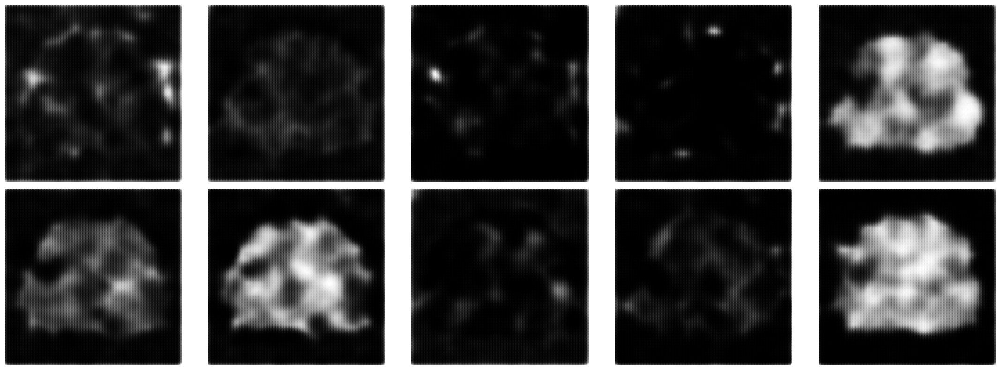

  0%|                                                                                                                        | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step


  0%|                                                                                                                | 1/3750 [00:00<07:17,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 2/3750 [00:00<06:56,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 3/3750 [00:00<06:46,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 4/3750 [00:00<06:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 5/3750 [00:00<06:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 6/3750 [00:00<06:37,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 7/3750 [00:00<06:36,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


  0%|▏                                                                                                               | 8/3750 [00:00<06:38,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                               | 9/3750 [00:00<06:37,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                              | 10/3750 [00:01<06:36,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                              | 11/3750 [00:01<06:38,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                              | 12/3750 [00:01<06:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 13/3750 [00:01<06:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 14/3750 [00:01<06:37,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 15/3750 [00:01<06:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 16/3750 [00:01<06:39,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▌                                                                                                              | 17/3750 [00:01<06:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▌                                                                                                              | 18/3750 [00:01<06:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 19/3750 [00:02<06:36,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                                                                                              | 20/3750 [00:02<06:35,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 21/3750 [00:02<06:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▋                                                                                                              | 22/3750 [00:02<06:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 23/3750 [00:02<06:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 24/3750 [00:02<06:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 25/3750 [00:02<06:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 26/3750 [00:02<06:36,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 27/3750 [00:02<06:35,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 28/3750 [00:02<06:34,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 29/3750 [00:03<06:33,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 30/3750 [00:03<06:35,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 31/3750 [00:03<06:35,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 32/3750 [00:03<06:35,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 33/3750 [00:03<06:53,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 34/3750 [00:03<06:48,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 35/3750 [00:03<06:47,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 36/3750 [00:03<06:49,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 37/3750 [00:03<06:44,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 38/3750 [00:04<06:40,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 39/3750 [00:04<06:41,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 40/3750 [00:04<06:38,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 41/3750 [00:04<06:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 42/3750 [00:04<06:35,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 43/3750 [00:04<06:34,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 44/3750 [00:04<06:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 45/3750 [00:04<06:32,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 46/3750 [00:04<06:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 47/3750 [00:05<06:31,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 48/3750 [00:05<06:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 49/3750 [00:05<06:32,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 50/3750 [00:05<06:32,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 51/3750 [00:05<06:31,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 52/3750 [00:05<06:30,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 53/3750 [00:05<06:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 54/3750 [00:05<06:30,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▋                                                                                                             | 55/3750 [00:05<06:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▋                                                                                                             | 56/3750 [00:05<06:30,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▋                                                                                                             | 57/3750 [00:06<06:32,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▋                                                                                                             | 58/3750 [00:06<06:32,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▋                                                                                                             | 59/3750 [00:06<06:31,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▊                                                                                                             | 60/3750 [00:06<06:31,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▊                                                                                                             | 61/3750 [00:06<06:32,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▊                                                                                                             | 62/3750 [00:06<06:31,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▊                                                                                                             | 63/3750 [00:06<06:31,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 64/3750 [00:06<06:31,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 65/3750 [00:06<06:31,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▉                                                                                                             | 66/3750 [00:07<06:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 67/3750 [00:07<06:32,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 68/3750 [00:07<06:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 69/3750 [00:07<06:30,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 70/3750 [00:07<06:31,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


  2%|██                                                                                                             | 71/3750 [00:07<06:31,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 72/3750 [00:07<06:31,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 73/3750 [00:07<06:30,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


  2%|██▏                                                                                                            | 74/3750 [00:07<06:30,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 75/3750 [00:08<06:31,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▏                                                                                                            | 76/3750 [00:08<06:32,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 77/3750 [00:08<06:31,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 78/3750 [00:08<06:29,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▎                                                                                                            | 79/3750 [00:08<06:29,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▎                                                                                                            | 80/3750 [00:08<06:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 81/3750 [00:08<06:27,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 82/3750 [00:08<06:27,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 83/3750 [00:08<06:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▍                                                                                                            | 84/3750 [00:08<06:26,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 85/3750 [00:09<06:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 86/3750 [00:09<06:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 87/3750 [00:09<06:27,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 88/3750 [00:09<06:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 89/3750 [00:09<06:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 90/3750 [00:09<06:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 91/3750 [00:09<06:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 92/3750 [00:09<06:28,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▊                                                                                                            | 93/3750 [00:09<06:27,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 94/3750 [00:10<06:29,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 95/3750 [00:10<06:29,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


  3%|██▊                                                                                                            | 96/3750 [00:10<06:32,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 97/3750 [00:10<06:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                            | 98/3750 [00:10<06:29,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                            | 99/3750 [00:10<06:29,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                           | 100/3750 [00:10<06:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                           | 101/3750 [00:10<06:29,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


  3%|██▉                                                                                                           | 102/3750 [00:10<06:38,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 103/3750 [00:10<06:38,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███                                                                                                           | 104/3750 [00:11<06:36,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 105/3750 [00:11<06:33,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


  3%|███                                                                                                           | 106/3750 [00:11<06:32,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 107/3750 [00:11<06:31,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 108/3750 [00:11<06:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 109/3750 [00:11<06:27,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 110/3750 [00:11<06:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 111/3750 [00:11<06:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 112/3750 [00:11<06:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 113/3750 [00:12<06:27,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 114/3750 [00:12<06:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 115/3750 [00:12<06:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▍                                                                                                          | 116/3750 [00:12<06:24,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 117/3750 [00:12<06:25,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 118/3750 [00:12<06:25,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 119/3750 [00:12<06:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 120/3750 [00:12<06:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 121/3750 [00:12<06:24,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 122/3750 [00:13<06:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 123/3750 [00:13<06:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▋                                                                                                          | 124/3750 [00:13<06:25,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 125/3750 [00:13<06:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 126/3750 [00:13<06:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 127/3750 [00:13<06:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 128/3750 [00:13<06:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 129/3750 [00:13<06:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▊                                                                                                          | 130/3750 [00:13<06:23,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▊                                                                                                          | 131/3750 [00:13<06:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▊                                                                                                          | 132/3750 [00:14<06:29,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 133/3750 [00:14<06:27,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 134/3750 [00:14<06:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 135/3750 [00:14<06:24,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 136/3750 [00:14<06:23,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 137/3750 [00:14<06:22,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 138/3750 [00:14<06:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 139/3750 [00:14<06:21,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████                                                                                                          | 140/3750 [00:14<06:22,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▏                                                                                                         | 141/3750 [00:15<06:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▏                                                                                                         | 142/3750 [00:15<06:22,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▏                                                                                                         | 143/3750 [00:15<06:22,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▏                                                                                                         | 144/3750 [00:15<06:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 145/3750 [00:15<06:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 146/3750 [00:15<06:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▎                                                                                                         | 147/3750 [00:15<06:21,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 148/3750 [00:15<06:21,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 149/3750 [00:15<06:21,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▍                                                                                                         | 150/3750 [00:15<06:23,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▍                                                                                                         | 151/3750 [00:16<06:24,  9.37it/s]

1/1 [==============================] - 0s 11ms/step


  4%|████▍                                                                                                         | 152/3750 [00:16<06:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▍                                                                                                         | 153/3750 [00:16<06:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 154/3750 [00:16<06:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 155/3750 [00:16<06:22,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 156/3750 [00:16<06:21,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 157/3750 [00:16<06:21,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 158/3750 [00:16<06:25,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▋                                                                                                         | 159/3750 [00:16<06:23,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▋                                                                                                         | 160/3750 [00:17<06:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 161/3750 [00:17<06:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 162/3750 [00:17<06:21,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 163/3750 [00:17<06:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 164/3750 [00:17<06:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 165/3750 [00:17<06:19,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 166/3750 [00:17<06:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▉                                                                                                         | 167/3750 [00:17<06:19,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▉                                                                                                         | 168/3750 [00:17<06:18,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  5%|████▉                                                                                                         | 169/3750 [00:18<06:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  5%|████▉                                                                                                         | 170/3750 [00:18<06:27,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 171/3750 [00:18<06:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 172/3750 [00:18<06:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 173/3750 [00:18<06:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 174/3750 [00:18<06:20,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▏                                                                                                        | 175/3750 [00:18<06:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▏                                                                                                        | 176/3750 [00:18<06:18,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 177/3750 [00:18<06:18,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 178/3750 [00:18<06:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 179/3750 [00:19<06:20,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 180/3750 [00:19<06:18,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 181/3750 [00:19<06:17,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 182/3750 [00:19<06:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 183/3750 [00:19<06:18,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 184/3750 [00:19<06:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 185/3750 [00:19<06:18,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 186/3750 [00:19<06:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 187/3750 [00:19<06:20,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▌                                                                                                        | 188/3750 [00:20<06:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▌                                                                                                        | 189/3750 [00:20<06:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▌                                                                                                        | 190/3750 [00:20<06:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 191/3750 [00:20<06:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 192/3750 [00:20<06:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 193/3750 [00:20<06:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▋                                                                                                        | 194/3750 [00:20<06:15,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 195/3750 [00:20<06:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▋                                                                                                        | 196/3750 [00:20<06:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 197/3750 [00:20<06:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 198/3750 [00:21<06:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 199/3750 [00:21<06:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 200/3750 [00:21<06:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 201/3750 [00:21<06:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 202/3750 [00:21<06:14,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 203/3750 [00:21<06:14,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 204/3750 [00:21<06:13,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██████                                                                                                        | 205/3750 [00:21<06:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██████                                                                                                        | 206/3750 [00:21<06:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████                                                                                                        | 207/3750 [00:22<06:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████                                                                                                        | 208/3750 [00:22<06:15,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 209/3750 [00:22<06:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 210/3750 [00:22<06:14,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 211/3750 [00:22<06:13,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 212/3750 [00:22<06:12,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 213/3750 [00:22<06:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 214/3750 [00:22<06:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 215/3750 [00:22<06:15,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▎                                                                                                       | 216/3750 [00:22<06:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▎                                                                                                       | 217/3750 [00:23<06:15,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 218/3750 [00:23<06:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 219/3750 [00:23<06:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 220/3750 [00:23<06:13,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 221/3750 [00:23<06:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 222/3750 [00:23<06:12,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 223/3750 [00:23<06:12,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 224/3750 [00:23<06:14,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 225/3750 [00:23<06:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 226/3750 [00:24<06:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 227/3750 [00:24<06:16,  9.35it/s]

1/1 [==============================] - 0s 11ms/step


  6%|██████▋                                                                                                       | 228/3750 [00:24<06:17,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 229/3750 [00:24<06:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▋                                                                                                       | 230/3750 [00:24<06:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▊                                                                                                       | 231/3750 [00:24<06:11,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 232/3750 [00:24<06:10,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 233/3750 [00:24<06:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 234/3750 [00:24<06:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 235/3750 [00:25<06:13,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 236/3750 [00:25<06:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 237/3750 [00:25<06:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 238/3750 [00:25<06:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████                                                                                                       | 239/3750 [00:25<06:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████                                                                                                       | 240/3750 [00:25<06:10,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████                                                                                                       | 241/3750 [00:25<06:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 242/3750 [00:25<06:12,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████▏                                                                                                      | 243/3750 [00:25<06:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▏                                                                                                      | 244/3750 [00:25<06:12,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▏                                                                                                      | 245/3750 [00:26<06:11,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 246/3750 [00:26<06:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▏                                                                                                      | 247/3750 [00:26<06:10,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 248/3750 [00:26<06:09,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 249/3750 [00:26<06:08,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 250/3750 [00:26<06:14,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 251/3750 [00:26<06:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 252/3750 [00:26<06:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 253/3750 [00:26<06:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▍                                                                                                      | 254/3750 [00:27<06:12,  9.40it/s]

1/1 [==============================] - 0s 16ms/step


  7%|███████▍                                                                                                      | 255/3750 [00:27<06:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 256/3750 [00:27<06:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 257/3750 [00:27<06:13,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▌                                                                                                      | 258/3750 [00:27<06:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 259/3750 [00:27<06:11,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 260/3750 [00:27<06:11,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 261/3750 [00:27<06:25,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 262/3750 [00:27<06:23,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 263/3750 [00:27<06:19,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 264/3750 [00:28<06:15,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▊                                                                                                      | 265/3750 [00:28<06:12,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▊                                                                                                      | 266/3750 [00:28<06:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 267/3750 [00:28<06:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 268/3750 [00:28<06:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▉                                                                                                      | 269/3750 [00:28<06:06,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▉                                                                                                      | 270/3750 [00:28<06:08,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▉                                                                                                      | 271/3750 [00:28<06:08,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


  7%|███████▉                                                                                                      | 272/3750 [00:28<06:10,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 273/3750 [00:29<06:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 274/3750 [00:29<06:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 275/3750 [00:29<06:09,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 276/3750 [00:29<06:08,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████▏                                                                                                     | 277/3750 [00:29<06:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████▏                                                                                                     | 278/3750 [00:29<06:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 279/3750 [00:29<06:07,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 280/3750 [00:29<06:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 281/3750 [00:29<06:06,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 282/3750 [00:30<06:05,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 283/3750 [00:30<06:05,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 284/3750 [00:30<06:04,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 285/3750 [00:30<06:04,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 286/3750 [00:30<06:04,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▍                                                                                                     | 287/3750 [00:30<06:04,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 288/3750 [00:30<06:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 289/3750 [00:30<06:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 290/3750 [00:30<06:06,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 291/3750 [00:30<06:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 292/3750 [00:31<06:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 293/3750 [00:31<06:05,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 294/3750 [00:31<06:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 295/3750 [00:31<06:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 296/3750 [00:31<06:04,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 297/3750 [00:31<06:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 298/3750 [00:31<06:05,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▊                                                                                                     | 299/3750 [00:31<06:04,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 300/3750 [00:31<06:04,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 301/3750 [00:32<06:04,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


  8%|████████▊                                                                                                     | 302/3750 [00:32<06:05,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 303/3750 [00:32<06:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 304/3750 [00:32<06:05,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 305/3750 [00:32<06:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 306/3750 [00:32<06:05,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████                                                                                                     | 307/3750 [00:32<06:04,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 308/3750 [00:32<06:02,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 309/3750 [00:32<06:03,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 310/3750 [00:32<06:04,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 311/3750 [00:33<06:04,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 312/3750 [00:33<06:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 313/3750 [00:33<06:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 314/3750 [00:33<06:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 315/3750 [00:33<06:07,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▎                                                                                                    | 316/3750 [00:33<06:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▎                                                                                                    | 317/3750 [00:33<06:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▎                                                                                                    | 318/3750 [00:33<06:05,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▎                                                                                                    | 319/3750 [00:33<06:04,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 320/3750 [00:34<06:04,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 321/3750 [00:34<06:03,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 322/3750 [00:34<06:02,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 323/3750 [00:34<06:01,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 324/3750 [00:34<06:00,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 325/3750 [00:34<06:03,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 326/3750 [00:34<06:01,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 327/3750 [00:34<06:00,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 328/3750 [00:34<06:00,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 329/3750 [00:34<06:01,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 330/3750 [00:35<06:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 331/3750 [00:35<06:00,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 332/3750 [00:35<05:59,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▊                                                                                                    | 333/3750 [00:35<05:59,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 334/3750 [00:35<06:01,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 335/3750 [00:35<06:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 336/3750 [00:35<06:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 337/3750 [00:35<06:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 338/3750 [00:35<06:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 339/3750 [00:36<06:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 340/3750 [00:36<06:00,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 341/3750 [00:36<05:59,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 342/3750 [00:36<05:59,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 343/3750 [00:36<06:00,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 344/3750 [00:36<06:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 345/3750 [00:36<05:59,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▏                                                                                                   | 346/3750 [00:36<05:58,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 347/3750 [00:36<05:58,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 348/3750 [00:36<05:59,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 349/3750 [00:37<05:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 350/3750 [00:37<06:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▎                                                                                                   | 351/3750 [00:37<06:01,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 352/3750 [00:37<06:00,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 353/3750 [00:37<06:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▍                                                                                                   | 354/3750 [00:37<06:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▍                                                                                                   | 355/3750 [00:37<06:00,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▍                                                                                                   | 356/3750 [00:37<05:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▍                                                                                                   | 357/3750 [00:37<05:59,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▌                                                                                                   | 358/3750 [00:38<05:57,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 359/3750 [00:38<05:56,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▌                                                                                                   | 360/3750 [00:38<05:56,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▌                                                                                                   | 361/3750 [00:38<05:56,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 362/3750 [00:38<05:58,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▋                                                                                                   | 363/3750 [00:38<05:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▋                                                                                                   | 364/3750 [00:38<05:56,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 365/3750 [00:38<05:56,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▋                                                                                                   | 366/3750 [00:38<05:56,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▊                                                                                                   | 367/3750 [00:39<05:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 368/3750 [00:39<05:56,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▊                                                                                                   | 369/3750 [00:39<05:56,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▊                                                                                                   | 370/3750 [00:39<05:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▉                                                                                                   | 371/3750 [00:39<05:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 372/3750 [00:39<05:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 373/3750 [00:39<05:57,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 374/3750 [00:39<05:57,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 375/3750 [00:39<05:58,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███████████                                                                                                   | 376/3750 [00:39<06:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 377/3750 [00:40<05:58,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 378/3750 [00:40<05:57,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 379/3750 [00:40<05:56,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 380/3750 [00:40<05:57,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 381/3750 [00:40<05:56,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 382/3750 [00:40<05:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 383/3750 [00:40<05:55,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▎                                                                                                  | 384/3750 [00:40<05:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 385/3750 [00:40<05:55,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▎                                                                                                  | 386/3750 [00:41<05:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 387/3750 [00:41<05:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 388/3750 [00:41<05:53,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 389/3750 [00:41<05:57,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 390/3750 [00:41<05:56,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 391/3750 [00:41<05:55,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 392/3750 [00:41<05:55,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▌                                                                                                  | 393/3750 [00:41<05:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▌                                                                                                  | 394/3750 [00:41<05:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▌                                                                                                  | 395/3750 [00:41<05:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▌                                                                                                  | 396/3750 [00:42<05:53,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 11%|███████████▋                                                                                                  | 397/3750 [00:42<05:54,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 398/3750 [00:42<05:56,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 399/3750 [00:42<05:56,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▋                                                                                                  | 400/3750 [00:42<05:55,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 401/3750 [00:42<05:55,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 402/3750 [00:42<05:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 403/3750 [00:42<05:52,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 404/3750 [00:42<05:52,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 405/3750 [00:43<05:54,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 406/3750 [00:43<05:58,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 407/3750 [00:43<05:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 408/3750 [00:43<05:57,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 409/3750 [00:43<05:56,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 410/3750 [00:43<05:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 411/3750 [00:43<05:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 412/3750 [00:43<05:52,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 413/3750 [00:43<05:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 414/3750 [00:43<05:51,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▏                                                                                                 | 415/3750 [00:44<05:51,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▏                                                                                                 | 416/3750 [00:44<05:51,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▏                                                                                                 | 417/3750 [00:44<05:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 418/3750 [00:44<05:53,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 419/3750 [00:44<05:52,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 420/3750 [00:44<05:52,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 421/3750 [00:44<05:51,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 422/3750 [00:44<05:50,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 423/3750 [00:44<05:51,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 424/3750 [00:45<05:51,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 425/3750 [00:45<05:51,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 426/3750 [00:45<05:52,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▌                                                                                                 | 427/3750 [00:45<05:52,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 428/3750 [00:45<05:51,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▌                                                                                                 | 429/3750 [00:45<05:50,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 430/3750 [00:45<05:50,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▋                                                                                                 | 431/3750 [00:45<05:51,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▋                                                                                                 | 432/3750 [00:45<05:54,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▋                                                                                                 | 433/3750 [00:45<05:52,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 12%|████████████▋                                                                                                 | 434/3750 [00:46<05:52,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 435/3750 [00:46<05:53,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▊                                                                                                 | 436/3750 [00:46<05:52,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 437/3750 [00:46<05:51,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 438/3750 [00:46<05:50,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 439/3750 [00:46<05:49,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 440/3750 [00:46<05:48,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 441/3750 [00:46<05:48,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 442/3750 [00:46<05:48,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 443/3750 [00:47<05:48,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 444/3750 [00:47<05:50,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 445/3750 [00:47<05:50,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 446/3750 [00:47<05:51,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 12%|█████████████                                                                                                 | 447/3750 [00:47<05:53,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 448/3750 [00:47<05:54,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 449/3750 [00:47<05:51,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 12%|█████████████▏                                                                                                | 450/3750 [00:47<05:50,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 12%|█████████████▏                                                                                                | 451/3750 [00:47<05:50,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 12%|█████████████▎                                                                                                | 452/3750 [00:48<05:51,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 453/3750 [00:48<05:51,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 454/3750 [00:48<05:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 455/3750 [00:48<05:54,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 456/3750 [00:48<05:52,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 457/3750 [00:48<05:50,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▍                                                                                                | 458/3750 [00:48<05:49,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 459/3750 [00:48<05:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 460/3750 [00:48<05:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 461/3750 [00:48<05:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 462/3750 [00:49<05:47,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 463/3750 [00:49<05:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 464/3750 [00:49<05:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 465/3750 [00:49<05:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 466/3750 [00:49<05:48,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 467/3750 [00:49<05:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 468/3750 [00:49<05:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 469/3750 [00:49<05:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 470/3750 [00:49<05:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 471/3750 [00:50<05:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 472/3750 [00:50<05:48,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 473/3750 [00:50<05:47,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 474/3750 [00:50<05:46,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▉                                                                                                | 475/3750 [00:50<05:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▉                                                                                                | 476/3750 [00:50<05:45,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 477/3750 [00:50<05:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████                                                                                                | 478/3750 [00:50<05:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████                                                                                                | 479/3750 [00:50<05:44,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████                                                                                                | 480/3750 [00:50<05:43,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 481/3750 [00:51<05:45,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 482/3750 [00:51<05:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 483/3750 [00:51<05:45,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 484/3750 [00:51<05:46,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 485/3750 [00:51<05:45,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 486/3750 [00:51<05:43,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 487/3750 [00:51<05:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 488/3750 [00:51<05:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 489/3750 [00:51<05:43,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 490/3750 [00:52<05:44,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 491/3750 [00:52<05:43,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 492/3750 [00:52<05:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 493/3750 [00:52<05:42,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 494/3750 [00:52<05:42,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 495/3750 [00:52<05:42,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 496/3750 [00:52<05:42,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 497/3750 [00:52<05:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 498/3750 [00:52<05:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 499/3750 [00:52<05:43,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 13%|██████████████▋                                                                                               | 500/3750 [00:53<05:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▋                                                                                               | 501/3750 [00:53<05:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 502/3750 [00:53<05:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▊                                                                                               | 503/3750 [00:53<05:42,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 504/3750 [00:53<05:47,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▊                                                                                               | 505/3750 [00:53<05:45,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▊                                                                                               | 506/3750 [00:53<05:43,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▊                                                                                               | 507/3750 [00:53<05:46,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 14%|██████████████▉                                                                                               | 508/3750 [00:53<05:46,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 509/3750 [00:54<05:48,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 510/3750 [00:54<05:47,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 511/3750 [00:54<05:45,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████                                                                                               | 512/3750 [00:54<05:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████                                                                                               | 513/3750 [00:54<05:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████                                                                                               | 514/3750 [00:54<05:41,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 515/3750 [00:54<05:40,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▏                                                                                              | 516/3750 [00:54<05:40,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▏                                                                                              | 517/3750 [00:54<05:39,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 518/3750 [00:54<05:41,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▏                                                                                              | 519/3750 [00:55<05:41,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 520/3750 [00:55<05:41,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 521/3750 [00:55<05:40,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 522/3750 [00:55<05:40,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 523/3750 [00:55<05:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 524/3750 [00:55<05:39,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 525/3750 [00:55<05:39,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 526/3750 [00:55<05:38,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 527/3750 [00:55<05:40,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 528/3750 [00:56<05:39,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▌                                                                                              | 529/3750 [00:56<05:39,  9.49it/s]

1/1 [==============================] - 0s 11ms/step


 14%|███████████████▌                                                                                              | 530/3750 [00:56<05:41,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▌                                                                                              | 531/3750 [00:56<05:42,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 532/3750 [00:56<05:40,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▋                                                                                              | 533/3750 [00:56<05:39,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▋                                                                                              | 534/3750 [00:56<05:39,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 535/3750 [00:56<05:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 536/3750 [00:56<05:46,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 537/3750 [00:57<05:46,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 538/3750 [00:57<05:46,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 539/3750 [00:57<05:45,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 540/3750 [00:57<05:42,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 541/3750 [00:57<05:41,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▉                                                                                              | 542/3750 [00:57<05:41,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▉                                                                                              | 543/3750 [00:57<05:40,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 15%|███████████████▉                                                                                              | 544/3750 [00:57<05:39,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 15%|███████████████▉                                                                                              | 545/3750 [00:57<05:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 546/3750 [00:57<05:39,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 547/3750 [00:58<05:37,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 548/3750 [00:58<05:37,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 549/3750 [00:58<05:38,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 550/3750 [00:58<05:37,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 551/3750 [00:58<05:37,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 552/3750 [00:58<05:37,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 553/3750 [00:58<05:37,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 554/3750 [00:58<05:37,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 555/3750 [00:58<05:39,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 556/3750 [00:59<05:39,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 557/3750 [00:59<05:38,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 558/3750 [00:59<05:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 559/3750 [00:59<05:37,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 560/3750 [00:59<05:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 561/3750 [00:59<05:40,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 562/3750 [00:59<05:39,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 563/3750 [00:59<05:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 564/3750 [00:59<05:38,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 565/3750 [00:59<05:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 566/3750 [01:00<05:38,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 567/3750 [01:00<05:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 568/3750 [01:00<05:38,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 569/3750 [01:00<05:37,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 570/3750 [01:00<05:37,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 571/3750 [01:00<05:36,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 572/3750 [01:00<05:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 573/3750 [01:00<05:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▊                                                                                             | 574/3750 [01:00<05:36,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 575/3750 [01:01<05:37,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 576/3750 [01:01<05:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 577/3750 [01:01<05:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▉                                                                                             | 578/3750 [01:01<05:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 579/3750 [01:01<05:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████████████████                                                                                             | 580/3750 [01:01<05:35,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████████████████                                                                                             | 581/3750 [01:01<05:35,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████                                                                                             | 582/3750 [01:01<05:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████                                                                                             | 583/3750 [01:01<05:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 584/3750 [01:01<05:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 585/3750 [01:02<05:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 586/3750 [01:02<05:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 587/3750 [01:02<05:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 588/3750 [01:02<05:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▎                                                                                            | 589/3750 [01:02<05:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 590/3750 [01:02<05:34,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▎                                                                                            | 591/3750 [01:02<05:33,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▎                                                                                            | 592/3750 [01:02<05:35,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▍                                                                                            | 593/3750 [01:02<05:35,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▍                                                                                            | 594/3750 [01:03<05:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 595/3750 [01:03<05:35,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▍                                                                                            | 596/3750 [01:03<05:39,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 597/3750 [01:03<05:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▌                                                                                            | 598/3750 [01:03<05:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▌                                                                                            | 599/3750 [01:03<05:34,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 600/3750 [01:03<05:33,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 601/3750 [01:03<05:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 602/3750 [01:03<05:35,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 603/3750 [01:04<05:34,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 604/3750 [01:04<05:33,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 16%|█████████████████▋                                                                                            | 605/3750 [01:04<05:33,  9.42it/s]

1/1 [==============================] - 0s 11ms/step


 16%|█████████████████▊                                                                                            | 606/3750 [01:04<05:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 607/3750 [01:04<05:36,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 608/3750 [01:04<05:34,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 609/3750 [01:04<05:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 610/3750 [01:04<05:32,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 611/3750 [01:04<05:34,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 612/3750 [01:04<05:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 613/3750 [01:05<05:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 614/3750 [01:05<05:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 615/3750 [01:05<05:33,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 616/3750 [01:05<05:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 617/3750 [01:05<05:31,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████▏                                                                                           | 618/3750 [01:05<05:31,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 619/3750 [01:05<05:30,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 620/3750 [01:05<05:33,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 621/3750 [01:05<05:32,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 622/3750 [01:06<05:32,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 623/3750 [01:06<05:31,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 624/3750 [01:06<05:30,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 625/3750 [01:06<05:30,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 626/3750 [01:06<05:30,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 627/3750 [01:06<05:29,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 628/3750 [01:06<05:29,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 629/3750 [01:06<05:31,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 630/3750 [01:06<05:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 631/3750 [01:06<05:30,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 632/3750 [01:07<05:29,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 633/3750 [01:07<05:41,  9.13it/s]

1/1 [==============================] - 0s 20ms/step


 17%|██████████████████▌                                                                                           | 634/3750 [01:07<05:57,  8.72it/s]

1/1 [==============================] - 0s 15ms/step


 17%|██████████████████▋                                                                                           | 635/3750 [01:07<06:01,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████████████████▋                                                                                           | 636/3750 [01:07<05:53,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 637/3750 [01:07<05:49,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 638/3750 [01:07<05:43,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 639/3750 [01:07<05:44,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████████████████▊                                                                                           | 640/3750 [01:07<05:41,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 641/3750 [01:08<05:39,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▊                                                                                           | 642/3750 [01:08<05:38,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 643/3750 [01:08<05:38,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▉                                                                                           | 644/3750 [01:08<05:38,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▉                                                                                           | 645/3750 [01:08<05:38,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 646/3750 [01:08<05:36,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▉                                                                                           | 647/3750 [01:08<05:34,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 648/3750 [01:08<05:34,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 17%|███████████████████                                                                                           | 649/3750 [01:09<08:28,  6.10it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 650/3750 [01:09<07:41,  6.72it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████                                                                                           | 651/3750 [01:09<07:02,  7.34it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 652/3750 [01:09<06:33,  7.86it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 653/3750 [01:09<06:13,  8.30it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 654/3750 [01:09<05:58,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 655/3750 [01:09<05:49,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 656/3750 [01:09<05:41,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 657/3750 [01:10<05:40,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 658/3750 [01:10<05:37,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 659/3750 [01:10<05:35,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 660/3750 [01:10<05:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 661/3750 [01:10<05:31,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 662/3750 [01:10<05:31,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 663/3750 [01:10<05:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 664/3750 [01:10<05:29,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 665/3750 [01:10<05:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 666/3750 [01:10<05:30,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▌                                                                                          | 667/3750 [01:11<05:32,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▌                                                                                          | 668/3750 [01:11<05:31,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▌                                                                                          | 669/3750 [01:11<05:32,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 670/3750 [01:11<05:31,  9.28it/s]

1/1 [==============================] - 0s 11ms/step


 18%|███████████████████▋                                                                                          | 671/3750 [01:11<05:35,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 672/3750 [01:11<05:33,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 673/3750 [01:11<05:31,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 674/3750 [01:11<05:30,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 675/3750 [01:11<05:32,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 676/3750 [01:12<05:31,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 677/3750 [01:12<05:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 678/3750 [01:12<05:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 679/3750 [01:12<05:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 680/3750 [01:12<05:27,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 681/3750 [01:12<05:27,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 682/3750 [01:12<05:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 683/3750 [01:12<05:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 684/3750 [01:12<05:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 685/3750 [01:13<05:28,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 686/3750 [01:13<05:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 687/3750 [01:13<05:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 688/3750 [01:13<05:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 689/3750 [01:13<05:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 690/3750 [01:13<05:25,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 691/3750 [01:13<05:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 692/3750 [01:13<05:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 693/3750 [01:13<05:26,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▎                                                                                         | 694/3750 [01:13<05:26,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 695/3750 [01:14<05:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 696/3750 [01:14<05:25,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▍                                                                                         | 697/3750 [01:14<05:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 698/3750 [01:14<05:23,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 699/3750 [01:14<05:22,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 700/3750 [01:14<05:22,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▌                                                                                         | 701/3750 [01:14<05:22,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 702/3750 [01:14<05:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 703/3750 [01:14<05:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 704/3750 [01:15<05:28,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 705/3750 [01:15<05:27,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 706/3750 [01:15<05:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 707/3750 [01:15<05:25,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▊                                                                                         | 708/3750 [01:15<05:24,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 709/3750 [01:15<05:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▊                                                                                         | 710/3750 [01:15<05:22,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 711/3750 [01:15<05:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▉                                                                                         | 712/3750 [01:15<05:24,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▉                                                                                         | 713/3750 [01:16<05:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▉                                                                                         | 714/3750 [01:16<05:23,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▉                                                                                         | 715/3750 [01:16<05:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 716/3750 [01:16<05:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 717/3750 [01:16<05:22,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 19%|█████████████████████                                                                                         | 718/3750 [01:16<05:24,  9.36it/s]

1/1 [==============================] - 0s 11ms/step


 19%|█████████████████████                                                                                         | 719/3750 [01:16<05:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 720/3750 [01:16<05:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 721/3750 [01:16<05:27,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 722/3750 [01:16<05:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 723/3750 [01:17<05:23,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▏                                                                                        | 724/3750 [01:17<05:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 725/3750 [01:17<05:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 726/3750 [01:17<05:20,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 727/3750 [01:17<05:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 728/3750 [01:17<05:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▍                                                                                        | 729/3750 [01:17<05:18,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▍                                                                                        | 730/3750 [01:17<05:21,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▍                                                                                        | 731/3750 [01:17<05:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▍                                                                                        | 732/3750 [01:18<05:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 733/3750 [01:18<05:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▌                                                                                        | 734/3750 [01:18<05:18,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 735/3750 [01:18<05:18,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 736/3750 [01:18<05:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▌                                                                                        | 737/3750 [01:18<05:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 738/3750 [01:18<05:17,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▋                                                                                        | 739/3750 [01:18<05:18,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▋                                                                                        | 740/3750 [01:18<05:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 741/3750 [01:18<05:18,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 742/3750 [01:19<05:17,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 743/3750 [01:19<05:17,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 744/3750 [01:19<05:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 745/3750 [01:19<05:16,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 746/3750 [01:19<05:17,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 747/3750 [01:19<05:21,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 748/3750 [01:19<05:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 749/3750 [01:19<05:21,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 750/3750 [01:19<05:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 751/3750 [01:20<05:20,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 752/3750 [01:20<05:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 753/3750 [01:20<05:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 754/3750 [01:20<05:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 755/3750 [01:20<05:17,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 756/3750 [01:20<05:16,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 757/3750 [01:20<05:18,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 758/3750 [01:20<05:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▎                                                                                       | 759/3750 [01:20<05:17,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▎                                                                                       | 760/3750 [01:20<05:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▎                                                                                       | 761/3750 [01:21<05:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▎                                                                                       | 762/3750 [01:21<05:16,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 763/3750 [01:21<05:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 764/3750 [01:21<05:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 765/3750 [01:21<05:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 766/3750 [01:21<05:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 767/3750 [01:21<05:18,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▌                                                                                       | 768/3750 [01:21<05:17,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▌                                                                                       | 769/3750 [01:21<05:16,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▌                                                                                       | 770/3750 [01:22<05:15,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▌                                                                                       | 771/3750 [01:22<05:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 772/3750 [01:22<05:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 773/3750 [01:22<05:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 774/3750 [01:22<05:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 775/3750 [01:22<05:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 776/3750 [01:22<05:17,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 777/3750 [01:22<05:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 778/3750 [01:22<05:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 779/3750 [01:23<05:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 780/3750 [01:23<05:14,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 21%|██████████████████████▉                                                                                       | 781/3750 [01:23<05:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 782/3750 [01:23<05:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 783/3750 [01:23<05:15,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 784/3750 [01:23<05:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 785/3750 [01:23<05:15,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 786/3750 [01:23<05:14,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 787/3750 [01:23<05:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 788/3750 [01:23<05:14,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 789/3750 [01:24<05:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 790/3750 [01:24<05:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 791/3750 [01:24<05:14,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 21%|███████████████████████▏                                                                                      | 792/3750 [01:24<05:15,  9.38it/s]

1/1 [==============================] - 0s 11ms/step


 21%|███████████████████████▎                                                                                      | 793/3750 [01:24<05:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 794/3750 [01:24<05:18,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▎                                                                                      | 795/3750 [01:24<05:18,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 796/3750 [01:24<05:16,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 797/3750 [01:24<05:15,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 798/3750 [01:25<05:14,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 799/3750 [01:25<05:13,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 800/3750 [01:25<05:13,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 801/3750 [01:25<05:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▌                                                                                      | 802/3750 [01:25<05:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 803/3750 [01:25<05:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▌                                                                                      | 804/3750 [01:25<05:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 805/3750 [01:25<05:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▋                                                                                      | 806/3750 [01:25<05:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▋                                                                                      | 807/3750 [01:25<05:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 808/3750 [01:26<05:15,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 809/3750 [01:26<05:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 810/3750 [01:26<05:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 811/3750 [01:26<05:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 812/3750 [01:26<05:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 813/3750 [01:26<05:17,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 814/3750 [01:26<05:16,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 815/3750 [01:26<05:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 816/3750 [01:26<05:13,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 817/3750 [01:27<05:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 818/3750 [01:27<05:12,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 819/3750 [01:27<05:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 820/3750 [01:27<05:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 821/3750 [01:27<05:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 822/3750 [01:27<05:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 823/3750 [01:27<05:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 824/3750 [01:27<05:11,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▏                                                                                     | 825/3750 [01:27<05:11,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▏                                                                                     | 826/3750 [01:28<05:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 827/3750 [01:28<05:11,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 828/3750 [01:28<05:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 829/3750 [01:28<05:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 830/3750 [01:28<05:14,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 831/3750 [01:28<05:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 832/3750 [01:28<05:13,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 833/3750 [01:28<05:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 834/3750 [01:28<05:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 835/3750 [01:28<05:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 836/3750 [01:29<05:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 837/3750 [01:29<05:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 838/3750 [01:29<05:08,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 839/3750 [01:29<05:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▋                                                                                     | 840/3750 [01:29<05:07,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 841/3750 [01:29<05:09,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 842/3750 [01:29<05:08,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 843/3750 [01:29<05:08,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 844/3750 [01:29<05:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 845/3750 [01:30<05:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 846/3750 [01:30<05:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 847/3750 [01:30<05:08,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 848/3750 [01:30<05:07,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 849/3750 [01:30<05:08,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 850/3750 [01:30<05:08,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▉                                                                                     | 851/3750 [01:30<05:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 852/3750 [01:30<05:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 853/3750 [01:30<05:08,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 854/3750 [01:31<05:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 855/3750 [01:31<05:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 856/3750 [01:31<05:09,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 857/3750 [01:31<05:09,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 858/3750 [01:31<05:08,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 859/3750 [01:31<05:07,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▏                                                                                    | 860/3750 [01:31<05:09,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 861/3750 [01:31<05:07,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 862/3750 [01:31<05:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 863/3750 [01:31<05:06,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 864/3750 [01:32<05:06,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 865/3750 [01:32<05:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 866/3750 [01:32<05:07,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 867/3750 [01:32<05:06,  9.40it/s]

1/1 [==============================] - 0s 11ms/step


 23%|█████████████████████████▍                                                                                    | 868/3750 [01:32<05:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 869/3750 [01:32<05:08,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▌                                                                                    | 870/3750 [01:32<05:10,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 871/3750 [01:32<05:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 872/3750 [01:32<05:06,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 873/3750 [01:33<05:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▋                                                                                    | 874/3750 [01:33<05:05,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▋                                                                                    | 875/3750 [01:33<05:04,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▋                                                                                    | 876/3750 [01:33<05:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 877/3750 [01:33<05:10,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 878/3750 [01:33<05:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 879/3750 [01:33<05:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 880/3750 [01:33<05:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 881/3750 [01:33<05:05,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▊                                                                                    | 882/3750 [01:33<05:03,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 883/3750 [01:34<05:04,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 884/3750 [01:34<05:04,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 885/3750 [01:34<05:04,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 886/3750 [01:34<05:04,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 887/3750 [01:34<05:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 888/3750 [01:34<05:04,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 889/3750 [01:34<05:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 890/3750 [01:34<05:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 891/3750 [01:34<05:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 892/3750 [01:35<05:07,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▏                                                                                   | 893/3750 [01:35<05:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 894/3750 [01:35<05:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 895/3750 [01:35<05:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 896/3750 [01:35<05:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 897/3750 [01:35<05:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 898/3750 [01:35<05:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 899/3750 [01:35<05:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 900/3750 [01:35<05:03,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 901/3750 [01:36<05:02,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 902/3750 [01:36<05:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 903/3750 [01:36<05:01,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 904/3750 [01:36<05:00,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 905/3750 [01:36<05:00,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 906/3750 [01:36<04:59,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 907/3750 [01:36<05:01,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 908/3750 [01:36<05:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 909/3750 [01:36<05:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▋                                                                                   | 910/3750 [01:36<05:00,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 911/3750 [01:37<05:00,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 912/3750 [01:37<04:59,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 913/3750 [01:37<05:00,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 914/3750 [01:37<05:04,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 915/3750 [01:37<05:02,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 916/3750 [01:37<05:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▉                                                                                   | 917/3750 [01:37<05:02,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▉                                                                                   | 918/3750 [01:37<05:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████████████████████▉                                                                                   | 919/3750 [01:37<05:02,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████████████████████▉                                                                                   | 920/3750 [01:38<05:01,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 921/3750 [01:38<05:01,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████                                                                                   | 922/3750 [01:38<05:00,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████                                                                                   | 923/3750 [01:38<04:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████                                                                                   | 924/3750 [01:38<04:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 925/3750 [01:38<05:00,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▏                                                                                  | 926/3750 [01:38<05:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 927/3750 [01:38<05:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 928/3750 [01:38<05:00,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 929/3750 [01:38<05:00,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 930/3750 [01:39<04:59,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 931/3750 [01:39<04:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 932/3750 [01:39<04:58,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 933/3750 [01:39<04:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▍                                                                                  | 934/3750 [01:39<04:56,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 935/3750 [01:39<04:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 936/3750 [01:39<04:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 937/3750 [01:39<04:58,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▌                                                                                  | 938/3750 [01:39<04:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 939/3750 [01:40<04:57,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 940/3750 [01:40<04:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 941/3750 [01:40<05:06,  9.17it/s]

1/1 [==============================] - 0s 13ms/step


 25%|███████████████████████████▋                                                                                  | 942/3750 [01:40<05:11,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 25%|███████████████████████████▋                                                                                  | 943/3750 [01:40<05:09,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▋                                                                                  | 944/3750 [01:40<05:08,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▋                                                                                  | 945/3750 [01:40<05:04,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 25%|███████████████████████████▋                                                                                  | 946/3750 [01:40<05:04,  9.20it/s]

1/1 [==============================] - 0s 11ms/step


 25%|███████████████████████████▊                                                                                  | 947/3750 [01:40<05:05,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▊                                                                                  | 948/3750 [01:41<05:02,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 949/3750 [01:41<05:00,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 950/3750 [01:41<04:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 951/3750 [01:41<05:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 952/3750 [01:41<04:59,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 953/3750 [01:41<05:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 954/3750 [01:41<04:59,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 25%|████████████████████████████                                                                                  | 955/3750 [01:41<04:58,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 25%|████████████████████████████                                                                                  | 956/3750 [01:41<04:57,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████                                                                                  | 957/3750 [01:41<04:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████                                                                                  | 958/3750 [01:42<04:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 959/3750 [01:42<04:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 960/3750 [01:42<04:57,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 961/3750 [01:42<04:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 962/3750 [01:42<04:56,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 963/3750 [01:42<04:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 964/3750 [01:42<04:57,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 965/3750 [01:42<04:57,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 966/3750 [01:42<04:56,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▎                                                                                 | 967/3750 [01:43<04:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▍                                                                                 | 968/3750 [01:43<04:55,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 969/3750 [01:43<04:55,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 970/3750 [01:43<04:54,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 971/3750 [01:43<04:54,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 972/3750 [01:43<04:57,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 973/3750 [01:43<04:57,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 974/3750 [01:43<05:00,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 975/3750 [01:43<04:57,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 976/3750 [01:44<04:56,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 977/3750 [01:44<04:55,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 978/3750 [01:44<04:54,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 979/3750 [01:44<04:53,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 980/3750 [01:44<04:53,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 981/3750 [01:44<04:55,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 982/3750 [01:44<04:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 983/3750 [01:44<04:53,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 984/3750 [01:44<04:53,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 985/3750 [01:44<04:52,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 986/3750 [01:45<04:52,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 987/3750 [01:45<04:52,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 988/3750 [01:45<04:52,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 989/3750 [01:45<04:52,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 990/3750 [01:45<04:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 991/3750 [01:45<04:52,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 992/3750 [01:45<04:51,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████▏                                                                                | 993/3750 [01:45<04:51,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 994/3750 [01:45<04:51,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 995/3750 [01:46<04:51,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 996/3750 [01:46<04:51,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 997/3750 [01:46<04:50,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                                | 998/3750 [01:46<04:51,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                                | 999/3750 [01:46<04:53,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████                                                                                | 1000/3750 [01:46<04:52,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████                                                                                | 1001/3750 [01:46<04:55,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████                                                                                | 1002/3750 [01:46<04:54,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1003/3750 [01:46<04:53,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1004/3750 [01:46<04:52,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                               | 1005/3750 [01:47<04:52,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1006/3750 [01:47<04:52,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                               | 1007/3750 [01:47<04:51,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1008/3750 [01:47<04:50,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                               | 1009/3750 [01:47<04:52,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1010/3750 [01:47<04:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1011/3750 [01:47<04:50,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1012/3750 [01:47<04:49,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1013/3750 [01:47<04:49,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1014/3750 [01:48<04:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1015/3750 [01:48<04:49,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1016/3750 [01:48<04:48,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1017/3750 [01:48<04:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1018/3750 [01:48<04:51,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1019/3750 [01:48<04:54,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 27%|█████████████████████████████▋                                                                               | 1020/3750 [01:48<04:54,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 27%|█████████████████████████████▋                                                                               | 1021/3750 [01:48<04:53,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1022/3750 [01:48<04:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1023/3750 [01:49<04:51,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1024/3750 [01:49<04:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1025/3750 [01:49<04:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1026/3750 [01:49<04:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1027/3750 [01:49<04:50,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1028/3750 [01:49<04:54,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1029/3750 [01:49<04:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1030/3750 [01:49<04:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1031/3750 [01:49<04:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 28%|█████████████████████████████▉                                                                               | 1032/3750 [01:49<04:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1033/3750 [01:50<04:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1034/3750 [01:50<04:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1035/3750 [01:50<04:48,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1036/3750 [01:50<04:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▏                                                                              | 1037/3750 [01:50<04:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1038/3750 [01:50<04:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1039/3750 [01:50<04:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1040/3750 [01:50<04:50,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1041/3750 [01:50<04:49,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1042/3750 [01:51<04:48,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1043/3750 [01:51<04:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1044/3750 [01:51<04:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1045/3750 [01:51<04:47,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1046/3750 [01:51<04:49,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1047/3750 [01:51<04:47,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▍                                                                              | 1048/3750 [01:51<04:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1049/3750 [01:51<04:46,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▌                                                                              | 1050/3750 [01:51<04:46,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▌                                                                              | 1051/3750 [01:51<04:45,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1052/3750 [01:52<04:45,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1053/3750 [01:52<04:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▋                                                                              | 1054/3750 [01:52<04:44,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1055/3750 [01:52<04:46,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1056/3750 [01:52<04:45,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1057/3750 [01:52<04:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1058/3750 [01:52<04:45,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1059/3750 [01:52<04:46,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1060/3750 [01:52<04:45,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1061/3750 [01:53<04:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1062/3750 [01:53<04:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1063/3750 [01:53<04:44,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1064/3750 [01:53<04:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1065/3750 [01:53<04:46,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1066/3750 [01:53<04:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████████████████████████                                                                              | 1067/3750 [01:53<04:46,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████████████████████████                                                                              | 1068/3750 [01:53<04:45,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████                                                                              | 1069/3750 [01:53<04:44,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████                                                                              | 1070/3750 [01:54<04:44,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1071/3750 [01:54<04:44,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1072/3750 [01:54<04:43,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1073/3750 [01:54<04:46,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1074/3750 [01:54<04:46,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1075/3750 [01:54<04:45,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1076/3750 [01:54<04:48,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1077/3750 [01:54<04:46,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1078/3750 [01:54<04:45,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1079/3750 [01:54<04:44,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1080/3750 [01:55<04:43,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1081/3750 [01:55<04:43,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1082/3750 [01:55<04:42,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1083/3750 [01:55<04:44,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1084/3750 [01:55<04:44,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1085/3750 [01:55<04:43,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1086/3750 [01:55<04:43,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1087/3750 [01:55<04:42,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▌                                                                             | 1088/3750 [01:55<04:50,  9.17it/s]

1/1 [==============================] - 0s 17ms/step


 29%|███████████████████████████████▋                                                                             | 1089/3750 [01:56<05:26,  8.15it/s]

1/1 [==============================] - 0s 12ms/step


 29%|███████████████████████████████▋                                                                             | 1090/3750 [01:56<05:23,  8.22it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▋                                                                             | 1091/3750 [01:56<05:19,  8.31it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▋                                                                             | 1092/3750 [01:56<05:25,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▊                                                                             | 1093/3750 [01:56<05:17,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▊                                                                             | 1094/3750 [01:56<05:23,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▊                                                                             | 1095/3750 [01:56<05:26,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▊                                                                             | 1096/3750 [01:56<05:39,  7.81it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▉                                                                             | 1097/3750 [01:57<05:24,  8.17it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▉                                                                             | 1098/3750 [01:57<05:14,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1099/3750 [01:57<05:18,  8.32it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1100/3750 [01:57<05:06,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1101/3750 [01:57<05:00,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1102/3750 [01:57<05:00,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1103/3750 [01:57<04:54,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 29%|████████████████████████████████                                                                             | 1104/3750 [01:57<04:49,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 29%|████████████████████████████████                                                                             | 1105/3750 [01:57<04:47,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 29%|████████████████████████████████▏                                                                            | 1106/3750 [01:58<05:03,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▏                                                                            | 1107/3750 [01:58<05:10,  8.52it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▏                                                                            | 1108/3750 [01:58<05:00,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▏                                                                            | 1109/3750 [01:58<04:53,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1110/3750 [01:58<04:50,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1111/3750 [01:58<04:49,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1112/3750 [01:58<04:46,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1113/3750 [01:58<04:44,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1114/3750 [01:58<04:42,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1115/3750 [01:59<04:40,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1116/3750 [01:59<04:39,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1117/3750 [01:59<04:39,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1118/3750 [01:59<04:39,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1119/3750 [01:59<04:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1120/3750 [01:59<04:39,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1121/3750 [01:59<04:39,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1122/3750 [01:59<04:38,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1123/3750 [01:59<04:38,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1124/3750 [02:00<04:37,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1125/3750 [02:00<04:37,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1126/3750 [02:00<04:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1127/3750 [02:00<04:36,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1128/3750 [02:00<04:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1129/3750 [02:00<04:36,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1130/3750 [02:00<04:44,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1131/3750 [02:00<04:43,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1132/3750 [02:00<04:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1133/3750 [02:00<04:41,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1134/3750 [02:01<04:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1135/3750 [02:01<04:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1136/3750 [02:01<04:37,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1137/3750 [02:01<04:38,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████                                                                            | 1138/3750 [02:01<04:37,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1139/3750 [02:01<04:38,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1140/3750 [02:01<04:37,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1141/3750 [02:01<04:36,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1142/3750 [02:01<04:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1143/3750 [02:02<04:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1144/3750 [02:02<04:36,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1145/3750 [02:02<04:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1146/3750 [02:02<04:35,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1147/3750 [02:02<04:35,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1148/3750 [02:02<04:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1149/3750 [02:02<04:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1150/3750 [02:02<04:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1151/3750 [02:02<04:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▍                                                                           | 1152/3750 [02:02<04:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1153/3750 [02:03<04:35,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1154/3750 [02:03<04:35,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▌                                                                           | 1155/3750 [02:03<04:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▌                                                                           | 1156/3750 [02:03<04:37,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1157/3750 [02:03<04:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1158/3750 [02:03<04:37,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1159/3750 [02:03<04:36,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1160/3750 [02:03<04:36,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1161/3750 [02:03<04:35,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1162/3750 [02:04<04:35,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1163/3750 [02:04<04:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1164/3750 [02:04<04:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1165/3750 [02:04<04:33,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▉                                                                           | 1166/3750 [02:04<04:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▉                                                                           | 1167/3750 [02:04<04:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1168/3750 [02:04<04:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1169/3750 [02:04<04:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1170/3750 [02:04<04:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1171/3750 [02:05<04:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1172/3750 [02:05<04:36,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1173/3750 [02:05<04:34,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1174/3750 [02:05<04:34,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▏                                                                          | 1175/3750 [02:05<04:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▏                                                                          | 1176/3750 [02:05<04:33,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▏                                                                          | 1177/3750 [02:05<04:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1178/3750 [02:05<04:33,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1179/3750 [02:05<04:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1180/3750 [02:05<04:32,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1181/3750 [02:06<04:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▎                                                                          | 1182/3750 [02:06<04:31,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▍                                                                          | 1183/3750 [02:06<04:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▍                                                                          | 1184/3750 [02:06<04:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▍                                                                          | 1185/3750 [02:06<04:29,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1186/3750 [02:06<04:31,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1187/3750 [02:06<04:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1188/3750 [02:06<04:31,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1189/3750 [02:06<04:31,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1190/3750 [02:07<04:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1191/3750 [02:07<04:31,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1192/3750 [02:07<04:30,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1193/3750 [02:07<04:30,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1194/3750 [02:07<04:29,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1195/3750 [02:07<04:35,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1196/3750 [02:07<04:34,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1197/3750 [02:07<04:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1198/3750 [02:07<04:31,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1199/3750 [02:07<04:31,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1200/3750 [02:08<04:31,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1201/3750 [02:08<04:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1202/3750 [02:08<04:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1203/3750 [02:08<04:29,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1204/3750 [02:08<04:30,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1205/3750 [02:08<04:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1206/3750 [02:08<04:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1207/3750 [02:08<04:29,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1208/3750 [02:08<04:29,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1209/3750 [02:09<04:29,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1210/3750 [02:09<04:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1211/3750 [02:09<04:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1212/3750 [02:09<04:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1213/3750 [02:09<04:30,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1214/3750 [02:09<04:29,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1215/3750 [02:09<04:28,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1216/3750 [02:09<04:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1217/3750 [02:09<04:29,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▍                                                                         | 1218/3750 [02:10<04:28,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▍                                                                         | 1219/3750 [02:10<04:28,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▍                                                                         | 1220/3750 [02:10<04:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1221/3750 [02:10<04:27,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1222/3750 [02:10<04:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1223/3750 [02:10<04:29,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1224/3750 [02:10<04:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1225/3750 [02:10<04:28,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1226/3750 [02:10<04:29,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1227/3750 [02:10<04:29,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1228/3750 [02:11<04:35,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1229/3750 [02:11<04:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1230/3750 [02:11<04:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1231/3750 [02:11<04:30,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▊                                                                         | 1232/3750 [02:11<04:30,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1233/3750 [02:11<04:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1234/3750 [02:11<04:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1235/3750 [02:11<04:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1236/3750 [02:11<04:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1237/3750 [02:12<04:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1238/3750 [02:12<04:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1239/3750 [02:12<04:27,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1240/3750 [02:12<04:26,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████                                                                         | 1241/3750 [02:12<04:28,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1242/3750 [02:12<04:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1243/3750 [02:12<04:27,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1244/3750 [02:12<04:27,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1245/3750 [02:12<04:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1246/3750 [02:12<04:30,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1247/3750 [02:13<04:28,  9.32it/s]

1/1 [==============================] - 0s 11ms/step


 33%|████████████████████████████████████▎                                                                        | 1248/3750 [02:13<04:29,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████████████████████████████▎                                                                        | 1249/3750 [02:13<04:28,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▎                                                                        | 1250/3750 [02:13<04:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1251/3750 [02:13<04:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1252/3750 [02:13<04:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1253/3750 [02:13<04:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1254/3750 [02:13<04:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1255/3750 [02:13<04:25,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▌                                                                        | 1256/3750 [02:14<04:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▌                                                                        | 1257/3750 [02:14<04:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▌                                                                        | 1258/3750 [02:14<04:24,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▌                                                                        | 1259/3750 [02:14<04:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1260/3750 [02:14<04:23,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1261/3750 [02:14<04:25,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1262/3750 [02:14<04:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1263/3750 [02:14<04:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1264/3750 [02:14<04:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▊                                                                        | 1265/3750 [02:15<04:24,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▊                                                                        | 1266/3750 [02:15<04:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1267/3750 [02:15<04:24,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1268/3750 [02:15<04:24,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1269/3750 [02:15<04:24,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1270/3750 [02:15<04:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1271/3750 [02:15<04:27,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1272/3750 [02:15<04:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1273/3750 [02:15<04:25,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1274/3750 [02:15<04:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1275/3750 [02:16<04:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1276/3750 [02:16<04:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1277/3750 [02:16<04:22,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1278/3750 [02:16<04:21,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1279/3750 [02:16<04:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▏                                                                       | 1280/3750 [02:16<04:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▏                                                                       | 1281/3750 [02:16<04:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1282/3750 [02:16<04:22,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▎                                                                       | 1283/3750 [02:16<04:22,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▎                                                                       | 1284/3750 [02:17<04:22,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▎                                                                       | 1285/3750 [02:17<04:21,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1286/3750 [02:17<04:21,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1287/3750 [02:17<04:20,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1288/3750 [02:17<04:20,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1289/3750 [02:17<04:21,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1290/3750 [02:17<04:25,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▌                                                                       | 1291/3750 [02:17<04:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▌                                                                       | 1292/3750 [02:17<04:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▌                                                                       | 1293/3750 [02:18<04:22,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▌                                                                       | 1294/3750 [02:18<04:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1295/3750 [02:18<04:20,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▋                                                                       | 1296/3750 [02:18<04:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1297/3750 [02:18<04:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▋                                                                       | 1298/3750 [02:18<04:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1299/3750 [02:18<04:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1300/3750 [02:18<04:20,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1301/3750 [02:18<04:20,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1302/3750 [02:18<04:20,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1303/3750 [02:19<04:19,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1304/3750 [02:19<04:19,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1305/3750 [02:19<04:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▉                                                                       | 1306/3750 [02:19<04:19,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1307/3750 [02:19<04:25,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1308/3750 [02:19<04:22,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1309/3750 [02:19<04:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1310/3750 [02:19<04:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1311/3750 [02:19<04:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1312/3750 [02:20<04:19,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▏                                                                      | 1313/3750 [02:20<04:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▏                                                                      | 1314/3750 [02:20<04:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▏                                                                      | 1315/3750 [02:20<04:17,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1316/3750 [02:20<04:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1317/3750 [02:20<04:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1318/3750 [02:20<04:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1319/3750 [02:20<04:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1320/3750 [02:20<04:17,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1321/3750 [02:20<04:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▍                                                                      | 1322/3750 [02:21<04:16,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 35%|██████████████████████████████████████▍                                                                      | 1323/3750 [02:21<04:17,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1324/3750 [02:21<04:18,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 35%|██████████████████████████████████████▌                                                                      | 1325/3750 [02:21<04:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1326/3750 [02:21<04:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1327/3750 [02:21<04:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1328/3750 [02:21<04:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▋                                                                      | 1329/3750 [02:21<04:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▋                                                                      | 1330/3750 [02:21<04:18,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▋                                                                      | 1331/3750 [02:22<04:18,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▋                                                                      | 1332/3750 [02:22<04:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▋                                                                      | 1333/3750 [02:22<04:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1334/3750 [02:22<04:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1335/3750 [02:22<04:18,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1336/3750 [02:22<04:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1337/3750 [02:22<04:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1338/3750 [02:22<04:15,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1339/3750 [02:22<04:14,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1340/3750 [02:23<04:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1341/3750 [02:23<04:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1342/3750 [02:23<04:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1343/3750 [02:23<04:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1344/3750 [02:23<04:16,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1345/3750 [02:23<04:16,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1346/3750 [02:23<04:16,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1347/3750 [02:23<04:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1348/3750 [02:23<04:30,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1349/3750 [02:23<04:25,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1350/3750 [02:24<04:22,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1351/3750 [02:24<04:19,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1352/3750 [02:24<04:18,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1353/3750 [02:24<04:20,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1354/3750 [02:24<04:19,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1355/3750 [02:24<04:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1356/3750 [02:24<04:16,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1357/3750 [02:24<04:15,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1358/3750 [02:24<04:14,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1359/3750 [02:25<04:14,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1360/3750 [02:25<04:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1361/3750 [02:25<04:14,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1362/3750 [02:25<04:14,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1363/3750 [02:25<04:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1364/3750 [02:25<04:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1365/3750 [02:25<04:13,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1366/3750 [02:25<04:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1367/3750 [02:25<04:16,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▊                                                                     | 1368/3750 [02:26<04:16,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1369/3750 [02:26<04:21,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1370/3750 [02:26<04:20,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1371/3750 [02:26<04:17,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1372/3750 [02:26<04:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1373/3750 [02:26<04:15,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1374/3750 [02:26<04:14,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1375/3750 [02:26<04:20,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1376/3750 [02:26<04:18,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1377/3750 [02:26<04:18,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1378/3750 [02:27<04:16,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1379/3750 [02:27<04:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1380/3750 [02:27<04:13,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1381/3750 [02:27<04:13,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1382/3750 [02:27<04:13,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▏                                                                    | 1383/3750 [02:27<04:12,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▏                                                                    | 1384/3750 [02:27<04:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1385/3750 [02:27<04:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1386/3750 [02:27<04:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1387/3750 [02:28<04:10,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1388/3750 [02:28<04:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1389/3750 [02:28<04:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▍                                                                    | 1390/3750 [02:28<04:08,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▍                                                                    | 1391/3750 [02:28<04:09,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 37%|████████████████████████████████████████▍                                                                    | 1392/3750 [02:28<04:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▍                                                                    | 1393/3750 [02:28<04:13,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▌                                                                    | 1394/3750 [02:28<04:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▌                                                                    | 1395/3750 [02:28<04:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▌                                                                    | 1396/3750 [02:29<04:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▌                                                                    | 1397/3750 [02:29<04:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▋                                                                    | 1398/3750 [02:29<04:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▋                                                                    | 1399/3750 [02:29<04:09,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▋                                                                    | 1400/3750 [02:29<04:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▋                                                                    | 1401/3750 [02:29<04:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1402/3750 [02:29<04:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1403/3750 [02:29<04:07,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1404/3750 [02:29<04:07,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1405/3750 [02:29<04:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1406/3750 [02:30<04:06,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1407/3750 [02:30<04:06,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1408/3750 [02:30<04:07,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1409/3750 [02:30<04:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1410/3750 [02:30<04:08,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████                                                                    | 1411/3750 [02:30<04:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████                                                                    | 1412/3750 [02:30<04:07,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████                                                                    | 1413/3750 [02:30<04:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1414/3750 [02:30<04:06,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1415/3750 [02:31<04:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1416/3750 [02:31<04:06,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1417/3750 [02:31<04:10,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1418/3750 [02:31<04:10,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1419/3750 [02:31<04:11,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1420/3750 [02:31<04:10,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1421/3750 [02:31<04:09,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1422/3750 [02:31<04:08,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1423/3750 [02:31<04:07,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1424/3750 [02:31<04:07,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1425/3750 [02:32<04:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1426/3750 [02:32<04:07,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1427/3750 [02:32<04:07,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1428/3750 [02:32<04:08,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1429/3750 [02:32<04:07,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1430/3750 [02:32<04:10,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1431/3750 [02:32<04:09,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1432/3750 [02:32<04:08,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1433/3750 [02:32<04:06,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1434/3750 [02:33<04:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1435/3750 [02:33<04:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1436/3750 [02:33<04:05,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1437/3750 [02:33<04:04,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1438/3750 [02:33<04:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1439/3750 [02:33<04:05,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1440/3750 [02:33<04:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1441/3750 [02:33<04:05,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1442/3750 [02:33<04:05,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1443/3750 [02:34<04:05,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 39%|█████████████████████████████████████████▉                                                                   | 1444/3750 [02:34<04:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1445/3750 [02:34<04:04,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1446/3750 [02:34<04:04,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1447/3750 [02:34<04:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1448/3750 [02:34<04:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1449/3750 [02:34<04:04,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1450/3750 [02:34<04:04,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1451/3750 [02:34<04:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1452/3750 [02:34<04:03,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1453/3750 [02:35<04:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1454/3750 [02:35<04:02,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1455/3750 [02:35<04:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1456/3750 [02:35<04:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1457/3750 [02:35<04:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1458/3750 [02:35<04:04,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1459/3750 [02:35<04:02,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1460/3750 [02:35<04:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1461/3750 [02:35<04:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1462/3750 [02:36<04:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1463/3750 [02:36<04:02,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1464/3750 [02:36<04:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1465/3750 [02:36<04:03,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1466/3750 [02:36<04:03,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1467/3750 [02:36<04:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1468/3750 [02:36<04:06,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1469/3750 [02:36<04:04,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1470/3750 [02:36<04:04,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1471/3750 [02:36<04:04,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1472/3750 [02:37<04:03,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1473/3750 [02:37<04:04,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1474/3750 [02:37<04:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1475/3750 [02:37<04:04,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1476/3750 [02:37<04:02,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1477/3750 [02:37<04:02,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1478/3750 [02:37<04:02,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1479/3750 [02:37<04:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████████████████████████████████                                                                  | 1480/3750 [02:37<04:01,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████████████████████████████████                                                                  | 1481/3750 [02:38<04:01,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████                                                                  | 1482/3750 [02:38<04:01,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████                                                                  | 1483/3750 [02:38<04:00,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1484/3750 [02:38<04:01,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1485/3750 [02:38<04:00,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1486/3750 [02:38<04:00,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1487/3750 [02:38<04:00,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1488/3750 [02:38<03:59,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1489/3750 [02:38<03:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1490/3750 [02:39<04:02,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1491/3750 [02:39<04:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1492/3750 [02:39<03:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1493/3750 [02:39<04:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1494/3750 [02:39<04:00,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1495/3750 [02:39<03:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1496/3750 [02:39<03:58,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1497/3750 [02:39<03:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1498/3750 [02:39<03:59,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1499/3750 [02:39<03:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1500/3750 [02:40<03:58,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1501/3750 [02:40<03:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1502/3750 [02:40<03:56,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1503/3750 [02:40<03:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1504/3750 [02:40<03:58,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1505/3750 [02:40<03:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1506/3750 [02:40<03:57,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1507/3750 [02:40<03:56,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1508/3750 [02:40<03:56,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1509/3750 [02:41<03:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1510/3750 [02:41<03:56,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1511/3750 [02:41<03:55,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1512/3750 [02:41<03:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1513/3750 [02:41<03:56,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1514/3750 [02:41<03:57,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1515/3750 [02:41<03:56,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1516/3750 [02:41<03:56,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1517/3750 [02:41<03:56,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1518/3750 [02:41<03:55,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1519/3750 [02:42<03:55,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1520/3750 [02:42<03:55,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1521/3750 [02:42<03:56,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1522/3750 [02:42<03:56,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▎                                                                | 1523/3750 [02:42<03:55,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▎                                                                | 1524/3750 [02:42<03:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1525/3750 [02:42<03:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1526/3750 [02:42<03:54,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1527/3750 [02:42<03:54,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1528/3750 [02:43<03:54,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1529/3750 [02:43<03:54,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1530/3750 [02:43<03:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1531/3750 [02:43<03:55,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1532/3750 [02:43<03:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1533/3750 [02:43<03:57,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1534/3750 [02:43<03:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1535/3750 [02:43<03:55,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1536/3750 [02:43<03:55,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1537/3750 [02:43<03:54,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1538/3750 [02:44<03:53,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1539/3750 [02:44<03:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1540/3750 [02:44<03:54,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1541/3750 [02:44<03:53,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1542/3750 [02:44<03:53,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1543/3750 [02:44<03:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1544/3750 [02:44<03:53,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1545/3750 [02:44<03:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1546/3750 [02:44<03:52,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1547/3750 [02:45<03:52,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1548/3750 [02:45<03:53,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████                                                                | 1549/3750 [02:45<03:53,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████                                                                | 1550/3750 [02:45<03:53,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████                                                                | 1551/3750 [02:45<03:53,  9.41it/s]

1/1 [==============================] - 0s 11ms/step


 41%|█████████████████████████████████████████████                                                                | 1552/3750 [02:45<03:57,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1553/3750 [02:45<03:56,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1554/3750 [02:45<03:55,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1555/3750 [02:45<03:54,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1556/3750 [02:46<03:53,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1557/3750 [02:46<03:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1558/3750 [02:46<03:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1559/3750 [02:46<03:54,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1560/3750 [02:46<03:53,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1561/3750 [02:46<03:52,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1562/3750 [02:46<03:52,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1563/3750 [02:46<03:51,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1564/3750 [02:46<03:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1565/3750 [02:46<03:51,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1566/3750 [02:47<03:50,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1567/3750 [02:47<03:52,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1568/3750 [02:47<03:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1569/3750 [02:47<03:51,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1570/3750 [02:47<03:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1571/3750 [02:47<03:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1572/3750 [02:47<03:50,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1573/3750 [02:47<03:50,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1574/3750 [02:47<03:50,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1575/3750 [02:48<03:49,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1576/3750 [02:48<03:51,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1577/3750 [02:48<03:51,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1578/3750 [02:48<03:50,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1579/3750 [02:48<03:50,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1580/3750 [02:48<03:49,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1581/3750 [02:48<03:49,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1582/3750 [02:48<03:49,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1583/3750 [02:48<03:49,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1584/3750 [02:48<03:48,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1585/3750 [02:49<03:50,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1586/3750 [02:49<03:50,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1587/3750 [02:49<03:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1588/3750 [02:49<03:49,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1589/3750 [02:49<03:48,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1590/3750 [02:49<03:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1591/3750 [02:49<03:50,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1592/3750 [02:49<03:49,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1593/3750 [02:49<03:49,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1594/3750 [02:50<03:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1595/3750 [02:50<03:49,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1596/3750 [02:50<03:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1597/3750 [02:50<03:48,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1598/3750 [02:50<03:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1599/3750 [02:50<03:47,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1600/3750 [02:50<03:46,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1601/3750 [02:50<03:47,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1602/3750 [02:50<03:46,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1603/3750 [02:51<03:46,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1604/3750 [02:51<03:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1605/3750 [02:51<03:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1606/3750 [02:51<03:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1607/3750 [02:51<03:46,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1608/3750 [02:51<03:46,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1609/3750 [02:51<03:46,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1610/3750 [02:51<03:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1611/3750 [02:51<03:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1612/3750 [02:51<03:46,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1613/3750 [02:52<03:47,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1614/3750 [02:52<03:46,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1615/3750 [02:52<03:46,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1616/3750 [02:52<03:46,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1617/3750 [02:52<03:45,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1618/3750 [02:52<03:45,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1619/3750 [02:52<03:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1620/3750 [02:52<03:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1621/3750 [02:52<03:44,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1622/3750 [02:53<03:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1623/3750 [02:53<03:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1624/3750 [02:53<03:48,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1625/3750 [02:53<03:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1626/3750 [02:53<03:47,  9.35it/s]

1/1 [==============================] - 0s 11ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1627/3750 [02:53<03:47,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1628/3750 [02:53<03:47,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1629/3750 [02:53<03:46,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1630/3750 [02:53<03:46,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1631/3750 [02:53<03:45,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1632/3750 [02:54<03:45,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1633/3750 [02:54<03:44,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1634/3750 [02:54<03:44,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1635/3750 [02:54<03:44,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1636/3750 [02:54<03:44,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1637/3750 [02:54<03:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1638/3750 [02:54<03:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1639/3750 [02:54<03:43,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1640/3750 [02:54<03:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1641/3750 [02:55<03:43,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1642/3750 [02:55<03:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1643/3750 [02:55<03:43,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1644/3750 [02:55<03:43,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1645/3750 [02:55<03:44,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1646/3750 [02:55<03:47,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1647/3750 [02:55<03:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1648/3750 [02:55<03:44,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1649/3750 [02:55<03:43,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1650/3750 [02:56<03:44,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1651/3750 [02:56<03:43,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1652/3750 [02:56<03:43,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1653/3750 [02:56<03:42,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████                                                             | 1654/3750 [02:56<03:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████                                                             | 1655/3750 [02:56<03:41,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1656/3750 [02:56<03:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1657/3750 [02:56<03:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1658/3750 [02:56<03:41,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1659/3750 [02:56<03:44,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1660/3750 [02:57<03:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1661/3750 [02:57<03:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1662/3750 [02:57<03:42,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1663/3750 [02:57<03:42,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1664/3750 [02:57<03:41,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1665/3750 [02:57<03:41,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1666/3750 [02:57<03:41,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1667/3750 [02:57<03:40,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1668/3750 [02:57<03:41,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1669/3750 [02:58<03:40,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1670/3750 [02:58<03:40,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1671/3750 [02:58<03:40,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1672/3750 [02:58<03:40,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1673/3750 [02:58<03:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1674/3750 [02:58<03:39,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1675/3750 [02:58<03:39,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1676/3750 [02:58<03:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1677/3750 [02:58<03:40,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1678/3750 [02:58<03:39,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1679/3750 [02:59<03:39,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1680/3750 [02:59<03:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1681/3750 [02:59<03:38,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1682/3750 [02:59<03:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1683/3750 [02:59<03:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1684/3750 [02:59<03:39,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1685/3750 [02:59<03:39,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1686/3750 [02:59<03:38,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1687/3750 [02:59<03:39,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1688/3750 [03:00<03:38,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1689/3750 [03:00<03:38,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1690/3750 [03:00<03:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1691/3750 [03:00<03:37,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1692/3750 [03:00<03:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1693/3750 [03:00<03:36,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1694/3750 [03:00<03:37,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1695/3750 [03:00<03:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1696/3750 [03:00<03:37,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1697/3750 [03:01<05:15,  6.52it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1698/3750 [03:01<04:45,  7.19it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1699/3750 [03:01<04:25,  7.73it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1700/3750 [03:01<04:11,  8.16it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1701/3750 [03:01<04:04,  8.39it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1702/3750 [03:01<03:57,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1703/3750 [03:01<03:51,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1704/3750 [03:01<03:48,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1705/3750 [03:02<03:46,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1706/3750 [03:02<03:43,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▌                                                           | 1707/3750 [03:02<03:42,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1708/3750 [03:02<03:40,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1709/3750 [03:02<03:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1710/3750 [03:02<03:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1711/3750 [03:02<03:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1712/3750 [03:02<03:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1713/3750 [03:02<03:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1714/3750 [03:02<03:40,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1715/3750 [03:03<03:39,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1716/3750 [03:03<03:39,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1717/3750 [03:03<03:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1718/3750 [03:03<03:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1719/3750 [03:03<03:37,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1720/3750 [03:03<03:38,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1721/3750 [03:03<03:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1722/3750 [03:03<03:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1723/3750 [03:03<03:38,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1724/3750 [03:04<03:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1725/3750 [03:04<03:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1726/3750 [03:04<03:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1727/3750 [03:04<03:47,  8.90it/s]

1/1 [==============================] - 0s 11ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1728/3750 [03:04<03:45,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1729/3750 [03:04<03:43,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1730/3750 [03:04<03:40,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1731/3750 [03:04<03:39,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1732/3750 [03:04<03:40,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1733/3750 [03:05<03:38,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1734/3750 [03:05<03:37,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1735/3750 [03:05<03:36,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1736/3750 [03:05<03:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1737/3750 [03:05<03:36,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1738/3750 [03:05<03:36,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1739/3750 [03:05<03:35,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1740/3750 [03:05<03:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1741/3750 [03:05<03:36,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1742/3750 [03:05<03:36,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1743/3750 [03:06<03:36,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1744/3750 [03:06<03:36,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1745/3750 [03:06<03:36,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1746/3750 [03:06<03:36,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1747/3750 [03:06<03:36,  9.25it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1748/3750 [03:06<03:37,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1749/3750 [03:06<03:37,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1750/3750 [03:06<03:36,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1751/3750 [03:06<03:36,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1752/3750 [03:07<03:36,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1753/3750 [03:07<03:35,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1754/3750 [03:07<03:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1755/3750 [03:07<03:33,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1756/3750 [03:07<03:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1757/3750 [03:07<03:33,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1758/3750 [03:07<03:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1759/3750 [03:07<03:32,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1760/3750 [03:07<03:34,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1761/3750 [03:08<03:34,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1762/3750 [03:08<03:34,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1763/3750 [03:08<03:34,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1764/3750 [03:08<03:34,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1765/3750 [03:08<03:34,  9.24it/s]

1/1 [==============================] - 0s 12ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1766/3750 [03:08<03:37,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1767/3750 [03:08<03:38,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1768/3750 [03:08<03:43,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1769/3750 [03:08<03:46,  8.75it/s]

1/1 [==============================] - 0s 11ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1770/3750 [03:09<03:44,  8.83it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1771/3750 [03:09<03:42,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1772/3750 [03:09<03:39,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1773/3750 [03:09<03:40,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1774/3750 [03:09<03:38,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1775/3750 [03:09<03:37,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1776/3750 [03:09<03:39,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1777/3750 [03:09<03:38,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1778/3750 [03:09<03:36,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1779/3750 [03:10<03:36,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1780/3750 [03:10<03:34,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▊                                                         | 1781/3750 [03:10<03:33,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1782/3750 [03:10<03:32,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1783/3750 [03:10<03:31,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1784/3750 [03:10<03:30,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1785/3750 [03:10<03:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1786/3750 [03:10<03:29,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1787/3750 [03:10<03:29,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1788/3750 [03:11<03:30,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 48%|████████████████████████████████████████████████████                                                         | 1789/3750 [03:11<03:30,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1790/3750 [03:11<03:29,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 48%|████████████████████████████████████████████████████                                                         | 1791/3750 [03:11<03:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1792/3750 [03:11<03:30,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1793/3750 [03:11<03:29,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1794/3750 [03:11<03:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1795/3750 [03:11<03:29,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1796/3750 [03:11<03:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1797/3750 [03:11<03:27,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1798/3750 [03:12<03:29,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1799/3750 [03:12<03:30,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1800/3750 [03:12<03:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1801/3750 [03:12<03:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1802/3750 [03:12<03:29,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1803/3750 [03:12<03:28,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1804/3750 [03:12<03:28,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1805/3750 [03:12<03:28,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1806/3750 [03:12<03:29,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1807/3750 [03:13<03:28,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1808/3750 [03:13<03:29,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1809/3750 [03:13<03:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1810/3750 [03:13<03:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1811/3750 [03:13<03:27,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1812/3750 [03:13<03:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1813/3750 [03:13<03:27,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1814/3750 [03:13<03:26,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1815/3750 [03:13<03:26,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1816/3750 [03:14<03:25,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1817/3750 [03:14<03:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1818/3750 [03:14<03:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▊                                                        | 1819/3750 [03:14<03:25,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1820/3750 [03:14<03:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1821/3750 [03:14<03:26,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1822/3750 [03:14<03:26,  9.36it/s]

1/1 [==============================] - 0s 11ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1823/3750 [03:14<03:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1824/3750 [03:14<03:27,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1825/3750 [03:14<03:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1826/3750 [03:15<03:25,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1827/3750 [03:15<03:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1828/3750 [03:15<03:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1829/3750 [03:15<03:25,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1830/3750 [03:15<03:24,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1831/3750 [03:15<03:23,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1832/3750 [03:15<03:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1833/3750 [03:15<03:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1834/3750 [03:15<03:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1835/3750 [03:16<03:23,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1836/3750 [03:16<03:27,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1837/3750 [03:16<03:26,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1838/3750 [03:16<03:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1839/3750 [03:16<03:24,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1840/3750 [03:16<03:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1841/3750 [03:16<03:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1842/3750 [03:16<03:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1843/3750 [03:16<03:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1844/3750 [03:16<03:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1845/3750 [03:17<03:23,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1846/3750 [03:17<03:23,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1847/3750 [03:17<03:23,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1848/3750 [03:17<03:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1849/3750 [03:17<03:22,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1850/3750 [03:17<03:22,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1851/3750 [03:17<03:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1852/3750 [03:17<03:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1853/3750 [03:17<03:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1854/3750 [03:18<03:21,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1855/3750 [03:18<03:23,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1856/3750 [03:18<03:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 50%|█████████████████████████████████████████████████████▉                                                       | 1857/3750 [03:18<03:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1858/3750 [03:18<03:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1859/3750 [03:18<03:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1860/3750 [03:18<03:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1861/3750 [03:18<03:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1862/3750 [03:18<03:20,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1863/3750 [03:19<03:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1864/3750 [03:19<03:19,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1865/3750 [03:19<03:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1866/3750 [03:19<03:21,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1867/3750 [03:19<03:20,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1868/3750 [03:19<03:23,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1869/3750 [03:19<03:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1870/3750 [03:19<03:22,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1871/3750 [03:19<03:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1872/3750 [03:19<03:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1873/3750 [03:20<03:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1874/3750 [03:20<03:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1875/3750 [03:20<03:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1876/3750 [03:20<03:20,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1877/3750 [03:20<03:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1878/3750 [03:20<03:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1879/3750 [03:20<03:19,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1880/3750 [03:20<03:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1881/3750 [03:20<03:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1882/3750 [03:21<03:18,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1883/3750 [03:21<03:18,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1884/3750 [03:21<03:18,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1885/3750 [03:21<03:18,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1886/3750 [03:21<03:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1887/3750 [03:21<03:17,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1888/3750 [03:21<03:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1889/3750 [03:21<03:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1890/3750 [03:21<03:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1891/3750 [03:22<03:17,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1892/3750 [03:22<03:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████████████████████████████████████████                                                      | 1893/3750 [03:22<03:20,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1894/3750 [03:22<03:19,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1895/3750 [03:22<03:18,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1896/3750 [03:22<03:18,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1897/3750 [03:22<03:18,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1898/3750 [03:22<03:18,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1899/3750 [03:22<03:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1900/3750 [03:22<03:18,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1901/3750 [03:23<03:17,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1902/3750 [03:23<03:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1903/3750 [03:23<03:17,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1904/3750 [03:23<03:17,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1905/3750 [03:23<03:16,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1906/3750 [03:23<03:16,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1907/3750 [03:23<03:15,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1908/3750 [03:23<03:15,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1909/3750 [03:23<03:15,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1910/3750 [03:24<03:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1911/3750 [03:24<03:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1912/3750 [03:24<03:16,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1913/3750 [03:24<03:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1914/3750 [03:24<03:15,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1915/3750 [03:24<03:15,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1916/3750 [03:24<03:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1917/3750 [03:24<03:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1918/3750 [03:24<03:13,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1919/3750 [03:24<03:13,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1920/3750 [03:25<03:14,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1921/3750 [03:25<03:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1922/3750 [03:25<03:18,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1923/3750 [03:25<03:16,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1924/3750 [03:25<03:15,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1925/3750 [03:25<03:15,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1926/3750 [03:25<03:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1927/3750 [03:25<03:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1928/3750 [03:25<03:13,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1929/3750 [03:26<03:13,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1930/3750 [03:26<03:13,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████▏                                                    | 1931/3750 [03:26<03:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1932/3750 [03:26<03:13,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1933/3750 [03:26<03:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1934/3750 [03:26<03:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1935/3750 [03:26<03:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1936/3750 [03:26<03:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1937/3750 [03:26<03:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1938/3750 [03:27<03:11,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1939/3750 [03:27<03:11,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1940/3750 [03:27<03:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1941/3750 [03:27<03:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1942/3750 [03:27<03:12,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1943/3750 [03:27<03:12,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1944/3750 [03:27<03:11,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1945/3750 [03:27<03:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1946/3750 [03:27<03:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1947/3750 [03:27<03:10,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1948/3750 [03:28<03:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1949/3750 [03:28<03:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1950/3750 [03:28<03:11,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1951/3750 [03:28<03:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1952/3750 [03:28<03:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1953/3750 [03:28<03:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1954/3750 [03:28<03:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1955/3750 [03:28<03:10,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1956/3750 [03:28<03:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1957/3750 [03:29<03:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1958/3750 [03:29<03:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1959/3750 [03:29<03:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1960/3750 [03:29<03:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1961/3750 [03:29<03:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1962/3750 [03:29<03:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1963/3750 [03:29<03:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1964/3750 [03:29<03:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1965/3750 [03:29<03:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1966/3750 [03:29<03:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1967/3750 [03:30<03:08,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1968/3750 [03:30<03:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▏                                                   | 1969/3750 [03:30<03:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1970/3750 [03:30<03:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1971/3750 [03:30<03:07,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1972/3750 [03:30<03:08,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1973/3750 [03:30<03:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1974/3750 [03:30<03:10,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1975/3750 [03:30<03:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1976/3750 [03:31<03:08,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1977/3750 [03:31<03:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1978/3750 [03:31<03:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1979/3750 [03:31<03:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1980/3750 [03:31<03:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1981/3750 [03:31<03:08,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1982/3750 [03:31<03:07,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1983/3750 [03:31<03:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1984/3750 [03:31<03:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1985/3750 [03:32<03:08,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1986/3750 [03:32<03:10,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1987/3750 [03:32<03:10,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1988/3750 [03:32<03:09,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1989/3750 [03:32<03:08,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1990/3750 [03:32<03:08,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1991/3750 [03:32<03:07,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1992/3750 [03:32<03:07,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1993/3750 [03:32<03:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1994/3750 [03:32<03:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1995/3750 [03:33<03:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1996/3750 [03:33<03:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1997/3750 [03:33<03:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1998/3750 [03:33<03:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1999/3750 [03:33<03:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2000/3750 [03:33<03:05,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2001/3750 [03:33<03:05,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2002/3750 [03:33<03:05,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2003/3750 [03:33<03:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2004/3750 [03:34<03:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2005/3750 [03:34<03:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2006/3750 [03:34<03:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2007/3750 [03:34<03:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2008/3750 [03:34<03:04,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2009/3750 [03:34<03:04,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2010/3750 [03:34<03:04,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2011/3750 [03:34<03:04,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2012/3750 [03:34<03:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2013/3750 [03:34<03:06,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2014/3750 [03:35<03:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2015/3750 [03:35<03:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2016/3750 [03:35<03:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2017/3750 [03:35<03:04,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2018/3750 [03:35<03:04,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2019/3750 [03:35<03:03,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2020/3750 [03:35<03:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2021/3750 [03:35<03:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2022/3750 [03:35<03:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2023/3750 [03:36<03:02,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2024/3750 [03:36<03:03,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2025/3750 [03:36<03:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2026/3750 [03:36<03:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2027/3750 [03:36<03:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2028/3750 [03:36<03:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2029/3750 [03:36<03:02,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2030/3750 [03:36<03:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2031/3750 [03:36<03:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2032/3750 [03:37<03:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2033/3750 [03:37<03:03,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2034/3750 [03:37<03:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2035/3750 [03:37<03:02,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2036/3750 [03:37<03:02,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2037/3750 [03:37<03:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2038/3750 [03:37<03:01,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2039/3750 [03:37<03:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2040/3750 [03:37<03:01,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2041/3750 [03:37<03:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2042/3750 [03:38<03:01,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▍                                                 | 2043/3750 [03:38<03:01,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2044/3750 [03:38<03:00,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2045/3750 [03:38<03:00,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2046/3750 [03:38<03:00,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2047/3750 [03:38<03:00,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2048/3750 [03:38<03:00,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2049/3750 [03:38<03:01,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2050/3750 [03:38<03:01,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2051/3750 [03:39<03:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2052/3750 [03:39<03:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2053/3750 [03:39<03:01,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2054/3750 [03:39<03:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2055/3750 [03:39<03:03,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2056/3750 [03:39<03:02,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2057/3750 [03:39<03:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2058/3750 [03:39<03:00,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2059/3750 [03:39<03:00,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2060/3750 [03:39<02:59,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2061/3750 [03:40<03:00,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2062/3750 [03:40<03:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2063/3750 [03:40<03:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2064/3750 [03:40<02:59,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2065/3750 [03:40<02:59,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2066/3750 [03:40<02:58,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2067/3750 [03:40<02:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2068/3750 [03:40<02:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2069/3750 [03:40<02:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2070/3750 [03:41<03:01,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2071/3750 [03:41<02:59,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2072/3750 [03:41<02:59,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2073/3750 [03:41<02:58,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2074/3750 [03:41<02:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2075/3750 [03:41<02:57,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2076/3750 [03:41<02:57,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2077/3750 [03:41<02:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2078/3750 [03:41<02:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2079/3750 [03:42<02:57,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2080/3750 [03:42<02:57,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2081/3750 [03:42<02:57,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2082/3750 [03:42<02:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2083/3750 [03:42<02:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2084/3750 [03:42<02:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2085/3750 [03:42<02:56,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2086/3750 [03:42<02:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2087/3750 [03:42<02:56,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2088/3750 [03:42<02:55,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2089/3750 [03:43<02:56,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2090/3750 [03:43<02:56,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2091/3750 [03:43<02:57,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2092/3750 [03:43<02:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2093/3750 [03:43<02:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2094/3750 [03:43<02:56,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2095/3750 [03:43<02:55,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2096/3750 [03:43<02:55,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2097/3750 [03:43<02:55,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2098/3750 [03:44<02:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2099/3750 [03:44<02:55,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2100/3750 [03:44<02:55,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2101/3750 [03:44<02:58,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2102/3750 [03:44<02:57,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2103/3750 [03:44<02:56,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2104/3750 [03:44<02:55,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2105/3750 [03:44<02:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2106/3750 [03:44<02:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2107/3750 [03:44<02:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2108/3750 [03:45<02:55,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2109/3750 [03:45<02:55,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2110/3750 [03:45<02:54,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2111/3750 [03:45<02:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2112/3750 [03:45<02:53,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2113/3750 [03:45<02:53,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2114/3750 [03:45<02:53,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2115/3750 [03:45<02:53,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2116/3750 [03:45<02:52,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2117/3750 [03:46<02:54,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2118/3750 [03:46<02:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2119/3750 [03:46<02:53,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2120/3750 [03:46<02:53,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2121/3750 [03:46<02:52,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2122/3750 [03:46<02:53,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2123/3750 [03:46<02:52,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2124/3750 [03:46<02:53,  9.39it/s]

1/1 [==============================] - 0s 11ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2125/3750 [03:46<02:54,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2126/3750 [03:47<02:55,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2127/3750 [03:47<02:54,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2128/3750 [03:47<02:54,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2129/3750 [03:47<02:54,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2130/3750 [03:47<02:53,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2131/3750 [03:47<02:52,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2132/3750 [03:47<02:51,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2133/3750 [03:47<02:51,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2134/3750 [03:47<02:51,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2135/3750 [03:47<02:51,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2136/3750 [03:48<02:52,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2137/3750 [03:48<02:51,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2138/3750 [03:48<02:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2139/3750 [03:48<02:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2140/3750 [03:48<02:50,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2141/3750 [03:48<02:50,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2142/3750 [03:48<02:50,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2143/3750 [03:48<02:50,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2144/3750 [03:48<02:49,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2145/3750 [03:49<02:50,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2146/3750 [03:49<02:49,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2147/3750 [03:49<02:49,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2148/3750 [03:49<02:49,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2149/3750 [03:49<02:49,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2150/3750 [03:49<02:48,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2151/3750 [03:49<02:48,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2152/3750 [03:49<02:48,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2153/3750 [03:49<02:49,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2154/3750 [03:49<02:50,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2155/3750 [03:50<02:49,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2156/3750 [03:50<02:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2157/3750 [03:50<02:48,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2158/3750 [03:50<02:47,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2159/3750 [03:50<02:47,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2160/3750 [03:50<02:47,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2161/3750 [03:50<02:46,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2162/3750 [03:50<02:47,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2163/3750 [03:50<02:48,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2164/3750 [03:51<02:47,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2165/3750 [03:51<02:47,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2166/3750 [03:51<02:47,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2167/3750 [03:51<02:47,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2168/3750 [03:51<02:47,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2169/3750 [03:51<02:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2170/3750 [03:51<02:46,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2171/3750 [03:51<02:46,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2172/3750 [03:51<02:48,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2173/3750 [03:52<02:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2174/3750 [03:52<02:47,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2175/3750 [03:52<02:47,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2176/3750 [03:52<02:46,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2177/3750 [03:52<02:45,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2178/3750 [03:52<02:48,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2179/3750 [03:52<02:48,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2180/3750 [03:52<02:48,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2181/3750 [03:52<02:47,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2182/3750 [03:52<02:47,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2183/3750 [03:53<02:47,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2184/3750 [03:53<02:46,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2185/3750 [03:53<02:46,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2186/3750 [03:53<02:45,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2187/3750 [03:53<02:45,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2188/3750 [03:53<02:48,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2189/3750 [03:53<02:47,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2190/3750 [03:53<02:46,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2191/3750 [03:53<02:46,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2192/3750 [03:54<02:45,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2193/3750 [03:54<02:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2194/3750 [03:54<02:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2195/3750 [03:54<02:44,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2196/3750 [03:54<02:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2197/3750 [03:54<02:43,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2198/3750 [03:54<02:43,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2199/3750 [03:54<02:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2200/3750 [03:54<02:44,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2201/3750 [03:54<02:44,  9.43it/s]

1/1 [==============================] - 0s 11ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2202/3750 [03:55<02:44,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2203/3750 [03:55<02:45,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2204/3750 [03:55<02:45,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2205/3750 [03:55<02:44,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2206/3750 [03:55<02:43,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2207/3750 [03:55<02:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2208/3750 [03:55<02:42,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2209/3750 [03:55<02:47,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2210/3750 [03:55<02:45,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2211/3750 [03:56<02:44,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2212/3750 [03:56<02:43,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2213/3750 [03:56<02:43,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2214/3750 [03:56<02:42,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2215/3750 [03:56<02:42,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2216/3750 [03:56<02:41,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2217/3750 [03:56<02:41,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2218/3750 [03:56<02:43,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2219/3750 [03:56<02:45,  9.28it/s]

1/1 [==============================] - 0s 11ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2220/3750 [03:57<02:48,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2221/3750 [03:57<02:48,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2222/3750 [03:57<02:51,  8.92it/s]

1/1 [==============================] - 0s 13ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2223/3750 [03:57<02:52,  8.85it/s]

1/1 [==============================] - 0s 18ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2224/3750 [03:57<02:57,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2225/3750 [03:57<02:56,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2226/3750 [03:57<02:55,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2227/3750 [03:57<03:02,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2228/3750 [03:57<03:01,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2229/3750 [03:58<02:58,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2230/3750 [03:58<02:53,  8.75it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2231/3750 [03:58<02:49,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2232/3750 [03:58<02:46,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2233/3750 [03:58<02:44,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2234/3750 [03:58<02:42,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2235/3750 [03:58<02:41,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2236/3750 [03:58<02:41,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2237/3750 [03:58<02:42,  9.34it/s]

1/1 [==============================] - 0s 14ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2238/3750 [03:59<02:55,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2239/3750 [03:59<02:56,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2240/3750 [03:59<02:51,  8.79it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2241/3750 [03:59<02:48,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2242/3750 [03:59<02:46,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2243/3750 [03:59<02:45,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2244/3750 [03:59<02:42,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2245/3750 [03:59<02:42,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2246/3750 [03:59<02:43,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2247/3750 [04:00<02:41,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2248/3750 [04:00<02:41,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2249/3750 [04:00<02:40,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2250/3750 [04:00<02:39,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2251/3750 [04:00<02:38,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2252/3750 [04:00<02:38,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2253/3750 [04:00<02:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2254/3750 [04:00<02:39,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2255/3750 [04:00<02:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2256/3750 [04:00<02:39,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2257/3750 [04:01<02:41,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2258/3750 [04:01<02:40,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2259/3750 [04:01<02:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2260/3750 [04:01<02:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2261/3750 [04:01<02:38,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2262/3750 [04:01<02:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2263/3750 [04:01<02:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2264/3750 [04:01<02:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2265/3750 [04:01<02:38,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2266/3750 [04:02<02:39,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2267/3750 [04:02<02:39,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2268/3750 [04:02<02:39,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2269/3750 [04:02<02:38,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2270/3750 [04:02<02:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2271/3750 [04:02<02:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2272/3750 [04:02<02:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2273/3750 [04:02<02:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2274/3750 [04:02<02:38,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2275/3750 [04:03<02:38,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2276/3750 [04:03<02:37,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2277/3750 [04:03<02:37,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2278/3750 [04:03<02:37,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2279/3750 [04:03<02:38,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2280/3750 [04:03<02:37,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2281/3750 [04:03<02:36,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2282/3750 [04:03<02:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2283/3750 [04:03<02:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2284/3750 [04:03<02:37,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2285/3750 [04:04<02:37,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2286/3750 [04:04<02:36,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2287/3750 [04:04<02:35,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2288/3750 [04:04<02:35,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2289/3750 [04:04<02:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2290/3750 [04:04<02:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2291/3750 [04:04<02:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2292/3750 [04:04<02:35,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2293/3750 [04:04<02:35,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2294/3750 [04:05<02:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2295/3750 [04:05<02:36,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2296/3750 [04:05<02:35,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2297/3750 [04:05<02:35,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2298/3750 [04:05<02:34,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2299/3750 [04:05<02:37,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2300/3750 [04:05<02:36,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2301/3750 [04:05<02:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2302/3750 [04:05<02:35,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2303/3750 [04:06<02:35,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2304/3750 [04:06<02:35,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2305/3750 [04:06<02:34,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████████████████████████████████████████████████                                          | 2306/3750 [04:06<02:34,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2307/3750 [04:06<02:33,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2308/3750 [04:06<02:34,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2309/3750 [04:06<02:33,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2310/3750 [04:06<02:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2311/3750 [04:06<02:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2312/3750 [04:06<02:33,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2313/3750 [04:07<02:32,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2314/3750 [04:07<02:32,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2315/3750 [04:07<02:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2316/3750 [04:07<02:33,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2317/3750 [04:07<02:32,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2318/3750 [04:07<02:32,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2319/3750 [04:07<02:32,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2320/3750 [04:07<02:32,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2321/3750 [04:07<02:34,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2322/3750 [04:08<02:33,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2323/3750 [04:08<02:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2324/3750 [04:08<02:32,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2325/3750 [04:08<02:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2326/3750 [04:08<02:31,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2327/3750 [04:08<02:31,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2328/3750 [04:08<02:31,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2329/3750 [04:08<02:30,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2330/3750 [04:08<02:30,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2331/3750 [04:08<02:31,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2332/3750 [04:09<02:30,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2333/3750 [04:09<02:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2334/3750 [04:09<02:31,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2335/3750 [04:09<02:31,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2336/3750 [04:09<02:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2337/3750 [04:09<02:30,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2338/3750 [04:09<02:30,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2339/3750 [04:09<02:30,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2340/3750 [04:09<02:30,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2341/3750 [04:10<02:31,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2342/3750 [04:10<02:30,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2343/3750 [04:10<02:30,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2344/3750 [04:10<02:29,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2345/3750 [04:10<02:29,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2346/3750 [04:10<02:29,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2347/3750 [04:10<02:29,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2348/3750 [04:10<02:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2349/3750 [04:10<02:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2350/3750 [04:11<02:29,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2351/3750 [04:11<02:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2352/3750 [04:11<02:29,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2353/3750 [04:11<02:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2354/3750 [04:11<02:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2355/3750 [04:11<02:28,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2356/3750 [04:11<02:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2357/3750 [04:11<02:28,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2358/3750 [04:11<02:27,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2359/3750 [04:11<02:28,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2360/3750 [04:12<02:28,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2361/3750 [04:12<02:27,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2362/3750 [04:12<02:27,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2363/3750 [04:12<02:27,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2364/3750 [04:12<02:27,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2365/3750 [04:12<02:27,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2366/3750 [04:12<02:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2367/3750 [04:12<02:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2368/3750 [04:12<02:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2369/3750 [04:13<02:27,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2370/3750 [04:13<02:26,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2371/3750 [04:13<02:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2372/3750 [04:13<02:26,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2373/3750 [04:13<02:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2374/3750 [04:13<02:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2375/3750 [04:13<02:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2376/3750 [04:13<02:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2377/3750 [04:13<02:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2378/3750 [04:13<02:25,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2379/3750 [04:14<02:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2380/3750 [04:14<02:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2381/3750 [04:14<02:24,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▏                                       | 2382/3750 [04:14<02:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2383/3750 [04:14<02:24,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2384/3750 [04:14<02:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2385/3750 [04:14<02:24,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2386/3750 [04:14<02:23,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2387/3750 [04:14<02:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2388/3750 [04:15<02:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2389/3750 [04:15<02:25,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2390/3750 [04:15<02:24,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2391/3750 [04:15<02:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2392/3750 [04:15<02:23,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2393/3750 [04:15<02:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2394/3750 [04:15<02:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2395/3750 [04:15<02:24,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2396/3750 [04:15<02:23,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2397/3750 [04:16<02:24,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2398/3750 [04:16<02:25,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2399/3750 [04:16<02:24,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2400/3750 [04:16<02:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2401/3750 [04:16<02:23,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2402/3750 [04:16<02:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2403/3750 [04:16<02:22,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2404/3750 [04:16<02:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2405/3750 [04:16<02:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2406/3750 [04:16<02:23,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2407/3750 [04:17<02:23,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2408/3750 [04:17<02:23,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2409/3750 [04:17<02:22,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2410/3750 [04:17<02:22,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2411/3750 [04:17<02:22,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2412/3750 [04:17<02:21,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2413/3750 [04:17<02:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2414/3750 [04:17<02:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2415/3750 [04:17<02:21,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2416/3750 [04:18<02:22,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2417/3750 [04:18<02:21,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2418/3750 [04:18<02:21,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2419/3750 [04:18<02:21,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2420/3750 [04:18<02:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2421/3750 [04:18<02:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2422/3750 [04:18<02:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2423/3750 [04:18<02:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2424/3750 [04:18<02:19,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2425/3750 [04:18<02:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2426/3750 [04:19<02:22,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2427/3750 [04:19<02:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2428/3750 [04:19<02:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2429/3750 [04:19<02:21,  9.36it/s]

1/1 [==============================] - 0s 12ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2430/3750 [04:19<02:22,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2431/3750 [04:19<02:21,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2432/3750 [04:19<02:20,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2433/3750 [04:19<02:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2434/3750 [04:19<02:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2435/3750 [04:20<02:20,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2436/3750 [04:20<02:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2437/3750 [04:20<02:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2438/3750 [04:20<02:19,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2439/3750 [04:20<02:19,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2440/3750 [04:20<02:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2441/3750 [04:20<02:20,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2442/3750 [04:20<02:19,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2443/3750 [04:20<02:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2444/3750 [04:21<02:19,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2445/3750 [04:21<02:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2446/3750 [04:21<02:18,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2447/3750 [04:21<02:18,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2448/3750 [04:21<02:18,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2449/3750 [04:21<02:18,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2450/3750 [04:21<02:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2451/3750 [04:21<02:18,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2452/3750 [04:21<02:18,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2453/3750 [04:21<02:20,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2454/3750 [04:22<02:20,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2455/3750 [04:22<02:19,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▍                                     | 2456/3750 [04:22<02:18,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2457/3750 [04:22<02:18,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2458/3750 [04:22<02:18,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2459/3750 [04:22<02:17,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2460/3750 [04:22<02:17,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2461/3750 [04:22<02:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2462/3750 [04:22<02:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2463/3750 [04:23<02:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2464/3750 [04:23<02:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2465/3750 [04:23<02:17,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2466/3750 [04:23<02:16,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2467/3750 [04:23<02:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2468/3750 [04:23<02:16,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2469/3750 [04:23<02:15,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2470/3750 [04:23<02:16,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2471/3750 [04:23<02:15,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2472/3750 [04:24<02:16,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2473/3750 [04:24<02:18,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2474/3750 [04:24<02:17,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2475/3750 [04:24<02:16,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2476/3750 [04:24<02:15,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2477/3750 [04:24<02:15,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2478/3750 [04:24<02:15,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2479/3750 [04:24<02:15,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2480/3750 [04:24<02:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2481/3750 [04:24<02:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2482/3750 [04:25<02:14,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2483/3750 [04:25<02:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2484/3750 [04:25<02:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2485/3750 [04:25<02:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2486/3750 [04:25<02:14,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2487/3750 [04:25<02:13,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2488/3750 [04:25<02:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2489/3750 [04:25<02:13,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2490/3750 [04:25<02:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2491/3750 [04:26<02:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2492/3750 [04:26<02:13,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2493/3750 [04:26<02:13,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▍                                    | 2494/3750 [04:26<02:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2495/3750 [04:26<02:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2496/3750 [04:26<02:13,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2497/3750 [04:26<02:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2498/3750 [04:26<02:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2499/3750 [04:26<02:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2500/3750 [04:26<02:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2501/3750 [04:27<02:15,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2502/3750 [04:27<02:15,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2503/3750 [04:27<02:14,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2504/3750 [04:27<02:13,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2505/3750 [04:27<02:13,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2506/3750 [04:27<02:14,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2507/3750 [04:27<02:16,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2508/3750 [04:27<02:14,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2509/3750 [04:27<02:14,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2510/3750 [04:28<02:13,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2511/3750 [04:28<02:13,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2512/3750 [04:28<02:12,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2513/3750 [04:28<02:12,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2514/3750 [04:28<02:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2515/3750 [04:28<02:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2516/3750 [04:28<02:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2517/3750 [04:28<02:10,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2518/3750 [04:28<02:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2519/3750 [04:29<02:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2520/3750 [04:29<02:10,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2521/3750 [04:29<02:10,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2522/3750 [04:29<02:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2523/3750 [04:29<02:10,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2524/3750 [04:29<02:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2525/3750 [04:29<02:10,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2526/3750 [04:29<02:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2527/3750 [04:29<02:10,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2528/3750 [04:29<02:10,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2529/3750 [04:30<02:11,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2530/3750 [04:30<02:10,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2531/3750 [04:30<02:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▌                                   | 2532/3750 [04:30<02:09,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2533/3750 [04:30<02:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2534/3750 [04:30<02:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2535/3750 [04:30<02:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2536/3750 [04:30<02:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2537/3750 [04:30<02:08,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2538/3750 [04:31<02:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2539/3750 [04:31<02:09,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2540/3750 [04:31<02:08,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2541/3750 [04:31<02:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2542/3750 [04:31<02:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2543/3750 [04:31<02:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2544/3750 [04:31<02:07,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2545/3750 [04:31<02:06,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2546/3750 [04:31<02:08,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2547/3750 [04:31<02:08,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2548/3750 [04:32<02:08,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2549/3750 [04:32<02:08,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2550/3750 [04:32<02:07,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2551/3750 [04:32<02:07,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2552/3750 [04:32<02:07,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2553/3750 [04:32<02:07,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2554/3750 [04:32<02:06,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2555/3750 [04:32<02:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2556/3750 [04:32<02:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2557/3750 [04:33<02:07,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2558/3750 [04:33<02:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2559/3750 [04:33<02:07,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2560/3750 [04:33<02:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2561/3750 [04:33<02:07,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2562/3750 [04:33<02:06,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2563/3750 [04:33<02:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2564/3750 [04:33<02:06,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2565/3750 [04:33<02:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2566/3750 [04:34<02:07,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2567/3750 [04:34<02:07,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▋                                  | 2568/3750 [04:34<02:06,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2569/3750 [04:34<02:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2570/3750 [04:34<02:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2571/3750 [04:34<02:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2572/3750 [04:34<02:04,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2573/3750 [04:34<02:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2574/3750 [04:34<02:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2575/3750 [04:34<02:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2576/3750 [04:35<02:04,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2577/3750 [04:35<02:04,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2578/3750 [04:35<02:04,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2579/3750 [04:35<02:04,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2580/3750 [04:35<02:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2581/3750 [04:35<02:04,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2582/3750 [04:35<02:04,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2583/3750 [04:35<02:05,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2584/3750 [04:35<02:05,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2585/3750 [04:36<02:05,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2586/3750 [04:36<02:04,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2587/3750 [04:36<02:03,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2588/3750 [04:36<02:03,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2589/3750 [04:36<02:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2590/3750 [04:36<02:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2591/3750 [04:36<02:04,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2592/3750 [04:36<02:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2593/3750 [04:36<02:02,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2594/3750 [04:37<02:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2595/3750 [04:37<02:03,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2596/3750 [04:37<02:09,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2597/3750 [04:37<02:07,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2598/3750 [04:37<02:05,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2599/3750 [04:37<02:04,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2600/3750 [04:37<02:03,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2601/3750 [04:37<02:02,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2602/3750 [04:37<02:02,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2603/3750 [04:37<02:02,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2604/3750 [04:38<02:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2605/3750 [04:38<02:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2606/3750 [04:38<02:03,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2607/3750 [04:38<02:03,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2608/3750 [04:38<02:02,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2609/3750 [04:38<02:01,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2610/3750 [04:38<02:01,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2611/3750 [04:38<02:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2612/3750 [04:38<02:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2613/3750 [04:39<02:00,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2614/3750 [04:39<02:00,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2615/3750 [04:39<02:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2616/3750 [04:39<02:00,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2617/3750 [04:39<02:00,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2618/3750 [04:39<02:00,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2619/3750 [04:39<02:00,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2620/3750 [04:39<02:00,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2621/3750 [04:39<02:00,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2622/3750 [04:40<02:00,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2623/3750 [04:40<02:00,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2624/3750 [04:40<01:59,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2625/3750 [04:40<01:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2626/3750 [04:40<02:00,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2627/3750 [04:40<01:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2628/3750 [04:40<01:59,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2629/3750 [04:40<01:59,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2630/3750 [04:40<01:58,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2631/3750 [04:40<01:58,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2632/3750 [04:41<01:59,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2633/3750 [04:41<01:59,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2634/3750 [04:41<01:59,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2635/3750 [04:41<01:58,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2636/3750 [04:41<01:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2637/3750 [04:41<01:58,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2638/3750 [04:41<01:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2639/3750 [04:41<01:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2640/3750 [04:41<01:56,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2641/3750 [04:42<01:57,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2642/3750 [04:42<01:58,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2643/3750 [04:42<01:58,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▊                                | 2644/3750 [04:42<01:57,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2645/3750 [04:42<01:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2646/3750 [04:42<01:58,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2647/3750 [04:42<01:57,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2648/3750 [04:42<01:56,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2649/3750 [04:42<01:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2650/3750 [04:42<01:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2651/3750 [04:43<01:56,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2652/3750 [04:43<01:56,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2653/3750 [04:43<01:56,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2654/3750 [04:43<01:56,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2655/3750 [04:43<01:56,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2656/3750 [04:43<01:56,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2657/3750 [04:43<01:56,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2658/3750 [04:43<01:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2659/3750 [04:43<01:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2660/3750 [04:44<01:56,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2661/3750 [04:44<01:56,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2662/3750 [04:44<01:56,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2663/3750 [04:44<01:56,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2664/3750 [04:44<01:55,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2665/3750 [04:44<01:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2666/3750 [04:44<01:54,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2667/3750 [04:44<01:55,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2668/3750 [04:44<01:55,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2669/3750 [04:45<01:56,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2670/3750 [04:45<01:56,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2671/3750 [04:45<01:55,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2672/3750 [04:45<01:54,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2673/3750 [04:45<01:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2674/3750 [04:45<01:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2675/3750 [04:45<01:53,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2676/3750 [04:45<01:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2677/3750 [04:45<01:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2678/3750 [04:45<01:53,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2679/3750 [04:46<01:53,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2680/3750 [04:46<01:53,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2681/3750 [04:46<01:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2682/3750 [04:46<01:52,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2683/3750 [04:46<01:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2684/3750 [04:46<01:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2685/3750 [04:46<01:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2686/3750 [04:46<01:51,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2687/3750 [04:46<01:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2688/3750 [04:47<01:52,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2689/3750 [04:47<01:52,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2690/3750 [04:47<01:52,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2691/3750 [04:47<01:52,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2692/3750 [04:47<01:54,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2693/3750 [04:47<01:53,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2694/3750 [04:47<01:53,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2695/3750 [04:47<01:52,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2696/3750 [04:47<01:52,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2697/3750 [04:47<01:52,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2698/3750 [04:48<01:52,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2699/3750 [04:48<01:51,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2700/3750 [04:48<01:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2701/3750 [04:48<01:51,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2702/3750 [04:48<01:51,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2703/3750 [04:48<01:50,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2704/3750 [04:48<01:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2705/3750 [04:48<01:51,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2706/3750 [04:48<01:51,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2707/3750 [04:49<01:51,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2708/3750 [04:49<01:50,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2709/3750 [04:49<01:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2710/3750 [04:49<01:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2711/3750 [04:49<01:50,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2712/3750 [04:49<01:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2713/3750 [04:49<01:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2714/3750 [04:49<01:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2715/3750 [04:49<01:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2716/3750 [04:50<01:50,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2717/3750 [04:50<01:50,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████████████████████████████████████████████████████████                              | 2718/3750 [04:50<01:50,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2719/3750 [04:50<01:50,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2720/3750 [04:50<01:49,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2721/3750 [04:50<01:49,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2722/3750 [04:50<01:49,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2723/3750 [04:50<01:49,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2724/3750 [04:50<01:48,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2725/3750 [04:50<01:48,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2726/3750 [04:51<01:49,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2727/3750 [04:51<01:49,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2728/3750 [04:51<01:50,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2729/3750 [04:51<01:49,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2730/3750 [04:51<01:49,  9.34it/s]

1/1 [==============================] - 0s 12ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2731/3750 [04:51<01:50,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2732/3750 [04:51<01:49,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2733/3750 [04:51<01:49,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2734/3750 [04:51<01:48,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2735/3750 [04:52<01:48,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2736/3750 [04:52<01:48,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2737/3750 [04:52<01:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2738/3750 [04:52<01:47,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2739/3750 [04:52<01:48,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2740/3750 [04:52<01:47,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2741/3750 [04:52<01:47,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2742/3750 [04:52<01:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2743/3750 [04:52<01:46,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2744/3750 [04:52<01:46,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2745/3750 [04:53<01:47,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2746/3750 [04:53<01:47,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2747/3750 [04:53<01:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2748/3750 [04:53<01:47,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2749/3750 [04:53<01:46,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2750/3750 [04:53<01:46,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2751/3750 [04:53<01:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2752/3750 [04:53<01:46,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2753/3750 [04:53<01:45,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2754/3750 [04:54<01:45,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2755/3750 [04:54<02:26,  6.78it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2756/3750 [04:54<02:14,  7.41it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2757/3750 [04:54<02:05,  7.94it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2758/3750 [04:54<01:58,  8.35it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2759/3750 [04:54<01:54,  8.68it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2760/3750 [04:54<01:51,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2761/3750 [04:54<01:49,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2762/3750 [04:55<01:47,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2763/3750 [04:55<01:47,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2764/3750 [04:55<01:46,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2765/3750 [04:55<01:45,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2766/3750 [04:55<01:45,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2767/3750 [04:55<01:44,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2768/3750 [04:55<01:45,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2769/3750 [04:55<01:44,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2770/3750 [04:55<01:44,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2771/3750 [04:55<01:44,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2772/3750 [04:56<01:44,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2773/3750 [04:56<01:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2774/3750 [04:56<01:43,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2775/3750 [04:56<01:43,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2776/3750 [04:56<01:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2777/3750 [04:56<01:42,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2778/3750 [04:56<01:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2779/3750 [04:56<01:43,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2780/3750 [04:56<01:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2781/3750 [04:57<01:44,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2782/3750 [04:57<01:44,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2783/3750 [04:57<01:43,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2784/3750 [04:57<01:43,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2785/3750 [04:57<01:42,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2786/3750 [04:57<01:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2787/3750 [04:57<01:42,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2788/3750 [04:57<01:41,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2789/3750 [04:57<01:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2790/3750 [04:58<01:42,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2791/3750 [04:58<01:42,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2792/3750 [04:58<01:42,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2793/3750 [04:58<01:41,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2794/3750 [04:58<01:41,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2795/3750 [04:58<01:41,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2796/3750 [04:58<01:41,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2797/3750 [04:58<01:40,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2798/3750 [04:58<01:41,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2799/3750 [04:58<01:41,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2800/3750 [04:59<01:41,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2801/3750 [04:59<01:41,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2802/3750 [04:59<01:41,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2803/3750 [04:59<01:40,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2804/3750 [04:59<01:40,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2805/3750 [04:59<01:40,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2806/3750 [04:59<01:40,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2807/3750 [04:59<01:40,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2808/3750 [04:59<01:40,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2809/3750 [05:00<01:40,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2810/3750 [05:00<01:40,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2811/3750 [05:00<01:40,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2812/3750 [05:00<01:40,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2813/3750 [05:00<01:39,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2814/3750 [05:00<01:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2815/3750 [05:00<01:39,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2816/3750 [05:00<01:39,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2817/3750 [05:00<01:38,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2818/3750 [05:01<01:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2819/3750 [05:01<01:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2820/3750 [05:01<01:38,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2821/3750 [05:01<01:38,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2822/3750 [05:01<01:38,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2823/3750 [05:01<01:38,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2824/3750 [05:01<01:38,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2825/3750 [05:01<01:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2826/3750 [05:01<01:37,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2827/3750 [05:01<01:38,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2828/3750 [05:02<01:38,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2829/3750 [05:02<01:37,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2830/3750 [05:02<01:37,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2831/3750 [05:02<01:37,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2832/3750 [05:02<01:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2833/3750 [05:02<01:36,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2834/3750 [05:02<01:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2835/3750 [05:02<01:37,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2836/3750 [05:02<01:38,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2837/3750 [05:03<01:37,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2838/3750 [05:03<01:37,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2839/3750 [05:03<01:38,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2840/3750 [05:03<01:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2841/3750 [05:03<01:37,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2842/3750 [05:03<01:36,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2843/3750 [05:03<01:36,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2844/3750 [05:03<01:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2845/3750 [05:03<01:36,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2846/3750 [05:03<01:37,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2847/3750 [05:04<01:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2848/3750 [05:04<01:37,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2849/3750 [05:04<01:37,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2850/3750 [05:04<01:36,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2851/3750 [05:04<01:36,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2852/3750 [05:04<01:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2853/3750 [05:04<01:36,  9.31it/s]

1/1 [==============================] - 0s 11ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2854/3750 [05:04<01:36,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2855/3750 [05:04<01:37,  9.15it/s]

1/1 [==============================] - 0s 11ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2856/3750 [05:05<01:37,  9.19it/s]

1/1 [==============================] - 0s 11ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2857/3750 [05:05<01:37,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2858/3750 [05:05<01:37,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2859/3750 [05:05<01:36,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2860/3750 [05:05<01:36,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2861/3750 [05:05<01:36,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2862/3750 [05:05<01:35,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2863/3750 [05:05<01:35,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2864/3750 [05:05<01:35,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2865/3750 [05:06<01:35,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2866/3750 [05:06<01:34,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2867/3750 [05:06<01:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2868/3750 [05:06<01:34,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2869/3750 [05:06<01:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2870/3750 [05:06<01:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2871/3750 [05:06<01:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2872/3750 [05:06<01:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2873/3750 [05:06<01:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2874/3750 [05:06<01:33,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2875/3750 [05:07<01:33,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2876/3750 [05:07<01:32,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2877/3750 [05:07<01:33,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2878/3750 [05:07<01:32,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2879/3750 [05:07<01:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2880/3750 [05:07<01:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2881/3750 [05:07<01:32,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2882/3750 [05:07<01:32,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2883/3750 [05:07<01:32,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2884/3750 [05:08<01:32,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2885/3750 [05:08<01:32,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2886/3750 [05:08<01:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2887/3750 [05:08<01:32,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2888/3750 [05:08<01:31,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2889/3750 [05:08<01:31,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2890/3750 [05:08<01:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2891/3750 [05:08<01:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2892/3750 [05:08<01:30,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2893/3750 [05:09<01:31,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2894/3750 [05:09<01:31,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2895/3750 [05:09<01:31,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2896/3750 [05:09<01:30,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2897/3750 [05:09<01:30,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2898/3750 [05:09<01:30,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2899/3750 [05:09<01:30,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2900/3750 [05:09<01:30,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2901/3750 [05:09<01:31,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2902/3750 [05:09<01:30,  9.32it/s]

1/1 [==============================] - 0s 22ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2903/3750 [05:10<01:38,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2904/3750 [05:10<01:37,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2905/3750 [05:10<01:35,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2906/3750 [05:10<01:33,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2907/3750 [05:10<01:35,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2908/3750 [05:10<01:33,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2909/3750 [05:10<01:33,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2910/3750 [05:10<01:32,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2911/3750 [05:10<01:32,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2912/3750 [05:11<01:32,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2913/3750 [05:11<01:31,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2914/3750 [05:11<01:30,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2915/3750 [05:11<01:30,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2916/3750 [05:11<01:30,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2917/3750 [05:11<01:29,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2918/3750 [05:11<01:29,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2919/3750 [05:11<01:29,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2920/3750 [05:11<01:28,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2921/3750 [05:12<01:28,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2922/3750 [05:12<01:28,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2923/3750 [05:12<01:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2924/3750 [05:12<01:28,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2925/3750 [05:12<01:28,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2926/3750 [05:12<01:27,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2927/3750 [05:12<01:27,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2928/3750 [05:12<01:27,  9.37it/s]

1/1 [==============================] - 0s 11ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2929/3750 [05:12<01:28,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2930/3750 [05:13<01:28,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2931/3750 [05:13<01:28,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2932/3750 [05:13<01:28,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2933/3750 [05:13<01:28,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2934/3750 [05:13<01:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2935/3750 [05:13<01:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2936/3750 [05:13<01:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2937/3750 [05:13<01:27,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2938/3750 [05:13<01:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2939/3750 [05:14<01:27,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2940/3750 [05:14<01:26,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2941/3750 [05:14<01:26,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2942/3750 [05:14<01:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2943/3750 [05:14<01:26,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2944/3750 [05:14<01:26,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2945/3750 [05:14<01:25,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2946/3750 [05:14<01:25,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2947/3750 [05:14<01:25,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2948/3750 [05:14<01:25,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2949/3750 [05:15<01:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2950/3750 [05:15<01:26,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2951/3750 [05:15<01:26,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2952/3750 [05:15<01:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2953/3750 [05:15<01:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2954/3750 [05:15<01:25,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2955/3750 [05:15<01:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2956/3750 [05:15<01:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2957/3750 [05:15<01:24,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2958/3750 [05:16<01:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2959/3750 [05:16<01:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2960/3750 [05:16<01:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2961/3750 [05:16<01:24,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2962/3750 [05:16<01:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2963/3750 [05:16<01:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2964/3750 [05:16<01:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2965/3750 [05:16<01:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2966/3750 [05:16<01:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2967/3750 [05:16<01:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2968/3750 [05:17<01:23,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2969/3750 [05:17<01:22,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2970/3750 [05:17<01:22,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2971/3750 [05:17<01:22,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2972/3750 [05:17<01:23,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2973/3750 [05:17<01:23,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2974/3750 [05:17<01:23,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2975/3750 [05:17<01:23,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2976/3750 [05:17<01:23,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2977/3750 [05:18<01:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2978/3750 [05:18<01:22,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2979/3750 [05:18<01:22,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2980/3750 [05:18<01:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2981/3750 [05:18<01:22,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2982/3750 [05:18<01:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2983/3750 [05:18<01:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2984/3750 [05:18<01:21,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2985/3750 [05:18<01:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2986/3750 [05:19<01:21,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2987/3750 [05:19<01:20,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2988/3750 [05:19<01:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2989/3750 [05:19<01:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2990/3750 [05:19<01:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2991/3750 [05:19<01:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2992/3750 [05:19<01:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2993/3750 [05:19<01:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2994/3750 [05:19<01:20,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2995/3750 [05:19<01:20,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2996/3750 [05:20<01:19,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2997/3750 [05:20<01:19,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2998/3750 [05:20<01:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2999/3750 [05:20<01:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3000/3750 [05:20<01:20,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3001/3750 [05:20<01:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3002/3750 [05:20<01:20,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3003/3750 [05:20<01:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3004/3750 [05:20<01:20,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3005/3750 [05:21<01:20,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3006/3750 [05:21<01:20,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3007/3750 [05:21<01:19,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3008/3750 [05:21<01:19,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3009/3750 [05:21<01:19,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3010/3750 [05:21<01:19,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3011/3750 [05:21<01:18,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3012/3750 [05:21<01:18,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3013/3750 [05:21<01:18,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3014/3750 [05:22<01:18,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3015/3750 [05:22<01:18,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3016/3750 [05:22<01:18,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3017/3750 [05:22<01:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3018/3750 [05:22<01:18,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3019/3750 [05:22<01:18,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3020/3750 [05:22<01:18,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3021/3750 [05:22<01:18,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3022/3750 [05:22<01:17,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3023/3750 [05:22<01:17,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3024/3750 [05:23<01:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3025/3750 [05:23<01:17,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3026/3750 [05:23<01:17,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3027/3750 [05:23<01:17,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3028/3750 [05:23<01:17,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3029/3750 [05:23<01:16,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3030/3750 [05:23<01:16,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3031/3750 [05:23<01:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3032/3750 [05:23<01:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3033/3750 [05:24<01:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3034/3750 [05:24<01:16,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3035/3750 [05:24<01:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3036/3750 [05:24<01:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3037/3750 [05:24<01:16,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3038/3750 [05:24<01:17,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3039/3750 [05:24<01:16,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3040/3750 [05:24<01:16,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3041/3750 [05:24<01:16,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3042/3750 [05:25<01:15,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3043/3750 [05:25<01:15,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3044/3750 [05:25<01:15,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3045/3750 [05:25<01:15,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3046/3750 [05:25<01:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3047/3750 [05:25<01:15,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3048/3750 [05:25<01:15,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3049/3750 [05:25<01:14,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3050/3750 [05:25<01:14,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3051/3750 [05:25<01:14,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3052/3750 [05:26<01:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3053/3750 [05:26<01:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3054/3750 [05:26<01:13,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3055/3750 [05:26<01:13,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3056/3750 [05:26<01:13,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3057/3750 [05:26<01:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3058/3750 [05:26<01:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3059/3750 [05:26<01:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3060/3750 [05:26<01:13,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3061/3750 [05:27<01:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3062/3750 [05:27<01:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3063/3750 [05:27<01:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3064/3750 [05:27<01:13,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3065/3750 [05:27<01:13,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3066/3750 [05:27<01:13,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3067/3750 [05:27<01:12,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3068/3750 [05:27<01:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3069/3750 [05:27<01:12,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3070/3750 [05:27<01:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3071/3750 [05:28<01:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3072/3750 [05:28<01:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3073/3750 [05:28<01:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3074/3750 [05:28<01:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3075/3750 [05:28<01:12,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3076/3750 [05:28<01:12,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3077/3750 [05:28<01:12,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3078/3750 [05:28<01:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3079/3750 [05:28<01:12,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3080/3750 [05:29<01:12,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3081/3750 [05:29<01:12,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3082/3750 [05:29<01:12,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3083/3750 [05:29<01:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3084/3750 [05:29<01:11,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3085/3750 [05:29<01:11,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3086/3750 [05:29<01:11,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3087/3750 [05:29<01:11,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3088/3750 [05:29<01:11,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3089/3750 [05:30<01:11,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3090/3750 [05:30<01:10,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3091/3750 [05:30<01:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3092/3750 [05:30<01:09,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3093/3750 [05:30<01:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3094/3750 [05:30<01:10,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3095/3750 [05:30<01:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3096/3750 [05:30<01:10,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3097/3750 [05:30<01:10,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3098/3750 [05:31<01:12,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3099/3750 [05:31<01:11,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3100/3750 [05:31<01:11,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3101/3750 [05:31<01:10,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3102/3750 [05:31<01:09,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3103/3750 [05:31<01:10,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3104/3750 [05:31<01:09,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3105/3750 [05:31<01:09,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3106/3750 [05:31<01:09,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3107/3750 [05:31<01:08,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3108/3750 [05:32<01:08,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3109/3750 [05:32<01:08,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3110/3750 [05:32<01:10,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3111/3750 [05:32<01:10,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3112/3750 [05:32<01:10,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3113/3750 [05:32<01:09,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3114/3750 [05:32<01:08,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3115/3750 [05:32<01:08,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3116/3750 [05:32<01:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3117/3750 [05:33<01:07,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3118/3750 [05:33<01:07,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3119/3750 [05:33<01:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3120/3750 [05:33<01:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3121/3750 [05:33<01:07,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3122/3750 [05:33<01:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3123/3750 [05:33<01:07,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3124/3750 [05:33<01:07,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3125/3750 [05:33<01:06,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3126/3750 [05:34<01:06,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3127/3750 [05:34<01:06,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3128/3750 [05:34<01:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3129/3750 [05:34<01:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3130/3750 [05:34<01:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 83%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3131/3750 [05:34<01:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3132/3750 [05:34<01:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3133/3750 [05:34<01:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3134/3750 [05:34<01:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3135/3750 [05:34<01:05,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3136/3750 [05:35<01:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3137/3750 [05:35<01:05,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3138/3750 [05:35<01:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3139/3750 [05:35<01:05,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3140/3750 [05:35<01:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3141/3750 [05:35<01:05,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3142/3750 [05:35<01:05,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3143/3750 [05:35<01:04,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3144/3750 [05:35<01:04,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3145/3750 [05:36<01:04,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3146/3750 [05:36<01:04,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3147/3750 [05:36<01:04,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3148/3750 [05:36<01:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3149/3750 [05:36<01:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3150/3750 [05:36<01:03,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3151/3750 [05:36<01:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3152/3750 [05:36<01:03,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3153/3750 [05:36<01:03,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3154/3750 [05:37<01:03,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3155/3750 [05:37<01:03,  9.37it/s]

1/1 [==============================] - 0s 12ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3156/3750 [05:37<01:04,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3157/3750 [05:37<01:03,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3158/3750 [05:37<01:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3159/3750 [05:37<01:03,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3160/3750 [05:37<01:03,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3161/3750 [05:37<01:03,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3162/3750 [05:37<01:02,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3163/3750 [05:37<01:02,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3164/3750 [05:38<01:02,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3165/3750 [05:38<01:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3166/3750 [05:38<01:01,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3167/3750 [05:38<01:01,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3168/3750 [05:38<01:01,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3169/3750 [05:38<01:01,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3170/3750 [05:38<01:02,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3171/3750 [05:38<01:02,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3172/3750 [05:38<01:01,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3173/3750 [05:39<01:01,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3174/3750 [05:39<01:01,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3175/3750 [05:39<01:00,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3176/3750 [05:39<01:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3177/3750 [05:39<01:00,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3178/3750 [05:39<01:00,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3179/3750 [05:39<01:00,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3180/3750 [05:39<01:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3181/3750 [05:39<01:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3182/3750 [05:39<01:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3183/3750 [05:40<01:00,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3184/3750 [05:40<01:00,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3185/3750 [05:40<01:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3186/3750 [05:40<01:00,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3187/3750 [05:40<00:59,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3188/3750 [05:40<00:59,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3189/3750 [05:40<00:59,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3190/3750 [05:40<00:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3191/3750 [05:40<00:59,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3192/3750 [05:41<00:59,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3193/3750 [05:41<00:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3194/3750 [05:41<00:59,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3195/3750 [05:41<00:58,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3196/3750 [05:41<00:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3197/3750 [05:41<00:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3198/3750 [05:41<00:58,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3199/3750 [05:41<00:58,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3200/3750 [05:41<00:58,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3201/3750 [05:42<00:58,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3202/3750 [05:42<00:59,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3203/3750 [05:42<00:58,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3204/3750 [05:42<00:58,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3205/3750 [05:42<00:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3206/3750 [05:42<00:57,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3207/3750 [05:42<00:57,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3208/3750 [05:42<00:57,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3209/3750 [05:42<00:57,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3210/3750 [05:42<00:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3211/3750 [05:43<00:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3212/3750 [05:43<00:56,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3213/3750 [05:43<00:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3214/3750 [05:43<00:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3215/3750 [05:43<00:57,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3216/3750 [05:43<00:57,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3217/3750 [05:43<00:57,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3218/3750 [05:43<00:57,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3219/3750 [05:43<00:56,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3220/3750 [05:44<00:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3221/3750 [05:44<00:56,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3222/3750 [05:44<00:56,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3223/3750 [05:44<00:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3224/3750 [05:44<00:55,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3225/3750 [05:44<00:55,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3226/3750 [05:44<00:55,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3227/3750 [05:44<00:55,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3228/3750 [05:44<00:55,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3229/3750 [05:44<00:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3230/3750 [05:45<00:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3231/3750 [05:45<00:54,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3232/3750 [05:45<00:54,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3233/3750 [05:45<00:54,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3234/3750 [05:45<00:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3235/3750 [05:45<00:54,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3236/3750 [05:45<00:54,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3237/3750 [05:45<00:54,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3238/3750 [05:45<00:53,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3239/3750 [05:46<00:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3240/3750 [05:46<00:53,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3241/3750 [05:46<00:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3242/3750 [05:46<00:53,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3243/3750 [05:46<00:53,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3244/3750 [05:46<00:53,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3245/3750 [05:46<00:53,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3246/3750 [05:46<00:53,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3247/3750 [05:46<00:53,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3248/3750 [05:46<00:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3249/3750 [05:47<00:53,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3250/3750 [05:47<00:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3251/3750 [05:47<00:53,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3252/3750 [05:47<00:52,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3253/3750 [05:47<00:52,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3254/3750 [05:47<00:52,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3255/3750 [05:47<00:52,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3256/3750 [05:47<00:52,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3257/3750 [05:47<00:52,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3258/3750 [05:48<00:52,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3259/3750 [05:48<00:52,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3260/3750 [05:48<00:51,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3261/3750 [05:48<00:51,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3262/3750 [05:48<00:51,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3263/3750 [05:48<00:51,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3264/3750 [05:48<00:51,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3265/3750 [05:48<00:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3266/3750 [05:48<00:51,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3267/3750 [05:49<00:51,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3268/3750 [05:49<00:51,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3269/3750 [05:49<00:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3270/3750 [05:49<00:51,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3271/3750 [05:49<00:51,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3272/3750 [05:49<00:51,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3273/3750 [05:49<00:51,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3274/3750 [05:49<00:50,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3275/3750 [05:49<00:50,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3276/3750 [05:49<00:50,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3277/3750 [05:50<00:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3278/3750 [05:50<00:50,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3279/3750 [05:50<00:50,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3280/3750 [05:50<00:50,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3281/3750 [05:50<00:50,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3282/3750 [05:50<00:50,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3283/3750 [05:50<00:50,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3284/3750 [05:50<00:50,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3285/3750 [05:50<00:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3286/3750 [05:51<00:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3287/3750 [05:51<00:49,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3288/3750 [05:51<00:49,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3289/3750 [05:51<00:49,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3290/3750 [05:51<00:49,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3291/3750 [05:51<00:49,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3292/3750 [05:51<00:49,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3293/3750 [05:51<00:48,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3294/3750 [05:51<00:48,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3295/3750 [05:52<00:48,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3296/3750 [05:52<00:48,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3297/3750 [05:52<00:48,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3298/3750 [05:52<00:48,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3299/3750 [05:52<00:48,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3300/3750 [05:52<00:48,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3301/3750 [05:52<00:48,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3302/3750 [05:52<00:47,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3303/3750 [05:52<00:47,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3304/3750 [05:52<00:47,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3305/3750 [05:53<00:47,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3306/3750 [05:53<00:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3307/3750 [05:53<00:47,  9.29it/s]

1/1 [==============================] - 0s 11ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3308/3750 [05:53<00:47,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3309/3750 [05:53<00:47,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3310/3750 [05:53<00:47,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3311/3750 [05:53<00:46,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3312/3750 [05:53<00:46,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3313/3750 [05:53<00:46,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3314/3750 [05:54<00:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3315/3750 [05:54<00:46,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3316/3750 [05:54<00:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3317/3750 [05:54<00:46,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3318/3750 [05:54<00:45,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3319/3750 [05:54<00:45,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3320/3750 [05:54<00:46,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3321/3750 [05:54<00:45,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3322/3750 [05:54<00:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3323/3750 [05:55<00:45,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3324/3750 [05:55<00:45,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3325/3750 [05:55<00:45,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3326/3750 [05:55<00:45,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3327/3750 [05:55<00:45,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3328/3750 [05:55<00:45,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3329/3750 [05:55<00:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3330/3750 [05:55<00:45,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3331/3750 [05:55<00:44,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3332/3750 [05:55<00:44,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3333/3750 [05:56<00:44,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3334/3750 [05:56<00:44,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3335/3750 [05:56<00:44,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3336/3750 [05:56<00:44,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3337/3750 [05:56<00:44,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3338/3750 [05:56<00:43,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3339/3750 [05:56<00:43,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3340/3750 [05:56<00:43,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3341/3750 [05:56<00:44,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3342/3750 [05:57<00:45,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3343/3750 [05:57<00:45,  8.88it/s]

1/1 [==============================] - 0s 11ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3344/3750 [05:57<00:46,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3345/3750 [05:57<00:46,  8.63it/s]

1/1 [==============================] - 0s 18ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3346/3750 [05:57<00:46,  8.64it/s]

1/1 [==============================] - 0s 22ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3347/3750 [05:57<00:49,  8.19it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3348/3750 [05:57<00:50,  7.94it/s]

1/1 [==============================] - 0s 10ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3349/3750 [05:57<00:50,  7.99it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3350/3750 [05:58<00:47,  8.34it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3351/3750 [05:58<00:46,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3352/3750 [05:58<00:45,  8.82it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3353/3750 [05:58<00:44,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3354/3750 [05:58<00:43,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3355/3750 [05:58<00:43,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3356/3750 [05:58<00:42,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3357/3750 [05:58<00:43,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3358/3750 [05:58<00:42,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3359/3750 [05:59<00:44,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3360/3750 [05:59<00:44,  8.79it/s]

1/1 [==============================] - 0s 10ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3361/3750 [05:59<00:44,  8.66it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3362/3750 [05:59<00:43,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3363/3750 [05:59<00:43,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3364/3750 [05:59<00:42,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3365/3750 [05:59<00:41,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3366/3750 [05:59<00:41,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3367/3750 [05:59<00:41,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3368/3750 [05:59<00:40,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3369/3750 [06:00<00:40,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3370/3750 [06:00<00:40,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3371/3750 [06:00<00:40,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3372/3750 [06:00<00:40,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3373/3750 [06:00<00:40,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3374/3750 [06:00<00:39,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3375/3750 [06:00<00:39,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3376/3750 [06:00<00:39,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3377/3750 [06:00<00:40,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3378/3750 [06:01<00:40,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3379/3750 [06:01<00:39,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3380/3750 [06:01<00:39,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3381/3750 [06:01<00:39,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3382/3750 [06:01<00:39,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3383/3750 [06:01<00:39,  9.38it/s]

1/1 [==============================] - 0s 11ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3384/3750 [06:01<00:39,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3385/3750 [06:01<00:39,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3386/3750 [06:01<00:39,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3387/3750 [06:02<00:39,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3388/3750 [06:02<00:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3389/3750 [06:02<00:38,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3390/3750 [06:02<00:38,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3391/3750 [06:02<00:38,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3392/3750 [06:02<00:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3393/3750 [06:02<00:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3394/3750 [06:02<00:37,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3395/3750 [06:02<00:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3396/3750 [06:02<00:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3397/3750 [06:03<00:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3398/3750 [06:03<00:37,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3399/3750 [06:03<00:37,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3400/3750 [06:03<00:37,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3401/3750 [06:03<00:37,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3402/3750 [06:03<00:37,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3403/3750 [06:03<00:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3404/3750 [06:03<00:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3405/3750 [06:03<00:37,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3406/3750 [06:04<00:37,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3407/3750 [06:04<00:36,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3408/3750 [06:04<00:36,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3409/3750 [06:04<00:36,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3410/3750 [06:04<00:36,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3411/3750 [06:04<00:36,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3412/3750 [06:04<00:36,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3413/3750 [06:04<00:35,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3414/3750 [06:04<00:36,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3415/3750 [06:05<00:35,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3416/3750 [06:05<00:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3417/3750 [06:05<00:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3418/3750 [06:05<00:35,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3419/3750 [06:05<00:35,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3420/3750 [06:05<00:35,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3421/3750 [06:05<00:35,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3422/3750 [06:05<00:34,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3423/3750 [06:05<00:34,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3424/3750 [06:05<00:34,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3425/3750 [06:06<00:34,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3426/3750 [06:06<00:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3427/3750 [06:06<00:34,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3428/3750 [06:06<00:34,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3429/3750 [06:06<00:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3430/3750 [06:06<00:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3431/3750 [06:06<00:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3432/3750 [06:06<00:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3433/3750 [06:06<00:33,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3434/3750 [06:07<00:33,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3435/3750 [06:07<00:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3436/3750 [06:07<00:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3437/3750 [06:07<00:33,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3438/3750 [06:07<00:33,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3439/3750 [06:07<00:33,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3440/3750 [06:07<00:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3441/3750 [06:07<00:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3442/3750 [06:07<00:32,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3443/3750 [06:07<00:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3444/3750 [06:08<00:32,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3445/3750 [06:08<00:32,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3446/3750 [06:08<00:32,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3447/3750 [06:08<00:32,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3448/3750 [06:08<00:32,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3449/3750 [06:08<00:32,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3450/3750 [06:08<00:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3451/3750 [06:08<00:31,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3452/3750 [06:08<00:31,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3453/3750 [06:09<00:31,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3454/3750 [06:09<00:31,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3455/3750 [06:09<00:31,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3456/3750 [06:09<00:31,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3457/3750 [06:09<00:31,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3458/3750 [06:09<00:31,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3459/3750 [06:09<00:31,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3460/3750 [06:09<00:31,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3461/3750 [06:09<00:31,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3462/3750 [06:10<00:31,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3463/3750 [06:10<00:30,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3464/3750 [06:10<00:30,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3465/3750 [06:10<00:30,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3466/3750 [06:10<00:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3467/3750 [06:10<00:30,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3468/3750 [06:10<00:29,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3469/3750 [06:10<00:29,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3470/3750 [06:10<00:29,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3471/3750 [06:10<00:29,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3472/3750 [06:11<00:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3473/3750 [06:11<00:29,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3474/3750 [06:11<00:29,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3475/3750 [06:11<00:29,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3476/3750 [06:11<00:29,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3477/3750 [06:11<00:29,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3478/3750 [06:11<00:28,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3479/3750 [06:11<00:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3480/3750 [06:11<00:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3481/3750 [06:12<00:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3482/3750 [06:12<00:28,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3483/3750 [06:12<00:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3484/3750 [06:12<00:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3485/3750 [06:12<00:28,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3486/3750 [06:12<00:28,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3487/3750 [06:12<00:28,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3488/3750 [06:12<00:27,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3489/3750 [06:12<00:27,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3490/3750 [06:13<00:27,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3491/3750 [06:13<00:27,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3492/3750 [06:13<00:27,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3493/3750 [06:13<00:27,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3494/3750 [06:13<00:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3495/3750 [06:13<00:26,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3496/3750 [06:13<00:27,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3497/3750 [06:13<00:26,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3498/3750 [06:13<00:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3499/3750 [06:13<00:27,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3500/3750 [06:14<00:26,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3501/3750 [06:14<00:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3502/3750 [06:14<00:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3503/3750 [06:14<00:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3504/3750 [06:14<00:26,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3505/3750 [06:14<00:26,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3506/3750 [06:14<00:26,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3507/3750 [06:14<00:26,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3508/3750 [06:14<00:26,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3509/3750 [06:15<00:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3510/3750 [06:15<00:25,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3511/3750 [06:15<00:25,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3512/3750 [06:15<00:25,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3513/3750 [06:15<00:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3514/3750 [06:15<00:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3515/3750 [06:15<00:24,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3516/3750 [06:15<00:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3517/3750 [06:15<00:24,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3518/3750 [06:16<00:24,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3519/3750 [06:16<00:24,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3520/3750 [06:16<00:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3521/3750 [06:16<00:24,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3522/3750 [06:16<00:24,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3523/3750 [06:16<00:24,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3524/3750 [06:16<00:23,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3525/3750 [06:16<00:24,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3526/3750 [06:16<00:24,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3527/3750 [06:16<00:23,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3528/3750 [06:17<00:23,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3529/3750 [06:17<00:23,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3530/3750 [06:17<00:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3531/3750 [06:17<00:23,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3532/3750 [06:17<00:23,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3533/3750 [06:17<00:22,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3534/3750 [06:17<00:23,  9.38it/s]

1/1 [==============================] - 0s 11ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3535/3750 [06:17<00:23,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3536/3750 [06:17<00:23,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3537/3750 [06:18<00:22,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3538/3750 [06:18<00:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3539/3750 [06:18<00:22,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3540/3750 [06:18<00:22,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3541/3750 [06:18<00:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3542/3750 [06:18<00:22,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3543/3750 [06:18<00:21,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3544/3750 [06:18<00:21,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3545/3750 [06:18<00:21,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3546/3750 [06:18<00:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3547/3750 [06:19<00:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3548/3750 [06:19<00:21,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3549/3750 [06:19<00:21,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3550/3750 [06:19<00:21,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3551/3750 [06:19<00:21,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3552/3750 [06:19<00:21,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3553/3750 [06:19<00:20,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3554/3750 [06:19<00:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3555/3750 [06:19<00:21,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3556/3750 [06:20<00:20,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3557/3750 [06:20<00:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3558/3750 [06:20<00:20,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3559/3750 [06:20<00:20,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3560/3750 [06:20<00:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3561/3750 [06:20<00:20,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3562/3750 [06:20<00:19,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3563/3750 [06:20<00:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3564/3750 [06:20<00:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3565/3750 [06:21<00:19,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3566/3750 [06:21<00:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3567/3750 [06:21<00:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3568/3750 [06:21<00:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3569/3750 [06:21<00:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3570/3750 [06:21<00:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3571/3750 [06:21<00:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3572/3750 [06:21<00:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3573/3750 [06:21<00:18,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3574/3750 [06:21<00:18,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3575/3750 [06:22<00:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3576/3750 [06:22<00:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3577/3750 [06:22<00:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3578/3750 [06:22<00:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3579/3750 [06:22<00:18,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3580/3750 [06:22<00:18,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3581/3750 [06:22<00:18,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3582/3750 [06:22<00:17,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3583/3750 [06:22<00:17,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3584/3750 [06:23<00:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3585/3750 [06:23<00:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3586/3750 [06:23<00:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3587/3750 [06:23<00:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3588/3750 [06:23<00:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3589/3750 [06:23<00:17,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3590/3750 [06:23<00:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3591/3750 [06:23<00:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3592/3750 [06:23<00:16,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3593/3750 [06:23<00:16,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3594/3750 [06:24<00:16,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3595/3750 [06:24<00:16,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3596/3750 [06:24<00:16,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3597/3750 [06:24<00:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3598/3750 [06:24<00:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3599/3750 [06:24<00:15,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3600/3750 [06:24<00:15,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3601/3750 [06:24<00:15,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3602/3750 [06:24<00:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3603/3750 [06:25<00:15,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3604/3750 [06:25<00:15,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3605/3750 [06:25<00:15,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3606/3750 [06:25<00:15,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3607/3750 [06:25<00:15,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3608/3750 [06:25<00:15,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3609/3750 [06:25<00:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3610/3750 [06:25<00:14,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3611/3750 [06:25<00:14,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3612/3750 [06:26<00:14,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3613/3750 [06:26<00:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3614/3750 [06:26<00:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3615/3750 [06:26<00:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3616/3750 [06:26<00:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3617/3750 [06:26<00:14,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3618/3750 [06:26<00:14,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3619/3750 [06:26<00:14,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3620/3750 [06:26<00:13,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3621/3750 [06:26<00:13,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3622/3750 [06:27<00:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3623/3750 [06:27<00:13,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3624/3750 [06:27<00:13,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3625/3750 [06:27<00:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3626/3750 [06:27<00:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3627/3750 [06:27<00:13,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3628/3750 [06:27<00:13,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3629/3750 [06:27<00:13,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3630/3750 [06:27<00:13,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3631/3750 [06:28<00:12,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3632/3750 [06:28<00:12,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3633/3750 [06:28<00:12,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3634/3750 [06:28<00:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3635/3750 [06:28<00:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3636/3750 [06:28<00:12,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3637/3750 [06:28<00:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3638/3750 [06:28<00:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3639/3750 [06:28<00:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3640/3750 [06:29<00:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3641/3750 [06:29<00:11,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3642/3750 [06:29<00:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3643/3750 [06:29<00:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3644/3750 [06:29<00:11,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3645/3750 [06:29<00:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3646/3750 [06:29<00:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3647/3750 [06:29<00:10,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3648/3750 [06:29<00:10,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3649/3750 [06:29<00:10,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3650/3750 [06:30<00:10,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3651/3750 [06:30<00:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3652/3750 [06:30<00:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3653/3750 [06:30<00:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3654/3750 [06:30<00:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3655/3750 [06:30<00:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3656/3750 [06:30<00:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3657/3750 [06:30<00:09,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3658/3750 [06:30<00:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3659/3750 [06:31<00:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3660/3750 [06:31<00:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3661/3750 [06:31<00:09,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3662/3750 [06:31<00:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3663/3750 [06:31<00:09,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3664/3750 [06:31<00:09,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3665/3750 [06:31<00:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3666/3750 [06:31<00:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3667/3750 [06:31<00:08,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3668/3750 [06:31<00:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3669/3750 [06:32<00:08,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3670/3750 [06:32<00:08,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3671/3750 [06:32<00:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3672/3750 [06:32<00:08,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3673/3750 [06:32<00:08,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3674/3750 [06:32<00:08,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3675/3750 [06:32<00:08,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3676/3750 [06:32<00:07,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3677/3750 [06:32<00:07,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3678/3750 [06:33<00:07,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3679/3750 [06:33<00:07,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3680/3750 [06:33<00:07,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3681/3750 [06:33<00:07,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3682/3750 [06:33<00:07,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3683/3750 [06:33<00:07,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3684/3750 [06:33<00:07,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3685/3750 [06:33<00:06,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3686/3750 [06:33<00:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3687/3750 [06:34<00:06,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3688/3750 [06:34<00:06,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3689/3750 [06:34<00:06,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3690/3750 [06:34<00:06,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3691/3750 [06:34<00:06,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3692/3750 [06:34<00:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3693/3750 [06:34<00:06,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3694/3750 [06:34<00:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3695/3750 [06:34<00:05,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3696/3750 [06:34<00:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3697/3750 [06:35<00:05,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3698/3750 [06:35<00:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3699/3750 [06:35<00:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3700/3750 [06:35<00:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3701/3750 [06:35<00:05,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3702/3750 [06:35<00:05,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3703/3750 [06:35<00:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3704/3750 [06:35<00:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3705/3750 [06:35<00:04,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3706/3750 [06:36<00:04,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3707/3750 [06:36<00:04,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3708/3750 [06:36<00:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3709/3750 [06:36<00:04,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3710/3750 [06:36<00:04,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3711/3750 [06:36<00:04,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3712/3750 [06:36<00:04,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3713/3750 [06:36<00:03,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3714/3750 [06:36<00:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3715/3750 [06:36<00:03,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3716/3750 [06:37<00:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3717/3750 [06:37<00:03,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3718/3750 [06:37<00:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3719/3750 [06:37<00:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3720/3750 [06:37<00:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3721/3750 [06:37<00:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3722/3750 [06:37<00:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3723/3750 [06:37<00:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3724/3750 [06:37<00:02,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3725/3750 [06:38<00:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3726/3750 [06:38<00:02,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3727/3750 [06:38<00:02,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3728/3750 [06:38<00:02,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3729/3750 [06:38<00:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3730/3750 [06:38<00:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3731/3750 [06:38<00:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3732/3750 [06:38<00:01,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3733/3750 [06:38<00:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3734/3750 [06:39<00:01,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3735/3750 [06:39<00:01,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3736/3750 [06:39<00:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3737/3750 [06:39<00:01,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3738/3750 [06:39<00:01,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3739/3750 [06:39<00:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3740/3750 [06:39<00:01,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3741/3750 [06:39<00:00,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3742/3750 [06:39<00:00,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3743/3750 [06:39<00:00,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3744/3750 [06:40<00:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3745/3750 [06:40<00:00,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3746/3750 [06:40<00:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3747/3750 [06:40<00:00,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3748/3750 [06:40<00:00,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3749/3750 [06:40<00:00,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3750/3750 [06:40<00:00,  9.36it/s]

EPOCH: 6 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 13ms/step


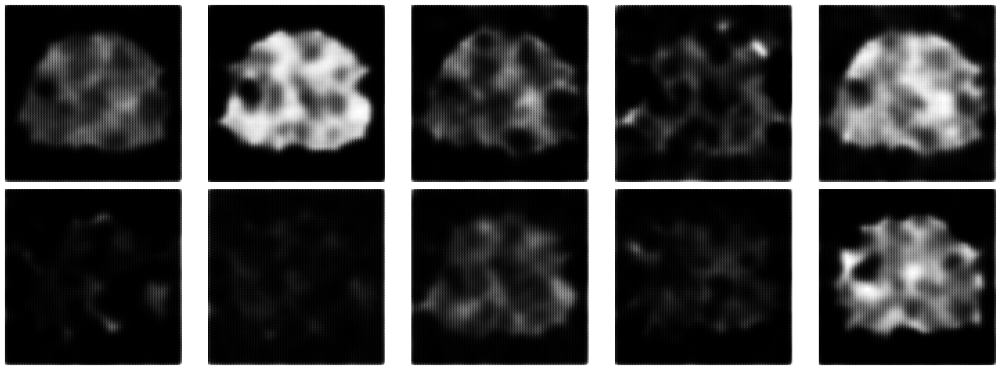

  0%|                                                                                                                        | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 1/3750 [00:00<07:11,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 2/3750 [00:00<06:52,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 3/3750 [00:00<07:14,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 4/3750 [00:00<07:00,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 5/3750 [00:00<06:52,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 6/3750 [00:00<06:47,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 7/3750 [00:00<06:45,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 8/3750 [00:00<06:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                               | 9/3750 [00:00<06:40,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


  0%|▎                                                                                                              | 10/3750 [00:01<06:40,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                              | 11/3750 [00:01<06:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                              | 12/3750 [00:01<06:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 13/3750 [00:01<06:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 14/3750 [00:01<06:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 15/3750 [00:01<06:42,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 16/3750 [00:01<06:43,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▌                                                                                                              | 17/3750 [00:01<06:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▌                                                                                                              | 18/3750 [00:01<06:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 19/3750 [00:02<06:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 20/3750 [00:02<06:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 21/3750 [00:02<06:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 22/3750 [00:02<06:34,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 23/3750 [00:02<06:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 24/3750 [00:02<06:35,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▋                                                                                                              | 25/3750 [00:02<06:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 26/3750 [00:02<06:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 27/3750 [00:02<06:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 28/3750 [00:03<06:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 29/3750 [00:03<06:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 30/3750 [00:03<06:35,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 31/3750 [00:03<06:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 32/3750 [00:03<06:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▉                                                                                                              | 33/3750 [00:03<06:32,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 34/3750 [00:03<06:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 35/3750 [00:03<06:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 36/3750 [00:03<06:35,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█                                                                                                              | 37/3750 [00:03<06:33,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


  1%|█                                                                                                              | 38/3750 [00:04<06:34,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 39/3750 [00:04<06:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 40/3750 [00:04<06:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▏                                                                                                             | 41/3750 [00:04<06:32,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 42/3750 [00:04<06:31,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 43/3750 [00:04<06:33,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 44/3750 [00:04<06:32,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 45/3750 [00:04<06:32,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 46/3750 [00:04<06:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 47/3750 [00:05<06:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 48/3750 [00:05<06:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 49/3750 [00:05<06:30,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


  1%|█▍                                                                                                             | 50/3750 [00:05<06:30,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 51/3750 [00:05<06:31,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 52/3750 [00:05<06:35,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 53/3750 [00:05<06:32,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


  1%|█▌                                                                                                             | 54/3750 [00:05<06:35,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


  1%|█▋                                                                                                             | 55/3750 [00:05<06:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▋                                                                                                             | 56/3750 [00:05<06:36,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▋                                                                                                             | 57/3750 [00:06<06:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▋                                                                                                             | 58/3750 [00:06<06:40,  9.21it/s]

1/1 [==============================] - 0s 32ms/step


  2%|█▋                                                                                                             | 59/3750 [00:06<08:04,  7.61it/s]

1/1 [==============================] - 0s 11ms/step


  2%|█▊                                                                                                             | 60/3750 [00:06<07:48,  7.87it/s]

1/1 [==============================] - 0s 10ms/step


  2%|█▊                                                                                                             | 61/3750 [00:06<07:34,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


  2%|█▊                                                                                                             | 62/3750 [00:06<07:21,  8.36it/s]

1/1 [==============================] - 0s 10ms/step


  2%|█▊                                                                                                             | 63/3750 [00:06<07:12,  8.53it/s]

1/1 [==============================] - 0s 10ms/step


  2%|█▉                                                                                                             | 64/3750 [00:06<07:05,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 65/3750 [00:07<06:57,  8.82it/s]

1/1 [==============================] - 0s 10ms/step


  2%|█▉                                                                                                             | 66/3750 [00:07<06:57,  8.83it/s]

1/1 [==============================] - 0s 10ms/step


  2%|█▉                                                                                                             | 67/3750 [00:07<06:54,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 68/3750 [00:07<06:52,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 69/3750 [00:07<06:47,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 70/3750 [00:07<06:45,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 71/3750 [00:07<06:41,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 72/3750 [00:07<06:39,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 73/3750 [00:07<06:37,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 74/3750 [00:08<06:36,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 75/3750 [00:08<07:38,  8.01it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 76/3750 [00:08<07:20,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 77/3750 [00:08<07:07,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 78/3750 [00:08<06:57,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 79/3750 [00:08<06:48,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 80/3750 [00:08<06:47,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 81/3750 [00:08<06:42,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 82/3750 [00:08<06:38,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 83/3750 [00:09<06:37,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 84/3750 [00:09<06:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 85/3750 [00:09<06:34,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▌                                                                                                            | 86/3750 [00:09<06:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 87/3750 [00:09<06:32,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


  2%|██▌                                                                                                            | 88/3750 [00:09<06:33,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 89/3750 [00:09<06:35,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 90/3750 [00:09<06:35,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


  2%|██▋                                                                                                            | 91/3750 [00:09<06:35,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 92/3750 [00:10<06:34,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▊                                                                                                            | 93/3750 [00:10<06:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 94/3750 [00:10<06:34,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 95/3750 [00:10<06:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 96/3750 [00:10<06:31,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▊                                                                                                            | 97/3750 [00:10<06:31,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▉                                                                                                            | 98/3750 [00:10<06:28,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                            | 99/3750 [00:10<06:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                           | 100/3750 [00:10<06:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                           | 101/3750 [00:11<06:32,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▉                                                                                                           | 102/3750 [00:11<06:30,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███                                                                                                           | 103/3750 [00:11<06:29,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███                                                                                                           | 104/3750 [00:11<06:28,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███                                                                                                           | 105/3750 [00:11<06:27,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███                                                                                                           | 106/3750 [00:11<06:35,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 107/3750 [00:11<06:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 108/3750 [00:11<06:34,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 109/3750 [00:11<06:31,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▏                                                                                                          | 110/3750 [00:11<06:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 111/3750 [00:12<06:27,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 112/3750 [00:12<06:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 113/3750 [00:12<06:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 114/3750 [00:12<06:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 115/3750 [00:12<06:24,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 116/3750 [00:12<06:24,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 117/3750 [00:12<06:28,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▍                                                                                                          | 118/3750 [00:12<06:27,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▍                                                                                                          | 119/3750 [00:12<06:26,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▌                                                                                                          | 120/3750 [00:13<06:26,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 121/3750 [00:13<06:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 122/3750 [00:13<06:25,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


  3%|███▌                                                                                                          | 123/3750 [00:13<06:25,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 124/3750 [00:13<06:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▋                                                                                                          | 125/3750 [00:13<06:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 126/3750 [00:13<06:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 127/3750 [00:13<06:25,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▊                                                                                                          | 128/3750 [00:13<06:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 129/3750 [00:13<06:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 130/3750 [00:14<06:32,  9.23it/s]

1/1 [==============================] - 0s 12ms/step


  3%|███▊                                                                                                          | 131/3750 [00:14<06:34,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▊                                                                                                          | 132/3750 [00:14<06:32,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▉                                                                                                          | 133/3750 [00:14<06:29,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▉                                                                                                          | 134/3750 [00:14<06:26,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▉                                                                                                          | 135/3750 [00:14<06:28,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▉                                                                                                          | 136/3750 [00:14<06:25,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████                                                                                                          | 137/3750 [00:14<06:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████                                                                                                          | 138/3750 [00:14<06:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████                                                                                                          | 139/3750 [00:15<06:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████                                                                                                          | 140/3750 [00:15<06:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 141/3750 [00:15<06:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 142/3750 [00:15<06:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▏                                                                                                         | 143/3750 [00:15<06:28,  9.29it/s]

1/1 [==============================] - 0s 19ms/step


  4%|████▏                                                                                                         | 144/3750 [00:15<06:51,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▎                                                                                                         | 145/3750 [00:15<06:48,  8.82it/s]

1/1 [==============================] - 0s 12ms/step


  4%|████▎                                                                                                         | 146/3750 [00:15<06:57,  8.63it/s]

1/1 [==============================] - 0s 13ms/step


  4%|████▎                                                                                                         | 147/3750 [00:15<06:58,  8.60it/s]

1/1 [==============================] - 0s 13ms/step


  4%|████▎                                                                                                         | 148/3750 [00:16<07:09,  8.39it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▎                                                                                                         | 149/3750 [00:16<08:01,  7.47it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▍                                                                                                         | 150/3750 [00:16<07:52,  7.61it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▍                                                                                                         | 151/3750 [00:16<08:05,  7.41it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▍                                                                                                         | 152/3750 [00:16<07:54,  7.58it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 153/3750 [00:16<07:29,  8.00it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 154/3750 [00:16<07:10,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 155/3750 [00:16<06:56,  8.64it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▌                                                                                                         | 156/3750 [00:17<06:46,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 157/3750 [00:17<06:38,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▋                                                                                                         | 158/3750 [00:17<06:33,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▋                                                                                                         | 159/3750 [00:17<06:30,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▋                                                                                                         | 160/3750 [00:17<06:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 161/3750 [00:17<06:46,  8.82it/s]

1/1 [==============================] - 0s 11ms/step


  4%|████▊                                                                                                         | 162/3750 [00:17<06:54,  8.67it/s]

1/1 [==============================] - 0s 11ms/step


  4%|████▊                                                                                                         | 163/3750 [00:17<06:58,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 164/3750 [00:17<06:48,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 165/3750 [00:18<06:40,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 166/3750 [00:18<06:34,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▉                                                                                                         | 167/3750 [00:18<06:30,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▉                                                                                                         | 168/3750 [00:18<06:27,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  5%|████▉                                                                                                         | 169/3750 [00:18<06:31,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


  5%|████▉                                                                                                         | 170/3750 [00:18<06:29,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████                                                                                                         | 171/3750 [00:18<06:25,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████                                                                                                         | 172/3750 [00:18<06:25,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████                                                                                                         | 173/3750 [00:18<06:26,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 174/3750 [00:19<06:24,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▏                                                                                                        | 175/3750 [00:19<06:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▏                                                                                                        | 176/3750 [00:19<06:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 177/3750 [00:19<06:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 178/3750 [00:19<06:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 179/3750 [00:19<06:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 180/3750 [00:19<06:20,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 181/3750 [00:19<06:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 182/3750 [00:19<06:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 183/3750 [00:20<06:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 184/3750 [00:20<06:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 185/3750 [00:20<06:22,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 186/3750 [00:20<06:21,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 187/3750 [00:20<06:21,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▌                                                                                                        | 188/3750 [00:20<06:21,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▌                                                                                                        | 189/3750 [00:20<06:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▌                                                                                                        | 190/3750 [00:20<06:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 191/3750 [00:20<06:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 192/3750 [00:20<06:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 193/3750 [00:21<06:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 194/3750 [00:21<06:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 195/3750 [00:21<06:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 196/3750 [00:21<06:18,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 197/3750 [00:21<06:23,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 198/3750 [00:21<06:21,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▊                                                                                                        | 199/3750 [00:21<06:19,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▊                                                                                                        | 200/3750 [00:21<06:18,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 201/3750 [00:21<06:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 202/3750 [00:22<06:18,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 203/3750 [00:22<06:18,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 204/3750 [00:22<06:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██████                                                                                                        | 205/3750 [00:22<06:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██████                                                                                                        | 206/3750 [00:22<06:19,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██████                                                                                                        | 207/3750 [00:22<06:29,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████                                                                                                        | 208/3750 [00:22<06:25,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 209/3750 [00:22<06:23,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 210/3750 [00:22<06:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 211/3750 [00:23<06:21,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 212/3750 [00:23<06:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 213/3750 [00:23<06:18,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▎                                                                                                       | 214/3750 [00:23<06:17,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 215/3750 [00:23<06:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▎                                                                                                       | 216/3750 [00:23<06:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▎                                                                                                       | 217/3750 [00:23<06:18,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 218/3750 [00:23<06:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 219/3750 [00:23<06:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 220/3750 [00:23<06:17,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 221/3750 [00:24<06:16,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 222/3750 [00:24<06:15,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 223/3750 [00:24<06:20,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 224/3750 [00:24<06:18,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 225/3750 [00:24<06:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 226/3750 [00:24<06:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 227/3750 [00:24<06:15,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 228/3750 [00:24<06:14,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 229/3750 [00:24<06:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 230/3750 [00:25<06:16,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 231/3750 [00:25<06:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 232/3750 [00:25<06:15,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 233/3750 [00:25<06:15,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 234/3750 [00:25<06:16,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 235/3750 [00:25<06:14,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 236/3750 [00:25<06:13,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 237/3750 [00:25<06:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 238/3750 [00:25<06:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████                                                                                                       | 239/3750 [00:26<06:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████                                                                                                       | 240/3750 [00:26<06:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████                                                                                                       | 241/3750 [00:26<06:13,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 242/3750 [00:26<06:16,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████▏                                                                                                      | 243/3750 [00:26<06:15,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 244/3750 [00:26<06:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 245/3750 [00:26<06:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 246/3750 [00:26<06:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▏                                                                                                      | 247/3750 [00:26<06:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 248/3750 [00:26<06:18,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 249/3750 [00:27<06:17,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▎                                                                                                      | 250/3750 [00:27<06:16,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▎                                                                                                      | 251/3750 [00:27<06:14,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


  7%|███████▍                                                                                                      | 252/3750 [00:27<06:14,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▍                                                                                                      | 253/3750 [00:27<06:14,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 254/3750 [00:27<06:12,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▍                                                                                                      | 255/3750 [00:27<06:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 256/3750 [00:27<06:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▌                                                                                                      | 257/3750 [00:27<06:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 258/3750 [00:28<06:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 259/3750 [00:28<06:13,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 260/3750 [00:28<06:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 261/3750 [00:28<06:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 262/3750 [00:28<06:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 263/3750 [00:28<06:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 264/3750 [00:28<06:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 265/3750 [00:28<06:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 266/3750 [00:28<06:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 267/3750 [00:28<06:13,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 268/3750 [00:29<06:12,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▉                                                                                                      | 269/3750 [00:29<06:11,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▉                                                                                                      | 270/3750 [00:29<06:14,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▉                                                                                                      | 271/3750 [00:29<06:13,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▉                                                                                                      | 272/3750 [00:29<06:12,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████                                                                                                      | 273/3750 [00:29<06:13,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████                                                                                                      | 274/3750 [00:29<06:18,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 275/3750 [00:29<06:16,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 276/3750 [00:29<06:16,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 277/3750 [00:30<06:13,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████▏                                                                                                     | 278/3750 [00:30<06:10,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████▏                                                                                                     | 279/3750 [00:30<06:13,  9.30it/s]

1/1 [==============================] - 0s 24ms/step


  7%|████████▏                                                                                                     | 280/3750 [00:30<06:39,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


  7%|████████▏                                                                                                     | 281/3750 [00:30<06:36,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 282/3750 [00:30<06:30,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 283/3750 [00:30<06:25,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 284/3750 [00:30<06:24,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


  8%|████████▎                                                                                                     | 285/3750 [00:30<06:26,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


  8%|████████▍                                                                                                     | 286/3750 [00:31<06:27,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 287/3750 [00:31<06:24,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 288/3750 [00:31<06:20,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 289/3750 [00:31<06:16,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 290/3750 [00:31<06:14,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 291/3750 [00:31<06:11,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 292/3750 [00:31<06:10,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 293/3750 [00:31<06:08,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 294/3750 [00:31<06:07,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 295/3750 [00:32<06:10,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 296/3750 [00:32<06:14,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 297/3750 [00:32<06:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 298/3750 [00:32<06:09,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 299/3750 [00:32<06:09,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▊                                                                                                     | 300/3750 [00:32<06:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 301/3750 [00:32<06:10,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 302/3750 [00:32<06:09,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 303/3750 [00:32<06:08,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 304/3750 [00:33<06:07,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 305/3750 [00:33<06:09,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 306/3750 [00:33<06:08,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████                                                                                                     | 307/3750 [00:33<06:07,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 308/3750 [00:33<06:07,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 309/3750 [00:33<06:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 310/3750 [00:33<06:07,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


  8%|█████████                                                                                                     | 311/3750 [00:33<06:10,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 312/3750 [00:33<06:09,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


  8%|█████████▏                                                                                                    | 313/3750 [00:33<06:10,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 314/3750 [00:34<06:13,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 315/3750 [00:34<06:13,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▎                                                                                                    | 316/3750 [00:34<06:12,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▎                                                                                                    | 317/3750 [00:34<06:11,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▎                                                                                                    | 318/3750 [00:34<06:09,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▎                                                                                                    | 319/3750 [00:34<06:08,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 320/3750 [00:34<06:08,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 321/3750 [00:34<06:13,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 322/3750 [00:34<06:10,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 323/3750 [00:35<06:08,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 324/3750 [00:35<06:10,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 325/3750 [00:35<06:08,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 326/3750 [00:35<06:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 327/3750 [00:35<06:06,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 328/3750 [00:35<06:05,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 329/3750 [00:35<06:04,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 330/3750 [00:35<06:04,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 331/3750 [00:35<06:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 332/3750 [00:36<06:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 333/3750 [00:36<06:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 334/3750 [00:36<06:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 335/3750 [00:36<06:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 336/3750 [00:36<06:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 337/3750 [00:36<06:05,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▉                                                                                                    | 338/3750 [00:36<06:06,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 339/3750 [00:36<06:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 340/3750 [00:36<06:03,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 341/3750 [00:36<06:03,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 342/3750 [00:37<06:02,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 343/3750 [00:37<06:04,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 344/3750 [00:37<06:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 345/3750 [00:37<06:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 346/3750 [00:37<06:02,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 347/3750 [00:37<06:02,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 348/3750 [00:37<06:01,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 349/3750 [00:37<06:00,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 350/3750 [00:37<06:00,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 351/3750 [00:38<06:00,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▎                                                                                                   | 352/3750 [00:38<06:02,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▎                                                                                                   | 353/3750 [00:38<06:02,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▍                                                                                                   | 354/3750 [00:38<06:00,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▍                                                                                                   | 355/3750 [00:38<06:00,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▍                                                                                                   | 356/3750 [00:38<06:06,  9.26it/s]

1/1 [==============================] - 0s 12ms/step


 10%|██████████▍                                                                                                   | 357/3750 [00:38<06:07,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▌                                                                                                   | 358/3750 [00:38<06:07,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 359/3750 [00:38<06:04,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 360/3750 [00:39<06:02,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 361/3750 [00:39<06:03,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▌                                                                                                   | 362/3750 [00:39<06:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 363/3750 [00:39<06:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 364/3750 [00:39<06:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 365/3750 [00:39<06:03,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 366/3750 [00:39<06:01,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 367/3750 [00:39<06:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▊                                                                                                   | 368/3750 [00:39<06:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▊                                                                                                   | 369/3750 [00:39<05:59,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▊                                                                                                   | 370/3750 [00:40<05:59,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 371/3750 [00:40<06:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 372/3750 [00:40<06:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 373/3750 [00:40<06:01,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 374/3750 [00:40<06:02,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 375/3750 [00:40<06:02,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 376/3750 [00:40<06:02,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 377/3750 [00:40<06:01,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 378/3750 [00:40<05:59,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 379/3750 [00:41<05:59,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 380/3750 [00:41<06:02,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 381/3750 [00:41<06:03,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 382/3750 [00:41<06:01,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 383/3750 [00:41<06:00,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▎                                                                                                  | 384/3750 [00:41<06:00,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 385/3750 [00:41<05:58,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 386/3750 [00:41<05:57,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▎                                                                                                  | 387/3750 [00:41<05:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 388/3750 [00:42<05:56,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 389/3750 [00:42<05:56,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 390/3750 [00:42<05:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 391/3750 [00:42<05:58,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 392/3750 [00:42<05:57,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▌                                                                                                  | 393/3750 [00:42<05:57,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▌                                                                                                  | 394/3750 [00:42<05:57,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▌                                                                                                  | 395/3750 [00:42<05:57,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▌                                                                                                  | 396/3750 [00:42<05:56,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 397/3750 [00:42<05:56,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▋                                                                                                  | 398/3750 [00:43<05:56,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 399/3750 [00:43<05:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▋                                                                                                  | 400/3750 [00:43<05:57,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 401/3750 [00:43<05:56,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 402/3750 [00:43<05:56,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 403/3750 [00:43<05:56,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 404/3750 [00:43<05:56,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 405/3750 [00:43<05:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 406/3750 [00:43<06:00,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 407/3750 [00:44<05:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 408/3750 [00:44<05:57,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 409/3750 [00:44<05:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 410/3750 [00:44<05:57,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 411/3750 [00:44<05:57,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 412/3750 [00:44<05:56,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 413/3750 [00:44<05:54,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 414/3750 [00:44<05:54,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 415/3750 [00:44<05:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 416/3750 [00:44<05:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 417/3750 [00:45<05:53,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 418/3750 [00:45<05:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 419/3750 [00:45<05:57,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 420/3750 [00:45<06:01,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 421/3750 [00:45<06:00,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 422/3750 [00:45<05:59,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 423/3750 [00:45<06:03,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 424/3750 [00:45<06:01,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 425/3750 [00:45<05:58,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 426/3750 [00:46<05:56,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 427/3750 [00:46<05:57,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 428/3750 [00:46<05:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 429/3750 [00:46<06:05,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 430/3750 [00:46<06:01,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▋                                                                                                 | 431/3750 [00:46<06:00,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▋                                                                                                 | 432/3750 [00:46<05:59,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▋                                                                                                 | 433/3750 [00:46<05:57,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 12%|████████████▋                                                                                                 | 434/3750 [00:46<05:58,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 435/3750 [00:47<05:59,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 436/3750 [00:47<05:57,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 437/3750 [00:47<05:58,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 438/3750 [00:47<05:56,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 439/3750 [00:47<05:55,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 440/3750 [00:47<05:53,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 441/3750 [00:47<05:53,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 442/3750 [00:47<05:51,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 443/3750 [00:47<05:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 444/3750 [00:48<05:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████                                                                                                 | 445/3750 [00:48<05:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████                                                                                                 | 446/3750 [00:48<05:52,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 447/3750 [00:48<05:56,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 448/3750 [00:48<05:55,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 449/3750 [00:48<05:54,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 450/3750 [00:48<05:52,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 451/3750 [00:48<05:51,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 452/3750 [00:48<05:50,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 453/3750 [00:48<05:49,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 454/3750 [00:49<05:49,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 455/3750 [00:49<05:50,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 456/3750 [00:49<05:53,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 457/3750 [00:49<05:53,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 458/3750 [00:49<05:51,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 459/3750 [00:49<05:51,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▍                                                                                                | 460/3750 [00:49<05:50,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 461/3750 [00:49<05:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 462/3750 [00:49<05:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 463/3750 [00:50<05:49,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 464/3750 [00:50<05:48,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▋                                                                                                | 465/3750 [00:50<05:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 466/3750 [00:50<05:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 467/3750 [00:50<05:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 468/3750 [00:50<05:50,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 469/3750 [00:50<05:49,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 470/3750 [00:50<05:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 471/3750 [00:50<05:47,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 472/3750 [00:50<05:48,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 473/3750 [00:51<05:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 474/3750 [00:51<05:53,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 475/3750 [00:51<05:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 476/3750 [00:51<05:51,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 477/3750 [00:51<06:03,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 478/3750 [00:51<05:59,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████                                                                                                | 479/3750 [00:51<05:55,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 480/3750 [00:51<05:52,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 481/3750 [00:51<05:51,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▏                                                                                               | 482/3750 [00:52<05:50,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 483/3750 [00:52<05:50,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▏                                                                                               | 484/3750 [00:52<05:51,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 485/3750 [00:52<05:50,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 486/3750 [00:52<05:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 487/3750 [00:52<05:53,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 488/3750 [00:52<05:51,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 489/3750 [00:52<05:49,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 13%|██████████████▎                                                                                               | 490/3750 [00:52<05:49,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 491/3750 [00:53<05:48,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 492/3750 [00:53<05:47,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 493/3750 [00:53<05:49,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 494/3750 [00:53<05:47,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 495/3750 [00:53<05:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 496/3750 [00:53<05:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 497/3750 [00:53<05:49,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 498/3750 [00:53<05:47,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▋                                                                                               | 499/3750 [00:53<05:47,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 500/3750 [00:54<05:46,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 501/3750 [00:54<05:46,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 502/3750 [00:54<05:45,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 503/3750 [00:54<05:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 504/3750 [00:54<05:46,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 505/3750 [00:54<05:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 506/3750 [00:54<05:45,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▊                                                                                               | 507/3750 [00:54<05:45,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 508/3750 [00:54<05:45,  9.38it/s]

1/1 [==============================] - 0s 11ms/step


 14%|██████████████▉                                                                                               | 509/3750 [00:54<05:48,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▉                                                                                               | 510/3750 [00:55<05:46,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▉                                                                                               | 511/3750 [00:55<05:45,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████                                                                                               | 512/3750 [00:55<05:44,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 513/3750 [00:55<05:46,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 514/3750 [00:55<05:45,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 515/3750 [00:55<05:45,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 516/3750 [00:55<05:45,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 517/3750 [00:55<05:43,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 518/3750 [00:55<05:43,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▏                                                                                              | 519/3750 [00:56<05:43,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 520/3750 [00:56<05:42,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 521/3750 [00:56<05:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 522/3750 [00:56<05:43,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 523/3750 [00:56<05:43,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 524/3750 [00:56<05:42,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 525/3750 [00:56<05:42,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 526/3750 [00:56<05:46,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 527/3750 [00:56<05:45,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 528/3750 [00:56<05:44,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 529/3750 [00:57<05:43,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 530/3750 [00:57<05:42,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▌                                                                                              | 531/3750 [00:57<05:41,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 532/3750 [00:57<05:43,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▋                                                                                              | 533/3750 [00:57<05:43,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▋                                                                                              | 534/3750 [00:57<05:42,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 535/3750 [00:57<05:41,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▋                                                                                              | 536/3750 [00:57<05:41,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 537/3750 [00:57<05:41,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 538/3750 [00:58<05:40,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 539/3750 [00:58<05:40,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 540/3750 [00:58<05:39,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 541/3750 [00:58<05:40,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▉                                                                                              | 542/3750 [00:58<05:42,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▉                                                                                              | 543/3750 [00:58<05:41,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 15%|███████████████▉                                                                                              | 544/3750 [00:58<05:41,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 15%|███████████████▉                                                                                              | 545/3750 [00:58<05:41,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 546/3750 [00:58<05:40,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 547/3750 [00:59<05:39,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 548/3750 [00:59<05:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 549/3750 [00:59<05:39,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 550/3750 [00:59<05:39,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 551/3750 [00:59<05:42,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 552/3750 [00:59<05:42,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 553/3750 [00:59<05:41,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 554/3750 [00:59<05:45,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 555/3750 [00:59<05:44,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 556/3750 [00:59<05:42,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 557/3750 [01:00<05:40,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 558/3750 [01:00<05:39,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 559/3750 [01:00<05:38,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 560/3750 [01:00<05:40,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 561/3750 [01:00<05:40,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 562/3750 [01:00<05:40,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 563/3750 [01:00<05:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 564/3750 [01:00<05:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 565/3750 [01:00<05:39,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▌                                                                                             | 566/3750 [01:01<05:39,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 567/3750 [01:01<05:38,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 568/3750 [01:01<05:38,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 569/3750 [01:01<05:37,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 570/3750 [01:01<05:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 571/3750 [01:01<05:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 572/3750 [01:01<05:38,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▊                                                                                             | 573/3750 [01:01<05:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 574/3750 [01:01<05:38,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▊                                                                                             | 575/3750 [01:01<05:37,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 576/3750 [01:02<05:37,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 577/3750 [01:02<05:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 578/3750 [01:02<05:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 579/3750 [01:02<05:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████████████████                                                                                             | 580/3750 [01:02<05:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████████████████                                                                                             | 581/3750 [01:02<05:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████                                                                                             | 582/3750 [01:02<05:37,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████                                                                                             | 583/3750 [01:02<05:36,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 16%|█████████████████▏                                                                                            | 584/3750 [01:02<05:42,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 585/3750 [01:03<05:41,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 586/3750 [01:03<05:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 587/3750 [01:03<05:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 588/3750 [01:03<05:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▎                                                                                            | 589/3750 [01:03<05:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▎                                                                                            | 590/3750 [01:03<05:37,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▎                                                                                            | 591/3750 [01:03<05:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 592/3750 [01:03<05:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▍                                                                                            | 593/3750 [01:03<05:35,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▍                                                                                            | 594/3750 [01:04<05:35,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 595/3750 [01:04<05:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 596/3750 [01:04<05:35,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 597/3750 [01:04<05:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▌                                                                                            | 598/3750 [01:04<05:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▌                                                                                            | 599/3750 [01:04<05:37,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 600/3750 [01:04<05:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 601/3750 [01:04<05:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 602/3750 [01:04<05:35,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 603/3750 [01:04<05:35,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 604/3750 [01:05<05:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 605/3750 [01:05<05:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 606/3750 [01:05<05:33,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 607/3750 [01:05<05:35,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 608/3750 [01:05<05:34,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 609/3750 [01:05<05:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 610/3750 [01:05<05:34,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 611/3750 [01:05<05:34,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 612/3750 [01:05<05:33,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 613/3750 [01:06<05:34,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 614/3750 [01:06<05:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 615/3750 [01:06<05:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 616/3750 [01:06<05:31,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 617/3750 [01:06<05:33,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████▏                                                                                           | 618/3750 [01:06<05:32,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▏                                                                                           | 619/3750 [01:06<05:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▏                                                                                           | 620/3750 [01:06<05:30,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 621/3750 [01:06<05:31,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 622/3750 [01:06<05:31,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 623/3750 [01:07<05:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 624/3750 [01:07<05:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 625/3750 [01:07<05:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 626/3750 [01:07<05:31,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 627/3750 [01:07<05:31,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 628/3750 [01:07<05:30,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 629/3750 [01:07<05:31,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 630/3750 [01:07<05:30,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 631/3750 [01:07<05:30,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▌                                                                                           | 632/3750 [01:08<05:29,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 633/3750 [01:08<05:31,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▌                                                                                           | 634/3750 [01:08<05:31,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 635/3750 [01:08<05:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 636/3750 [01:08<05:37,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 637/3750 [01:08<05:35,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 638/3750 [01:08<05:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 639/3750 [01:08<05:32,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 640/3750 [01:08<05:30,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 641/3750 [01:09<05:30,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 642/3750 [01:09<05:29,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 643/3750 [01:09<05:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 644/3750 [01:09<05:29,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▉                                                                                           | 645/3750 [01:09<05:30,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 646/3750 [01:09<05:29,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 647/3750 [01:09<05:29,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 648/3750 [01:09<05:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████                                                                                           | 649/3750 [01:09<05:27,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████                                                                                           | 650/3750 [01:09<05:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 651/3750 [01:10<05:27,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 652/3750 [01:10<05:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 653/3750 [01:10<05:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 654/3750 [01:10<05:28,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 17%|███████████████████▏                                                                                          | 655/3750 [01:10<05:29,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 656/3750 [01:10<05:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 657/3750 [01:10<05:29,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▎                                                                                          | 658/3750 [01:10<05:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 659/3750 [01:10<05:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▎                                                                                          | 660/3750 [01:11<05:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▍                                                                                          | 661/3750 [01:11<05:27,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 662/3750 [01:11<05:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 663/3750 [01:11<05:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 664/3750 [01:11<05:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 665/3750 [01:11<05:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 666/3750 [01:11<05:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 667/3750 [01:11<05:29,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 668/3750 [01:11<05:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 669/3750 [01:11<05:28,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 670/3750 [01:12<05:27,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▋                                                                                          | 671/3750 [01:12<05:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 672/3750 [01:12<05:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 673/3750 [01:12<05:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 674/3750 [01:12<05:27,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 675/3750 [01:12<05:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▊                                                                                          | 676/3750 [01:12<05:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▊                                                                                          | 677/3750 [01:12<05:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▉                                                                                          | 678/3750 [01:12<05:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 679/3750 [01:13<05:31,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 680/3750 [01:13<05:28,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 681/3750 [01:13<05:27,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 682/3750 [01:13<05:27,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 683/3750 [01:13<05:28,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 684/3750 [01:13<05:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 685/3750 [01:13<05:26,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 686/3750 [01:13<05:26,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▏                                                                                         | 687/3750 [01:13<05:25,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 688/3750 [01:14<05:24,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▏                                                                                         | 689/3750 [01:14<05:24,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▏                                                                                         | 690/3750 [01:14<05:27,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▎                                                                                         | 691/3750 [01:14<05:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 692/3750 [01:14<05:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 693/3750 [01:14<05:27,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▎                                                                                         | 694/3750 [01:14<05:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 695/3750 [01:14<05:26,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▍                                                                                         | 696/3750 [01:14<05:25,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▍                                                                                         | 697/3750 [01:14<05:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▍                                                                                         | 698/3750 [01:15<05:23,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 699/3750 [01:15<05:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 700/3750 [01:15<05:26,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 701/3750 [01:15<05:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 702/3750 [01:15<05:36,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▌                                                                                         | 703/3750 [01:15<05:37,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▋                                                                                         | 704/3750 [01:15<05:38,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▋                                                                                         | 705/3750 [01:15<05:39,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▋                                                                                         | 706/3750 [01:15<05:37,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▋                                                                                         | 707/3750 [01:16<05:52,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▊                                                                                         | 708/3750 [01:16<05:57,  8.52it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 709/3750 [01:16<06:01,  8.41it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▊                                                                                         | 710/3750 [01:16<06:14,  8.12it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▊                                                                                         | 711/3750 [01:16<06:01,  8.41it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▉                                                                                         | 712/3750 [01:16<05:50,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 713/3750 [01:16<05:41,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▉                                                                                         | 714/3750 [01:16<05:35,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 715/3750 [01:17<05:35,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 716/3750 [01:17<05:31,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 717/3750 [01:17<05:28,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 718/3750 [01:17<05:26,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 719/3750 [01:17<05:27,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 720/3750 [01:17<05:27,  9.25it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█████████████████████▏                                                                                        | 721/3750 [01:17<05:47,  8.73it/s]

1/1 [==============================] - 0s 11ms/step


 19%|█████████████████████▏                                                                                        | 722/3750 [01:17<05:58,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 723/3750 [01:17<05:47,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 724/3750 [01:18<05:39,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 725/3750 [01:18<05:33,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 726/3750 [01:18<05:29,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▎                                                                                        | 727/3750 [01:18<05:26,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 728/3750 [01:18<05:26,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▍                                                                                        | 729/3750 [01:18<05:26,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▍                                                                                        | 730/3750 [01:18<05:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▍                                                                                        | 731/3750 [01:18<05:23,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▍                                                                                        | 732/3750 [01:18<05:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 733/3750 [01:18<05:20,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 734/3750 [01:19<05:20,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 735/3750 [01:19<05:20,  9.42it/s]

1/1 [==============================] - 0s 11ms/step


 20%|█████████████████████▌                                                                                        | 736/3750 [01:19<05:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▌                                                                                        | 737/3750 [01:19<05:21,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 738/3750 [01:19<05:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 739/3750 [01:19<05:20,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 740/3750 [01:19<05:24,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 741/3750 [01:19<05:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 742/3750 [01:19<05:20,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 743/3750 [01:20<05:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 744/3750 [01:20<05:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 745/3750 [01:20<05:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 746/3750 [01:20<05:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 747/3750 [01:20<05:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 748/3750 [01:20<05:18,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 749/3750 [01:20<05:17,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 750/3750 [01:20<05:18,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 751/3750 [01:20<05:18,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 752/3750 [01:21<05:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 753/3750 [01:21<05:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 754/3750 [01:21<05:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 755/3750 [01:21<05:18,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▏                                                                                       | 756/3750 [01:21<05:18,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 757/3750 [01:21<05:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 758/3750 [01:21<05:18,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 759/3750 [01:21<05:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▎                                                                                       | 760/3750 [01:21<05:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 761/3750 [01:21<05:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 762/3750 [01:22<05:15,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 763/3750 [01:22<05:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 764/3750 [01:22<05:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 765/3750 [01:22<05:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 766/3750 [01:22<05:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 767/3750 [01:22<05:18,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▌                                                                                       | 768/3750 [01:22<05:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▌                                                                                       | 769/3750 [01:22<05:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▌                                                                                       | 770/3750 [01:22<05:15,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▌                                                                                       | 771/3750 [01:23<05:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▋                                                                                       | 772/3750 [01:23<05:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▋                                                                                       | 773/3750 [01:23<05:14,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 774/3750 [01:23<05:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 775/3750 [01:23<05:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 776/3750 [01:23<05:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 777/3750 [01:23<05:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 778/3750 [01:23<05:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▊                                                                                       | 779/3750 [01:23<05:18,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 780/3750 [01:23<05:17,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 781/3750 [01:24<05:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 782/3750 [01:24<05:17,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 783/3750 [01:24<05:15,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 784/3750 [01:24<05:16,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 785/3750 [01:24<05:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 786/3750 [01:24<05:15,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 787/3750 [01:24<05:15,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████                                                                                       | 788/3750 [01:24<05:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▏                                                                                      | 789/3750 [01:24<05:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▏                                                                                      | 790/3750 [01:25<05:13,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 791/3750 [01:25<05:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▏                                                                                      | 792/3750 [01:25<05:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▎                                                                                      | 793/3750 [01:25<05:11,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 794/3750 [01:25<05:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 795/3750 [01:25<05:13,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 796/3750 [01:25<05:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 797/3750 [01:25<05:13,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 798/3750 [01:25<05:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 799/3750 [01:25<05:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 800/3750 [01:26<05:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 801/3750 [01:26<05:11,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 802/3750 [01:26<05:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▌                                                                                      | 803/3750 [01:26<05:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 804/3750 [01:26<05:12,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 805/3750 [01:26<05:12,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▋                                                                                      | 806/3750 [01:26<05:16,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 807/3750 [01:26<05:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 808/3750 [01:26<05:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 809/3750 [01:27<05:13,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 810/3750 [01:27<05:13,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 22%|███████████████████████▊                                                                                      | 811/3750 [01:27<05:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▊                                                                                      | 812/3750 [01:27<05:12,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▊                                                                                      | 813/3750 [01:27<05:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 814/3750 [01:27<05:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 815/3750 [01:27<05:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 816/3750 [01:27<05:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 817/3750 [01:27<05:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 818/3750 [01:28<05:10,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 819/3750 [01:28<05:10,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 820/3750 [01:28<05:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 821/3750 [01:28<05:08,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 822/3750 [01:28<05:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 823/3750 [01:28<05:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 824/3750 [01:28<05:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▏                                                                                     | 825/3750 [01:28<05:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 826/3750 [01:28<05:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▎                                                                                     | 827/3750 [01:28<05:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▎                                                                                     | 828/3750 [01:29<05:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▎                                                                                     | 829/3750 [01:29<05:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▎                                                                                     | 830/3750 [01:29<05:07,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 831/3750 [01:29<05:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 832/3750 [01:29<05:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 833/3750 [01:29<05:11,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 834/3750 [01:29<05:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 835/3750 [01:29<05:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 836/3750 [01:29<05:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 837/3750 [01:30<05:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 838/3750 [01:30<05:07,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 839/3750 [01:30<05:06,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 840/3750 [01:30<05:06,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▋                                                                                     | 841/3750 [01:30<05:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 842/3750 [01:30<05:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▋                                                                                     | 843/3750 [01:30<05:07,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 844/3750 [01:30<05:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 845/3750 [01:30<05:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 846/3750 [01:30<05:07,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 847/3750 [01:31<05:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 848/3750 [01:31<05:06,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 23%|████████████████████████▉                                                                                     | 849/3750 [01:31<05:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 850/3750 [01:31<05:09,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 851/3750 [01:31<05:08,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 852/3750 [01:31<05:07,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 853/3750 [01:31<05:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 854/3750 [01:31<05:07,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 855/3750 [01:31<05:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 856/3750 [01:32<05:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▏                                                                                    | 857/3750 [01:32<05:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▏                                                                                    | 858/3750 [01:32<05:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▏                                                                                    | 859/3750 [01:32<05:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 860/3750 [01:32<05:10,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 861/3750 [01:32<05:08,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 862/3750 [01:32<05:07,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 863/3750 [01:32<05:06,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 864/3750 [01:32<05:05,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 865/3750 [01:32<05:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 866/3750 [01:33<05:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 867/3750 [01:33<05:04,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 868/3750 [01:33<05:05,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 869/3750 [01:33<05:04,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 870/3750 [01:33<05:04,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 871/3750 [01:33<05:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 872/3750 [01:33<05:05,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▌                                                                                    | 873/3750 [01:33<05:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 874/3750 [01:33<05:04,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 875/3750 [01:34<05:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 876/3750 [01:34<05:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 877/3750 [01:34<05:04,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 878/3750 [01:34<05:05,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 879/3750 [01:34<05:04,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 880/3750 [01:34<05:04,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 881/3750 [01:34<05:05,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▊                                                                                    | 882/3750 [01:34<05:03,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 883/3750 [01:34<05:03,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 884/3750 [01:35<05:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 885/3750 [01:35<05:05,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▉                                                                                    | 886/3750 [01:35<05:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 887/3750 [01:35<05:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 888/3750 [01:35<05:05,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 889/3750 [01:35<05:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 890/3750 [01:35<05:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 891/3750 [01:35<05:03,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 892/3750 [01:35<05:02,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▏                                                                                   | 893/3750 [01:35<05:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▏                                                                                   | 894/3750 [01:36<05:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 895/3750 [01:36<05:00,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 896/3750 [01:36<05:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 897/3750 [01:36<05:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 898/3750 [01:36<05:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 899/3750 [01:36<05:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 900/3750 [01:36<05:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 901/3750 [01:36<05:01,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 902/3750 [01:36<05:00,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 903/3750 [01:37<05:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 904/3750 [01:37<05:06,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 905/3750 [01:37<05:08,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 906/3750 [01:37<05:06,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 907/3750 [01:37<05:05,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▋                                                                                   | 908/3750 [01:37<05:04,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 909/3750 [01:37<05:04,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 910/3750 [01:37<05:03,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 911/3750 [01:37<05:02,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 912/3750 [01:37<05:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 913/3750 [01:38<05:00,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 914/3750 [01:38<05:00,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 915/3750 [01:38<05:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 916/3750 [01:38<05:01,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▉                                                                                   | 917/3750 [01:38<05:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▉                                                                                   | 918/3750 [01:38<05:01,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████████████████████▉                                                                                   | 919/3750 [01:38<05:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████████████████████▉                                                                                   | 920/3750 [01:38<05:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 921/3750 [01:38<05:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████                                                                                   | 922/3750 [01:39<05:01,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 923/3750 [01:39<05:01,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████                                                                                   | 924/3750 [01:39<05:02,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 925/3750 [01:39<05:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 926/3750 [01:39<05:01,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▏                                                                                  | 927/3750 [01:39<05:00,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 928/3750 [01:39<05:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 929/3750 [01:39<05:00,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 930/3750 [01:39<05:00,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 931/3750 [01:40<04:59,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 932/3750 [01:40<04:59,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 933/3750 [01:40<04:59,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 934/3750 [01:40<05:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 935/3750 [01:40<05:00,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 936/3750 [01:40<05:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 937/3750 [01:40<05:02,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▌                                                                                  | 938/3750 [01:40<05:01,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 939/3750 [01:40<05:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▌                                                                                  | 940/3750 [01:40<04:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 941/3750 [01:41<04:59,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 942/3750 [01:41<04:59,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 25%|███████████████████████████▋                                                                                  | 943/3750 [01:41<05:02,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▋                                                                                  | 944/3750 [01:41<05:00,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▋                                                                                  | 945/3750 [01:41<05:00,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▋                                                                                  | 946/3750 [01:41<05:04,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 947/3750 [01:41<05:02,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▊                                                                                  | 948/3750 [01:41<05:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 949/3750 [01:41<04:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 950/3750 [01:42<04:58,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▉                                                                                  | 951/3750 [01:42<04:59,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▉                                                                                  | 952/3750 [01:42<04:57,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 953/3750 [01:42<04:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 954/3750 [01:42<04:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 25%|████████████████████████████                                                                                  | 955/3750 [01:42<04:58,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 25%|████████████████████████████                                                                                  | 956/3750 [01:42<04:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████                                                                                  | 957/3750 [01:42<04:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████                                                                                  | 958/3750 [01:42<04:59,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 959/3750 [01:43<04:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 960/3750 [01:43<04:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 961/3750 [01:43<04:57,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 962/3750 [01:43<05:00,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 963/3750 [01:43<04:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 964/3750 [01:43<04:59,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 965/3750 [01:43<04:58,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 966/3750 [01:43<04:59,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 967/3750 [01:43<05:00,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 26%|████████████████████████████▍                                                                                 | 968/3750 [01:43<05:01,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▍                                                                                 | 969/3750 [01:44<05:00,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▍                                                                                 | 970/3750 [01:44<04:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▍                                                                                 | 971/3750 [01:44<04:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 972/3750 [01:44<04:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 973/3750 [01:44<04:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 974/3750 [01:44<04:57,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 975/3750 [01:44<04:57,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 976/3750 [01:44<04:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 977/3750 [01:44<04:55,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 978/3750 [01:45<04:54,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 979/3750 [01:45<04:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 980/3750 [01:45<04:53,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 981/3750 [01:45<04:55,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 982/3750 [01:45<04:55,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 983/3750 [01:45<04:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 984/3750 [01:45<04:55,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 985/3750 [01:45<04:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 986/3750 [01:45<04:56,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 26%|████████████████████████████▉                                                                                 | 987/3750 [01:46<04:58,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 988/3750 [01:46<04:56,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 989/3750 [01:46<04:56,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████                                                                                 | 990/3750 [01:46<05:00,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 991/3750 [01:46<05:01,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 992/3750 [01:46<05:00,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████▏                                                                                | 993/3750 [01:46<04:59,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 994/3750 [01:46<04:57,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 995/3750 [01:46<05:01,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 996/3750 [01:46<04:58,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                                | 997/3750 [01:47<04:56,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                                | 998/3750 [01:47<04:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                                | 999/3750 [01:47<04:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████                                                                                | 1000/3750 [01:47<04:54,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████                                                                                | 1001/3750 [01:47<04:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████                                                                                | 1002/3750 [01:47<04:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1003/3750 [01:47<04:54,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1004/3750 [01:47<04:54,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                               | 1005/3750 [01:47<04:53,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1006/3750 [01:48<04:53,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 27%|█████████████████████████████▎                                                                               | 1007/3750 [01:48<04:54,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1008/3750 [01:48<04:54,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                               | 1009/3750 [01:48<04:54,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                               | 1010/3750 [01:48<04:55,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1011/3750 [01:48<04:54,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1012/3750 [01:48<04:53,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▍                                                                               | 1013/3750 [01:48<04:53,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▍                                                                               | 1014/3750 [01:48<04:55,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1015/3750 [01:49<04:53,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1016/3750 [01:49<04:52,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1017/3750 [01:49<04:51,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1018/3750 [01:49<04:50,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1019/3750 [01:49<04:49,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1020/3750 [01:49<04:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1021/3750 [01:49<04:50,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1022/3750 [01:49<04:50,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1023/3750 [01:49<04:50,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1024/3750 [01:49<04:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1025/3750 [01:50<04:50,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1026/3750 [01:50<04:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▊                                                                               | 1027/3750 [01:50<04:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1028/3750 [01:50<04:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1029/3750 [01:50<04:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1030/3750 [01:50<04:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1031/3750 [01:50<04:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 28%|█████████████████████████████▉                                                                               | 1032/3750 [01:50<04:51,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████                                                                               | 1033/3750 [01:50<04:50,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1034/3750 [01:51<04:49,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████████████████████████                                                                               | 1035/3750 [01:51<04:50,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████                                                                               | 1036/3750 [01:51<04:53,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1037/3750 [01:51<04:53,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1038/3750 [01:51<04:53,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1039/3750 [01:51<04:52,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1040/3750 [01:51<04:52,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1041/3750 [01:51<04:51,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1042/3750 [01:51<04:50,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1043/3750 [01:52<04:49,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1044/3750 [01:52<04:48,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1045/3750 [01:52<04:48,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1046/3750 [01:52<04:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1047/3750 [01:52<04:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1048/3750 [01:52<04:49,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1049/3750 [01:52<04:49,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1050/3750 [01:52<04:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1051/3750 [01:52<04:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1052/3750 [01:52<04:47,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▌                                                                              | 1053/3750 [01:53<04:47,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▋                                                                              | 1054/3750 [01:53<04:46,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▋                                                                              | 1055/3750 [01:53<04:49,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1056/3750 [01:53<04:48,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▋                                                                              | 1057/3750 [01:53<04:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1058/3750 [01:53<04:49,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1059/3750 [01:53<04:47,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1060/3750 [01:53<04:48,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1061/3750 [01:53<04:47,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1062/3750 [01:54<04:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1063/3750 [01:54<04:46,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1064/3750 [01:54<04:45,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1065/3750 [01:54<04:45,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1066/3750 [01:54<04:44,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████████████████████████                                                                              | 1067/3750 [01:54<04:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████████████████████████                                                                              | 1068/3750 [01:54<04:45,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████                                                                              | 1069/3750 [01:54<04:45,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████                                                                              | 1070/3750 [01:54<04:44,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1071/3750 [01:55<04:44,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1072/3750 [01:55<04:44,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1073/3750 [01:55<04:43,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1074/3750 [01:55<04:43,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1075/3750 [01:55<04:44,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1076/3750 [01:55<04:43,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1077/3750 [01:55<04:45,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1078/3750 [01:55<04:45,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1079/3750 [01:55<04:45,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▍                                                                             | 1080/3750 [01:55<04:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1081/3750 [01:56<04:44,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1082/3750 [01:56<04:45,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1083/3750 [01:56<04:45,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1084/3750 [01:56<04:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1085/3750 [01:56<04:44,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1086/3750 [01:56<04:44,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1087/3750 [01:56<04:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1088/3750 [01:56<04:45,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1089/3750 [01:56<04:45,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1090/3750 [01:57<04:45,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1091/3750 [01:57<04:44,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1092/3750 [01:57<04:43,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▊                                                                             | 1093/3750 [01:57<04:43,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▊                                                                             | 1094/3750 [01:57<04:43,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▊                                                                             | 1095/3750 [01:57<04:43,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▊                                                                             | 1096/3750 [01:57<04:44,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▉                                                                             | 1097/3750 [01:57<06:56,  6.37it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1098/3750 [01:58<06:15,  7.06it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1099/3750 [01:58<05:47,  7.64it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1100/3750 [01:58<05:27,  8.09it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1101/3750 [01:58<05:12,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1102/3750 [01:58<05:02,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1103/3750 [01:58<05:02,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1104/3750 [01:58<04:55,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 29%|████████████████████████████████                                                                             | 1105/3750 [01:58<04:53,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████▏                                                                            | 1106/3750 [01:58<04:49,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▏                                                                            | 1107/3750 [01:59<04:47,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▏                                                                            | 1108/3750 [01:59<04:44,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▏                                                                            | 1109/3750 [01:59<04:43,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1110/3750 [01:59<04:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1111/3750 [01:59<04:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1112/3750 [01:59<04:41,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1113/3750 [01:59<04:41,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1114/3750 [01:59<04:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1115/3750 [01:59<04:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1116/3750 [01:59<04:42,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 30%|████████████████████████████████▍                                                                            | 1117/3750 [02:00<04:42,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 30%|████████████████████████████████▍                                                                            | 1118/3750 [02:00<04:42,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 30%|████████████████████████████████▌                                                                            | 1119/3750 [02:00<04:41,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1120/3750 [02:00<04:44,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1121/3750 [02:00<04:43,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1122/3750 [02:00<04:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1123/3750 [02:00<04:43,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1124/3750 [02:00<04:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1125/3750 [02:00<04:41,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1126/3750 [02:01<04:41,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1127/3750 [02:01<04:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1128/3750 [02:01<04:40,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1129/3750 [02:01<04:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1130/3750 [02:01<04:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1131/3750 [02:01<04:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1132/3750 [02:01<04:43,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1133/3750 [02:01<04:42,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1134/3750 [02:01<04:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1135/3750 [02:02<04:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1136/3750 [02:02<04:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1137/3750 [02:02<04:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1138/3750 [02:02<04:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1139/3750 [02:02<04:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1140/3750 [02:02<04:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1141/3750 [02:02<04:39,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 30%|█████████████████████████████████▏                                                                           | 1142/3750 [02:02<04:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1143/3750 [02:02<04:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1144/3750 [02:02<04:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1145/3750 [02:03<04:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1146/3750 [02:03<04:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1147/3750 [02:03<04:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1148/3750 [02:03<04:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1149/3750 [02:03<04:37,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1150/3750 [02:03<04:37,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 31%|█████████████████████████████████▍                                                                           | 1151/3750 [02:03<04:40,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1152/3750 [02:03<04:40,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 31%|█████████████████████████████████▌                                                                           | 1153/3750 [02:03<04:40,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1154/3750 [02:04<04:39,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1155/3750 [02:04<04:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1156/3750 [02:04<04:53,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1157/3750 [02:04<04:48,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1158/3750 [02:04<04:49,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1159/3750 [02:04<04:45,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 31%|█████████████████████████████████▋                                                                           | 1160/3750 [02:04<04:45,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 31%|█████████████████████████████████▋                                                                           | 1161/3750 [02:04<04:43,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 31%|█████████████████████████████████▊                                                                           | 1162/3750 [02:04<04:42,  9.15it/s]

1/1 [==============================] - 0s 11ms/step


 31%|█████████████████████████████████▊                                                                           | 1163/3750 [02:05<04:42,  9.16it/s]

1/1 [==============================] - 0s 11ms/step


 31%|█████████████████████████████████▊                                                                           | 1164/3750 [02:05<04:42,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1165/3750 [02:05<04:39,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1166/3750 [02:05<04:38,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1167/3750 [02:05<04:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1168/3750 [02:05<04:35,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1169/3750 [02:05<04:37,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1170/3750 [02:05<04:37,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1171/3750 [02:05<04:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1172/3750 [02:06<04:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1173/3750 [02:06<04:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1174/3750 [02:06<04:35,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1175/3750 [02:06<04:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1176/3750 [02:06<04:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1177/3750 [02:06<04:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1178/3750 [02:06<04:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1179/3750 [02:06<04:36,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1180/3750 [02:06<04:35,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1181/3750 [02:06<04:34,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▎                                                                          | 1182/3750 [02:07<04:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1183/3750 [02:07<04:33,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1184/3750 [02:07<04:33,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1185/3750 [02:07<04:33,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1186/3750 [02:07<04:32,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1187/3750 [02:07<04:32,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1188/3750 [02:07<04:32,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1189/3750 [02:07<04:35,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 32%|██████████████████████████████████▌                                                                          | 1190/3750 [02:07<04:35,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1191/3750 [02:08<04:35,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1192/3750 [02:08<04:35,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1193/3750 [02:08<04:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1194/3750 [02:08<04:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1195/3750 [02:08<04:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1196/3750 [02:08<04:33,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1197/3750 [02:08<04:33,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1198/3750 [02:08<04:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1199/3750 [02:08<04:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1200/3750 [02:09<04:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1201/3750 [02:09<04:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1202/3750 [02:09<04:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1203/3750 [02:09<04:31,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1204/3750 [02:09<04:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1205/3750 [02:09<04:31,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1206/3750 [02:09<04:31,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████                                                                          | 1207/3750 [02:09<04:31,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1208/3750 [02:09<04:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1209/3750 [02:09<04:34,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1210/3750 [02:10<04:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1211/3750 [02:10<04:33,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1212/3750 [02:10<04:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1213/3750 [02:10<04:33,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1214/3750 [02:10<04:32,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1215/3750 [02:10<04:31,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1216/3750 [02:10<04:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1217/3750 [02:10<04:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▍                                                                         | 1218/3750 [02:10<04:31,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1219/3750 [02:11<04:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1220/3750 [02:11<04:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1221/3750 [02:11<04:30,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 33%|███████████████████████████████████▌                                                                         | 1222/3750 [02:11<04:32,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1223/3750 [02:11<04:32,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1224/3750 [02:11<04:31,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1225/3750 [02:11<04:30,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1226/3750 [02:11<04:30,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1227/3750 [02:11<04:33,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1228/3750 [02:12<04:32,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1229/3750 [02:12<04:31,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1230/3750 [02:12<04:30,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1231/3750 [02:12<04:30,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 33%|███████████████████████████████████▊                                                                         | 1232/3750 [02:12<04:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1233/3750 [02:12<04:31,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 33%|███████████████████████████████████▊                                                                         | 1234/3750 [02:12<04:32,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 33%|███████████████████████████████████▉                                                                         | 1235/3750 [02:12<04:31,  9.25it/s]

1/1 [==============================] - 0s 11ms/step


 33%|███████████████████████████████████▉                                                                         | 1236/3750 [02:12<04:32,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1237/3750 [02:13<04:36,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1238/3750 [02:13<04:33,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████                                                                         | 1239/3750 [02:13<04:31,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████                                                                         | 1240/3750 [02:13<04:29,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1241/3750 [02:13<04:28,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1242/3750 [02:13<04:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1243/3750 [02:13<04:26,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1244/3750 [02:13<04:26,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1245/3750 [02:13<04:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1246/3750 [02:13<04:28,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1247/3750 [02:14<04:28,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1248/3750 [02:14<04:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1249/3750 [02:14<04:27,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1250/3750 [02:14<04:27,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▎                                                                        | 1251/3750 [02:14<04:26,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▍                                                                        | 1252/3750 [02:14<04:25,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1253/3750 [02:14<04:25,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▍                                                                        | 1254/3750 [02:14<04:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▍                                                                        | 1255/3750 [02:14<04:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▌                                                                        | 1256/3750 [02:15<04:27,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▌                                                                        | 1257/3750 [02:15<04:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1258/3750 [02:15<04:25,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1259/3750 [02:15<04:25,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1260/3750 [02:15<04:26,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1261/3750 [02:15<04:32,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 34%|████████████████████████████████████▋                                                                        | 1262/3750 [02:15<04:33,  9.10it/s]

1/1 [==============================] - 0s 12ms/step


 34%|████████████████████████████████████▋                                                                        | 1263/3750 [02:15<04:38,  8.93it/s]

1/1 [==============================] - 0s 12ms/step


 34%|████████████████████████████████████▋                                                                        | 1264/3750 [02:15<04:42,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1265/3750 [02:16<04:45,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1266/3750 [02:16<04:47,  8.63it/s]

1/1 [==============================] - 0s 10ms/step


 34%|████████████████████████████████████▊                                                                        | 1267/3750 [02:16<04:50,  8.55it/s]

1/1 [==============================] - 0s 11ms/step


 34%|████████████████████████████████████▊                                                                        | 1268/3750 [02:16<04:58,  8.32it/s]

1/1 [==============================] - 0s 10ms/step


 34%|████████████████████████████████████▉                                                                        | 1269/3750 [02:16<05:10,  7.99it/s]

1/1 [==============================] - 0s 10ms/step


 34%|████████████████████████████████████▉                                                                        | 1270/3750 [02:16<04:57,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1271/3750 [02:16<04:47,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1272/3750 [02:16<04:40,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1273/3750 [02:16<04:34,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1274/3750 [02:17<04:33,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1275/3750 [02:17<04:30,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1276/3750 [02:17<04:27,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1277/3750 [02:17<04:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▏                                                                       | 1278/3750 [02:17<04:25,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████████████████████████████▏                                                                       | 1279/3750 [02:17<04:28,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▏                                                                       | 1280/3750 [02:17<04:29,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████████████████████████████▏                                                                       | 1281/3750 [02:17<04:27,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1282/3750 [02:17<04:34,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1283/3750 [02:18<04:33,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1284/3750 [02:18<04:29,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1285/3750 [02:18<04:27,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1286/3750 [02:18<04:25,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1287/3750 [02:18<04:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1288/3750 [02:18<04:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1289/3750 [02:18<04:22,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1290/3750 [02:18<04:21,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▌                                                                       | 1291/3750 [02:18<04:20,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▌                                                                       | 1292/3750 [02:19<04:20,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▌                                                                       | 1293/3750 [02:19<04:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▌                                                                       | 1294/3750 [02:19<04:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▋                                                                       | 1295/3750 [02:19<04:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1296/3750 [02:19<04:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1297/3750 [02:19<04:20,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▋                                                                       | 1298/3750 [02:19<04:20,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1299/3750 [02:19<04:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1300/3750 [02:19<04:20,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1301/3750 [02:19<04:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1302/3750 [02:20<04:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1303/3750 [02:20<04:23,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1304/3750 [02:20<04:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1305/3750 [02:20<04:21,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▉                                                                       | 1306/3750 [02:20<04:22,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1307/3750 [02:20<04:21,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1308/3750 [02:20<04:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1309/3750 [02:20<04:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1310/3750 [02:20<04:21,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 35%|██████████████████████████████████████                                                                       | 1311/3750 [02:21<04:21,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1312/3750 [02:21<04:23,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1313/3750 [02:21<04:21,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▏                                                                      | 1314/3750 [02:21<04:21,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 35%|██████████████████████████████████████▏                                                                      | 1315/3750 [02:21<04:22,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 35%|██████████████████████████████████████▎                                                                      | 1316/3750 [02:21<04:21,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1317/3750 [02:21<04:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1318/3750 [02:21<04:19,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1319/3750 [02:21<04:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1320/3750 [02:22<04:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1321/3750 [02:22<04:19,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1322/3750 [02:22<04:19,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1323/3750 [02:22<04:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1324/3750 [02:22<04:18,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▌                                                                      | 1325/3750 [02:22<04:22,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1326/3750 [02:22<04:21,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1327/3750 [02:22<04:19,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▌                                                                      | 1328/3750 [02:22<04:18,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▋                                                                      | 1329/3750 [02:22<04:17,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▋                                                                      | 1330/3750 [02:23<04:18,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▋                                                                      | 1331/3750 [02:23<04:17,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▋                                                                      | 1332/3750 [02:23<04:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▋                                                                      | 1333/3750 [02:23<04:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1334/3750 [02:23<04:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1335/3750 [02:23<04:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1336/3750 [02:23<04:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1337/3750 [02:23<04:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1338/3750 [02:23<04:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1339/3750 [02:24<04:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1340/3750 [02:24<04:17,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1341/3750 [02:24<04:20,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1342/3750 [02:24<04:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1343/3750 [02:24<04:17,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1344/3750 [02:24<04:16,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1345/3750 [02:24<04:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1346/3750 [02:24<04:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1347/3750 [02:24<04:15,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1348/3750 [02:24<04:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1349/3750 [02:25<04:16,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1350/3750 [02:25<04:15,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1351/3750 [02:25<04:15,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1352/3750 [02:25<04:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1353/3750 [02:25<04:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1354/3750 [02:25<04:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▍                                                                     | 1355/3750 [02:25<04:16,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 36%|███████████████████████████████████████▍                                                                     | 1356/3750 [02:25<04:16,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1357/3750 [02:25<04:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1358/3750 [02:26<04:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1359/3750 [02:26<04:15,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1360/3750 [02:26<04:14,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1361/3750 [02:26<04:14,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1362/3750 [02:26<04:14,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1363/3750 [02:26<04:14,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1364/3750 [02:26<04:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1365/3750 [02:26<04:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1366/3750 [02:26<04:13,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1367/3750 [02:27<04:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▊                                                                     | 1368/3750 [02:27<04:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1369/3750 [02:27<04:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1370/3750 [02:27<04:13,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1371/3750 [02:27<04:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1372/3750 [02:27<04:13,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1373/3750 [02:27<04:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1374/3750 [02:27<04:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1375/3750 [02:27<04:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1376/3750 [02:27<04:11,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1377/3750 [02:28<04:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1378/3750 [02:28<04:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1379/3750 [02:28<04:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1380/3750 [02:28<04:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▏                                                                    | 1381/3750 [02:28<04:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▏                                                                    | 1382/3750 [02:28<04:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1383/3750 [02:28<04:11,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1384/3750 [02:28<04:11,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1385/3750 [02:28<04:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1386/3750 [02:29<04:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1387/3750 [02:29<04:12,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1388/3750 [02:29<04:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1389/3750 [02:29<04:12,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▍                                                                    | 1390/3750 [02:29<04:13,  9.32it/s]

1/1 [==============================] - 0s 11ms/step


 37%|████████████████████████████████████████▍                                                                    | 1391/3750 [02:29<04:14,  9.27it/s]

1/1 [==============================] - 0s 11ms/step


 37%|████████████████████████████████████████▍                                                                    | 1392/3750 [02:29<04:19,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▍                                                                    | 1393/3750 [02:29<04:16,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▌                                                                    | 1394/3750 [02:29<04:14,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▌                                                                    | 1395/3750 [02:30<04:13,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▌                                                                    | 1396/3750 [02:30<04:14,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▌                                                                    | 1397/3750 [02:30<04:13,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1398/3750 [02:30<04:12,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▋                                                                    | 1399/3750 [02:30<04:11,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1400/3750 [02:30<04:10,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1401/3750 [02:30<04:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1402/3750 [02:30<04:10,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1403/3750 [02:30<04:09,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1404/3750 [02:30<04:09,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1405/3750 [02:31<04:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1406/3750 [02:31<04:18,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1407/3750 [02:31<04:17,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1408/3750 [02:31<04:15,  9.15it/s]

1/1 [==============================] - 0s 12ms/step


 38%|████████████████████████████████████████▉                                                                    | 1409/3750 [02:31<04:36,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1410/3750 [02:31<04:30,  8.64it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████                                                                    | 1411/3750 [02:31<04:25,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████                                                                    | 1412/3750 [02:31<04:21,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████                                                                    | 1413/3750 [02:31<04:19,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████                                                                    | 1414/3750 [02:32<04:17,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1415/3750 [02:32<04:17,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1416/3750 [02:32<04:16,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1417/3750 [02:32<04:14,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1418/3750 [02:32<04:14,  9.16it/s]

1/1 [==============================] - 0s 11ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1419/3750 [02:32<04:16,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1420/3750 [02:32<04:14,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1421/3750 [02:32<04:13,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1422/3750 [02:32<04:11,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1423/3750 [02:33<04:13,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1424/3750 [02:33<04:12,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1425/3750 [02:33<04:11,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1426/3750 [02:33<04:10,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1427/3750 [02:33<04:10,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1428/3750 [02:33<04:08,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1429/3750 [02:33<04:07,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1430/3750 [02:33<04:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1431/3750 [02:33<04:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1432/3750 [02:34<04:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1433/3750 [02:34<04:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1434/3750 [02:34<04:05,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1435/3750 [02:34<04:05,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1436/3750 [02:34<04:05,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1437/3750 [02:34<04:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1438/3750 [02:34<04:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1439/3750 [02:34<04:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1440/3750 [02:34<04:03,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1441/3750 [02:34<04:05,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1442/3750 [02:35<04:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1443/3750 [02:35<04:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 39%|█████████████████████████████████████████▉                                                                   | 1444/3750 [02:35<04:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1445/3750 [02:35<04:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1446/3750 [02:35<04:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1447/3750 [02:35<04:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1448/3750 [02:35<04:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1449/3750 [02:35<04:04,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1450/3750 [02:35<04:04,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1451/3750 [02:36<04:04,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1452/3750 [02:36<04:09,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1453/3750 [02:36<04:07,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1454/3750 [02:36<04:06,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1455/3750 [02:36<04:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1456/3750 [02:36<04:05,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1457/3750 [02:36<04:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1458/3750 [02:36<04:04,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1459/3750 [02:36<04:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1460/3750 [02:37<04:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1461/3750 [02:37<04:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1462/3750 [02:37<04:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1463/3750 [02:37<04:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1464/3750 [02:37<04:04,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1465/3750 [02:37<04:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1466/3750 [02:37<04:03,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1467/3750 [02:37<04:03,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1468/3750 [02:37<04:02,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1469/3750 [02:37<04:05,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1470/3750 [02:38<04:04,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1471/3750 [02:38<04:05,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1472/3750 [02:38<04:05,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1473/3750 [02:38<04:06,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1474/3750 [02:38<04:11,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1475/3750 [02:38<04:08,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1476/3750 [02:38<04:06,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1477/3750 [02:38<04:06,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1478/3750 [02:38<04:07,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1479/3750 [02:39<04:07,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████████████████████████████████                                                                  | 1480/3750 [02:39<04:04,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████████████████████████████████                                                                  | 1481/3750 [02:39<04:05,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████                                                                  | 1482/3750 [02:39<04:04,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████                                                                  | 1483/3750 [02:39<04:05,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1484/3750 [02:39<04:05,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1485/3750 [02:39<04:07,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1486/3750 [02:39<04:05,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1487/3750 [02:39<04:03,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1488/3750 [02:40<04:02,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1489/3750 [02:40<04:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1490/3750 [02:40<04:03,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1491/3750 [02:40<04:03,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1492/3750 [02:40<04:02,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1493/3750 [02:40<04:02,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1494/3750 [02:40<04:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1495/3750 [02:40<04:00,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1496/3750 [02:40<04:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1497/3750 [02:41<03:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1498/3750 [02:41<03:59,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1499/3750 [02:41<03:59,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1500/3750 [02:41<04:00,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1501/3750 [02:41<04:00,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1502/3750 [02:41<03:59,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1503/3750 [02:41<04:00,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1504/3750 [02:41<03:59,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1505/3750 [02:41<04:03,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1506/3750 [02:41<04:01,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1507/3750 [02:42<04:02,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1508/3750 [02:42<04:01,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1509/3750 [02:42<04:01,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1510/3750 [02:42<04:02,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1511/3750 [02:42<04:00,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1512/3750 [02:42<03:59,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1513/3750 [02:42<03:59,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1514/3750 [02:42<03:58,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1515/3750 [02:42<03:58,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1516/3750 [02:43<03:58,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1517/3750 [02:43<03:57,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1518/3750 [02:43<03:56,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1519/3750 [02:43<03:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1520/3750 [02:43<03:59,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▏                                                                | 1521/3750 [02:43<03:59,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1522/3750 [02:43<03:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1523/3750 [02:43<03:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1524/3750 [02:43<03:56,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1525/3750 [02:44<03:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1526/3750 [02:44<03:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▍                                                                | 1527/3750 [02:44<03:56,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▍                                                                | 1528/3750 [02:44<03:56,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1529/3750 [02:44<03:58,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1530/3750 [02:44<03:58,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1531/3750 [02:44<03:58,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1532/3750 [02:44<03:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1533/3750 [02:44<03:57,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1534/3750 [02:44<03:57,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1535/3750 [02:45<03:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1536/3750 [02:45<03:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1537/3750 [02:45<03:56,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████████████████████████████████▋                                                                | 1538/3750 [02:45<03:58,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1539/3750 [02:45<03:58,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1540/3750 [02:45<03:58,  9.28it/s]

1/1 [==============================] - 0s 11ms/step


 41%|████████████████████████████████████████████▊                                                                | 1541/3750 [02:45<04:04,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████████████████████████████████▊                                                                | 1542/3750 [02:45<04:03,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1543/3750 [02:45<04:04,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1544/3750 [02:46<04:02,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1545/3750 [02:46<04:00,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1546/3750 [02:46<03:59,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1547/3750 [02:46<04:07,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1548/3750 [02:46<04:05,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1549/3750 [02:46<04:02,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1550/3750 [02:46<03:59,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1551/3750 [02:46<03:58,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████                                                                | 1552/3750 [02:46<03:57,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1553/3750 [02:47<03:56,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1554/3750 [02:47<03:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1555/3750 [02:47<03:54,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1556/3750 [02:47<03:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1557/3750 [02:47<03:54,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1558/3750 [02:47<03:56,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1559/3750 [02:47<03:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1560/3750 [02:47<03:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1561/3750 [02:47<03:54,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1562/3750 [02:48<03:54,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1563/3750 [02:48<03:53,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1564/3750 [02:48<03:52,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1565/3750 [02:48<03:52,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1566/3750 [02:48<03:52,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1567/3750 [02:48<03:53,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1568/3750 [02:48<03:52,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1569/3750 [02:48<03:52,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1570/3750 [02:48<03:52,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1571/3750 [02:48<03:51,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1572/3750 [02:49<03:54,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1573/3750 [02:49<03:52,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1574/3750 [02:49<03:53,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1575/3750 [02:49<03:53,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1576/3750 [02:49<03:53,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1577/3750 [02:49<03:54,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1578/3750 [02:49<03:53,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1579/3750 [02:49<03:53,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1580/3750 [02:49<03:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1581/3750 [02:50<03:51,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1582/3750 [02:50<03:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1583/3750 [02:50<03:52,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████                                                               | 1584/3750 [02:50<03:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1585/3750 [02:50<03:51,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████                                                               | 1586/3750 [02:50<03:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1587/3750 [02:50<03:52,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1588/3750 [02:50<03:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1589/3750 [02:50<03:51,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1590/3750 [02:51<03:50,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1591/3750 [02:51<03:53,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1592/3750 [02:51<03:53,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1593/3750 [02:51<03:51,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1594/3750 [02:51<03:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1595/3750 [02:51<03:50,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1596/3750 [02:51<03:52,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1597/3750 [02:51<03:51,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1598/3750 [02:51<03:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1599/3750 [02:51<03:49,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1600/3750 [02:52<03:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1601/3750 [02:52<03:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1602/3750 [02:52<03:49,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1603/3750 [02:52<03:49,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1604/3750 [02:52<03:49,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1605/3750 [02:52<03:51,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1606/3750 [02:52<03:51,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1607/3750 [02:52<03:51,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1608/3750 [02:52<03:50,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1609/3750 [02:53<03:49,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1610/3750 [02:53<03:49,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1611/3750 [02:53<03:48,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1612/3750 [02:53<03:48,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1613/3750 [02:53<03:51,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1614/3750 [02:53<03:50,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1615/3750 [02:53<03:50,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1616/3750 [02:53<03:49,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1617/3750 [02:53<03:48,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 43%|███████████████████████████████████████████████                                                              | 1618/3750 [02:54<03:48,  9.32it/s]

1/1 [==============================] - 0s 11ms/step


 43%|███████████████████████████████████████████████                                                              | 1619/3750 [02:54<03:50,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1620/3750 [02:54<03:49,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1621/3750 [02:54<03:48,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1622/3750 [02:54<03:48,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1623/3750 [02:54<03:47,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1624/3750 [02:54<03:48,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1625/3750 [02:54<03:47,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1626/3750 [02:54<03:47,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1627/3750 [02:54<03:47,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1628/3750 [02:55<03:47,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1629/3750 [02:55<03:46,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1630/3750 [02:55<03:45,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1631/3750 [02:55<03:45,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1632/3750 [02:55<03:45,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1633/3750 [02:55<03:45,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1634/3750 [02:55<03:47,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1635/3750 [02:55<03:48,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1636/3750 [02:55<03:47,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1637/3750 [02:56<03:46,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1638/3750 [02:56<03:46,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1639/3750 [02:56<03:46,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1640/3750 [02:56<03:45,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1641/3750 [02:56<03:45,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1642/3750 [02:56<03:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1643/3750 [02:56<03:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1644/3750 [02:56<03:45,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1645/3750 [02:56<03:46,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1646/3750 [02:57<03:46,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1647/3750 [02:57<03:46,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1648/3750 [02:57<03:45,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1649/3750 [02:57<03:45,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1650/3750 [02:57<03:44,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1651/3750 [02:57<03:44,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████                                                             | 1652/3750 [02:57<03:44,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████                                                             | 1653/3750 [02:57<03:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████                                                             | 1654/3750 [02:57<03:44,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████                                                             | 1655/3750 [02:57<03:44,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1656/3750 [02:58<03:44,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1657/3750 [02:58<03:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1658/3750 [02:58<03:45,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1659/3750 [02:58<03:45,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1660/3750 [02:58<03:44,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1661/3750 [02:58<03:43,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1662/3750 [02:58<03:42,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1663/3750 [02:58<03:44,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1664/3750 [02:58<03:43,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1665/3750 [02:59<03:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1666/3750 [02:59<03:43,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1667/3750 [02:59<03:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1668/3750 [02:59<03:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1669/3750 [02:59<03:42,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1670/3750 [02:59<03:42,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1671/3750 [02:59<03:41,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1672/3750 [02:59<03:41,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1673/3750 [02:59<03:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1674/3750 [03:00<03:43,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1675/3750 [03:00<03:42,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1676/3750 [03:00<03:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1677/3750 [03:00<03:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1678/3750 [03:00<03:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1679/3750 [03:00<03:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1680/3750 [03:00<03:41,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1681/3750 [03:00<03:41,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1682/3750 [03:00<03:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1683/3750 [03:00<03:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1684/3750 [03:01<03:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1685/3750 [03:01<03:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1686/3750 [03:01<03:41,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1687/3750 [03:01<03:40,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1688/3750 [03:01<03:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1689/3750 [03:01<03:40,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1690/3750 [03:01<03:40,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1691/3750 [03:01<03:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1692/3750 [03:01<03:42,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1693/3750 [03:02<03:42,  9.25it/s]

1/1 [==============================] - 0s 12ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1694/3750 [03:02<03:43,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1695/3750 [03:02<03:43,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1696/3750 [03:02<03:44,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1697/3750 [03:02<03:42,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1698/3750 [03:02<03:41,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1699/3750 [03:02<03:40,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1700/3750 [03:02<03:40,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1701/3750 [03:02<03:39,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1702/3750 [03:03<03:40,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1703/3750 [03:03<03:40,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1704/3750 [03:03<03:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1705/3750 [03:03<03:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1706/3750 [03:03<03:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▌                                                           | 1707/3750 [03:03<03:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1708/3750 [03:03<03:40,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1709/3750 [03:03<03:39,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1710/3750 [03:03<03:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1711/3750 [03:03<03:40,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1712/3750 [03:04<03:39,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1713/3750 [03:04<03:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1714/3750 [03:04<03:38,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1715/3750 [03:04<03:37,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1716/3750 [03:04<03:36,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1717/3750 [03:04<03:37,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1718/3750 [03:04<03:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1719/3750 [03:04<03:37,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1720/3750 [03:04<03:39,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1721/3750 [03:05<03:40,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1722/3750 [03:05<03:38,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1723/3750 [03:05<03:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1724/3750 [03:05<03:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1725/3750 [03:05<03:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1726/3750 [03:05<03:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1727/3750 [03:05<03:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1728/3750 [03:05<03:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1729/3750 [03:05<03:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1730/3750 [03:06<03:37,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1731/3750 [03:06<03:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1732/3750 [03:06<03:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1733/3750 [03:06<03:36,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1734/3750 [03:06<03:36,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1735/3750 [03:06<03:36,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1736/3750 [03:06<03:38,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1737/3750 [03:06<03:36,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1738/3750 [03:06<03:36,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1739/3750 [03:06<03:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1740/3750 [03:07<03:35,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1741/3750 [03:07<03:35,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1742/3750 [03:07<03:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1743/3750 [03:07<03:34,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1744/3750 [03:07<03:34,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1745/3750 [03:07<03:33,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1746/3750 [03:07<03:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1747/3750 [03:07<03:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1748/3750 [03:07<03:34,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1749/3750 [03:08<03:34,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1750/3750 [03:08<03:35,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1751/3750 [03:08<03:34,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1752/3750 [03:08<03:34,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1753/3750 [03:08<03:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1754/3750 [03:08<03:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████                                                          | 1755/3750 [03:08<03:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1756/3750 [03:08<03:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1757/3750 [03:08<03:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1758/3750 [03:09<03:35,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1759/3750 [03:09<03:36,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1760/3750 [03:09<03:35,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1761/3750 [03:09<03:33,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1762/3750 [03:09<03:33,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1763/3750 [03:09<03:32,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1764/3750 [03:09<03:32,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1765/3750 [03:09<03:31,  9.38it/s]

1/1 [==============================] - 0s 11ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1766/3750 [03:09<03:32,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1767/3750 [03:10<03:33,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1768/3750 [03:10<03:31,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1769/3750 [03:10<03:33,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1770/3750 [03:10<03:33,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1771/3750 [03:10<03:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1772/3750 [03:10<03:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1773/3750 [03:10<03:34,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1774/3750 [03:10<03:32,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1775/3750 [03:10<03:32,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1776/3750 [03:10<03:31,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1777/3750 [03:11<03:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1778/3750 [03:11<03:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1779/3750 [03:11<03:32,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1780/3750 [03:11<03:31,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▊                                                         | 1781/3750 [03:11<03:30,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1782/3750 [03:11<03:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1783/3750 [03:11<03:31,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1784/3750 [03:11<03:31,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1785/3750 [03:11<03:31,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1786/3750 [03:12<03:30,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1787/3750 [03:12<03:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1788/3750 [03:12<03:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1789/3750 [03:12<03:30,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1790/3750 [03:12<03:30,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1791/3750 [03:12<03:29,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1792/3750 [03:12<03:32,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1793/3750 [03:12<03:30,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1794/3750 [03:12<03:29,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1795/3750 [03:13<03:29,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1796/3750 [03:13<03:28,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1797/3750 [03:13<03:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1798/3750 [03:13<03:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1799/3750 [03:13<03:29,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1800/3750 [03:13<03:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1801/3750 [03:13<03:27,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1802/3750 [03:13<03:27,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1803/3750 [03:13<03:27,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1804/3750 [03:13<03:27,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1805/3750 [03:14<03:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1806/3750 [03:14<03:27,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1807/3750 [03:14<03:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1808/3750 [03:14<03:27,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1809/3750 [03:14<03:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1810/3750 [03:14<03:27,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1811/3750 [03:14<03:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1812/3750 [03:14<03:27,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1813/3750 [03:14<03:27,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1814/3750 [03:15<03:26,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1815/3750 [03:15<03:26,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1816/3750 [03:15<03:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1817/3750 [03:15<03:27,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1818/3750 [03:15<03:30,  9.17it/s]

1/1 [==============================] - 0s 11ms/step


 49%|████████████████████████████████████████████████████▊                                                        | 1819/3750 [03:15<03:32,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1820/3750 [03:15<03:31,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1821/3750 [03:15<03:29,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1822/3750 [03:15<03:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1823/3750 [03:16<03:27,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1824/3750 [03:16<03:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1825/3750 [03:16<03:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1826/3750 [03:16<03:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1827/3750 [03:16<03:27,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1828/3750 [03:16<03:27,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1829/3750 [03:16<03:27,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1830/3750 [03:16<03:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1831/3750 [03:16<03:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1832/3750 [03:16<03:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1833/3750 [03:17<03:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1834/3750 [03:17<03:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1835/3750 [03:17<03:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1836/3750 [03:17<03:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1837/3750 [03:17<03:24,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1838/3750 [03:17<03:24,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1839/3750 [03:17<03:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1840/3750 [03:17<03:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1841/3750 [03:17<03:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1842/3750 [03:18<03:24,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1843/3750 [03:18<03:25,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1844/3750 [03:18<03:26,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1845/3750 [03:18<03:25,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1846/3750 [03:18<03:26,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1847/3750 [03:18<03:25,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1848/3750 [03:18<03:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1849/3750 [03:18<03:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1850/3750 [03:18<03:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1851/3750 [03:19<03:23,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1852/3750 [03:19<03:25,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1853/3750 [03:19<03:24,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1854/3750 [03:19<03:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1855/3750 [03:19<03:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1856/3750 [03:19<03:23,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 50%|█████████████████████████████████████████████████████▉                                                       | 1857/3750 [03:19<03:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1858/3750 [03:19<03:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1859/3750 [03:19<03:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1860/3750 [03:19<03:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1861/3750 [03:20<03:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1862/3750 [03:20<03:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1863/3750 [03:20<03:21,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1864/3750 [03:20<03:21,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1865/3750 [03:20<03:24,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1866/3750 [03:20<03:24,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1867/3750 [03:20<03:23,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1868/3750 [03:20<03:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1869/3750 [03:20<03:22,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1870/3750 [03:21<03:22,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1871/3750 [03:21<03:20,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1872/3750 [03:21<03:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1873/3750 [03:21<03:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1874/3750 [03:21<03:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1875/3750 [03:21<03:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1876/3750 [03:21<03:20,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1877/3750 [03:21<03:20,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1878/3750 [03:21<03:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1879/3750 [03:22<03:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1880/3750 [03:22<03:19,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1881/3750 [03:22<03:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1882/3750 [03:22<03:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1883/3750 [03:22<03:18,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1884/3750 [03:22<03:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1885/3750 [03:22<03:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1886/3750 [03:22<03:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1887/3750 [03:22<03:19,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1888/3750 [03:22<03:19,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1889/3750 [03:23<03:21,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1890/3750 [03:23<03:21,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1891/3750 [03:23<03:20,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1892/3750 [03:23<03:19,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████████████████████████████████████████                                                      | 1893/3750 [03:23<03:18,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1894/3750 [03:23<03:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1895/3750 [03:23<03:18,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1896/3750 [03:23<03:18,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1897/3750 [03:23<03:18,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1898/3750 [03:24<03:17,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1899/3750 [03:24<03:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1900/3750 [03:24<03:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1901/3750 [03:24<03:17,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1902/3750 [03:24<03:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1903/3750 [03:24<03:18,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1904/3750 [03:24<03:17,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1905/3750 [03:24<03:17,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1906/3750 [03:24<03:16,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1907/3750 [03:25<03:17,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1908/3750 [03:25<03:17,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1909/3750 [03:25<03:17,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1910/3750 [03:25<03:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1911/3750 [03:25<03:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1912/3750 [03:25<03:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1913/3750 [03:25<03:17,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1914/3750 [03:25<03:17,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1915/3750 [03:25<03:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1916/3750 [03:25<03:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1917/3750 [03:26<03:15,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1918/3750 [03:26<03:16,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1919/3750 [03:26<03:18,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1920/3750 [03:26<03:17,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1921/3750 [03:26<03:16,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1922/3750 [03:26<03:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1923/3750 [03:26<03:16,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1924/3750 [03:26<03:16,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1925/3750 [03:26<03:15,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1926/3750 [03:27<03:15,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1927/3750 [03:27<03:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1928/3750 [03:27<03:14,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1929/3750 [03:27<03:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1930/3750 [03:27<03:13,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████▏                                                    | 1931/3750 [03:27<03:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1932/3750 [03:27<03:14,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1933/3750 [03:27<03:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1934/3750 [03:27<03:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1935/3750 [03:28<03:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1936/3750 [03:28<03:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1937/3750 [03:28<03:13,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1938/3750 [03:28<03:15,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1939/3750 [03:28<03:15,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1940/3750 [03:28<03:14,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1941/3750 [03:28<03:13,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1942/3750 [03:28<03:14,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1943/3750 [03:28<03:14,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1944/3750 [03:28<03:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1945/3750 [03:29<03:13,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1946/3750 [03:29<03:12,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1947/3750 [03:29<03:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1948/3750 [03:29<03:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1949/3750 [03:29<03:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1950/3750 [03:29<03:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1951/3750 [03:29<03:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1952/3750 [03:29<03:12,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1953/3750 [03:29<03:12,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1954/3750 [03:30<03:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1955/3750 [03:30<03:11,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1956/3750 [03:30<03:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1957/3750 [03:30<03:11,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1958/3750 [03:30<03:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1959/3750 [03:30<03:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1960/3750 [03:30<03:10,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1961/3750 [03:30<03:11,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1962/3750 [03:30<03:11,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1963/3750 [03:31<03:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1964/3750 [03:31<03:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1965/3750 [03:31<03:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1966/3750 [03:31<03:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1967/3750 [03:31<03:10,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1968/3750 [03:31<03:09,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▏                                                   | 1969/3750 [03:31<03:09,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1970/3750 [03:31<03:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1971/3750 [03:31<03:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1972/3750 [03:31<03:09,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1973/3750 [03:32<03:09,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1974/3750 [03:32<03:08,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1975/3750 [03:32<03:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1976/3750 [03:32<03:08,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1977/3750 [03:32<03:08,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1978/3750 [03:32<03:08,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1979/3750 [03:32<03:08,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1980/3750 [03:32<03:10,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1981/3750 [03:32<03:10,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1982/3750 [03:33<03:10,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1983/3750 [03:33<03:09,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1984/3750 [03:33<03:08,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1985/3750 [03:33<03:11,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1986/3750 [03:33<03:10,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1987/3750 [03:33<03:09,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1988/3750 [03:33<03:08,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1989/3750 [03:33<03:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1990/3750 [03:33<03:08,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1991/3750 [03:34<03:08,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1992/3750 [03:34<03:08,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1993/3750 [03:34<03:07,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1994/3750 [03:34<03:07,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1995/3750 [03:34<03:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1996/3750 [03:34<03:09,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1997/3750 [03:34<03:09,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1998/3750 [03:34<03:08,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1999/3750 [03:34<03:08,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2000/3750 [03:34<03:08,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2001/3750 [03:35<03:07,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2002/3750 [03:35<03:06,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2003/3750 [03:35<03:06,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2004/3750 [03:35<03:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2005/3750 [03:35<03:05,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2006/3750 [03:35<03:08,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2007/3750 [03:35<03:06,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2008/3750 [03:35<03:06,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2009/3750 [03:35<03:08,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2010/3750 [03:36<03:07,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2011/3750 [03:36<03:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2012/3750 [03:36<03:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2013/3750 [03:36<03:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2014/3750 [03:36<03:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2015/3750 [03:36<03:06,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2016/3750 [03:36<03:06,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2017/3750 [03:36<03:07,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2018/3750 [03:36<03:07,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2019/3750 [03:37<03:06,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2020/3750 [03:37<03:06,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2021/3750 [03:37<03:04,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2022/3750 [03:37<03:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2023/3750 [03:37<03:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2024/3750 [03:37<03:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2025/3750 [03:37<03:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2026/3750 [03:37<03:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2027/3750 [03:37<03:01,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2028/3750 [03:37<03:02,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2029/3750 [03:38<03:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2030/3750 [03:38<03:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2031/3750 [03:38<03:03,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2032/3750 [03:38<03:03,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2033/3750 [03:38<03:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2034/3750 [03:38<03:02,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2035/3750 [03:38<03:02,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2036/3750 [03:38<03:02,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2037/3750 [03:38<03:03,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2038/3750 [03:39<03:05,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2039/3750 [03:39<03:04,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2040/3750 [03:39<03:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2041/3750 [03:39<03:02,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2042/3750 [03:39<03:01,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▍                                                 | 2043/3750 [03:39<03:04,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2044/3750 [03:39<03:05,  9.21it/s]

1/1 [==============================] - 0s 11ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2045/3750 [03:39<03:06,  9.13it/s]

1/1 [==============================] - 0s 13ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2046/3750 [03:39<03:14,  8.75it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2047/3750 [03:40<03:27,  8.22it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2048/3750 [03:40<03:28,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2049/3750 [03:40<03:40,  7.71it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2050/3750 [03:40<03:46,  7.52it/s]

1/1 [==============================] - 0s 16ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2051/3750 [03:40<03:55,  7.21it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2052/3750 [03:40<03:39,  7.72it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2053/3750 [03:40<03:28,  8.15it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2054/3750 [03:40<03:19,  8.51it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2055/3750 [03:41<03:13,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2056/3750 [03:41<03:10,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2057/3750 [03:41<03:08,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2058/3750 [03:41<03:05,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2059/3750 [03:41<03:03,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2060/3750 [03:41<03:03,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2061/3750 [03:41<03:14,  8.68it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2062/3750 [03:41<03:17,  8.54it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2063/3750 [03:41<03:12,  8.77it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2064/3750 [03:42<03:08,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2065/3750 [03:42<03:05,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2066/3750 [03:42<03:05,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2067/3750 [03:42<03:04,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2068/3750 [03:42<03:02,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2069/3750 [03:42<03:01,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2070/3750 [03:42<03:01,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2071/3750 [03:42<03:02,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2072/3750 [03:42<03:01,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2073/3750 [03:43<03:00,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2074/3750 [03:43<02:59,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2075/3750 [03:43<03:00,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2076/3750 [03:43<02:59,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2077/3750 [03:43<02:59,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2078/3750 [03:43<02:59,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2079/3750 [03:43<02:58,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2080/3750 [03:43<02:59,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2081/3750 [03:43<02:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2082/3750 [03:43<02:57,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2083/3750 [03:44<02:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2084/3750 [03:44<02:57,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2085/3750 [03:44<02:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2086/3750 [03:44<02:58,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2087/3750 [03:44<02:57,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2088/3750 [03:44<02:57,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2089/3750 [03:44<02:57,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2090/3750 [03:44<02:56,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2091/3750 [03:44<02:56,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2092/3750 [03:45<02:59,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2093/3750 [03:45<02:58,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2094/3750 [03:45<02:59,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2095/3750 [03:45<02:58,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2096/3750 [03:45<02:57,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2097/3750 [03:45<02:57,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2098/3750 [03:45<02:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2099/3750 [03:45<02:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2100/3750 [03:45<02:58,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2101/3750 [03:46<02:57,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2102/3750 [03:46<02:57,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2103/3750 [03:46<02:56,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2104/3750 [03:46<02:57,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2105/3750 [03:46<02:58,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2106/3750 [03:46<02:58,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2107/3750 [03:46<02:57,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2108/3750 [03:46<02:56,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2109/3750 [03:46<02:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2110/3750 [03:46<02:55,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2111/3750 [03:47<02:55,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2112/3750 [03:47<02:54,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2113/3750 [03:47<02:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2114/3750 [03:47<02:55,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2115/3750 [03:47<02:55,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2116/3750 [03:47<02:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2117/3750 [03:47<02:54,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2118/3750 [03:47<02:54,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2119/3750 [03:47<02:53,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2120/3750 [03:48<02:53,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2121/3750 [03:48<02:53,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2122/3750 [03:48<02:54,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2123/3750 [03:48<02:54,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2124/3750 [03:48<02:54,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2125/3750 [03:48<02:54,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2126/3750 [03:48<02:53,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2127/3750 [03:48<02:53,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2128/3750 [03:48<02:52,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2129/3750 [03:49<02:52,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2130/3750 [03:49<02:52,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2131/3750 [03:49<02:51,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2132/3750 [03:49<02:52,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2133/3750 [03:49<02:52,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2134/3750 [03:49<02:52,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2135/3750 [03:49<02:51,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2136/3750 [03:49<02:51,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2137/3750 [03:49<02:52,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2138/3750 [03:49<02:52,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2139/3750 [03:50<02:51,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2140/3750 [03:50<02:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2141/3750 [03:50<02:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2142/3750 [03:50<02:54,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2143/3750 [03:50<02:53,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2144/3750 [03:50<02:52,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2145/3750 [03:50<02:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2146/3750 [03:50<02:55,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2147/3750 [03:50<02:54,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2148/3750 [03:51<02:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2149/3750 [03:51<02:52,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2150/3750 [03:51<02:52,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2151/3750 [03:51<02:52,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2152/3750 [03:51<02:52,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2153/3750 [03:51<02:50,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2154/3750 [03:51<02:50,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2155/3750 [03:51<02:50,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2156/3750 [03:51<02:50,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2157/3750 [03:52<02:49,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2158/3750 [03:52<02:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2159/3750 [03:52<02:48,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2160/3750 [03:52<02:48,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2161/3750 [03:52<02:49,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2162/3750 [03:52<02:50,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2163/3750 [03:52<02:49,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2164/3750 [03:52<02:49,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2165/3750 [03:52<02:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2166/3750 [03:52<02:49,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2167/3750 [03:53<02:49,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2168/3750 [03:53<02:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2169/3750 [03:53<02:48,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2170/3750 [03:53<02:48,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2171/3750 [03:53<02:49,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2172/3750 [03:53<02:49,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2173/3750 [03:53<02:48,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2174/3750 [03:53<02:48,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2175/3750 [03:53<02:48,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2176/3750 [03:54<02:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2177/3750 [03:54<02:47,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2178/3750 [03:54<02:47,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2179/3750 [03:54<02:47,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2180/3750 [03:54<02:48,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2181/3750 [03:54<04:08,  6.32it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2182/3750 [03:54<03:43,  7.00it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2183/3750 [03:54<03:26,  7.59it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2184/3750 [03:55<03:14,  8.06it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2185/3750 [03:55<03:05,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2186/3750 [03:55<02:59,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2187/3750 [03:55<02:59,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2188/3750 [03:55<02:55,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2189/3750 [03:55<02:53,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2190/3750 [03:55<02:51,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2191/3750 [03:55<02:50,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2192/3750 [03:55<02:48,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2193/3750 [03:56<02:47,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2194/3750 [03:56<02:47,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2195/3750 [03:56<02:46,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2196/3750 [03:56<02:46,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2197/3750 [03:56<02:45,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2198/3750 [03:56<02:46,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2199/3750 [03:56<02:46,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2200/3750 [03:56<02:46,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2201/3750 [03:56<02:46,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2202/3750 [03:57<02:45,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2203/3750 [03:57<02:45,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2204/3750 [03:57<02:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2205/3750 [03:57<02:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2206/3750 [03:57<02:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2207/3750 [03:57<02:45,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2208/3750 [03:57<02:45,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2209/3750 [03:57<02:44,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2210/3750 [03:57<02:44,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2211/3750 [03:57<02:44,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2212/3750 [03:58<02:44,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2213/3750 [03:58<02:43,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2214/3750 [03:58<02:43,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2215/3750 [03:58<02:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2216/3750 [03:58<02:45,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2217/3750 [03:58<02:45,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2218/3750 [03:58<02:45,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2219/3750 [03:58<02:44,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2220/3750 [03:58<02:44,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2221/3750 [03:59<02:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2222/3750 [03:59<02:44,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2223/3750 [03:59<02:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2224/3750 [03:59<02:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2225/3750 [03:59<02:44,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2226/3750 [03:59<02:44,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2227/3750 [03:59<02:43,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2228/3750 [03:59<02:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2229/3750 [03:59<02:43,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2230/3750 [04:00<02:43,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2231/3750 [04:00<02:42,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2232/3750 [04:00<02:42,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2233/3750 [04:00<02:42,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2234/3750 [04:00<02:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2235/3750 [04:00<02:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2236/3750 [04:00<02:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2237/3750 [04:00<02:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2238/3750 [04:00<02:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2239/3750 [04:00<02:41,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2240/3750 [04:01<02:41,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2241/3750 [04:01<02:40,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2242/3750 [04:01<02:43,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2243/3750 [04:01<02:42,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2244/3750 [04:01<02:42,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2245/3750 [04:01<02:42,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2246/3750 [04:01<02:41,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2247/3750 [04:01<02:41,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2248/3750 [04:01<02:41,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2249/3750 [04:02<02:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2250/3750 [04:02<02:40,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2251/3750 [04:02<02:39,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2252/3750 [04:02<02:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2253/3750 [04:02<02:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2254/3750 [04:02<02:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2255/3750 [04:02<02:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2256/3750 [04:02<02:40,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2257/3750 [04:02<02:40,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2258/3750 [04:03<02:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2259/3750 [04:03<02:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2260/3750 [04:03<02:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2261/3750 [04:03<02:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2262/3750 [04:03<02:39,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2263/3750 [04:03<02:42,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2264/3750 [04:03<02:41,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2265/3750 [04:03<02:40,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2266/3750 [04:03<02:40,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2267/3750 [04:03<02:39,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2268/3750 [04:04<02:39,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2269/3750 [04:04<02:39,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2270/3750 [04:04<02:40,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2271/3750 [04:04<02:41,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2272/3750 [04:04<02:42,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2273/3750 [04:04<02:40,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2274/3750 [04:04<02:39,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2275/3750 [04:04<02:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2276/3750 [04:04<02:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2277/3750 [04:05<02:37,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2278/3750 [04:05<02:37,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2279/3750 [04:05<02:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2280/3750 [04:05<02:36,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2281/3750 [04:05<02:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2282/3750 [04:05<02:38,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2283/3750 [04:05<02:37,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2284/3750 [04:05<02:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2285/3750 [04:05<02:37,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2286/3750 [04:06<02:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2287/3750 [04:06<02:36,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2288/3750 [04:06<02:36,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2289/3750 [04:06<02:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2290/3750 [04:06<02:36,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2291/3750 [04:06<02:36,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2292/3750 [04:06<02:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2293/3750 [04:06<02:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2294/3750 [04:06<02:35,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2295/3750 [04:07<02:35,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2296/3750 [04:07<02:35,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2297/3750 [04:07<02:34,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2298/3750 [04:07<02:34,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2299/3750 [04:07<02:34,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2300/3750 [04:07<02:34,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2301/3750 [04:07<02:35,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2302/3750 [04:07<02:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2303/3750 [04:07<02:34,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2304/3750 [04:07<02:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2305/3750 [04:08<02:34,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████████████████████████████████████████████████                                          | 2306/3750 [04:08<02:35,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2307/3750 [04:08<02:34,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2308/3750 [04:08<02:34,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2309/3750 [04:08<02:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2310/3750 [04:08<02:35,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2311/3750 [04:08<02:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2312/3750 [04:08<02:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2313/3750 [04:08<02:33,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2314/3750 [04:09<02:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2315/3750 [04:09<02:32,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2316/3750 [04:09<02:32,  9.43it/s]

1/1 [==============================] - 0s 30ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2317/3750 [04:09<02:43,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2318/3750 [04:09<02:39,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2319/3750 [04:09<02:38,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2320/3750 [04:09<02:40,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2321/3750 [04:09<02:38,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2322/3750 [04:09<02:36,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2323/3750 [04:10<02:34,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2324/3750 [04:10<02:34,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2325/3750 [04:10<02:33,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2326/3750 [04:10<02:33,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2327/3750 [04:10<02:33,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2328/3750 [04:10<02:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2329/3750 [04:10<02:35,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2330/3750 [04:10<02:34,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2331/3750 [04:10<02:33,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2332/3750 [04:10<02:32,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2333/3750 [04:11<02:32,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2334/3750 [04:11<02:31,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2335/3750 [04:11<02:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2336/3750 [04:11<02:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2337/3750 [04:11<02:31,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2338/3750 [04:11<02:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2339/3750 [04:11<02:31,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2340/3750 [04:11<02:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2341/3750 [04:11<02:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2342/3750 [04:12<02:30,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2343/3750 [04:12<02:31,  9.26it/s]

1/1 [==============================] - 0s 11ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2344/3750 [04:12<02:32,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2345/3750 [04:12<02:31,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2346/3750 [04:12<02:30,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2347/3750 [04:12<02:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2348/3750 [04:12<02:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2349/3750 [04:12<02:30,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2350/3750 [04:12<02:31,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2351/3750 [04:13<02:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2352/3750 [04:13<02:30,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2353/3750 [04:13<02:29,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2354/3750 [04:13<02:31,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2355/3750 [04:13<02:30,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2356/3750 [04:13<02:29,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2357/3750 [04:13<02:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2358/3750 [04:13<02:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2359/3750 [04:13<02:29,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2360/3750 [04:14<02:28,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2361/3750 [04:14<02:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2362/3750 [04:14<02:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2363/3750 [04:14<02:27,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2364/3750 [04:14<02:27,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2365/3750 [04:14<02:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2366/3750 [04:14<02:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2367/3750 [04:14<02:27,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2368/3750 [04:14<02:28,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2369/3750 [04:14<02:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2370/3750 [04:15<02:27,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2371/3750 [04:15<02:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2372/3750 [04:15<02:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2373/3750 [04:15<02:26,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2374/3750 [04:15<02:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2375/3750 [04:15<02:29,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2376/3750 [04:15<02:30,  9.15it/s]

1/1 [==============================] - 0s 11ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2377/3750 [04:15<02:33,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2378/3750 [04:15<02:34,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2379/3750 [04:16<02:40,  8.56it/s]

1/1 [==============================] - 0s 20ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2380/3750 [04:16<02:42,  8.44it/s]

1/1 [==============================] - 0s 16ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2381/3750 [04:16<02:49,  8.06it/s]

1/1 [==============================] - 0s 19ms/step


 64%|█████████████████████████████████████████████████████████████████████▏                                       | 2382/3750 [04:16<02:55,  7.78it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2383/3750 [04:16<02:47,  8.15it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2384/3750 [04:16<02:41,  8.47it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2385/3750 [04:16<02:35,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2386/3750 [04:16<02:33,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2387/3750 [04:17<02:31,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2388/3750 [04:17<02:29,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2389/3750 [04:17<02:28,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2390/3750 [04:17<02:27,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2391/3750 [04:17<02:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2392/3750 [04:17<02:27,  9.23it/s]

1/1 [==============================] - 0s 11ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2393/3750 [04:17<02:29,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2394/3750 [04:17<02:33,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2395/3750 [04:17<02:30,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2396/3750 [04:18<02:29,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2397/3750 [04:18<02:28,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2398/3750 [04:18<02:27,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2399/3750 [04:18<02:26,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2400/3750 [04:18<02:25,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2401/3750 [04:18<02:24,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2402/3750 [04:18<02:23,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2403/3750 [04:18<02:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2404/3750 [04:18<02:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2405/3750 [04:18<02:23,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2406/3750 [04:19<02:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2407/3750 [04:19<02:22,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2408/3750 [04:19<02:26,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2409/3750 [04:19<02:25,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2410/3750 [04:19<02:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2411/3750 [04:19<02:23,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2412/3750 [04:19<02:22,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2413/3750 [04:19<02:22,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2414/3750 [04:19<02:22,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2415/3750 [04:20<02:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2416/3750 [04:20<02:22,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2417/3750 [04:20<02:22,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2418/3750 [04:20<02:21,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2419/3750 [04:20<02:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2420/3750 [04:20<02:23,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2421/3750 [04:20<02:24,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2422/3750 [04:20<02:22,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2423/3750 [04:20<02:22,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2424/3750 [04:21<02:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2425/3750 [04:21<02:22,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2426/3750 [04:21<02:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2427/3750 [04:21<02:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2428/3750 [04:21<02:22,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2429/3750 [04:21<02:21,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2430/3750 [04:21<02:20,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2431/3750 [04:21<02:20,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2432/3750 [04:21<02:20,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2433/3750 [04:21<02:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2434/3750 [04:22<02:21,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2435/3750 [04:22<02:20,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2436/3750 [04:22<02:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2437/3750 [04:22<02:20,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2438/3750 [04:22<02:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2439/3750 [04:22<02:19,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2440/3750 [04:22<02:19,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2441/3750 [04:22<02:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2442/3750 [04:22<02:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2443/3750 [04:23<02:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2444/3750 [04:23<02:19,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2445/3750 [04:23<02:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2446/3750 [04:23<02:18,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2447/3750 [04:23<02:18,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2448/3750 [04:23<02:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2449/3750 [04:23<02:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2450/3750 [04:23<02:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2451/3750 [04:23<02:18,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2452/3750 [04:23<02:18,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2453/3750 [04:24<02:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2454/3750 [04:24<02:21,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2455/3750 [04:24<02:20,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▍                                     | 2456/3750 [04:24<02:19,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2457/3750 [04:24<02:18,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2458/3750 [04:24<02:18,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2459/3750 [04:24<02:17,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2460/3750 [04:24<02:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2461/3750 [04:24<02:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2462/3750 [04:25<02:17,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2463/3750 [04:25<02:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2464/3750 [04:25<02:17,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2465/3750 [04:25<02:17,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2466/3750 [04:25<02:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2467/3750 [04:25<02:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2468/3750 [04:25<02:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2469/3750 [04:25<02:17,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2470/3750 [04:25<02:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2471/3750 [04:26<02:17,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2472/3750 [04:26<02:16,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2473/3750 [04:26<02:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2474/3750 [04:26<02:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2475/3750 [04:26<02:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2476/3750 [04:26<02:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2477/3750 [04:26<02:15,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2478/3750 [04:26<02:15,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2479/3750 [04:26<02:15,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2480/3750 [04:26<02:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2481/3750 [04:27<02:16,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2482/3750 [04:27<02:15,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2483/3750 [04:27<02:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2484/3750 [04:27<02:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2485/3750 [04:27<02:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2486/3750 [04:27<02:14,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2487/3750 [04:27<02:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2488/3750 [04:27<02:14,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2489/3750 [04:27<02:14,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2490/3750 [04:28<02:16,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2491/3750 [04:28<02:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2492/3750 [04:28<02:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2493/3750 [04:28<02:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▍                                    | 2494/3750 [04:28<02:15,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2495/3750 [04:28<02:15,  9.26it/s]

1/1 [==============================] - 0s 11ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2496/3750 [04:28<02:16,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2497/3750 [04:28<02:15,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2498/3750 [04:28<02:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2499/3750 [04:29<02:14,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2500/3750 [04:29<02:14,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2501/3750 [04:29<02:13,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2502/3750 [04:29<02:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2503/3750 [04:29<02:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2504/3750 [04:29<02:12,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2505/3750 [04:29<02:12,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2506/3750 [04:29<02:12,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2507/3750 [04:29<02:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2508/3750 [04:29<02:12,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2509/3750 [04:30<02:13,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2510/3750 [04:30<02:12,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2511/3750 [04:30<02:12,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2512/3750 [04:30<02:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2513/3750 [04:30<02:11,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2514/3750 [04:30<02:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2515/3750 [04:30<02:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2516/3750 [04:30<02:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2517/3750 [04:30<02:11,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2518/3750 [04:31<02:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2519/3750 [04:31<02:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2520/3750 [04:31<02:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2521/3750 [04:31<02:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2522/3750 [04:31<02:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2523/3750 [04:31<02:11,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2524/3750 [04:31<02:10,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2525/3750 [04:31<02:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2526/3750 [04:31<02:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2527/3750 [04:32<02:09,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2528/3750 [04:32<02:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2529/3750 [04:32<02:11,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2530/3750 [04:32<02:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2531/3750 [04:32<02:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▌                                   | 2532/3750 [04:32<02:10,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2533/3750 [04:32<02:11,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2534/3750 [04:32<02:12,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2535/3750 [04:32<02:11,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2536/3750 [04:32<02:10,  9.29it/s]

1/1 [==============================] - 0s 11ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2537/3750 [04:33<02:19,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2538/3750 [04:33<02:18,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2539/3750 [04:33<02:16,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2540/3750 [04:33<02:14,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2541/3750 [04:33<02:13,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2542/3750 [04:33<02:13,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2543/3750 [04:33<02:11,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2544/3750 [04:33<02:12,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2545/3750 [04:34<02:14,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2546/3750 [04:34<02:12,  9.06it/s]

1/1 [==============================] - 0s 12ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2547/3750 [04:34<02:15,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2548/3750 [04:34<02:14,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2549/3750 [04:34<02:13,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2550/3750 [04:34<02:11,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2551/3750 [04:34<02:10,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2552/3750 [04:34<02:10,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2553/3750 [04:34<02:09,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2554/3750 [04:34<02:09,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2555/3750 [04:35<02:08,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2556/3750 [04:35<02:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2557/3750 [04:35<02:08,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2558/3750 [04:35<02:07,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2559/3750 [04:35<02:07,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2560/3750 [04:35<02:06,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2561/3750 [04:35<02:06,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2562/3750 [04:35<02:06,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2563/3750 [04:35<02:05,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2564/3750 [04:36<02:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2565/3750 [04:36<02:06,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2566/3750 [04:36<02:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2567/3750 [04:36<02:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▋                                  | 2568/3750 [04:36<02:06,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2569/3750 [04:36<02:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2570/3750 [04:36<02:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2571/3750 [04:36<02:07,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2572/3750 [04:36<02:06,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2573/3750 [04:37<02:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2574/3750 [04:37<02:06,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2575/3750 [04:37<02:07,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2576/3750 [04:37<02:06,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2577/3750 [04:37<02:06,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2578/3750 [04:37<02:06,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2579/3750 [04:37<02:05,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2580/3750 [04:37<02:06,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2581/3750 [04:37<02:05,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2582/3750 [04:37<02:05,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2583/3750 [04:38<02:04,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2584/3750 [04:38<02:04,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2585/3750 [04:38<02:04,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2586/3750 [04:38<02:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2587/3750 [04:38<02:04,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2588/3750 [04:38<02:03,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2589/3750 [04:38<02:03,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2590/3750 [04:38<02:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2591/3750 [04:38<02:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2592/3750 [04:39<02:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2593/3750 [04:39<02:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2594/3750 [04:39<02:03,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2595/3750 [04:39<02:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2596/3750 [04:39<02:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2597/3750 [04:39<02:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2598/3750 [04:39<02:03,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2599/3750 [04:39<02:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2600/3750 [04:39<02:02,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2601/3750 [04:40<02:04,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2602/3750 [04:40<02:03,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2603/3750 [04:40<02:02,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2604/3750 [04:40<02:03,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2605/3750 [04:40<02:03,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2606/3750 [04:40<02:03,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2607/3750 [04:40<02:04,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2608/3750 [04:40<02:03,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2609/3750 [04:40<02:02,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2610/3750 [04:40<02:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2611/3750 [04:41<02:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2612/3750 [04:41<02:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2613/3750 [04:41<02:02,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2614/3750 [04:41<02:02,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2615/3750 [04:41<02:01,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2616/3750 [04:41<02:01,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2617/3750 [04:41<02:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2618/3750 [04:41<02:01,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2619/3750 [04:41<02:01,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2620/3750 [04:42<02:01,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2621/3750 [04:42<02:01,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2622/3750 [04:42<02:00,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2623/3750 [04:42<02:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2624/3750 [04:42<02:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2625/3750 [04:42<02:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2626/3750 [04:42<02:00,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2627/3750 [04:42<02:00,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2628/3750 [04:42<02:00,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2629/3750 [04:43<01:59,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2630/3750 [04:43<01:59,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2631/3750 [04:43<01:59,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2632/3750 [04:43<01:59,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2633/3750 [04:43<02:00,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2634/3750 [04:43<01:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2635/3750 [04:43<01:59,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2636/3750 [04:43<01:59,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2637/3750 [04:43<01:59,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2638/3750 [04:43<01:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2639/3750 [04:44<01:58,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2640/3750 [04:44<01:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2641/3750 [04:44<01:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2642/3750 [04:44<01:59,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2643/3750 [04:44<01:59,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▊                                | 2644/3750 [04:44<01:59,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2645/3750 [04:44<01:59,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2646/3750 [04:44<01:59,  9.27it/s]

1/1 [==============================] - 0s 11ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2647/3750 [04:44<01:59,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2648/3750 [04:45<01:59,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2649/3750 [04:45<01:58,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2650/3750 [04:45<01:58,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2651/3750 [04:45<01:57,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2652/3750 [04:45<01:58,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2653/3750 [04:45<01:58,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2654/3750 [04:45<02:01,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2655/3750 [04:45<02:00,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2656/3750 [04:45<01:59,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2657/3750 [04:46<01:58,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2658/3750 [04:46<01:57,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2659/3750 [04:46<01:57,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2660/3750 [04:46<02:00,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2661/3750 [04:46<01:59,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2662/3750 [04:46<01:59,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2663/3750 [04:46<01:58,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2664/3750 [04:46<01:58,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2665/3750 [04:46<01:57,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2666/3750 [04:47<01:57,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2667/3750 [04:47<01:56,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2668/3750 [04:47<01:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2669/3750 [04:47<01:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2670/3750 [04:47<01:55,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2671/3750 [04:47<01:55,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2672/3750 [04:47<01:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2673/3750 [04:47<01:55,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2674/3750 [04:47<01:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2675/3750 [04:47<01:56,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2676/3750 [04:48<01:55,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2677/3750 [04:48<01:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2678/3750 [04:48<01:55,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2679/3750 [04:48<01:54,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2680/3750 [04:48<01:54,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2681/3750 [04:48<01:55,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2682/3750 [04:48<01:54,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2683/3750 [04:48<01:54,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2684/3750 [04:48<01:54,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2685/3750 [04:49<01:53,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2686/3750 [04:49<01:53,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2687/3750 [04:49<01:53,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2688/3750 [04:49<01:55,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2689/3750 [04:49<01:54,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2690/3750 [04:49<01:54,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2691/3750 [04:49<01:54,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2692/3750 [04:49<01:53,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2693/3750 [04:49<01:53,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2694/3750 [04:50<01:53,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2695/3750 [04:50<01:52,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2696/3750 [04:50<01:52,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2697/3750 [04:50<01:52,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2698/3750 [04:50<01:52,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2699/3750 [04:50<01:52,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2700/3750 [04:50<01:53,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2701/3750 [04:50<01:53,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2702/3750 [04:50<01:52,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2703/3750 [04:51<01:52,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2704/3750 [04:51<01:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2705/3750 [04:51<01:52,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2706/3750 [04:51<01:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2707/3750 [04:51<01:51,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2708/3750 [04:51<01:51,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2709/3750 [04:51<01:51,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2710/3750 [04:51<01:52,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2711/3750 [04:51<01:53,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2712/3750 [04:51<01:52,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2713/3750 [04:52<01:51,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2714/3750 [04:52<01:51,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2715/3750 [04:52<01:51,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2716/3750 [04:52<01:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2717/3750 [04:52<01:50,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████████████████████████████████████████████████████████                              | 2718/3750 [04:52<01:51,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2719/3750 [04:52<01:51,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2720/3750 [04:52<01:50,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2721/3750 [04:52<01:50,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2722/3750 [04:53<01:51,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2723/3750 [04:53<01:51,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2724/3750 [04:53<01:50,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2725/3750 [04:53<01:50,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2726/3750 [04:53<01:49,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2727/3750 [04:53<01:49,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2728/3750 [04:53<01:49,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2729/3750 [04:53<01:50,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2730/3750 [04:53<01:49,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2731/3750 [04:54<01:49,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2732/3750 [04:54<01:49,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2733/3750 [04:54<01:49,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2734/3750 [04:54<01:49,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2735/3750 [04:54<01:48,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2736/3750 [04:54<01:49,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2737/3750 [04:54<01:48,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2738/3750 [04:54<01:48,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2739/3750 [04:54<01:49,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2740/3750 [04:54<01:48,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2741/3750 [04:55<01:48,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2742/3750 [04:55<01:48,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2743/3750 [04:55<01:48,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2744/3750 [04:55<01:47,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2745/3750 [04:55<01:46,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2746/3750 [04:55<01:46,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2747/3750 [04:55<01:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2748/3750 [04:55<01:47,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2749/3750 [04:55<01:47,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2750/3750 [04:56<01:47,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2751/3750 [04:56<01:48,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2752/3750 [04:56<01:48,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2753/3750 [04:56<01:47,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2754/3750 [04:56<01:47,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2755/3750 [04:56<01:46,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2756/3750 [04:56<01:46,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2757/3750 [04:56<01:46,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2758/3750 [04:56<01:46,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2759/3750 [04:57<01:46,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2760/3750 [04:57<01:46,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2761/3750 [04:57<01:46,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2762/3750 [04:57<01:46,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2763/3750 [04:57<01:46,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2764/3750 [04:57<01:45,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2765/3750 [04:57<01:45,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2766/3750 [04:57<01:44,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2767/3750 [04:57<01:45,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2768/3750 [04:57<01:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2769/3750 [04:58<01:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2770/3750 [04:58<01:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2771/3750 [04:58<01:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2772/3750 [04:58<01:44,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2773/3750 [04:58<01:44,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2774/3750 [04:58<01:44,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2775/3750 [04:58<01:44,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2776/3750 [04:58<01:44,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2777/3750 [04:58<01:44,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2778/3750 [04:59<01:44,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2779/3750 [04:59<01:44,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2780/3750 [04:59<01:44,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2781/3750 [04:59<01:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2782/3750 [04:59<01:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2783/3750 [04:59<01:43,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2784/3750 [04:59<01:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2785/3750 [04:59<01:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2786/3750 [04:59<01:43,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2787/3750 [05:00<01:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2788/3750 [05:00<01:45,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2789/3750 [05:00<01:44,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2790/3750 [05:00<01:43,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2791/3750 [05:00<01:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2792/3750 [05:00<01:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2793/3750 [05:00<01:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2794/3750 [05:00<01:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2795/3750 [05:00<01:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2796/3750 [05:01<01:42,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2797/3750 [05:01<01:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2798/3750 [05:01<01:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2799/3750 [05:01<01:42,  9.31it/s]

1/1 [==============================] - 0s 11ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2800/3750 [05:01<01:43,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2801/3750 [05:01<01:43,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2802/3750 [05:01<01:42,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2803/3750 [05:01<01:41,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2804/3750 [05:01<01:41,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2805/3750 [05:01<01:42,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2806/3750 [05:02<01:42,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2807/3750 [05:02<01:41,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2808/3750 [05:02<01:41,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2809/3750 [05:02<01:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2810/3750 [05:02<01:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2811/3750 [05:02<01:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2812/3750 [05:02<01:40,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2813/3750 [05:02<01:39,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2814/3750 [05:02<01:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2815/3750 [05:03<01:39,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2816/3750 [05:03<01:40,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2817/3750 [05:03<01:40,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2818/3750 [05:03<01:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2819/3750 [05:03<01:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2820/3750 [05:03<01:40,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2821/3750 [05:03<01:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2822/3750 [05:03<01:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2823/3750 [05:03<01:40,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2824/3750 [05:04<01:39,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2825/3750 [05:04<01:39,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2826/3750 [05:04<01:39,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2827/3750 [05:04<01:39,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2828/3750 [05:04<01:39,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2829/3750 [05:04<01:39,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2830/3750 [05:04<01:39,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2831/3750 [05:04<01:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2832/3750 [05:04<01:38,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2833/3750 [05:04<01:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2834/3750 [05:05<01:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2835/3750 [05:05<01:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2836/3750 [05:05<01:37,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2837/3750 [05:05<01:37,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2838/3750 [05:05<01:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2839/3750 [05:05<01:37,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2840/3750 [05:05<01:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2841/3750 [05:05<01:36,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2842/3750 [05:05<01:36,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2843/3750 [05:06<01:36,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2844/3750 [05:06<01:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2845/3750 [05:06<01:37,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2846/3750 [05:06<01:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2847/3750 [05:06<01:37,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2848/3750 [05:06<01:37,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2849/3750 [05:06<01:36,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2850/3750 [05:06<01:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2851/3750 [05:06<01:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2852/3750 [05:07<01:35,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2853/3750 [05:07<01:35,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2854/3750 [05:07<01:36,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2855/3750 [05:07<01:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2856/3750 [05:07<01:35,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2857/3750 [05:07<01:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2858/3750 [05:07<01:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2859/3750 [05:07<01:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2860/3750 [05:07<01:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2861/3750 [05:07<01:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2862/3750 [05:08<01:34,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2863/3750 [05:08<01:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2864/3750 [05:08<01:35,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2865/3750 [05:08<01:35,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2866/3750 [05:08<01:35,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2867/3750 [05:08<01:35,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2868/3750 [05:08<01:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2869/3750 [05:08<01:34,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2870/3750 [05:08<01:34,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2871/3750 [05:09<01:33,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2872/3750 [05:09<01:33,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2873/3750 [05:09<01:33,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2874/3750 [05:09<01:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2875/3750 [05:09<01:33,  9.32it/s]

1/1 [==============================] - 0s 11ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2876/3750 [05:09<01:34,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2877/3750 [05:09<01:34,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2878/3750 [05:09<01:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2879/3750 [05:09<01:33,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2880/3750 [05:10<01:33,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2881/3750 [05:10<01:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2882/3750 [05:10<01:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2883/3750 [05:10<01:32,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2884/3750 [05:10<01:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2885/3750 [05:10<01:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2886/3750 [05:10<01:33,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2887/3750 [05:10<01:33,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2888/3750 [05:10<01:33,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2889/3750 [05:10<01:32,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2890/3750 [05:11<01:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2891/3750 [05:11<01:31,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2892/3750 [05:11<01:31,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2893/3750 [05:11<01:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2894/3750 [05:11<01:31,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2895/3750 [05:11<01:31,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2896/3750 [05:11<01:31,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2897/3750 [05:11<01:31,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2898/3750 [05:11<01:30,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2899/3750 [05:12<01:30,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2900/3750 [05:12<01:30,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2901/3750 [05:12<01:30,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2902/3750 [05:12<01:30,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2903/3750 [05:12<01:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2904/3750 [05:12<01:30,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2905/3750 [05:12<01:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2906/3750 [05:12<01:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2907/3750 [05:12<01:30,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2908/3750 [05:13<01:29,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2909/3750 [05:13<01:29,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2910/3750 [05:13<01:29,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2911/3750 [05:13<01:29,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2912/3750 [05:13<01:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2913/3750 [05:13<01:31,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2914/3750 [05:13<01:30,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2915/3750 [05:13<01:30,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2916/3750 [05:13<01:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2917/3750 [05:13<01:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2918/3750 [05:14<01:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2919/3750 [05:14<01:28,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2920/3750 [05:14<01:28,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2921/3750 [05:14<01:28,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2922/3750 [05:14<01:28,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2923/3750 [05:14<01:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2924/3750 [05:14<01:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2925/3750 [05:14<01:28,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2926/3750 [05:14<01:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2927/3750 [05:15<01:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2928/3750 [05:15<01:28,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2929/3750 [05:15<01:28,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2930/3750 [05:15<01:27,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2931/3750 [05:15<01:28,  9.27it/s]

1/1 [==============================] - 0s 12ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2932/3750 [05:15<01:30,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2933/3750 [05:15<01:29,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2934/3750 [05:15<01:30,  9.02it/s]

1/1 [==============================] - 0s 15ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2935/3750 [05:15<01:32,  8.81it/s]

1/1 [==============================] - 0s 17ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2936/3750 [05:16<01:35,  8.54it/s]

1/1 [==============================] - 0s 10ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2937/3750 [05:16<01:35,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2938/3750 [05:16<01:35,  8.52it/s]

1/1 [==============================] - 0s 10ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2939/3750 [05:16<01:37,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2940/3750 [05:16<01:38,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2941/3750 [05:16<01:35,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2942/3750 [05:16<01:32,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2943/3750 [05:16<01:30,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2944/3750 [05:16<01:28,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2945/3750 [05:17<01:27,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2946/3750 [05:17<01:27,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2947/3750 [05:17<01:26,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2948/3750 [05:17<01:26,  9.28it/s]

1/1 [==============================] - 0s 11ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2949/3750 [05:17<01:26,  9.28it/s]

1/1 [==============================] - 0s 11ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2950/3750 [05:17<01:27,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2951/3750 [05:17<01:27,  9.09it/s]

1/1 [==============================] - 0s 26ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2952/3750 [05:17<01:34,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2953/3750 [05:17<01:31,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2954/3750 [05:18<01:29,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2955/3750 [05:18<01:28,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2956/3750 [05:18<01:26,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2957/3750 [05:18<01:26,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2958/3750 [05:18<01:25,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2959/3750 [05:18<01:25,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2960/3750 [05:18<01:25,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2961/3750 [05:18<01:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2962/3750 [05:18<01:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2963/3750 [05:19<01:24,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2964/3750 [05:19<01:23,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2965/3750 [05:19<01:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2966/3750 [05:19<01:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2967/3750 [05:19<01:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2968/3750 [05:19<01:22,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2969/3750 [05:19<01:25,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2970/3750 [05:19<01:24,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2971/3750 [05:19<01:24,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2972/3750 [05:20<01:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2973/3750 [05:20<01:23,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2974/3750 [05:20<01:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2975/3750 [05:20<01:22,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2976/3750 [05:20<01:22,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2977/3750 [05:20<01:22,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2978/3750 [05:20<01:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2979/3750 [05:20<01:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2980/3750 [05:20<01:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2981/3750 [05:20<01:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2982/3750 [05:21<01:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2983/3750 [05:21<01:21,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2984/3750 [05:21<01:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2985/3750 [05:21<01:21,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2986/3750 [05:21<01:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2987/3750 [05:21<01:21,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2988/3750 [05:21<01:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2989/3750 [05:21<01:21,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2990/3750 [05:21<01:21,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2991/3750 [05:22<01:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2992/3750 [05:22<01:20,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2993/3750 [05:22<01:20,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2994/3750 [05:22<01:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2995/3750 [05:22<01:20,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2996/3750 [05:22<01:20,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2997/3750 [05:22<01:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2998/3750 [05:22<01:20,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2999/3750 [05:22<01:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3000/3750 [05:23<01:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3001/3750 [05:23<01:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3002/3750 [05:23<01:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3003/3750 [05:23<01:19,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3004/3750 [05:23<01:19,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3005/3750 [05:23<01:19,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3006/3750 [05:23<01:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3007/3750 [05:23<01:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3008/3750 [05:23<01:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3009/3750 [05:23<01:20,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3010/3750 [05:24<01:19,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3011/3750 [05:24<01:19,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3012/3750 [05:24<01:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3013/3750 [05:24<01:18,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3014/3750 [05:24<01:18,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3015/3750 [05:24<01:18,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3016/3750 [05:24<01:18,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3017/3750 [05:24<01:18,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3018/3750 [05:24<01:18,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3019/3750 [05:25<01:18,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3020/3750 [05:25<01:17,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3021/3750 [05:25<01:17,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3022/3750 [05:25<01:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3023/3750 [05:25<01:17,  9.38it/s]

1/1 [==============================] - 0s 14ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3024/3750 [05:25<01:19,  9.09it/s]

1/1 [==============================] - 0s 11ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3025/3750 [05:25<01:20,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3026/3750 [05:25<01:19,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3027/3750 [05:25<01:18,  9.18it/s]

1/1 [==============================] - 0s 11ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3028/3750 [05:26<01:18,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3029/3750 [05:26<01:18,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3030/3750 [05:26<01:17,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3031/3750 [05:26<01:17,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3032/3750 [05:26<01:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3033/3750 [05:26<01:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3034/3750 [05:26<01:16,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3035/3750 [05:26<01:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3036/3750 [05:26<01:16,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3037/3750 [05:26<01:16,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3038/3750 [05:27<01:15,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3039/3750 [05:27<01:15,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3040/3750 [05:27<01:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3041/3750 [05:27<01:15,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3042/3750 [05:27<01:15,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3043/3750 [05:27<01:15,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3044/3750 [05:27<01:15,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3045/3750 [05:27<01:15,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3046/3750 [05:27<01:14,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3047/3750 [05:28<01:14,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3048/3750 [05:28<01:14,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3049/3750 [05:28<01:14,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3050/3750 [05:28<01:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3051/3750 [05:28<01:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3052/3750 [05:28<01:14,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3053/3750 [05:28<01:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3054/3750 [05:28<01:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3055/3750 [05:28<01:14,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3056/3750 [05:29<01:14,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3057/3750 [05:29<01:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3058/3750 [05:29<01:13,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3059/3750 [05:29<01:13,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3060/3750 [05:29<01:13,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3061/3750 [05:29<01:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3062/3750 [05:29<01:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3063/3750 [05:29<01:13,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3064/3750 [05:29<01:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3065/3750 [05:29<01:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3066/3750 [05:30<01:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3067/3750 [05:30<01:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3068/3750 [05:30<01:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3069/3750 [05:30<01:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3070/3750 [05:30<01:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3071/3750 [05:30<01:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3072/3750 [05:30<01:11,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3073/3750 [05:30<01:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3074/3750 [05:30<01:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3075/3750 [05:31<01:12,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3076/3750 [05:31<01:11,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3077/3750 [05:31<01:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3078/3750 [05:31<01:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3079/3750 [05:31<01:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3080/3750 [05:31<01:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3081/3750 [05:31<01:10,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3082/3750 [05:31<01:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3083/3750 [05:31<01:11,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3084/3750 [05:31<01:10,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3085/3750 [05:32<01:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3086/3750 [05:32<01:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3087/3750 [05:32<01:10,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3088/3750 [05:32<01:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3089/3750 [05:32<01:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3090/3750 [05:32<01:10,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3091/3750 [05:32<01:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3092/3750 [05:32<01:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3093/3750 [05:32<01:10,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3094/3750 [05:33<01:09,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3095/3750 [05:33<01:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3096/3750 [05:33<01:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3097/3750 [05:33<01:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3098/3750 [05:33<01:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3099/3750 [05:33<01:09,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3100/3750 [05:33<01:09,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3101/3750 [05:33<01:10,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3102/3750 [05:33<01:10,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3103/3750 [05:34<01:09,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3104/3750 [05:34<01:09,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3105/3750 [05:34<01:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3106/3750 [05:34<01:10,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3107/3750 [05:34<01:09,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3108/3750 [05:34<01:09,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3109/3750 [05:34<01:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3110/3750 [05:34<01:08,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3111/3750 [05:34<01:08,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3112/3750 [05:34<01:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3113/3750 [05:35<01:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3114/3750 [05:35<01:08,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3115/3750 [05:35<01:07,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3116/3750 [05:35<01:07,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3117/3750 [05:35<01:07,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3118/3750 [05:35<01:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3119/3750 [05:35<01:07,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3120/3750 [05:35<01:07,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3121/3750 [05:35<01:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3122/3750 [05:36<01:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3123/3750 [05:36<01:06,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3124/3750 [05:36<01:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3125/3750 [05:36<01:06,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3126/3750 [05:36<01:06,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3127/3750 [05:36<01:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3128/3750 [05:36<01:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3129/3750 [05:36<01:06,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3130/3750 [05:36<01:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 83%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3131/3750 [05:37<01:06,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3132/3750 [05:37<01:06,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3133/3750 [05:37<01:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3134/3750 [05:37<01:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3135/3750 [05:37<01:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3136/3750 [05:37<01:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3137/3750 [05:37<01:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3138/3750 [05:37<01:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3139/3750 [05:37<01:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3140/3750 [05:37<01:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3141/3750 [05:38<01:05,  9.29it/s]

1/1 [==============================] - 0s 11ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3142/3750 [05:38<01:06,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3143/3750 [05:38<01:06,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3144/3750 [05:38<01:05,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3145/3750 [05:38<01:05,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3146/3750 [05:38<01:05,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3147/3750 [05:38<01:04,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3148/3750 [05:38<01:04,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3149/3750 [05:38<01:04,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3150/3750 [05:39<01:04,  9.28it/s]

1/1 [==============================] - 0s 11ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3151/3750 [05:39<01:04,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3152/3750 [05:39<01:05,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3153/3750 [05:39<01:04,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3154/3750 [05:39<01:04,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3155/3750 [05:39<01:03,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3156/3750 [05:39<01:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3157/3750 [05:39<01:03,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3158/3750 [05:39<01:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3159/3750 [05:40<01:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3160/3750 [05:40<01:03,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3161/3750 [05:40<01:02,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3162/3750 [05:40<01:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3163/3750 [05:40<01:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3164/3750 [05:40<01:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3165/3750 [05:40<01:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3166/3750 [05:40<01:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3167/3750 [05:40<01:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3168/3750 [05:40<01:02,  9.38it/s]

1/1 [==============================] - 0s 11ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3169/3750 [05:41<01:03,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3170/3750 [05:41<01:03,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3171/3750 [05:41<01:04,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3172/3750 [05:41<01:03,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3173/3750 [05:41<01:03,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3174/3750 [05:41<01:02,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3175/3750 [05:41<01:02,  9.20it/s]

1/1 [==============================] - 0s 11ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3176/3750 [05:41<01:02,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3177/3750 [05:41<01:02,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3178/3750 [05:42<01:01,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3179/3750 [05:42<01:01,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3180/3750 [05:42<01:01,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3181/3750 [05:42<01:01,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3182/3750 [05:42<01:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3183/3750 [05:42<01:00,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3184/3750 [05:42<01:00,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3185/3750 [05:42<01:00,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3186/3750 [05:42<01:00,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3187/3750 [05:43<01:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3188/3750 [05:43<01:00,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3189/3750 [05:43<01:00,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3190/3750 [05:43<00:59,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3191/3750 [05:43<01:00,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3192/3750 [05:43<01:00,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3193/3750 [05:43<00:59,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3194/3750 [05:43<00:59,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3195/3750 [05:43<00:59,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3196/3750 [05:44<00:59,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3197/3750 [05:44<00:59,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3198/3750 [05:44<00:59,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3199/3750 [05:44<00:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3200/3750 [05:44<00:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3201/3750 [05:44<00:59,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3202/3750 [05:44<00:58,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3203/3750 [05:44<00:58,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3204/3750 [05:44<00:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3205/3750 [05:44<00:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3206/3750 [05:45<00:57,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3207/3750 [05:45<00:57,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3208/3750 [05:45<00:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3209/3750 [05:45<00:58,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3210/3750 [05:45<00:58,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3211/3750 [05:45<00:58,  9.22it/s]

1/1 [==============================] - 0s 13ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3212/3750 [05:45<00:58,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3213/3750 [05:45<00:58,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3214/3750 [05:45<00:57,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3215/3750 [05:46<00:57,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3216/3750 [05:46<00:57,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3217/3750 [05:46<00:57,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3218/3750 [05:46<00:59,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3219/3750 [05:46<00:58,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3220/3750 [05:46<00:58,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3221/3750 [05:46<00:57,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3222/3750 [05:46<00:57,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3223/3750 [05:46<00:56,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3224/3750 [05:47<00:56,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3225/3750 [05:47<00:56,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3226/3750 [05:47<00:56,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3227/3750 [05:47<00:56,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3228/3750 [05:47<00:56,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3229/3750 [05:47<00:56,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3230/3750 [05:47<00:55,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3231/3750 [05:47<00:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3232/3750 [05:47<00:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3233/3750 [05:48<00:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3234/3750 [05:48<00:55,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3235/3750 [05:48<00:55,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3236/3750 [05:48<00:55,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3237/3750 [05:48<00:55,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3238/3750 [05:48<00:55,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3239/3750 [05:48<00:54,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3240/3750 [05:48<00:54,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3241/3750 [05:48<00:54,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3242/3750 [05:48<00:54,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3243/3750 [05:49<00:54,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3244/3750 [05:49<00:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3245/3750 [05:49<00:54,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3246/3750 [05:49<00:54,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3247/3750 [05:49<00:54,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3248/3750 [05:49<00:54,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3249/3750 [05:49<00:53,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3250/3750 [05:49<00:53,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3251/3750 [05:49<00:53,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3252/3750 [05:50<00:53,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3253/3750 [05:50<00:53,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3254/3750 [05:50<00:53,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3255/3750 [05:50<00:53,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3256/3750 [05:50<00:53,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3257/3750 [05:50<00:53,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3258/3750 [05:50<00:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3259/3750 [05:50<00:52,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3260/3750 [05:50<00:52,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3261/3750 [05:51<00:52,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3262/3750 [05:51<00:52,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3263/3750 [05:51<00:52,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3264/3750 [05:51<00:52,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3265/3750 [05:51<00:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3266/3750 [05:51<00:52,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3267/3750 [05:51<00:52,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3268/3750 [05:51<00:52,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3269/3750 [05:51<00:52,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3270/3750 [05:51<00:51,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3271/3750 [05:52<00:51,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3272/3750 [05:52<00:51,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3273/3750 [05:52<00:50,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3274/3750 [05:52<00:50,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3275/3750 [05:52<00:50,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3276/3750 [05:52<01:19,  6.00it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3277/3750 [05:52<01:10,  6.72it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3278/3750 [05:53<01:04,  7.34it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3279/3750 [05:53<01:00,  7.85it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3280/3750 [05:53<00:56,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3281/3750 [05:53<00:54,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3282/3750 [05:53<00:53,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3283/3750 [05:53<00:52,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3284/3750 [05:53<00:51,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3285/3750 [05:53<00:50,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3286/3750 [05:53<00:50,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3287/3750 [05:53<00:49,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3288/3750 [05:54<00:49,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3289/3750 [05:54<00:49,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3290/3750 [05:54<00:49,  9.30it/s]

1/1 [==============================] - 0s 11ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3291/3750 [05:54<00:49,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3292/3750 [05:54<00:49,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3293/3750 [05:54<00:49,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3294/3750 [05:54<00:50,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3295/3750 [05:54<00:49,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3296/3750 [05:54<00:49,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3297/3750 [05:55<00:49,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3298/3750 [05:55<00:48,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3299/3750 [05:55<00:48,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3300/3750 [05:55<00:48,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3301/3750 [05:55<00:48,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3302/3750 [05:55<00:48,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3303/3750 [05:55<00:48,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3304/3750 [05:55<00:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3305/3750 [05:55<00:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3306/3750 [05:56<00:47,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3307/3750 [05:56<00:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3308/3750 [05:56<00:47,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3309/3750 [05:56<00:47,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3310/3750 [05:56<00:47,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3311/3750 [05:56<00:47,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3312/3750 [05:56<00:47,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3313/3750 [05:56<00:47,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3314/3750 [05:56<00:46,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3315/3750 [05:57<00:47,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3316/3750 [05:57<00:46,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3317/3750 [05:57<00:46,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3318/3750 [05:57<00:46,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3319/3750 [05:57<00:46,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3320/3750 [05:57<00:46,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3321/3750 [05:57<00:46,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3322/3750 [05:57<00:46,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3323/3750 [05:57<00:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3324/3750 [05:57<00:45,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3325/3750 [05:58<00:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3326/3750 [05:58<00:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3327/3750 [05:58<00:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3328/3750 [05:58<00:45,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3329/3750 [05:58<00:45,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3330/3750 [05:58<00:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3331/3750 [05:58<00:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3332/3750 [05:58<00:45,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3333/3750 [05:58<00:45,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3334/3750 [05:59<00:45,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3335/3750 [05:59<00:44,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3336/3750 [05:59<00:44,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3337/3750 [05:59<00:44,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3338/3750 [05:59<00:44,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3339/3750 [05:59<00:44,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3340/3750 [05:59<00:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3341/3750 [05:59<00:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3342/3750 [05:59<00:43,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3343/3750 [06:00<00:43,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3344/3750 [06:00<00:43,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3345/3750 [06:00<00:43,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3346/3750 [06:00<00:43,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3347/3750 [06:00<00:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3348/3750 [06:00<00:43,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3349/3750 [06:00<00:43,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3350/3750 [06:00<00:42,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3351/3750 [06:00<00:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3352/3750 [06:00<00:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3353/3750 [06:01<00:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3354/3750 [06:01<00:42,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3355/3750 [06:01<00:42,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3356/3750 [06:01<00:42,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3357/3750 [06:01<00:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3358/3750 [06:01<00:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3359/3750 [06:01<00:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3360/3750 [06:01<00:41,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3361/3750 [06:01<00:41,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3362/3750 [06:02<00:41,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3363/3750 [06:02<00:41,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3364/3750 [06:02<00:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3365/3750 [06:02<00:41,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3366/3750 [06:02<00:41,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3367/3750 [06:02<00:41,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3368/3750 [06:02<00:41,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3369/3750 [06:02<00:40,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3370/3750 [06:02<00:40,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3371/3750 [06:03<00:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3372/3750 [06:03<00:40,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3373/3750 [06:03<00:40,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3374/3750 [06:03<00:41,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3375/3750 [06:03<00:41,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3376/3750 [06:03<00:41,  9.11it/s]

1/1 [==============================] - 0s 12ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3377/3750 [06:03<00:41,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3378/3750 [06:03<00:40,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3379/3750 [06:03<00:40,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3380/3750 [06:04<00:40,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3381/3750 [06:04<00:39,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3382/3750 [06:04<00:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3383/3750 [06:04<00:39,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3384/3750 [06:04<00:39,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3385/3750 [06:04<00:39,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3386/3750 [06:04<00:39,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3387/3750 [06:04<00:39,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3388/3750 [06:04<00:39,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3389/3750 [06:04<00:38,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3390/3750 [06:05<00:38,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3391/3750 [06:05<00:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3392/3750 [06:05<00:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3393/3750 [06:05<00:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3394/3750 [06:05<00:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3395/3750 [06:05<00:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3396/3750 [06:05<00:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3397/3750 [06:05<00:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3398/3750 [06:05<00:37,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3399/3750 [06:06<00:37,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3400/3750 [06:06<00:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3401/3750 [06:06<00:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3402/3750 [06:06<00:36,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3403/3750 [06:06<00:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3404/3750 [06:06<00:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3405/3750 [06:06<00:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3406/3750 [06:06<00:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3407/3750 [06:06<00:36,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3408/3750 [06:07<00:36,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3409/3750 [06:07<00:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3410/3750 [06:07<00:36,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3411/3750 [06:07<00:36,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3412/3750 [06:07<00:36,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3413/3750 [06:07<00:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3414/3750 [06:07<00:36,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3415/3750 [06:07<00:35,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3416/3750 [06:07<00:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3417/3750 [06:07<00:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3418/3750 [06:08<00:35,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3419/3750 [06:08<00:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3420/3750 [06:08<00:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3421/3750 [06:08<00:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3422/3750 [06:08<00:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3423/3750 [06:08<00:35,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3424/3750 [06:08<00:35,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3425/3750 [06:08<00:35,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3426/3750 [06:08<00:34,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3427/3750 [06:09<00:34,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3428/3750 [06:09<00:34,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3429/3750 [06:09<00:34,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3430/3750 [06:09<00:34,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3431/3750 [06:09<00:34,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3432/3750 [06:09<00:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3433/3750 [06:09<00:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3434/3750 [06:09<00:33,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3435/3750 [06:09<00:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3436/3750 [06:10<00:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3437/3750 [06:10<00:33,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3438/3750 [06:10<00:33,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3439/3750 [06:10<00:33,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3440/3750 [06:10<00:32,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3441/3750 [06:10<00:32,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3442/3750 [06:10<00:33,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3443/3750 [06:10<00:33,  9.30it/s]

1/1 [==============================] - 0s 23ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3444/3750 [06:10<00:34,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3445/3750 [06:11<00:34,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3446/3750 [06:11<00:33,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3447/3750 [06:11<00:32,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3448/3750 [06:11<00:32,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3449/3750 [06:11<00:32,  9.20it/s]

1/1 [==============================] - 0s 12ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3450/3750 [06:11<00:32,  9.11it/s]

1/1 [==============================] - 0s 11ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3451/3750 [06:11<00:32,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3452/3750 [06:11<00:32,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3453/3750 [06:11<00:32,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3454/3750 [06:11<00:32,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3455/3750 [06:12<00:31,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3456/3750 [06:12<00:31,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3457/3750 [06:12<00:32,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3458/3750 [06:12<00:31,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3459/3750 [06:12<00:31,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3460/3750 [06:12<00:31,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3461/3750 [06:12<00:31,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3462/3750 [06:12<00:31,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3463/3750 [06:12<00:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3464/3750 [06:13<00:30,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3465/3750 [06:13<00:30,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3466/3750 [06:13<00:30,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3467/3750 [06:13<00:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3468/3750 [06:13<00:30,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3469/3750 [06:13<00:30,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3470/3750 [06:13<00:29,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3471/3750 [06:13<00:30,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3472/3750 [06:13<00:29,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3473/3750 [06:14<00:30,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3474/3750 [06:14<00:29,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3475/3750 [06:14<00:29,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3476/3750 [06:14<00:29,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3477/3750 [06:14<00:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3478/3750 [06:14<00:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3479/3750 [06:14<00:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3480/3750 [06:14<00:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3481/3750 [06:14<00:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3482/3750 [06:14<00:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3483/3750 [06:15<00:28,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3484/3750 [06:15<00:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3485/3750 [06:15<00:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3486/3750 [06:15<00:28,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3487/3750 [06:15<00:28,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3488/3750 [06:15<00:28,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3489/3750 [06:15<00:28,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3490/3750 [06:15<00:28,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3491/3750 [06:15<00:28,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3492/3750 [06:16<00:27,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3493/3750 [06:16<00:27,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3494/3750 [06:16<00:27,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3495/3750 [06:16<00:27,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3496/3750 [06:16<00:27,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3497/3750 [06:16<00:27,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3498/3750 [06:16<00:26,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3499/3750 [06:16<00:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3500/3750 [06:16<00:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3501/3750 [06:17<00:26,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3502/3750 [06:17<00:26,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3503/3750 [06:17<00:26,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3504/3750 [06:17<00:26,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3505/3750 [06:17<00:26,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3506/3750 [06:17<00:26,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3507/3750 [06:17<00:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3508/3750 [06:17<00:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3509/3750 [06:17<00:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3510/3750 [06:18<00:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3511/3750 [06:18<00:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3512/3750 [06:18<00:25,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3513/3750 [06:18<00:25,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3514/3750 [06:18<00:25,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3515/3750 [06:18<00:25,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3516/3750 [06:18<00:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3517/3750 [06:18<00:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3518/3750 [06:18<00:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3519/3750 [06:18<00:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3520/3750 [06:19<00:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3521/3750 [06:19<00:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3522/3750 [06:19<00:24,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3523/3750 [06:19<00:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3524/3750 [06:19<00:24,  9.19it/s]

1/1 [==============================] - 0s 12ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3525/3750 [06:19<00:24,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3526/3750 [06:19<00:24,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3527/3750 [06:19<00:24,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3528/3750 [06:19<00:24,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3529/3750 [06:20<00:23,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3530/3750 [06:20<00:23,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3531/3750 [06:20<00:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3532/3750 [06:20<00:23,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3533/3750 [06:20<00:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3534/3750 [06:20<00:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3535/3750 [06:20<00:23,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3536/3750 [06:20<00:23,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3537/3750 [06:20<00:22,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3538/3750 [06:21<00:22,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3539/3750 [06:21<00:22,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3540/3750 [06:21<00:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3541/3750 [06:21<00:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3542/3750 [06:21<00:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3543/3750 [06:21<00:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3544/3750 [06:21<00:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3545/3750 [06:21<00:21,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3546/3750 [06:21<00:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3547/3750 [06:21<00:21,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3548/3750 [06:22<00:21,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3549/3750 [06:22<00:21,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3550/3750 [06:22<00:21,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3551/3750 [06:22<00:21,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3552/3750 [06:22<00:21,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3553/3750 [06:22<00:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3554/3750 [06:22<00:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3555/3750 [06:22<00:20,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3556/3750 [06:22<00:20,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3557/3750 [06:23<00:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3558/3750 [06:23<00:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3559/3750 [06:23<00:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3560/3750 [06:23<00:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3561/3750 [06:23<00:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3562/3750 [06:23<00:20,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3563/3750 [06:23<00:20,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3564/3750 [06:23<00:19,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3565/3750 [06:23<00:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3566/3750 [06:24<00:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3567/3750 [06:24<00:19,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3568/3750 [06:24<00:19,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3569/3750 [06:24<00:19,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3570/3750 [06:24<00:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3571/3750 [06:24<00:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3572/3750 [06:24<00:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3573/3750 [06:24<00:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3574/3750 [06:24<00:18,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3575/3750 [06:24<00:18,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3576/3750 [06:25<00:18,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3577/3750 [06:25<00:18,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3578/3750 [06:25<00:18,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3579/3750 [06:25<00:18,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3580/3750 [06:25<00:18,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3581/3750 [06:25<00:18,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3582/3750 [06:25<00:17,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3583/3750 [06:25<00:17,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3584/3750 [06:25<00:17,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3585/3750 [06:26<00:17,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3586/3750 [06:26<00:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3587/3750 [06:26<00:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3588/3750 [06:26<00:17,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3589/3750 [06:26<00:17,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3590/3750 [06:26<00:17,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3591/3750 [06:26<00:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3592/3750 [06:26<00:16,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3593/3750 [06:26<00:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3594/3750 [06:27<00:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3595/3750 [06:27<00:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3596/3750 [06:27<00:16,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3597/3750 [06:27<00:16,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3598/3750 [06:27<00:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3599/3750 [06:27<00:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3600/3750 [06:27<00:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3601/3750 [06:27<00:15,  9.32it/s]

1/1 [==============================] - 0s 11ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3602/3750 [06:27<00:16,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3603/3750 [06:27<00:16,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3604/3750 [06:28<00:15,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3605/3750 [06:28<00:15,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3606/3750 [06:28<00:15,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3607/3750 [06:28<00:15,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3608/3750 [06:28<00:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3609/3750 [06:28<00:15,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3610/3750 [06:28<00:14,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3611/3750 [06:28<00:14,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3612/3750 [06:28<00:14,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3613/3750 [06:29<00:14,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3614/3750 [06:29<00:14,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3615/3750 [06:29<00:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3616/3750 [06:29<00:14,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3617/3750 [06:29<00:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3618/3750 [06:29<00:14,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3619/3750 [06:29<00:14,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3620/3750 [06:29<00:14,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3621/3750 [06:29<00:13,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3622/3750 [06:30<00:13,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3623/3750 [06:30<00:13,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3624/3750 [06:30<00:13,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3625/3750 [06:30<00:13,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3626/3750 [06:30<00:13,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3627/3750 [06:30<00:13,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3628/3750 [06:30<00:13,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3629/3750 [06:30<00:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3630/3750 [06:30<00:12,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3631/3750 [06:30<00:12,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3632/3750 [06:31<00:12,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3633/3750 [06:31<00:12,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3634/3750 [06:31<00:12,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3635/3750 [06:31<00:12,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3636/3750 [06:31<00:12,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3637/3750 [06:31<00:12,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3638/3750 [06:31<00:11,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3639/3750 [06:31<00:11,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3640/3750 [06:31<00:11,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3641/3750 [06:32<00:11,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3642/3750 [06:32<00:11,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3643/3750 [06:32<00:11,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3644/3750 [06:32<00:11,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3645/3750 [06:32<00:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3646/3750 [06:32<00:11,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3647/3750 [06:32<00:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3648/3750 [06:32<00:10,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3649/3750 [06:32<00:10,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3650/3750 [06:33<00:10,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3651/3750 [06:33<00:10,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3652/3750 [06:33<00:10,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3653/3750 [06:33<00:10,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3654/3750 [06:33<00:10,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3655/3750 [06:33<00:10,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3656/3750 [06:33<00:10,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3657/3750 [06:33<00:10,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3658/3750 [06:33<00:09,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3659/3750 [06:33<00:09,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3660/3750 [06:34<00:09,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3661/3750 [06:34<00:09,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3662/3750 [06:34<00:09,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3663/3750 [06:34<00:09,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3664/3750 [06:34<00:09,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3665/3750 [06:34<00:09,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3666/3750 [06:34<00:09,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3667/3750 [06:34<00:09,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3668/3750 [06:34<00:08,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3669/3750 [06:35<00:08,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3670/3750 [06:35<00:08,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3671/3750 [06:35<00:08,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3672/3750 [06:35<00:08,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3673/3750 [06:35<00:08,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3674/3750 [06:35<00:08,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3675/3750 [06:35<00:08,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3676/3750 [06:35<00:08,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3677/3750 [06:35<00:07,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3678/3750 [06:36<00:07,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3679/3750 [06:36<00:07,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3680/3750 [06:36<00:07,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3681/3750 [06:36<00:07,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3682/3750 [06:36<00:07,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3683/3750 [06:36<00:07,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3684/3750 [06:36<00:07,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3685/3750 [06:36<00:06,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3686/3750 [06:36<00:06,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3687/3750 [06:37<00:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3688/3750 [06:37<00:06,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3689/3750 [06:37<00:06,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3690/3750 [06:37<00:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3691/3750 [06:37<00:06,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3692/3750 [06:37<00:06,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3693/3750 [06:37<00:06,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3694/3750 [06:37<00:06,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3695/3750 [06:37<00:05,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3696/3750 [06:38<00:05,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3697/3750 [06:38<00:05,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3698/3750 [06:38<00:05,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3699/3750 [06:38<00:05,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3700/3750 [06:38<00:05,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3701/3750 [06:38<00:05,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3702/3750 [06:38<00:05,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3703/3750 [06:38<00:05,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3704/3750 [06:38<00:05,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3705/3750 [06:38<00:04,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3706/3750 [06:39<00:04,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3707/3750 [06:39<00:04,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3708/3750 [06:39<00:04,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3709/3750 [06:39<00:04,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3710/3750 [06:39<00:04,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3711/3750 [06:39<00:04,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3712/3750 [06:39<00:04,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3713/3750 [06:39<00:04,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3714/3750 [06:39<00:03,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3715/3750 [06:40<00:03,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3716/3750 [06:40<00:03,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3717/3750 [06:40<00:03,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3718/3750 [06:40<00:03,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3719/3750 [06:40<00:03,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3720/3750 [06:40<00:03,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3721/3750 [06:40<00:03,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3722/3750 [06:40<00:03,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3723/3750 [06:40<00:02,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3724/3750 [06:41<00:02,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3725/3750 [06:41<00:02,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3726/3750 [06:41<00:02,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3727/3750 [06:41<00:02,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3728/3750 [06:41<00:02,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3729/3750 [06:41<00:02,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3730/3750 [06:41<00:02,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3731/3750 [06:41<00:02,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3732/3750 [06:41<00:01,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3733/3750 [06:42<00:01,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3734/3750 [06:42<00:01,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3735/3750 [06:42<00:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3736/3750 [06:42<00:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3737/3750 [06:42<00:01,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3738/3750 [06:42<00:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3739/3750 [06:42<00:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3740/3750 [06:42<00:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3741/3750 [06:42<00:00,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3742/3750 [06:42<00:00,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3743/3750 [06:43<00:00,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3744/3750 [06:43<00:00,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3745/3750 [06:43<00:00,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3746/3750 [06:43<00:00,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3747/3750 [06:43<00:00,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3748/3750 [06:43<00:00,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3749/3750 [06:43<00:00,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3750/3750 [06:43<00:00,  9.29it/s]

EPOCH: 7 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 13ms/step


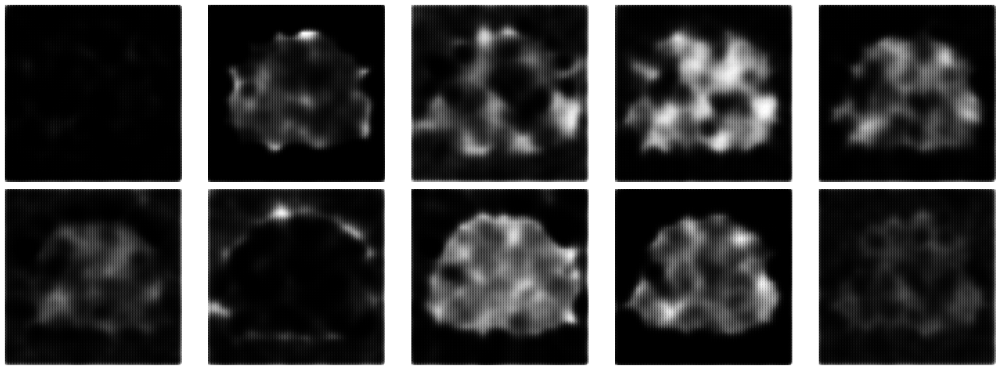

  0%|                                                                                                                        | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 1/3750 [00:00<07:12,  8.66it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                                                                                                | 2/3750 [00:00<06:50,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 3/3750 [00:00<06:45,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                                                                                                | 4/3750 [00:00<06:41,  9.33it/s]

1/1 [==============================] - 0s 11ms/step


  0%|▏                                                                                                               | 5/3750 [00:00<06:46,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 6/3750 [00:00<06:46,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 7/3750 [00:00<06:43,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 8/3750 [00:00<06:41,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                               | 9/3750 [00:00<06:42,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                              | 10/3750 [00:01<06:40,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                              | 11/3750 [00:01<06:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                              | 12/3750 [00:01<06:38,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▍                                                                                                              | 13/3750 [00:01<06:38,  9.39it/s]

1/1 [==============================] - 0s 11ms/step


  0%|▍                                                                                                              | 14/3750 [00:01<06:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 15/3750 [00:01<06:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 16/3750 [00:01<06:43,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▌                                                                                                              | 17/3750 [00:01<06:41,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▌                                                                                                              | 18/3750 [00:01<06:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 19/3750 [00:02<06:39,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                                                                                              | 20/3750 [00:02<06:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                                                                                              | 21/3750 [00:02<06:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▋                                                                                                              | 22/3750 [00:02<06:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 23/3750 [00:02<06:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 24/3750 [00:02<06:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 25/3750 [00:02<06:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 26/3750 [00:02<06:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 27/3750 [00:02<06:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▊                                                                                                              | 28/3750 [00:03<06:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▊                                                                                                              | 29/3750 [00:03<06:36,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▉                                                                                                              | 30/3750 [00:03<06:35,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▉                                                                                                              | 31/3750 [00:03<06:57,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 32/3750 [00:03<06:52,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 33/3750 [00:03<06:47,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 34/3750 [00:03<06:43,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█                                                                                                              | 35/3750 [00:03<06:43,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█                                                                                                              | 36/3750 [00:03<06:40,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█                                                                                                              | 37/3750 [00:03<06:37,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█                                                                                                              | 38/3750 [00:04<06:36,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 39/3750 [00:04<06:35,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▏                                                                                                             | 40/3750 [00:04<06:35,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 41/3750 [00:04<06:36,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▏                                                                                                             | 42/3750 [00:04<06:35,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 43/3750 [00:04<06:34,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 44/3750 [00:04<06:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 45/3750 [00:04<06:37,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 46/3750 [00:04<06:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 47/3750 [00:05<06:37,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 48/3750 [00:05<06:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 49/3750 [00:05<06:35,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 50/3750 [00:05<06:34,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 51/3750 [00:05<06:33,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 52/3750 [00:05<06:33,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 53/3750 [00:05<06:40,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 54/3750 [00:05<06:37,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▋                                                                                                             | 55/3750 [00:05<06:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▋                                                                                                             | 56/3750 [00:06<06:34,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▋                                                                                                             | 57/3750 [00:06<06:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▋                                                                                                             | 58/3750 [00:06<06:33,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▋                                                                                                             | 59/3750 [00:06<06:33,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 60/3750 [00:06<06:32,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 61/3750 [00:06<06:31,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▊                                                                                                             | 62/3750 [00:06<06:33,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 63/3750 [00:06<06:35,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 64/3750 [00:06<06:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 65/3750 [00:06<06:33,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 66/3750 [00:07<06:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▉                                                                                                             | 67/3750 [00:07<06:32,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██                                                                                                             | 68/3750 [00:07<06:31,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██                                                                                                             | 69/3750 [00:07<06:31,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 70/3750 [00:07<06:31,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██                                                                                                             | 71/3750 [00:07<06:31,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▏                                                                                                            | 72/3750 [00:07<06:31,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 73/3750 [00:07<06:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 74/3750 [00:07<06:32,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 75/3750 [00:08<06:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 76/3750 [00:08<06:34,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▎                                                                                                            | 77/3750 [00:08<06:33,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 78/3750 [00:08<06:32,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


  2%|██▎                                                                                                            | 79/3750 [00:08<06:34,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


  2%|██▎                                                                                                            | 80/3750 [00:08<06:36,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 81/3750 [00:08<06:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 82/3750 [00:08<06:35,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▍                                                                                                            | 83/3750 [00:08<06:34,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▍                                                                                                            | 84/3750 [00:09<06:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 85/3750 [00:09<06:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 86/3750 [00:09<06:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 87/3750 [00:09<06:30,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 88/3750 [00:09<06:30,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▋                                                                                                            | 89/3750 [00:09<06:30,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▋                                                                                                            | 90/3750 [00:09<06:29,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▋                                                                                                            | 91/3750 [00:09<06:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 92/3750 [00:09<06:30,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▊                                                                                                            | 93/3750 [00:09<06:29,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▊                                                                                                            | 94/3750 [00:10<06:29,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▊                                                                                                            | 95/3750 [00:10<06:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▊                                                                                                            | 96/3750 [00:10<06:27,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 97/3750 [00:10<06:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▉                                                                                                            | 98/3750 [00:10<06:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▉                                                                                                            | 99/3750 [00:10<06:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▉                                                                                                           | 100/3750 [00:10<06:28,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                           | 101/3750 [00:10<06:31,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                           | 102/3750 [00:10<06:31,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 103/3750 [00:11<06:30,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 104/3750 [00:11<06:30,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███                                                                                                           | 105/3750 [00:11<06:29,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███                                                                                                           | 106/3750 [00:11<06:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▏                                                                                                          | 107/3750 [00:11<06:27,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 108/3750 [00:11<06:29,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▏                                                                                                          | 109/3750 [00:11<06:28,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▏                                                                                                          | 110/3750 [00:11<06:30,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 111/3750 [00:11<06:29,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 112/3750 [00:11<06:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 113/3750 [00:12<06:33,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 114/3750 [00:12<06:31,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 115/3750 [00:12<06:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 116/3750 [00:12<06:31,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 117/3750 [00:12<06:36,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 118/3750 [00:12<06:33,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 119/3750 [00:12<06:34,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 120/3750 [00:12<06:35,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 121/3750 [00:12<06:33,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 122/3750 [00:13<06:31,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 123/3750 [00:13<06:48,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


  3%|███▋                                                                                                          | 124/3750 [00:13<06:45,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▋                                                                                                          | 125/3750 [00:13<06:39,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 126/3750 [00:13<06:35,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▋                                                                                                          | 127/3750 [00:13<06:32,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▊                                                                                                          | 128/3750 [00:13<06:29,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▊                                                                                                          | 129/3750 [00:13<06:29,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 130/3750 [00:13<06:27,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▊                                                                                                          | 131/3750 [00:14<06:36,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▊                                                                                                          | 132/3750 [00:14<06:33,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 133/3750 [00:14<06:31,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▉                                                                                                          | 134/3750 [00:14<06:31,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 135/3750 [00:14<06:30,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 136/3750 [00:14<06:30,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 137/3750 [00:14<06:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 138/3750 [00:14<06:30,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 139/3750 [00:14<06:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 140/3750 [00:15<06:28,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 141/3750 [00:15<06:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▏                                                                                                         | 142/3750 [00:15<06:26,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▏                                                                                                         | 143/3750 [00:15<06:26,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 144/3750 [00:15<06:25,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▎                                                                                                         | 145/3750 [00:15<06:25,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▎                                                                                                         | 146/3750 [00:15<06:24,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▎                                                                                                         | 147/3750 [00:15<06:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 148/3750 [00:15<06:27,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 149/3750 [00:15<06:27,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 150/3750 [00:16<06:26,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▍                                                                                                         | 151/3750 [00:16<06:32,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▍                                                                                                         | 152/3750 [00:16<06:29,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▍                                                                                                         | 153/3750 [00:16<06:42,  8.94it/s]

1/1 [==============================] - 0s 19ms/step


  4%|████▌                                                                                                         | 154/3750 [00:16<07:16,  8.24it/s]

1/1 [==============================] - 0s 17ms/step


  4%|████▌                                                                                                         | 155/3750 [00:16<07:44,  7.74it/s]

1/1 [==============================] - 0s 14ms/step


  4%|████▌                                                                                                         | 156/3750 [00:16<07:42,  7.77it/s]

1/1 [==============================] - 0s 11ms/step


  4%|████▌                                                                                                         | 157/3750 [00:16<07:44,  7.74it/s]

1/1 [==============================] - 0s 25ms/step


  4%|████▋                                                                                                         | 158/3750 [00:17<08:06,  7.38it/s]

1/1 [==============================] - 0s 17ms/step


  4%|████▋                                                                                                         | 159/3750 [00:17<08:13,  7.28it/s]

1/1 [==============================] - 0s 15ms/step


  4%|████▋                                                                                                         | 160/3750 [00:17<08:10,  7.32it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 161/3750 [00:17<07:39,  7.81it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▊                                                                                                         | 162/3750 [00:17<07:21,  8.13it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 163/3750 [00:17<07:04,  8.46it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 164/3750 [00:17<06:50,  8.73it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▊                                                                                                         | 165/3750 [00:17<06:42,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▊                                                                                                         | 166/3750 [00:18<06:43,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▉                                                                                                         | 167/3750 [00:18<06:37,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▉                                                                                                         | 168/3750 [00:18<06:38,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


  5%|████▉                                                                                                         | 169/3750 [00:18<06:34,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


  5%|████▉                                                                                                         | 170/3750 [00:18<06:30,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 171/3750 [00:18<06:27,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████                                                                                                         | 172/3750 [00:18<06:26,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 173/3750 [00:18<06:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 174/3750 [00:18<06:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 175/3750 [00:19<06:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 176/3750 [00:19<06:35,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 177/3750 [00:19<06:32,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▏                                                                                                        | 178/3750 [00:19<06:30,  9.16it/s]

1/1 [==============================] - 0s 11ms/step


  5%|█████▎                                                                                                        | 179/3750 [00:19<06:32,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 180/3750 [00:19<06:27,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 181/3750 [00:19<06:28,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▎                                                                                                        | 182/3750 [00:19<06:25,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 183/3750 [00:19<06:26,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 184/3750 [00:20<06:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 185/3750 [00:20<06:25,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 186/3750 [00:20<06:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 187/3750 [00:20<06:27,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▌                                                                                                        | 188/3750 [00:20<06:24,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 189/3750 [00:20<06:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▌                                                                                                        | 190/3750 [00:20<06:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▌                                                                                                        | 191/3750 [00:20<06:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 192/3750 [00:20<06:22,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▋                                                                                                        | 193/3750 [00:20<06:21,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▋                                                                                                        | 194/3750 [00:21<06:24,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 195/3750 [00:21<06:25,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 196/3750 [00:21<06:24,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 197/3750 [00:21<06:22,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▊                                                                                                        | 198/3750 [00:21<06:23,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 199/3750 [00:21<06:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 200/3750 [00:21<06:25,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 201/3750 [00:21<06:24,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 202/3750 [00:21<06:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 203/3750 [00:22<06:21,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 204/3750 [00:22<06:20,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██████                                                                                                        | 205/3750 [00:22<06:22,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██████                                                                                                        | 206/3750 [00:22<06:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████                                                                                                        | 207/3750 [00:22<06:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████                                                                                                        | 208/3750 [00:22<06:28,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 209/3750 [00:22<06:24,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 210/3750 [00:22<06:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 211/3750 [00:22<06:22,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 212/3750 [00:23<06:21,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 213/3750 [00:23<06:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▎                                                                                                       | 214/3750 [00:23<06:21,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 215/3750 [00:23<06:20,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 216/3750 [00:23<06:19,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 217/3750 [00:23<06:17,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 218/3750 [00:23<06:17,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 219/3750 [00:23<06:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 220/3750 [00:23<06:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 221/3750 [00:24<06:17,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▌                                                                                                       | 222/3750 [00:24<06:16,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 223/3750 [00:24<06:19,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 224/3750 [00:24<06:20,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 225/3750 [00:24<06:17,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▋                                                                                                       | 226/3750 [00:24<06:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 227/3750 [00:24<06:15,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▋                                                                                                       | 228/3750 [00:24<06:17,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 229/3750 [00:24<06:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 230/3750 [00:24<06:20,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 231/3750 [00:25<06:26,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▊                                                                                                       | 232/3750 [00:25<06:29,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▊                                                                                                       | 233/3750 [00:25<06:25,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 234/3750 [00:25<06:22,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 235/3750 [00:25<06:19,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 236/3750 [00:25<06:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 237/3750 [00:25<06:17,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 238/3750 [00:25<06:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 239/3750 [00:25<06:15,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 240/3750 [00:26<06:14,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


  6%|███████                                                                                                       | 241/3750 [00:26<06:19,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


  6%|███████                                                                                                       | 242/3750 [00:26<06:19,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████▏                                                                                                      | 243/3750 [00:26<06:21,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 244/3750 [00:26<06:18,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 245/3750 [00:26<06:20,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 246/3750 [00:26<06:20,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


  7%|███████▏                                                                                                      | 247/3750 [00:26<06:28,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 248/3750 [00:26<06:25,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 249/3750 [00:27<06:22,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▎                                                                                                      | 250/3750 [00:27<06:19,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 251/3750 [00:27<06:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 252/3750 [00:27<06:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 253/3750 [00:27<06:18,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 254/3750 [00:27<06:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 255/3750 [00:27<06:15,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 256/3750 [00:27<06:16,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 257/3750 [00:27<06:15,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▌                                                                                                      | 258/3750 [00:28<06:16,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▌                                                                                                      | 259/3750 [00:28<06:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 260/3750 [00:28<06:13,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 261/3750 [00:28<06:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 262/3750 [00:28<06:22,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 263/3750 [00:28<06:18,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 264/3750 [00:28<06:16,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 265/3750 [00:28<06:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 266/3750 [00:28<06:13,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 267/3750 [00:28<06:13,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▊                                                                                                      | 268/3750 [00:29<06:12,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▉                                                                                                      | 269/3750 [00:29<06:12,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


  7%|███████▉                                                                                                      | 270/3750 [00:29<06:13,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▉                                                                                                      | 271/3750 [00:29<06:11,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▉                                                                                                      | 272/3750 [00:29<06:15,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 273/3750 [00:29<06:13,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 274/3750 [00:29<06:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 275/3750 [00:29<06:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 276/3750 [00:29<06:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 277/3750 [00:30<06:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 278/3750 [00:30<06:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 279/3750 [00:30<06:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 280/3750 [00:30<06:11,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 281/3750 [00:30<06:13,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 282/3750 [00:30<06:14,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 283/3750 [00:30<06:14,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 284/3750 [00:30<06:13,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 285/3750 [00:30<06:18,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 286/3750 [00:31<06:17,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 287/3750 [00:31<06:23,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


  8%|████████▍                                                                                                     | 288/3750 [00:31<06:26,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


  8%|████████▍                                                                                                     | 289/3750 [00:31<06:25,  8.97it/s]

1/1 [==============================] - 0s 18ms/step


  8%|████████▌                                                                                                     | 290/3750 [00:31<06:37,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 291/3750 [00:31<06:35,  8.74it/s]

1/1 [==============================] - 0s 18ms/step


  8%|████████▌                                                                                                     | 292/3750 [00:31<06:52,  8.38it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 293/3750 [00:31<07:03,  8.17it/s]

1/1 [==============================] - 0s 10ms/step


  8%|████████▌                                                                                                     | 294/3750 [00:31<07:05,  8.13it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 295/3750 [00:32<07:20,  7.84it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 296/3750 [00:32<07:09,  8.04it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 297/3750 [00:32<06:51,  8.38it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▋                                                                                                     | 298/3750 [00:32<06:38,  8.66it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▊                                                                                                     | 299/3750 [00:32<06:29,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 300/3750 [00:32<06:25,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 301/3750 [00:32<06:19,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 302/3750 [00:32<06:17,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 303/3750 [00:32<06:14,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 304/3750 [00:33<06:12,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


  8%|████████▉                                                                                                     | 305/3750 [00:33<06:16,  9.15it/s]

1/1 [==============================] - 0s 26ms/step


  8%|████████▉                                                                                                     | 306/3750 [00:33<06:45,  8.49it/s]

1/1 [==============================] - 0s 12ms/step


  8%|█████████                                                                                                     | 307/3750 [00:33<07:44,  7.40it/s]

1/1 [==============================] - 0s 10ms/step


  8%|█████████                                                                                                     | 308/3750 [00:33<07:20,  7.82it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 309/3750 [00:33<07:00,  8.18it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████                                                                                                     | 310/3750 [00:33<06:44,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 311/3750 [00:33<06:33,  8.73it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 312/3750 [00:34<06:25,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 313/3750 [00:34<06:19,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 314/3750 [00:34<06:14,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▏                                                                                                    | 315/3750 [00:34<06:11,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▎                                                                                                    | 316/3750 [00:34<06:09,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▎                                                                                                    | 317/3750 [00:34<06:07,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████▎                                                                                                    | 318/3750 [00:34<06:06,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▎                                                                                                    | 319/3750 [00:34<06:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 320/3750 [00:34<06:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 321/3750 [00:35<06:07,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 322/3750 [00:35<06:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 323/3750 [00:35<06:05,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 324/3750 [00:35<06:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 325/3750 [00:35<06:04,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 326/3750 [00:35<06:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 327/3750 [00:35<06:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 328/3750 [00:35<06:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 329/3750 [00:35<06:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 330/3750 [00:35<06:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 331/3750 [00:36<06:06,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 332/3750 [00:36<06:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 333/3750 [00:36<06:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 334/3750 [00:36<06:04,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▊                                                                                                    | 335/3750 [00:36<06:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 336/3750 [00:36<06:11,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 337/3750 [00:36<06:09,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▉                                                                                                    | 338/3750 [00:36<06:09,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 339/3750 [00:36<06:08,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 340/3750 [00:37<06:08,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 341/3750 [00:37<06:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 342/3750 [00:37<06:07,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 343/3750 [00:37<06:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 344/3750 [00:37<06:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 345/3750 [00:37<06:03,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 346/3750 [00:37<06:03,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▏                                                                                                   | 347/3750 [00:37<06:06,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 348/3750 [00:37<06:04,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▏                                                                                                   | 349/3750 [00:38<06:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▎                                                                                                   | 350/3750 [00:38<06:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 351/3750 [00:38<06:02,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 352/3750 [00:38<06:02,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▎                                                                                                   | 353/3750 [00:38<06:06,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▍                                                                                                   | 354/3750 [00:38<06:04,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▍                                                                                                   | 355/3750 [00:38<06:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▍                                                                                                   | 356/3750 [00:38<06:02,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▍                                                                                                   | 357/3750 [00:38<06:03,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▌                                                                                                   | 358/3750 [00:38<06:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▌                                                                                                   | 359/3750 [00:39<06:02,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 360/3750 [00:39<06:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▌                                                                                                   | 361/3750 [00:39<06:02,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 362/3750 [00:39<06:01,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▋                                                                                                   | 363/3750 [00:39<06:00,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 364/3750 [00:39<06:00,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 365/3750 [00:39<06:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 366/3750 [00:39<06:03,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 367/3750 [00:39<06:02,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▊                                                                                                   | 368/3750 [00:40<06:01,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 369/3750 [00:40<06:01,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 370/3750 [00:40<06:00,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▉                                                                                                   | 371/3750 [00:40<06:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 372/3750 [00:40<06:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▉                                                                                                   | 373/3750 [00:40<05:59,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▉                                                                                                   | 374/3750 [00:40<05:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 375/3750 [00:40<05:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 376/3750 [00:40<06:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 377/3750 [00:41<06:01,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 378/3750 [00:41<06:01,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 379/3750 [00:41<06:01,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 380/3750 [00:41<06:00,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 381/3750 [00:41<06:05,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███████████▏                                                                                                  | 382/3750 [00:41<06:05,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 383/3750 [00:41<06:03,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 384/3750 [00:41<06:01,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 385/3750 [00:41<06:02,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▎                                                                                                  | 386/3750 [00:41<06:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▎                                                                                                  | 387/3750 [00:42<06:01,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 388/3750 [00:42<06:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 389/3750 [00:42<06:00,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 390/3750 [00:42<05:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 391/3750 [00:42<06:00,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 392/3750 [00:42<05:59,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▌                                                                                                  | 393/3750 [00:42<05:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▌                                                                                                  | 394/3750 [00:42<05:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▌                                                                                                  | 395/3750 [00:42<06:01,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▌                                                                                                  | 396/3750 [00:43<05:59,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▋                                                                                                  | 397/3750 [00:43<05:58,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 398/3750 [00:43<05:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 399/3750 [00:43<05:56,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 400/3750 [00:43<05:56,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 401/3750 [00:43<05:56,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 402/3750 [00:43<05:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 403/3750 [00:43<05:55,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 404/3750 [00:43<05:54,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 405/3750 [00:44<05:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 406/3750 [00:44<05:57,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 407/3750 [00:44<05:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 408/3750 [00:44<05:55,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 409/3750 [00:44<05:56,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 410/3750 [00:44<05:55,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 411/3750 [00:44<05:54,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 412/3750 [00:44<05:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 413/3750 [00:44<05:56,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▏                                                                                                 | 414/3750 [00:44<05:59,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▏                                                                                                 | 415/3750 [00:45<05:59,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▏                                                                                                 | 416/3750 [00:45<05:58,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 417/3750 [00:45<05:57,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 418/3750 [00:45<06:01,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 419/3750 [00:45<06:03,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 420/3750 [00:45<06:02,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 421/3750 [00:45<05:59,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 422/3750 [00:45<06:00,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 423/3750 [00:45<05:59,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 424/3750 [00:46<06:00,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 425/3750 [00:46<05:59,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 426/3750 [00:46<05:59,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 427/3750 [00:46<05:58,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▌                                                                                                 | 428/3750 [00:46<05:57,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 429/3750 [00:46<05:56,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▌                                                                                                 | 430/3750 [00:46<05:55,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▋                                                                                                 | 431/3750 [00:46<05:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▋                                                                                                 | 432/3750 [00:46<05:55,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▋                                                                                                 | 433/3750 [00:47<05:58,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▋                                                                                                 | 434/3750 [00:47<05:59,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 435/3750 [00:47<05:57,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 436/3750 [00:47<05:57,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 437/3750 [00:47<05:58,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 438/3750 [00:47<06:04,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 439/3750 [00:47<06:01,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 440/3750 [00:47<05:59,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 441/3750 [00:47<05:57,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 442/3750 [00:48<06:02,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 443/3750 [00:48<06:01,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 12%|█████████████                                                                                                 | 444/3750 [00:48<10:24,  5.29it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 445/3750 [00:48<09:03,  6.08it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 446/3750 [00:48<08:07,  6.78it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 447/3750 [00:48<07:27,  7.38it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 448/3750 [00:48<06:58,  7.88it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 449/3750 [00:49<06:41,  8.22it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 450/3750 [00:49<06:27,  8.52it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 451/3750 [00:49<06:17,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 452/3750 [00:49<06:11,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 453/3750 [00:49<06:06,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 454/3750 [00:49<06:02,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 455/3750 [00:49<06:00,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 456/3750 [00:49<05:57,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 457/3750 [00:49<05:55,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 458/3750 [00:49<05:55,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 459/3750 [00:50<05:56,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 12%|█████████████▍                                                                                                | 460/3750 [00:50<05:59,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 461/3750 [00:50<05:57,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 462/3750 [00:50<05:58,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 463/3750 [00:50<05:56,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 464/3750 [00:50<05:56,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 465/3750 [00:50<06:01,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 466/3750 [00:50<05:55,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 467/3750 [00:50<05:54,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 468/3750 [00:51<05:53,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 469/3750 [00:51<05:54,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 470/3750 [00:51<05:53,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 471/3750 [00:51<05:53,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 472/3750 [00:51<05:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 473/3750 [00:51<05:53,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 474/3750 [00:51<05:53,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 475/3750 [00:51<05:52,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 476/3750 [00:51<05:53,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 477/3750 [00:52<05:55,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 478/3750 [00:52<05:55,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 479/3750 [00:52<05:54,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 480/3750 [00:52<05:53,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 481/3750 [00:52<05:53,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 482/3750 [00:52<05:52,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 483/3750 [00:52<05:52,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 484/3750 [00:52<05:51,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 485/3750 [00:52<05:58,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 13%|██████████████▎                                                                                               | 486/3750 [00:53<05:57,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 13%|██████████████▎                                                                                               | 487/3750 [00:53<05:56,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 488/3750 [00:53<05:54,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 13%|██████████████▎                                                                                               | 489/3750 [00:53<05:55,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 490/3750 [00:53<05:53,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 491/3750 [00:53<05:51,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 492/3750 [00:53<05:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 493/3750 [00:53<05:51,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 494/3750 [00:53<05:50,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 13%|██████████████▌                                                                                               | 495/3750 [00:54<05:54,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 13%|██████████████▌                                                                                               | 496/3750 [00:54<05:54,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 13%|██████████████▌                                                                                               | 497/3750 [00:54<05:56,  9.13it/s]

1/1 [==============================] - 0s 11ms/step


 13%|██████████████▌                                                                                               | 498/3750 [00:54<05:57,  9.10it/s]

1/1 [==============================] - 0s 11ms/step


 13%|██████████████▋                                                                                               | 499/3750 [00:54<05:57,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▋                                                                                               | 500/3750 [00:54<05:55,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▋                                                                                               | 501/3750 [00:54<05:53,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▋                                                                                               | 502/3750 [00:54<05:52,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 503/3750 [00:54<05:50,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 504/3750 [00:54<05:50,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 505/3750 [00:55<05:52,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 506/3750 [00:55<05:52,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▊                                                                                               | 507/3750 [00:55<05:53,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 508/3750 [00:55<05:52,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 14%|██████████████▉                                                                                               | 509/3750 [00:55<05:54,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 14%|██████████████▉                                                                                               | 510/3750 [00:55<05:55,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 14%|██████████████▉                                                                                               | 511/3750 [00:55<05:56,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 512/3750 [00:55<05:55,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 513/3750 [00:55<05:53,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 14%|███████████████                                                                                               | 514/3750 [00:56<05:56,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 14%|███████████████                                                                                               | 515/3750 [00:56<05:55,  9.10it/s]

1/1 [==============================] - 0s 11ms/step


 14%|███████████████▏                                                                                              | 516/3750 [00:56<05:55,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▏                                                                                              | 517/3750 [00:56<05:53,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▏                                                                                              | 518/3750 [00:56<05:52,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▏                                                                                              | 519/3750 [00:56<05:52,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 520/3750 [00:56<05:50,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 521/3750 [00:56<05:49,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▎                                                                                              | 522/3750 [00:56<05:53,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 14%|███████████████▎                                                                                              | 523/3750 [00:57<05:55,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 14%|███████████████▎                                                                                              | 524/3750 [00:57<05:54,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 525/3750 [00:57<05:53,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 14%|███████████████▍                                                                                              | 526/3750 [00:57<05:54,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 527/3750 [00:57<05:51,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 528/3750 [00:57<05:50,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▌                                                                                              | 529/3750 [00:57<05:48,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▌                                                                                              | 530/3750 [00:57<05:46,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▌                                                                                              | 531/3750 [00:57<05:46,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▌                                                                                              | 532/3750 [00:58<05:45,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▋                                                                                              | 533/3750 [00:58<05:47,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▋                                                                                              | 534/3750 [00:58<05:47,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▋                                                                                              | 535/3750 [00:58<05:48,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▋                                                                                              | 536/3750 [00:58<05:47,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 537/3750 [00:58<05:46,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 538/3750 [00:58<05:45,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 539/3750 [00:58<05:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 540/3750 [00:58<05:43,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 541/3750 [00:59<05:44,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▉                                                                                              | 542/3750 [00:59<05:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▉                                                                                              | 543/3750 [00:59<05:46,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 15%|███████████████▉                                                                                              | 544/3750 [00:59<05:47,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 15%|███████████████▉                                                                                              | 545/3750 [00:59<05:47,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 546/3750 [00:59<05:45,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 547/3750 [00:59<05:44,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 548/3750 [00:59<05:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 549/3750 [00:59<05:43,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 550/3750 [00:59<05:42,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 551/3750 [01:00<05:49,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 552/3750 [01:00<05:49,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 553/3750 [01:00<05:48,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 554/3750 [01:00<05:46,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 555/3750 [01:00<05:44,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 556/3750 [01:00<05:44,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 557/3750 [01:00<05:43,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 558/3750 [01:00<05:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 559/3750 [01:00<05:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 560/3750 [01:01<05:41,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 561/3750 [01:01<05:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 562/3750 [01:01<05:43,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 563/3750 [01:01<05:43,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 564/3750 [01:01<05:43,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 565/3750 [01:01<05:42,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 566/3750 [01:01<05:43,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 567/3750 [01:01<05:43,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 568/3750 [01:01<05:43,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 569/3750 [01:02<05:45,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 15%|████████████████▋                                                                                             | 570/3750 [01:02<05:44,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 571/3750 [01:02<05:49,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 572/3750 [01:02<05:46,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 573/3750 [01:02<05:50,  9.07it/s]

1/1 [==============================] - 0s 11ms/step


 15%|████████████████▊                                                                                             | 574/3750 [01:02<05:51,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 15%|████████████████▊                                                                                             | 575/3750 [01:02<05:51,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▉                                                                                             | 576/3750 [01:02<05:49,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▉                                                                                             | 577/3750 [01:02<05:46,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 578/3750 [01:03<05:43,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▉                                                                                             | 579/3750 [01:03<05:42,  9.27it/s]

1/1 [==============================] - 0s 11ms/step


 15%|█████████████████                                                                                             | 580/3750 [01:03<05:43,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████████████████                                                                                             | 581/3750 [01:03<05:44,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████                                                                                             | 582/3750 [01:03<05:43,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████                                                                                             | 583/3750 [01:03<05:42,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 584/3750 [01:03<05:41,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 585/3750 [01:03<05:40,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 586/3750 [01:03<05:44,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 587/3750 [01:03<05:41,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 588/3750 [01:04<05:39,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 589/3750 [01:04<05:38,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 590/3750 [01:04<05:40,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▎                                                                                            | 591/3750 [01:04<05:40,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 592/3750 [01:04<05:38,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 593/3750 [01:04<05:37,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 594/3750 [01:04<05:37,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▍                                                                                            | 595/3750 [01:04<05:36,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 596/3750 [01:04<05:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▌                                                                                            | 597/3750 [01:05<05:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▌                                                                                            | 598/3750 [01:05<05:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▌                                                                                            | 599/3750 [01:05<05:41,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▌                                                                                            | 600/3750 [01:05<05:41,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 601/3750 [01:05<05:40,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 602/3750 [01:05<05:38,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 603/3750 [01:05<05:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 604/3750 [01:05<05:36,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 605/3750 [01:05<05:35,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 606/3750 [01:06<05:35,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 607/3750 [01:06<05:35,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 608/3750 [01:06<05:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 609/3750 [01:06<05:41,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 610/3750 [01:06<05:40,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 611/3750 [01:06<05:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 612/3750 [01:06<05:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 613/3750 [01:06<05:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 614/3750 [01:06<05:35,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 615/3750 [01:06<05:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 616/3750 [01:07<05:34,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 617/3750 [01:07<05:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████▏                                                                                           | 618/3750 [01:07<05:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 619/3750 [01:07<05:37,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 620/3750 [01:07<05:36,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 621/3750 [01:07<05:35,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████████████████▏                                                                                           | 622/3750 [01:07<05:37,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 623/3750 [01:07<05:38,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 624/3750 [01:07<05:37,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 625/3750 [01:08<05:38,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 626/3750 [01:08<05:43,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 627/3750 [01:08<05:40,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 628/3750 [01:08<05:38,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 629/3750 [01:08<05:39,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 630/3750 [01:08<05:37,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 631/3750 [01:08<05:35,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 632/3750 [01:08<05:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 633/3750 [01:08<05:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 634/3750 [01:09<05:34,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 635/3750 [01:09<05:33,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 636/3750 [01:09<05:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 637/3750 [01:09<05:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 638/3750 [01:09<05:35,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 639/3750 [01:09<05:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▊                                                                                           | 640/3750 [01:09<05:34,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▊                                                                                           | 641/3750 [01:09<05:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▊                                                                                           | 642/3750 [01:09<05:32,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▊                                                                                           | 643/3750 [01:10<05:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▉                                                                                           | 644/3750 [01:10<05:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▉                                                                                           | 645/3750 [01:10<05:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▉                                                                                           | 646/3750 [01:10<05:37,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 647/3750 [01:10<05:35,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████                                                                                           | 648/3750 [01:10<05:36,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████                                                                                           | 649/3750 [01:10<05:35,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████                                                                                           | 650/3750 [01:10<05:34,  9.27it/s]

1/1 [==============================] - 0s 11ms/step


 17%|███████████████████                                                                                           | 651/3750 [01:10<05:35,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 652/3750 [01:10<05:37,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 653/3750 [01:11<05:36,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 654/3750 [01:11<05:35,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 655/3750 [01:11<05:34,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 656/3750 [01:11<05:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 657/3750 [01:11<05:33,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 658/3750 [01:11<05:35,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 659/3750 [01:11<05:35,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 660/3750 [01:11<05:34,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 661/3750 [01:11<05:35,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 662/3750 [01:12<05:35,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 663/3750 [01:12<05:34,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 664/3750 [01:12<05:33,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 665/3750 [01:12<05:32,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 666/3750 [01:12<05:35,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 667/3750 [01:12<05:35,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 668/3750 [01:12<05:33,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 669/3750 [01:12<05:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 670/3750 [01:12<05:33,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 671/3750 [01:13<05:33,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 672/3750 [01:13<05:31,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 673/3750 [01:13<05:30,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 674/3750 [01:13<05:30,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 675/3750 [01:13<05:30,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 676/3750 [01:13<05:30,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 677/3750 [01:13<05:33,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 678/3750 [01:13<05:32,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 679/3750 [01:13<05:36,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 680/3750 [01:14<05:33,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▉                                                                                          | 681/3750 [01:14<05:32,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 682/3750 [01:14<05:31,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 683/3750 [01:14<05:30,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 684/3750 [01:14<05:28,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 685/3750 [01:14<05:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 686/3750 [01:14<05:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 687/3750 [01:14<05:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 688/3750 [01:14<05:31,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████▏                                                                                         | 689/3750 [01:14<05:30,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 18%|████████████████████▏                                                                                         | 690/3750 [01:15<05:30,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 691/3750 [01:15<05:30,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 692/3750 [01:15<05:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 693/3750 [01:15<05:28,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▎                                                                                         | 694/3750 [01:15<05:27,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▍                                                                                         | 695/3750 [01:15<05:27,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 696/3750 [01:15<05:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 697/3750 [01:15<05:31,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 698/3750 [01:15<05:29,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 699/3750 [01:16<05:28,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 700/3750 [01:16<05:28,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 701/3750 [01:16<05:29,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 702/3750 [01:16<05:28,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 703/3750 [01:16<05:27,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 704/3750 [01:16<05:27,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 705/3750 [01:16<05:28,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 706/3750 [01:16<05:27,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 707/3750 [01:16<05:27,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 708/3750 [01:17<05:27,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 709/3750 [01:17<05:44,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 710/3750 [01:17<05:39,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 711/3750 [01:17<05:36,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 712/3750 [01:17<05:33,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 713/3750 [01:17<05:31,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 714/3750 [01:17<05:30,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▉                                                                                         | 715/3750 [01:17<05:31,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 716/3750 [01:17<05:29,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 717/3750 [01:18<05:28,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 718/3750 [01:18<05:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 719/3750 [01:18<05:27,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 720/3750 [01:18<05:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 721/3750 [01:18<05:26,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 722/3750 [01:18<05:25,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▏                                                                                        | 723/3750 [01:18<05:24,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 724/3750 [01:18<05:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 725/3750 [01:18<05:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 726/3750 [01:18<05:24,  9.31it/s]

1/1 [==============================] - 0s 11ms/step


 19%|█████████████████████▎                                                                                        | 727/3750 [01:19<05:26,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 19%|█████████████████████▎                                                                                        | 728/3750 [01:19<05:29,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▍                                                                                        | 729/3750 [01:19<05:28,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▍                                                                                        | 730/3750 [01:19<05:27,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▍                                                                                        | 731/3750 [01:19<05:25,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▍                                                                                        | 732/3750 [01:19<05:24,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▌                                                                                        | 733/3750 [01:19<05:24,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▌                                                                                        | 734/3750 [01:19<05:26,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 735/3750 [01:19<05:26,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▌                                                                                        | 736/3750 [01:20<05:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 737/3750 [01:20<05:23,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 738/3750 [01:20<05:22,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 739/3750 [01:20<05:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▋                                                                                        | 740/3750 [01:20<05:22,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 741/3750 [01:20<05:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 742/3750 [01:20<05:22,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 743/3750 [01:20<05:21,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 744/3750 [01:20<05:23,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 745/3750 [01:21<05:23,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 746/3750 [01:21<05:27,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 747/3750 [01:21<05:25,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 748/3750 [01:21<05:24,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 749/3750 [01:21<05:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 750/3750 [01:21<05:23,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 751/3750 [01:21<05:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 752/3750 [01:21<05:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 753/3750 [01:21<05:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 754/3750 [01:22<05:23,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▏                                                                                       | 755/3750 [01:22<05:22,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 756/3750 [01:22<05:24,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▏                                                                                       | 757/3750 [01:22<05:23,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 758/3750 [01:22<05:22,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 759/3750 [01:22<05:21,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 760/3750 [01:22<05:19,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 761/3750 [01:22<05:24,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▎                                                                                       | 762/3750 [01:22<05:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 763/3750 [01:22<05:22,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 764/3750 [01:23<05:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 765/3750 [01:23<05:20,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 766/3750 [01:23<05:20,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 767/3750 [01:23<05:20,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▌                                                                                       | 768/3750 [01:23<05:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▌                                                                                       | 769/3750 [01:23<05:18,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 21%|██████████████████████▌                                                                                       | 770/3750 [01:23<05:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▌                                                                                       | 771/3750 [01:23<05:21,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 772/3750 [01:23<05:23,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 773/3750 [01:24<05:22,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 774/3750 [01:24<05:21,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▋                                                                                       | 775/3750 [01:24<05:20,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 776/3750 [01:24<05:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 777/3750 [01:24<05:19,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 778/3750 [01:24<05:19,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▊                                                                                       | 779/3750 [01:24<05:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 780/3750 [01:24<05:20,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 21%|██████████████████████▉                                                                                       | 781/3750 [01:24<05:23,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 782/3750 [01:25<05:23,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 783/3750 [01:25<05:23,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 784/3750 [01:25<05:23,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 785/3750 [01:25<05:20,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 786/3750 [01:25<05:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 787/3750 [01:25<05:18,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 788/3750 [01:25<05:17,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 789/3750 [01:25<05:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 790/3750 [01:25<05:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 791/3750 [01:25<05:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 792/3750 [01:26<05:18,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 793/3750 [01:26<05:23,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 21%|███████████████████████▎                                                                                      | 794/3750 [01:26<05:21,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 795/3750 [01:26<05:21,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 796/3750 [01:26<05:19,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 797/3750 [01:26<05:18,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 798/3750 [01:26<05:16,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 799/3750 [01:26<05:16,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 800/3750 [01:26<05:15,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 801/3750 [01:27<05:17,  9.29it/s]

1/1 [==============================] - 0s 11ms/step


 21%|███████████████████████▌                                                                                      | 802/3750 [01:27<05:18,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 803/3750 [01:27<05:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 804/3750 [01:27<05:18,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 805/3750 [01:27<05:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▋                                                                                      | 806/3750 [01:27<05:15,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 807/3750 [01:27<05:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 808/3750 [01:27<05:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▋                                                                                      | 809/3750 [01:27<05:13,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 810/3750 [01:28<05:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 811/3750 [01:28<05:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 812/3750 [01:28<05:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 813/3750 [01:28<05:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 814/3750 [01:28<05:20,  9.16it/s]

1/1 [==============================] - 0s 16ms/step


 22%|███████████████████████▉                                                                                      | 815/3750 [01:28<05:27,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 22%|███████████████████████▉                                                                                      | 816/3750 [01:28<05:25,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 817/3750 [01:28<05:23,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 818/3750 [01:28<05:19,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 819/3750 [01:29<05:18,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 820/3750 [01:29<05:18,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 821/3750 [01:29<05:16,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 822/3750 [01:29<05:16,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▏                                                                                     | 823/3750 [01:29<05:16,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 824/3750 [01:29<05:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 825/3750 [01:29<05:13,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 826/3750 [01:29<05:12,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 827/3750 [01:29<05:13,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 828/3750 [01:29<05:12,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 829/3750 [01:30<05:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 830/3750 [01:30<05:12,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 831/3750 [01:30<05:12,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 832/3750 [01:30<05:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 833/3750 [01:30<05:11,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 834/3750 [01:30<05:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 835/3750 [01:30<05:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 836/3750 [01:30<05:09,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 837/3750 [01:30<05:09,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 838/3750 [01:31<05:12,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████████████████████▌                                                                                     | 839/3750 [01:31<05:19,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 840/3750 [01:31<05:18,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 841/3750 [01:31<05:16,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 842/3750 [01:31<05:15,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 843/3750 [01:31<05:15,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 844/3750 [01:31<05:14,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 845/3750 [01:31<05:13,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 846/3750 [01:31<05:13,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 847/3750 [01:32<05:12,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 848/3750 [01:32<05:14,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 849/3750 [01:32<05:12,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 850/3750 [01:32<05:12,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 851/3750 [01:32<05:12,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▉                                                                                     | 852/3750 [01:32<05:11,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 853/3750 [01:32<05:10,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 854/3750 [01:32<05:09,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 855/3750 [01:32<05:08,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 856/3750 [01:32<05:08,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▏                                                                                    | 857/3750 [01:33<05:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 858/3750 [01:33<05:11,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 859/3750 [01:33<05:10,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 860/3750 [01:33<05:10,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 861/3750 [01:33<05:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 862/3750 [01:33<05:08,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 863/3750 [01:33<05:07,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 864/3750 [01:33<05:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 865/3750 [01:33<05:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 866/3750 [01:34<05:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 867/3750 [01:34<05:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 868/3750 [01:34<05:10,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 869/3750 [01:34<05:10,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▌                                                                                    | 870/3750 [01:34<05:09,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 871/3750 [01:34<05:09,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 872/3750 [01:34<05:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 873/3750 [01:34<05:16,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▋                                                                                    | 874/3750 [01:34<05:15,  9.13it/s]

1/1 [==============================] - 0s 11ms/step


 23%|█████████████████████████▋                                                                                    | 875/3750 [01:35<05:15,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▋                                                                                    | 876/3750 [01:35<05:13,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 877/3750 [01:35<05:13,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 878/3750 [01:35<05:13,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 879/3750 [01:35<05:12,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 880/3750 [01:35<05:11,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 881/3750 [01:35<05:10,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▊                                                                                    | 882/3750 [01:35<05:09,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▉                                                                                    | 883/3750 [01:35<05:08,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▉                                                                                    | 884/3750 [01:36<05:07,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▉                                                                                    | 885/3750 [01:36<05:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 886/3750 [01:36<05:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 887/3750 [01:36<05:09,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 888/3750 [01:36<05:09,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 889/3750 [01:36<05:08,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 890/3750 [01:36<05:07,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 891/3750 [01:36<05:08,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 892/3750 [01:36<05:08,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▏                                                                                   | 893/3750 [01:36<05:07,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▏                                                                                   | 894/3750 [01:37<05:07,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 895/3750 [01:37<05:06,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 896/3750 [01:37<05:07,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 897/3750 [01:37<05:08,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 898/3750 [01:37<05:07,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▎                                                                                   | 899/3750 [01:37<05:06,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 900/3750 [01:37<05:05,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 901/3750 [01:37<05:05,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 902/3750 [01:37<05:04,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 903/3750 [01:38<05:05,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 904/3750 [01:38<05:04,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 905/3750 [01:38<05:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 906/3750 [01:38<05:06,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 907/3750 [01:38<05:05,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▋                                                                                   | 908/3750 [01:38<05:05,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 909/3750 [01:38<05:05,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 910/3750 [01:38<05:04,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 911/3750 [01:38<05:05,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 912/3750 [01:39<05:05,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 913/3750 [01:39<05:04,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 914/3750 [01:39<05:05,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 915/3750 [01:39<05:08,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 916/3750 [01:39<05:09,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▉                                                                                   | 917/3750 [01:39<05:07,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▉                                                                                   | 918/3750 [01:39<05:05,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████████████████████▉                                                                                   | 919/3750 [01:39<05:04,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████████████████████▉                                                                                   | 920/3750 [01:39<05:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████                                                                                   | 921/3750 [01:40<05:04,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████                                                                                   | 922/3750 [01:40<05:04,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 923/3750 [01:40<05:02,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 924/3750 [01:40<05:03,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 925/3750 [01:40<05:05,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 926/3750 [01:40<05:03,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 927/3750 [01:40<05:02,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 928/3750 [01:40<05:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 929/3750 [01:40<05:02,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 930/3750 [01:40<05:02,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▎                                                                                  | 931/3750 [01:41<05:02,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 932/3750 [01:41<05:01,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 933/3750 [01:41<05:02,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▍                                                                                  | 934/3750 [01:41<05:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▍                                                                                  | 935/3750 [01:41<05:02,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 936/3750 [01:41<05:01,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▍                                                                                  | 937/3750 [01:41<05:02,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 938/3750 [01:41<05:02,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 939/3750 [01:41<05:01,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 940/3750 [01:42<05:03,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 941/3750 [01:42<05:03,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 942/3750 [01:42<05:03,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 943/3750 [01:42<05:02,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 944/3750 [01:42<05:01,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 945/3750 [01:42<05:07,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 946/3750 [01:42<05:04,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 947/3750 [01:42<05:02,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 948/3750 [01:42<05:01,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 25%|███████████████████████████▊                                                                                  | 949/3750 [01:43<05:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 950/3750 [01:43<05:01,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 25%|███████████████████████████▉                                                                                  | 951/3750 [01:43<05:01,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 25%|███████████████████████████▉                                                                                  | 952/3750 [01:43<05:01,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 953/3750 [01:43<05:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 954/3750 [01:43<05:02,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 25%|████████████████████████████                                                                                  | 955/3750 [01:43<05:01,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 25%|████████████████████████████                                                                                  | 956/3750 [01:43<05:01,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████                                                                                  | 957/3750 [01:43<04:59,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████                                                                                  | 958/3750 [01:43<04:58,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 959/3750 [01:44<04:59,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 960/3750 [01:44<04:59,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 961/3750 [01:44<04:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 962/3750 [01:44<04:58,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 963/3750 [01:44<04:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 964/3750 [01:44<05:00,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 965/3750 [01:44<04:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 966/3750 [01:44<04:58,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▎                                                                                 | 967/3750 [01:44<04:57,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 968/3750 [01:45<04:57,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 969/3750 [01:45<04:57,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 970/3750 [01:45<04:58,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 971/3750 [01:45<04:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 972/3750 [01:45<04:58,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▌                                                                                 | 973/3750 [01:45<04:59,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▌                                                                                 | 974/3750 [01:45<04:58,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▌                                                                                 | 975/3750 [01:45<04:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 976/3750 [01:45<05:01,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 977/3750 [01:46<04:59,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 978/3750 [01:46<04:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 979/3750 [01:46<04:57,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 980/3750 [01:46<04:57,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▊                                                                                 | 981/3750 [01:46<04:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 982/3750 [01:46<04:56,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 983/3750 [01:46<04:58,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▊                                                                                 | 984/3750 [01:46<04:58,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 985/3750 [01:46<04:58,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▉                                                                                 | 986/3750 [01:46<04:58,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▉                                                                                 | 987/3750 [01:47<04:57,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 988/3750 [01:47<04:57,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 989/3750 [01:47<04:56,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████                                                                                 | 990/3750 [01:47<04:57,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████                                                                                 | 991/3750 [01:47<04:57,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████                                                                                 | 992/3750 [01:47<04:56,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████▏                                                                                | 993/3750 [01:47<04:58,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 994/3750 [01:47<04:57,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 995/3750 [01:47<04:56,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                                | 996/3750 [01:48<04:58,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 997/3750 [01:48<04:58,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                                | 998/3750 [01:48<04:56,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                                | 999/3750 [01:48<04:55,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████                                                                                | 1000/3750 [01:48<04:54,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████                                                                                | 1001/3750 [01:48<04:54,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████                                                                                | 1002/3750 [01:48<04:56,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                               | 1003/3750 [01:48<04:55,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▏                                                                               | 1004/3750 [01:48<04:54,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1005/3750 [01:49<04:54,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1006/3750 [01:49<04:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                               | 1007/3750 [01:49<04:54,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1008/3750 [01:49<04:54,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                               | 1009/3750 [01:49<04:54,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1010/3750 [01:49<04:53,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▍                                                                               | 1011/3750 [01:49<04:53,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1012/3750 [01:49<04:55,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1013/3750 [01:49<04:56,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1014/3750 [01:50<04:55,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1015/3750 [01:50<04:54,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1016/3750 [01:50<04:54,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1017/3750 [01:50<04:53,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1018/3750 [01:50<04:58,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1019/3750 [01:50<04:56,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▋                                                                               | 1020/3750 [01:50<04:55,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1021/3750 [01:50<04:54,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▋                                                                               | 1022/3750 [01:50<04:54,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1023/3750 [01:50<04:54,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1024/3750 [01:51<04:53,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1025/3750 [01:51<04:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1026/3750 [01:51<04:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1027/3750 [01:51<04:52,  9.31it/s]

1/1 [==============================] - 0s 12ms/step


 27%|█████████████████████████████▉                                                                               | 1028/3750 [01:51<04:56,  9.17it/s]

1/1 [==============================] - 0s 14ms/step


 27%|█████████████████████████████▉                                                                               | 1029/3750 [01:51<05:04,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 27%|█████████████████████████████▉                                                                               | 1030/3750 [01:51<05:01,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1031/3750 [01:51<05:06,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 28%|█████████████████████████████▉                                                                               | 1032/3750 [01:51<05:04,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1033/3750 [01:52<05:04,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1034/3750 [01:52<05:06,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1035/3750 [01:52<05:01,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1036/3750 [01:52<05:04,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████████████████████████▏                                                                              | 1037/3750 [01:52<05:06,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████████████████████████▏                                                                              | 1038/3750 [01:52<05:02,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1039/3750 [01:52<04:58,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1040/3750 [01:52<05:00,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1041/3750 [01:52<04:58,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1042/3750 [01:53<04:58,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1043/3750 [01:53<04:57,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1044/3750 [01:53<04:56,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1045/3750 [01:53<04:54,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▍                                                                              | 1046/3750 [01:53<04:53,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1047/3750 [01:53<04:52,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▍                                                                              | 1048/3750 [01:53<04:51,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▍                                                                              | 1049/3750 [01:53<04:53,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1050/3750 [01:53<04:53,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1051/3750 [01:54<04:53,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1052/3750 [01:54<04:51,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▌                                                                              | 1053/3750 [01:54<04:50,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▋                                                                              | 1054/3750 [01:54<04:49,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1055/3750 [01:54<04:48,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▋                                                                              | 1056/3750 [01:54<04:46,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▋                                                                              | 1057/3750 [01:54<04:46,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1058/3750 [01:54<04:45,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1059/3750 [01:54<04:47,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▊                                                                              | 1060/3750 [01:55<04:46,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1061/3750 [01:55<04:49,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1062/3750 [01:55<04:49,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1063/3750 [01:55<04:48,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1064/3750 [01:55<04:49,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1065/3750 [01:55<04:52,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1066/3750 [01:55<04:50,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████████████████████████                                                                              | 1067/3750 [01:55<04:50,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████████████████████████                                                                              | 1068/3750 [01:55<04:48,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████                                                                              | 1069/3750 [01:55<04:49,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████                                                                              | 1070/3750 [01:56<04:48,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▏                                                                             | 1071/3750 [01:56<04:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1072/3750 [01:56<04:47,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1073/3750 [01:56<04:48,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1074/3750 [01:56<04:47,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1075/3750 [01:56<04:48,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1076/3750 [01:56<04:49,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1077/3750 [01:56<04:49,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▎                                                                             | 1078/3750 [01:56<04:53,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1079/3750 [01:57<04:52,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1080/3750 [01:57<04:50,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1081/3750 [01:57<04:49,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1082/3750 [01:57<04:49,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1083/3750 [01:57<04:48,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1084/3750 [01:57<04:47,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1085/3750 [01:57<04:45,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1086/3750 [01:57<04:45,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1087/3750 [01:57<04:44,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1088/3750 [01:58<04:46,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1089/3750 [01:58<04:46,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1090/3750 [01:58<04:47,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1091/3750 [01:58<04:47,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1092/3750 [01:58<04:46,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▊                                                                             | 1093/3750 [01:58<04:46,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▊                                                                             | 1094/3750 [01:58<04:44,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▊                                                                             | 1095/3750 [01:58<04:43,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▊                                                                             | 1096/3750 [01:58<04:42,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1097/3750 [01:59<04:49,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1098/3750 [01:59<04:47,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1099/3750 [01:59<04:46,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1100/3750 [01:59<04:45,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1101/3750 [01:59<04:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1102/3750 [01:59<04:44,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 29%|████████████████████████████████                                                                             | 1103/3750 [01:59<04:45,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1104/3750 [01:59<04:45,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1105/3750 [01:59<04:44,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 29%|████████████████████████████████▏                                                                            | 1106/3750 [01:59<04:44,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▏                                                                            | 1107/3750 [02:00<04:45,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▏                                                                            | 1108/3750 [02:00<04:44,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▏                                                                            | 1109/3750 [02:00<04:47,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1110/3750 [02:00<04:46,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▎                                                                            | 1111/3750 [02:00<04:44,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1112/3750 [02:00<04:42,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▎                                                                            | 1113/3750 [02:00<04:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1114/3750 [02:00<04:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1115/3750 [02:00<04:43,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1116/3750 [02:01<04:44,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1117/3750 [02:01<04:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1118/3750 [02:01<04:43,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1119/3750 [02:01<04:44,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1120/3750 [02:01<04:44,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▌                                                                            | 1121/3750 [02:01<04:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1122/3750 [02:01<04:42,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▋                                                                            | 1123/3750 [02:01<04:44,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▋                                                                            | 1124/3750 [02:01<04:42,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1125/3750 [02:02<04:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1126/3750 [02:02<04:44,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1127/3750 [02:02<04:43,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1128/3750 [02:02<04:42,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1129/3750 [02:02<04:45,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1130/3750 [02:02<04:45,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1131/3750 [02:02<04:43,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1132/3750 [02:02<04:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1133/3750 [02:02<04:41,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▉                                                                            | 1134/3750 [02:03<04:40,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1135/3750 [02:03<04:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1136/3750 [02:03<04:41,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1137/3750 [02:03<04:41,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████                                                                            | 1138/3750 [02:03<04:41,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1139/3750 [02:03<04:41,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1140/3750 [02:03<04:40,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1141/3750 [02:03<04:39,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1142/3750 [02:03<04:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1143/3750 [02:03<04:42,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1144/3750 [02:04<04:40,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1145/3750 [02:04<04:41,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1146/3750 [02:04<04:41,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1147/3750 [02:04<04:40,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1148/3750 [02:04<04:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1149/3750 [02:04<04:38,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▍                                                                           | 1150/3750 [02:04<04:37,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1151/3750 [02:04<04:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1152/3750 [02:04<04:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1153/3750 [02:05<04:37,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▌                                                                           | 1154/3750 [02:05<04:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1155/3750 [02:05<04:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1156/3750 [02:05<04:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1157/3750 [02:05<04:39,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1158/3750 [02:05<04:38,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1159/3750 [02:05<04:38,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1160/3750 [02:05<04:37,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1161/3750 [02:05<04:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1162/3750 [02:06<04:37,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1163/3750 [02:06<04:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1164/3750 [02:06<04:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1165/3750 [02:06<04:38,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1166/3750 [02:06<04:38,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1167/3750 [02:06<04:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1168/3750 [02:06<04:37,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▉                                                                           | 1169/3750 [02:06<04:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1170/3750 [02:06<04:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1171/3750 [02:06<04:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1172/3750 [02:07<04:35,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1173/3750 [02:07<04:39,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1174/3750 [02:07<04:38,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1175/3750 [02:07<04:38,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1176/3750 [02:07<04:37,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1177/3750 [02:07<04:37,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▏                                                                          | 1178/3750 [02:07<04:36,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 31%|██████████████████████████████████▎                                                                          | 1179/3750 [02:07<04:38,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▎                                                                          | 1180/3750 [02:07<04:37,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1181/3750 [02:08<04:38,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▎                                                                          | 1182/3750 [02:08<04:37,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1183/3750 [02:08<04:37,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1184/3750 [02:08<04:36,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1185/3750 [02:08<04:36,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1186/3750 [02:08<04:35,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1187/3750 [02:08<04:34,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1188/3750 [02:08<04:34,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1189/3750 [02:08<04:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1190/3750 [02:09<04:33,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1191/3750 [02:09<04:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1192/3750 [02:09<04:37,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1193/3750 [02:09<04:38,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1194/3750 [02:09<04:36,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1195/3750 [02:09<04:36,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1196/3750 [02:09<04:35,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1197/3750 [02:09<04:34,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1198/3750 [02:09<04:33,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1199/3750 [02:09<04:32,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1200/3750 [02:10<04:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1201/3750 [02:10<04:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1202/3750 [02:10<04:34,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1203/3750 [02:10<04:34,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1204/3750 [02:10<04:33,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1205/3750 [02:10<04:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1206/3750 [02:10<04:32,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1207/3750 [02:10<04:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1208/3750 [02:10<04:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1209/3750 [02:11<04:37,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1210/3750 [02:11<04:36,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1211/3750 [02:11<04:36,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1212/3750 [02:11<04:36,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1213/3750 [02:11<04:35,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1214/3750 [02:11<04:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1215/3750 [02:11<04:33,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1216/3750 [02:11<04:31,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1217/3750 [02:11<04:31,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▍                                                                         | 1218/3750 [02:12<04:31,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▍                                                                         | 1219/3750 [02:12<04:32,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1220/3750 [02:12<04:31,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1221/3750 [02:12<04:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1222/3750 [02:12<04:36,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1223/3750 [02:12<04:44,  8.90it/s]

1/1 [==============================] - 0s 11ms/step


 33%|███████████████████████████████████▌                                                                         | 1224/3750 [02:12<04:42,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▌                                                                         | 1225/3750 [02:12<04:38,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1226/3750 [02:12<04:35,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1227/3750 [02:13<04:33,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1228/3750 [02:13<04:35,  9.15it/s]

1/1 [==============================] - 0s 11ms/step


 33%|███████████████████████████████████▋                                                                         | 1229/3750 [02:13<04:37,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1230/3750 [02:13<04:35,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1231/3750 [02:13<04:36,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▊                                                                         | 1232/3750 [02:13<04:34,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1233/3750 [02:13<04:32,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1234/3750 [02:13<04:31,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1235/3750 [02:13<04:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1236/3750 [02:14<04:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1237/3750 [02:14<04:29,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1238/3750 [02:14<04:28,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1239/3750 [02:14<04:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1240/3750 [02:14<04:33,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1241/3750 [02:14<04:31,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1242/3750 [02:14<04:30,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1243/3750 [02:14<04:29,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1244/3750 [02:14<04:29,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1245/3750 [02:14<04:28,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▏                                                                        | 1246/3750 [02:15<04:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1247/3750 [02:15<04:29,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▎                                                                        | 1248/3750 [02:15<04:28,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1249/3750 [02:15<04:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1250/3750 [02:15<04:30,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1251/3750 [02:15<04:29,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1252/3750 [02:15<04:29,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1253/3750 [02:15<04:29,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████████████████████████████▍                                                                        | 1254/3750 [02:15<04:30,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████████████████████████████▍                                                                        | 1255/3750 [02:16<04:31,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████████████████████████████▌                                                                        | 1256/3750 [02:16<04:31,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1257/3750 [02:16<04:30,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1258/3750 [02:16<04:33,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1259/3750 [02:16<04:31,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▌                                                                        | 1260/3750 [02:16<04:31,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1261/3750 [02:16<04:30,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1262/3750 [02:16<04:28,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▋                                                                        | 1263/3750 [02:16<04:27,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1264/3750 [02:17<04:27,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1265/3750 [02:17<04:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1266/3750 [02:17<04:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1267/3750 [02:17<04:25,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▊                                                                        | 1268/3750 [02:17<04:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1269/3750 [02:17<04:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1270/3750 [02:17<04:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1271/3750 [02:17<04:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1272/3750 [02:17<04:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1273/3750 [02:17<04:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1274/3750 [02:18<04:28,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1275/3750 [02:18<04:27,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1276/3750 [02:18<04:27,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1277/3750 [02:18<04:25,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1278/3750 [02:18<04:25,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1279/3750 [02:18<04:26,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▏                                                                       | 1280/3750 [02:18<04:26,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▏                                                                       | 1281/3750 [02:18<04:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1282/3750 [02:18<04:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1283/3750 [02:19<04:24,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▎                                                                       | 1284/3750 [02:19<04:25,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1285/3750 [02:19<04:25,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1286/3750 [02:19<04:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1287/3750 [02:19<04:24,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1288/3750 [02:19<04:23,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1289/3750 [02:19<04:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1290/3750 [02:19<04:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▌                                                                       | 1291/3750 [02:19<04:23,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▌                                                                       | 1292/3750 [02:20<04:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▌                                                                       | 1293/3750 [02:20<04:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▌                                                                       | 1294/3750 [02:20<04:28,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1295/3750 [02:20<04:26,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▋                                                                       | 1296/3750 [02:20<04:25,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▋                                                                       | 1297/3750 [02:20<04:24,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▋                                                                       | 1298/3750 [02:20<04:26,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1299/3750 [02:20<04:25,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1300/3750 [02:20<04:23,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1301/3750 [02:21<04:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1302/3750 [02:21<04:22,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1303/3750 [02:21<04:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1304/3750 [02:21<04:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1305/3750 [02:21<04:21,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▉                                                                       | 1306/3750 [02:21<04:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1307/3750 [02:21<04:21,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1308/3750 [02:21<04:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1309/3750 [02:21<04:22,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████                                                                       | 1310/3750 [02:21<04:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1311/3750 [02:22<04:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1312/3750 [02:22<04:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1313/3750 [02:22<04:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1314/3750 [02:22<04:22,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▏                                                                      | 1315/3750 [02:22<04:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1316/3750 [02:22<04:24,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1317/3750 [02:22<04:23,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1318/3750 [02:22<04:23,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1319/3750 [02:22<04:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1320/3750 [02:23<04:22,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1321/3750 [02:23<04:22,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1322/3750 [02:23<04:22,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▍                                                                      | 1323/3750 [02:23<04:21,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▍                                                                      | 1324/3750 [02:23<04:20,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▌                                                                      | 1325/3750 [02:23<04:19,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▌                                                                      | 1326/3750 [02:23<04:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1327/3750 [02:23<04:21,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1328/3750 [02:23<04:21,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▋                                                                      | 1329/3750 [02:24<04:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▋                                                                      | 1330/3750 [02:24<04:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▋                                                                      | 1331/3750 [02:24<04:21,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████████████████████████████▋                                                                      | 1332/3750 [02:24<04:20,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▋                                                                      | 1333/3750 [02:24<04:20,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1334/3750 [02:24<04:19,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1335/3750 [02:24<04:18,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1336/3750 [02:24<04:18,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1337/3750 [02:24<04:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1338/3750 [02:24<04:18,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1339/3750 [02:25<04:18,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1340/3750 [02:25<04:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1341/3750 [02:25<04:18,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1342/3750 [02:25<04:17,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1343/3750 [02:25<04:17,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1344/3750 [02:25<04:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1345/3750 [02:25<04:18,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1346/3750 [02:25<04:17,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1347/3750 [02:25<04:18,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1348/3750 [02:26<04:18,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1349/3750 [02:26<04:17,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 36%|███████████████████████████████████████▏                                                                     | 1350/3750 [02:26<04:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1351/3750 [02:26<04:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1352/3750 [02:26<04:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1353/3750 [02:26<04:17,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1354/3750 [02:26<04:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▍                                                                     | 1355/3750 [02:26<04:15,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1356/3750 [02:26<04:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1357/3750 [02:27<04:17,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1358/3750 [02:27<04:16,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1359/3750 [02:27<04:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1360/3750 [02:27<04:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1361/3750 [02:27<04:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1362/3750 [02:27<04:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1363/3750 [02:27<04:14,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1364/3750 [02:27<04:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1365/3750 [02:27<04:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1366/3750 [02:28<04:18,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1367/3750 [02:28<04:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▊                                                                     | 1368/3750 [02:28<04:15,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▊                                                                     | 1369/3750 [02:28<04:14,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▊                                                                     | 1370/3750 [02:28<04:15,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1371/3750 [02:28<04:14,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1372/3750 [02:28<04:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1373/3750 [02:28<04:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1374/3750 [02:28<04:12,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1375/3750 [02:28<04:14,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1376/3750 [02:29<04:19,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1377/3750 [02:29<04:17,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1378/3750 [02:29<04:16,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1379/3750 [02:29<04:17,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████                                                                     | 1380/3750 [02:29<04:16,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1381/3750 [02:29<04:14,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▏                                                                    | 1382/3750 [02:29<04:14,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1383/3750 [02:29<04:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▏                                                                    | 1384/3750 [02:29<04:14,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1385/3750 [02:30<04:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1386/3750 [02:30<04:14,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1387/3750 [02:30<04:14,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1388/3750 [02:30<04:14,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1389/3750 [02:30<04:14,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▍                                                                    | 1390/3750 [02:30<04:13,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▍                                                                    | 1391/3750 [02:30<04:12,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▍                                                                    | 1392/3750 [02:30<04:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▍                                                                    | 1393/3750 [02:30<04:11,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▌                                                                    | 1394/3750 [02:31<04:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▌                                                                    | 1395/3750 [02:31<04:18,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 37%|████████████████████████████████████████▌                                                                    | 1396/3750 [02:31<04:23,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 37%|████████████████████████████████████████▌                                                                    | 1397/3750 [02:31<04:22,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▋                                                                    | 1398/3750 [02:31<04:22,  8.95it/s]

1/1 [==============================] - 0s 11ms/step


 37%|████████████████████████████████████████▋                                                                    | 1399/3750 [02:31<04:24,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▋                                                                    | 1400/3750 [02:31<04:28,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▋                                                                    | 1401/3750 [02:31<04:28,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1402/3750 [02:31<04:27,  8.76it/s]

1/1 [==============================] - 0s 11ms/step


 37%|████████████████████████████████████████▊                                                                    | 1403/3750 [02:32<04:37,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1404/3750 [02:32<04:44,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1405/3750 [02:32<04:34,  8.55it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1406/3750 [02:32<04:31,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


 38%|████████████████████████████████████████▉                                                                    | 1407/3750 [02:32<04:26,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 38%|████████████████████████████████████████▉                                                                    | 1408/3750 [02:32<04:22,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1409/3750 [02:32<04:18,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 38%|████████████████████████████████████████▉                                                                    | 1410/3750 [02:32<04:15,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1411/3750 [02:32<04:13,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1412/3750 [02:33<04:11,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████                                                                    | 1413/3750 [02:33<04:10,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████                                                                    | 1414/3750 [02:33<04:25,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1415/3750 [02:33<04:33,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1416/3750 [02:33<04:28,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1417/3750 [02:33<04:22,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1418/3750 [02:33<04:18,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1419/3750 [02:33<04:15,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1420/3750 [02:33<04:14,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1421/3750 [02:34<04:13,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1422/3750 [02:34<04:11,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1423/3750 [02:34<04:12,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1424/3750 [02:34<04:11,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1425/3750 [02:34<04:10,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1426/3750 [02:34<04:09,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1427/3750 [02:34<04:08,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1428/3750 [02:34<04:11,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1429/3750 [02:34<04:10,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1430/3750 [02:35<04:08,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1431/3750 [02:35<04:07,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1432/3750 [02:35<04:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1433/3750 [02:35<04:08,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1434/3750 [02:35<04:07,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1435/3750 [02:35<04:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1436/3750 [02:35<04:06,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1437/3750 [02:35<04:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1438/3750 [02:35<04:06,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1439/3750 [02:35<04:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1440/3750 [02:36<04:08,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1441/3750 [02:36<04:08,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1442/3750 [02:36<04:09,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1443/3750 [02:36<04:08,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 39%|█████████████████████████████████████████▉                                                                   | 1444/3750 [02:36<04:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1445/3750 [02:36<04:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1446/3750 [02:36<04:07,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1447/3750 [02:36<04:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1448/3750 [02:36<04:06,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1449/3750 [02:37<04:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1450/3750 [02:37<04:04,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1451/3750 [02:37<04:04,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1452/3750 [02:37<04:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1453/3750 [02:37<04:04,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1454/3750 [02:37<04:05,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1455/3750 [02:37<04:04,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1456/3750 [02:37<04:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1457/3750 [02:37<04:04,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1458/3750 [02:38<04:04,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1459/3750 [02:38<04:04,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1460/3750 [02:38<04:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1461/3750 [02:38<04:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1462/3750 [02:38<04:04,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1463/3750 [02:38<04:04,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1464/3750 [02:38<04:04,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1465/3750 [02:38<04:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1466/3750 [02:38<04:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1467/3750 [02:38<04:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1468/3750 [02:39<04:06,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1469/3750 [02:39<04:05,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1470/3750 [02:39<04:05,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1471/3750 [02:39<04:06,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1472/3750 [02:39<04:05,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1473/3750 [02:39<04:04,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1474/3750 [02:39<04:03,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1475/3750 [02:39<04:03,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1476/3750 [02:39<04:02,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1477/3750 [02:40<04:02,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1478/3750 [02:40<04:01,  9.41it/s]

1/1 [==============================] - 0s 12ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1479/3750 [02:40<04:03,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████████████████████████████████                                                                  | 1480/3750 [02:40<04:04,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████████████████████████████████                                                                  | 1481/3750 [02:40<04:04,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████                                                                  | 1482/3750 [02:40<04:04,  9.27it/s]

1/1 [==============================] - 0s 11ms/step


 40%|███████████████████████████████████████████                                                                  | 1483/3750 [02:40<04:06,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1484/3750 [02:40<04:07,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1485/3750 [02:40<04:06,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1486/3750 [02:41<04:04,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1487/3750 [02:41<04:03,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1488/3750 [02:41<04:03,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1489/3750 [02:41<04:03,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1490/3750 [02:41<04:06,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1491/3750 [02:41<04:05,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1492/3750 [02:41<04:04,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1493/3750 [02:41<04:02,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1494/3750 [02:41<04:02,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1495/3750 [02:41<04:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1496/3750 [02:42<04:00,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1497/3750 [02:42<03:59,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1498/3750 [02:42<03:59,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1499/3750 [02:42<03:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1500/3750 [02:42<04:00,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1501/3750 [02:42<04:00,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1502/3750 [02:42<04:00,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1503/3750 [02:42<04:00,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1504/3750 [02:42<03:59,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1505/3750 [02:43<03:59,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1506/3750 [02:43<03:59,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1507/3750 [02:43<03:59,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1508/3750 [02:43<03:59,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1509/3750 [02:43<04:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1510/3750 [02:43<04:00,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1511/3750 [02:43<03:59,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1512/3750 [02:43<03:59,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1513/3750 [02:43<03:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1514/3750 [02:44<03:58,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1515/3750 [02:44<03:58,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1516/3750 [02:44<03:58,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1517/3750 [02:44<03:57,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1518/3750 [02:44<03:57,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▏                                                                | 1519/3750 [02:44<03:59,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1520/3750 [02:44<03:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1521/3750 [02:44<03:57,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1522/3750 [02:44<03:57,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▎                                                                | 1523/3750 [02:44<03:57,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▎                                                                | 1524/3750 [02:45<03:57,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1525/3750 [02:45<03:56,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1526/3750 [02:45<03:56,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1527/3750 [02:45<03:56,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1528/3750 [02:45<03:56,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▍                                                                | 1529/3750 [02:45<03:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1530/3750 [02:45<03:57,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1531/3750 [02:45<03:57,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1532/3750 [02:45<03:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1533/3750 [02:46<03:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1534/3750 [02:46<03:57,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1535/3750 [02:46<03:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▋                                                                | 1536/3750 [02:46<03:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▋                                                                | 1537/3750 [02:46<03:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1538/3750 [02:46<03:57,  9.33it/s]

1/1 [==============================] - 0s 12ms/step


 41%|████████████████████████████████████████████▋                                                                | 1539/3750 [02:46<06:04,  6.07it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1540/3750 [02:46<05:26,  6.78it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1541/3750 [02:47<04:59,  7.38it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1542/3750 [02:47<04:40,  7.87it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1543/3750 [02:47<04:26,  8.27it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1544/3750 [02:47<04:17,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1545/3750 [02:47<04:11,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1546/3750 [02:47<04:07,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1547/3750 [02:47<04:05,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1548/3750 [02:47<04:07,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████                                                                | 1549/3750 [02:47<04:04,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████                                                                | 1550/3750 [02:48<04:01,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████                                                                | 1551/3750 [02:48<04:00,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 41%|█████████████████████████████████████████████                                                                | 1552/3750 [02:48<04:00,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1553/3750 [02:48<03:59,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1554/3750 [02:48<03:59,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1555/3750 [02:48<03:59,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1556/3750 [02:48<03:58,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1557/3750 [02:48<03:57,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1558/3750 [02:48<03:56,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1559/3750 [02:49<03:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1560/3750 [02:49<03:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1561/3750 [02:49<03:55,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1562/3750 [02:49<03:56,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1563/3750 [02:49<03:57,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1564/3750 [02:49<03:58,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1565/3750 [02:49<03:57,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1566/3750 [02:49<03:56,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1567/3750 [02:49<03:56,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1568/3750 [02:50<03:56,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1569/3750 [02:50<03:56,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1570/3750 [02:50<03:55,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1571/3750 [02:50<03:55,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1572/3750 [02:50<03:56,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1573/3750 [02:50<03:56,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1574/3750 [02:50<03:56,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1575/3750 [02:50<03:56,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1576/3750 [02:50<03:56,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1577/3750 [02:50<03:58,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1578/3750 [02:51<03:56,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1579/3750 [02:51<03:55,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1580/3750 [02:51<03:54,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1581/3750 [02:51<03:55,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1582/3750 [02:51<03:55,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1583/3750 [02:51<03:55,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1584/3750 [02:51<03:54,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1585/3750 [02:51<03:54,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1586/3750 [02:51<03:53,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1587/3750 [02:52<03:52,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1588/3750 [02:52<03:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1589/3750 [02:52<03:51,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1590/3750 [02:52<03:53,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1591/3750 [02:52<03:53,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1592/3750 [02:52<03:53,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1593/3750 [02:52<03:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1594/3750 [02:52<03:53,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1595/3750 [02:52<03:53,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1596/3750 [02:53<03:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1597/3750 [02:53<03:53,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1598/3750 [02:53<03:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1599/3750 [02:53<03:53,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1600/3750 [02:53<03:55,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1601/3750 [02:53<03:55,  9.13it/s]

1/1 [==============================] - 0s 11ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1602/3750 [02:53<03:56,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1603/3750 [02:53<03:55,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1604/3750 [02:53<03:55,  9.11it/s]

1/1 [==============================] - 0s 11ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1605/3750 [02:54<03:57,  9.05it/s]

1/1 [==============================] - 0s 11ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1606/3750 [02:54<03:57,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1607/3750 [02:54<03:55,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1608/3750 [02:54<03:53,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1609/3750 [02:54<03:55,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1610/3750 [02:54<03:54,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1611/3750 [02:54<03:53,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1612/3750 [02:54<03:56,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1613/3750 [02:54<03:54,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1614/3750 [02:55<03:52,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1615/3750 [02:55<03:53,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1616/3750 [02:55<03:51,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1617/3750 [02:55<03:50,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1618/3750 [02:55<03:51,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1619/3750 [02:55<03:52,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1620/3750 [02:55<03:51,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1621/3750 [02:55<03:51,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1622/3750 [02:55<03:50,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1623/3750 [02:55<03:49,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1624/3750 [02:56<03:48,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1625/3750 [02:56<03:48,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1626/3750 [02:56<03:47,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1627/3750 [02:56<03:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1628/3750 [02:56<03:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1629/3750 [02:56<03:49,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1630/3750 [02:56<03:48,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1631/3750 [02:56<03:48,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1632/3750 [02:56<03:47,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1633/3750 [02:57<03:48,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1634/3750 [02:57<03:48,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1635/3750 [02:57<03:46,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1636/3750 [02:57<03:48,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1637/3750 [02:57<03:48,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1638/3750 [02:57<03:51,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1639/3750 [02:57<03:50,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1640/3750 [02:57<03:49,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1641/3750 [02:57<03:49,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1642/3750 [02:58<03:48,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1643/3750 [02:58<03:47,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1644/3750 [02:58<03:47,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1645/3750 [02:58<03:46,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1646/3750 [02:58<03:46,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1647/3750 [02:58<03:45,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1648/3750 [02:58<03:47,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1649/3750 [02:58<03:51,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1650/3750 [02:58<03:49,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1651/3750 [02:59<03:47,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1652/3750 [02:59<03:46,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1653/3750 [02:59<03:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████                                                             | 1654/3750 [02:59<03:45,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 44%|████████████████████████████████████████████████                                                             | 1655/3750 [02:59<03:46,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1656/3750 [02:59<03:46,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1657/3750 [02:59<03:47,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1658/3750 [02:59<03:46,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1659/3750 [02:59<03:45,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1660/3750 [02:59<03:45,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1661/3750 [03:00<03:48,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1662/3750 [03:00<03:47,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1663/3750 [03:00<03:46,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1664/3750 [03:00<03:46,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1665/3750 [03:00<03:46,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1666/3750 [03:00<03:46,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1667/3750 [03:00<03:46,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1668/3750 [03:00<03:46,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1669/3750 [03:00<03:46,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1670/3750 [03:01<03:46,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1671/3750 [03:01<03:44,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1672/3750 [03:01<03:47,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1673/3750 [03:01<03:46,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1674/3750 [03:01<03:47,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1675/3750 [03:01<03:46,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1676/3750 [03:01<03:45,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1677/3750 [03:01<03:46,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1678/3750 [03:01<03:51,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1679/3750 [03:02<03:49,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1680/3750 [03:02<03:48,  9.04it/s]

1/1 [==============================] - 0s 11ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1681/3750 [03:02<03:49,  9.03it/s]

1/1 [==============================] - 0s 11ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1682/3750 [03:02<03:48,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1683/3750 [03:02<03:46,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1684/3750 [03:02<03:44,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1685/3750 [03:02<03:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1686/3750 [03:02<03:43,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1687/3750 [03:02<03:42,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1688/3750 [03:03<03:42,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1689/3750 [03:03<03:44,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1690/3750 [03:03<03:42,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1691/3750 [03:03<03:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1692/3750 [03:03<03:40,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1693/3750 [03:03<03:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1694/3750 [03:03<03:40,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1695/3750 [03:03<03:39,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1696/3750 [03:03<03:40,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1697/3750 [03:04<03:40,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1698/3750 [03:04<03:39,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1699/3750 [03:04<03:39,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1700/3750 [03:04<03:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1701/3750 [03:04<03:38,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1702/3750 [03:04<03:37,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1703/3750 [03:04<03:37,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1704/3750 [03:04<03:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1705/3750 [03:04<03:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1706/3750 [03:04<03:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▌                                                           | 1707/3750 [03:05<03:38,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1708/3750 [03:05<03:38,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1709/3750 [03:05<03:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1710/3750 [03:05<03:40,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1711/3750 [03:05<03:39,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1712/3750 [03:05<03:39,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1713/3750 [03:05<03:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1714/3750 [03:05<03:37,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1715/3750 [03:05<03:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1716/3750 [03:06<03:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1717/3750 [03:06<03:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1718/3750 [03:06<03:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1719/3750 [03:06<03:38,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1720/3750 [03:06<03:38,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1721/3750 [03:06<03:37,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1722/3750 [03:06<03:37,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1723/3750 [03:06<03:37,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1724/3750 [03:06<03:39,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1725/3750 [03:07<03:38,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1726/3750 [03:07<03:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1727/3750 [03:07<03:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1728/3750 [03:07<03:37,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1729/3750 [03:07<03:37,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1730/3750 [03:07<03:36,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1731/3750 [03:07<03:36,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1732/3750 [03:07<03:36,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1733/3750 [03:07<03:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1734/3750 [03:07<03:37,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1735/3750 [03:08<03:36,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1736/3750 [03:08<03:36,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1737/3750 [03:08<03:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1738/3750 [03:08<03:35,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1739/3750 [03:08<03:35,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1740/3750 [03:08<03:35,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1741/3750 [03:08<03:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1742/3750 [03:08<03:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1743/3750 [03:08<03:34,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1744/3750 [03:09<03:36,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1745/3750 [03:09<03:36,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1746/3750 [03:09<03:36,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1747/3750 [03:09<03:35,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1748/3750 [03:09<03:35,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1749/3750 [03:09<03:35,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1750/3750 [03:09<03:35,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1751/3750 [03:09<03:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1752/3750 [03:09<03:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1753/3750 [03:10<03:36,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1754/3750 [03:10<03:35,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1755/3750 [03:10<03:35,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1756/3750 [03:10<03:35,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████                                                          | 1757/3750 [03:10<03:35,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████                                                          | 1758/3750 [03:10<03:37,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1759/3750 [03:10<03:36,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1760/3750 [03:10<03:35,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1761/3750 [03:10<03:34,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1762/3750 [03:11<03:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1763/3750 [03:11<03:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1764/3750 [03:11<03:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1765/3750 [03:11<03:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1766/3750 [03:11<03:33,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1767/3750 [03:11<03:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1768/3750 [03:11<03:34,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1769/3750 [03:11<03:36,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1770/3750 [03:11<03:35,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1771/3750 [03:11<03:33,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1772/3750 [03:12<03:34,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1773/3750 [03:12<03:33,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1774/3750 [03:12<03:32,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1775/3750 [03:12<03:32,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1776/3750 [03:12<03:33,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1777/3750 [03:12<03:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1778/3750 [03:12<03:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1779/3750 [03:12<03:30,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1780/3750 [03:12<03:30,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▊                                                         | 1781/3750 [03:13<03:29,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1782/3750 [03:13<03:35,  9.12it/s]

1/1 [==============================] - 0s 11ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1783/3750 [03:13<03:37,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1784/3750 [03:13<03:35,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1785/3750 [03:13<03:34,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1786/3750 [03:13<03:33,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1787/3750 [03:13<03:33,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1788/3750 [03:13<03:32,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1789/3750 [03:13<03:31,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1790/3750 [03:14<03:31,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1791/3750 [03:14<03:31,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1792/3750 [03:14<03:31,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1793/3750 [03:14<03:30,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1794/3750 [03:14<03:30,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1795/3750 [03:14<03:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1796/3750 [03:14<03:29,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1797/3750 [03:14<03:30,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1798/3750 [03:14<03:29,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1799/3750 [03:15<03:29,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1800/3750 [03:15<03:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1801/3750 [03:15<03:31,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1802/3750 [03:15<03:33,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1803/3750 [03:15<03:32,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1804/3750 [03:15<03:32,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1805/3750 [03:15<03:31,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1806/3750 [03:15<03:30,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1807/3750 [03:15<03:30,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1808/3750 [03:15<03:29,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1809/3750 [03:16<03:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1810/3750 [03:16<03:29,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1811/3750 [03:16<03:29,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1812/3750 [03:16<03:30,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1813/3750 [03:16<03:29,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1814/3750 [03:16<03:28,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1815/3750 [03:16<03:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1816/3750 [03:16<03:27,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1817/3750 [03:16<03:27,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1818/3750 [03:17<03:27,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▊                                                        | 1819/3750 [03:17<03:26,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1820/3750 [03:17<03:27,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1821/3750 [03:17<03:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1822/3750 [03:17<03:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1823/3750 [03:17<03:27,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1824/3750 [03:17<03:26,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1825/3750 [03:17<03:27,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1826/3750 [03:17<03:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1827/3750 [03:18<03:26,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1828/3750 [03:18<03:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1829/3750 [03:18<03:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1830/3750 [03:18<03:28,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1831/3750 [03:18<03:27,  9.23it/s]

1/1 [==============================] - 0s 11ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1832/3750 [03:18<03:28,  9.20it/s]

1/1 [==============================] - 0s 11ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1833/3750 [03:18<03:32,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1834/3750 [03:18<03:29,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1835/3750 [03:18<03:28,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1836/3750 [03:19<03:27,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1837/3750 [03:19<03:26,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1838/3750 [03:19<03:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1839/3750 [03:19<03:26,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1840/3750 [03:19<03:26,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1841/3750 [03:19<03:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1842/3750 [03:19<03:25,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1843/3750 [03:19<03:24,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1844/3750 [03:19<03:23,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1845/3750 [03:19<03:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1846/3750 [03:20<03:25,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1847/3750 [03:20<03:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1848/3750 [03:20<03:25,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1849/3750 [03:20<03:25,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1850/3750 [03:20<03:25,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1851/3750 [03:20<03:25,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1852/3750 [03:20<03:24,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1853/3750 [03:20<03:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1854/3750 [03:20<03:23,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1855/3750 [03:21<03:23,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1856/3750 [03:21<03:23,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 50%|█████████████████████████████████████████████████████▉                                                       | 1857/3750 [03:21<03:23,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1858/3750 [03:21<03:24,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1859/3750 [03:21<03:24,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1860/3750 [03:21<03:23,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1861/3750 [03:21<03:23,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1862/3750 [03:21<03:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1863/3750 [03:21<03:22,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1864/3750 [03:22<03:22,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1865/3750 [03:22<03:21,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1866/3750 [03:22<03:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1867/3750 [03:22<03:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1868/3750 [03:22<03:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1869/3750 [03:22<03:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1870/3750 [03:22<03:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1871/3750 [03:22<03:22,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1872/3750 [03:22<03:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1873/3750 [03:22<03:25,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1874/3750 [03:23<03:23,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1875/3750 [03:23<03:22,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1876/3750 [03:23<03:21,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1877/3750 [03:23<03:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1878/3750 [03:23<03:22,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1879/3750 [03:23<03:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1880/3750 [03:23<03:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1881/3750 [03:23<03:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1882/3750 [03:23<03:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1883/3750 [03:24<03:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1884/3750 [03:24<03:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1885/3750 [03:24<03:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1886/3750 [03:24<03:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1887/3750 [03:24<03:20,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1888/3750 [03:24<03:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1889/3750 [03:24<03:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1890/3750 [03:24<03:20,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1891/3750 [03:24<03:19,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1892/3750 [03:25<03:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████████████████████████████████████████                                                      | 1893/3750 [03:25<03:19,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1894/3750 [03:25<03:22,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1895/3750 [03:25<03:21,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1896/3750 [03:25<03:20,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1897/3750 [03:25<03:21,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1898/3750 [03:25<03:20,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1899/3750 [03:25<03:20,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1900/3750 [03:25<03:19,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1901/3750 [03:26<03:18,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1902/3750 [03:26<03:18,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1903/3750 [03:26<03:17,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1904/3750 [03:26<03:18,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1905/3750 [03:26<03:19,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1906/3750 [03:26<03:20,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1907/3750 [03:26<03:18,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1908/3750 [03:26<03:20,  9.19it/s]

1/1 [==============================] - 0s 12ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1909/3750 [03:26<03:21,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1910/3750 [03:26<03:21,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1911/3750 [03:27<03:20,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1912/3750 [03:27<03:19,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1913/3750 [03:27<03:18,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1914/3750 [03:27<03:17,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1915/3750 [03:27<03:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1916/3750 [03:27<03:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1917/3750 [03:27<03:17,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1918/3750 [03:27<03:16,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1919/3750 [03:27<03:16,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1920/3750 [03:28<03:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1921/3750 [03:28<03:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1922/3750 [03:28<03:15,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1923/3750 [03:28<03:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1924/3750 [03:28<03:14,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1925/3750 [03:28<03:15,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1926/3750 [03:28<03:16,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1927/3750 [03:28<03:16,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1928/3750 [03:28<03:15,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1929/3750 [03:29<03:15,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1930/3750 [03:29<03:15,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████▏                                                    | 1931/3750 [03:29<03:15,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1932/3750 [03:29<03:14,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1933/3750 [03:29<03:14,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1934/3750 [03:29<03:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1935/3750 [03:29<03:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1936/3750 [03:29<03:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1937/3750 [03:29<03:15,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1938/3750 [03:29<03:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1939/3750 [03:30<03:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1940/3750 [03:30<03:14,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1941/3750 [03:30<03:14,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1942/3750 [03:30<03:14,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1943/3750 [03:30<03:14,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1944/3750 [03:30<03:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1945/3750 [03:30<03:14,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1946/3750 [03:30<03:14,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1947/3750 [03:30<03:14,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1948/3750 [03:31<03:15,  9.20it/s]

1/1 [==============================] - 0s 12ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1949/3750 [03:31<03:24,  8.81it/s]

1/1 [==============================] - 0s 11ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1950/3750 [03:31<03:22,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1951/3750 [03:31<03:21,  8.92it/s]

1/1 [==============================] - 0s 11ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1952/3750 [03:31<03:23,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1953/3750 [03:31<03:25,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1954/3750 [03:31<03:31,  8.48it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1955/3750 [03:31<03:43,  8.03it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1956/3750 [03:32<03:50,  7.79it/s]

1/1 [==============================] - 0s 11ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1957/3750 [03:32<03:55,  7.61it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1958/3750 [03:32<03:42,  8.05it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1959/3750 [03:32<03:33,  8.40it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1960/3750 [03:32<03:26,  8.66it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1961/3750 [03:32<03:22,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1962/3750 [03:32<03:19,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1963/3750 [03:32<03:16,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1964/3750 [03:32<03:15,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1965/3750 [03:33<03:19,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1966/3750 [03:33<03:18,  8.98it/s]

1/1 [==============================] - 0s 11ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1967/3750 [03:33<03:23,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1968/3750 [03:33<03:30,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▏                                                   | 1969/3750 [03:33<03:25,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1970/3750 [03:33<03:20,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1971/3750 [03:33<03:17,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1972/3750 [03:33<03:14,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1973/3750 [03:33<03:14,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1974/3750 [03:34<03:13,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1975/3750 [03:34<03:12,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1976/3750 [03:34<03:11,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1977/3750 [03:34<03:10,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1978/3750 [03:34<03:10,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1979/3750 [03:34<03:09,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1980/3750 [03:34<03:10,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1981/3750 [03:34<03:10,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1982/3750 [03:34<03:10,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1983/3750 [03:35<03:11,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1984/3750 [03:35<03:10,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1985/3750 [03:35<03:11,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1986/3750 [03:35<03:10,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1987/3750 [03:35<03:09,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1988/3750 [03:35<03:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1989/3750 [03:35<03:07,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1990/3750 [03:35<03:08,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1991/3750 [03:35<03:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1992/3750 [03:36<03:21,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1993/3750 [03:36<03:17,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1994/3750 [03:36<03:13,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1995/3750 [03:36<03:14,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1996/3750 [03:36<03:12,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1997/3750 [03:36<03:10,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1998/3750 [03:36<03:09,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1999/3750 [03:36<03:08,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2000/3750 [03:36<03:07,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2001/3750 [03:36<03:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2002/3750 [03:37<03:09,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2003/3750 [03:37<03:08,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2004/3750 [03:37<03:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2005/3750 [03:37<03:06,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2006/3750 [03:37<03:06,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2007/3750 [03:37<03:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2008/3750 [03:37<03:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2009/3750 [03:37<03:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2010/3750 [03:37<03:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2011/3750 [03:38<03:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2012/3750 [03:38<03:06,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2013/3750 [03:38<03:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2014/3750 [03:38<03:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2015/3750 [03:38<03:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2016/3750 [03:38<03:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2017/3750 [03:38<03:05,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2018/3750 [03:38<03:04,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2019/3750 [03:38<03:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2020/3750 [03:39<03:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2021/3750 [03:39<03:06,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2022/3750 [03:39<03:05,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2023/3750 [03:39<03:04,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2024/3750 [03:39<03:07,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2025/3750 [03:39<03:07,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2026/3750 [03:39<03:05,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2027/3750 [03:39<03:05,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2028/3750 [03:39<03:05,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2029/3750 [03:39<03:04,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2030/3750 [03:40<03:04,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2031/3750 [03:40<03:05,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2032/3750 [03:40<03:04,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2033/3750 [03:40<03:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2034/3750 [03:40<03:04,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2035/3750 [03:40<03:03,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2036/3750 [03:40<03:03,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2037/3750 [03:40<03:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2038/3750 [03:40<03:02,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2039/3750 [03:41<03:03,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2040/3750 [03:41<03:03,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2041/3750 [03:41<03:06,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2042/3750 [03:41<03:05,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▍                                                 | 2043/3750 [03:41<03:04,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2044/3750 [03:41<03:03,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2045/3750 [03:41<03:02,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2046/3750 [03:41<03:02,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2047/3750 [03:41<03:02,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2048/3750 [03:42<03:01,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2049/3750 [03:42<03:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2050/3750 [03:42<03:02,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2051/3750 [03:42<03:03,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2052/3750 [03:42<03:02,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2053/3750 [03:42<03:02,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2054/3750 [03:42<03:01,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2055/3750 [03:42<03:01,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2056/3750 [03:42<03:01,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2057/3750 [03:42<03:00,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2058/3750 [03:43<03:01,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2059/3750 [03:43<03:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2060/3750 [03:43<03:02,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2061/3750 [03:43<03:03,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2062/3750 [03:43<03:04,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2063/3750 [03:43<03:02,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2064/3750 [03:43<03:01,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2065/3750 [03:43<03:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2066/3750 [03:43<03:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2067/3750 [03:44<03:00,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2068/3750 [03:44<03:03,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2069/3750 [03:44<03:03,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2070/3750 [03:44<03:02,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2071/3750 [03:44<03:01,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2072/3750 [03:44<03:00,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2073/3750 [03:44<03:00,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2074/3750 [03:44<02:59,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2075/3750 [03:44<02:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2076/3750 [03:45<02:59,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2077/3750 [03:45<02:59,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2078/3750 [03:45<02:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2079/3750 [03:45<02:59,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2080/3750 [03:45<02:59,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2081/3750 [03:45<03:01,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2082/3750 [03:45<03:00,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2083/3750 [03:45<02:59,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2084/3750 [03:45<02:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2085/3750 [03:46<02:58,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2086/3750 [03:46<02:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2087/3750 [03:46<02:57,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2088/3750 [03:46<02:57,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2089/3750 [03:46<02:59,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2090/3750 [03:46<02:59,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2091/3750 [03:46<02:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2092/3750 [03:46<02:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2093/3750 [03:46<02:57,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2094/3750 [03:46<02:57,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2095/3750 [03:47<02:56,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2096/3750 [03:47<02:56,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2097/3750 [03:47<02:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2098/3750 [03:47<02:57,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2099/3750 [03:47<02:57,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2100/3750 [03:47<02:57,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2101/3750 [03:47<02:57,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2102/3750 [03:47<02:57,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2103/3750 [03:47<02:56,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2104/3750 [03:48<02:56,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2105/3750 [03:48<02:56,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2106/3750 [03:48<02:55,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2107/3750 [03:48<02:55,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2108/3750 [03:48<02:57,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2109/3750 [03:48<02:56,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2110/3750 [03:48<02:56,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2111/3750 [03:48<02:56,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2112/3750 [03:48<02:56,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2113/3750 [03:49<02:55,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2114/3750 [03:49<02:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2115/3750 [03:49<02:54,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2116/3750 [03:49<02:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2117/3750 [03:49<02:56,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2118/3750 [03:49<02:57,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2119/3750 [03:49<02:56,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2120/3750 [03:49<02:56,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2121/3750 [03:49<02:55,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2122/3750 [03:49<02:55,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2123/3750 [03:50<02:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2124/3750 [03:50<02:54,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2125/3750 [03:50<02:53,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2126/3750 [03:50<02:53,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2127/3750 [03:50<02:55,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2128/3750 [03:50<02:55,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2129/3750 [03:50<02:55,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2130/3750 [03:50<02:54,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2131/3750 [03:50<02:54,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2132/3750 [03:51<02:54,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2133/3750 [03:51<02:54,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2134/3750 [03:51<02:53,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2135/3750 [03:51<02:57,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2136/3750 [03:51<02:56,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2137/3750 [03:51<02:55,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2138/3750 [03:51<02:55,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2139/3750 [03:51<02:54,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2140/3750 [03:51<02:54,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2141/3750 [03:52<02:54,  9.24it/s]

1/1 [==============================] - 0s 12ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2142/3750 [03:52<03:01,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2143/3750 [03:52<02:59,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2144/3750 [03:52<02:57,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2145/3750 [03:52<02:55,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2146/3750 [03:52<02:53,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2147/3750 [03:52<02:55,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2148/3750 [03:52<02:54,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2149/3750 [03:52<02:54,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2150/3750 [03:53<02:53,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2151/3750 [03:53<02:53,  9.20it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2152/3750 [03:53<02:55,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2153/3750 [03:53<02:55,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2154/3750 [03:53<02:55,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2155/3750 [03:53<02:54,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2156/3750 [03:53<03:03,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2157/3750 [03:53<03:00,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2158/3750 [03:53<02:59,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2159/3750 [03:54<02:56,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2160/3750 [03:54<02:55,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2161/3750 [03:54<02:55,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2162/3750 [03:54<02:53,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2163/3750 [03:54<02:53,  9.15it/s]

1/1 [==============================] - 0s 11ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2164/3750 [03:54<02:54,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2165/3750 [03:54<02:53,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2166/3750 [03:54<02:52,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2167/3750 [03:54<02:57,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2168/3750 [03:55<02:55,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2169/3750 [03:55<02:54,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2170/3750 [03:55<02:53,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2171/3750 [03:55<02:51,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2172/3750 [03:55<02:50,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2173/3750 [03:55<02:49,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2174/3750 [03:55<02:52,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2175/3750 [03:55<02:52,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2176/3750 [03:55<02:51,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2177/3750 [03:56<02:50,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2178/3750 [03:56<02:50,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2179/3750 [03:56<02:50,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2180/3750 [03:56<02:50,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2181/3750 [03:56<02:49,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2182/3750 [03:56<02:49,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2183/3750 [03:56<02:49,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2184/3750 [03:56<02:49,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2185/3750 [03:56<02:48,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2186/3750 [03:56<02:48,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2187/3750 [03:57<02:47,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2188/3750 [03:57<02:47,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2189/3750 [03:57<02:46,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2190/3750 [03:57<02:46,  9.39it/s]

1/1 [==============================] - 0s 12ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2191/3750 [03:57<02:47,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2192/3750 [03:57<02:47,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2193/3750 [03:57<02:47,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2194/3750 [03:57<02:48,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2195/3750 [03:57<02:48,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2196/3750 [03:58<02:48,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2197/3750 [03:58<02:48,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2198/3750 [03:58<02:48,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2199/3750 [03:58<02:47,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2200/3750 [03:58<02:46,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2201/3750 [03:58<02:47,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2202/3750 [03:58<02:49,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2203/3750 [03:58<02:50,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2204/3750 [03:58<02:50,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2205/3750 [03:59<02:48,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2206/3750 [03:59<02:50,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2207/3750 [03:59<02:49,  9.12it/s]

1/1 [==============================] - 0s 11ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2208/3750 [03:59<02:49,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2209/3750 [03:59<02:49,  9.10it/s]

1/1 [==============================] - 0s 11ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2210/3750 [03:59<02:49,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2211/3750 [03:59<02:47,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2212/3750 [03:59<02:46,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2213/3750 [03:59<02:47,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2214/3750 [04:00<02:46,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2215/3750 [04:00<02:45,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2216/3750 [04:00<02:45,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2217/3750 [04:00<02:45,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2218/3750 [04:00<02:46,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2219/3750 [04:00<02:45,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2220/3750 [04:00<02:45,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2221/3750 [04:00<02:44,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2222/3750 [04:00<02:44,  9.30it/s]

1/1 [==============================] - 0s 11ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2223/3750 [04:00<02:50,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2224/3750 [04:01<02:48,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2225/3750 [04:01<02:47,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2226/3750 [04:01<02:54,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2227/3750 [04:01<02:50,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2228/3750 [04:01<02:48,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2229/3750 [04:01<02:47,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2230/3750 [04:01<02:46,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2231/3750 [04:01<02:45,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2232/3750 [04:02<02:52,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2233/3750 [04:02<02:52,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2234/3750 [04:02<02:49,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2235/3750 [04:02<02:46,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2236/3750 [04:02<02:45,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2237/3750 [04:02<02:44,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2238/3750 [04:02<02:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2239/3750 [04:02<02:42,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2240/3750 [04:02<02:41,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2241/3750 [04:02<02:42,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2242/3750 [04:03<02:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2243/3750 [04:03<02:41,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2244/3750 [04:03<02:41,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2245/3750 [04:03<02:41,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2246/3750 [04:03<02:40,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2247/3750 [04:03<02:40,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2248/3750 [04:03<02:40,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2249/3750 [04:03<02:40,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2250/3750 [04:03<02:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2251/3750 [04:04<02:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2252/3750 [04:04<02:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2253/3750 [04:04<02:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2254/3750 [04:04<02:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2255/3750 [04:04<02:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2256/3750 [04:04<02:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2257/3750 [04:04<02:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2258/3750 [04:04<02:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2259/3750 [04:04<02:40,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2260/3750 [04:05<02:40,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2261/3750 [04:05<02:41,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2262/3750 [04:05<02:40,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2263/3750 [04:05<02:42,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2264/3750 [04:05<02:41,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2265/3750 [04:05<02:40,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2266/3750 [04:05<02:40,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2267/3750 [04:05<02:39,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2268/3750 [04:05<02:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2269/3750 [04:05<02:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2270/3750 [04:06<02:40,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2271/3750 [04:06<02:39,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2272/3750 [04:06<02:39,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2273/3750 [04:06<02:39,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2274/3750 [04:06<02:39,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2275/3750 [04:06<02:39,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2276/3750 [04:06<02:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2277/3750 [04:06<02:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2278/3750 [04:06<02:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2279/3750 [04:07<02:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2280/3750 [04:07<02:38,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2281/3750 [04:07<02:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2282/3750 [04:07<02:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2283/3750 [04:07<02:36,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2284/3750 [04:07<02:36,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2285/3750 [04:07<02:37,  9.32it/s]

1/1 [==============================] - 0s 12ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2286/3750 [04:07<02:38,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2287/3750 [04:07<02:38,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2288/3750 [04:08<02:38,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2289/3750 [04:08<02:39,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2290/3750 [04:08<02:38,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2291/3750 [04:08<02:38,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2292/3750 [04:08<02:40,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2293/3750 [04:08<02:38,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2294/3750 [04:08<02:37,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2295/3750 [04:08<02:36,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2296/3750 [04:08<02:36,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2297/3750 [04:08<02:35,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2298/3750 [04:09<02:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2299/3750 [04:09<02:36,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2300/3750 [04:09<02:35,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2301/3750 [04:09<02:36,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2302/3750 [04:09<02:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2303/3750 [04:09<02:36,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2304/3750 [04:09<02:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2305/3750 [04:09<02:34,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████████████████████████████████████████████████                                          | 2306/3750 [04:09<02:34,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2307/3750 [04:10<02:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2308/3750 [04:10<02:37,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2309/3750 [04:10<02:36,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2310/3750 [04:10<02:36,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2311/3750 [04:10<02:35,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2312/3750 [04:10<02:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2313/3750 [04:10<02:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2314/3750 [04:10<02:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2315/3750 [04:10<02:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2316/3750 [04:11<02:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2317/3750 [04:11<02:33,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2318/3750 [04:11<02:34,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2319/3750 [04:11<02:34,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2320/3750 [04:11<02:33,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2321/3750 [04:11<02:33,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2322/3750 [04:11<02:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2323/3750 [04:11<02:33,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2324/3750 [04:11<02:33,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2325/3750 [04:12<02:33,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2326/3750 [04:12<02:33,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2327/3750 [04:12<02:33,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2328/3750 [04:12<02:34,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2329/3750 [04:12<02:33,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2330/3750 [04:12<02:33,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2331/3750 [04:12<02:32,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2332/3750 [04:12<02:32,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2333/3750 [04:12<02:31,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2334/3750 [04:12<02:31,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2335/3750 [04:13<02:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2336/3750 [04:13<02:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2337/3750 [04:13<02:32,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2338/3750 [04:13<02:32,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2339/3750 [04:13<02:32,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2340/3750 [04:13<02:31,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2341/3750 [04:13<02:31,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2342/3750 [04:13<02:30,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2343/3750 [04:13<02:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2344/3750 [04:14<02:30,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2345/3750 [04:14<02:30,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2346/3750 [04:14<02:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2347/3750 [04:14<02:31,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2348/3750 [04:14<02:31,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2349/3750 [04:14<02:30,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2350/3750 [04:14<02:32,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2351/3750 [04:14<02:31,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2352/3750 [04:14<02:30,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2353/3750 [04:15<02:30,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2354/3750 [04:15<02:30,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2355/3750 [04:15<02:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2356/3750 [04:15<02:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2357/3750 [04:15<02:30,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2358/3750 [04:15<02:30,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2359/3750 [04:15<02:30,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2360/3750 [04:15<02:30,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2361/3750 [04:15<02:30,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2362/3750 [04:16<02:30,  9.24it/s]

1/1 [==============================] - 0s 11ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2363/3750 [04:16<02:30,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2364/3750 [04:16<02:30,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2365/3750 [04:16<02:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2366/3750 [04:16<02:29,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2367/3750 [04:16<02:29,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2368/3750 [04:16<02:28,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2369/3750 [04:16<02:28,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2370/3750 [04:16<02:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2371/3750 [04:16<02:29,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2372/3750 [04:17<02:28,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2373/3750 [04:17<02:28,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2374/3750 [04:17<02:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2375/3750 [04:17<02:26,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2376/3750 [04:17<02:27,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2377/3750 [04:17<02:27,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2378/3750 [04:17<02:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2379/3750 [04:17<02:27,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2380/3750 [04:17<02:26,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2381/3750 [04:18<02:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▏                                       | 2382/3750 [04:18<02:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2383/3750 [04:18<02:27,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2384/3750 [04:18<02:26,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2385/3750 [04:18<02:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2386/3750 [04:18<02:27,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2387/3750 [04:18<02:26,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2388/3750 [04:18<02:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2389/3750 [04:18<02:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2390/3750 [04:19<02:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2391/3750 [04:19<02:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2392/3750 [04:19<02:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2393/3750 [04:19<02:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2394/3750 [04:19<02:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2395/3750 [04:19<02:26,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2396/3750 [04:19<02:25,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2397/3750 [04:19<02:26,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2398/3750 [04:19<02:26,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2399/3750 [04:19<02:25,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2400/3750 [04:20<02:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2401/3750 [04:20<02:24,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2402/3750 [04:20<02:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2403/3750 [04:20<02:24,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2404/3750 [04:20<02:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2405/3750 [04:20<02:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2406/3750 [04:20<02:24,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2407/3750 [04:20<02:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2408/3750 [04:20<02:24,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2409/3750 [04:21<02:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2410/3750 [04:21<02:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2411/3750 [04:21<02:23,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2412/3750 [04:21<02:24,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2413/3750 [04:21<02:24,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2414/3750 [04:21<02:23,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2415/3750 [04:21<02:24,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2416/3750 [04:21<02:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2417/3750 [04:21<02:23,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2418/3750 [04:22<02:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2419/3750 [04:22<02:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2420/3750 [04:22<02:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2421/3750 [04:22<02:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2422/3750 [04:22<02:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2423/3750 [04:22<02:22,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2424/3750 [04:22<02:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2425/3750 [04:22<02:23,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2426/3750 [04:22<02:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2427/3750 [04:22<02:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2428/3750 [04:23<02:21,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2429/3750 [04:23<02:21,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2430/3750 [04:23<02:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2431/3750 [04:23<02:20,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2432/3750 [04:23<02:20,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2433/3750 [04:23<02:20,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2434/3750 [04:23<02:22,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2435/3750 [04:23<02:22,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2436/3750 [04:23<02:21,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2437/3750 [04:24<02:22,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2438/3750 [04:24<02:21,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2439/3750 [04:24<02:22,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2440/3750 [04:24<02:21,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2441/3750 [04:24<02:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2442/3750 [04:24<02:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2443/3750 [04:24<02:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2444/3750 [04:24<02:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2445/3750 [04:24<02:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2446/3750 [04:25<02:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2447/3750 [04:25<02:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2448/3750 [04:25<02:19,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2449/3750 [04:25<02:19,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2450/3750 [04:25<02:18,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2451/3750 [04:25<02:18,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2452/3750 [04:25<02:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2453/3750 [04:25<02:18,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2454/3750 [04:25<02:18,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2455/3750 [04:25<02:18,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▍                                     | 2456/3750 [04:26<02:19,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2457/3750 [04:26<02:19,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2458/3750 [04:26<02:19,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2459/3750 [04:26<02:19,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2460/3750 [04:26<02:19,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2461/3750 [04:26<02:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2462/3750 [04:26<02:17,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2463/3750 [04:26<02:18,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2464/3750 [04:26<02:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2465/3750 [04:27<02:18,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2466/3750 [04:27<02:17,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2467/3750 [04:27<02:17,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2468/3750 [04:27<02:18,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2469/3750 [04:27<02:18,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2470/3750 [04:27<02:17,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2471/3750 [04:27<02:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2472/3750 [04:27<02:17,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2473/3750 [04:27<02:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2474/3750 [04:28<02:16,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2475/3750 [04:28<02:16,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2476/3750 [04:28<02:16,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2477/3750 [04:28<02:16,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2478/3750 [04:28<02:15,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2479/3750 [04:28<02:15,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2480/3750 [04:28<02:15,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2481/3750 [04:28<02:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2482/3750 [04:28<02:15,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2483/3750 [04:28<02:15,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2484/3750 [04:29<02:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2485/3750 [04:29<02:15,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2486/3750 [04:29<02:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2487/3750 [04:29<02:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2488/3750 [04:29<02:15,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2489/3750 [04:29<02:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2490/3750 [04:29<02:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2491/3750 [04:29<02:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2492/3750 [04:29<02:15,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2493/3750 [04:30<02:16,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▍                                    | 2494/3750 [04:30<02:16,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2495/3750 [04:30<02:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2496/3750 [04:30<02:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2497/3750 [04:30<02:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2498/3750 [04:30<02:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2499/3750 [04:30<02:14,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2500/3750 [04:30<02:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2501/3750 [04:30<02:14,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2502/3750 [04:31<02:14,  9.31it/s]

1/1 [==============================] - 0s 12ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2503/3750 [04:31<02:19,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2504/3750 [04:31<02:20,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2505/3750 [04:31<02:20,  8.88it/s]

1/1 [==============================] - 0s 11ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2506/3750 [04:31<02:21,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2507/3750 [04:31<02:20,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2508/3750 [04:31<02:19,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2509/3750 [04:31<02:20,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2510/3750 [04:31<02:22,  8.68it/s]

1/1 [==============================] - 0s 11ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2511/3750 [04:32<02:27,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2512/3750 [04:32<02:23,  8.64it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2513/3750 [04:32<02:22,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2514/3750 [04:32<02:19,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2515/3750 [04:32<02:18,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2516/3750 [04:32<02:16,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2517/3750 [04:32<02:15,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2518/3750 [04:32<02:14,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2519/3750 [04:32<02:13,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2520/3750 [04:33<02:12,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2521/3750 [04:33<02:12,  9.25it/s]

1/1 [==============================] - 0s 27ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2522/3750 [04:33<02:18,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2523/3750 [04:33<02:20,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2524/3750 [04:33<02:17,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2525/3750 [04:33<02:15,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2526/3750 [04:33<02:14,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2527/3750 [04:33<02:13,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2528/3750 [04:33<02:12,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2529/3750 [04:34<02:12,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2530/3750 [04:34<02:11,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2531/3750 [04:34<02:11,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▌                                   | 2532/3750 [04:34<02:10,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2533/3750 [04:34<02:10,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2534/3750 [04:34<02:09,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2535/3750 [04:34<02:09,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2536/3750 [04:34<02:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2537/3750 [04:34<02:08,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2538/3750 [04:35<02:09,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2539/3750 [04:35<02:10,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2540/3750 [04:35<02:09,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2541/3750 [04:35<02:09,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2542/3750 [04:35<02:09,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2543/3750 [04:35<02:09,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2544/3750 [04:35<02:09,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2545/3750 [04:35<02:09,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2546/3750 [04:35<02:09,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2547/3750 [04:35<02:08,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2548/3750 [04:36<02:09,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2549/3750 [04:36<02:09,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2550/3750 [04:36<02:09,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2551/3750 [04:36<02:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2552/3750 [04:36<02:08,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2553/3750 [04:36<02:08,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2554/3750 [04:36<02:07,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2555/3750 [04:36<02:09,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2556/3750 [04:36<02:08,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2557/3750 [04:37<02:08,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2558/3750 [04:37<02:08,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2559/3750 [04:37<02:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2560/3750 [04:37<02:07,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2561/3750 [04:37<02:07,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2562/3750 [04:37<02:06,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2563/3750 [04:37<02:06,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2564/3750 [04:37<02:06,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2565/3750 [04:37<02:06,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2566/3750 [04:38<02:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2567/3750 [04:38<02:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▋                                  | 2568/3750 [04:38<02:07,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2569/3750 [04:38<02:07,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2570/3750 [04:38<02:08,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2571/3750 [04:38<02:07,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2572/3750 [04:38<02:06,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2573/3750 [04:38<02:06,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2574/3750 [04:38<02:05,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2575/3750 [04:38<02:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2576/3750 [04:39<02:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2577/3750 [04:39<02:06,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2578/3750 [04:39<02:06,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2579/3750 [04:39<02:06,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2580/3750 [04:39<02:05,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2581/3750 [04:39<02:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2582/3750 [04:39<02:04,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2583/3750 [04:39<02:04,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2584/3750 [04:39<02:04,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2585/3750 [04:40<02:03,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2586/3750 [04:40<02:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2587/3750 [04:40<02:04,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2588/3750 [04:40<02:04,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2589/3750 [04:40<02:04,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2590/3750 [04:40<02:03,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2591/3750 [04:40<02:04,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2592/3750 [04:40<02:03,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2593/3750 [04:40<02:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2594/3750 [04:41<02:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2595/3750 [04:41<02:03,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2596/3750 [04:41<02:04,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2597/3750 [04:41<02:05,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2598/3750 [04:41<02:04,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2599/3750 [04:41<02:03,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2600/3750 [04:41<02:03,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2601/3750 [04:41<02:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2602/3750 [04:41<02:02,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2603/3750 [04:41<02:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2604/3750 [04:42<02:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2605/3750 [04:42<02:01,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2606/3750 [04:42<02:02,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2607/3750 [04:42<02:02,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2608/3750 [04:42<02:02,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2609/3750 [04:42<02:01,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2610/3750 [04:42<02:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2611/3750 [04:42<02:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2612/3750 [04:42<02:03,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2613/3750 [04:43<02:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2614/3750 [04:43<02:01,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2615/3750 [04:43<02:02,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2616/3750 [04:43<02:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2617/3750 [04:43<02:01,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2618/3750 [04:43<02:01,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2619/3750 [04:43<02:01,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2620/3750 [04:43<02:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2621/3750 [04:43<02:00,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2622/3750 [04:44<02:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2623/3750 [04:44<02:00,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2624/3750 [04:44<02:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2625/3750 [04:44<02:00,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2626/3750 [04:44<02:00,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2627/3750 [04:44<02:00,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2628/3750 [04:44<01:59,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2629/3750 [04:44<01:59,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2630/3750 [04:44<02:00,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2631/3750 [04:44<02:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2632/3750 [04:45<02:00,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2633/3750 [04:45<01:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2634/3750 [04:45<02:00,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2635/3750 [04:45<03:10,  5.86it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2636/3750 [04:45<02:48,  6.60it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2637/3750 [04:45<02:33,  7.25it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2638/3750 [04:45<02:23,  7.78it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2639/3750 [04:46<02:15,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2640/3750 [04:46<02:10,  8.47it/s]

1/1 [==============================] - 0s 10ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2641/3750 [04:46<02:08,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2642/3750 [04:46<02:05,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2643/3750 [04:46<02:04,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▊                                | 2644/3750 [04:46<02:02,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2645/3750 [04:46<02:00,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2646/3750 [04:46<01:59,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2647/3750 [04:46<02:00,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2648/3750 [04:47<01:59,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2649/3750 [04:47<01:59,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2650/3750 [04:47<01:58,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2651/3750 [04:47<01:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2652/3750 [04:47<01:58,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2653/3750 [04:47<01:58,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2654/3750 [04:47<01:58,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2655/3750 [04:47<01:57,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2656/3750 [04:47<01:57,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2657/3750 [04:47<01:56,  9.35it/s]

1/1 [==============================] - 0s 11ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2658/3750 [04:48<02:01,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2659/3750 [04:48<02:04,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2660/3750 [04:48<02:02,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2661/3750 [04:48<02:02,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2662/3750 [04:48<02:00,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2663/3750 [04:48<01:59,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2664/3750 [04:48<01:59,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2665/3750 [04:48<01:58,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2666/3750 [04:49<01:58,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2667/3750 [04:49<01:57,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2668/3750 [04:49<01:57,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2669/3750 [04:49<01:57,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2670/3750 [04:49<01:57,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2671/3750 [04:49<01:57,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2672/3750 [04:49<01:57,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2673/3750 [04:49<01:57,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2674/3750 [04:49<01:56,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2675/3750 [04:49<01:55,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2676/3750 [04:50<01:55,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2677/3750 [04:50<01:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2678/3750 [04:50<01:55,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2679/3750 [04:50<01:57,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2680/3750 [04:50<01:56,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2681/3750 [04:50<01:55,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2682/3750 [04:50<01:55,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2683/3750 [04:50<01:55,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2684/3750 [04:50<01:54,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2685/3750 [04:51<01:54,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2686/3750 [04:51<01:54,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2687/3750 [04:51<01:55,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2688/3750 [04:51<01:54,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2689/3750 [04:51<01:54,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2690/3750 [04:51<01:54,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2691/3750 [04:51<01:54,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2692/3750 [04:51<01:54,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2693/3750 [04:51<01:53,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2694/3750 [04:52<01:53,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2695/3750 [04:52<01:53,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2696/3750 [04:52<01:52,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2697/3750 [04:52<01:53,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2698/3750 [04:52<01:53,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2699/3750 [04:52<01:53,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2700/3750 [04:52<01:52,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2701/3750 [04:52<01:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2702/3750 [04:52<01:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2703/3750 [04:52<01:52,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2704/3750 [04:53<01:52,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2705/3750 [04:53<01:52,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2706/3750 [04:53<01:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2707/3750 [04:53<01:52,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2708/3750 [04:53<01:52,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2709/3750 [04:53<01:52,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2710/3750 [04:53<01:53,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2711/3750 [04:53<01:52,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2712/3750 [04:53<01:53,  9.16it/s]

1/1 [==============================] - 0s 11ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2713/3750 [04:54<01:53,  9.14it/s]

1/1 [==============================] - 0s 11ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2714/3750 [04:54<01:53,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2715/3750 [04:54<01:52,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2716/3750 [04:54<01:54,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2717/3750 [04:54<01:53,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████████████████████████████████████████████████████████                              | 2718/3750 [04:54<01:52,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2719/3750 [04:54<01:52,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2720/3750 [04:54<01:51,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2721/3750 [04:54<01:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2722/3750 [04:55<01:50,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2723/3750 [04:55<01:50,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2724/3750 [04:55<01:50,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2725/3750 [04:55<01:49,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2726/3750 [04:55<01:50,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2727/3750 [04:55<01:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2728/3750 [04:55<01:49,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2729/3750 [04:55<01:49,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2730/3750 [04:55<01:49,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2731/3750 [04:56<01:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2732/3750 [04:56<01:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2733/3750 [04:56<01:48,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2734/3750 [04:56<01:48,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2735/3750 [04:56<01:49,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2736/3750 [04:56<01:49,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2737/3750 [04:56<01:48,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2738/3750 [04:56<01:50,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2739/3750 [04:56<01:49,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2740/3750 [04:56<01:49,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2741/3750 [04:57<01:48,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2742/3750 [04:57<01:48,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2743/3750 [04:57<01:48,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2744/3750 [04:57<01:48,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2745/3750 [04:57<01:48,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2746/3750 [04:57<01:48,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2747/3750 [04:57<01:47,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2748/3750 [04:57<01:47,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2749/3750 [04:57<01:47,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2750/3750 [04:58<01:47,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2751/3750 [04:58<01:47,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2752/3750 [04:58<01:47,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2753/3750 [04:58<01:46,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2754/3750 [04:58<01:47,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2755/3750 [04:58<01:47,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2756/3750 [04:58<01:46,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2757/3750 [04:58<01:46,  9.33it/s]

1/1 [==============================] - 0s 11ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2758/3750 [04:58<01:47,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2759/3750 [04:59<01:47,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2760/3750 [04:59<01:46,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2761/3750 [04:59<01:46,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2762/3750 [04:59<01:46,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2763/3750 [04:59<01:48,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2764/3750 [04:59<01:48,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2765/3750 [04:59<01:47,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2766/3750 [04:59<01:47,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2767/3750 [04:59<01:46,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2768/3750 [05:00<01:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2769/3750 [05:00<01:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2770/3750 [05:00<01:45,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2771/3750 [05:00<01:44,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2772/3750 [05:00<01:44,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2773/3750 [05:00<01:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2774/3750 [05:00<01:44,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2775/3750 [05:00<01:44,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2776/3750 [05:00<01:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2777/3750 [05:00<01:44,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2778/3750 [05:01<01:44,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2779/3750 [05:01<01:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2780/3750 [05:01<01:43,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2781/3750 [05:01<01:44,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2782/3750 [05:01<01:45,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2783/3750 [05:01<01:45,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2784/3750 [05:01<01:44,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2785/3750 [05:01<01:44,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2786/3750 [05:01<01:44,  9.23it/s]

1/1 [==============================] - 0s 11ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2787/3750 [05:02<01:45,  9.17it/s]

1/1 [==============================] - 0s 11ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2788/3750 [05:02<01:45,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2789/3750 [05:02<01:45,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2790/3750 [05:02<01:43,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2791/3750 [05:02<01:43,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2792/3750 [05:02<01:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2793/3750 [05:02<01:43,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2794/3750 [05:02<01:42,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2795/3750 [05:02<01:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2796/3750 [05:03<01:42,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2797/3750 [05:03<01:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2798/3750 [05:03<01:41,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2799/3750 [05:03<01:41,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2800/3750 [05:03<01:41,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2801/3750 [05:03<01:41,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2802/3750 [05:03<01:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2803/3750 [05:03<01:41,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2804/3750 [05:03<01:41,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2805/3750 [05:03<01:41,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2806/3750 [05:04<01:40,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2807/3750 [05:04<01:40,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2808/3750 [05:04<01:40,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2809/3750 [05:04<01:41,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2810/3750 [05:04<01:40,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2811/3750 [05:04<01:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2812/3750 [05:04<01:41,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2813/3750 [05:04<01:40,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2814/3750 [05:04<01:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2815/3750 [05:05<01:40,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2816/3750 [05:05<01:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2817/3750 [05:05<01:40,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2818/3750 [05:05<01:39,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2819/3750 [05:05<01:39,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2820/3750 [05:05<01:39,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2821/3750 [05:05<01:39,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2822/3750 [05:05<01:39,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2823/3750 [05:05<01:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2824/3750 [05:06<01:40,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2825/3750 [05:06<01:39,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2826/3750 [05:06<01:39,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2827/3750 [05:06<01:38,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2828/3750 [05:06<01:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2829/3750 [05:06<01:38,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2830/3750 [05:06<01:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2831/3750 [05:06<01:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2832/3750 [05:06<01:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2833/3750 [05:06<01:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2834/3750 [05:07<01:37,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2835/3750 [05:07<01:37,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2836/3750 [05:07<01:37,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2837/3750 [05:07<01:37,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2838/3750 [05:07<01:37,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2839/3750 [05:07<01:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2840/3750 [05:07<01:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2841/3750 [05:07<01:38,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2842/3750 [05:07<01:37,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2843/3750 [05:08<01:37,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2844/3750 [05:08<01:37,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2845/3750 [05:08<01:37,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2846/3750 [05:08<01:37,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2847/3750 [05:08<01:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2848/3750 [05:08<01:36,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2849/3750 [05:08<01:36,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2850/3750 [05:08<01:37,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2851/3750 [05:08<01:36,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2852/3750 [05:09<01:36,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2853/3750 [05:09<01:36,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2854/3750 [05:09<01:36,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2855/3750 [05:09<01:36,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2856/3750 [05:09<01:35,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2857/3750 [05:09<01:36,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2858/3750 [05:09<01:36,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2859/3750 [05:09<01:36,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2860/3750 [05:09<01:36,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2861/3750 [05:10<01:36,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2862/3750 [05:10<01:35,  9.26it/s]

1/1 [==============================] - 0s 11ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2863/3750 [05:10<01:36,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2864/3750 [05:10<01:35,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2865/3750 [05:10<01:35,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2866/3750 [05:10<01:35,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2867/3750 [05:10<01:34,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2868/3750 [05:10<01:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2869/3750 [05:10<01:34,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2870/3750 [05:10<01:34,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2871/3750 [05:11<01:35,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2872/3750 [05:11<01:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2873/3750 [05:11<01:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2874/3750 [05:11<01:34,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2875/3750 [05:11<01:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2876/3750 [05:11<01:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2877/3750 [05:11<01:33,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2878/3750 [05:11<01:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2879/3750 [05:11<01:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2880/3750 [05:12<01:33,  9.30it/s]

1/1 [==============================] - 0s 11ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2881/3750 [05:12<01:35,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2882/3750 [05:12<01:34,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2883/3750 [05:12<01:34,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2884/3750 [05:12<01:34,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2885/3750 [05:12<01:33,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2886/3750 [05:12<01:33,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2887/3750 [05:12<01:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2888/3750 [05:12<01:33,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2889/3750 [05:13<01:33,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2890/3750 [05:13<01:33,  9.18it/s]

1/1 [==============================] - 0s 11ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2891/3750 [05:13<01:35,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2892/3750 [05:13<01:34,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2893/3750 [05:13<01:33,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2894/3750 [05:13<01:32,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2895/3750 [05:13<01:32,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2896/3750 [05:13<01:31,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2897/3750 [05:13<01:31,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2898/3750 [05:14<01:31,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2899/3750 [05:14<01:31,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2900/3750 [05:14<01:31,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2901/3750 [05:14<01:31,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2902/3750 [05:14<01:30,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2903/3750 [05:14<01:30,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2904/3750 [05:14<01:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2905/3750 [05:14<01:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2906/3750 [05:14<01:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2907/3750 [05:14<01:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2908/3750 [05:15<01:30,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2909/3750 [05:15<01:30,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2910/3750 [05:15<01:30,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2911/3750 [05:15<01:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2912/3750 [05:15<01:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2913/3750 [05:15<01:29,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2914/3750 [05:15<01:29,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2915/3750 [05:15<01:29,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2916/3750 [05:15<01:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2917/3750 [05:16<01:29,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2918/3750 [05:16<01:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2919/3750 [05:16<01:29,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2920/3750 [05:16<01:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2921/3750 [05:16<01:29,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2922/3750 [05:16<01:29,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2923/3750 [05:16<01:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2924/3750 [05:16<01:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2925/3750 [05:16<01:28,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2926/3750 [05:17<01:28,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2927/3750 [05:17<01:29,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2928/3750 [05:17<01:28,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2929/3750 [05:17<01:28,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2930/3750 [05:17<01:28,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2931/3750 [05:17<01:28,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2932/3750 [05:17<01:28,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2933/3750 [05:17<01:27,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2934/3750 [05:17<01:27,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2935/3750 [05:17<01:27,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2936/3750 [05:18<01:28,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2937/3750 [05:18<01:27,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2938/3750 [05:18<01:27,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2939/3750 [05:18<01:28,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2940/3750 [05:18<01:27,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2941/3750 [05:18<01:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2942/3750 [05:18<01:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2943/3750 [05:18<01:27,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2944/3750 [05:18<01:27,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2945/3750 [05:19<01:26,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2946/3750 [05:19<01:27,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2947/3750 [05:19<01:26,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2948/3750 [05:19<01:26,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2949/3750 [05:19<01:26,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2950/3750 [05:19<01:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2951/3750 [05:19<01:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2952/3750 [05:19<01:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2953/3750 [05:19<01:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2954/3750 [05:20<01:25,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2955/3750 [05:20<01:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2956/3750 [05:20<01:26,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2957/3750 [05:20<01:25,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2958/3750 [05:20<01:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2959/3750 [05:20<01:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2960/3750 [05:20<01:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2961/3750 [05:20<01:25,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2962/3750 [05:20<01:25,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2963/3750 [05:21<01:24,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2964/3750 [05:21<01:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2965/3750 [05:21<01:25,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2966/3750 [05:21<01:24,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2967/3750 [05:21<01:24,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2968/3750 [05:21<01:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2969/3750 [05:21<01:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2970/3750 [05:21<01:23,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2971/3750 [05:21<01:23,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2972/3750 [05:21<01:23,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2973/3750 [05:22<01:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2974/3750 [05:22<01:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2975/3750 [05:22<01:23,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2976/3750 [05:22<01:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2977/3750 [05:22<01:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2978/3750 [05:22<01:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2979/3750 [05:22<01:22,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2980/3750 [05:22<01:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2981/3750 [05:22<01:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2982/3750 [05:23<01:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2983/3750 [05:23<01:22,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2984/3750 [05:23<01:22,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2985/3750 [05:23<01:23,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2986/3750 [05:23<01:22,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2987/3750 [05:23<01:22,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2988/3750 [05:23<01:21,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2989/3750 [05:23<01:21,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2990/3750 [05:23<01:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2991/3750 [05:24<01:21,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2992/3750 [05:24<01:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2993/3750 [05:24<01:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2994/3750 [05:24<01:21,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2995/3750 [05:24<01:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2996/3750 [05:24<01:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2997/3750 [05:24<01:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2998/3750 [05:24<01:20,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2999/3750 [05:24<01:20,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3000/3750 [05:24<01:20,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3001/3750 [05:25<01:19,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3002/3750 [05:25<01:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3003/3750 [05:25<01:21,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3004/3750 [05:25<01:21,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3005/3750 [05:25<01:20,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3006/3750 [05:25<01:20,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3007/3750 [05:25<01:20,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3008/3750 [05:25<01:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3009/3750 [05:25<01:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3010/3750 [05:26<01:19,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3011/3750 [05:26<01:19,  9.34it/s]

1/1 [==============================] - 0s 12ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3012/3750 [05:26<01:19,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3013/3750 [05:26<01:20,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3014/3750 [05:26<01:19,  9.23it/s]

1/1 [==============================] - 0s 11ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3015/3750 [05:26<01:20,  9.16it/s]

1/1 [==============================] - 0s 11ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3016/3750 [05:26<01:20,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3017/3750 [05:26<01:20,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3018/3750 [05:26<01:19,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3019/3750 [05:27<01:19,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3020/3750 [05:27<01:18,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3021/3750 [05:27<01:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3022/3750 [05:27<01:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3023/3750 [05:27<01:18,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3024/3750 [05:27<01:18,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3025/3750 [05:27<01:18,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3026/3750 [05:27<01:17,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3027/3750 [05:27<01:17,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3028/3750 [05:28<01:18,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3029/3750 [05:28<01:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3030/3750 [05:28<01:17,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3031/3750 [05:28<01:16,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3032/3750 [05:28<01:17,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3033/3750 [05:28<01:17,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3034/3750 [05:28<01:17,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3035/3750 [05:28<01:17,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3036/3750 [05:28<01:16,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3037/3750 [05:28<01:16,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3038/3750 [05:29<01:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3039/3750 [05:29<01:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3040/3750 [05:29<01:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3041/3750 [05:29<01:17,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3042/3750 [05:29<01:17,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3043/3750 [05:29<01:16,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3044/3750 [05:29<01:16,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3045/3750 [05:29<01:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3046/3750 [05:29<01:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3047/3750 [05:30<01:15,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3048/3750 [05:30<01:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3049/3750 [05:30<01:14,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3050/3750 [05:30<01:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3051/3750 [05:30<01:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3052/3750 [05:30<01:15,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3053/3750 [05:30<01:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3054/3750 [05:30<01:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3055/3750 [05:30<01:14,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3056/3750 [05:31<01:14,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3057/3750 [05:31<01:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3058/3750 [05:31<01:14,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3059/3750 [05:31<01:14,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3060/3750 [05:31<01:20,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3061/3750 [05:31<01:19,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3062/3750 [05:31<01:17,  8.87it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3063/3750 [05:31<01:16,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3064/3750 [05:31<01:15,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3065/3750 [05:32<01:14,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3066/3750 [05:32<01:14,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3067/3750 [05:32<01:15,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3068/3750 [05:32<01:14,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3069/3750 [05:32<01:14,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3070/3750 [05:32<01:14,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3071/3750 [05:32<01:13,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3072/3750 [05:32<01:13,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3073/3750 [05:32<01:12,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3074/3750 [05:32<01:12,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3075/3750 [05:33<01:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3076/3750 [05:33<01:11,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3077/3750 [05:33<01:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3078/3750 [05:33<01:11,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3079/3750 [05:33<01:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3080/3750 [05:33<01:12,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3081/3750 [05:33<01:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3082/3750 [05:33<01:11,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3083/3750 [05:33<01:11,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3084/3750 [05:34<01:11,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3085/3750 [05:34<01:11,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3086/3750 [05:34<01:11,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3087/3750 [05:34<01:11,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3088/3750 [05:34<01:11,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3089/3750 [05:34<01:11,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3090/3750 [05:34<01:11,  9.23it/s]

1/1 [==============================] - 0s 11ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3091/3750 [05:34<01:11,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3092/3750 [05:34<01:11,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3093/3750 [05:35<01:11,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3094/3750 [05:35<01:11,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3095/3750 [05:35<01:10,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3096/3750 [05:35<01:10,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3097/3750 [05:35<01:10,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3098/3750 [05:35<01:10,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3099/3750 [05:35<01:10,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3100/3750 [05:35<01:09,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3101/3750 [05:35<01:09,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3102/3750 [05:36<01:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3103/3750 [05:36<01:09,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3104/3750 [05:36<01:08,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3105/3750 [05:36<01:09,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3106/3750 [05:36<01:08,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3107/3750 [05:36<01:09,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3108/3750 [05:36<01:09,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3109/3750 [05:36<01:08,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3110/3750 [05:36<01:08,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3111/3750 [05:36<01:08,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3112/3750 [05:37<01:08,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3113/3750 [05:37<01:07,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3114/3750 [05:37<01:07,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3115/3750 [05:37<01:07,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3116/3750 [05:37<01:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3117/3750 [05:37<01:07,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3118/3750 [05:37<01:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3119/3750 [05:37<01:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3120/3750 [05:37<01:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3121/3750 [05:38<01:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3122/3750 [05:38<01:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3123/3750 [05:38<01:08,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3124/3750 [05:38<01:07,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3125/3750 [05:38<01:07,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3126/3750 [05:38<01:06,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3127/3750 [05:38<01:07,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3128/3750 [05:38<01:07,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3129/3750 [05:38<01:07,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3130/3750 [05:39<01:06,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 83%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3131/3750 [05:39<01:06,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3132/3750 [05:39<01:06,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3133/3750 [05:39<01:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3134/3750 [05:39<01:06,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3135/3750 [05:39<01:05,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3136/3750 [05:39<01:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3137/3750 [05:39<01:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3138/3750 [05:39<01:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3139/3750 [05:39<01:05,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3140/3750 [05:40<01:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3141/3750 [05:40<01:05,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3142/3750 [05:40<01:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3143/3750 [05:40<01:04,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3144/3750 [05:40<01:04,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3145/3750 [05:40<01:04,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3146/3750 [05:40<01:04,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3147/3750 [05:40<01:05,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3148/3750 [05:40<01:04,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3149/3750 [05:41<01:04,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3150/3750 [05:41<01:04,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3151/3750 [05:41<01:04,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3152/3750 [05:41<01:04,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3153/3750 [05:41<01:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3154/3750 [05:41<01:03,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3155/3750 [05:41<01:03,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3156/3750 [05:41<01:03,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3157/3750 [05:41<01:03,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3158/3750 [05:42<01:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3159/3750 [05:42<01:03,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3160/3750 [05:42<01:03,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3161/3750 [05:42<01:03,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3162/3750 [05:42<01:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3163/3750 [05:42<01:02,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3164/3750 [05:42<01:02,  9.33it/s]

1/1 [==============================] - 0s 11ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3165/3750 [05:42<01:03,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3166/3750 [05:42<01:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3167/3750 [05:42<01:02,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3168/3750 [05:43<01:02,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3169/3750 [05:43<01:02,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3170/3750 [05:43<01:03,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3171/3750 [05:43<01:02,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3172/3750 [05:43<01:02,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3173/3750 [05:43<01:01,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3174/3750 [05:43<01:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3175/3750 [05:43<01:01,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3176/3750 [05:43<01:01,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3177/3750 [05:44<01:01,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3178/3750 [05:44<01:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3179/3750 [05:44<01:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3180/3750 [05:44<01:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3181/3750 [05:44<01:00,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3182/3750 [05:44<01:00,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3183/3750 [05:44<01:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3184/3750 [05:44<01:00,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3185/3750 [05:44<01:00,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3186/3750 [05:45<01:00,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3187/3750 [05:45<01:00,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3188/3750 [05:45<01:00,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3189/3750 [05:45<00:59,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3190/3750 [05:45<00:59,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3191/3750 [05:45<00:59,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3192/3750 [05:45<00:59,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3193/3750 [05:45<00:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3194/3750 [05:45<00:59,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3195/3750 [05:45<00:59,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3196/3750 [05:46<00:59,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3197/3750 [05:46<00:58,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3198/3750 [05:46<00:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3199/3750 [05:46<00:58,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3200/3750 [05:46<00:58,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3201/3750 [05:46<00:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3202/3750 [05:46<00:59,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3203/3750 [05:46<00:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3204/3750 [05:46<00:58,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3205/3750 [05:47<00:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3206/3750 [05:47<00:58,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3207/3750 [05:47<00:57,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3208/3750 [05:47<00:57,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3209/3750 [05:47<00:57,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3210/3750 [05:47<00:57,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3211/3750 [05:47<00:57,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3212/3750 [05:47<00:57,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3213/3750 [05:47<00:57,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3214/3750 [05:47<00:57,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3215/3750 [05:48<00:56,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3216/3750 [05:48<00:56,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3217/3750 [05:48<00:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3218/3750 [05:48<00:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3219/3750 [05:48<00:57,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3220/3750 [05:48<00:56,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3221/3750 [05:48<00:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3222/3750 [05:48<00:56,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3223/3750 [05:48<00:56,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3224/3750 [05:49<00:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3225/3750 [05:49<00:56,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3226/3750 [05:49<00:56,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3227/3750 [05:49<00:56,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3228/3750 [05:49<00:56,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3229/3750 [05:49<00:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3230/3750 [05:49<00:55,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3231/3750 [05:49<00:55,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3232/3750 [05:49<00:56,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3233/3750 [05:50<00:55,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3234/3750 [05:50<00:55,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3235/3750 [05:50<00:55,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3236/3750 [05:50<00:55,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3237/3750 [05:50<00:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3238/3750 [05:50<00:54,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3239/3750 [05:50<00:54,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3240/3750 [05:50<00:54,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3241/3750 [05:50<00:54,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3242/3750 [05:51<00:55,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3243/3750 [05:51<00:54,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3244/3750 [05:51<00:54,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3245/3750 [05:51<00:54,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3246/3750 [05:51<00:54,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3247/3750 [05:51<00:54,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3248/3750 [05:51<00:53,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3249/3750 [05:51<00:53,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3250/3750 [05:51<00:53,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3251/3750 [05:51<00:53,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3252/3750 [05:52<00:53,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3253/3750 [05:52<00:53,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3254/3750 [05:52<00:54,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3255/3750 [05:52<00:53,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3256/3750 [05:52<00:53,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3257/3750 [05:52<00:53,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3258/3750 [05:52<00:53,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3259/3750 [05:52<00:52,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3260/3750 [05:52<00:52,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3261/3750 [05:53<00:52,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3262/3750 [05:53<00:52,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3263/3750 [05:53<00:52,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3264/3750 [05:53<00:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3265/3750 [05:53<00:52,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3266/3750 [05:53<00:52,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3267/3750 [05:53<00:51,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3268/3750 [05:53<00:51,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3269/3750 [05:53<00:51,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3270/3750 [05:54<00:51,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3271/3750 [05:54<00:51,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3272/3750 [05:54<00:51,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3273/3750 [05:54<00:51,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3274/3750 [05:54<00:51,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3275/3750 [05:54<00:51,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3276/3750 [05:54<00:50,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3277/3750 [05:54<00:50,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3278/3750 [05:54<00:50,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3279/3750 [05:54<00:50,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3280/3750 [05:55<00:51,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3281/3750 [05:55<00:53,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3282/3750 [05:55<00:53,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3283/3750 [05:55<00:52,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3284/3750 [05:55<00:51,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3285/3750 [05:55<00:51,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3286/3750 [05:55<00:50,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3287/3750 [05:55<00:50,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3288/3750 [05:56<00:50,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3289/3750 [05:56<00:50,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3290/3750 [05:56<00:50,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3291/3750 [05:56<00:50,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3292/3750 [05:56<00:50,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3293/3750 [05:56<00:50,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3294/3750 [05:56<00:50,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3295/3750 [05:56<00:49,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3296/3750 [05:56<00:50,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3297/3750 [05:56<00:49,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3298/3750 [05:57<00:49,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3299/3750 [05:57<00:49,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3300/3750 [05:57<00:49,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3301/3750 [05:57<00:48,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3302/3750 [05:57<00:48,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3303/3750 [05:57<00:48,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3304/3750 [05:57<00:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3305/3750 [05:57<00:47,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3306/3750 [05:57<00:47,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3307/3750 [05:58<00:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3308/3750 [05:58<00:47,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3309/3750 [05:58<00:47,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3310/3750 [05:58<00:47,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3311/3750 [05:58<00:47,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3312/3750 [05:58<00:46,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3313/3750 [05:58<00:46,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3314/3750 [05:58<00:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3315/3750 [05:58<00:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3316/3750 [05:59<00:46,  9.29it/s]

1/1 [==============================] - 0s 11ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3317/3750 [05:59<00:46,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3318/3750 [05:59<00:48,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3319/3750 [05:59<00:47,  9.03it/s]

1/1 [==============================] - 0s 12ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3320/3750 [05:59<00:47,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3321/3750 [05:59<00:47,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3322/3750 [05:59<00:46,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3323/3750 [05:59<00:46,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3324/3750 [05:59<00:46,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3325/3750 [06:00<00:45,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3326/3750 [06:00<00:45,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3327/3750 [06:00<00:45,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3328/3750 [06:00<00:45,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3329/3750 [06:00<00:46,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3330/3750 [06:00<00:45,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3331/3750 [06:00<00:45,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3332/3750 [06:00<00:45,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3333/3750 [06:00<00:45,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3334/3750 [06:00<00:44,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3335/3750 [06:01<00:44,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3336/3750 [06:01<00:44,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3337/3750 [06:01<00:44,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3338/3750 [06:01<00:44,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3339/3750 [06:01<00:44,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3340/3750 [06:01<00:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3341/3750 [06:01<00:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3342/3750 [06:01<00:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3343/3750 [06:01<00:43,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3344/3750 [06:02<00:43,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3345/3750 [06:02<00:43,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3346/3750 [06:02<00:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3347/3750 [06:02<00:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3348/3750 [06:02<00:43,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3349/3750 [06:02<00:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3350/3750 [06:02<00:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3351/3750 [06:02<00:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3352/3750 [06:02<00:42,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3353/3750 [06:03<00:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3354/3750 [06:03<00:42,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3355/3750 [06:03<00:42,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3356/3750 [06:03<00:42,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3357/3750 [06:03<00:42,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3358/3750 [06:03<00:42,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3359/3750 [06:03<00:42,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3360/3750 [06:03<00:41,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3361/3750 [06:03<00:41,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3362/3750 [06:04<00:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3363/3750 [06:04<00:41,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3364/3750 [06:04<00:41,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3365/3750 [06:04<00:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3366/3750 [06:04<00:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3367/3750 [06:04<00:41,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3368/3750 [06:04<00:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3369/3750 [06:04<00:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3370/3750 [06:04<00:40,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3371/3750 [06:04<00:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3372/3750 [06:05<00:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3373/3750 [06:05<00:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3374/3750 [06:05<00:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3375/3750 [06:05<00:40,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3376/3750 [06:05<00:40,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3377/3750 [06:05<00:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3378/3750 [06:05<00:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3379/3750 [06:05<00:39,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3380/3750 [06:05<00:39,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3381/3750 [06:06<00:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3382/3750 [06:06<00:39,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3383/3750 [06:06<00:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3384/3750 [06:06<00:39,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3385/3750 [06:06<00:39,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3386/3750 [06:06<00:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3387/3750 [06:06<00:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3388/3750 [06:06<00:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3389/3750 [06:06<00:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3390/3750 [06:07<00:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3391/3750 [06:07<00:39,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3392/3750 [06:07<00:38,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3393/3750 [06:07<00:38,  9.20it/s]

1/1 [==============================] - 0s 11ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3394/3750 [06:07<00:38,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3395/3750 [06:07<00:38,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3396/3750 [06:07<00:38,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3397/3750 [06:07<00:38,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3398/3750 [06:07<00:38,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3399/3750 [06:07<00:37,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3400/3750 [06:08<00:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3401/3750 [06:08<00:37,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3402/3750 [06:08<00:37,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3403/3750 [06:08<00:37,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3404/3750 [06:08<00:37,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3405/3750 [06:08<00:37,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3406/3750 [06:08<00:37,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3407/3750 [06:08<00:36,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3408/3750 [06:08<00:36,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3409/3750 [06:09<00:36,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3410/3750 [06:09<00:36,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3411/3750 [06:09<00:36,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3412/3750 [06:09<00:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3413/3750 [06:09<00:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3414/3750 [06:09<00:36,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3415/3750 [06:09<00:36,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3416/3750 [06:09<00:35,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3417/3750 [06:09<00:35,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3418/3750 [06:10<00:35,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3419/3750 [06:10<00:35,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3420/3750 [06:10<00:35,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3421/3750 [06:10<00:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3422/3750 [06:10<00:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3423/3750 [06:10<00:34,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3424/3750 [06:10<00:35,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3425/3750 [06:10<00:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3426/3750 [06:10<00:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3427/3750 [06:11<00:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3428/3750 [06:11<00:34,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3429/3750 [06:11<00:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3430/3750 [06:11<00:34,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3431/3750 [06:11<00:34,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3432/3750 [06:11<00:34,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3433/3750 [06:11<00:34,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3434/3750 [06:11<00:34,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3435/3750 [06:11<00:33,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3436/3750 [06:11<00:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3437/3750 [06:12<00:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3438/3750 [06:12<00:33,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3439/3750 [06:12<00:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3440/3750 [06:12<00:33,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3441/3750 [06:12<00:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3442/3750 [06:12<00:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3443/3750 [06:12<00:33,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3444/3750 [06:12<00:32,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3445/3750 [06:12<00:32,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3446/3750 [06:13<00:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3447/3750 [06:13<00:32,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3448/3750 [06:13<00:32,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3449/3750 [06:13<00:32,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3450/3750 [06:13<00:32,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3451/3750 [06:13<00:32,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3452/3750 [06:13<00:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3453/3750 [06:13<00:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3454/3750 [06:13<00:31,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3455/3750 [06:14<00:31,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3456/3750 [06:14<00:31,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3457/3750 [06:14<00:31,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3458/3750 [06:14<00:31,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3459/3750 [06:14<00:31,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3460/3750 [06:14<00:31,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3461/3750 [06:14<00:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3462/3750 [06:14<00:31,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3463/3750 [06:14<00:30,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3464/3750 [06:14<00:30,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3465/3750 [06:15<00:30,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3466/3750 [06:15<00:30,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3467/3750 [06:15<00:30,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3468/3750 [06:15<00:30,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3469/3750 [06:15<00:30,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3470/3750 [06:15<00:30,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3471/3750 [06:15<00:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3472/3750 [06:15<00:30,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3473/3750 [06:15<00:30,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3474/3750 [06:16<00:29,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3475/3750 [06:16<00:29,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3476/3750 [06:16<00:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3477/3750 [06:16<00:29,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3478/3750 [06:16<00:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3479/3750 [06:16<00:29,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3480/3750 [06:16<00:28,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3481/3750 [06:16<00:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3482/3750 [06:16<00:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3483/3750 [06:17<00:28,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3484/3750 [06:17<00:28,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3485/3750 [06:17<00:28,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3486/3750 [06:17<00:28,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3487/3750 [06:17<00:28,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3488/3750 [06:17<00:28,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3489/3750 [06:17<00:28,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3490/3750 [06:17<00:28,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3491/3750 [06:17<00:28,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3492/3750 [06:18<00:27,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3493/3750 [06:18<00:27,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3494/3750 [06:18<00:27,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3495/3750 [06:18<00:27,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3496/3750 [06:18<00:27,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3497/3750 [06:18<00:27,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3498/3750 [06:18<00:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3499/3750 [06:18<00:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3500/3750 [06:18<00:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3501/3750 [06:18<00:26,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3502/3750 [06:19<00:26,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3503/3750 [06:19<00:26,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3504/3750 [06:19<00:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3505/3750 [06:19<00:26,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3506/3750 [06:19<00:26,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3507/3750 [06:19<00:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3508/3750 [06:19<00:25,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3509/3750 [06:19<00:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3510/3750 [06:19<00:25,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3511/3750 [06:20<00:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3512/3750 [06:20<00:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3513/3750 [06:20<00:25,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3514/3750 [06:20<00:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3515/3750 [06:20<00:25,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3516/3750 [06:20<00:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3517/3750 [06:20<00:24,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3518/3750 [06:20<00:24,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3519/3750 [06:20<00:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3520/3750 [06:21<00:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3521/3750 [06:21<00:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3522/3750 [06:21<00:24,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3523/3750 [06:21<00:24,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3524/3750 [06:21<00:24,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3525/3750 [06:21<00:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3526/3750 [06:21<00:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3527/3750 [06:21<00:24,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3528/3750 [06:21<00:24,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3529/3750 [06:21<00:23,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3530/3750 [06:22<00:23,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3531/3750 [06:22<00:23,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3532/3750 [06:22<00:23,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3533/3750 [06:22<00:23,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3534/3750 [06:22<00:23,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3535/3750 [06:22<00:23,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3536/3750 [06:22<00:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3537/3750 [06:22<00:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3538/3750 [06:22<00:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3539/3750 [06:23<00:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3540/3750 [06:23<00:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3541/3750 [06:23<00:22,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3542/3750 [06:23<00:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3543/3750 [06:23<00:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3544/3750 [06:23<00:22,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3545/3750 [06:23<00:21,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3546/3750 [06:23<00:22,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3547/3750 [06:23<00:21,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3548/3750 [06:24<00:21,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3549/3750 [06:24<00:21,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3550/3750 [06:24<00:21,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3551/3750 [06:24<00:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3552/3750 [06:24<00:21,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3553/3750 [06:24<00:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3554/3750 [06:24<00:20,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3555/3750 [06:24<00:20,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3556/3750 [06:24<00:20,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3557/3750 [06:24<00:20,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3558/3750 [06:25<00:20,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3559/3750 [06:25<00:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3560/3750 [06:25<00:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3561/3750 [06:25<00:20,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3562/3750 [06:25<00:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3563/3750 [06:25<00:19,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3564/3750 [06:25<00:19,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3565/3750 [06:25<00:19,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3566/3750 [06:25<00:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3567/3750 [06:26<00:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3568/3750 [06:26<00:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3569/3750 [06:26<00:19,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3570/3750 [06:26<00:19,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3571/3750 [06:26<00:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3572/3750 [06:26<00:19,  9.33it/s]

1/1 [==============================] - 0s 11ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3573/3750 [06:26<00:19,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3574/3750 [06:26<00:19,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3575/3750 [06:26<00:18,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3576/3750 [06:27<00:19,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3577/3750 [06:27<00:19,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3578/3750 [06:27<00:18,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3579/3750 [06:27<00:18,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3580/3750 [06:27<00:18,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3581/3750 [06:27<00:18,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3582/3750 [06:27<00:18,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3583/3750 [06:27<00:18,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3584/3750 [06:27<00:17,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3585/3750 [06:27<00:17,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3586/3750 [06:28<00:17,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3587/3750 [06:28<00:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3588/3750 [06:28<00:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3589/3750 [06:28<00:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3590/3750 [06:28<00:17,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3591/3750 [06:28<00:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3592/3750 [06:28<00:16,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3593/3750 [06:28<00:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3594/3750 [06:28<00:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3595/3750 [06:29<00:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3596/3750 [06:29<00:16,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3597/3750 [06:29<00:16,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3598/3750 [06:29<00:16,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3599/3750 [06:29<00:16,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3600/3750 [06:29<00:16,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3601/3750 [06:29<00:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3602/3750 [06:29<00:15,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3603/3750 [06:29<00:15,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3604/3750 [06:30<00:15,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3605/3750 [06:30<00:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3606/3750 [06:30<00:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3607/3750 [06:30<00:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3608/3750 [06:30<00:15,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3609/3750 [06:30<00:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3610/3750 [06:30<00:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3611/3750 [06:30<00:14,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3612/3750 [06:30<00:14,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3613/3750 [06:31<00:14,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3614/3750 [06:31<00:15,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3615/3750 [06:31<00:15,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3616/3750 [06:31<00:15,  8.79it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3617/3750 [06:31<00:15,  8.72it/s]

1/1 [==============================] - 0s 12ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3618/3750 [06:31<00:15,  8.47it/s]

1/1 [==============================] - 0s 11ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3619/3750 [06:31<00:15,  8.51it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3620/3750 [06:31<00:15,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3621/3750 [06:31<00:15,  8.28it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3622/3750 [06:32<00:16,  7.88it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3623/3750 [06:32<00:15,  8.24it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3624/3750 [06:32<00:14,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3625/3750 [06:32<00:14,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3626/3750 [06:32<00:14,  8.73it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3627/3750 [06:32<00:13,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3628/3750 [06:32<00:13,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3629/3750 [06:32<00:13,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3630/3750 [06:32<00:12,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3631/3750 [06:33<00:12,  9.31it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3632/3750 [06:33<00:13,  8.98it/s]

1/1 [==============================] - 0s 11ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3633/3750 [06:33<00:13,  8.50it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3634/3750 [06:33<00:14,  8.16it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3635/3750 [06:33<00:13,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3636/3750 [06:33<00:13,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3637/3750 [06:33<00:12,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3638/3750 [06:33<00:12,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3639/3750 [06:34<00:12,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3640/3750 [06:34<00:11,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3641/3750 [06:34<00:11,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3642/3750 [06:34<00:11,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3643/3750 [06:34<00:11,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3644/3750 [06:34<00:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3645/3750 [06:34<00:11,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3646/3750 [06:34<00:11,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3647/3750 [06:34<00:11,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3648/3750 [06:34<00:10,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3649/3750 [06:35<00:10,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3650/3750 [06:35<00:10,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3651/3750 [06:35<00:10,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3652/3750 [06:35<00:10,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3653/3750 [06:35<00:10,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3654/3750 [06:35<00:10,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3655/3750 [06:35<00:10,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3656/3750 [06:35<00:10,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3657/3750 [06:35<00:09,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3658/3750 [06:36<00:09,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3659/3750 [06:36<00:09,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3660/3750 [06:36<00:09,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3661/3750 [06:36<00:09,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3662/3750 [06:36<00:09,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3663/3750 [06:36<00:09,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3664/3750 [06:36<00:09,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3665/3750 [06:36<00:09,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3666/3750 [06:36<00:09,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3667/3750 [06:37<00:09,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3668/3750 [06:37<00:08,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3669/3750 [06:37<00:08,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3670/3750 [06:37<00:08,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3671/3750 [06:37<00:08,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3672/3750 [06:37<00:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3673/3750 [06:37<00:08,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3674/3750 [06:37<00:08,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3675/3750 [06:37<00:08,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3676/3750 [06:37<00:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3677/3750 [06:38<00:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3678/3750 [06:38<00:07,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3679/3750 [06:38<00:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3680/3750 [06:38<00:07,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3681/3750 [06:38<00:07,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3682/3750 [06:38<00:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3683/3750 [06:38<00:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3684/3750 [06:38<00:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3685/3750 [06:38<00:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3686/3750 [06:39<00:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3687/3750 [06:39<00:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3688/3750 [06:39<00:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3689/3750 [06:39<00:06,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3690/3750 [06:39<00:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3691/3750 [06:39<00:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3692/3750 [06:39<00:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3693/3750 [06:39<00:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3694/3750 [06:39<00:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3695/3750 [06:40<00:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3696/3750 [06:40<00:05,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3697/3750 [06:40<00:05,  9.31it/s]

1/1 [==============================] - 0s 11ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3698/3750 [06:40<00:05,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3699/3750 [06:40<00:05,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3700/3750 [06:40<00:05,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3701/3750 [06:40<00:05,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3702/3750 [06:40<00:05,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3703/3750 [06:40<00:05,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3704/3750 [06:40<00:04,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3705/3750 [06:41<00:04,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3706/3750 [06:41<00:04,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3707/3750 [06:41<00:04,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3708/3750 [06:41<00:04,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3709/3750 [06:41<00:04,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3710/3750 [06:41<00:04,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3711/3750 [06:41<00:04,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3712/3750 [06:41<00:04,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3713/3750 [06:41<00:03,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3714/3750 [06:42<00:03,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3715/3750 [06:42<00:03,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3716/3750 [06:42<00:03,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3717/3750 [06:42<00:03,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3718/3750 [06:42<00:03,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3719/3750 [06:42<00:03,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3720/3750 [06:42<00:03,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3721/3750 [06:42<00:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3722/3750 [06:42<00:03,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3723/3750 [06:43<00:02,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3724/3750 [06:43<00:02,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3725/3750 [06:43<00:02,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3726/3750 [06:43<00:02,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3727/3750 [06:43<00:02,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3728/3750 [06:43<00:02,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3729/3750 [06:43<00:02,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3730/3750 [06:43<00:02,  9.30it/s]

1/1 [==============================] - 0s 12ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3731/3750 [06:44<00:03,  5.82it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3732/3750 [06:44<00:02,  6.57it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3733/3750 [06:44<00:02,  7.22it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3734/3750 [06:44<00:02,  7.76it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3735/3750 [06:44<00:01,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3736/3750 [06:44<00:01,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3737/3750 [06:44<00:01,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3738/3750 [06:44<00:01,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3739/3750 [06:44<00:01,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3740/3750 [06:45<00:01,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3741/3750 [06:45<00:00,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3742/3750 [06:45<00:00,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3743/3750 [06:45<00:00,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3744/3750 [06:45<00:00,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3745/3750 [06:45<00:00,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3746/3750 [06:45<00:00,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3747/3750 [06:45<00:00,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3748/3750 [06:45<00:00,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3749/3750 [06:46<00:00,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3750/3750 [06:46<00:00,  9.23it/s]

EPOCH: 8 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 14ms/step


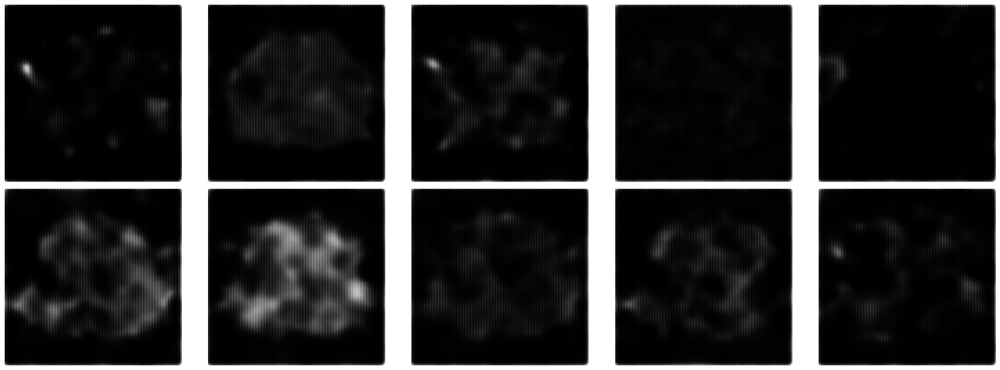

  0%|                                                                                                                        | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step


  0%|                                                                                                                | 1/3750 [00:00<07:19,  8.52it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 2/3750 [00:00<07:03,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


  0%|                                                                                                                | 3/3750 [00:00<06:55,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


  0%|                                                                                                                | 4/3750 [00:00<06:52,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 5/3750 [00:00<06:52,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 6/3750 [00:00<06:49,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 7/3750 [00:00<06:47,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 8/3750 [00:00<06:54,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                               | 9/3750 [00:00<06:51,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                              | 10/3750 [00:01<06:51,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                              | 11/3750 [00:01<06:49,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▎                                                                                                              | 12/3750 [00:01<06:48,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 13/3750 [00:01<06:46,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 14/3750 [00:01<06:44,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 15/3750 [00:01<06:44,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 16/3750 [00:01<06:42,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


  0%|▌                                                                                                              | 17/3750 [00:01<06:44,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▌                                                                                                              | 18/3750 [00:01<06:43,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 19/3750 [00:02<06:45,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 20/3750 [00:02<06:44,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                                                                                              | 21/3750 [00:02<06:45,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 22/3750 [00:02<06:43,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 23/3750 [00:02<06:42,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▋                                                                                                              | 24/3750 [00:02<06:42,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▋                                                                                                              | 25/3750 [00:02<06:44,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▊                                                                                                              | 26/3750 [00:02<06:45,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▊                                                                                                              | 27/3750 [00:02<06:46,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 28/3750 [00:03<06:48,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 29/3750 [00:03<06:45,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 30/3750 [00:03<06:43,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 31/3750 [00:03<06:42,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▉                                                                                                              | 32/3750 [00:03<06:40,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 33/3750 [00:03<06:40,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 34/3750 [00:03<06:48,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 35/3750 [00:03<06:46,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 36/3750 [00:03<06:44,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


  1%|█                                                                                                              | 37/3750 [00:04<06:44,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


  1%|█                                                                                                              | 38/3750 [00:04<06:45,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 39/3750 [00:04<06:44,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


  1%|█▏                                                                                                             | 40/3750 [00:04<06:44,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 41/3750 [00:04<06:42,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


  1%|█▏                                                                                                             | 42/3750 [00:04<06:42,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 43/3750 [00:04<06:40,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 44/3750 [00:04<06:40,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 45/3750 [00:04<06:40,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 46/3750 [00:05<06:39,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 47/3750 [00:05<06:42,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 48/3750 [00:05<06:41,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 49/3750 [00:05<06:43,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 50/3750 [00:05<06:43,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


  1%|█▌                                                                                                             | 51/3750 [00:05<06:44,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 52/3750 [00:05<06:42,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 53/3750 [00:05<06:41,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 54/3750 [00:05<06:39,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▋                                                                                                             | 55/3750 [00:05<06:39,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▋                                                                                                             | 56/3750 [00:06<06:39,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▋                                                                                                             | 57/3750 [00:06<06:42,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▋                                                                                                             | 58/3750 [00:06<06:40,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▋                                                                                                             | 59/3750 [00:06<06:40,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


  2%|█▊                                                                                                             | 60/3750 [00:06<06:41,  9.20it/s]

1/1 [==============================] - 0s 11ms/step


  2%|█▊                                                                                                             | 61/3750 [00:06<06:43,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▊                                                                                                             | 62/3750 [00:06<06:44,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▊                                                                                                             | 63/3750 [00:06<06:41,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 64/3750 [00:06<06:39,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 65/3750 [00:07<06:38,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 66/3750 [00:07<06:40,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


  2%|█▉                                                                                                             | 67/3750 [00:07<06:40,  9.19it/s]

1/1 [==============================] - 0s 12ms/step


  2%|██                                                                                                             | 68/3750 [00:07<06:45,  9.09it/s]

1/1 [==============================] - 0s 11ms/step


  2%|██                                                                                                             | 69/3750 [00:07<06:44,  9.09it/s]

1/1 [==============================] - 0s 11ms/step


  2%|██                                                                                                             | 70/3750 [00:07<06:44,  9.09it/s]

1/1 [==============================] - 0s 11ms/step


  2%|██                                                                                                             | 71/3750 [00:07<06:46,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


  2%|██▏                                                                                                            | 72/3750 [00:07<06:44,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 73/3750 [00:07<06:40,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


  2%|██▏                                                                                                            | 74/3750 [00:08<06:39,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 75/3750 [00:08<06:38,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 76/3750 [00:08<06:40,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 77/3750 [00:08<06:38,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 78/3750 [00:08<06:37,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 79/3750 [00:08<06:37,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 80/3750 [00:08<06:37,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 81/3750 [00:08<06:36,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 82/3750 [00:08<06:36,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 83/3750 [00:09<06:37,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 84/3750 [00:09<06:35,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 85/3750 [00:09<06:37,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 86/3750 [00:09<06:36,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 87/3750 [00:09<06:36,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 88/3750 [00:09<06:36,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 89/3750 [00:09<06:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 90/3750 [00:09<06:32,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 91/3750 [00:09<06:31,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


  2%|██▋                                                                                                            | 92/3750 [00:10<06:33,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


  2%|██▊                                                                                                            | 93/3750 [00:10<06:32,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 94/3750 [00:10<06:31,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 95/3750 [00:10<06:34,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 96/3750 [00:10<06:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 97/3750 [00:10<06:35,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                            | 98/3750 [00:10<06:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                            | 99/3750 [00:10<06:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                           | 100/3750 [00:10<06:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                           | 101/3750 [00:10<06:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                           | 102/3750 [00:11<06:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 103/3750 [00:11<06:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 104/3750 [00:11<06:36,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 105/3750 [00:11<06:35,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 106/3750 [00:11<06:36,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 107/3750 [00:11<06:34,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 108/3750 [00:11<06:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 109/3750 [00:11<06:31,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▏                                                                                                          | 110/3750 [00:11<06:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 111/3750 [00:12<06:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 112/3750 [00:12<06:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 113/3750 [00:12<06:32,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 114/3750 [00:12<06:34,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 115/3750 [00:12<06:33,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 116/3750 [00:12<06:33,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 117/3750 [00:12<06:32,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 118/3750 [00:12<06:34,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


  3%|███▍                                                                                                          | 119/3750 [00:12<06:34,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 120/3750 [00:13<06:32,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 121/3750 [00:13<06:30,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▌                                                                                                          | 122/3750 [00:13<06:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 123/3750 [00:13<06:29,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▋                                                                                                          | 124/3750 [00:13<06:32,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 125/3750 [00:13<06:32,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 126/3750 [00:13<06:30,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 127/3750 [00:13<06:30,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 128/3750 [00:13<06:30,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▊                                                                                                          | 129/3750 [00:13<06:29,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 130/3750 [00:14<06:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 131/3750 [00:14<06:27,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▊                                                                                                          | 132/3750 [00:14<06:26,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 133/3750 [00:14<06:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 134/3750 [00:14<06:31,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 135/3750 [00:14<06:43,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 136/3750 [00:14<06:38,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 137/3750 [00:14<06:35,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 138/3750 [00:14<06:33,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 139/3750 [00:15<06:30,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 140/3750 [00:15<06:37,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▏                                                                                                         | 141/3750 [00:15<06:45,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▏                                                                                                         | 142/3750 [00:15<06:42,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▏                                                                                                         | 143/3750 [00:15<06:39,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▏                                                                                                         | 144/3750 [00:15<06:35,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 145/3750 [00:15<06:32,  9.20it/s]

1/1 [==============================] - 0s 11ms/step


  4%|████▎                                                                                                         | 146/3750 [00:15<06:32,  9.19it/s]

1/1 [==============================] - 0s 11ms/step


  4%|████▎                                                                                                         | 147/3750 [00:15<06:33,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 148/3750 [00:16<06:30,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▎                                                                                                         | 149/3750 [00:16<06:28,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▍                                                                                                         | 150/3750 [00:16<06:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▍                                                                                                         | 151/3750 [00:16<06:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▍                                                                                                         | 152/3750 [00:16<06:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▍                                                                                                         | 153/3750 [00:16<06:29,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 154/3750 [00:16<06:29,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 155/3750 [00:16<06:30,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 156/3750 [00:16<06:29,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 157/3750 [00:17<06:28,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 158/3750 [00:17<06:28,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 159/3750 [00:17<06:27,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 160/3750 [00:17<06:32,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 161/3750 [00:17<06:30,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 162/3750 [00:17<06:30,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 163/3750 [00:17<06:29,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 164/3750 [00:17<06:27,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 165/3750 [00:17<06:27,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 166/3750 [00:18<06:26,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▉                                                                                                         | 167/3750 [00:18<06:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▉                                                                                                         | 168/3750 [00:18<06:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  5%|████▉                                                                                                         | 169/3750 [00:18<06:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  5%|████▉                                                                                                         | 170/3750 [00:18<06:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 171/3750 [00:18<06:27,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 172/3750 [00:18<06:27,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 173/3750 [00:18<06:26,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 174/3750 [00:18<06:25,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 175/3750 [00:18<06:24,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▏                                                                                                        | 176/3750 [00:19<06:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 177/3750 [00:19<06:24,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▏                                                                                                        | 178/3750 [00:19<06:23,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 179/3750 [00:19<06:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 180/3750 [00:19<06:23,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 181/3750 [00:19<06:26,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 182/3750 [00:19<06:26,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 183/3750 [00:19<06:25,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 184/3750 [00:19<06:25,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 185/3750 [00:20<06:25,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 186/3750 [00:20<06:25,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▍                                                                                                        | 187/3750 [00:20<06:24,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▌                                                                                                        | 188/3750 [00:20<06:23,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█████▌                                                                                                        | 189/3750 [00:20<06:24,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▌                                                                                                        | 190/3750 [00:20<06:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▌                                                                                                        | 191/3750 [00:20<06:26,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 192/3750 [00:20<06:25,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 193/3750 [00:20<06:24,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 194/3750 [00:21<06:25,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 195/3750 [00:21<06:25,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 196/3750 [00:21<06:24,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 197/3750 [00:21<06:23,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 198/3750 [00:21<06:22,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▊                                                                                                        | 199/3750 [00:21<06:21,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 200/3750 [00:21<06:24,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 201/3750 [00:21<06:24,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 202/3750 [00:21<06:23,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 203/3750 [00:22<06:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 204/3750 [00:22<06:26,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██████                                                                                                        | 205/3750 [00:22<06:24,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██████                                                                                                        | 206/3750 [00:22<06:23,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████                                                                                                        | 207/3750 [00:22<06:21,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████                                                                                                        | 208/3750 [00:22<06:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 209/3750 [00:22<06:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 210/3750 [00:22<06:22,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 211/3750 [00:22<06:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 212/3750 [00:22<06:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 213/3750 [00:23<06:21,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▎                                                                                                       | 214/3750 [00:23<06:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▎                                                                                                       | 215/3750 [00:23<06:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▎                                                                                                       | 216/3750 [00:23<06:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▎                                                                                                       | 217/3750 [00:23<06:19,  9.32it/s]

1/1 [==============================] - 0s 11ms/step


  6%|██████▍                                                                                                       | 218/3750 [00:23<06:21,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 219/3750 [00:23<06:23,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██████▍                                                                                                       | 220/3750 [00:23<06:23,  9.19it/s]

1/1 [==============================] - 0s 11ms/step


  6%|██████▍                                                                                                       | 221/3750 [00:23<06:26,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██████▌                                                                                                       | 222/3750 [00:24<06:29,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██████▌                                                                                                       | 223/3750 [00:24<06:27,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 224/3750 [00:24<06:25,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 225/3750 [00:24<06:22,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▋                                                                                                       | 226/3750 [00:24<06:21,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 227/3750 [00:24<06:20,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 228/3750 [00:24<06:19,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 229/3750 [00:24<06:21,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 230/3750 [00:24<06:21,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 231/3750 [00:25<06:18,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 232/3750 [00:25<06:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 233/3750 [00:25<06:17,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 234/3750 [00:25<06:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 235/3750 [00:25<06:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 236/3750 [00:25<06:17,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 237/3750 [00:25<06:16,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 238/3750 [00:25<06:18,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████                                                                                                       | 239/3750 [00:25<06:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████                                                                                                       | 240/3750 [00:26<06:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████                                                                                                       | 241/3750 [00:26<06:16,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████                                                                                                       | 242/3750 [00:26<06:17,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████▏                                                                                                      | 243/3750 [00:26<06:17,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▏                                                                                                      | 244/3750 [00:26<06:16,  9.31it/s]

1/1 [==============================] - 0s 11ms/step


  7%|███████▏                                                                                                      | 245/3750 [00:26<06:22,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 246/3750 [00:26<06:23,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 247/3750 [00:26<06:22,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 248/3750 [00:26<06:22,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 249/3750 [00:26<06:20,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 250/3750 [00:27<06:21,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 251/3750 [00:27<06:19,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 252/3750 [00:27<06:18,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 253/3750 [00:27<06:16,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 254/3750 [00:27<06:24,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▍                                                                                                      | 255/3750 [00:27<06:21,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 256/3750 [00:27<06:19,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 257/3750 [00:27<06:19,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 258/3750 [00:27<06:20,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 259/3750 [00:28<06:18,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 260/3750 [00:28<06:17,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 261/3750 [00:28<06:16,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 262/3750 [00:28<06:16,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 263/3750 [00:28<06:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 264/3750 [00:28<06:15,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 265/3750 [00:28<06:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 266/3750 [00:28<06:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 267/3750 [00:28<06:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 268/3750 [00:29<06:14,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▉                                                                                                      | 269/3750 [00:29<06:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▉                                                                                                      | 270/3750 [00:29<06:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▉                                                                                                      | 271/3750 [00:29<06:13,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▉                                                                                                      | 272/3750 [00:29<06:12,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████                                                                                                      | 273/3750 [00:29<06:12,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████                                                                                                      | 274/3750 [00:29<06:12,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  7%|████████                                                                                                      | 275/3750 [00:29<06:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 276/3750 [00:29<06:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 277/3750 [00:30<06:13,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 278/3750 [00:30<06:13,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 279/3750 [00:30<06:13,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 280/3750 [00:30<06:14,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 281/3750 [00:30<06:14,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


  8%|████████▎                                                                                                     | 282/3750 [00:30<06:16,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 283/3750 [00:30<06:15,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▎                                                                                                     | 284/3750 [00:30<06:16,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▎                                                                                                     | 285/3750 [00:30<06:18,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


  8%|████████▍                                                                                                     | 286/3750 [00:30<06:20,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 287/3750 [00:31<06:18,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▍                                                                                                     | 288/3750 [00:31<06:15,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 289/3750 [00:31<06:14,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 290/3750 [00:31<06:14,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▌                                                                                                     | 291/3750 [00:31<06:13,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 292/3750 [00:31<06:11,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


  8%|████████▌                                                                                                     | 293/3750 [00:31<06:12,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


  8%|████████▌                                                                                                     | 294/3750 [00:31<06:13,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 295/3750 [00:31<06:10,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 296/3750 [00:32<06:13,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 297/3750 [00:32<06:11,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 298/3750 [00:32<06:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 299/3750 [00:32<06:10,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 300/3750 [00:32<06:11,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 301/3750 [00:32<06:11,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 302/3750 [00:32<06:11,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 303/3750 [00:32<06:10,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 304/3750 [00:32<06:09,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▉                                                                                                     | 305/3750 [00:33<06:08,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 306/3750 [00:33<06:11,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 307/3750 [00:33<06:11,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 308/3750 [00:33<06:10,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


  8%|█████████                                                                                                     | 309/3750 [00:33<06:11,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 310/3750 [00:33<06:10,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  8%|█████████                                                                                                     | 311/3750 [00:33<06:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 312/3750 [00:33<06:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 313/3750 [00:33<06:08,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 314/3750 [00:34<06:09,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 315/3750 [00:34<06:11,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▎                                                                                                    | 316/3750 [00:34<06:09,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▎                                                                                                    | 317/3750 [00:34<06:09,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▎                                                                                                    | 318/3750 [00:34<06:08,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▎                                                                                                    | 319/3750 [00:34<06:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 320/3750 [00:34<06:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 321/3750 [00:34<06:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 322/3750 [00:34<06:06,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▍                                                                                                    | 323/3750 [00:34<06:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▌                                                                                                    | 324/3750 [00:35<06:04,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 325/3750 [00:35<06:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 326/3750 [00:35<06:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 327/3750 [00:35<06:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 328/3750 [00:35<06:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 329/3750 [00:35<06:05,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 330/3750 [00:35<06:05,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▋                                                                                                    | 331/3750 [00:35<06:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 332/3750 [00:35<06:05,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  9%|█████████▊                                                                                                    | 333/3750 [00:36<06:04,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 334/3750 [00:36<06:06,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 335/3750 [00:36<06:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 336/3750 [00:36<06:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 337/3750 [00:36<06:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 338/3750 [00:36<06:11,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 339/3750 [00:36<06:10,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 340/3750 [00:36<06:09,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 341/3750 [00:36<06:08,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████                                                                                                    | 342/3750 [00:37<06:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 343/3750 [00:37<06:08,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 344/3750 [00:37<06:11,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


  9%|██████████                                                                                                    | 345/3750 [00:37<06:14,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 346/3750 [00:37<06:11,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▏                                                                                                   | 347/3750 [00:37<06:09,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 348/3750 [00:37<06:08,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 349/3750 [00:37<06:07,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▎                                                                                                   | 350/3750 [00:37<06:06,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▎                                                                                                   | 351/3750 [00:37<06:04,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▎                                                                                                   | 352/3750 [00:38<06:04,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▎                                                                                                   | 353/3750 [00:38<06:06,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▍                                                                                                   | 354/3750 [00:38<06:05,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▍                                                                                                   | 355/3750 [00:38<06:06,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▍                                                                                                   | 356/3750 [00:38<06:06,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▍                                                                                                   | 357/3750 [00:38<06:07,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 358/3750 [00:38<06:05,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 359/3750 [00:38<06:05,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 360/3750 [00:38<06:05,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▌                                                                                                   | 361/3750 [00:39<06:04,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 362/3750 [00:39<06:04,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 363/3750 [00:39<06:06,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 364/3750 [00:39<06:05,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 365/3750 [00:39<06:04,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 366/3750 [00:39<06:03,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 367/3750 [00:39<06:04,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 368/3750 [00:39<06:04,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▊                                                                                                   | 369/3750 [00:39<06:03,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▊                                                                                                   | 370/3750 [00:40<06:03,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 10%|██████████▉                                                                                                   | 371/3750 [00:40<06:05,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▉                                                                                                   | 372/3750 [00:40<06:04,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 373/3750 [00:40<06:06,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 374/3750 [00:40<06:05,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███████████                                                                                                   | 375/3750 [00:40<06:08,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 376/3750 [00:40<06:07,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 377/3750 [00:40<06:05,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 378/3750 [00:40<06:04,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 379/3750 [00:41<06:03,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 380/3750 [00:41<06:02,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 381/3750 [00:41<06:01,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 382/3750 [00:41<06:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 383/3750 [00:41<06:04,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▎                                                                                                  | 384/3750 [00:41<06:02,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 385/3750 [00:41<06:02,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▎                                                                                                  | 386/3750 [00:41<06:01,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▎                                                                                                  | 387/3750 [00:41<05:59,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 388/3750 [00:41<05:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 389/3750 [00:42<05:59,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▍                                                                                                  | 390/3750 [00:42<06:03,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 391/3750 [00:42<06:02,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 392/3750 [00:42<06:03,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▌                                                                                                  | 393/3750 [00:42<06:03,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▌                                                                                                  | 394/3750 [00:42<06:02,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▌                                                                                                  | 395/3750 [00:42<06:02,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▌                                                                                                  | 396/3750 [00:42<06:00,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▋                                                                                                  | 397/3750 [00:42<06:00,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▋                                                                                                  | 398/3750 [00:43<05:59,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 399/3750 [00:43<05:58,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▋                                                                                                  | 400/3750 [00:43<05:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 401/3750 [00:43<06:00,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 402/3750 [00:43<06:01,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 403/3750 [00:43<06:00,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▊                                                                                                  | 404/3750 [00:43<06:00,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 405/3750 [00:43<05:59,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▉                                                                                                  | 406/3750 [00:43<05:59,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 407/3750 [00:44<05:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 408/3750 [00:44<05:58,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 409/3750 [00:44<05:58,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 410/3750 [00:44<05:56,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████                                                                                                  | 411/3750 [00:44<06:00,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 412/3750 [00:44<06:02,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 413/3750 [00:44<06:02,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▏                                                                                                 | 414/3750 [00:44<06:09,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 415/3750 [00:44<06:05,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▏                                                                                                 | 416/3750 [00:44<06:02,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▏                                                                                                 | 417/3750 [00:45<06:01,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 418/3750 [00:45<06:00,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 419/3750 [00:45<05:58,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 420/3750 [00:45<05:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 421/3750 [00:45<06:00,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 422/3750 [00:45<05:58,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 423/3750 [00:45<05:57,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 424/3750 [00:45<05:57,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 425/3750 [00:45<05:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 426/3750 [00:46<05:56,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▌                                                                                                 | 427/3750 [00:46<05:56,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████████████▌                                                                                                 | 428/3750 [00:46<05:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 429/3750 [00:46<05:57,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▌                                                                                                 | 430/3750 [00:46<06:00,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▋                                                                                                 | 431/3750 [00:46<05:59,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▋                                                                                                 | 432/3750 [00:46<05:58,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▋                                                                                                 | 433/3750 [00:46<05:57,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▋                                                                                                 | 434/3750 [00:46<05:57,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 435/3750 [00:47<05:56,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▊                                                                                                 | 436/3750 [00:47<05:56,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 437/3750 [00:47<05:56,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 438/3750 [00:47<05:56,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 439/3750 [00:47<05:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 440/3750 [00:47<05:57,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 441/3750 [00:47<05:56,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 442/3750 [00:47<05:56,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████████████▉                                                                                                 | 443/3750 [00:47<05:55,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 444/3750 [00:48<05:53,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████                                                                                                 | 445/3750 [00:48<05:56,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 446/3750 [00:48<05:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 447/3750 [00:48<05:57,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 448/3750 [00:48<05:55,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 449/3750 [00:48<05:54,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 450/3750 [00:48<05:58,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 451/3750 [00:48<05:57,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 452/3750 [00:48<05:56,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 453/3750 [00:48<05:55,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 454/3750 [00:49<05:56,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▎                                                                                                | 455/3750 [00:49<05:56,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 456/3750 [00:49<05:54,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 457/3750 [00:49<05:54,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▍                                                                                                | 458/3750 [00:49<05:57,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▍                                                                                                | 459/3750 [00:49<05:58,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 460/3750 [00:49<05:56,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 461/3750 [00:49<05:55,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 462/3750 [00:49<05:54,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 463/3750 [00:50<05:52,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 464/3750 [00:50<05:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 465/3750 [00:50<05:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 466/3750 [00:50<05:51,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▋                                                                                                | 467/3750 [00:50<05:51,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 468/3750 [00:50<05:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 469/3750 [00:50<06:01,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 470/3750 [00:50<06:00,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 471/3750 [00:50<05:57,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▊                                                                                                | 472/3750 [00:51<05:55,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 473/3750 [00:51<05:53,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▉                                                                                                | 474/3750 [00:51<05:52,  9.29it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█████████████▉                                                                                                | 475/3750 [00:51<06:12,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 476/3750 [00:51<06:06,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 477/3750 [00:51<06:00,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████                                                                                                | 478/3750 [00:51<05:59,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 479/3750 [00:51<06:03,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 480/3750 [00:51<05:59,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████                                                                                                | 481/3750 [00:52<05:56,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 482/3750 [00:52<05:53,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▏                                                                                               | 483/3750 [00:52<05:51,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 484/3750 [00:52<05:50,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 485/3750 [00:52<05:51,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 486/3750 [00:52<05:51,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 487/3750 [00:52<05:51,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▎                                                                                               | 488/3750 [00:52<05:53,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 489/3750 [00:52<05:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 490/3750 [00:52<05:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 491/3750 [00:53<05:51,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 492/3750 [00:53<05:51,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 493/3750 [00:53<05:51,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 494/3750 [00:53<05:51,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 495/3750 [00:53<05:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 496/3750 [00:53<05:49,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 497/3750 [00:53<05:51,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▌                                                                                               | 498/3750 [00:53<05:50,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 499/3750 [00:53<05:49,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 500/3750 [00:54<05:48,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 501/3750 [00:54<05:47,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▋                                                                                               | 502/3750 [00:54<05:47,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▊                                                                                               | 503/3750 [00:54<05:46,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▊                                                                                               | 504/3750 [00:54<05:46,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 505/3750 [00:54<05:47,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 506/3750 [00:54<05:46,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▊                                                                                               | 507/3750 [00:54<05:50,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 508/3750 [00:54<05:53,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 509/3750 [00:55<05:51,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 14%|██████████████▉                                                                                               | 510/3750 [00:55<05:50,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 511/3750 [00:55<05:48,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 512/3750 [00:55<05:47,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 513/3750 [00:55<05:48,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 514/3750 [00:55<05:48,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████                                                                                               | 515/3750 [00:55<05:47,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▏                                                                                              | 516/3750 [00:55<05:46,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▏                                                                                              | 517/3750 [00:55<05:47,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▏                                                                                              | 518/3750 [00:56<05:48,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▏                                                                                              | 519/3750 [00:56<05:49,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 520/3750 [00:56<05:49,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 521/3750 [00:56<05:48,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 522/3750 [00:56<05:51,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 523/3750 [00:56<05:51,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 524/3750 [00:56<05:50,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 14%|███████████████▍                                                                                              | 525/3750 [00:56<05:51,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 526/3750 [00:56<05:52,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 527/3750 [00:56<05:50,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 528/3750 [00:57<05:49,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 529/3750 [00:57<05:48,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 530/3750 [00:57<05:46,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 531/3750 [00:57<05:44,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▌                                                                                              | 532/3750 [00:57<05:43,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 533/3750 [00:57<05:43,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 534/3750 [00:57<05:43,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▋                                                                                              | 535/3750 [00:57<05:42,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▋                                                                                              | 536/3750 [00:57<05:45,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 537/3750 [00:58<05:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 538/3750 [00:58<05:45,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 539/3750 [00:58<05:46,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 540/3750 [00:58<05:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 541/3750 [00:58<05:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▉                                                                                              | 542/3750 [00:58<05:44,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▉                                                                                              | 543/3750 [00:58<05:44,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 15%|███████████████▉                                                                                              | 544/3750 [00:58<05:43,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 15%|███████████████▉                                                                                              | 545/3750 [00:58<05:45,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 546/3750 [00:59<05:46,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 547/3750 [00:59<05:46,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 548/3750 [00:59<05:46,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 549/3750 [00:59<05:45,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 550/3750 [00:59<05:44,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 551/3750 [00:59<05:43,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 552/3750 [00:59<05:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 553/3750 [00:59<05:42,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 554/3750 [00:59<05:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 555/3750 [00:59<05:43,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 556/3750 [01:00<05:43,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 557/3750 [01:00<05:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 558/3750 [01:00<05:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 559/3750 [01:00<05:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 560/3750 [01:00<05:41,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 561/3750 [01:00<05:41,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 562/3750 [01:00<05:41,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 563/3750 [01:00<05:41,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 564/3750 [01:00<05:42,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 565/3750 [01:01<05:42,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 566/3750 [01:01<05:42,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 567/3750 [01:01<05:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 568/3750 [01:01<05:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 569/3750 [01:01<05:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 570/3750 [01:01<05:46,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 571/3750 [01:01<05:44,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 572/3750 [01:01<05:43,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 573/3750 [01:01<05:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 574/3750 [01:02<05:43,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▊                                                                                             | 575/3750 [01:02<05:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 576/3750 [01:02<05:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 577/3750 [01:02<05:42,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 578/3750 [01:02<05:42,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 579/3750 [01:02<05:43,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████████████████                                                                                             | 580/3750 [01:02<05:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████████████████                                                                                             | 581/3750 [01:02<05:40,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████                                                                                             | 582/3750 [01:02<05:41,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████                                                                                             | 583/3750 [01:03<05:43,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 584/3750 [01:03<05:42,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 585/3750 [01:03<05:42,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 586/3750 [01:03<05:41,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 587/3750 [01:03<05:40,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 588/3750 [01:03<05:40,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▎                                                                                            | 589/3750 [01:03<05:39,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 590/3750 [01:03<05:37,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 591/3750 [01:03<05:37,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▎                                                                                            | 592/3750 [01:03<05:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▍                                                                                            | 593/3750 [01:04<05:40,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▍                                                                                            | 594/3750 [01:04<05:38,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 595/3750 [01:04<05:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▍                                                                                            | 596/3750 [01:04<05:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▌                                                                                            | 597/3750 [01:04<05:37,  9.33it/s]

1/1 [==============================] - 0s 11ms/step


 16%|█████████████████▌                                                                                            | 598/3750 [01:04<05:40,  9.26it/s]

1/1 [==============================] - 0s 11ms/step


 16%|█████████████████▌                                                                                            | 599/3750 [01:04<05:44,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▌                                                                                            | 600/3750 [01:04<05:43,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▋                                                                                            | 601/3750 [01:04<05:42,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 602/3750 [01:05<05:41,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 603/3750 [01:05<05:41,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 604/3750 [01:05<05:40,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 605/3750 [01:05<05:39,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 606/3750 [01:05<05:38,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 607/3750 [01:05<05:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 608/3750 [01:05<05:37,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 609/3750 [01:05<05:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 610/3750 [01:05<05:35,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 611/3750 [01:06<05:35,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 612/3750 [01:06<05:37,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 613/3750 [01:06<05:37,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 614/3750 [01:06<05:38,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 615/3750 [01:06<05:42,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 616/3750 [01:06<05:40,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 617/3750 [01:06<05:39,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████▏                                                                                           | 618/3750 [01:06<05:38,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 619/3750 [01:06<05:40,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 620/3750 [01:07<05:38,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▏                                                                                           | 621/3750 [01:07<05:37,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 622/3750 [01:07<05:38,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 623/3750 [01:07<05:36,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 624/3750 [01:07<05:36,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 625/3750 [01:07<05:35,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▎                                                                                           | 626/3750 [01:07<05:34,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 627/3750 [01:07<05:34,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 628/3750 [01:07<05:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 629/3750 [01:07<05:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 630/3750 [01:08<05:37,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▌                                                                                           | 631/3750 [01:08<05:35,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 632/3750 [01:08<05:36,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 633/3750 [01:08<05:36,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 634/3750 [01:08<05:36,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 635/3750 [01:08<05:36,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 636/3750 [01:08<05:36,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 637/3750 [01:08<05:36,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 638/3750 [01:08<05:34,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 639/3750 [01:09<05:34,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 640/3750 [01:09<05:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▊                                                                                           | 641/3750 [01:09<05:35,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▊                                                                                           | 642/3750 [01:09<05:34,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████████████████▊                                                                                           | 643/3750 [01:09<05:34,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 644/3750 [01:09<05:33,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 645/3750 [01:09<05:32,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 646/3750 [01:09<05:31,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 647/3750 [01:09<05:30,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 648/3750 [01:10<05:30,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 649/3750 [01:10<05:30,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 17%|███████████████████                                                                                           | 650/3750 [01:10<05:31,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████                                                                                           | 651/3750 [01:10<05:36,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 652/3750 [01:10<05:39,  9.12it/s]

1/1 [==============================] - 0s 11ms/step


 17%|███████████████████▏                                                                                          | 653/3750 [01:10<06:08,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 654/3750 [01:10<05:55,  8.72it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 655/3750 [01:10<05:46,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 656/3750 [01:10<05:39,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▎                                                                                          | 657/3750 [01:11<05:46,  8.94it/s]

1/1 [==============================] - 0s 13ms/step


 18%|███████████████████▎                                                                                          | 658/3750 [01:11<05:51,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 659/3750 [01:11<05:49,  8.85it/s]

1/1 [==============================] - 0s 11ms/step


 18%|███████████████████▎                                                                                          | 660/3750 [01:11<05:51,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▍                                                                                          | 661/3750 [01:11<05:53,  8.75it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▍                                                                                          | 662/3750 [01:11<05:51,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 663/3750 [01:11<05:47,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▍                                                                                          | 664/3750 [01:11<05:46,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 665/3750 [01:11<05:45,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▌                                                                                          | 666/3750 [01:12<05:43,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▌                                                                                          | 667/3750 [01:12<05:45,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▌                                                                                          | 668/3750 [01:12<05:47,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 669/3750 [01:12<05:45,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 670/3750 [01:12<05:41,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▋                                                                                          | 671/3750 [01:12<05:36,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 672/3750 [01:12<05:35,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▋                                                                                          | 673/3750 [01:12<05:47,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▊                                                                                          | 674/3750 [01:12<05:53,  8.71it/s]

1/1 [==============================] - 0s 11ms/step


 18%|███████████████████▊                                                                                          | 675/3750 [01:13<05:54,  8.67it/s]

1/1 [==============================] - 0s 13ms/step


 18%|███████████████████▊                                                                                          | 676/3750 [01:13<06:02,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 677/3750 [01:13<05:59,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▉                                                                                          | 678/3750 [01:13<06:20,  8.07it/s]

1/1 [==============================] - 0s 11ms/step


 18%|███████████████████▉                                                                                          | 679/3750 [01:13<06:25,  7.97it/s]

1/1 [==============================] - 0s 36ms/step


 18%|███████████████████▉                                                                                          | 680/3750 [01:13<07:15,  7.05it/s]

1/1 [==============================] - 0s 11ms/step


 18%|███████████████████▉                                                                                          | 681/3750 [01:13<08:10,  6.25it/s]

1/1 [==============================] - 0s 10ms/step


 18%|████████████████████                                                                                          | 682/3750 [01:14<07:30,  6.81it/s]

1/1 [==============================] - 0s 10ms/step


 18%|████████████████████                                                                                          | 683/3750 [01:14<06:58,  7.34it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 684/3750 [01:14<06:32,  7.81it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 685/3750 [01:14<06:13,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 18%|████████████████████                                                                                          | 686/3750 [01:14<06:03,  8.43it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 687/3750 [01:14<06:05,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


 18%|████████████████████▏                                                                                         | 688/3750 [01:14<05:57,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 689/3750 [01:14<05:53,  8.67it/s]

1/1 [==============================] - 0s 43ms/step


 18%|████████████████████▏                                                                                         | 690/3750 [01:14<06:28,  7.88it/s]

1/1 [==============================] - 0s 12ms/step


 18%|████████████████████▎                                                                                         | 691/3750 [01:15<06:21,  8.02it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 692/3750 [01:15<06:06,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 693/3750 [01:15<05:57,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▎                                                                                         | 694/3750 [01:15<05:48,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▍                                                                                         | 695/3750 [01:15<05:45,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 696/3750 [01:15<05:43,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▍                                                                                         | 697/3750 [01:15<05:40,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 698/3750 [01:15<05:35,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 699/3750 [01:15<05:38,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▌                                                                                         | 700/3750 [01:16<05:47,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 701/3750 [01:16<05:42,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 702/3750 [01:16<05:37,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▌                                                                                         | 703/3750 [01:16<05:35,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 704/3750 [01:16<05:33,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▋                                                                                         | 705/3750 [01:16<05:31,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 706/3750 [01:16<05:29,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 707/3750 [01:16<05:31,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 708/3750 [01:16<05:30,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 709/3750 [01:17<05:29,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 710/3750 [01:17<05:28,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 711/3750 [01:17<05:28,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▉                                                                                         | 712/3750 [01:17<05:29,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▉                                                                                         | 713/3750 [01:17<05:33,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 19%|████████████████████▉                                                                                         | 714/3750 [01:17<05:33,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▉                                                                                         | 715/3750 [01:17<05:34,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 19%|█████████████████████                                                                                         | 716/3750 [01:17<05:36,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 717/3750 [01:17<05:34,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 718/3750 [01:18<05:44,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 19%|█████████████████████                                                                                         | 719/3750 [01:18<05:40,  8.90it/s]

1/1 [==============================] - 0s 14ms/step


 19%|█████████████████████                                                                                         | 720/3750 [01:18<05:59,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 721/3750 [01:18<05:54,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 722/3750 [01:18<05:54,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 723/3750 [01:18<05:56,  8.48it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 724/3750 [01:18<05:47,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 725/3750 [01:18<05:41,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 726/3750 [01:19<05:39,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 727/3750 [01:19<05:35,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 728/3750 [01:19<05:33,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▍                                                                                        | 729/3750 [01:19<05:31,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▍                                                                                        | 730/3750 [01:19<05:29,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▍                                                                                        | 731/3750 [01:19<05:27,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▍                                                                                        | 732/3750 [01:19<05:25,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 733/3750 [01:19<05:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 734/3750 [01:19<05:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 735/3750 [01:19<05:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 736/3750 [01:20<05:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 737/3750 [01:20<05:27,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▋                                                                                        | 738/3750 [01:20<05:25,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 739/3750 [01:20<05:23,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▋                                                                                        | 740/3750 [01:20<05:24,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▋                                                                                        | 741/3750 [01:20<05:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 742/3750 [01:20<05:24,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 743/3750 [01:20<05:24,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 744/3750 [01:20<05:23,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 745/3750 [01:21<05:25,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 746/3750 [01:21<05:24,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 747/3750 [01:21<05:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 748/3750 [01:21<05:23,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 749/3750 [01:21<05:22,  9.30it/s]

1/1 [==============================] - 0s 16ms/step


 20%|██████████████████████                                                                                        | 750/3750 [01:21<05:29,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 20%|██████████████████████                                                                                        | 751/3750 [01:21<05:28,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 752/3750 [01:21<05:25,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 753/3750 [01:21<05:23,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 754/3750 [01:22<05:24,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 755/3750 [01:22<05:23,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 20%|██████████████████████▏                                                                                       | 756/3750 [01:22<05:26,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 757/3750 [01:22<05:24,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 20%|██████████████████████▏                                                                                       | 758/3750 [01:22<05:24,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▎                                                                                       | 759/3750 [01:22<05:22,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▎                                                                                       | 760/3750 [01:22<05:26,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▎                                                                                       | 761/3750 [01:22<05:25,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 762/3750 [01:22<05:23,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 763/3750 [01:23<05:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 764/3750 [01:23<05:23,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 765/3750 [01:23<05:23,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 766/3750 [01:23<05:22,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 767/3750 [01:23<05:21,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▌                                                                                       | 768/3750 [01:23<05:22,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▌                                                                                       | 769/3750 [01:23<05:21,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▌                                                                                       | 770/3750 [01:23<05:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▌                                                                                       | 771/3750 [01:23<05:20,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▋                                                                                       | 772/3750 [01:23<05:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 773/3750 [01:24<05:21,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▋                                                                                       | 774/3750 [01:24<05:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 775/3750 [01:24<05:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 776/3750 [01:24<05:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 777/3750 [01:24<05:20,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 778/3750 [01:24<05:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 779/3750 [01:24<05:20,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 780/3750 [01:24<05:20,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 781/3750 [01:24<05:19,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 782/3750 [01:25<05:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 783/3750 [01:25<05:20,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 784/3750 [01:25<05:19,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████                                                                                       | 785/3750 [01:25<05:19,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████                                                                                       | 786/3750 [01:25<05:18,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 787/3750 [01:25<05:18,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████                                                                                       | 788/3750 [01:25<05:18,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▏                                                                                      | 789/3750 [01:25<05:17,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▏                                                                                      | 790/3750 [01:25<05:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 791/3750 [01:26<05:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 792/3750 [01:26<05:16,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 793/3750 [01:26<05:24,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 794/3750 [01:26<05:22,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 795/3750 [01:26<05:23,  9.12it/s]

1/1 [==============================] - 0s 12ms/step


 21%|███████████████████████▎                                                                                      | 796/3750 [01:26<05:32,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 797/3750 [01:26<05:28,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 798/3750 [01:26<05:26,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 799/3750 [01:26<05:22,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 800/3750 [01:27<05:21,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 21%|███████████████████████▍                                                                                      | 801/3750 [01:27<05:22,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 802/3750 [01:27<05:23,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 803/3750 [01:27<05:23,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 804/3750 [01:27<05:21,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 805/3750 [01:27<05:20,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▋                                                                                      | 806/3750 [01:27<05:18,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▋                                                                                      | 807/3750 [01:27<05:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 808/3750 [01:27<05:16,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▋                                                                                      | 809/3750 [01:27<05:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 810/3750 [01:28<05:14,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 811/3750 [01:28<05:15,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 812/3750 [01:28<05:22,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 813/3750 [01:28<05:20,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 814/3750 [01:28<05:19,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 815/3750 [01:28<05:17,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 816/3750 [01:28<05:16,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 817/3750 [01:28<05:17,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 818/3750 [01:28<05:16,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████                                                                                      | 819/3750 [01:29<05:16,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 820/3750 [01:29<05:16,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 821/3750 [01:29<05:17,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 822/3750 [01:29<05:16,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 823/3750 [01:29<05:21,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 824/3750 [01:29<05:19,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 825/3750 [01:29<05:18,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████████████████████▏                                                                                     | 826/3750 [01:29<05:18,  9.18it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████████████████████▎                                                                                     | 827/3750 [01:29<05:20,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 828/3750 [01:30<05:17,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 829/3750 [01:30<05:16,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▎                                                                                     | 830/3750 [01:30<05:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 831/3750 [01:30<05:17,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 832/3750 [01:30<05:17,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 833/3750 [01:30<05:15,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 834/3750 [01:30<05:14,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 835/3750 [01:30<05:14,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 836/3750 [01:30<05:14,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 837/3750 [01:31<05:13,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▌                                                                                     | 838/3750 [01:31<05:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 839/3750 [01:31<05:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 840/3750 [01:31<05:14,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 841/3750 [01:31<05:13,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 842/3750 [01:31<05:14,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▋                                                                                     | 843/3750 [01:31<05:16,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 844/3750 [01:31<05:13,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 845/3750 [01:31<05:11,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 846/3750 [01:31<05:11,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 847/3750 [01:32<05:11,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▊                                                                                     | 848/3750 [01:32<05:11,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 23%|████████████████████████▉                                                                                     | 849/3750 [01:32<05:10,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 850/3750 [01:32<05:14,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 851/3750 [01:32<05:12,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 852/3750 [01:32<05:13,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 853/3750 [01:32<05:12,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 854/3750 [01:32<05:11,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 855/3750 [01:32<05:11,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 856/3750 [01:33<05:10,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 857/3750 [01:33<05:10,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 858/3750 [01:33<05:10,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▏                                                                                    | 859/3750 [01:33<05:09,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 860/3750 [01:33<05:12,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 861/3750 [01:33<05:12,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 862/3750 [01:33<05:11,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 863/3750 [01:33<05:12,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 864/3750 [01:33<05:10,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 865/3750 [01:34<05:09,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 866/3750 [01:34<05:09,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 867/3750 [01:34<05:08,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 868/3750 [01:34<05:08,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 869/3750 [01:34<05:11,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 870/3750 [01:34<05:11,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 871/3750 [01:34<05:11,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 872/3750 [01:34<05:11,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 873/3750 [01:34<05:10,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▋                                                                                    | 874/3750 [01:35<05:09,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▋                                                                                    | 875/3750 [01:35<05:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▋                                                                                    | 876/3750 [01:35<05:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▋                                                                                    | 877/3750 [01:35<05:07,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 878/3750 [01:35<05:06,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 879/3750 [01:35<05:09,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 880/3750 [01:35<05:09,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 881/3750 [01:35<05:08,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▊                                                                                    | 882/3750 [01:35<05:08,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 883/3750 [01:35<05:08,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 884/3750 [01:36<05:08,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████████████████████▉                                                                                    | 885/3750 [01:36<05:09,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 886/3750 [01:36<05:08,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 887/3750 [01:36<05:07,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 888/3750 [01:36<05:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 889/3750 [01:36<05:15,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 890/3750 [01:36<05:12,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 891/3750 [01:36<05:10,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 892/3750 [01:36<05:08,  9.25it/s]

1/1 [==============================] - 0s 14ms/step


 24%|██████████████████████████▏                                                                                   | 893/3750 [01:37<05:13,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 894/3750 [01:37<05:11,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 895/3750 [01:37<05:11,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 896/3750 [01:37<05:10,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 897/3750 [01:37<05:08,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 898/3750 [01:37<05:09,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 899/3750 [01:37<05:08,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 900/3750 [01:37<05:07,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 901/3750 [01:37<05:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 902/3750 [01:38<05:06,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 24%|██████████████████████████▍                                                                                   | 903/3750 [01:38<05:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 904/3750 [01:38<05:07,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 905/3750 [01:38<05:06,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 906/3750 [01:38<05:04,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▌                                                                                   | 907/3750 [01:38<05:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 908/3750 [01:38<05:05,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 24%|██████████████████████████▋                                                                                   | 909/3750 [01:38<08:06,  5.84it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 910/3750 [01:39<07:11,  6.58it/s]

1/1 [==============================] - 0s 10ms/step


 24%|██████████████████████████▋                                                                                   | 911/3750 [01:39<06:33,  7.22it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 912/3750 [01:39<06:08,  7.70it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 913/3750 [01:39<05:49,  8.12it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 914/3750 [01:39<05:36,  8.43it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 915/3750 [01:39<05:26,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 916/3750 [01:39<05:19,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▉                                                                                   | 917/3750 [01:39<05:18,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▉                                                                                   | 918/3750 [01:39<05:15,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████████████████████▉                                                                                   | 919/3750 [01:40<05:13,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████████████████████▉                                                                                   | 920/3750 [01:40<05:10,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████                                                                                   | 921/3750 [01:40<05:09,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████                                                                                   | 922/3750 [01:40<05:08,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████                                                                                   | 923/3750 [01:40<05:07,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████                                                                                   | 924/3750 [01:40<05:07,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 925/3750 [01:40<05:08,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 25%|███████████████████████████▏                                                                                  | 926/3750 [01:40<05:08,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 927/3750 [01:40<05:07,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 928/3750 [01:41<05:06,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 929/3750 [01:41<05:06,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 930/3750 [01:41<05:05,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 931/3750 [01:41<05:05,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 932/3750 [01:41<05:08,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 933/3750 [01:41<05:08,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 934/3750 [01:41<05:10,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 25%|███████████████████████████▍                                                                                  | 935/3750 [01:41<05:10,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 936/3750 [01:41<05:08,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 937/3750 [01:42<05:08,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 938/3750 [01:42<05:06,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 25%|███████████████████████████▌                                                                                  | 939/3750 [01:42<05:12,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 940/3750 [01:42<05:09,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 941/3750 [01:42<05:07,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▋                                                                                  | 942/3750 [01:42<05:08,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 25%|███████████████████████████▋                                                                                  | 943/3750 [01:42<05:07,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▋                                                                                  | 944/3750 [01:42<05:07,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▋                                                                                  | 945/3750 [01:42<05:05,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▋                                                                                  | 946/3750 [01:43<05:14,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 947/3750 [01:43<05:10,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 948/3750 [01:43<05:07,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 949/3750 [01:43<05:06,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 950/3750 [01:43<05:06,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 951/3750 [01:43<05:09,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 25%|███████████████████████████▉                                                                                  | 952/3750 [01:43<05:18,  8.79it/s]

1/1 [==============================] - 0s 15ms/step


 25%|███████████████████████████▉                                                                                  | 953/3750 [01:43<05:19,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


 25%|███████████████████████████▉                                                                                  | 954/3750 [01:43<05:15,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 25%|████████████████████████████                                                                                  | 955/3750 [01:44<05:11,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 25%|████████████████████████████                                                                                  | 956/3750 [01:44<05:08,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████                                                                                  | 957/3750 [01:44<05:09,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████                                                                                  | 958/3750 [01:44<05:07,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 26%|████████████████████████████▏                                                                                 | 959/3750 [01:44<05:13,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 26%|████████████████████████████▏                                                                                 | 960/3750 [01:44<05:13,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 961/3750 [01:44<05:10,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 962/3750 [01:44<05:08,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 963/3750 [01:44<05:07,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 964/3750 [01:45<05:06,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 26%|████████████████████████████▎                                                                                 | 965/3750 [01:45<05:05,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 966/3750 [01:45<05:04,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 967/3750 [01:45<05:03,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 968/3750 [01:45<05:03,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 969/3750 [01:45<05:02,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 970/3750 [01:45<05:03,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 971/3750 [01:45<05:01,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 972/3750 [01:45<05:00,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 973/3750 [01:46<05:01,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 974/3750 [01:46<05:06,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▌                                                                                 | 975/3750 [01:46<05:04,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 976/3750 [01:46<05:03,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 977/3750 [01:46<05:00,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 978/3750 [01:46<04:59,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 979/3750 [01:46<05:01,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 980/3750 [01:46<05:03,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 981/3750 [01:46<05:04,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 982/3750 [01:47<05:03,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 983/3750 [01:47<05:03,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 984/3750 [01:47<05:03,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 985/3750 [01:47<05:06,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 986/3750 [01:47<05:03,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 987/3750 [01:47<05:01,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 988/3750 [01:47<05:01,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 989/3750 [01:47<05:01,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 990/3750 [01:47<05:00,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 991/3750 [01:47<04:59,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 992/3750 [01:48<04:58,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████▏                                                                                | 993/3750 [01:48<04:57,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 994/3750 [01:48<04:58,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 995/3750 [01:48<04:58,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 996/3750 [01:48<04:57,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 997/3750 [01:48<04:56,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                                | 998/3750 [01:48<04:59,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                                | 999/3750 [01:48<04:58,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████                                                                                | 1000/3750 [01:48<04:57,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████                                                                                | 1001/3750 [01:49<04:58,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████                                                                                | 1002/3750 [01:49<04:58,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1003/3750 [01:49<04:56,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1004/3750 [01:49<04:56,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1005/3750 [01:49<04:55,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1006/3750 [01:49<04:54,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1007/3750 [01:49<04:53,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                               | 1008/3750 [01:49<04:56,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                               | 1009/3750 [01:49<04:56,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                               | 1010/3750 [01:50<04:57,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1011/3750 [01:50<04:59,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1012/3750 [01:50<04:58,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1013/3750 [01:50<04:58,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1014/3750 [01:50<04:57,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1015/3750 [01:50<04:56,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 27%|█████████████████████████████▌                                                                               | 1016/3750 [01:50<04:59,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1017/3750 [01:50<05:01,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 27%|█████████████████████████████▌                                                                               | 1018/3750 [01:50<04:59,  9.11it/s]

1/1 [==============================] - 0s 12ms/step


 27%|█████████████████████████████▌                                                                               | 1019/3750 [01:51<05:00,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 27%|█████████████████████████████▋                                                                               | 1020/3750 [01:51<05:00,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1021/3750 [01:51<04:58,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1022/3750 [01:51<04:58,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1023/3750 [01:51<04:57,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1024/3750 [01:51<04:59,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1025/3750 [01:51<04:57,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1026/3750 [01:51<04:56,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1027/3750 [01:51<04:58,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1028/3750 [01:52<04:56,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1029/3750 [01:52<04:55,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1030/3750 [01:52<04:54,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1031/3750 [01:52<04:52,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 28%|█████████████████████████████▉                                                                               | 1032/3750 [01:52<04:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1033/3750 [01:52<04:51,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1034/3750 [01:52<04:52,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████                                                                               | 1035/3750 [01:52<04:51,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1036/3750 [01:52<04:55,  9.18it/s]

1/1 [==============================] - 0s 11ms/step


 28%|██████████████████████████████▏                                                                              | 1037/3750 [01:53<08:39,  5.22it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1038/3750 [01:53<07:31,  6.01it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1039/3750 [01:53<06:43,  6.72it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████████████████████████▏                                                                              | 1040/3750 [01:54<18:56,  2.38it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1041/3750 [01:54<15:31,  2.91it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1042/3750 [01:54<12:19,  3.66it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1043/3750 [01:54<10:04,  4.48it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1044/3750 [01:55<08:29,  5.31it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1045/3750 [01:55<07:24,  6.09it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1046/3750 [01:55<06:40,  6.74it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████████████████████████▍                                                                              | 1047/3750 [01:55<06:08,  7.34it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1048/3750 [01:55<05:44,  7.84it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▍                                                                              | 1049/3750 [01:55<05:29,  8.19it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1050/3750 [01:55<05:23,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1051/3750 [01:55<05:17,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1052/3750 [01:55<05:09,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1053/3750 [01:55<05:04,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████████████████████████▋                                                                              | 1054/3750 [01:56<06:02,  7.45it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1055/3750 [01:56<05:42,  7.87it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1056/3750 [01:56<05:26,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1057/3750 [01:56<05:17,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1058/3750 [01:56<05:12,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1059/3750 [01:56<05:05,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1060/3750 [01:56<05:00,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1061/3750 [01:56<04:56,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1062/3750 [01:57<04:53,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1063/3750 [01:57<04:51,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1064/3750 [01:57<04:51,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1065/3750 [01:57<04:52,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1066/3750 [01:57<04:51,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████████████████████████                                                                              | 1067/3750 [01:57<04:51,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████████████████████████                                                                              | 1068/3750 [01:57<04:51,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████                                                                              | 1069/3750 [01:57<04:51,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████                                                                              | 1070/3750 [01:57<04:50,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1071/3750 [01:58<04:49,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1072/3750 [01:58<04:47,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1073/3750 [01:58<04:47,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1074/3750 [01:58<04:47,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1075/3750 [01:58<04:48,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1076/3750 [01:58<04:48,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1077/3750 [01:58<04:48,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1078/3750 [01:58<04:47,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▎                                                                             | 1079/3750 [01:58<04:47,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1080/3750 [01:58<04:47,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1081/3750 [01:59<04:46,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1082/3750 [01:59<04:45,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1083/3750 [01:59<04:46,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1084/3750 [01:59<04:48,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1085/3750 [01:59<04:48,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1086/3750 [01:59<04:47,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1087/3750 [01:59<04:47,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▌                                                                             | 1088/3750 [01:59<04:47,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1089/3750 [01:59<04:46,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1090/3750 [02:00<04:48,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▋                                                                             | 1091/3750 [02:00<04:49,  9.19it/s]

1/1 [==============================] - 0s 12ms/step


 29%|███████████████████████████████▋                                                                             | 1092/3750 [02:00<04:51,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▊                                                                             | 1093/3750 [02:00<04:52,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▊                                                                             | 1094/3750 [02:00<04:51,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▊                                                                             | 1095/3750 [02:00<04:50,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▊                                                                             | 1096/3750 [02:00<04:48,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1097/3750 [02:00<04:47,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1098/3750 [02:00<04:46,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1099/3750 [02:01<04:45,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▉                                                                             | 1100/3750 [02:01<04:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1101/3750 [02:01<04:44,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1102/3750 [02:01<04:44,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1103/3750 [02:01<04:50,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1104/3750 [02:01<04:48,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1105/3750 [02:01<04:47,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████▏                                                                            | 1106/3750 [02:01<04:46,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▏                                                                            | 1107/3750 [02:01<04:44,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▏                                                                            | 1108/3750 [02:02<04:44,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▏                                                                            | 1109/3750 [02:02<04:43,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▎                                                                            | 1110/3750 [02:02<04:42,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1111/3750 [02:02<04:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1112/3750 [02:02<04:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1113/3750 [02:02<04:44,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1114/3750 [02:02<04:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1115/3750 [02:02<04:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1116/3750 [02:02<04:45,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1117/3750 [02:02<04:44,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1118/3750 [02:03<04:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1119/3750 [02:03<04:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1120/3750 [02:03<04:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1121/3750 [02:03<04:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1122/3750 [02:03<04:41,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1123/3750 [02:03<04:43,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1124/3750 [02:03<04:44,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1125/3750 [02:03<04:43,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1126/3750 [02:03<04:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1127/3750 [02:04<04:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1128/3750 [02:04<04:40,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1129/3750 [02:04<04:40,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1130/3750 [02:04<04:40,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▊                                                                            | 1131/3750 [02:04<04:39,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▉                                                                            | 1132/3750 [02:04<04:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1133/3750 [02:04<04:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1134/3750 [02:04<04:41,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1135/3750 [02:04<04:41,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████                                                                            | 1136/3750 [02:05<04:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1137/3750 [02:05<04:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1138/3750 [02:05<04:43,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1139/3750 [02:05<04:43,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1140/3750 [02:05<04:43,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1141/3750 [02:05<04:42,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1142/3750 [02:05<04:43,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1143/3750 [02:05<04:42,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1144/3750 [02:05<04:41,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1145/3750 [02:06<04:40,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1146/3750 [02:06<04:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1147/3750 [02:06<04:39,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▎                                                                           | 1148/3750 [02:06<04:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1149/3750 [02:06<04:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1150/3750 [02:06<04:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1151/3750 [02:06<04:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1152/3750 [02:06<04:40,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1153/3750 [02:06<04:39,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1154/3750 [02:06<04:39,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1155/3750 [02:07<04:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1156/3750 [02:07<04:38,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1157/3750 [02:07<04:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1158/3750 [02:07<04:37,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1159/3750 [02:07<04:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1160/3750 [02:07<04:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1161/3750 [02:07<04:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1162/3750 [02:07<04:38,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1163/3750 [02:07<04:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1164/3750 [02:08<04:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1165/3750 [02:08<04:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1166/3750 [02:08<04:38,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 31%|█████████████████████████████████▉                                                                           | 1167/3750 [02:08<04:38,  9.28it/s]

1/1 [==============================] - 0s 11ms/step


 31%|█████████████████████████████████▉                                                                           | 1168/3750 [02:08<04:40,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1169/3750 [02:08<04:38,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1170/3750 [02:08<04:37,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1171/3750 [02:08<04:43,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1172/3750 [02:08<04:41,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1173/3750 [02:09<04:39,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1174/3750 [02:09<04:37,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1175/3750 [02:09<04:38,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1176/3750 [02:09<04:38,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1177/3750 [02:09<04:37,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▏                                                                          | 1178/3750 [02:09<04:36,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1179/3750 [02:09<04:35,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████▎                                                                          | 1180/3750 [02:09<04:37,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1181/3750 [02:09<04:36,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▎                                                                          | 1182/3750 [02:09<04:36,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1183/3750 [02:10<04:36,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1184/3750 [02:10<04:36,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▍                                                                          | 1185/3750 [02:10<04:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1186/3750 [02:10<04:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1187/3750 [02:10<04:35,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▌                                                                          | 1188/3750 [02:10<04:34,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1189/3750 [02:10<04:34,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1190/3750 [02:10<04:36,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1191/3750 [02:10<04:35,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1192/3750 [02:11<04:35,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1193/3750 [02:11<04:36,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1194/3750 [02:11<04:35,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1195/3750 [02:11<04:35,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1196/3750 [02:11<04:36,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1197/3750 [02:11<04:35,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1198/3750 [02:11<04:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1199/3750 [02:11<04:33,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1200/3750 [02:11<04:35,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▉                                                                          | 1201/3750 [02:12<04:35,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1202/3750 [02:12<04:35,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1203/3750 [02:12<04:34,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1204/3750 [02:12<04:34,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1205/3750 [02:12<04:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1206/3750 [02:12<04:32,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████                                                                          | 1207/3750 [02:12<04:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1208/3750 [02:12<04:31,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1209/3750 [02:12<04:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1210/3750 [02:13<04:33,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1211/3750 [02:13<04:32,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1212/3750 [02:13<04:33,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1213/3750 [02:13<04:32,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1214/3750 [02:13<04:31,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1215/3750 [02:13<04:31,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1216/3750 [02:13<04:31,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1217/3750 [02:13<04:32,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▍                                                                         | 1218/3750 [02:13<04:31,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1219/3750 [02:13<04:33,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1220/3750 [02:14<04:33,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1221/3750 [02:14<04:33,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1222/3750 [02:14<04:39,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1223/3750 [02:14<04:39,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1224/3750 [02:14<04:36,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1225/3750 [02:14<04:35,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1226/3750 [02:14<04:36,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1227/3750 [02:14<04:35,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1228/3750 [02:14<04:37,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1229/3750 [02:15<04:34,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1230/3750 [02:15<04:33,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1231/3750 [02:15<04:33,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1232/3750 [02:15<04:32,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1233/3750 [02:15<04:32,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1234/3750 [02:15<04:31,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1235/3750 [02:15<04:30,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1236/3750 [02:15<04:30,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▉                                                                         | 1237/3750 [02:15<04:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1238/3750 [02:16<04:31,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1239/3750 [02:16<04:30,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████                                                                         | 1240/3750 [02:16<04:29,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1241/3750 [02:16<04:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1242/3750 [02:16<04:30,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1243/3750 [02:16<04:30,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1244/3750 [02:16<04:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1245/3750 [02:16<04:32,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1246/3750 [02:16<04:36,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1247/3750 [02:17<04:36,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1248/3750 [02:17<04:33,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1249/3750 [02:17<04:32,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1250/3750 [02:17<04:31,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1251/3750 [02:17<04:30,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1252/3750 [02:17<04:29,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1253/3750 [02:17<04:29,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▍                                                                        | 1254/3750 [02:17<04:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1255/3750 [02:17<04:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▌                                                                        | 1256/3750 [02:17<04:27,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▌                                                                        | 1257/3750 [02:18<04:29,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1258/3750 [02:18<04:28,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1259/3750 [02:18<04:28,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 34%|████████████████████████████████████▌                                                                        | 1260/3750 [02:18<04:27,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1261/3750 [02:18<04:26,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1262/3750 [02:18<04:26,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 34%|████████████████████████████████████▋                                                                        | 1263/3750 [02:18<04:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1264/3750 [02:18<04:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1265/3750 [02:18<04:26,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1266/3750 [02:19<04:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1267/3750 [02:19<04:27,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1268/3750 [02:19<04:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1269/3750 [02:19<04:26,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1270/3750 [02:19<04:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1271/3750 [02:19<04:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1272/3750 [02:19<04:25,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████████████████████████████                                                                        | 1273/3750 [02:19<04:25,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████                                                                        | 1274/3750 [02:19<04:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1275/3750 [02:20<04:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1276/3750 [02:20<04:26,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1277/3750 [02:20<04:26,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▏                                                                       | 1278/3750 [02:20<04:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▏                                                                       | 1279/3750 [02:20<04:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▏                                                                       | 1280/3750 [02:20<04:24,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████████████████████████████▏                                                                       | 1281/3750 [02:20<04:26,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1282/3750 [02:20<04:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1283/3750 [02:20<04:25,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████████████████████████████▎                                                                       | 1284/3750 [02:20<04:26,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1285/3750 [02:21<04:26,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1286/3750 [02:21<04:27,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1287/3750 [02:21<04:26,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1288/3750 [02:21<04:25,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1289/3750 [02:21<04:25,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1290/3750 [02:21<04:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▌                                                                       | 1291/3750 [02:21<04:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▌                                                                       | 1292/3750 [02:21<04:24,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▌                                                                       | 1293/3750 [02:21<04:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▌                                                                       | 1294/3750 [02:22<04:23,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▋                                                                       | 1295/3750 [02:22<04:24,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1296/3750 [02:22<04:24,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1297/3750 [02:22<04:25,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1298/3750 [02:22<04:25,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1299/3750 [02:22<04:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1300/3750 [02:22<04:23,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████████████████████████████▊                                                                       | 1301/3750 [02:22<04:23,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1302/3750 [02:22<04:23,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1303/3750 [02:23<04:23,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▉                                                                       | 1304/3750 [02:23<04:22,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1305/3750 [02:23<04:25,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1306/3750 [02:23<04:24,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1307/3750 [02:23<04:24,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1308/3750 [02:23<04:23,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1309/3750 [02:23<04:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1310/3750 [02:23<04:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1311/3750 [02:23<04:21,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▏                                                                      | 1312/3750 [02:24<04:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1313/3750 [02:24<04:25,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1314/3750 [02:24<04:26,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1315/3750 [02:24<04:25,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1316/3750 [02:24<04:24,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1317/3750 [02:24<04:22,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1318/3750 [02:24<04:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1319/3750 [02:24<04:22,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1320/3750 [02:24<04:22,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1321/3750 [02:24<04:23,  9.22it/s]

1/1 [==============================] - 0s 11ms/step


 35%|██████████████████████████████████████▍                                                                      | 1322/3750 [02:25<04:24,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1323/3750 [02:25<04:22,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1324/3750 [02:25<04:23,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1325/3750 [02:25<04:28,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1326/3750 [02:25<04:25,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1327/3750 [02:25<04:23,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1328/3750 [02:25<04:22,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▋                                                                      | 1329/3750 [02:25<04:21,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▋                                                                      | 1330/3750 [02:25<04:20,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▋                                                                      | 1331/3750 [02:26<04:20,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▋                                                                      | 1332/3750 [02:26<04:20,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▋                                                                      | 1333/3750 [02:26<04:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1334/3750 [02:26<04:20,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1335/3750 [02:26<04:21,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1336/3750 [02:26<04:22,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1337/3750 [02:26<04:22,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1338/3750 [02:26<04:21,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▉                                                                      | 1339/3750 [02:26<04:20,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1340/3750 [02:27<04:19,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████████████████████████████▉                                                                      | 1341/3750 [02:27<04:19,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1342/3750 [02:27<04:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1343/3750 [02:27<04:20,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1344/3750 [02:27<04:20,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1345/3750 [02:27<04:19,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1346/3750 [02:27<04:18,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1347/3750 [02:27<04:17,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1348/3750 [02:27<04:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1349/3750 [02:28<04:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1350/3750 [02:28<04:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1351/3750 [02:28<04:17,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1352/3750 [02:28<04:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1353/3750 [02:28<04:18,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1354/3750 [02:28<04:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1355/3750 [02:28<04:21,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▍                                                                     | 1356/3750 [02:28<04:19,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1357/3750 [02:28<04:19,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▍                                                                     | 1358/3750 [02:28<04:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1359/3750 [02:29<04:16,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1360/3750 [02:29<04:16,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1361/3750 [02:29<04:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1362/3750 [02:29<04:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1363/3750 [02:29<04:18,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1364/3750 [02:29<04:17,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1365/3750 [02:29<04:17,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1366/3750 [02:29<04:17,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1367/3750 [02:29<04:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▊                                                                     | 1368/3750 [02:30<04:16,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▊                                                                     | 1369/3750 [02:30<04:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1370/3750 [02:30<04:15,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▊                                                                     | 1371/3750 [02:30<04:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1372/3750 [02:30<04:17,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1373/3750 [02:30<04:16,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1374/3750 [02:30<04:15,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▉                                                                     | 1375/3750 [02:30<04:14,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1376/3750 [02:30<04:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1377/3750 [02:31<04:14,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1378/3750 [02:31<04:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1379/3750 [02:31<04:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1380/3750 [02:31<04:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▏                                                                    | 1381/3750 [02:31<04:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▏                                                                    | 1382/3750 [02:31<04:17,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▏                                                                    | 1383/3750 [02:31<04:15,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▏                                                                    | 1384/3750 [02:31<04:15,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1385/3750 [02:31<04:14,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1386/3750 [02:32<04:14,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1387/3750 [02:32<04:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1388/3750 [02:32<04:14,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 37%|████████████████████████████████████████▎                                                                    | 1389/3750 [02:32<04:14,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▍                                                                    | 1390/3750 [02:32<04:14,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▍                                                                    | 1391/3750 [02:32<04:15,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 37%|████████████████████████████████████████▍                                                                    | 1392/3750 [02:32<04:15,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▍                                                                    | 1393/3750 [02:32<04:14,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▌                                                                    | 1394/3750 [02:32<04:13,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▌                                                                    | 1395/3750 [02:32<04:13,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▌                                                                    | 1396/3750 [02:33<04:13,  9.30it/s]

1/1 [==============================] - 0s 12ms/step


 37%|████████████████████████████████████████▌                                                                    | 1397/3750 [02:33<04:16,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 37%|████████████████████████████████████████▋                                                                    | 1398/3750 [02:33<04:17,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1399/3750 [02:33<04:15,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▋                                                                    | 1400/3750 [02:33<04:14,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▋                                                                    | 1401/3750 [02:33<04:14,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1402/3750 [02:33<04:13,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1403/3750 [02:33<04:12,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1404/3750 [02:33<04:11,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▊                                                                    | 1405/3750 [02:34<04:11,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1406/3750 [02:34<04:15,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 38%|████████████████████████████████████████▉                                                                    | 1407/3750 [02:34<04:16,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1408/3750 [02:34<04:15,  9.18it/s]

1/1 [==============================] - 0s 11ms/step


 38%|████████████████████████████████████████▉                                                                    | 1409/3750 [02:34<04:20,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1410/3750 [02:34<04:22,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████                                                                    | 1411/3750 [02:34<04:22,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████                                                                    | 1412/3750 [02:34<04:22,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████                                                                    | 1413/3750 [02:34<04:24,  8.84it/s]

1/1 [==============================] - 0s 11ms/step


 38%|█████████████████████████████████████████                                                                    | 1414/3750 [02:35<04:32,  8.58it/s]

1/1 [==============================] - 0s 11ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1415/3750 [02:35<04:30,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1416/3750 [02:35<04:39,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1417/3750 [02:35<04:44,  8.20it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1418/3750 [02:35<04:54,  7.92it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1419/3750 [02:35<04:42,  8.24it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1420/3750 [02:35<04:33,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1421/3750 [02:35<04:26,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1422/3750 [02:36<04:23,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1423/3750 [02:36<04:22,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1424/3750 [02:36<04:18,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1425/3750 [02:36<04:15,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1426/3750 [02:36<04:12,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1427/3750 [02:36<04:10,  9.26it/s]

1/1 [==============================] - 0s 14ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1428/3750 [02:36<04:18,  8.97it/s]

1/1 [==============================] - 0s 11ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1429/3750 [02:36<04:36,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1430/3750 [02:36<04:33,  8.47it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1431/3750 [02:37<04:27,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1432/3750 [02:37<04:21,  8.86it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1433/3750 [02:37<04:17,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1434/3750 [02:37<04:14,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1435/3750 [02:37<04:13,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1436/3750 [02:37<04:11,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1437/3750 [02:37<04:10,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1438/3750 [02:37<04:10,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1439/3750 [02:37<04:10,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1440/3750 [02:38<04:08,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1441/3750 [02:38<04:07,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1442/3750 [02:38<04:08,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1443/3750 [02:38<04:07,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 39%|█████████████████████████████████████████▉                                                                   | 1444/3750 [02:38<04:06,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1445/3750 [02:38<04:06,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1446/3750 [02:38<04:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1447/3750 [02:38<04:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1448/3750 [02:38<04:23,  8.75it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████                                                                   | 1449/3750 [02:38<04:17,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1450/3750 [02:39<04:14,  9.05it/s]

1/1 [==============================] - 0s 11ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1451/3750 [02:39<04:14,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1452/3750 [02:39<04:11,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1453/3750 [02:39<04:09,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1454/3750 [02:39<04:09,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1455/3750 [02:39<04:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1456/3750 [02:39<04:06,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1457/3750 [02:39<04:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1458/3750 [02:39<04:09,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1459/3750 [02:40<04:08,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1460/3750 [02:40<04:07,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1461/3750 [02:40<04:07,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1462/3750 [02:40<04:07,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1463/3750 [02:40<04:06,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1464/3750 [02:40<04:05,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1465/3750 [02:40<04:05,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1466/3750 [02:40<04:05,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1467/3750 [02:40<04:07,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1468/3750 [02:41<04:06,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1469/3750 [02:41<04:05,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1470/3750 [02:41<04:06,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1471/3750 [02:41<04:06,  9.26it/s]

1/1 [==============================] - 0s 11ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1472/3750 [02:41<04:07,  9.19it/s]

1/1 [==============================] - 0s 11ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1473/3750 [02:41<04:07,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1474/3750 [02:41<04:07,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1475/3750 [02:41<04:05,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1476/3750 [02:41<04:04,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1477/3750 [02:42<04:05,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1478/3750 [02:42<04:04,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1479/3750 [02:42<04:03,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████████████████████████████████                                                                  | 1480/3750 [02:42<04:03,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████████████████████████████████                                                                  | 1481/3750 [02:42<04:02,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████                                                                  | 1482/3750 [02:42<04:02,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████                                                                  | 1483/3750 [02:42<04:02,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1484/3750 [02:42<04:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1485/3750 [02:42<04:02,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1486/3750 [02:42<04:03,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1487/3750 [02:43<04:03,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1488/3750 [02:43<04:02,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1489/3750 [02:43<04:02,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1490/3750 [02:43<04:02,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1491/3750 [02:43<04:02,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1492/3750 [02:43<04:02,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1493/3750 [02:43<04:02,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1494/3750 [02:43<04:01,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1495/3750 [02:43<04:00,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1496/3750 [02:44<04:01,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1497/3750 [02:44<04:00,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1498/3750 [02:44<03:59,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1499/3750 [02:44<04:00,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1500/3750 [02:44<04:05,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1501/3750 [02:44<04:04,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1502/3750 [02:44<04:03,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1503/3750 [02:44<04:03,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1504/3750 [02:44<04:01,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1505/3750 [02:45<04:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1506/3750 [02:45<04:02,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1507/3750 [02:45<04:01,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1508/3750 [02:45<04:01,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1509/3750 [02:45<04:00,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1510/3750 [02:45<03:59,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1511/3750 [02:45<03:59,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1512/3750 [02:45<03:58,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1513/3750 [02:45<03:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1514/3750 [02:45<03:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1515/3750 [02:46<04:00,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 40%|████████████████████████████████████████████                                                                 | 1516/3750 [02:46<04:00,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1517/3750 [02:46<03:59,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1518/3750 [02:46<03:59,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▏                                                                | 1519/3750 [02:46<03:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1520/3750 [02:46<03:58,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▏                                                                | 1521/3750 [02:46<03:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▏                                                                | 1522/3750 [02:46<03:57,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1523/3750 [02:46<04:03,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▎                                                                | 1524/3750 [02:47<04:01,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▎                                                                | 1525/3750 [02:47<04:04,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▎                                                                | 1526/3750 [02:47<04:02,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▍                                                                | 1527/3750 [02:47<04:01,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1528/3750 [02:47<04:00,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1529/3750 [02:47<03:59,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▍                                                                | 1530/3750 [02:47<03:58,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1531/3750 [02:47<03:57,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1532/3750 [02:47<03:56,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1533/3750 [02:48<03:56,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1534/3750 [02:48<03:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▌                                                                | 1535/3750 [02:48<03:56,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▋                                                                | 1536/3750 [02:48<03:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1537/3750 [02:48<03:59,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▋                                                                | 1538/3750 [02:48<03:57,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1539/3750 [02:48<03:57,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1540/3750 [02:48<03:57,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1541/3750 [02:48<03:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1542/3750 [02:49<03:56,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1543/3750 [02:49<03:56,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1544/3750 [02:49<03:56,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1545/3750 [02:49<03:56,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1546/3750 [02:49<03:56,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▉                                                                | 1547/3750 [02:49<03:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1548/3750 [02:49<03:55,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 41%|█████████████████████████████████████████████                                                                | 1549/3750 [02:49<03:56,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1550/3750 [02:49<03:55,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1551/3750 [02:49<03:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████                                                                | 1552/3750 [02:50<03:54,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1553/3750 [02:50<03:54,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1554/3750 [02:50<03:55,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1555/3750 [02:50<03:55,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1556/3750 [02:50<03:55,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1557/3750 [02:50<03:55,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1558/3750 [02:50<03:55,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1559/3750 [02:50<03:55,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1560/3750 [02:50<03:54,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1561/3750 [02:51<03:53,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1562/3750 [02:51<03:53,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1563/3750 [02:51<03:54,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1564/3750 [02:51<03:54,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1565/3750 [02:51<03:53,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1566/3750 [02:51<03:53,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1567/3750 [02:51<03:53,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1568/3750 [02:51<03:53,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1569/3750 [02:51<03:53,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1570/3750 [02:51<03:53,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1571/3750 [02:52<03:52,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1572/3750 [02:52<03:51,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1573/3750 [02:52<03:53,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1574/3750 [02:52<03:54,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1575/3750 [02:52<03:53,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1576/3750 [02:52<03:54,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1577/3750 [02:52<03:53,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1578/3750 [02:52<03:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1579/3750 [02:52<03:52,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1580/3750 [02:53<03:54,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1581/3750 [02:53<03:53,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1582/3750 [02:53<03:52,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████                                                               | 1583/3750 [02:53<03:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1584/3750 [02:53<03:51,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1585/3750 [02:53<03:51,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1586/3750 [02:53<03:50,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1587/3750 [02:53<03:49,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1588/3750 [02:53<03:48,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1589/3750 [02:54<03:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1590/3750 [02:54<03:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1591/3750 [02:54<03:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1592/3750 [02:54<03:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1593/3750 [02:54<03:49,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1594/3750 [02:54<03:49,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1595/3750 [02:54<03:49,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1596/3750 [02:54<03:47,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1597/3750 [02:54<03:47,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1598/3750 [02:54<03:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1599/3750 [02:55<03:47,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1600/3750 [02:55<03:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1601/3750 [02:55<03:48,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1602/3750 [02:55<03:49,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1603/3750 [02:55<03:49,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1604/3750 [02:55<03:48,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1605/3750 [02:55<03:47,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1606/3750 [02:55<03:56,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1607/3750 [02:55<03:53,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1608/3750 [02:56<03:51,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1609/3750 [02:56<03:50,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1610/3750 [02:56<03:49,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1611/3750 [02:56<03:49,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1612/3750 [02:56<03:50,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1613/3750 [02:56<03:49,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1614/3750 [02:56<03:48,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1615/3750 [02:56<03:47,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1616/3750 [02:56<03:46,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1617/3750 [02:57<03:45,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1618/3750 [02:57<03:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1619/3750 [02:57<03:43,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1620/3750 [02:57<03:45,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1621/3750 [02:57<03:44,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1622/3750 [02:57<03:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1623/3750 [02:57<03:46,  9.41it/s]

1/1 [==============================] - 0s 11ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1624/3750 [02:57<03:45,  9.41it/s]

1/1 [==============================] - 0s 12ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1625/3750 [02:57<03:51,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1626/3750 [02:57<03:51,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1627/3750 [02:58<03:49,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1628/3750 [02:58<03:48,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1629/3750 [02:58<03:46,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1630/3750 [02:58<03:47,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1631/3750 [02:58<03:46,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1632/3750 [02:58<03:46,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1633/3750 [02:58<03:45,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1634/3750 [02:58<03:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1635/3750 [02:58<03:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1636/3750 [02:59<03:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1637/3750 [02:59<03:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1638/3750 [02:59<03:42,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1639/3750 [02:59<03:44,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1640/3750 [02:59<03:44,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1641/3750 [02:59<03:44,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1642/3750 [02:59<03:44,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1643/3750 [02:59<03:43,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1644/3750 [02:59<03:43,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1645/3750 [03:00<03:43,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1646/3750 [03:00<03:43,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1647/3750 [03:00<03:43,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1648/3750 [03:00<03:43,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1649/3750 [03:00<03:44,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1650/3750 [03:00<03:43,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1651/3750 [03:00<03:42,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████                                                             | 1652/3750 [03:00<03:41,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1653/3750 [03:00<03:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1654/3750 [03:00<03:41,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████                                                             | 1655/3750 [03:01<03:41,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1656/3750 [03:01<03:42,  9.40it/s]

1/1 [==============================] - 0s 11ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1657/3750 [03:01<03:47,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1658/3750 [03:01<03:48,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1659/3750 [03:01<03:48,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1660/3750 [03:01<03:47,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1661/3750 [03:01<03:45,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1662/3750 [03:01<03:45,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1663/3750 [03:01<03:45,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1664/3750 [03:02<03:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1665/3750 [03:02<03:43,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1666/3750 [03:02<03:47,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1667/3750 [03:02<03:45,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1668/3750 [03:02<03:45,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1669/3750 [03:02<03:45,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1670/3750 [03:02<03:44,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1671/3750 [03:02<03:43,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1672/3750 [03:02<03:42,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1673/3750 [03:03<03:42,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1674/3750 [03:03<03:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1675/3750 [03:03<03:43,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1676/3750 [03:03<03:43,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1677/3750 [03:03<03:45,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1678/3750 [03:03<03:44,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1679/3750 [03:03<03:43,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1680/3750 [03:03<03:42,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1681/3750 [03:03<03:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1682/3750 [03:03<03:45,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1683/3750 [03:04<03:44,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1684/3750 [03:04<03:43,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1685/3750 [03:04<03:41,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████                                                            | 1686/3750 [03:04<03:41,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1687/3750 [03:04<03:42,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1688/3750 [03:04<03:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1689/3750 [03:04<03:43,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1690/3750 [03:04<03:44,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1691/3750 [03:04<03:43,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1692/3750 [03:05<03:42,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1693/3750 [03:05<03:41,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1694/3750 [03:05<03:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1695/3750 [03:05<03:40,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1696/3750 [03:05<03:41,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1697/3750 [03:05<03:41,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1698/3750 [03:05<03:41,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1699/3750 [03:05<03:41,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1700/3750 [03:05<03:40,  9.29it/s]

1/1 [==============================] - 0s 11ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1701/3750 [03:06<03:42,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1702/3750 [03:06<03:42,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1703/3750 [03:06<03:41,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1704/3750 [03:06<03:39,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1705/3750 [03:06<03:39,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1706/3750 [03:06<03:40,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▌                                                           | 1707/3750 [03:06<03:42,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1708/3750 [03:06<03:40,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1709/3750 [03:06<03:39,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1710/3750 [03:07<03:39,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1711/3750 [03:07<03:38,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1712/3750 [03:07<03:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1713/3750 [03:07<03:38,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1714/3750 [03:07<03:38,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1715/3750 [03:07<03:39,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1716/3750 [03:07<03:39,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1717/3750 [03:07<03:38,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1718/3750 [03:07<03:39,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1719/3750 [03:07<03:38,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1720/3750 [03:08<03:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1721/3750 [03:08<03:37,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1722/3750 [03:08<03:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1723/3750 [03:08<03:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1724/3750 [03:08<03:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1725/3750 [03:08<03:37,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1726/3750 [03:08<03:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1727/3750 [03:08<03:36,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1728/3750 [03:08<03:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1729/3750 [03:09<03:35,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1730/3750 [03:09<03:37,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1731/3750 [03:09<03:39,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1732/3750 [03:09<03:37,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1733/3750 [03:09<03:36,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1734/3750 [03:09<03:36,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1735/3750 [03:09<03:37,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1736/3750 [03:09<03:37,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1737/3750 [03:09<03:36,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1738/3750 [03:10<03:36,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1739/3750 [03:10<03:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1740/3750 [03:10<03:35,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1741/3750 [03:10<03:35,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1742/3750 [03:10<03:36,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1743/3750 [03:10<03:35,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1744/3750 [03:10<03:36,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1745/3750 [03:10<03:35,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1746/3750 [03:10<03:35,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1747/3750 [03:10<03:34,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1748/3750 [03:11<03:34,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1749/3750 [03:11<03:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1750/3750 [03:11<03:33,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1751/3750 [03:11<03:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1752/3750 [03:11<03:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1753/3750 [03:11<03:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1754/3750 [03:11<03:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1755/3750 [03:11<03:33,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████                                                          | 1756/3750 [03:11<03:32,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████                                                          | 1757/3750 [03:12<03:32,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████                                                          | 1758/3750 [03:12<03:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1759/3750 [03:12<03:33,  9.33it/s]

1/1 [==============================] - 0s 37ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1760/3750 [03:12<03:51,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1761/3750 [03:12<03:48,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1762/3750 [03:12<03:42,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1763/3750 [03:12<03:39,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1764/3750 [03:12<03:38,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1765/3750 [03:12<03:37,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1766/3750 [03:13<03:34,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1767/3750 [03:13<03:33,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1768/3750 [03:13<03:33,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1769/3750 [03:13<03:32,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1770/3750 [03:13<03:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1771/3750 [03:13<03:33,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1772/3750 [03:13<03:35,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1773/3750 [03:13<03:36,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1774/3750 [03:13<03:35,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1775/3750 [03:14<03:36,  9.14it/s]

1/1 [==============================] - 0s 12ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1776/3750 [03:14<03:42,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1777/3750 [03:14<03:39,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1778/3750 [03:14<03:36,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1779/3750 [03:14<03:33,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1780/3750 [03:14<03:32,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▊                                                         | 1781/3750 [03:14<03:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1782/3750 [03:14<03:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1783/3750 [03:14<03:31,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1784/3750 [03:15<03:30,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1785/3750 [03:15<03:29,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1786/3750 [03:15<03:28,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1787/3750 [03:15<03:28,  9.40it/s]

1/1 [==============================] - 0s 11ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1788/3750 [03:15<03:29,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 48%|████████████████████████████████████████████████████                                                         | 1789/3750 [03:15<03:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1790/3750 [03:15<03:30,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1791/3750 [03:15<03:30,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1792/3750 [03:15<03:31,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1793/3750 [03:15<03:29,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1794/3750 [03:16<03:31,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1795/3750 [03:16<03:30,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1796/3750 [03:16<03:30,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1797/3750 [03:16<03:29,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1798/3750 [03:16<03:28,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1799/3750 [03:16<03:28,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1800/3750 [03:16<03:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1801/3750 [03:16<03:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1802/3750 [03:16<03:29,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1803/3750 [03:17<03:29,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1804/3750 [03:17<03:28,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1805/3750 [03:17<03:28,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1806/3750 [03:17<03:28,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1807/3750 [03:17<03:29,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1808/3750 [03:17<03:29,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1809/3750 [03:17<03:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1810/3750 [03:17<03:28,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1811/3750 [03:17<03:29,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1812/3750 [03:18<03:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1813/3750 [03:18<03:28,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1814/3750 [03:18<03:28,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1815/3750 [03:18<03:27,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1816/3750 [03:18<03:27,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1817/3750 [03:18<03:26,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1818/3750 [03:18<03:27,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▊                                                        | 1819/3750 [03:18<03:27,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1820/3750 [03:18<03:27,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1821/3750 [03:18<03:27,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1822/3750 [03:19<03:28,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1823/3750 [03:19<03:27,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1824/3750 [03:19<03:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1825/3750 [03:19<03:26,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1826/3750 [03:19<03:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1827/3750 [03:19<03:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1828/3750 [03:19<03:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1829/3750 [03:19<03:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1830/3750 [03:19<03:24,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1831/3750 [03:20<03:25,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1832/3750 [03:20<03:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1833/3750 [03:20<03:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1834/3750 [03:20<03:25,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1835/3750 [03:20<03:25,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1836/3750 [03:20<03:25,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1837/3750 [03:20<03:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1838/3750 [03:20<03:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1839/3750 [03:20<03:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1840/3750 [03:21<03:25,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1841/3750 [03:21<03:25,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1842/3750 [03:21<03:24,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1843/3750 [03:21<03:24,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1844/3750 [03:21<03:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1845/3750 [03:21<03:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1846/3750 [03:21<03:22,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1847/3750 [03:21<03:22,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1848/3750 [03:21<03:21,  9.44it/s]

1/1 [==============================] - 0s 12ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1849/3750 [03:21<03:24,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1850/3750 [03:22<03:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1851/3750 [03:22<03:23,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1852/3750 [03:22<03:22,  9.37it/s]

1/1 [==============================] - 0s 12ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1853/3750 [03:22<03:24,  9.27it/s]

1/1 [==============================] - 0s 11ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1854/3750 [03:22<03:26,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1855/3750 [03:22<03:24,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1856/3750 [03:22<03:23,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 50%|█████████████████████████████████████████████████████▉                                                       | 1857/3750 [03:22<03:27,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1858/3750 [03:22<03:25,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1859/3750 [03:23<03:26,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1860/3750 [03:23<03:24,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1861/3750 [03:23<03:24,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1862/3750 [03:23<03:23,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1863/3750 [03:23<03:22,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1864/3750 [03:23<03:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1865/3750 [03:23<03:20,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1866/3750 [03:23<03:20,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1867/3750 [03:23<03:20,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1868/3750 [03:24<03:21,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1869/3750 [03:24<03:21,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1870/3750 [03:24<03:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1871/3750 [03:24<03:23,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1872/3750 [03:24<03:22,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1873/3750 [03:24<03:21,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1874/3750 [03:24<03:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1875/3750 [03:24<03:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1876/3750 [03:24<03:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1877/3750 [03:24<03:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1878/3750 [03:25<03:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1879/3750 [03:25<03:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1880/3750 [03:25<03:20,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1881/3750 [03:25<03:21,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1882/3750 [03:25<03:21,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1883/3750 [03:25<03:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1884/3750 [03:25<03:20,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1885/3750 [03:25<03:20,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1886/3750 [03:25<03:19,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1887/3750 [03:26<03:20,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1888/3750 [03:26<03:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1889/3750 [03:26<03:19,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1890/3750 [03:26<03:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1891/3750 [03:26<03:22,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1892/3750 [03:26<03:22,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████████████████████████████████████████                                                      | 1893/3750 [03:26<03:23,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1894/3750 [03:26<03:21,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1895/3750 [03:26<03:20,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1896/3750 [03:27<03:19,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1897/3750 [03:27<03:21,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1898/3750 [03:27<03:21,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1899/3750 [03:27<03:21,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1900/3750 [03:27<03:20,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1901/3750 [03:27<03:19,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1902/3750 [03:27<03:19,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1903/3750 [03:27<03:19,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1904/3750 [03:27<03:17,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1905/3750 [03:28<03:22,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1906/3750 [03:28<03:22,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1907/3750 [03:28<03:20,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1908/3750 [03:28<03:19,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1909/3750 [03:28<03:18,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1910/3750 [03:28<03:18,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1911/3750 [03:28<03:18,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1912/3750 [03:28<03:17,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1913/3750 [03:28<03:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1914/3750 [03:28<03:17,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1915/3750 [03:29<03:16,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1916/3750 [03:29<03:18,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1917/3750 [03:29<03:17,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1918/3750 [03:29<03:16,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1919/3750 [03:29<03:16,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1920/3750 [03:29<03:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1921/3750 [03:29<03:15,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1922/3750 [03:29<03:15,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1923/3750 [03:29<03:18,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1924/3750 [03:30<03:17,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1925/3750 [03:30<03:17,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1926/3750 [03:30<03:17,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1927/3750 [03:30<03:16,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1928/3750 [03:30<03:15,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1929/3750 [03:30<03:15,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1930/3750 [03:30<03:14,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████▏                                                    | 1931/3750 [03:30<03:14,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1932/3750 [03:30<03:15,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1933/3750 [03:31<03:14,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1934/3750 [03:31<03:14,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1935/3750 [03:31<03:14,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1936/3750 [03:31<03:14,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1937/3750 [03:31<03:14,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1938/3750 [03:31<03:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1939/3750 [03:31<03:14,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1940/3750 [03:31<03:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1941/3750 [03:31<03:13,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1942/3750 [03:31<03:12,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1943/3750 [03:32<03:11,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1944/3750 [03:32<03:11,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1945/3750 [03:32<03:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1946/3750 [03:32<03:12,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1947/3750 [03:32<03:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1948/3750 [03:32<03:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1949/3750 [03:32<03:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1950/3750 [03:32<03:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1951/3750 [03:32<03:12,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1952/3750 [03:33<03:11,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1953/3750 [03:33<03:11,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1954/3750 [03:33<03:14,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1955/3750 [03:33<03:14,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1956/3750 [03:33<03:14,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1957/3750 [03:33<03:12,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1958/3750 [03:33<03:12,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1959/3750 [03:33<03:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1960/3750 [03:33<03:11,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1961/3750 [03:34<03:11,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1962/3750 [03:34<03:11,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1963/3750 [03:34<03:11,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1964/3750 [03:34<03:11,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1965/3750 [03:34<03:11,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1966/3750 [03:34<03:10,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1967/3750 [03:34<03:10,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1968/3750 [03:34<03:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▏                                                   | 1969/3750 [03:34<03:12,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1970/3750 [03:34<03:11,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1971/3750 [03:35<03:10,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1972/3750 [03:35<03:09,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1973/3750 [03:35<03:08,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1974/3750 [03:35<03:09,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1975/3750 [03:35<03:09,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1976/3750 [03:35<03:09,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1977/3750 [03:35<03:13,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1978/3750 [03:35<03:12,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1979/3750 [03:35<03:14,  9.09it/s]

1/1 [==============================] - 0s 13ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1980/3750 [03:36<03:17,  8.95it/s]

1/1 [==============================] - 0s 15ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1981/3750 [03:36<03:23,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1982/3750 [03:36<03:32,  8.31it/s]

1/1 [==============================] - 0s 11ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1983/3750 [03:36<03:44,  7.87it/s]

1/1 [==============================] - 0s 10ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1984/3750 [03:36<03:48,  7.74it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1985/3750 [03:36<03:42,  7.94it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1986/3750 [03:36<03:32,  8.30it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1987/3750 [03:36<03:25,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1988/3750 [03:37<03:22,  8.71it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1989/3750 [03:37<03:17,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1990/3750 [03:37<03:14,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1991/3750 [03:37<03:12,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1992/3750 [03:37<03:10,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1993/3750 [03:37<03:10,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1994/3750 [03:37<03:10,  9.20it/s]

1/1 [==============================] - 0s 11ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1995/3750 [03:37<03:23,  8.64it/s]

1/1 [==============================] - 0s 10ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1996/3750 [03:37<03:27,  8.44it/s]

1/1 [==============================] - 0s 10ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1997/3750 [03:38<03:21,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1998/3750 [03:38<03:18,  8.82it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1999/3750 [03:38<03:15,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2000/3750 [03:38<03:12,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2001/3750 [03:38<03:10,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2002/3750 [03:38<03:10,  9.17it/s]

1/1 [==============================] - 0s 11ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2003/3750 [03:38<05:00,  5.82it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2004/3750 [03:39<04:25,  6.58it/s]

1/1 [==============================] - 0s 10ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2005/3750 [03:39<04:01,  7.23it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2006/3750 [03:39<03:44,  7.77it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2007/3750 [03:39<03:33,  8.15it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2008/3750 [03:39<03:28,  8.35it/s]

1/1 [==============================] - 0s 11ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2009/3750 [03:39<03:23,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2010/3750 [03:39<03:17,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2011/3750 [03:39<03:18,  8.74it/s]

1/1 [==============================] - 0s 10ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2012/3750 [03:39<03:14,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2013/3750 [03:40<03:11,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2014/3750 [03:40<03:09,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2015/3750 [03:40<03:07,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2016/3750 [03:40<03:06,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2017/3750 [03:40<03:05,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2018/3750 [03:40<03:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2019/3750 [03:40<03:04,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2020/3750 [03:40<03:05,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2021/3750 [03:40<03:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2022/3750 [03:40<03:06,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2023/3750 [03:41<03:05,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2024/3750 [03:41<03:05,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2025/3750 [03:41<03:04,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2026/3750 [03:41<03:04,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2027/3750 [03:41<03:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2028/3750 [03:41<03:03,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2029/3750 [03:41<03:04,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2030/3750 [03:41<03:04,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2031/3750 [03:41<03:04,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2032/3750 [03:42<03:03,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2033/3750 [03:42<03:03,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2034/3750 [03:42<03:03,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2035/3750 [03:42<03:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2036/3750 [03:42<03:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2037/3750 [03:42<03:03,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2038/3750 [03:42<03:03,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2039/3750 [03:42<03:03,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2040/3750 [03:42<03:04,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2041/3750 [03:42<03:04,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2042/3750 [03:43<03:04,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 54%|███████████████████████████████████████████████████████████▍                                                 | 2043/3750 [03:43<03:03,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2044/3750 [03:43<03:03,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2045/3750 [03:43<03:03,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2046/3750 [03:43<03:02,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2047/3750 [03:43<03:03,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2048/3750 [03:43<03:03,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2049/3750 [03:43<03:02,  9.31it/s]

1/1 [==============================] - 0s 11ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2050/3750 [03:43<03:04,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2051/3750 [03:44<03:04,  9.20it/s]

1/1 [==============================] - 0s 12ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2052/3750 [03:44<03:05,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2053/3750 [03:44<03:06,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2054/3750 [03:44<03:04,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2055/3750 [03:44<03:04,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2056/3750 [03:44<03:05,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2057/3750 [03:44<03:03,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2058/3750 [03:44<03:02,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2059/3750 [03:44<03:01,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2060/3750 [03:45<03:01,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2061/3750 [03:45<03:01,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2062/3750 [03:45<03:25,  8.20it/s]

1/1 [==============================] - 0s 13ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2063/3750 [03:45<03:27,  8.14it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2064/3750 [03:45<03:19,  8.47it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2065/3750 [03:45<03:13,  8.73it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2066/3750 [03:45<03:10,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2067/3750 [03:45<03:07,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2068/3750 [03:45<03:05,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2069/3750 [03:46<03:04,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2070/3750 [03:46<03:02,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2071/3750 [03:46<03:01,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2072/3750 [03:46<03:01,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2073/3750 [03:46<03:00,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2074/3750 [03:46<03:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2075/3750 [03:46<03:01,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2076/3750 [03:46<03:00,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2077/3750 [03:46<02:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2078/3750 [03:47<02:59,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2079/3750 [03:47<02:59,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2080/3750 [03:47<03:00,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2081/3750 [03:47<02:59,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2082/3750 [03:47<02:59,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2083/3750 [03:47<02:59,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2084/3750 [03:47<02:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2085/3750 [03:47<02:59,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2086/3750 [03:47<02:59,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2087/3750 [03:48<02:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2088/3750 [03:48<02:58,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2089/3750 [03:48<02:57,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2090/3750 [03:48<02:57,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2091/3750 [03:48<02:56,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2092/3750 [03:48<02:57,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2093/3750 [03:48<02:57,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2094/3750 [03:48<02:56,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2095/3750 [03:48<02:57,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2096/3750 [03:48<02:57,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2097/3750 [03:49<02:57,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2098/3750 [03:49<02:56,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2099/3750 [03:49<02:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2100/3750 [03:49<02:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2101/3750 [03:49<02:57,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2102/3750 [03:49<02:57,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2103/3750 [03:49<02:56,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2104/3750 [03:49<02:57,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2105/3750 [03:49<02:56,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2106/3750 [03:50<02:55,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2107/3750 [03:50<02:55,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2108/3750 [03:50<02:58,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2109/3750 [03:50<02:58,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2110/3750 [03:50<02:56,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2111/3750 [03:50<02:56,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2112/3750 [03:50<02:56,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2113/3750 [03:50<02:55,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2114/3750 [03:50<02:56,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2115/3750 [03:51<02:56,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2116/3750 [03:51<02:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2117/3750 [03:51<02:56,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2118/3750 [03:51<02:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2119/3750 [03:51<02:55,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2120/3750 [03:51<02:54,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2121/3750 [03:51<02:54,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2122/3750 [03:51<02:55,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2123/3750 [03:51<02:55,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2124/3750 [03:51<02:55,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2125/3750 [03:52<02:54,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2126/3750 [03:52<02:54,  9.29it/s]

1/1 [==============================] - 0s 11ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2127/3750 [03:52<02:55,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2128/3750 [03:52<02:56,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2129/3750 [03:52<03:04,  8.79it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2130/3750 [03:52<03:01,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2131/3750 [03:52<02:58,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2132/3750 [03:52<02:56,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2133/3750 [03:52<02:56,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2134/3750 [03:53<02:56,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2135/3750 [03:53<02:55,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2136/3750 [03:53<02:54,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2137/3750 [03:53<02:54,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2138/3750 [03:53<02:54,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2139/3750 [03:53<02:56,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2140/3750 [03:53<02:55,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2141/3750 [03:53<02:54,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2142/3750 [03:53<02:54,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2143/3750 [03:54<02:53,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2144/3750 [03:54<02:53,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2145/3750 [03:54<02:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2146/3750 [03:54<02:52,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2147/3750 [03:54<02:52,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2148/3750 [03:54<02:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2149/3750 [03:54<02:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2150/3750 [03:54<02:51,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2151/3750 [03:54<02:50,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2152/3750 [03:55<02:51,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2153/3750 [03:55<02:51,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2154/3750 [03:55<02:51,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2155/3750 [03:55<02:51,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2156/3750 [03:55<02:51,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2157/3750 [03:55<02:51,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2158/3750 [03:55<02:50,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2159/3750 [03:55<02:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2160/3750 [03:55<02:50,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2161/3750 [03:56<02:51,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2162/3750 [03:56<02:51,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2163/3750 [03:56<02:50,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2164/3750 [03:56<02:50,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2165/3750 [03:56<02:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2166/3750 [03:56<02:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2167/3750 [03:56<02:50,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2168/3750 [03:56<02:49,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2169/3750 [03:56<02:49,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2170/3750 [03:56<02:49,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2171/3750 [03:57<02:50,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2172/3750 [03:57<02:49,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2173/3750 [03:57<02:49,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2174/3750 [03:57<02:48,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2175/3750 [03:57<02:48,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2176/3750 [03:57<02:48,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2177/3750 [03:57<02:48,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2178/3750 [03:57<02:48,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2179/3750 [03:57<02:48,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2180/3750 [03:58<02:48,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2181/3750 [03:58<02:48,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2182/3750 [03:58<02:48,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2183/3750 [03:58<02:47,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2184/3750 [03:58<02:49,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2185/3750 [03:58<02:48,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2186/3750 [03:58<02:48,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2187/3750 [03:58<02:47,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2188/3750 [03:58<02:47,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2189/3750 [03:59<02:46,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2190/3750 [03:59<02:47,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2191/3750 [03:59<02:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2192/3750 [03:59<02:46,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2193/3750 [03:59<02:46,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2194/3750 [03:59<02:47,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2195/3750 [03:59<02:47,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2196/3750 [03:59<02:46,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2197/3750 [03:59<02:46,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2198/3750 [03:59<02:46,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2199/3750 [04:00<02:46,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2200/3750 [04:00<02:50,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2201/3750 [04:00<02:49,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2202/3750 [04:00<02:48,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2203/3750 [04:00<02:48,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2204/3750 [04:00<02:47,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2205/3750 [04:00<02:47,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2206/3750 [04:00<02:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2207/3750 [04:00<02:45,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2208/3750 [04:01<02:45,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2209/3750 [04:01<02:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2210/3750 [04:01<02:46,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2211/3750 [04:01<02:46,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2212/3750 [04:01<02:45,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2213/3750 [04:01<02:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2214/3750 [04:01<02:45,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2215/3750 [04:01<02:44,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2216/3750 [04:01<02:44,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2217/3750 [04:02<02:44,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2218/3750 [04:02<02:43,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2219/3750 [04:02<02:45,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2220/3750 [04:02<02:47,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2221/3750 [04:02<02:46,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2222/3750 [04:02<02:45,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2223/3750 [04:02<02:44,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2224/3750 [04:02<02:44,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2225/3750 [04:02<02:43,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2226/3750 [04:03<02:43,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2227/3750 [04:03<02:43,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2228/3750 [04:03<02:42,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2229/3750 [04:03<02:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2230/3750 [04:03<02:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2231/3750 [04:03<02:42,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2232/3750 [04:03<02:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2233/3750 [04:03<02:42,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2234/3750 [04:03<02:42,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2235/3750 [04:03<02:42,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2236/3750 [04:04<02:43,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2237/3750 [04:04<02:43,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2238/3750 [04:04<02:44,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2239/3750 [04:04<02:43,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2240/3750 [04:04<02:43,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2241/3750 [04:04<02:42,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2242/3750 [04:04<02:41,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2243/3750 [04:04<02:41,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2244/3750 [04:04<02:40,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2245/3750 [04:05<02:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2246/3750 [04:05<02:40,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2247/3750 [04:05<02:40,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2248/3750 [04:05<02:41,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2249/3750 [04:05<02:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2250/3750 [04:05<02:40,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2251/3750 [04:05<02:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2252/3750 [04:05<02:40,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2253/3750 [04:05<02:41,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2254/3750 [04:06<02:40,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2255/3750 [04:06<02:40,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2256/3750 [04:06<02:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2257/3750 [04:06<02:40,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2258/3750 [04:06<02:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2259/3750 [04:06<02:47,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2260/3750 [04:06<02:44,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2261/3750 [04:06<02:42,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2262/3750 [04:06<02:41,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2263/3750 [04:06<02:40,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2264/3750 [04:07<02:39,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2265/3750 [04:07<02:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2266/3750 [04:07<02:39,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2267/3750 [04:07<02:41,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2268/3750 [04:07<02:41,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2269/3750 [04:07<02:40,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2270/3750 [04:07<02:41,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2271/3750 [04:07<02:40,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2272/3750 [04:07<02:40,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2273/3750 [04:08<02:40,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2274/3750 [04:08<02:40,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2275/3750 [04:08<02:40,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2276/3750 [04:08<02:40,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2277/3750 [04:08<02:39,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2278/3750 [04:08<02:39,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2279/3750 [04:08<02:40,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2280/3750 [04:08<02:39,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2281/3750 [04:08<02:38,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2282/3750 [04:09<02:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2283/3750 [04:09<02:37,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2284/3750 [04:09<02:36,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2285/3750 [04:09<02:37,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2286/3750 [04:09<02:37,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2287/3750 [04:09<02:37,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2288/3750 [04:09<02:37,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2289/3750 [04:09<02:37,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2290/3750 [04:09<02:36,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2291/3750 [04:10<02:37,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2292/3750 [04:10<02:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2293/3750 [04:10<02:37,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2294/3750 [04:10<02:36,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2295/3750 [04:10<02:37,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2296/3750 [04:10<02:36,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2297/3750 [04:10<02:35,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2298/3750 [04:10<02:34,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2299/3750 [04:10<02:36,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2300/3750 [04:10<02:35,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2301/3750 [04:11<02:34,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2302/3750 [04:11<02:34,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2303/3750 [04:11<02:34,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2304/3750 [04:11<02:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2305/3750 [04:11<02:33,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████████████████████████████████████████████████                                          | 2306/3750 [04:11<02:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2307/3750 [04:11<02:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2308/3750 [04:11<02:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2309/3750 [04:11<02:32,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2310/3750 [04:12<02:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2311/3750 [04:12<02:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2312/3750 [04:12<02:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2313/3750 [04:12<02:32,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2314/3750 [04:12<02:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2315/3750 [04:12<02:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2316/3750 [04:12<02:32,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2317/3750 [04:12<02:32,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2318/3750 [04:12<02:33,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2319/3750 [04:13<02:33,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2320/3750 [04:13<02:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2321/3750 [04:13<02:32,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2322/3750 [04:13<02:33,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2323/3750 [04:13<02:33,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2324/3750 [04:13<02:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2325/3750 [04:13<02:33,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2326/3750 [04:13<02:33,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2327/3750 [04:13<02:33,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2328/3750 [04:13<02:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2329/3750 [04:14<02:32,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2330/3750 [04:14<02:32,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2331/3750 [04:14<02:32,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2332/3750 [04:14<02:32,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2333/3750 [04:14<02:32,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2334/3750 [04:14<02:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2335/3750 [04:14<02:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2336/3750 [04:14<02:31,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2337/3750 [04:14<02:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2338/3750 [04:15<02:33,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2339/3750 [04:15<02:32,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2340/3750 [04:15<02:32,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2341/3750 [04:15<02:31,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2342/3750 [04:15<02:31,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2343/3750 [04:15<02:31,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2344/3750 [04:15<02:31,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2345/3750 [04:15<02:30,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2346/3750 [04:15<02:30,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2347/3750 [04:16<02:30,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2348/3750 [04:16<02:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2349/3750 [04:16<02:30,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2350/3750 [04:16<02:30,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2351/3750 [04:16<02:30,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2352/3750 [04:16<02:31,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2353/3750 [04:16<02:31,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2354/3750 [04:16<02:30,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2355/3750 [04:16<02:29,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2356/3750 [04:16<02:29,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2357/3750 [04:17<02:30,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2358/3750 [04:17<02:30,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2359/3750 [04:17<02:29,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2360/3750 [04:17<02:28,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2361/3750 [04:17<02:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2362/3750 [04:17<02:28,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2363/3750 [04:17<02:29,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2364/3750 [04:17<02:29,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2365/3750 [04:17<02:28,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2366/3750 [04:18<02:28,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2367/3750 [04:18<02:27,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2368/3750 [04:18<02:27,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2369/3750 [04:18<02:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2370/3750 [04:18<02:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2371/3750 [04:18<02:28,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2372/3750 [04:18<02:28,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2373/3750 [04:18<02:28,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2374/3750 [04:18<02:27,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2375/3750 [04:19<02:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2376/3750 [04:19<02:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2377/3750 [04:19<02:26,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2378/3750 [04:19<02:26,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2379/3750 [04:19<02:26,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2380/3750 [04:19<02:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2381/3750 [04:19<02:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▏                                       | 2382/3750 [04:19<02:26,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2383/3750 [04:19<02:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2384/3750 [04:19<02:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2385/3750 [04:20<02:26,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2386/3750 [04:20<02:26,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2387/3750 [04:20<02:26,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2388/3750 [04:20<02:25,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2389/3750 [04:20<02:24,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2390/3750 [04:20<02:25,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2391/3750 [04:20<02:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2392/3750 [04:20<02:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2393/3750 [04:20<02:25,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2394/3750 [04:21<02:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2395/3750 [04:21<02:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2396/3750 [04:21<02:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2397/3750 [04:21<02:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2398/3750 [04:21<02:24,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2399/3750 [04:21<02:23,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2400/3750 [04:21<02:23,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2401/3750 [04:21<02:24,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2402/3750 [04:21<02:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2403/3750 [04:22<02:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2404/3750 [04:22<02:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2405/3750 [04:22<02:23,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2406/3750 [04:22<02:22,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2407/3750 [04:22<02:23,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2408/3750 [04:22<02:22,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2409/3750 [04:22<02:22,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2410/3750 [04:22<02:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2411/3750 [04:22<02:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2412/3750 [04:22<02:22,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2413/3750 [04:23<02:23,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2414/3750 [04:23<02:23,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2415/3750 [04:23<02:23,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2416/3750 [04:23<02:22,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2417/3750 [04:23<02:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2418/3750 [04:23<02:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2419/3750 [04:23<02:22,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2420/3750 [04:23<02:23,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2421/3750 [04:23<02:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2422/3750 [04:24<02:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2423/3750 [04:24<02:22,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2424/3750 [04:24<02:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2425/3750 [04:24<02:22,  9.28it/s]

1/1 [==============================] - 0s 11ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2426/3750 [04:24<02:23,  9.24it/s]

1/1 [==============================] - 0s 11ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2427/3750 [04:24<02:23,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2428/3750 [04:24<02:22,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2429/3750 [04:24<02:23,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2430/3750 [04:24<02:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2431/3750 [04:25<02:21,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2432/3750 [04:25<02:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2433/3750 [04:25<02:21,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2434/3750 [04:25<02:21,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2435/3750 [04:25<02:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2436/3750 [04:25<02:20,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2437/3750 [04:25<02:20,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2438/3750 [04:25<02:20,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2439/3750 [04:25<02:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2440/3750 [04:25<02:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2441/3750 [04:26<02:21,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2442/3750 [04:26<02:21,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2443/3750 [04:26<02:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2444/3750 [04:26<02:20,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2445/3750 [04:26<02:25,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2446/3750 [04:26<02:24,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2447/3750 [04:26<02:22,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2448/3750 [04:26<02:20,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2449/3750 [04:26<02:20,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2450/3750 [04:27<02:20,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2451/3750 [04:27<02:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2452/3750 [04:27<02:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2453/3750 [04:27<02:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2454/3750 [04:27<02:19,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2455/3750 [04:27<02:19,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████▍                                     | 2456/3750 [04:27<02:18,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2457/3750 [04:27<02:18,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2458/3750 [04:27<02:19,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2459/3750 [04:28<02:19,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2460/3750 [04:28<02:18,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2461/3750 [04:28<02:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2462/3750 [04:28<02:18,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2463/3750 [04:28<02:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2464/3750 [04:28<02:18,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2465/3750 [04:28<02:17,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2466/3750 [04:28<02:17,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2467/3750 [04:28<02:19,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2468/3750 [04:29<02:19,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2469/3750 [04:29<02:18,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2470/3750 [04:29<02:18,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2471/3750 [04:29<02:17,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2472/3750 [04:29<02:17,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2473/3750 [04:29<02:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2474/3750 [04:29<02:16,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2475/3750 [04:29<02:16,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2476/3750 [04:29<02:18,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2477/3750 [04:29<02:20,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2478/3750 [04:30<02:18,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2479/3750 [04:30<02:17,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2480/3750 [04:30<02:17,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2481/3750 [04:30<02:17,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2482/3750 [04:30<02:17,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2483/3750 [04:30<02:16,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2484/3750 [04:30<02:16,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2485/3750 [04:30<02:15,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2486/3750 [04:30<02:15,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2487/3750 [04:31<02:16,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2488/3750 [04:31<02:16,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2489/3750 [04:31<02:16,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2490/3750 [04:31<02:16,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2491/3750 [04:31<02:15,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2492/3750 [04:31<02:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2493/3750 [04:31<02:15,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▍                                    | 2494/3750 [04:31<02:15,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2495/3750 [04:31<02:14,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2496/3750 [04:32<02:14,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2497/3750 [04:32<02:14,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2498/3750 [04:32<02:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2499/3750 [04:32<02:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2500/3750 [04:32<02:14,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2501/3750 [04:32<02:15,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2502/3750 [04:32<02:15,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2503/3750 [04:32<02:15,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2504/3750 [04:32<02:15,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2505/3750 [04:33<02:14,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2506/3750 [04:33<02:15,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2507/3750 [04:33<02:14,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2508/3750 [04:33<02:17,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2509/3750 [04:33<02:15,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2510/3750 [04:33<02:14,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2511/3750 [04:33<02:14,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2512/3750 [04:33<02:13,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2513/3750 [04:33<02:13,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2514/3750 [04:33<02:12,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2515/3750 [04:34<02:12,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2516/3750 [04:34<02:12,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2517/3750 [04:34<02:12,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2518/3750 [04:34<02:13,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2519/3750 [04:34<02:12,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2520/3750 [04:34<02:12,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2521/3750 [04:34<02:12,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2522/3750 [04:34<02:12,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2523/3750 [04:34<02:12,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2524/3750 [04:35<02:12,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2525/3750 [04:35<02:13,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2526/3750 [04:35<02:13,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2527/3750 [04:35<02:12,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2528/3750 [04:35<02:11,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2529/3750 [04:35<02:11,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2530/3750 [04:35<02:11,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2531/3750 [04:35<02:11,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▌                                   | 2532/3750 [04:35<02:10,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2533/3750 [04:36<02:11,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2534/3750 [04:36<02:10,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2535/3750 [04:36<02:10,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2536/3750 [04:36<02:11,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2537/3750 [04:36<02:10,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2538/3750 [04:36<02:11,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2539/3750 [04:36<02:11,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2540/3750 [04:36<02:10,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2541/3750 [04:36<02:09,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2542/3750 [04:36<02:09,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2543/3750 [04:37<02:09,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2544/3750 [04:37<02:09,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2545/3750 [04:37<02:09,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2546/3750 [04:37<02:09,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2547/3750 [04:37<02:08,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2548/3750 [04:37<02:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2549/3750 [04:37<02:08,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2550/3750 [04:37<02:08,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2551/3750 [04:37<02:08,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2552/3750 [04:38<02:08,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2553/3750 [04:38<02:08,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2554/3750 [04:38<02:08,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2555/3750 [04:38<02:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2556/3750 [04:38<02:08,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2557/3750 [04:38<02:08,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2558/3750 [04:38<02:07,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2559/3750 [04:38<02:07,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2560/3750 [04:38<02:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2561/3750 [04:39<02:07,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2562/3750 [04:39<02:08,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2563/3750 [04:39<02:07,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2564/3750 [04:39<02:08,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2565/3750 [04:39<02:07,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2566/3750 [04:39<02:07,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2567/3750 [04:39<02:07,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▋                                  | 2568/3750 [04:39<02:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2569/3750 [04:39<02:07,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2570/3750 [04:40<02:06,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2571/3750 [04:40<02:06,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2572/3750 [04:40<02:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2573/3750 [04:40<02:06,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2574/3750 [04:40<02:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2575/3750 [04:40<02:06,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2576/3750 [04:40<02:06,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2577/3750 [04:40<02:06,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2578/3750 [04:40<02:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2579/3750 [04:40<02:05,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2580/3750 [04:41<02:06,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2581/3750 [04:41<02:06,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2582/3750 [04:41<02:05,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2583/3750 [04:41<02:06,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2584/3750 [04:41<02:05,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2585/3750 [04:41<02:05,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2586/3750 [04:41<02:05,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2587/3750 [04:41<02:04,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2588/3750 [04:41<02:04,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2589/3750 [04:42<02:04,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2590/3750 [04:42<02:04,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2591/3750 [04:42<02:04,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2592/3750 [04:42<02:04,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2593/3750 [04:42<02:04,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2594/3750 [04:42<02:04,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2595/3750 [04:42<02:04,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2596/3750 [04:42<02:03,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2597/3750 [04:42<02:03,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2598/3750 [04:43<02:04,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2599/3750 [04:43<02:03,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2600/3750 [04:43<02:03,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2601/3750 [04:43<02:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2602/3750 [04:43<02:03,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2603/3750 [04:43<02:03,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2604/3750 [04:43<02:03,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2605/3750 [04:43<02:02,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2606/3750 [04:43<02:02,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2607/3750 [04:43<02:01,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2608/3750 [04:44<02:01,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2609/3750 [04:44<02:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2610/3750 [04:44<02:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2611/3750 [04:44<02:02,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2612/3750 [04:44<02:04,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2613/3750 [04:44<02:03,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2614/3750 [04:44<02:03,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2615/3750 [04:44<02:05,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2616/3750 [04:44<02:04,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2617/3750 [04:45<02:03,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2618/3750 [04:45<02:02,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2619/3750 [04:45<02:02,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2620/3750 [04:45<02:01,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2621/3750 [04:45<02:01,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2622/3750 [04:45<02:02,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2623/3750 [04:45<02:02,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2624/3750 [04:45<02:01,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2625/3750 [04:45<02:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2626/3750 [04:46<02:01,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2627/3750 [04:46<02:00,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2628/3750 [04:46<02:00,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2629/3750 [04:46<01:59,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2630/3750 [04:46<02:00,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2631/3750 [04:46<02:01,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2632/3750 [04:46<02:00,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2633/3750 [04:46<02:00,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2634/3750 [04:46<01:59,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2635/3750 [04:46<01:59,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2636/3750 [04:47<01:59,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2637/3750 [04:47<01:59,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2638/3750 [04:47<01:59,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2639/3750 [04:47<01:58,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2640/3750 [04:47<01:58,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2641/3750 [04:47<01:59,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2642/3750 [04:47<01:59,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2643/3750 [04:47<01:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▊                                | 2644/3750 [04:47<01:58,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2645/3750 [04:48<01:58,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2646/3750 [04:48<01:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2647/3750 [04:48<01:57,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2648/3750 [04:48<01:58,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2649/3750 [04:48<01:58,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2650/3750 [04:48<01:58,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2651/3750 [04:48<01:58,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2652/3750 [04:48<01:58,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2653/3750 [04:48<01:57,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2654/3750 [04:49<01:58,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2655/3750 [04:49<01:58,  9.26it/s]

1/1 [==============================] - 0s 11ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2656/3750 [04:49<01:59,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2657/3750 [04:49<01:58,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2658/3750 [04:49<01:58,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2659/3750 [04:49<01:57,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2660/3750 [04:49<01:57,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2661/3750 [04:49<01:57,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2662/3750 [04:49<01:57,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2663/3750 [04:50<01:57,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2664/3750 [04:50<01:56,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2665/3750 [04:50<01:56,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2666/3750 [04:50<01:55,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2667/3750 [04:50<01:55,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2668/3750 [04:50<01:55,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2669/3750 [04:50<01:56,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2670/3750 [04:50<01:56,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2671/3750 [04:50<01:55,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2672/3750 [04:50<01:55,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2673/3750 [04:51<01:55,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2674/3750 [04:51<01:55,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2675/3750 [04:51<01:56,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2676/3750 [04:51<01:59,  8.98it/s]

1/1 [==============================] - 0s 12ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2677/3750 [04:51<02:02,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2678/3750 [04:51<02:01,  8.83it/s]

1/1 [==============================] - 0s 12ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2679/3750 [04:51<02:03,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2680/3750 [04:51<02:07,  8.41it/s]

1/1 [==============================] - 0s 10ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2681/3750 [04:52<02:07,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2682/3750 [04:52<02:28,  7.19it/s]

1/1 [==============================] - 0s 12ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2683/3750 [04:52<02:44,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2684/3750 [04:52<02:50,  6.25it/s]

1/1 [==============================] - 0s 11ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2685/3750 [04:52<02:37,  6.77it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2686/3750 [04:52<02:31,  7.03it/s]

1/1 [==============================] - 0s 26ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2687/3750 [04:53<02:48,  6.32it/s]

1/1 [==============================] - 0s 11ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2688/3750 [04:53<02:34,  6.86it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2689/3750 [04:53<02:27,  7.20it/s]

1/1 [==============================] - 0s 10ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2690/3750 [04:53<02:31,  6.99it/s]

1/1 [==============================] - 0s 11ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2691/3750 [04:53<02:29,  7.09it/s]

1/1 [==============================] - 0s 11ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2692/3750 [04:53<02:28,  7.13it/s]

1/1 [==============================] - 0s 24ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2693/3750 [04:53<02:31,  6.99it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2694/3750 [04:53<02:25,  7.27it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2695/3750 [04:54<02:22,  7.38it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2696/3750 [04:54<02:21,  7.47it/s]

1/1 [==============================] - 0s 13ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2697/3750 [04:54<02:28,  7.09it/s]

1/1 [==============================] - 0s 21ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2698/3750 [04:54<02:31,  6.93it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2699/3750 [04:54<02:31,  6.93it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2700/3750 [04:54<02:22,  7.38it/s]

1/1 [==============================] - 0s 11ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2701/3750 [04:54<02:27,  7.11it/s]

1/1 [==============================] - 0s 10ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2702/3750 [04:55<02:17,  7.62it/s]

1/1 [==============================] - 0s 10ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2703/3750 [04:55<02:10,  8.03it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2704/3750 [04:55<02:04,  8.38it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2705/3750 [04:55<02:01,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2706/3750 [04:55<01:59,  8.74it/s]

1/1 [==============================] - 0s 36ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2707/3750 [04:55<02:15,  7.67it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2708/3750 [04:55<02:08,  8.12it/s]

1/1 [==============================] - 0s 10ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2709/3750 [04:55<02:04,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2710/3750 [04:55<02:01,  8.58it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2711/3750 [04:56<01:58,  8.80it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2712/3750 [04:56<01:55,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2713/3750 [04:56<01:54,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2714/3750 [04:56<01:53,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2715/3750 [04:56<01:53,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2716/3750 [04:56<01:53,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2717/3750 [04:56<01:52,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████████████████████████████████████████████████████████                              | 2718/3750 [04:56<01:52,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2719/3750 [04:56<01:51,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2720/3750 [04:57<01:51,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2721/3750 [04:57<01:51,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2722/3750 [04:57<01:51,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2723/3750 [04:57<01:51,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2724/3750 [04:57<01:51,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2725/3750 [04:57<01:51,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2726/3750 [04:57<01:57,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2727/3750 [04:57<01:55,  8.87it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2728/3750 [04:57<01:53,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2729/3750 [04:58<01:52,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2730/3750 [04:58<01:51,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2731/3750 [04:58<01:50,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2732/3750 [04:58<01:50,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2733/3750 [04:58<01:50,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2734/3750 [04:58<01:49,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2735/3750 [04:58<01:49,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2736/3750 [04:58<01:48,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2737/3750 [04:58<01:48,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2738/3750 [04:59<01:48,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2739/3750 [04:59<01:48,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2740/3750 [04:59<01:48,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2741/3750 [04:59<01:47,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2742/3750 [04:59<01:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2743/3750 [04:59<01:47,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2744/3750 [04:59<01:48,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2745/3750 [04:59<01:49,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2746/3750 [04:59<01:50,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2747/3750 [04:59<01:48,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2748/3750 [05:00<01:48,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2749/3750 [05:00<01:47,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2750/3750 [05:00<01:47,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2751/3750 [05:00<01:46,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2752/3750 [05:00<01:46,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2753/3750 [05:00<01:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2754/3750 [05:00<01:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2755/3750 [05:00<01:46,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2756/3750 [05:00<01:46,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2757/3750 [05:01<01:48,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2758/3750 [05:01<01:48,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2759/3750 [05:01<01:47,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2760/3750 [05:01<01:46,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2761/3750 [05:01<01:46,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2762/3750 [05:01<01:46,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2763/3750 [05:01<01:45,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2764/3750 [05:01<01:46,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2765/3750 [05:01<01:45,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2766/3750 [05:02<01:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2767/3750 [05:02<01:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2768/3750 [05:02<01:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2769/3750 [05:02<01:46,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2770/3750 [05:02<01:45,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2771/3750 [05:02<01:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2772/3750 [05:02<01:45,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2773/3750 [05:02<01:44,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2774/3750 [05:02<01:45,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2775/3750 [05:02<01:45,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2776/3750 [05:03<01:44,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2777/3750 [05:03<01:44,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2778/3750 [05:03<01:44,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2779/3750 [05:03<01:44,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2780/3750 [05:03<01:44,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2781/3750 [05:03<01:44,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2782/3750 [05:03<01:44,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2783/3750 [05:03<01:45,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2784/3750 [05:03<01:44,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2785/3750 [05:04<01:44,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2786/3750 [05:04<01:44,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2787/3750 [05:04<01:43,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2788/3750 [05:04<01:43,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2789/3750 [05:04<01:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2790/3750 [05:04<01:43,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2791/3750 [05:04<01:43,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2792/3750 [05:04<01:43,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2793/3750 [05:04<01:43,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2794/3750 [05:05<01:43,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2795/3750 [05:05<01:43,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2796/3750 [05:05<01:43,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2797/3750 [05:05<01:43,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2798/3750 [05:05<01:42,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2799/3750 [05:05<01:42,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2800/3750 [05:05<01:41,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2801/3750 [05:05<01:41,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2802/3750 [05:05<01:41,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2803/3750 [05:06<01:41,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2804/3750 [05:06<01:41,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2805/3750 [05:06<01:40,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2806/3750 [05:06<01:40,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2807/3750 [05:06<01:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2808/3750 [05:06<01:41,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2809/3750 [05:06<01:40,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2810/3750 [05:06<01:40,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2811/3750 [05:06<01:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2812/3750 [05:06<01:41,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2813/3750 [05:07<01:40,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2814/3750 [05:07<01:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2815/3750 [05:07<01:40,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2816/3750 [05:07<01:40,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2817/3750 [05:07<01:40,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2818/3750 [05:07<01:39,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2819/3750 [05:07<01:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2820/3750 [05:07<01:39,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2821/3750 [05:07<01:39,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2822/3750 [05:08<01:39,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2823/3750 [05:08<01:39,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2824/3750 [05:08<01:39,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2825/3750 [05:08<01:38,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2826/3750 [05:08<01:39,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2827/3750 [05:08<01:38,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2828/3750 [05:08<01:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2829/3750 [05:08<01:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2830/3750 [05:08<01:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2831/3750 [05:09<01:38,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2832/3750 [05:09<01:38,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2833/3750 [05:09<01:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2834/3750 [05:09<01:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2835/3750 [05:09<01:38,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2836/3750 [05:09<01:37,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2837/3750 [05:09<01:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2838/3750 [05:09<01:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2839/3750 [05:09<01:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2840/3750 [05:09<01:37,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2841/3750 [05:10<01:37,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2842/3750 [05:10<01:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2843/3750 [05:10<01:37,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2844/3750 [05:10<01:37,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2845/3750 [05:10<01:37,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2846/3750 [05:10<01:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2847/3750 [05:10<01:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2848/3750 [05:10<01:37,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2849/3750 [05:10<01:36,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2850/3750 [05:11<01:37,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2851/3750 [05:11<01:37,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2852/3750 [05:11<01:37,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2853/3750 [05:11<01:37,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2854/3750 [05:11<01:36,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2855/3750 [05:11<01:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2856/3750 [05:11<01:35,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2857/3750 [05:11<01:35,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2858/3750 [05:11<01:35,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2859/3750 [05:12<01:34,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2860/3750 [05:12<01:35,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2861/3750 [05:12<01:35,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2862/3750 [05:12<01:35,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2863/3750 [05:12<01:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2864/3750 [05:12<01:34,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2865/3750 [05:12<01:34,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2866/3750 [05:12<01:35,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2867/3750 [05:12<01:35,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2868/3750 [05:12<01:35,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2869/3750 [05:13<01:35,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2870/3750 [05:13<01:35,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2871/3750 [05:13<01:34,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2872/3750 [05:13<01:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2873/3750 [05:13<01:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2874/3750 [05:13<01:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2875/3750 [05:13<01:34,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2876/3750 [05:13<01:33,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2877/3750 [05:13<01:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2878/3750 [05:14<01:33,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2879/3750 [05:14<01:33,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2880/3750 [05:14<01:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2881/3750 [05:14<01:40,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2882/3750 [05:14<01:39,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2883/3750 [05:14<01:37,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2884/3750 [05:14<01:36,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2885/3750 [05:14<01:35,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2886/3750 [05:14<01:34,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2887/3750 [05:15<01:34,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2888/3750 [05:15<01:33,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2889/3750 [05:15<01:33,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2890/3750 [05:15<01:33,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2891/3750 [05:15<01:33,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2892/3750 [05:15<01:33,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2893/3750 [05:15<01:33,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2894/3750 [05:15<01:33,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2895/3750 [05:15<01:33,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2896/3750 [05:16<01:33,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2897/3750 [05:16<01:33,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2898/3750 [05:16<01:34,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2899/3750 [05:16<01:33,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2900/3750 [05:16<01:32,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2901/3750 [05:16<01:32,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2902/3750 [05:16<01:32,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2903/3750 [05:16<01:31,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2904/3750 [05:16<01:31,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2905/3750 [05:17<01:31,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2906/3750 [05:17<01:30,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2907/3750 [05:17<01:30,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2908/3750 [05:17<01:31,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2909/3750 [05:17<01:31,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2910/3750 [05:17<01:30,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2911/3750 [05:17<01:30,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2912/3750 [05:17<01:30,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2913/3750 [05:17<01:29,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2914/3750 [05:17<01:29,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2915/3750 [05:18<01:29,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2916/3750 [05:18<01:29,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2917/3750 [05:18<01:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2918/3750 [05:18<01:29,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2919/3750 [05:18<01:29,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2920/3750 [05:18<01:29,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2921/3750 [05:18<01:28,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2922/3750 [05:18<01:28,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2923/3750 [05:18<01:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2924/3750 [05:19<01:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2925/3750 [05:19<01:27,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2926/3750 [05:19<01:27,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2927/3750 [05:19<01:28,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2928/3750 [05:19<01:28,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2929/3750 [05:19<01:28,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2930/3750 [05:19<01:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2931/3750 [05:19<01:27,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2932/3750 [05:19<01:27,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2933/3750 [05:20<01:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2934/3750 [05:20<01:27,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2935/3750 [05:20<01:27,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2936/3750 [05:20<01:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2937/3750 [05:20<01:27,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2938/3750 [05:20<01:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2939/3750 [05:20<01:27,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2940/3750 [05:20<01:27,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2941/3750 [05:20<01:27,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2942/3750 [05:20<01:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2943/3750 [05:21<01:27,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2944/3750 [05:21<01:27,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2945/3750 [05:21<01:26,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2946/3750 [05:21<01:26,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2947/3750 [05:21<01:26,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2948/3750 [05:21<01:26,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2949/3750 [05:21<01:25,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2950/3750 [05:21<01:25,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2951/3750 [05:21<01:25,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2952/3750 [05:22<01:25,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2953/3750 [05:22<01:25,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2954/3750 [05:22<01:25,  9.36it/s]

1/1 [==============================] - 0s 27ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2955/3750 [05:22<01:30,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2956/3750 [05:22<01:29,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2957/3750 [05:22<01:28,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2958/3750 [05:22<01:27,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2959/3750 [05:22<01:26,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2960/3750 [05:22<01:28,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2961/3750 [05:23<01:29,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2962/3750 [05:23<01:30,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2963/3750 [05:23<01:28,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2964/3750 [05:23<01:27,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2965/3750 [05:23<01:25,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2966/3750 [05:23<01:26,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2967/3750 [05:23<01:25,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2968/3750 [05:23<01:24,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2969/3750 [05:23<01:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2970/3750 [05:24<01:23,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2971/3750 [05:24<01:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2972/3750 [05:24<01:23,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2973/3750 [05:24<01:23,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2974/3750 [05:24<01:23,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2975/3750 [05:24<01:23,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2976/3750 [05:24<01:23,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2977/3750 [05:24<01:23,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2978/3750 [05:24<01:23,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2979/3750 [05:25<01:23,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2980/3750 [05:25<01:22,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2981/3750 [05:25<01:22,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2982/3750 [05:25<01:22,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2983/3750 [05:25<01:22,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2984/3750 [05:25<01:22,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2985/3750 [05:25<01:22,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2986/3750 [05:25<01:22,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2987/3750 [05:25<01:22,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2988/3750 [05:25<01:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2989/3750 [05:26<01:21,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2990/3750 [05:26<01:21,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2991/3750 [05:26<01:21,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2992/3750 [05:26<01:21,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2993/3750 [05:26<01:21,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2994/3750 [05:26<01:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2995/3750 [05:26<01:21,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2996/3750 [05:26<01:21,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2997/3750 [05:26<01:20,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2998/3750 [05:27<01:20,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2999/3750 [05:27<01:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3000/3750 [05:27<01:22,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3001/3750 [05:27<01:22,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3002/3750 [05:27<01:21,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3003/3750 [05:27<01:21,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3004/3750 [05:27<01:21,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3005/3750 [05:27<01:20,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3006/3750 [05:27<01:20,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3007/3750 [05:28<01:20,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3008/3750 [05:28<01:19,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3009/3750 [05:28<01:19,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3010/3750 [05:28<01:19,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3011/3750 [05:28<01:19,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3012/3750 [05:28<01:19,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3013/3750 [05:28<01:19,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3014/3750 [05:28<01:19,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3015/3750 [05:28<01:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3016/3750 [05:29<01:18,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3017/3750 [05:29<01:18,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3018/3750 [05:29<01:18,  9.33it/s]

1/1 [==============================] - 0s 12ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3019/3750 [05:29<01:19,  9.25it/s]

1/1 [==============================] - 0s 11ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3020/3750 [05:29<01:19,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3021/3750 [05:29<01:19,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3022/3750 [05:29<01:20,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3023/3750 [05:29<01:20,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3024/3750 [05:29<01:19,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3025/3750 [05:29<01:18,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3026/3750 [05:30<01:18,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3027/3750 [05:30<01:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3028/3750 [05:30<01:17,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3029/3750 [05:30<01:17,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3030/3750 [05:30<01:17,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3031/3750 [05:30<01:17,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3032/3750 [05:30<01:17,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3033/3750 [05:30<01:17,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3034/3750 [05:30<01:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3035/3750 [05:31<01:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3036/3750 [05:31<01:17,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3037/3750 [05:31<01:17,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3038/3750 [05:31<01:16,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3039/3750 [05:31<01:16,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3040/3750 [05:31<01:16,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3041/3750 [05:31<01:16,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3042/3750 [05:31<01:16,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3043/3750 [05:31<01:16,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3044/3750 [05:32<01:15,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3045/3750 [05:32<01:15,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3046/3750 [05:32<01:15,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3047/3750 [05:32<01:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3048/3750 [05:32<01:15,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3049/3750 [05:32<01:15,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3050/3750 [05:32<01:15,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3051/3750 [05:32<01:15,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3052/3750 [05:32<01:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3053/3750 [05:33<01:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3054/3750 [05:33<01:15,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3055/3750 [05:33<01:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3056/3750 [05:33<01:14,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3057/3750 [05:33<01:14,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3058/3750 [05:33<01:14,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3059/3750 [05:33<01:14,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3060/3750 [05:33<01:13,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3061/3750 [05:33<01:14,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3062/3750 [05:33<01:14,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3063/3750 [05:34<01:14,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3064/3750 [05:34<01:13,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3065/3750 [05:34<01:13,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3066/3750 [05:34<01:13,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3067/3750 [05:34<01:13,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3068/3750 [05:34<01:13,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3069/3750 [05:34<01:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3070/3750 [05:34<01:12,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3071/3750 [05:34<01:13,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3072/3750 [05:35<01:12,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3073/3750 [05:35<01:12,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3074/3750 [05:35<01:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3075/3750 [05:35<01:12,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3076/3750 [05:35<01:12,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3077/3750 [05:35<01:12,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3078/3750 [05:35<01:12,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3079/3750 [05:35<01:11,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3080/3750 [05:35<01:11,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3081/3750 [05:36<01:12,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3082/3750 [05:36<01:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3083/3750 [05:36<01:11,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3084/3750 [05:36<01:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3085/3750 [05:36<01:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3086/3750 [05:36<01:11,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3087/3750 [05:36<01:11,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3088/3750 [05:36<01:10,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3089/3750 [05:36<01:10,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3090/3750 [05:36<01:11,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3091/3750 [05:37<01:11,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3092/3750 [05:37<01:11,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3093/3750 [05:37<01:11,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3094/3750 [05:37<01:11,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3095/3750 [05:37<01:11,  9.16it/s]

1/1 [==============================] - 0s 11ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3096/3750 [05:37<01:11,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3097/3750 [05:37<01:11,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3098/3750 [05:37<01:10,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3099/3750 [05:37<01:10,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3100/3750 [05:38<01:10,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3101/3750 [05:38<01:10,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3102/3750 [05:38<01:09,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3103/3750 [05:38<01:09,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3104/3750 [05:38<01:09,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3105/3750 [05:38<01:09,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3106/3750 [05:38<01:09,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3107/3750 [05:38<01:08,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3108/3750 [05:38<01:08,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3109/3750 [05:39<01:08,  9.38it/s]

1/1 [==============================] - 0s 11ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3110/3750 [05:39<01:55,  5.56it/s]

1/1 [==============================] - 0s 10ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3111/3750 [05:39<01:40,  6.34it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3112/3750 [05:39<01:30,  7.02it/s]

1/1 [==============================] - 0s 10ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3113/3750 [05:39<01:24,  7.56it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3114/3750 [05:39<01:19,  8.01it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3115/3750 [05:39<01:15,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3116/3750 [05:40<01:13,  8.64it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3117/3750 [05:40<01:11,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3118/3750 [05:40<01:10,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3119/3750 [05:40<01:09,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3120/3750 [05:40<01:08,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3121/3750 [05:40<01:08,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3122/3750 [05:40<01:07,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3123/3750 [05:40<01:07,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3124/3750 [05:40<01:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3125/3750 [05:40<01:07,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3126/3750 [05:41<01:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3127/3750 [05:41<01:07,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3128/3750 [05:41<01:06,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3129/3750 [05:41<01:06,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3130/3750 [05:41<01:06,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 83%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3131/3750 [05:41<01:06,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3132/3750 [05:41<01:05,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3133/3750 [05:41<01:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3134/3750 [05:41<01:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3135/3750 [05:42<01:05,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3136/3750 [05:42<01:06,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3137/3750 [05:42<01:06,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3138/3750 [05:42<01:06,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3139/3750 [05:42<01:06,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3140/3750 [05:42<01:05,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3141/3750 [05:42<01:05,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3142/3750 [05:42<01:05,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3143/3750 [05:42<01:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3144/3750 [05:43<01:05,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3145/3750 [05:43<01:05,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3146/3750 [05:43<01:05,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3147/3750 [05:43<01:05,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3148/3750 [05:43<01:05,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3149/3750 [05:43<01:04,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3150/3750 [05:43<01:04,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3151/3750 [05:43<01:04,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3152/3750 [05:43<01:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3153/3750 [05:44<01:04,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3154/3750 [05:44<01:04,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3155/3750 [05:44<01:04,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3156/3750 [05:44<01:04,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3157/3750 [05:44<01:04,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3158/3750 [05:44<01:04,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3159/3750 [05:44<01:04,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3160/3750 [05:44<01:04,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3161/3750 [05:44<01:04,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3162/3750 [05:44<01:04,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3163/3750 [05:45<01:04,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3164/3750 [05:45<01:03,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3165/3750 [05:45<01:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3166/3750 [05:45<01:02,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3167/3750 [05:45<01:02,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3168/3750 [05:45<01:02,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3169/3750 [05:45<01:02,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3170/3750 [05:45<01:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3171/3750 [05:45<01:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3172/3750 [05:46<01:02,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3173/3750 [05:46<01:01,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3174/3750 [05:46<01:01,  9.34it/s]

1/1 [==============================] - 0s 11ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3175/3750 [05:46<01:02,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3176/3750 [05:46<01:02,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3177/3750 [05:46<01:01,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3178/3750 [05:46<01:01,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3179/3750 [05:46<01:01,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3180/3750 [05:46<01:01,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3181/3750 [05:47<01:02,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3182/3750 [05:47<01:01,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3183/3750 [05:47<01:01,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3184/3750 [05:47<01:01,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3185/3750 [05:47<01:00,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3186/3750 [05:47<01:00,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3187/3750 [05:47<01:00,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3188/3750 [05:47<01:00,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3189/3750 [05:47<01:00,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3190/3750 [05:48<01:00,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3191/3750 [05:48<01:00,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3192/3750 [05:48<01:00,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3193/3750 [05:48<01:00,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3194/3750 [05:48<00:59,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3195/3750 [05:48<00:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3196/3750 [05:48<00:59,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3197/3750 [05:48<00:59,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3198/3750 [05:48<00:58,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3199/3750 [05:48<00:58,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3200/3750 [05:49<00:59,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3201/3750 [05:49<00:59,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3202/3750 [05:49<00:59,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3203/3750 [05:49<00:59,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3204/3750 [05:49<00:58,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3205/3750 [05:49<00:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3206/3750 [05:49<00:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3207/3750 [05:49<00:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3208/3750 [05:49<00:58,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3209/3750 [05:50<00:57,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3210/3750 [05:50<00:58,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3211/3750 [05:50<00:58,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3212/3750 [05:50<00:58,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3213/3750 [05:50<00:58,  9.23it/s]

1/1 [==============================] - 0s 11ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3214/3750 [05:50<00:58,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3215/3750 [05:50<00:57,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3216/3750 [05:50<00:57,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3217/3750 [05:50<00:57,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3218/3750 [05:51<00:57,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3219/3750 [05:51<00:57,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3220/3750 [05:51<00:57,  9.17it/s]

1/1 [==============================] - 0s 11ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3221/3750 [05:51<00:57,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3222/3750 [05:51<00:58,  9.10it/s]

1/1 [==============================] - 0s 12ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3223/3750 [05:51<00:58,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3224/3750 [05:51<00:57,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3225/3750 [05:51<00:56,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3226/3750 [05:51<00:56,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3227/3750 [05:52<00:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3228/3750 [05:52<00:55,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3229/3750 [05:52<00:55,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3230/3750 [05:52<00:56,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3231/3750 [05:52<00:55,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3232/3750 [05:52<00:55,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3233/3750 [05:52<00:55,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3234/3750 [05:52<00:55,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3235/3750 [05:52<00:55,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3236/3750 [05:52<00:54,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3237/3750 [05:53<00:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3238/3750 [05:53<00:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3239/3750 [05:53<00:54,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3240/3750 [05:53<00:54,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3241/3750 [05:53<00:54,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3242/3750 [05:53<00:54,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3243/3750 [05:53<00:53,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3244/3750 [05:53<00:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3245/3750 [05:53<00:53,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3246/3750 [05:54<00:53,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3247/3750 [05:54<00:53,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3248/3750 [05:54<00:54,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3249/3750 [05:54<00:54,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3250/3750 [05:54<00:55,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3251/3750 [05:54<00:55,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3252/3750 [05:54<00:54,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3253/3750 [05:54<00:53,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3254/3750 [05:54<00:53,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3255/3750 [05:55<00:56,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3256/3750 [05:55<00:55,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3257/3750 [05:55<00:54,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3258/3750 [05:55<00:54,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3259/3750 [05:55<00:53,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3260/3750 [05:55<00:53,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3261/3750 [05:55<00:52,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3262/3750 [05:55<00:52,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3263/3750 [05:55<00:52,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3264/3750 [05:56<00:52,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3265/3750 [05:56<00:52,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3266/3750 [05:56<00:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3267/3750 [05:56<00:51,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3268/3750 [05:56<00:51,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3269/3750 [05:56<00:51,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3270/3750 [05:56<00:51,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3271/3750 [05:56<00:51,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3272/3750 [05:56<00:51,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3273/3750 [05:56<00:51,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3274/3750 [05:57<00:51,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3275/3750 [05:57<00:51,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3276/3750 [05:57<00:51,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3277/3750 [05:57<00:51,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3278/3750 [05:57<00:51,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3279/3750 [05:57<00:50,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3280/3750 [05:57<00:50,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3281/3750 [05:57<00:50,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3282/3750 [05:57<00:50,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3283/3750 [05:58<00:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3284/3750 [05:58<00:50,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3285/3750 [05:58<00:49,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3286/3750 [05:58<00:49,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3287/3750 [05:58<00:50,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3288/3750 [05:58<00:49,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3289/3750 [05:58<00:49,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3290/3750 [05:58<00:49,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3291/3750 [05:58<00:49,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3292/3750 [05:59<00:49,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3293/3750 [05:59<00:49,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3294/3750 [05:59<00:49,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3295/3750 [05:59<00:49,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3296/3750 [05:59<00:49,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3297/3750 [05:59<00:48,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3298/3750 [05:59<00:48,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3299/3750 [05:59<00:48,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3300/3750 [05:59<00:48,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3301/3750 [05:59<00:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3302/3750 [06:00<00:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3303/3750 [06:00<00:47,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3304/3750 [06:00<00:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3305/3750 [06:00<00:47,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3306/3750 [06:00<00:47,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3307/3750 [06:00<00:47,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3308/3750 [06:00<00:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3309/3750 [06:00<00:47,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3310/3750 [06:00<00:47,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3311/3750 [06:01<00:47,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3312/3750 [06:01<00:47,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3313/3750 [06:01<00:46,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3314/3750 [06:01<00:46,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3315/3750 [06:01<00:48,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3316/3750 [06:01<00:47,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3317/3750 [06:01<00:46,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3318/3750 [06:01<00:46,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3319/3750 [06:01<00:46,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3320/3750 [06:02<00:46,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3321/3750 [06:02<00:46,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3322/3750 [06:02<00:45,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3323/3750 [06:02<00:45,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3324/3750 [06:02<00:45,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3325/3750 [06:02<00:45,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3326/3750 [06:02<00:45,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3327/3750 [06:02<00:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3328/3750 [06:02<00:45,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3329/3750 [06:03<00:45,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3330/3750 [06:03<00:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3331/3750 [06:03<00:45,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3332/3750 [06:03<00:45,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3333/3750 [06:03<00:45,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3334/3750 [06:03<00:44,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3335/3750 [06:03<00:44,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3336/3750 [06:03<00:44,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3337/3750 [06:03<00:44,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3338/3750 [06:03<00:44,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3339/3750 [06:04<00:44,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3340/3750 [06:04<00:43,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3341/3750 [06:04<00:43,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3342/3750 [06:04<00:43,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3343/3750 [06:04<00:43,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3344/3750 [06:04<00:43,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3345/3750 [06:04<00:43,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3346/3750 [06:04<00:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3347/3750 [06:04<00:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3348/3750 [06:05<00:43,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3349/3750 [06:05<00:43,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3350/3750 [06:05<00:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3351/3750 [06:05<00:42,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3352/3750 [06:05<00:42,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3353/3750 [06:05<00:42,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3354/3750 [06:05<00:42,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3355/3750 [06:05<00:42,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3356/3750 [06:05<00:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3357/3750 [06:06<00:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3358/3750 [06:06<00:41,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3359/3750 [06:06<00:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3360/3750 [06:06<00:41,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3361/3750 [06:06<00:41,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3362/3750 [06:06<00:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3363/3750 [06:06<00:41,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3364/3750 [06:06<00:41,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3365/3750 [06:06<00:41,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3366/3750 [06:06<00:41,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3367/3750 [06:07<00:41,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3368/3750 [06:07<00:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3369/3750 [06:07<00:40,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3370/3750 [06:07<00:41,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3371/3750 [06:07<00:41,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3372/3750 [06:07<00:40,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3373/3750 [06:07<00:40,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3374/3750 [06:07<00:40,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3375/3750 [06:07<00:40,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3376/3750 [06:08<00:40,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3377/3750 [06:08<00:39,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3378/3750 [06:08<00:39,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3379/3750 [06:08<00:39,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3380/3750 [06:08<00:39,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3381/3750 [06:08<00:39,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3382/3750 [06:08<00:39,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3383/3750 [06:08<00:39,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3384/3750 [06:08<00:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3385/3750 [06:09<00:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3386/3750 [06:09<00:38,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3387/3750 [06:09<00:38,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3388/3750 [06:09<00:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3389/3750 [06:09<00:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3390/3750 [06:09<00:38,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3391/3750 [06:09<00:38,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3392/3750 [06:09<00:38,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3393/3750 [06:09<00:38,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3394/3750 [06:09<00:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3395/3750 [06:10<00:38,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3396/3750 [06:10<00:37,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3397/3750 [06:10<00:37,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3398/3750 [06:10<00:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3399/3750 [06:10<00:37,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3400/3750 [06:10<00:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3401/3750 [06:10<00:37,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3402/3750 [06:10<00:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3403/3750 [06:10<00:37,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3404/3750 [06:11<00:36,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3405/3750 [06:11<00:36,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3406/3750 [06:11<00:36,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3407/3750 [06:11<00:36,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3408/3750 [06:11<00:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3409/3750 [06:11<00:36,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3410/3750 [06:11<00:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3411/3750 [06:11<00:36,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3412/3750 [06:11<00:35,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3413/3750 [06:12<00:35,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3414/3750 [06:12<00:35,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3415/3750 [06:12<00:35,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3416/3750 [06:12<00:35,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3417/3750 [06:12<00:35,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3418/3750 [06:12<00:35,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3419/3750 [06:12<00:35,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3420/3750 [06:12<00:35,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3421/3750 [06:12<00:35,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3422/3750 [06:12<00:35,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3423/3750 [06:13<00:35,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3424/3750 [06:13<00:34,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3425/3750 [06:13<00:34,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3426/3750 [06:13<00:34,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3427/3750 [06:13<00:34,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3428/3750 [06:13<00:34,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3429/3750 [06:13<00:34,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3430/3750 [06:13<00:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3431/3750 [06:13<00:34,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3432/3750 [06:14<00:34,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3433/3750 [06:14<00:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3434/3750 [06:14<00:33,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3435/3750 [06:14<00:33,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3436/3750 [06:14<00:33,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3437/3750 [06:14<00:33,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3438/3750 [06:14<00:33,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3439/3750 [06:14<00:33,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3440/3750 [06:14<00:33,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3441/3750 [06:15<00:33,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3442/3750 [06:15<00:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3443/3750 [06:15<00:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3444/3750 [06:15<00:32,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3445/3750 [06:15<00:32,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3446/3750 [06:15<00:32,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3447/3750 [06:15<00:32,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3448/3750 [06:15<00:32,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3449/3750 [06:15<00:32,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3450/3750 [06:15<00:32,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3451/3750 [06:16<00:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3452/3750 [06:16<00:32,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3453/3750 [06:16<00:32,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3454/3750 [06:16<00:32,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3455/3750 [06:16<00:31,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3456/3750 [06:16<00:31,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3457/3750 [06:16<00:31,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3458/3750 [06:16<00:31,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3459/3750 [06:16<00:31,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3460/3750 [06:17<00:31,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3461/3750 [06:17<00:31,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3462/3750 [06:17<00:31,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3463/3750 [06:17<00:30,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3464/3750 [06:17<00:30,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3465/3750 [06:17<00:30,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3466/3750 [06:17<00:30,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3467/3750 [06:17<00:30,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3468/3750 [06:17<00:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3469/3750 [06:18<00:30,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3470/3750 [06:18<00:30,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3471/3750 [06:18<00:30,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3472/3750 [06:18<00:30,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3473/3750 [06:18<00:29,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3474/3750 [06:18<00:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3475/3750 [06:18<00:29,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3476/3750 [06:18<00:29,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3477/3750 [06:18<00:29,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3478/3750 [06:18<00:29,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3479/3750 [06:19<00:29,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3480/3750 [06:19<00:29,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3481/3750 [06:19<00:28,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3482/3750 [06:19<00:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3483/3750 [06:19<00:28,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3484/3750 [06:19<00:28,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3485/3750 [06:19<00:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3486/3750 [06:19<00:28,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3487/3750 [06:19<00:28,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3488/3750 [06:20<00:28,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3489/3750 [06:20<00:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3490/3750 [06:20<00:27,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3491/3750 [06:20<00:27,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3492/3750 [06:20<00:27,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3493/3750 [06:20<00:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3494/3750 [06:20<00:27,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3495/3750 [06:20<00:27,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3496/3750 [06:20<00:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3497/3750 [06:21<00:27,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3498/3750 [06:21<00:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3499/3750 [06:21<00:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3500/3750 [06:21<00:26,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3501/3750 [06:21<00:26,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3502/3750 [06:21<00:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3503/3750 [06:21<00:26,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3504/3750 [06:21<00:26,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3505/3750 [06:21<00:26,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3506/3750 [06:21<00:26,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3507/3750 [06:22<00:26,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3508/3750 [06:22<00:25,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3509/3750 [06:22<00:25,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3510/3750 [06:22<00:25,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3511/3750 [06:22<00:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3512/3750 [06:22<00:25,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3513/3750 [06:22<00:25,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3514/3750 [06:22<00:25,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3515/3750 [06:22<00:25,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3516/3750 [06:23<00:25,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3517/3750 [06:23<00:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3518/3750 [06:23<00:24,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3519/3750 [06:23<00:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3520/3750 [06:23<00:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3521/3750 [06:23<00:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3522/3750 [06:23<00:24,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3523/3750 [06:23<00:24,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3524/3750 [06:23<00:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3525/3750 [06:24<00:24,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3526/3750 [06:24<00:24,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3527/3750 [06:24<00:23,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3528/3750 [06:24<00:23,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3529/3750 [06:24<00:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3530/3750 [06:24<00:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3531/3750 [06:24<00:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3532/3750 [06:24<00:23,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3533/3750 [06:24<00:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3534/3750 [06:24<00:23,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3535/3750 [06:25<00:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3536/3750 [06:25<00:22,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3537/3750 [06:25<00:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3538/3750 [06:25<00:22,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3539/3750 [06:25<00:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3540/3750 [06:25<00:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3541/3750 [06:25<00:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3542/3750 [06:25<00:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3543/3750 [06:25<00:22,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3544/3750 [06:26<00:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3545/3750 [06:26<00:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3546/3750 [06:26<00:21,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3547/3750 [06:26<00:21,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3548/3750 [06:26<00:22,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3549/3750 [06:26<00:22,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3550/3750 [06:26<00:22,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3551/3750 [06:26<00:21,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3552/3750 [06:26<00:21,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3553/3750 [06:27<00:21,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3554/3750 [06:27<00:21,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3555/3750 [06:27<00:21,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3556/3750 [06:27<00:20,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3557/3750 [06:27<00:20,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3558/3750 [06:27<00:21,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3559/3750 [06:27<00:21,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3560/3750 [06:27<00:20,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3561/3750 [06:27<00:20,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3562/3750 [06:28<00:20,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3563/3750 [06:28<00:20,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3564/3750 [06:28<00:20,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3565/3750 [06:28<00:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3566/3750 [06:28<00:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3567/3750 [06:28<00:19,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3568/3750 [06:28<00:19,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3569/3750 [06:28<00:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3570/3750 [06:28<00:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3571/3750 [06:28<00:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3572/3750 [06:29<00:18,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3573/3750 [06:29<00:18,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3574/3750 [06:29<00:18,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3575/3750 [06:29<00:18,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3576/3750 [06:29<00:18,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3577/3750 [06:29<00:18,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3578/3750 [06:29<00:18,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3579/3750 [06:29<00:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3580/3750 [06:29<00:18,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3581/3750 [06:30<00:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3582/3750 [06:30<00:17,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3583/3750 [06:30<00:17,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3584/3750 [06:30<00:17,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3585/3750 [06:30<00:17,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3586/3750 [06:30<00:17,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3587/3750 [06:30<00:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3588/3750 [06:30<00:17,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3589/3750 [06:30<00:17,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3590/3750 [06:31<00:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3591/3750 [06:31<00:16,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3592/3750 [06:31<00:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3593/3750 [06:31<00:16,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3594/3750 [06:31<00:16,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3595/3750 [06:31<00:16,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3596/3750 [06:31<00:16,  9.38it/s]

1/1 [==============================] - 0s 11ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3597/3750 [06:31<00:16,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3598/3750 [06:31<00:16,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3599/3750 [06:31<00:16,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3600/3750 [06:32<00:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3601/3750 [06:32<00:15,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3602/3750 [06:32<00:15,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3603/3750 [06:32<00:15,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3604/3750 [06:32<00:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3605/3750 [06:32<00:15,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3606/3750 [06:32<00:15,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3607/3750 [06:32<00:15,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3608/3750 [06:32<00:15,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3609/3750 [06:33<00:15,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3610/3750 [06:33<00:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3611/3750 [06:33<00:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3612/3750 [06:33<00:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3613/3750 [06:33<00:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3614/3750 [06:33<00:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3615/3750 [06:33<00:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3616/3750 [06:33<00:14,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3617/3750 [06:33<00:14,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3618/3750 [06:33<00:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3619/3750 [06:34<00:13,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3620/3750 [06:34<00:13,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3621/3750 [06:34<00:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3622/3750 [06:34<00:13,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3623/3750 [06:34<00:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3624/3750 [06:34<00:13,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3625/3750 [06:34<00:13,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3626/3750 [06:34<00:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3627/3750 [06:34<00:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3628/3750 [06:35<00:13,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3629/3750 [06:35<00:13,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3630/3750 [06:35<00:12,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3631/3750 [06:35<00:12,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3632/3750 [06:35<00:12,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3633/3750 [06:35<00:12,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3634/3750 [06:35<00:12,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3635/3750 [06:35<00:12,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3636/3750 [06:35<00:12,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3637/3750 [06:36<00:12,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3638/3750 [06:36<00:11,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3639/3750 [06:36<00:11,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3640/3750 [06:36<00:11,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3641/3750 [06:36<00:11,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3642/3750 [06:36<00:11,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3643/3750 [06:36<00:11,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3644/3750 [06:36<00:11,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3645/3750 [06:36<00:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3646/3750 [06:36<00:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3647/3750 [06:37<00:11,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3648/3750 [06:37<00:10,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3649/3750 [06:37<00:10,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3650/3750 [06:37<00:10,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3651/3750 [06:37<00:10,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3652/3750 [06:37<00:10,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3653/3750 [06:37<00:10,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3654/3750 [06:37<00:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3655/3750 [06:37<00:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3656/3750 [06:38<00:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3657/3750 [06:38<00:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3658/3750 [06:38<00:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3659/3750 [06:38<00:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3660/3750 [06:38<00:09,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3661/3750 [06:38<00:09,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3662/3750 [06:38<00:09,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3663/3750 [06:38<00:09,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3664/3750 [06:38<00:09,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3665/3750 [06:39<00:09,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3666/3750 [06:39<00:08,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3667/3750 [06:39<00:08,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3668/3750 [06:39<00:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3669/3750 [06:39<00:08,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3670/3750 [06:39<00:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3671/3750 [06:39<00:08,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3672/3750 [06:39<00:08,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3673/3750 [06:39<00:08,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3674/3750 [06:39<00:08,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3675/3750 [06:40<00:08,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3676/3750 [06:40<00:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3677/3750 [06:40<00:07,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3678/3750 [06:40<00:07,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3679/3750 [06:40<00:07,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3680/3750 [06:40<00:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3681/3750 [06:40<00:07,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3682/3750 [06:40<00:07,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3683/3750 [06:40<00:07,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3684/3750 [06:41<00:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3685/3750 [06:41<00:06,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3686/3750 [06:41<00:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3687/3750 [06:41<00:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3688/3750 [06:41<00:06,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3689/3750 [06:41<00:06,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3690/3750 [06:41<00:06,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3691/3750 [06:41<00:06,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3692/3750 [06:41<00:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3693/3750 [06:42<00:06,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3694/3750 [06:42<00:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3695/3750 [06:42<00:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3696/3750 [06:42<00:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3697/3750 [06:42<00:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3698/3750 [06:42<00:05,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3699/3750 [06:42<00:05,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3700/3750 [06:42<00:05,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3701/3750 [06:42<00:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3702/3750 [06:42<00:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3703/3750 [06:43<00:04,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3704/3750 [06:43<00:04,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3705/3750 [06:43<00:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3706/3750 [06:43<00:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3707/3750 [06:43<00:04,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3708/3750 [06:43<00:04,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3709/3750 [06:43<00:04,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3710/3750 [06:43<00:04,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3711/3750 [06:43<00:04,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3712/3750 [06:44<00:04,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3713/3750 [06:44<00:03,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3714/3750 [06:44<00:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3715/3750 [06:44<00:03,  9.36it/s]

1/1 [==============================] - 0s 11ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3716/3750 [06:44<00:03,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3717/3750 [06:44<00:03,  8.72it/s]

1/1 [==============================] - 0s 16ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3718/3750 [06:44<00:03,  8.60it/s]

1/1 [==============================] - 0s 13ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3719/3750 [06:44<00:03,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3720/3750 [06:44<00:03,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3721/3750 [06:45<00:03,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3722/3750 [06:45<00:03,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3723/3750 [06:45<00:03,  8.38it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3724/3750 [06:45<00:03,  8.03it/s]

1/1 [==============================] - 0s 10ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3725/3750 [06:45<00:02,  8.37it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3726/3750 [06:45<00:02,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3727/3750 [06:45<00:02,  8.79it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3728/3750 [06:45<00:02,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3729/3750 [06:45<00:02,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3730/3750 [06:46<00:02,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3731/3750 [06:46<00:02,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3732/3750 [06:46<00:01,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3733/3750 [06:46<00:01,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3734/3750 [06:46<00:01,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3735/3750 [06:46<00:01,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3736/3750 [06:46<00:01,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3737/3750 [06:46<00:01,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3738/3750 [06:46<00:01,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3739/3750 [06:47<00:01,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3740/3750 [06:47<00:01,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3741/3750 [06:47<00:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3742/3750 [06:47<00:00,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3743/3750 [06:47<00:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3744/3750 [06:47<00:00,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3745/3750 [06:47<00:00,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3746/3750 [06:47<00:00,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3747/3750 [06:47<00:00,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3748/3750 [06:48<00:00,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3749/3750 [06:48<00:00,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3750/3750 [06:48<00:00,  9.19it/s]

EPOCH: 9 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 15ms/step


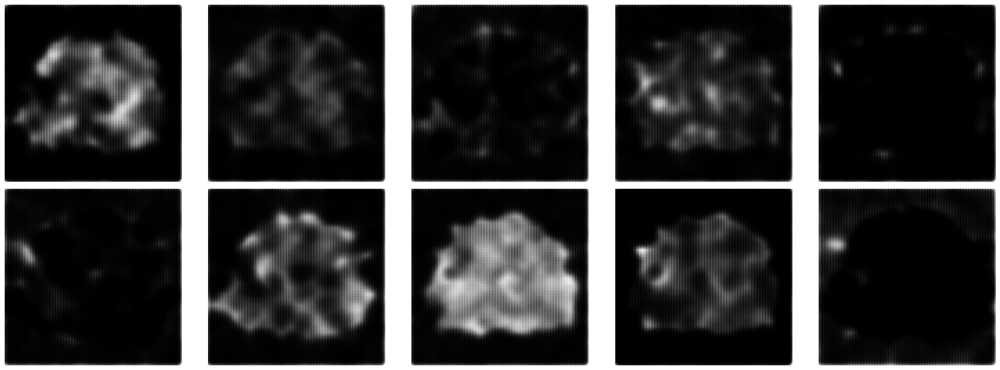

  0%|                                                                                                                        | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 1/3750 [00:00<07:16,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 2/3750 [00:00<06:55,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                                                                                                | 3/3750 [00:00<06:49,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                                                                                                | 4/3750 [00:00<06:45,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 5/3750 [00:00<06:43,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                                                                                               | 6/3750 [00:00<06:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 7/3750 [00:00<06:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                                                                                               | 8/3750 [00:00<06:45,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                               | 9/3750 [00:00<06:43,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                              | 10/3750 [00:01<06:41,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                              | 11/3750 [00:01<06:39,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▎                                                                                                              | 12/3750 [00:01<06:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 13/3750 [00:01<06:41,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 14/3750 [00:01<06:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 15/3750 [00:01<06:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▍                                                                                                              | 16/3750 [00:01<06:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▌                                                                                                              | 17/3750 [00:01<06:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▌                                                                                                              | 18/3750 [00:01<06:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 19/3750 [00:02<06:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 20/3750 [00:02<06:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                                                                                              | 21/3750 [00:02<06:36,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▋                                                                                                              | 22/3750 [00:02<06:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▋                                                                                                              | 23/3750 [00:02<06:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 24/3750 [00:02<06:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▋                                                                                                              | 25/3750 [00:02<06:41,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 26/3750 [00:02<06:45,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 27/3750 [00:02<06:42,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 28/3750 [00:03<06:40,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▊                                                                                                              | 29/3750 [00:03<06:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 30/3750 [00:03<06:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 31/3750 [00:03<06:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 32/3750 [00:03<06:40,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▉                                                                                                              | 33/3750 [00:03<06:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 34/3750 [00:03<06:37,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 35/3750 [00:03<06:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 36/3750 [00:03<06:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 37/3750 [00:03<06:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█                                                                                                              | 38/3750 [00:04<06:35,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▏                                                                                                             | 39/3750 [00:04<06:34,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 40/3750 [00:04<06:35,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 41/3750 [00:04<06:35,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▏                                                                                                             | 42/3750 [00:04<06:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 43/3750 [00:04<06:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 44/3750 [00:04<06:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▎                                                                                                             | 45/3750 [00:04<06:36,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▎                                                                                                             | 46/3750 [00:04<06:35,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 47/3750 [00:05<06:34,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 48/3750 [00:05<06:33,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▍                                                                                                             | 49/3750 [00:05<06:33,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▍                                                                                                             | 50/3750 [00:05<06:33,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  1%|█▌                                                                                                             | 51/3750 [00:05<06:44,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 52/3750 [00:05<06:41,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 53/3750 [00:05<06:39,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▌                                                                                                             | 54/3750 [00:05<06:37,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▋                                                                                                             | 55/3750 [00:05<06:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  1%|█▋                                                                                                             | 56/3750 [00:06<06:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▋                                                                                                             | 57/3750 [00:06<06:33,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


  2%|█▋                                                                                                             | 58/3750 [00:06<06:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▋                                                                                                             | 59/3750 [00:06<06:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▊                                                                                                             | 60/3750 [00:06<06:36,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▊                                                                                                             | 61/3750 [00:06<06:34,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▊                                                                                                             | 62/3750 [00:06<06:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▊                                                                                                             | 63/3750 [00:06<06:33,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█▉                                                                                                             | 64/3750 [00:06<06:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 65/3750 [00:06<06:33,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 66/3750 [00:07<06:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█▉                                                                                                             | 67/3750 [00:07<06:33,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


  2%|██                                                                                                             | 68/3750 [00:07<06:34,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██                                                                                                             | 69/3750 [00:07<06:32,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 70/3750 [00:07<06:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██                                                                                                             | 71/3750 [00:07<06:35,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 72/3750 [00:07<06:38,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 73/3750 [00:07<06:41,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 74/3750 [00:07<06:41,  9.16it/s]

1/1 [==============================] - 0s 11ms/step


  2%|██▏                                                                                                            | 75/3750 [00:08<06:41,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▏                                                                                                            | 76/3750 [00:08<06:41,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▎                                                                                                            | 77/3750 [00:08<06:40,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▎                                                                                                            | 78/3750 [00:08<06:37,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▎                                                                                                            | 79/3750 [00:08<06:38,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


  2%|██▎                                                                                                            | 80/3750 [00:08<06:36,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 81/3750 [00:08<06:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 82/3750 [00:08<06:33,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▍                                                                                                            | 83/3750 [00:08<06:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▍                                                                                                            | 84/3750 [00:09<06:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 85/3750 [00:09<06:31,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 86/3750 [00:09<06:30,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 87/3750 [00:09<06:30,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▌                                                                                                            | 88/3750 [00:09<06:30,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  2%|██▋                                                                                                            | 89/3750 [00:09<06:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 90/3750 [00:09<06:31,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 91/3750 [00:09<06:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▋                                                                                                            | 92/3750 [00:09<06:31,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  2%|██▊                                                                                                            | 93/3750 [00:09<06:30,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▊                                                                                                            | 94/3750 [00:10<06:29,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 95/3750 [00:10<06:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▊                                                                                                            | 96/3750 [00:10<06:29,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▊                                                                                                            | 97/3750 [00:10<06:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                            | 98/3750 [00:10<06:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                            | 99/3750 [00:10<06:31,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                           | 100/3750 [00:10<06:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  3%|██▉                                                                                                           | 101/3750 [00:10<06:29,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  3%|██▉                                                                                                           | 102/3750 [00:10<06:29,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███                                                                                                           | 103/3750 [00:11<06:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 104/3750 [00:11<06:46,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███                                                                                                           | 105/3750 [00:11<06:41,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███                                                                                                           | 106/3750 [00:11<06:38,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 107/3750 [00:11<06:34,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 108/3750 [00:11<06:34,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 109/3750 [00:11<06:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▏                                                                                                          | 110/3750 [00:11<06:31,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 111/3750 [00:11<06:29,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 112/3750 [00:12<06:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 113/3750 [00:12<06:28,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▎                                                                                                          | 114/3750 [00:12<06:27,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▎                                                                                                          | 115/3750 [00:12<06:34,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 116/3750 [00:12<06:33,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 117/3750 [00:12<06:33,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 118/3750 [00:12<06:32,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▍                                                                                                          | 119/3750 [00:12<06:30,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▌                                                                                                          | 120/3750 [00:12<06:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 121/3750 [00:12<06:28,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▌                                                                                                          | 122/3750 [00:13<06:26,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▌                                                                                                          | 123/3750 [00:13<06:25,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 124/3750 [00:13<06:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▋                                                                                                          | 125/3750 [00:13<06:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 126/3750 [00:13<06:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▋                                                                                                          | 127/3750 [00:13<06:36,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 128/3750 [00:13<06:33,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  3%|███▊                                                                                                          | 129/3750 [00:13<06:30,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▊                                                                                                          | 130/3750 [00:13<06:29,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  3%|███▊                                                                                                          | 131/3750 [00:14<06:28,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▊                                                                                                          | 132/3750 [00:14<06:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 133/3750 [00:14<06:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  4%|███▉                                                                                                          | 134/3750 [00:14<06:25,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  4%|███▉                                                                                                          | 135/3750 [00:14<06:25,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


  4%|███▉                                                                                                          | 136/3750 [00:14<06:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 137/3750 [00:14<06:28,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 138/3750 [00:14<06:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 139/3750 [00:14<06:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████                                                                                                          | 140/3750 [00:15<06:27,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 141/3750 [00:15<06:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▏                                                                                                         | 142/3750 [00:15<06:25,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▏                                                                                                         | 143/3750 [00:15<06:24,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  4%|████▏                                                                                                         | 144/3750 [00:15<06:24,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 145/3750 [00:15<06:24,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 146/3750 [00:15<06:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 147/3750 [00:15<06:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▎                                                                                                         | 148/3750 [00:15<06:25,  9.34it/s]

1/1 [==============================] - 0s 11ms/step


  4%|████▎                                                                                                         | 149/3750 [00:15<06:28,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▍                                                                                                         | 150/3750 [00:16<06:31,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▍                                                                                                         | 151/3750 [00:16<06:31,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▍                                                                                                         | 152/3750 [00:16<06:29,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▍                                                                                                         | 153/3750 [00:16<06:29,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 154/3750 [00:16<06:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 155/3750 [00:16<06:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 156/3750 [00:16<06:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▌                                                                                                         | 157/3750 [00:16<06:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 158/3750 [00:16<06:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 159/3750 [00:17<06:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 160/3750 [00:17<06:23,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▋                                                                                                         | 161/3750 [00:17<06:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 162/3750 [00:17<06:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 163/3750 [00:17<06:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 164/3750 [00:17<06:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 165/3750 [00:17<06:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▊                                                                                                         | 166/3750 [00:17<06:23,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


  4%|████▉                                                                                                         | 167/3750 [00:17<06:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  4%|████▉                                                                                                         | 168/3750 [00:18<06:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  5%|████▉                                                                                                         | 169/3750 [00:18<06:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  5%|████▉                                                                                                         | 170/3750 [00:18<06:22,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████                                                                                                         | 171/3750 [00:18<06:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 172/3750 [00:18<06:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████                                                                                                         | 173/3750 [00:18<06:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████                                                                                                         | 174/3750 [00:18<06:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 175/3750 [00:18<06:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 176/3750 [00:18<06:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 177/3750 [00:19<06:28,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▏                                                                                                        | 178/3750 [00:19<06:27,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 179/3750 [00:19<06:25,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 180/3750 [00:19<06:24,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 181/3750 [00:19<06:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 182/3750 [00:19<06:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▎                                                                                                        | 183/3750 [00:19<06:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 184/3750 [00:19<06:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 185/3750 [00:19<06:23,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 186/3750 [00:19<06:23,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▍                                                                                                        | 187/3750 [00:20<06:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▌                                                                                                        | 188/3750 [00:20<06:23,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▌                                                                                                        | 189/3750 [00:20<06:22,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 190/3750 [00:20<06:21,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▌                                                                                                        | 191/3750 [00:20<06:21,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 192/3750 [00:20<06:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 193/3750 [00:20<06:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 194/3750 [00:20<06:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 195/3750 [00:20<06:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▋                                                                                                        | 196/3750 [00:21<06:25,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 197/3750 [00:21<06:25,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█████▊                                                                                                        | 198/3750 [00:21<06:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 199/3750 [00:21<06:23,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▊                                                                                                        | 200/3750 [00:21<06:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 201/3750 [00:21<06:23,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 202/3750 [00:21<06:23,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 203/3750 [00:21<06:25,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█████▉                                                                                                        | 204/3750 [00:21<06:24,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██████                                                                                                        | 205/3750 [00:22<06:21,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██████                                                                                                        | 206/3750 [00:22<06:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████                                                                                                        | 207/3750 [00:22<06:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████                                                                                                        | 208/3750 [00:22<06:18,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 209/3750 [00:22<06:17,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▏                                                                                                       | 210/3750 [00:22<06:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 211/3750 [00:22<06:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 212/3750 [00:22<06:18,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▏                                                                                                       | 213/3750 [00:22<06:18,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▎                                                                                                       | 214/3750 [00:22<06:17,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▎                                                                                                       | 215/3750 [00:23<06:17,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 216/3750 [00:23<06:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▎                                                                                                       | 217/3750 [00:23<06:16,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 218/3750 [00:23<06:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 219/3750 [00:23<06:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▍                                                                                                       | 220/3750 [00:23<06:17,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▍                                                                                                       | 221/3750 [00:23<06:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 222/3750 [00:23<06:20,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 223/3750 [00:23<06:22,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 224/3750 [00:24<06:22,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▌                                                                                                       | 225/3750 [00:24<06:21,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 226/3750 [00:24<06:20,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██████▋                                                                                                       | 227/3750 [00:24<06:22,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 228/3750 [00:24<06:19,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 229/3750 [00:24<06:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▋                                                                                                       | 230/3750 [00:24<06:17,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 231/3750 [00:24<06:22,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 232/3750 [00:24<06:21,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 233/3750 [00:25<06:21,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▊                                                                                                       | 234/3750 [00:25<06:21,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 235/3750 [00:25<06:19,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 236/3750 [00:25<06:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██████▉                                                                                                       | 237/3750 [00:25<06:16,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██████▉                                                                                                       | 238/3750 [00:25<06:15,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  6%|███████                                                                                                       | 239/3750 [00:25<06:15,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████                                                                                                       | 240/3750 [00:25<06:14,  9.36it/s]

1/1 [==============================] - 0s 18ms/step


  6%|███████                                                                                                       | 241/3750 [00:25<06:29,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████                                                                                                       | 242/3750 [00:26<06:26,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


  6%|███████▏                                                                                                      | 243/3750 [00:26<06:22,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 244/3750 [00:26<06:20,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 245/3750 [00:26<06:18,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▏                                                                                                      | 246/3750 [00:26<06:19,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▏                                                                                                      | 247/3750 [00:26<06:19,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 248/3750 [00:26<06:18,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 249/3750 [00:26<06:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 250/3750 [00:26<06:16,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▎                                                                                                      | 251/3750 [00:26<06:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 252/3750 [00:27<06:16,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 253/3750 [00:27<06:15,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▍                                                                                                      | 254/3750 [00:27<06:16,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▍                                                                                                      | 255/3750 [00:27<06:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 256/3750 [00:27<06:15,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▌                                                                                                      | 257/3750 [00:27<06:13,  9.35it/s]

1/1 [==============================] - 0s 36ms/step


  7%|███████▌                                                                                                      | 258/3750 [00:27<06:49,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▌                                                                                                      | 259/3750 [00:27<06:39,  8.73it/s]

1/1 [==============================] - 0s 8ms/step


  7%|███████▋                                                                                                      | 260/3750 [00:27<06:29,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 261/3750 [00:28<06:27,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 262/3750 [00:28<06:24,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 263/3750 [00:28<06:24,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▋                                                                                                      | 264/3750 [00:28<06:19,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


  7%|███████▊                                                                                                      | 265/3750 [00:28<06:20,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 266/3750 [00:28<06:18,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


  7%|███████▊                                                                                                      | 267/3750 [00:28<06:19,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  7%|███████▊                                                                                                      | 268/3750 [00:28<06:21,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


  7%|███████▉                                                                                                      | 269/3750 [00:28<06:24,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


  7%|███████▉                                                                                                      | 270/3750 [00:29<06:26,  9.00it/s]

1/1 [==============================] - 0s 12ms/step


  7%|███████▉                                                                                                      | 271/3750 [00:29<06:33,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


  7%|███████▉                                                                                                      | 272/3750 [00:29<06:30,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 273/3750 [00:29<06:25,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 274/3750 [00:29<06:26,  8.99it/s]

1/1 [==============================] - 0s 11ms/step


  7%|████████                                                                                                      | 275/3750 [00:29<06:28,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████                                                                                                      | 276/3750 [00:29<06:24,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 277/3750 [00:29<06:20,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 278/3750 [00:29<06:19,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 279/3750 [00:30<06:19,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  7%|████████▏                                                                                                     | 280/3750 [00:30<06:17,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


  7%|████████▏                                                                                                     | 281/3750 [00:30<06:18,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 282/3750 [00:30<06:17,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 283/3750 [00:30<06:16,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▎                                                                                                     | 284/3750 [00:30<06:15,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▎                                                                                                     | 285/3750 [00:30<06:13,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 286/3750 [00:30<06:12,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 287/3750 [00:30<06:12,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▍                                                                                                     | 288/3750 [00:31<06:11,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  8%|████████▍                                                                                                     | 289/3750 [00:31<06:13,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


  8%|████████▌                                                                                                     | 290/3750 [00:31<09:16,  6.22it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 291/3750 [00:31<08:20,  6.92it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 292/3750 [00:31<07:40,  7.52it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 293/3750 [00:31<07:13,  7.98it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▌                                                                                                     | 294/3750 [00:31<06:54,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 295/3750 [00:31<06:40,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 296/3750 [00:32<06:32,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 297/3750 [00:32<06:25,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▋                                                                                                     | 298/3750 [00:32<06:23,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 299/3750 [00:32<06:18,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 300/3750 [00:32<06:16,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 301/3750 [00:32<06:15,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▊                                                                                                     | 302/3750 [00:32<06:14,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 303/3750 [00:32<06:13,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 304/3750 [00:32<06:12,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 305/3750 [00:33<06:10,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  8%|████████▉                                                                                                     | 306/3750 [00:33<06:09,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 307/3750 [00:33<06:11,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 308/3750 [00:33<06:10,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 309/3750 [00:33<06:09,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 310/3750 [00:33<06:08,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████                                                                                                     | 311/3750 [00:33<06:08,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 312/3750 [00:33<06:08,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 313/3750 [00:33<06:08,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 314/3750 [00:33<06:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▏                                                                                                    | 315/3750 [00:34<06:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▎                                                                                                    | 316/3750 [00:34<06:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▎                                                                                                    | 317/3750 [00:34<06:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  8%|█████████▎                                                                                                    | 318/3750 [00:34<06:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▎                                                                                                    | 319/3750 [00:34<06:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 320/3750 [00:34<06:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 321/3750 [00:34<06:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 322/3750 [00:34<06:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▍                                                                                                    | 323/3750 [00:34<06:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 324/3750 [00:35<06:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 325/3750 [00:35<06:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 326/3750 [00:35<06:15,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 327/3750 [00:35<06:13,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▌                                                                                                    | 328/3750 [00:35<06:11,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 329/3750 [00:35<06:11,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 330/3750 [00:35<06:09,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▋                                                                                                    | 331/3750 [00:35<06:07,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


  9%|█████████▋                                                                                                    | 332/3750 [00:35<06:07,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


  9%|█████████▊                                                                                                    | 333/3750 [00:36<06:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 334/3750 [00:36<06:09,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


  9%|█████████▊                                                                                                    | 335/3750 [00:36<06:09,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▊                                                                                                    | 336/3750 [00:36<06:09,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


  9%|█████████▉                                                                                                    | 337/3750 [00:36<06:10,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


  9%|█████████▉                                                                                                    | 338/3750 [00:36<06:11,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  9%|█████████▉                                                                                                    | 339/3750 [00:36<06:11,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


  9%|█████████▉                                                                                                    | 340/3750 [00:36<06:12,  9.16it/s]

1/1 [==============================] - 0s 11ms/step


  9%|██████████                                                                                                    | 341/3750 [00:36<06:11,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 342/3750 [00:37<06:08,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 343/3750 [00:37<06:06,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 344/3750 [00:37<06:09,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████                                                                                                    | 345/3750 [00:37<06:08,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 346/3750 [00:37<06:07,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  9%|██████████▏                                                                                                   | 347/3750 [00:37<06:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▏                                                                                                   | 348/3750 [00:37<06:06,  9.28it/s]

1/1 [==============================] - 0s 15ms/step


  9%|██████████▏                                                                                                   | 349/3750 [00:37<06:20,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▎                                                                                                   | 350/3750 [00:37<06:17,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▎                                                                                                   | 351/3750 [00:38<06:13,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▎                                                                                                   | 352/3750 [00:38<06:10,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▎                                                                                                   | 353/3750 [00:38<06:11,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▍                                                                                                   | 354/3750 [00:38<06:09,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▍                                                                                                   | 355/3750 [00:38<06:07,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  9%|██████████▍                                                                                                   | 356/3750 [00:38<06:07,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▍                                                                                                   | 357/3750 [00:38<06:08,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 358/3750 [00:38<06:06,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▌                                                                                                   | 359/3750 [00:38<06:05,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 10%|██████████▌                                                                                                   | 360/3750 [00:38<06:05,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▌                                                                                                   | 361/3750 [00:39<06:05,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▌                                                                                                   | 362/3750 [00:39<06:04,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 363/3750 [00:39<06:07,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 364/3750 [00:39<06:06,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 365/3750 [00:39<06:04,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▋                                                                                                   | 366/3750 [00:39<06:03,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▊                                                                                                   | 367/3750 [00:39<06:02,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 10%|██████████▊                                                                                                   | 368/3750 [00:39<06:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▊                                                                                                   | 369/3750 [00:39<06:02,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▊                                                                                                   | 370/3750 [00:40<06:09,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 371/3750 [00:40<06:06,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 372/3750 [00:40<06:07,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 373/3750 [00:40<06:05,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 10%|██████████▉                                                                                                   | 374/3750 [00:40<06:04,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 375/3750 [00:40<06:03,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 376/3750 [00:40<06:02,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████                                                                                                   | 377/3750 [00:40<06:02,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 378/3750 [00:40<06:02,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████                                                                                                   | 379/3750 [00:41<06:02,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███████████▏                                                                                                  | 380/3750 [00:41<06:01,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 381/3750 [00:41<06:00,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 382/3750 [00:41<06:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▏                                                                                                  | 383/3750 [00:41<06:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▎                                                                                                  | 384/3750 [00:41<06:02,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▎                                                                                                  | 385/3750 [00:41<06:02,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▎                                                                                                  | 386/3750 [00:41<06:01,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▎                                                                                                  | 387/3750 [00:41<06:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 388/3750 [00:41<06:01,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 389/3750 [00:42<06:06,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 390/3750 [00:42<06:05,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▍                                                                                                  | 391/3750 [00:42<06:07,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███████████▍                                                                                                  | 392/3750 [00:42<06:07,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███████████▌                                                                                                  | 393/3750 [00:42<06:04,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▌                                                                                                  | 394/3750 [00:42<06:03,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▌                                                                                                  | 395/3750 [00:42<06:02,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 11%|███████████▌                                                                                                  | 396/3750 [00:42<06:00,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▋                                                                                                  | 397/3750 [00:42<05:59,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▋                                                                                                  | 398/3750 [00:43<05:59,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▋                                                                                                  | 399/3750 [00:43<05:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▋                                                                                                  | 400/3750 [00:43<05:59,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 401/3750 [00:43<06:02,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 402/3750 [00:43<06:01,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 403/3750 [00:43<06:01,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▊                                                                                                  | 404/3750 [00:43<06:00,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 405/3750 [00:43<06:00,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 406/3750 [00:43<05:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 407/3750 [00:44<05:59,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 408/3750 [00:44<05:59,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 11%|███████████▉                                                                                                  | 409/3750 [00:44<05:58,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 410/3750 [00:44<06:01,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 411/3750 [00:44<06:00,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████                                                                                                  | 412/3750 [00:44<06:01,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████████████                                                                                                  | 413/3750 [00:44<06:01,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████████████▏                                                                                                 | 414/3750 [00:44<06:03,  9.17it/s]

1/1 [==============================] - 0s 11ms/step


 11%|████████████▏                                                                                                 | 415/3750 [00:44<06:04,  9.16it/s]

1/1 [==============================] - 0s 12ms/step


 11%|████████████▏                                                                                                 | 416/3750 [00:45<06:08,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████████████▏                                                                                                 | 417/3750 [00:45<06:08,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 418/3750 [00:45<06:04,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▎                                                                                                 | 419/3750 [00:45<06:00,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████████████▎                                                                                                 | 420/3750 [00:45<06:02,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▎                                                                                                 | 421/3750 [00:45<06:00,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 422/3750 [00:45<06:00,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 423/3750 [00:45<05:58,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████████████▍                                                                                                 | 424/3750 [00:45<05:57,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 425/3750 [00:45<05:57,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▍                                                                                                 | 426/3750 [00:46<05:57,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 427/3750 [00:46<05:56,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 428/3750 [00:46<05:55,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 429/3750 [00:46<05:57,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▌                                                                                                 | 430/3750 [00:46<05:57,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████████████▋                                                                                                 | 431/3750 [00:46<05:56,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▋                                                                                                 | 432/3750 [00:46<05:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▋                                                                                                 | 433/3750 [00:46<05:55,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▋                                                                                                 | 434/3750 [00:46<05:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 435/3750 [00:47<05:55,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 436/3750 [00:47<05:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 437/3750 [00:47<05:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▊                                                                                                 | 438/3750 [00:47<05:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 439/3750 [00:47<05:57,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 440/3750 [00:47<05:57,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 441/3750 [00:47<05:57,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 442/3750 [00:47<05:56,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████████████▉                                                                                                 | 443/3750 [00:47<05:56,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 444/3750 [00:48<05:55,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████                                                                                                 | 445/3750 [00:48<05:54,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████                                                                                                 | 446/3750 [00:48<05:54,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████                                                                                                 | 447/3750 [00:48<05:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 448/3750 [00:48<05:54,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 449/3750 [00:48<05:56,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▏                                                                                                | 450/3750 [00:48<05:55,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▏                                                                                                | 451/3750 [00:48<05:54,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 452/3750 [00:48<05:53,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 453/3750 [00:49<05:53,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 454/3750 [00:49<05:52,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▎                                                                                                | 455/3750 [00:49<05:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 456/3750 [00:49<05:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 457/3750 [00:49<05:52,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 458/3750 [00:49<05:54,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 459/3750 [00:49<05:55,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▍                                                                                                | 460/3750 [00:49<05:54,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 461/3750 [00:49<05:53,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 462/3750 [00:49<06:00,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▌                                                                                                | 463/3750 [00:50<05:57,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▌                                                                                                | 464/3750 [00:50<05:54,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 465/3750 [00:50<05:53,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▋                                                                                                | 466/3750 [00:50<05:52,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 12%|█████████████▋                                                                                                | 467/3750 [00:50<05:50,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 12%|█████████████▋                                                                                                | 468/3750 [00:50<05:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 469/3750 [00:50<05:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 470/3750 [00:50<05:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 471/3750 [00:50<05:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 472/3750 [00:51<05:51,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▊                                                                                                | 473/3750 [00:51<05:51,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 474/3750 [00:51<05:50,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 475/3750 [00:51<05:49,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████████████▉                                                                                                | 476/3750 [00:51<05:49,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████████████▉                                                                                                | 477/3750 [00:51<05:51,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 478/3750 [00:51<05:52,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████                                                                                                | 479/3750 [00:51<05:52,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 480/3750 [00:51<05:52,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████                                                                                                | 481/3750 [00:52<05:52,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 482/3750 [00:52<06:15,  8.71it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▏                                                                                               | 483/3750 [00:52<06:08,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 484/3750 [00:52<06:01,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▏                                                                                               | 485/3750 [00:52<05:57,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 486/3750 [00:52<05:55,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 487/3750 [00:52<05:55,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 488/3750 [00:52<05:54,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 489/3750 [00:52<05:52,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▎                                                                                               | 490/3750 [00:53<05:51,  9.28it/s]

1/1 [==============================] - 0s 12ms/step


 13%|██████████████▍                                                                                               | 491/3750 [00:53<05:52,  9.23it/s]

1/1 [==============================] - 0s 11ms/step


 13%|██████████████▍                                                                                               | 492/3750 [00:53<05:54,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▍                                                                                               | 493/3750 [00:53<05:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▍                                                                                               | 494/3750 [00:53<05:52,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 495/3750 [00:53<05:50,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 496/3750 [00:53<05:52,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 497/3750 [00:53<05:51,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▌                                                                                               | 498/3750 [00:53<05:49,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▋                                                                                               | 499/3750 [00:53<05:48,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▋                                                                                               | 500/3750 [00:54<05:48,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▋                                                                                               | 501/3750 [00:54<05:47,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▋                                                                                               | 502/3750 [00:54<05:47,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 503/3750 [00:54<05:47,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▊                                                                                               | 504/3750 [00:54<05:46,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 13%|██████████████▊                                                                                               | 505/3750 [00:54<05:46,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 13%|██████████████▊                                                                                               | 506/3750 [00:54<05:49,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▊                                                                                               | 507/3750 [00:54<05:49,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 508/3750 [00:54<05:48,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 509/3750 [00:55<05:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 14%|██████████████▉                                                                                               | 510/3750 [00:55<05:47,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 14%|██████████████▉                                                                                               | 511/3750 [00:55<05:49,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 512/3750 [00:55<05:47,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 513/3750 [00:55<05:46,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████                                                                                               | 514/3750 [00:55<05:46,  9.34it/s]

1/1 [==============================] - 0s 11ms/step


 14%|███████████████                                                                                               | 515/3750 [00:55<06:15,  8.62it/s]

1/1 [==============================] - 0s 12ms/step


 14%|███████████████▏                                                                                              | 516/3750 [00:55<06:14,  8.64it/s]

1/1 [==============================] - 0s 12ms/step


 14%|███████████████▏                                                                                              | 517/3750 [00:55<06:13,  8.66it/s]

1/1 [==============================] - 0s 12ms/step


 14%|███████████████▏                                                                                              | 518/3750 [00:56<06:16,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 14%|███████████████▏                                                                                              | 519/3750 [00:56<06:22,  8.44it/s]

1/1 [==============================] - 0s 10ms/step


 14%|███████████████▎                                                                                              | 520/3750 [00:56<06:27,  8.34it/s]

1/1 [==============================] - 0s 11ms/step


 14%|███████████████▎                                                                                              | 521/3750 [00:56<06:38,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 522/3750 [00:56<06:41,  8.04it/s]

1/1 [==============================] - 0s 10ms/step


 14%|███████████████▎                                                                                              | 523/3750 [00:56<06:43,  7.99it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▎                                                                                              | 524/3750 [00:56<06:28,  8.29it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 525/3750 [00:56<06:15,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 526/3750 [00:57<06:06,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▍                                                                                              | 527/3750 [00:57<06:00,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▍                                                                                              | 528/3750 [00:57<06:12,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▌                                                                                              | 529/3750 [00:57<06:03,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▌                                                                                              | 530/3750 [00:57<05:57,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▌                                                                                              | 531/3750 [00:57<05:53,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▌                                                                                              | 532/3750 [00:57<05:53,  9.11it/s]

1/1 [==============================] - 0s 11ms/step


 14%|███████████████▋                                                                                              | 533/3750 [00:57<06:01,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 14%|███████████████▋                                                                                              | 534/3750 [00:57<06:05,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▋                                                                                              | 535/3750 [00:58<06:02,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▋                                                                                              | 536/3750 [00:58<05:59,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 537/3750 [00:58<05:54,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 538/3750 [00:58<05:50,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 539/3750 [00:58<05:49,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▊                                                                                              | 540/3750 [00:58<05:47,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 14%|███████████████▊                                                                                              | 541/3750 [00:58<05:45,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▉                                                                                              | 542/3750 [00:58<05:43,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 14%|███████████████▉                                                                                              | 543/3750 [00:58<05:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 15%|███████████████▉                                                                                              | 544/3750 [00:59<05:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 15%|███████████████▉                                                                                              | 545/3750 [00:59<05:42,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████                                                                                              | 546/3750 [00:59<05:42,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 547/3750 [00:59<05:41,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 548/3750 [00:59<05:41,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████                                                                                              | 549/3750 [00:59<05:41,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 550/3750 [00:59<05:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 551/3750 [00:59<05:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▏                                                                                             | 552/3750 [00:59<05:40,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▏                                                                                             | 553/3750 [00:59<05:42,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 554/3750 [01:00<05:41,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▎                                                                                             | 555/3750 [01:00<05:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 556/3750 [01:00<05:41,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 557/3750 [01:00<05:47,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▎                                                                                             | 558/3750 [01:00<05:44,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 559/3750 [01:00<05:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▍                                                                                             | 560/3750 [01:00<05:41,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 561/3750 [01:00<05:40,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▍                                                                                             | 562/3750 [01:00<05:40,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 563/3750 [01:01<05:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 564/3750 [01:01<05:40,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▌                                                                                             | 565/3750 [01:01<05:40,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 15%|████████████████▌                                                                                             | 566/3750 [01:01<05:41,  9.33it/s]

1/1 [==============================] - 0s 11ms/step


 15%|████████████████▋                                                                                             | 567/3750 [01:01<05:44,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 15%|████████████████▋                                                                                             | 568/3750 [01:01<05:46,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 15%|████████████████▋                                                                                             | 569/3750 [01:01<05:48,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 570/3750 [01:01<05:45,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▋                                                                                             | 571/3750 [01:01<05:43,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 572/3750 [01:02<05:44,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 573/3750 [01:02<05:43,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 574/3750 [01:02<05:41,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▊                                                                                             | 575/3750 [01:02<05:41,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 576/3750 [01:02<05:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 577/3750 [01:02<05:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 578/3750 [01:02<05:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 15%|████████████████▉                                                                                             | 579/3750 [01:02<05:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████████████████                                                                                             | 580/3750 [01:02<05:37,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████████████████                                                                                             | 581/3750 [01:02<05:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████                                                                                             | 582/3750 [01:03<05:40,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████                                                                                             | 583/3750 [01:03<05:40,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 584/3750 [01:03<05:44,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 585/3750 [01:03<05:42,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 586/3750 [01:03<05:40,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▏                                                                                            | 587/3750 [01:03<05:39,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▏                                                                                            | 588/3750 [01:03<05:37,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 16%|█████████████████▎                                                                                            | 589/3750 [01:03<05:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▎                                                                                            | 590/3750 [01:03<05:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▎                                                                                            | 591/3750 [01:04<05:40,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▎                                                                                            | 592/3750 [01:04<05:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▍                                                                                            | 593/3750 [01:04<05:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▍                                                                                            | 594/3750 [01:04<05:40,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▍                                                                                            | 595/3750 [01:04<05:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▍                                                                                            | 596/3750 [01:04<05:37,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▌                                                                                            | 597/3750 [01:04<05:37,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▌                                                                                            | 598/3750 [01:04<05:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▌                                                                                            | 599/3750 [01:04<05:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▌                                                                                            | 600/3750 [01:05<05:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 601/3750 [01:05<05:38,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 602/3750 [01:05<05:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 603/3750 [01:05<05:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 604/3750 [01:05<05:37,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▋                                                                                            | 605/3750 [01:05<05:41,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 606/3750 [01:05<05:40,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 607/3750 [01:05<05:38,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▊                                                                                            | 608/3750 [01:05<05:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▊                                                                                            | 609/3750 [01:05<05:36,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 16%|█████████████████▉                                                                                            | 610/3750 [01:06<05:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 611/3750 [01:06<05:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 612/3750 [01:06<05:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 16%|█████████████████▉                                                                                            | 613/3750 [01:06<05:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 614/3750 [01:06<05:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████████████████                                                                                            | 615/3750 [01:06<05:34,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 616/3750 [01:06<05:33,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████                                                                                            | 617/3750 [01:06<05:33,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████████████████▏                                                                                           | 618/3750 [01:06<05:32,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 619/3750 [01:07<05:32,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 620/3750 [01:07<05:34,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▏                                                                                           | 621/3750 [01:07<05:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▏                                                                                           | 622/3750 [01:07<05:34,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 623/3750 [01:07<05:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 624/3750 [01:07<05:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 625/3750 [01:07<05:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▎                                                                                           | 626/3750 [01:07<05:33,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▍                                                                                           | 627/3750 [01:07<05:32,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 628/3750 [01:08<05:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 629/3750 [01:08<05:35,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▍                                                                                           | 630/3750 [01:08<05:33,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▌                                                                                           | 631/3750 [01:08<05:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 632/3750 [01:08<05:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▌                                                                                           | 633/3750 [01:08<05:32,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▌                                                                                           | 634/3750 [01:08<05:31,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 635/3750 [01:08<05:31,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 636/3750 [01:08<05:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▋                                                                                           | 637/3750 [01:08<05:32,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████████████████▋                                                                                           | 638/3750 [01:09<05:32,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▋                                                                                           | 639/3750 [01:09<05:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▊                                                                                           | 640/3750 [01:09<05:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▊                                                                                           | 641/3750 [01:09<05:33,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▊                                                                                           | 642/3750 [01:09<05:31,  9.37it/s]

1/1 [==============================] - 0s 11ms/step


 17%|██████████████████▊                                                                                           | 643/3750 [01:09<05:35,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████████████████▉                                                                                           | 644/3750 [01:09<05:35,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▉                                                                                           | 645/3750 [01:09<05:33,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████████████████▉                                                                                           | 646/3750 [01:09<05:32,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████████████████▉                                                                                           | 647/3750 [01:10<05:31,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 648/3750 [01:10<05:32,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████                                                                                           | 649/3750 [01:10<05:31,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████                                                                                           | 650/3750 [01:10<05:31,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████                                                                                           | 651/3750 [01:10<05:31,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 652/3750 [01:10<05:31,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 653/3750 [01:10<05:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 654/3750 [01:10<05:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 17%|███████████████████▏                                                                                          | 655/3750 [01:10<05:29,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 17%|███████████████████▏                                                                                          | 656/3750 [01:11<05:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 657/3750 [01:11<05:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 658/3750 [01:11<05:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 659/3750 [01:11<05:31,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▎                                                                                          | 660/3750 [01:11<05:31,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 661/3750 [01:11<05:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 662/3750 [01:11<05:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▍                                                                                          | 663/3750 [01:11<05:29,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▍                                                                                          | 664/3750 [01:11<05:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 665/3750 [01:11<05:28,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 666/3750 [01:12<05:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 667/3750 [01:12<05:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▌                                                                                          | 668/3750 [01:12<05:30,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▌                                                                                          | 669/3750 [01:12<05:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 670/3750 [01:12<05:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 671/3750 [01:12<05:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 672/3750 [01:12<05:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▋                                                                                          | 673/3750 [01:12<05:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 674/3750 [01:12<05:28,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████████████████▊                                                                                          | 675/3750 [01:13<05:30,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 676/3750 [01:13<05:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▊                                                                                          | 677/3750 [01:13<05:30,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████████████████▉                                                                                          | 678/3750 [01:13<05:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 679/3750 [01:13<05:28,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 680/3750 [01:13<05:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████████████████▉                                                                                          | 681/3750 [01:13<05:28,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 682/3750 [01:13<05:28,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 683/3750 [01:13<05:28,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 684/3750 [01:14<05:34,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████                                                                                          | 685/3750 [01:14<05:31,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 18%|████████████████████                                                                                          | 686/3750 [01:14<05:29,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 687/3750 [01:14<05:31,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 688/3750 [01:14<05:29,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 689/3750 [01:14<05:28,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▏                                                                                         | 690/3750 [01:14<05:27,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 691/3750 [01:14<05:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 692/3750 [01:14<05:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 18%|████████████████████▎                                                                                         | 693/3750 [01:14<05:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▎                                                                                         | 694/3750 [01:15<05:25,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 695/3750 [01:15<05:25,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▍                                                                                         | 696/3750 [01:15<05:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 697/3750 [01:15<05:27,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▍                                                                                         | 698/3750 [01:15<05:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 699/3750 [01:15<05:27,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 700/3750 [01:15<05:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▌                                                                                         | 701/3750 [01:15<05:26,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▌                                                                                         | 702/3750 [01:15<05:25,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▌                                                                                         | 703/3750 [01:16<05:24,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 704/3750 [01:16<05:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▋                                                                                         | 705/3750 [01:16<05:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 706/3750 [01:16<05:27,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▋                                                                                         | 707/3750 [01:16<05:27,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 708/3750 [01:16<05:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 709/3750 [01:16<05:26,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▊                                                                                         | 710/3750 [01:16<05:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▊                                                                                         | 711/3750 [01:16<05:25,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 19%|████████████████████▉                                                                                         | 712/3750 [01:17<05:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▉                                                                                         | 713/3750 [01:17<05:24,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 19%|████████████████████▉                                                                                         | 714/3750 [01:17<05:24,  9.35it/s]

1/1 [==============================] - 0s 12ms/step


 19%|████████████████████▉                                                                                         | 715/3750 [01:17<05:27,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 716/3750 [01:17<05:28,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 717/3750 [01:17<05:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████                                                                                         | 718/3750 [01:17<05:25,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 19%|█████████████████████                                                                                         | 719/3750 [01:17<05:26,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 19%|█████████████████████                                                                                         | 720/3750 [01:17<05:27,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 721/3750 [01:17<05:26,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▏                                                                                        | 722/3750 [01:18<05:25,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▏                                                                                        | 723/3750 [01:18<05:23,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 19%|█████████████████████▏                                                                                        | 724/3750 [01:18<05:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 725/3750 [01:18<05:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 726/3750 [01:18<05:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 727/3750 [01:18<05:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▎                                                                                        | 728/3750 [01:18<05:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▍                                                                                        | 729/3750 [01:18<05:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▍                                                                                        | 730/3750 [01:18<05:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 19%|█████████████████████▍                                                                                        | 731/3750 [01:19<05:23,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▍                                                                                        | 732/3750 [01:19<05:21,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▌                                                                                        | 733/3750 [01:19<05:21,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▌                                                                                        | 734/3750 [01:19<05:20,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 735/3750 [01:19<05:23,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 736/3750 [01:19<05:23,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▌                                                                                        | 737/3750 [01:19<05:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▋                                                                                        | 738/3750 [01:19<05:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▋                                                                                        | 739/3750 [01:19<05:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▋                                                                                        | 740/3750 [01:20<05:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▋                                                                                        | 741/3750 [01:20<05:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 742/3750 [01:20<05:21,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 743/3750 [01:20<05:21,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▊                                                                                        | 744/3750 [01:20<05:20,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▊                                                                                        | 745/3750 [01:20<05:23,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 746/3750 [01:20<05:21,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 747/3750 [01:20<05:21,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 20%|█████████████████████▉                                                                                        | 748/3750 [01:20<05:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 20%|█████████████████████▉                                                                                        | 749/3750 [01:20<05:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 750/3750 [01:21<05:20,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 751/3750 [01:21<05:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 752/3750 [01:21<05:19,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████                                                                                        | 753/3750 [01:21<05:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████                                                                                        | 754/3750 [01:21<05:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 755/3750 [01:21<05:20,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▏                                                                                       | 756/3750 [01:21<05:18,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 757/3750 [01:21<05:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▏                                                                                       | 758/3750 [01:21<05:18,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▎                                                                                       | 759/3750 [01:22<05:18,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 760/3750 [01:22<05:22,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▎                                                                                       | 761/3750 [01:22<05:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▎                                                                                       | 762/3750 [01:22<05:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 763/3750 [01:22<05:19,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 764/3750 [01:22<05:21,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 765/3750 [01:22<05:21,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▍                                                                                       | 766/3750 [01:22<05:20,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 20%|██████████████████████▍                                                                                       | 767/3750 [01:22<05:19,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 20%|██████████████████████▌                                                                                       | 768/3750 [01:23<05:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▌                                                                                       | 769/3750 [01:23<05:19,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▌                                                                                       | 770/3750 [01:23<05:18,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▌                                                                                       | 771/3750 [01:23<05:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 772/3750 [01:23<05:18,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 773/3750 [01:23<05:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▋                                                                                       | 774/3750 [01:23<05:19,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 21%|██████████████████████▋                                                                                       | 775/3750 [01:23<05:24,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 776/3750 [01:23<05:24,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 777/3750 [01:23<05:21,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 778/3750 [01:24<05:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▊                                                                                       | 779/3750 [01:24<05:22,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 780/3750 [01:24<05:20,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 781/3750 [01:24<05:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 782/3750 [01:24<05:18,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 21%|██████████████████████▉                                                                                       | 783/3750 [01:24<05:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 21%|██████████████████████▉                                                                                       | 784/3750 [01:24<05:18,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 785/3750 [01:24<05:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 786/3750 [01:24<05:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 787/3750 [01:25<05:17,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████                                                                                       | 788/3750 [01:25<05:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 789/3750 [01:25<05:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 790/3750 [01:25<05:16,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 791/3750 [01:25<05:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▏                                                                                      | 792/3750 [01:25<05:18,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 793/3750 [01:25<05:17,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 794/3750 [01:25<05:17,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▎                                                                                      | 795/3750 [01:25<05:29,  8.97it/s]

1/1 [==============================] - 0s 11ms/step


 21%|███████████████████████▎                                                                                      | 796/3750 [01:26<05:28,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 797/3750 [01:26<05:23,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 798/3750 [01:26<05:20,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 799/3750 [01:26<05:19,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▍                                                                                      | 800/3750 [01:26<05:17,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▍                                                                                      | 801/3750 [01:26<05:18,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 21%|███████████████████████▌                                                                                      | 802/3750 [01:26<05:19,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 803/3750 [01:26<05:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 804/3750 [01:26<05:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▌                                                                                      | 805/3750 [01:26<05:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 21%|███████████████████████▋                                                                                      | 806/3750 [01:27<05:15,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 807/3750 [01:27<05:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 808/3750 [01:27<05:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▋                                                                                      | 809/3750 [01:27<05:13,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▊                                                                                      | 810/3750 [01:27<05:12,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 811/3750 [01:27<05:14,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▊                                                                                      | 812/3750 [01:27<05:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▊                                                                                      | 813/3750 [01:27<05:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 814/3750 [01:27<05:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 22%|███████████████████████▉                                                                                      | 815/3750 [01:28<05:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 816/3750 [01:28<05:16,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 817/3750 [01:28<05:14,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 22%|███████████████████████▉                                                                                      | 818/3750 [01:28<05:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 819/3750 [01:28<05:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 820/3750 [01:28<05:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 821/3750 [01:28<05:15,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████                                                                                      | 822/3750 [01:28<05:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 823/3750 [01:28<05:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▏                                                                                     | 824/3750 [01:29<05:11,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████████████████████▏                                                                                     | 825/3750 [01:29<05:12,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▏                                                                                     | 826/3750 [01:29<05:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 827/3750 [01:29<05:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 828/3750 [01:29<05:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 829/3750 [01:29<05:11,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▎                                                                                     | 830/3750 [01:29<05:15,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████████████████████▍                                                                                     | 831/3750 [01:29<05:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 832/3750 [01:29<05:15,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 833/3750 [01:29<05:13,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████████████████████▍                                                                                     | 834/3750 [01:30<05:12,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▍                                                                                     | 835/3750 [01:30<05:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 836/3750 [01:30<05:11,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 837/3750 [01:30<05:11,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 838/3750 [01:30<05:10,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▌                                                                                     | 839/3750 [01:30<05:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 840/3750 [01:30<05:12,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████████████████████▋                                                                                     | 841/3750 [01:30<05:13,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 842/3750 [01:30<05:12,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████████████████████▋                                                                                     | 843/3750 [01:31<05:12,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 844/3750 [01:31<05:12,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 845/3750 [01:31<05:12,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 846/3750 [01:31<05:11,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 847/3750 [01:31<05:11,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▊                                                                                     | 848/3750 [01:31<05:10,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 849/3750 [01:31<05:12,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 850/3750 [01:31<05:12,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 851/3750 [01:31<05:12,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 23%|████████████████████████▉                                                                                     | 852/3750 [01:32<05:11,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 853/3750 [01:32<05:10,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 854/3750 [01:32<05:10,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████                                                                                     | 855/3750 [01:32<05:09,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████                                                                                     | 856/3750 [01:32<05:08,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 857/3750 [01:32<05:10,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 858/3750 [01:32<05:09,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 859/3750 [01:32<05:11,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▏                                                                                    | 860/3750 [01:32<05:11,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▎                                                                                    | 861/3750 [01:33<05:14,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 862/3750 [01:33<05:13,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 863/3750 [01:33<05:12,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 864/3750 [01:33<05:10,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▎                                                                                    | 865/3750 [01:33<05:10,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 866/3750 [01:33<05:08,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 867/3750 [01:33<05:08,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▍                                                                                    | 868/3750 [01:33<05:07,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▍                                                                                    | 869/3750 [01:33<05:10,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 870/3750 [01:33<05:09,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 871/3750 [01:34<05:11,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████████████████████▌                                                                                    | 872/3750 [01:34<05:11,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▌                                                                                    | 873/3750 [01:34<05:10,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▋                                                                                    | 874/3750 [01:34<05:08,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▋                                                                                    | 875/3750 [01:34<05:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▋                                                                                    | 876/3750 [01:34<05:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▋                                                                                    | 877/3750 [01:34<05:07,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████████████████████▊                                                                                    | 878/3750 [01:34<05:08,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 879/3750 [01:34<05:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 880/3750 [01:35<05:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████████████████████▊                                                                                    | 881/3750 [01:35<05:10,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▊                                                                                    | 882/3750 [01:35<05:09,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 883/3750 [01:35<05:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 884/3750 [01:35<05:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 885/3750 [01:35<05:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████████████████████▉                                                                                    | 886/3750 [01:35<05:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 887/3750 [01:35<05:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████                                                                                    | 888/3750 [01:35<05:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 889/3750 [01:36<05:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████                                                                                    | 890/3750 [01:36<05:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 891/3750 [01:36<05:05,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▏                                                                                   | 892/3750 [01:36<05:04,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▏                                                                                   | 893/3750 [01:36<05:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▏                                                                                   | 894/3750 [01:36<05:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 895/3750 [01:36<05:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 896/3750 [01:36<05:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 897/3750 [01:36<05:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 898/3750 [01:36<05:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▎                                                                                   | 899/3750 [01:37<05:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 900/3750 [01:37<05:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 901/3750 [01:37<05:08,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▍                                                                                   | 902/3750 [01:37<05:06,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▍                                                                                   | 903/3750 [01:37<05:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 904/3750 [01:37<05:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 905/3750 [01:37<05:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 906/3750 [01:37<05:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▌                                                                                   | 907/3750 [01:37<05:04,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 908/3750 [01:38<05:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 909/3750 [01:38<05:04,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 910/3750 [01:38<05:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▋                                                                                   | 911/3750 [01:38<05:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 912/3750 [01:38<05:03,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 913/3750 [01:38<05:02,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 914/3750 [01:38<05:01,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 24%|██████████████████████████▊                                                                                   | 915/3750 [01:38<05:01,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▊                                                                                   | 916/3750 [01:38<05:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▉                                                                                   | 917/3750 [01:38<05:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 24%|██████████████████████████▉                                                                                   | 918/3750 [01:39<05:03,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████████████████████▉                                                                                   | 919/3750 [01:39<05:02,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████████████████████▉                                                                                   | 920/3750 [01:39<05:02,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████                                                                                   | 921/3750 [01:39<05:02,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████                                                                                   | 922/3750 [01:39<05:01,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████                                                                                   | 923/3750 [01:39<05:02,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████                                                                                   | 924/3750 [01:39<05:02,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 925/3750 [01:39<05:02,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▏                                                                                  | 926/3750 [01:39<05:04,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 927/3750 [01:40<05:03,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▏                                                                                  | 928/3750 [01:40<05:02,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 929/3750 [01:40<05:02,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 930/3750 [01:40<05:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 931/3750 [01:40<05:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 932/3750 [01:40<05:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▎                                                                                  | 933/3750 [01:40<05:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 934/3750 [01:40<05:04,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 935/3750 [01:40<05:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▍                                                                                  | 936/3750 [01:41<05:04,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 25%|███████████████████████████▍                                                                                  | 937/3750 [01:41<05:04,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 938/3750 [01:41<05:02,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 939/3750 [01:41<05:01,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 940/3750 [01:41<05:00,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▌                                                                                  | 941/3750 [01:41<04:59,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 942/3750 [01:41<04:58,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▋                                                                                  | 943/3750 [01:41<04:59,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▋                                                                                  | 944/3750 [01:41<05:00,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▋                                                                                  | 945/3750 [01:42<05:02,  9.27it/s]

1/1 [==============================] - 0s 11ms/step


 25%|███████████████████████████▋                                                                                  | 946/3750 [01:42<05:03,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 947/3750 [01:42<05:02,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 25%|███████████████████████████▊                                                                                  | 948/3750 [01:42<05:02,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▊                                                                                  | 949/3750 [01:42<05:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▊                                                                                  | 950/3750 [01:42<05:04,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 951/3750 [01:42<05:03,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 25%|███████████████████████████▉                                                                                  | 952/3750 [01:42<05:01,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 953/3750 [01:42<05:00,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 25%|███████████████████████████▉                                                                                  | 954/3750 [01:42<05:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 25%|████████████████████████████                                                                                  | 955/3750 [01:43<05:00,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 25%|████████████████████████████                                                                                  | 956/3750 [01:43<05:01,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████                                                                                  | 957/3750 [01:43<04:59,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████                                                                                  | 958/3750 [01:43<04:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 959/3750 [01:43<04:56,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 960/3750 [01:43<04:56,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 961/3750 [01:43<04:56,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▏                                                                                 | 962/3750 [01:43<04:57,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▏                                                                                 | 963/3750 [01:43<04:56,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 964/3750 [01:44<04:59,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 965/3750 [01:44<04:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 966/3750 [01:44<04:59,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▎                                                                                 | 967/3750 [01:44<04:58,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 968/3750 [01:44<05:01,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 969/3750 [01:44<04:59,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▍                                                                                 | 970/3750 [01:44<04:58,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▍                                                                                 | 971/3750 [01:44<04:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 972/3750 [01:44<04:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▌                                                                                 | 973/3750 [01:45<04:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 974/3750 [01:45<04:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▌                                                                                 | 975/3750 [01:45<04:57,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 976/3750 [01:45<04:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 977/3750 [01:45<04:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 978/3750 [01:45<04:55,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▋                                                                                 | 979/3750 [01:45<04:54,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▋                                                                                 | 980/3750 [01:45<04:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 981/3750 [01:45<04:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 982/3750 [01:45<04:54,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 983/3750 [01:46<04:56,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▊                                                                                 | 984/3750 [01:46<04:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 985/3750 [01:46<04:55,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 986/3750 [01:46<04:55,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 26%|████████████████████████████▉                                                                                 | 987/3750 [01:46<04:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 26%|████████████████████████████▉                                                                                 | 988/3750 [01:46<04:54,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 989/3750 [01:46<04:54,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████                                                                                 | 990/3750 [01:46<04:53,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████                                                                                 | 991/3750 [01:46<04:53,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 26%|█████████████████████████████                                                                                 | 992/3750 [01:47<04:53,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 26%|█████████████████████████████▏                                                                                | 993/3750 [01:47<04:56,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 994/3750 [01:47<04:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 995/3750 [01:47<04:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 996/3750 [01:47<04:54,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                                | 997/3750 [01:47<04:54,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                                | 998/3750 [01:47<04:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                                | 999/3750 [01:47<04:53,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████                                                                                | 1000/3750 [01:47<04:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████                                                                                | 1001/3750 [01:47<04:52,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████                                                                                | 1002/3750 [01:48<04:52,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1003/3750 [01:48<04:57,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1004/3750 [01:48<04:57,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1005/3750 [01:48<04:56,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▏                                                                               | 1006/3750 [01:48<04:55,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1007/3750 [01:48<04:56,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                               | 1008/3750 [01:48<04:55,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▎                                                                               | 1009/3750 [01:48<04:54,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▎                                                                               | 1010/3750 [01:48<04:53,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1011/3750 [01:49<04:51,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1012/3750 [01:49<04:54,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1013/3750 [01:49<04:54,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▍                                                                               | 1014/3750 [01:49<04:53,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1015/3750 [01:49<04:52,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1016/3750 [01:49<04:58,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▌                                                                               | 1017/3750 [01:49<04:55,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▌                                                                               | 1018/3750 [01:49<04:55,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 27%|█████████████████████████████▌                                                                               | 1019/3750 [01:49<04:55,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▋                                                                               | 1020/3750 [01:50<04:53,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1021/3750 [01:50<04:54,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1022/3750 [01:50<04:53,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▋                                                                               | 1023/3750 [01:50<04:53,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1024/3750 [01:50<04:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1025/3750 [01:50<04:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1026/3750 [01:50<04:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▊                                                                               | 1027/3750 [01:50<04:51,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1028/3750 [01:50<04:50,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▉                                                                               | 1029/3750 [01:51<04:49,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 27%|█████████████████████████████▉                                                                               | 1030/3750 [01:51<04:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 27%|█████████████████████████████▉                                                                               | 1031/3750 [01:51<04:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 28%|█████████████████████████████▉                                                                               | 1032/3750 [01:51<04:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1033/3750 [01:51<04:50,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1034/3750 [01:51<04:50,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████                                                                               | 1035/3750 [01:51<04:49,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████                                                                               | 1036/3750 [01:51<04:53,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1037/3750 [01:51<04:51,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▏                                                                              | 1038/3750 [01:51<04:50,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1039/3750 [01:52<04:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▏                                                                              | 1040/3750 [01:52<04:48,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1041/3750 [01:52<04:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1042/3750 [01:52<04:50,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1043/3750 [01:52<04:50,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▎                                                                              | 1044/3750 [01:52<04:49,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▎                                                                              | 1045/3750 [01:52<04:48,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1046/3750 [01:52<04:48,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1047/3750 [01:52<04:47,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1048/3750 [01:53<04:51,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▍                                                                              | 1049/3750 [01:53<04:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1050/3750 [01:53<04:51,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1051/3750 [01:53<04:51,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1052/3750 [01:53<04:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▌                                                                              | 1053/3750 [01:53<04:49,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1054/3750 [01:53<04:48,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1055/3750 [01:53<04:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1056/3750 [01:53<04:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▋                                                                              | 1057/3750 [01:54<04:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1058/3750 [01:54<04:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1059/3750 [01:54<04:47,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1060/3750 [01:54<04:49,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1061/3750 [01:54<04:48,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▊                                                                              | 1062/3750 [01:54<04:47,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1063/3750 [01:54<04:47,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████████████████████████▉                                                                              | 1064/3750 [01:54<04:46,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1065/3750 [01:54<04:45,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████████████████████████▉                                                                              | 1066/3750 [01:54<04:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████████████████████████                                                                              | 1067/3750 [01:55<04:46,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████████████████████████                                                                              | 1068/3750 [01:55<04:45,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████                                                                              | 1069/3750 [01:55<04:45,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████                                                                              | 1070/3750 [01:55<04:47,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1071/3750 [01:55<04:47,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1072/3750 [01:55<04:47,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████████████████████████▏                                                                             | 1073/3750 [01:55<04:48,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1074/3750 [01:55<04:48,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▏                                                                             | 1075/3750 [01:55<04:47,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1076/3750 [01:56<04:47,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1077/3750 [01:56<04:46,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1078/3750 [01:56<04:46,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▎                                                                             | 1079/3750 [01:56<04:47,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▍                                                                             | 1080/3750 [01:56<04:46,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1081/3750 [01:56<04:45,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▍                                                                             | 1082/3750 [01:56<04:45,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▍                                                                             | 1083/3750 [01:56<04:44,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1084/3750 [01:56<04:43,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1085/3750 [01:57<04:42,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▌                                                                             | 1086/3750 [01:57<04:42,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1087/3750 [01:57<04:43,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████████████████████████▌                                                                             | 1088/3750 [01:57<04:43,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1089/3750 [01:57<04:44,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1090/3750 [01:57<04:43,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1091/3750 [01:57<04:44,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▋                                                                             | 1092/3750 [01:57<04:44,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▊                                                                             | 1093/3750 [01:57<04:43,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▊                                                                             | 1094/3750 [01:57<04:43,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▊                                                                             | 1095/3750 [01:58<04:47,  9.23it/s]

1/1 [==============================] - 0s 11ms/step


 29%|███████████████████████████████▊                                                                             | 1096/3750 [01:58<04:48,  9.19it/s]

1/1 [==============================] - 0s 11ms/step


 29%|███████████████████████████████▉                                                                             | 1097/3750 [01:58<04:49,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1098/3750 [01:58<04:49,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1099/3750 [01:58<04:47,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████████████████████████▉                                                                             | 1100/3750 [01:58<04:45,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1101/3750 [01:58<04:45,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1102/3750 [01:58<04:44,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 29%|████████████████████████████████                                                                             | 1103/3750 [01:58<04:43,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 29%|████████████████████████████████                                                                             | 1104/3750 [01:59<04:42,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████                                                                             | 1105/3750 [01:59<04:42,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 29%|████████████████████████████████▏                                                                            | 1106/3750 [01:59<04:42,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▏                                                                            | 1107/3750 [01:59<04:41,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▏                                                                            | 1108/3750 [01:59<04:43,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▏                                                                            | 1109/3750 [01:59<04:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1110/3750 [01:59<04:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1111/3750 [01:59<04:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1112/3750 [01:59<04:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▎                                                                            | 1113/3750 [02:00<04:42,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1114/3750 [02:00<04:41,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1115/3750 [02:00<04:41,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▍                                                                            | 1116/3750 [02:00<04:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1117/3750 [02:00<04:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▍                                                                            | 1118/3750 [02:00<04:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1119/3750 [02:00<04:41,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1120/3750 [02:00<04:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▌                                                                            | 1121/3750 [02:00<04:41,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 30%|████████████████████████████████▌                                                                            | 1122/3750 [02:00<04:41,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1123/3750 [02:01<04:44,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▋                                                                            | 1124/3750 [02:01<04:43,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▋                                                                            | 1125/3750 [02:01<04:42,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▋                                                                            | 1126/3750 [02:01<04:41,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1127/3750 [02:01<04:42,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1128/3750 [02:01<04:42,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1129/3750 [02:01<04:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1130/3750 [02:01<04:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▊                                                                            | 1131/3750 [02:01<04:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1132/3750 [02:02<04:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1133/3750 [02:02<04:38,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 30%|████████████████████████████████▉                                                                            | 1134/3750 [02:02<04:38,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 30%|████████████████████████████████▉                                                                            | 1135/3750 [02:02<04:37,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1136/3750 [02:02<04:37,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1137/3750 [02:02<04:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1138/3750 [02:02<04:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████                                                                            | 1139/3750 [02:02<04:38,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1140/3750 [02:02<04:38,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1141/3750 [02:03<04:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 30%|█████████████████████████████████▏                                                                           | 1142/3750 [02:03<04:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 30%|█████████████████████████████████▏                                                                           | 1143/3750 [02:03<04:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1144/3750 [02:03<04:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1145/3750 [02:03<04:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1146/3750 [02:03<04:39,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1147/3750 [02:03<04:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▎                                                                           | 1148/3750 [02:03<04:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1149/3750 [02:03<04:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1150/3750 [02:03<04:41,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1151/3750 [02:04<04:39,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▍                                                                           | 1152/3750 [02:04<04:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1153/3750 [02:04<04:37,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▌                                                                           | 1154/3750 [02:04<04:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▌                                                                           | 1155/3750 [02:04<04:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▌                                                                           | 1156/3750 [02:04<04:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1157/3750 [02:04<04:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1158/3750 [02:04<04:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1159/3750 [02:04<04:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▋                                                                           | 1160/3750 [02:05<04:36,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▋                                                                           | 1161/3750 [02:05<04:35,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 31%|█████████████████████████████████▊                                                                           | 1162/3750 [02:05<04:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1163/3750 [02:05<04:38,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 31%|█████████████████████████████████▊                                                                           | 1164/3750 [02:05<04:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▊                                                                           | 1165/3750 [02:05<04:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1166/3750 [02:05<04:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1167/3750 [02:05<04:41,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1168/3750 [02:05<04:39,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 31%|█████████████████████████████████▉                                                                           | 1169/3750 [02:06<04:37,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1170/3750 [02:06<04:36,  9.32it/s]

1/1 [==============================] - 0s 11ms/step


 31%|██████████████████████████████████                                                                           | 1171/3750 [02:06<04:38,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████                                                                           | 1172/3750 [02:06<04:37,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1173/3750 [02:06<04:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 31%|██████████████████████████████████                                                                           | 1174/3750 [02:06<04:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1175/3750 [02:06<04:36,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1176/3750 [02:06<04:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1177/3750 [02:06<04:37,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▏                                                                          | 1178/3750 [02:06<04:36,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1179/3750 [02:07<04:40,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1180/3750 [02:07<04:39,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 31%|██████████████████████████████████▎                                                                          | 1181/3750 [02:07<04:44,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▎                                                                          | 1182/3750 [02:07<04:41,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▍                                                                          | 1183/3750 [02:07<04:38,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1184/3750 [02:07<04:37,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1185/3750 [02:07<04:37,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▍                                                                          | 1186/3750 [02:07<04:37,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1187/3750 [02:07<04:36,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1188/3750 [02:08<04:35,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1189/3750 [02:08<04:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1190/3750 [02:08<04:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▌                                                                          | 1191/3750 [02:08<04:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1192/3750 [02:08<04:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1193/3750 [02:08<04:32,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1194/3750 [02:08<04:33,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▋                                                                          | 1195/3750 [02:08<04:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1196/3750 [02:08<04:33,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1197/3750 [02:09<04:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▊                                                                          | 1198/3750 [02:09<04:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 32%|██████████████████████████████████▊                                                                          | 1199/3750 [02:09<04:31,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1200/3750 [02:09<04:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1201/3750 [02:09<04:31,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1202/3750 [02:09<04:32,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1203/3750 [02:09<04:31,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 32%|██████████████████████████████████▉                                                                          | 1204/3750 [02:09<04:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1205/3750 [02:09<04:33,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1206/3750 [02:09<04:33,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1207/3750 [02:10<04:33,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████                                                                          | 1208/3750 [02:10<04:31,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1209/3750 [02:10<04:31,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1210/3750 [02:10<04:31,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▏                                                                         | 1211/3750 [02:10<04:30,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▏                                                                         | 1212/3750 [02:10<04:30,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1213/3750 [02:10<04:29,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 32%|███████████████████████████████████▎                                                                         | 1214/3750 [02:10<04:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1215/3750 [02:10<04:34,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1216/3750 [02:11<04:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▎                                                                         | 1217/3750 [02:11<04:32,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 32%|███████████████████████████████████▍                                                                         | 1218/3750 [02:11<04:31,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1219/3750 [02:11<04:31,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▍                                                                         | 1220/3750 [02:11<04:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▍                                                                         | 1221/3750 [02:11<04:29,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1222/3750 [02:11<04:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1223/3750 [02:11<04:31,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1224/3750 [02:11<04:31,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▌                                                                         | 1225/3750 [02:12<04:30,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1226/3750 [02:12<04:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▋                                                                         | 1227/3750 [02:12<04:29,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1228/3750 [02:12<04:29,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▋                                                                         | 1229/3750 [02:12<04:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1230/3750 [02:12<04:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1231/3750 [02:12<04:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 33%|███████████████████████████████████▊                                                                         | 1232/3750 [02:12<04:28,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1233/3750 [02:12<04:30,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▊                                                                         | 1234/3750 [02:12<04:31,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1235/3750 [02:13<04:47,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1236/3750 [02:13<04:42,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1237/3750 [02:13<04:42,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 33%|███████████████████████████████████▉                                                                         | 1238/3750 [02:13<04:37,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1239/3750 [02:13<04:34,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████                                                                         | 1240/3750 [02:13<04:31,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1241/3750 [02:13<04:30,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████                                                                         | 1242/3750 [02:13<04:30,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1243/3750 [02:13<04:29,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1244/3750 [02:14<04:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1245/3750 [02:14<04:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1246/3750 [02:14<04:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▏                                                                        | 1247/3750 [02:14<04:27,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████████████████████████████▎                                                                        | 1248/3750 [02:14<04:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1249/3750 [02:14<04:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1250/3750 [02:14<04:26,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▎                                                                        | 1251/3750 [02:14<04:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1252/3750 [02:14<04:26,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1253/3750 [02:15<04:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▍                                                                        | 1254/3750 [02:15<04:26,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████████████████████████████▍                                                                        | 1255/3750 [02:15<04:25,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████████████████████████████▌                                                                        | 1256/3750 [02:15<04:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1257/3750 [02:15<04:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1258/3750 [02:15<04:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1259/3750 [02:15<04:26,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▌                                                                        | 1260/3750 [02:15<04:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1261/3750 [02:15<04:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1262/3750 [02:16<04:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1263/3750 [02:16<04:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▋                                                                        | 1264/3750 [02:16<04:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1265/3750 [02:16<04:25,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1266/3750 [02:16<04:24,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1267/3750 [02:16<04:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▊                                                                        | 1268/3750 [02:16<04:24,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1269/3750 [02:16<04:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1270/3750 [02:16<04:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1271/3750 [02:16<04:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 34%|████████████████████████████████████▉                                                                        | 1272/3750 [02:17<04:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1273/3750 [02:17<04:24,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████████████████████████████                                                                        | 1274/3750 [02:17<04:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1275/3750 [02:17<04:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1276/3750 [02:17<04:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████                                                                        | 1277/3750 [02:17<04:24,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1278/3750 [02:17<04:23,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▏                                                                       | 1279/3750 [02:17<04:23,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▏                                                                       | 1280/3750 [02:17<04:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▏                                                                       | 1281/3750 [02:18<04:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1282/3750 [02:18<04:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1283/3750 [02:18<04:22,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1284/3750 [02:18<04:22,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▎                                                                       | 1285/3750 [02:18<04:22,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1286/3750 [02:18<04:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1287/3750 [02:18<04:22,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1288/3750 [02:18<04:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████████████████████████████▍                                                                       | 1289/3750 [02:18<04:21,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▍                                                                       | 1290/3750 [02:18<04:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▌                                                                       | 1291/3750 [02:19<04:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▌                                                                       | 1292/3750 [02:19<04:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████████████████████████████▌                                                                       | 1293/3750 [02:19<04:22,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▌                                                                       | 1294/3750 [02:19<04:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1295/3750 [02:19<04:21,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1296/3750 [02:19<04:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1297/3750 [02:19<04:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▋                                                                       | 1298/3750 [02:19<04:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▊                                                                       | 1299/3750 [02:19<04:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1300/3750 [02:20<04:23,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1301/3750 [02:20<04:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1302/3750 [02:20<04:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▊                                                                       | 1303/3750 [02:20<04:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1304/3750 [02:20<04:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1305/3750 [02:20<04:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████████████████████████████▉                                                                       | 1306/3750 [02:20<04:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████████████████████████████▉                                                                       | 1307/3750 [02:20<04:19,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1308/3750 [02:20<04:19,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1309/3750 [02:21<04:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1310/3750 [02:21<04:20,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████                                                                       | 1311/3750 [02:21<04:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1312/3750 [02:21<04:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1313/3750 [02:21<04:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1314/3750 [02:21<04:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▏                                                                      | 1315/3750 [02:21<04:19,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1316/3750 [02:21<04:20,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 35%|██████████████████████████████████████▎                                                                      | 1317/3750 [02:21<04:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1318/3750 [02:21<04:18,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1319/3750 [02:22<04:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▎                                                                      | 1320/3750 [02:22<04:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1321/3750 [02:22<04:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1322/3750 [02:22<04:23,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▍                                                                      | 1323/3750 [02:22<04:22,  9.26it/s]

1/1 [==============================] - 0s 12ms/step


 35%|██████████████████████████████████████▍                                                                      | 1324/3750 [02:22<04:23,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 35%|██████████████████████████████████████▌                                                                      | 1325/3750 [02:22<04:22,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1326/3750 [02:22<04:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1327/3750 [02:22<04:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▌                                                                      | 1328/3750 [02:23<04:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▋                                                                      | 1329/3750 [02:23<04:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▋                                                                      | 1330/3750 [02:23<04:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 35%|██████████████████████████████████████▋                                                                      | 1331/3750 [02:23<04:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▋                                                                      | 1332/3750 [02:23<04:21,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▋                                                                      | 1333/3750 [02:23<04:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1334/3750 [02:23<04:17,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▊                                                                      | 1335/3750 [02:23<04:17,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1336/3750 [02:23<04:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████████████████████████████▊                                                                      | 1337/3750 [02:24<04:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1338/3750 [02:24<04:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1339/3750 [02:24<04:17,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1340/3750 [02:24<04:16,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████████████████████████████▉                                                                      | 1341/3750 [02:24<04:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1342/3750 [02:24<04:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████                                                                      | 1343/3750 [02:24<04:15,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1344/3750 [02:24<04:15,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1345/3750 [02:24<04:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████                                                                      | 1346/3750 [02:24<04:15,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▏                                                                     | 1347/3750 [02:25<04:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1348/3750 [02:25<04:16,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1349/3750 [02:25<04:16,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▏                                                                     | 1350/3750 [02:25<04:15,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1351/3750 [02:25<04:15,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1352/3750 [02:25<04:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▎                                                                     | 1353/3750 [02:25<04:18,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▎                                                                     | 1354/3750 [02:25<04:17,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1355/3750 [02:25<04:17,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1356/3750 [02:26<04:18,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1357/3750 [02:26<04:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▍                                                                     | 1358/3750 [02:26<04:16,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1359/3750 [02:26<04:15,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1360/3750 [02:26<04:15,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▌                                                                     | 1361/3750 [02:26<04:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1362/3750 [02:26<04:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▌                                                                     | 1363/3750 [02:26<04:15,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▋                                                                     | 1364/3750 [02:26<04:14,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1365/3750 [02:27<04:14,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1366/3750 [02:27<04:14,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 36%|███████████████████████████████████████▋                                                                     | 1367/3750 [02:27<04:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 36%|███████████████████████████████████████▊                                                                     | 1368/3750 [02:27<04:14,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 37%|███████████████████████████████████████▊                                                                     | 1369/3750 [02:27<04:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1370/3750 [02:27<04:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▊                                                                     | 1371/3750 [02:27<04:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1372/3750 [02:27<04:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1373/3750 [02:27<04:16,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1374/3750 [02:27<04:15,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1375/3750 [02:28<04:16,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 37%|███████████████████████████████████████▉                                                                     | 1376/3750 [02:28<04:15,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1377/3750 [02:28<04:15,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1378/3750 [02:28<04:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████                                                                     | 1379/3750 [02:28<04:14,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████                                                                     | 1380/3750 [02:28<04:13,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1381/3750 [02:28<04:12,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▏                                                                    | 1382/3750 [02:28<04:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1383/3750 [02:28<04:11,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▏                                                                    | 1384/3750 [02:29<04:13,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1385/3750 [02:29<04:14,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1386/3750 [02:29<05:39,  6.95it/s]

1/1 [==============================] - 0s 10ms/step


 37%|████████████████████████████████████████▎                                                                    | 1387/3750 [02:29<05:14,  7.52it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▎                                                                    | 1388/3750 [02:29<04:55,  7.99it/s]

1/1 [==============================] - 0s 8ms/step


 37%|████████████████████████████████████████▎                                                                    | 1389/3750 [02:29<04:43,  8.33it/s]

1/1 [==============================] - 0s 11ms/step


 37%|████████████████████████████████████████▍                                                                    | 1390/3750 [02:29<04:55,  7.98it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▍                                                                    | 1391/3750 [02:29<04:46,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 37%|████████████████████████████████████████▍                                                                    | 1392/3750 [02:30<04:37,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▍                                                                    | 1393/3750 [02:30<04:29,  8.74it/s]

1/1 [==============================] - 0s 11ms/step


 37%|████████████████████████████████████████▌                                                                    | 1394/3750 [02:30<04:33,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▌                                                                    | 1395/3750 [02:30<04:29,  8.75it/s]

1/1 [==============================] - 0s 10ms/step


 37%|████████████████████████████████████████▌                                                                    | 1396/3750 [02:30<04:24,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▌                                                                    | 1397/3750 [02:30<04:21,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 37%|████████████████████████████████████████▋                                                                    | 1398/3750 [02:30<04:20,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▋                                                                    | 1399/3750 [02:30<04:18,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 37%|████████████████████████████████████████▋                                                                    | 1400/3750 [02:30<04:18,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 37%|████████████████████████████████████████▋                                                                    | 1401/3750 [02:31<04:18,  9.10it/s]

1/1 [==============================] - 0s 11ms/step


 37%|████████████████████████████████████████▊                                                                    | 1402/3750 [02:31<04:20,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1403/3750 [02:31<04:19,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1404/3750 [02:31<04:19,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 37%|████████████████████████████████████████▊                                                                    | 1405/3750 [02:31<04:18,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 37%|████████████████████████████████████████▊                                                                    | 1406/3750 [02:31<04:18,  9.07it/s]

1/1 [==============================] - 0s 11ms/step


 38%|████████████████████████████████████████▉                                                                    | 1407/3750 [02:31<04:21,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 38%|████████████████████████████████████████▉                                                                    | 1408/3750 [02:31<04:20,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1409/3750 [02:31<04:18,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 38%|████████████████████████████████████████▉                                                                    | 1410/3750 [02:32<04:21,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████                                                                    | 1411/3750 [02:32<04:20,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████                                                                    | 1412/3750 [02:32<04:17,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████                                                                    | 1413/3750 [02:32<04:15,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████                                                                    | 1414/3750 [02:32<04:13,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1415/3750 [02:32<04:12,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1416/3750 [02:32<04:12,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1417/3750 [02:32<04:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1418/3750 [02:32<04:10,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▏                                                                   | 1419/3750 [02:33<04:10,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1420/3750 [02:33<04:12,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1421/3750 [02:33<04:11,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1422/3750 [02:33<04:10,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████▎                                                                   | 1423/3750 [02:33<04:11,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1424/3750 [02:33<04:10,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1425/3750 [02:33<04:10,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1426/3750 [02:33<04:11,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▍                                                                   | 1427/3750 [02:33<04:10,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1428/3750 [02:34<04:09,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1429/3750 [02:34<04:12,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1430/3750 [02:34<04:12,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1431/3750 [02:34<04:14,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▌                                                                   | 1432/3750 [02:34<04:13,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1433/3750 [02:34<04:13,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1434/3750 [02:34<04:12,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1435/3750 [02:34<04:11,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▋                                                                   | 1436/3750 [02:34<04:10,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1437/3750 [02:34<04:09,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1438/3750 [02:35<04:11,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1439/3750 [02:35<04:11,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▊                                                                   | 1440/3750 [02:35<04:10,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1441/3750 [02:35<04:10,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1442/3750 [02:35<04:09,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 38%|█████████████████████████████████████████▉                                                                   | 1443/3750 [02:35<04:10,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 39%|█████████████████████████████████████████▉                                                                   | 1444/3750 [02:35<04:10,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████                                                                   | 1445/3750 [02:35<04:10,  9.21it/s]

1/1 [==============================] - 0s 11ms/step


 39%|██████████████████████████████████████████                                                                   | 1446/3750 [02:35<04:11,  9.15it/s]

1/1 [==============================] - 0s 13ms/step


 39%|██████████████████████████████████████████                                                                   | 1447/3750 [02:36<04:13,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████                                                                   | 1448/3750 [02:36<04:14,  9.04it/s]

1/1 [==============================] - 0s 12ms/step


 39%|██████████████████████████████████████████                                                                   | 1449/3750 [02:36<04:15,  9.02it/s]

1/1 [==============================] - 0s 12ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1450/3750 [02:36<04:15,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1451/3750 [02:36<04:13,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1452/3750 [02:36<04:11,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▏                                                                  | 1453/3750 [02:36<04:10,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1454/3750 [02:36<04:09,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1455/3750 [02:36<04:08,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1456/3750 [02:37<04:08,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▎                                                                  | 1457/3750 [02:37<04:09,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1458/3750 [02:37<04:10,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1459/3750 [02:37<04:09,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1460/3750 [02:37<04:09,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1461/3750 [02:37<04:08,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▍                                                                  | 1462/3750 [02:37<04:20,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1463/3750 [02:37<04:21,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1464/3750 [02:37<04:17,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1465/3750 [02:38<04:21,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▌                                                                  | 1466/3750 [02:38<04:17,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1467/3750 [02:38<04:15,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1468/3750 [02:38<04:16,  8.89it/s]

1/1 [==============================] - 0s 13ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1469/3750 [02:38<04:17,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 39%|██████████████████████████████████████████▋                                                                  | 1470/3750 [02:38<04:14,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1471/3750 [02:38<04:12,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1472/3750 [02:38<04:10,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1473/3750 [02:38<04:10,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1474/3750 [02:39<04:09,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▊                                                                  | 1475/3750 [02:39<04:08,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1476/3750 [02:39<04:09,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1477/3750 [02:39<04:08,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1478/3750 [02:39<04:07,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 39%|██████████████████████████████████████████▉                                                                  | 1479/3750 [02:39<04:07,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████████████████████████████████                                                                  | 1480/3750 [02:39<04:06,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████████████████████████████████                                                                  | 1481/3750 [02:39<04:07,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████                                                                  | 1482/3750 [02:39<04:06,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████                                                                  | 1483/3750 [02:40<04:06,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1484/3750 [02:40<04:05,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1485/3750 [02:40<04:05,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1486/3750 [02:40<04:07,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▏                                                                 | 1487/3750 [02:40<04:07,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1488/3750 [02:40<04:06,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1489/3750 [02:40<04:05,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1490/3750 [02:40<04:04,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1491/3750 [02:40<04:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▎                                                                 | 1492/3750 [02:41<04:03,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1493/3750 [02:41<04:03,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1494/3750 [02:41<04:03,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1495/3750 [02:41<04:04,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▍                                                                 | 1496/3750 [02:41<04:04,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1497/3750 [02:41<04:04,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1498/3750 [02:41<04:03,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1499/3750 [02:41<04:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▌                                                                 | 1500/3750 [02:41<04:03,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1501/3750 [02:41<04:02,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1502/3750 [02:42<04:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1503/3750 [02:42<04:01,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1504/3750 [02:42<04:00,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▋                                                                 | 1505/3750 [02:42<04:03,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1506/3750 [02:42<04:01,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1507/3750 [02:42<04:01,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1508/3750 [02:42<04:01,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▊                                                                 | 1509/3750 [02:42<04:01,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1510/3750 [02:42<04:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1511/3750 [02:43<04:01,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1512/3750 [02:43<04:00,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████████████████████████████████▉                                                                 | 1513/3750 [02:43<04:00,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 40%|████████████████████████████████████████████                                                                 | 1514/3750 [02:43<03:59,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1515/3750 [02:43<04:01,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1516/3750 [02:43<04:01,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1517/3750 [02:43<04:00,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 40%|████████████████████████████████████████████                                                                 | 1518/3750 [02:43<04:00,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▏                                                                | 1519/3750 [02:43<03:59,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████████████████████████████████▏                                                                | 1520/3750 [02:44<03:59,  9.31it/s]

1/1 [==============================] - 0s 12ms/step


 41%|████████████████████████████████████████████▏                                                                | 1521/3750 [02:44<04:02,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████████████████████████████████▏                                                                | 1522/3750 [02:44<04:06,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▎                                                                | 1523/3750 [02:44<04:04,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▎                                                                | 1524/3750 [02:44<04:05,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████████████████████████████████▎                                                                | 1525/3750 [02:44<04:03,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▎                                                                | 1526/3750 [02:44<04:02,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1527/3750 [02:44<04:01,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1528/3750 [02:44<04:00,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1529/3750 [02:45<04:00,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▍                                                                | 1530/3750 [02:45<03:59,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1531/3750 [02:45<03:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1532/3750 [02:45<04:01,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1533/3750 [02:45<04:00,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1534/3750 [02:45<04:00,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▌                                                                | 1535/3750 [02:45<03:59,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1536/3750 [02:45<03:58,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1537/3750 [02:45<03:57,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1538/3750 [02:45<03:59,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▋                                                                | 1539/3750 [02:46<03:58,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1540/3750 [02:46<03:57,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1541/3750 [02:46<03:57,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████████████████████████████████▊                                                                | 1542/3750 [02:46<03:56,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▊                                                                | 1543/3750 [02:46<03:59,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1544/3750 [02:46<03:58,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1545/3750 [02:46<03:57,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1546/3750 [02:46<03:57,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1547/3750 [02:46<03:57,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████████████████████████████████▉                                                                | 1548/3750 [02:47<03:57,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████                                                                | 1549/3750 [02:47<03:56,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████                                                                | 1550/3750 [02:47<03:56,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1551/3750 [02:47<03:56,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 41%|█████████████████████████████████████████████                                                                | 1552/3750 [02:47<03:56,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1553/3750 [02:47<03:57,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1554/3750 [02:47<03:56,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1555/3750 [02:47<03:56,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 41%|█████████████████████████████████████████████▏                                                               | 1556/3750 [02:47<03:55,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1557/3750 [02:48<03:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1558/3750 [02:48<03:55,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1559/3750 [02:48<03:55,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1560/3750 [02:48<03:55,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▎                                                               | 1561/3750 [02:48<03:54,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1562/3750 [02:48<03:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1563/3750 [02:48<03:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1564/3750 [02:48<03:55,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▍                                                               | 1565/3750 [02:48<03:55,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1566/3750 [02:49<03:55,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1567/3750 [02:49<03:56,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1568/3750 [02:49<03:58,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▌                                                               | 1569/3750 [02:49<03:58,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1570/3750 [02:49<03:56,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1571/3750 [02:49<03:55,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1572/3750 [02:49<03:56,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▋                                                               | 1573/3750 [02:49<03:56,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1574/3750 [02:49<03:55,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1575/3750 [02:49<03:55,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1576/3750 [02:50<03:54,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1577/3750 [02:50<03:54,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▊                                                               | 1578/3750 [02:50<03:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1579/3750 [02:50<03:52,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1580/3750 [02:50<03:52,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1581/3750 [02:50<03:52,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 42%|█████████████████████████████████████████████▉                                                               | 1582/3750 [02:50<03:54,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1583/3750 [02:50<03:57,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1584/3750 [02:50<03:55,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1585/3750 [02:51<03:54,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████                                                               | 1586/3750 [02:51<03:53,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1587/3750 [02:51<03:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1588/3750 [02:51<03:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1589/3750 [02:51<03:51,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1590/3750 [02:51<03:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▏                                                              | 1591/3750 [02:51<03:53,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1592/3750 [02:51<03:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 42%|██████████████████████████████████████████████▎                                                              | 1593/3750 [02:51<03:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1594/3750 [02:52<03:53,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▎                                                              | 1595/3750 [02:52<03:52,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1596/3750 [02:52<03:52,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1597/3750 [02:52<03:51,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1598/3750 [02:52<03:52,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▍                                                              | 1599/3750 [02:52<03:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1600/3750 [02:52<03:51,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1601/3750 [02:52<03:52,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1602/3750 [02:52<03:51,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1603/3750 [02:53<03:51,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▌                                                              | 1604/3750 [02:53<03:50,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1605/3750 [02:53<03:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1606/3750 [02:53<03:50,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1607/3750 [02:53<03:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▋                                                              | 1608/3750 [02:53<03:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1609/3750 [02:53<03:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1610/3750 [02:53<03:51,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1611/3750 [02:53<03:50,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▊                                                              | 1612/3750 [02:53<03:50,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1613/3750 [02:54<03:50,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1614/3750 [02:54<03:49,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1615/3750 [02:54<03:49,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 43%|██████████████████████████████████████████████▉                                                              | 1616/3750 [02:54<03:48,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1617/3750 [02:54<03:47,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████                                                              | 1618/3750 [02:54<03:47,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1619/3750 [02:54<03:47,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1620/3750 [02:54<03:49,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████                                                              | 1621/3750 [02:54<03:48,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1622/3750 [02:55<03:48,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1623/3750 [02:55<03:47,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1624/3750 [02:55<03:47,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 43%|███████████████████████████████████████████████▏                                                             | 1625/3750 [02:55<03:47,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1626/3750 [02:55<03:47,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1627/3750 [02:55<03:47,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1628/3750 [02:55<03:49,  9.24it/s]

1/1 [==============================] - 0s 12ms/step


 43%|███████████████████████████████████████████████▎                                                             | 1629/3750 [02:55<03:53,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1630/3750 [02:55<03:58,  8.91it/s]

1/1 [==============================] - 0s 12ms/step


 43%|███████████████████████████████████████████████▍                                                             | 1631/3750 [02:56<04:03,  8.71it/s]

1/1 [==============================] - 0s 16ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1632/3750 [02:56<04:05,  8.62it/s]

1/1 [==============================] - 0s 23ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1633/3750 [02:56<04:10,  8.44it/s]

1/1 [==============================] - 0s 23ms/step


 44%|███████████████████████████████████████████████▍                                                             | 1634/3750 [02:56<04:20,  8.13it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1635/3750 [02:56<04:29,  7.84it/s]

1/1 [==============================] - 0s 10ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1636/3750 [02:56<04:31,  7.79it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1637/3750 [02:56<04:24,  7.99it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▌                                                             | 1638/3750 [02:56<04:13,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1639/3750 [02:57<04:06,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1640/3750 [02:57<04:00,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1641/3750 [02:57<03:55,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▋                                                             | 1642/3750 [02:57<03:52,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1643/3750 [02:57<03:50,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1644/3750 [02:57<03:48,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1645/3750 [02:57<03:47,  9.24it/s]

1/1 [==============================] - 0s 11ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1646/3750 [02:57<03:57,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 44%|███████████████████████████████████████████████▊                                                             | 1647/3750 [02:57<03:59,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1648/3750 [02:58<04:02,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1649/3750 [02:58<03:57,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1650/3750 [02:58<03:53,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 44%|███████████████████████████████████████████████▉                                                             | 1651/3750 [02:58<03:50,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████                                                             | 1652/3750 [02:58<03:48,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████                                                             | 1653/3750 [02:58<03:47,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████                                                             | 1654/3750 [02:58<03:45,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████                                                             | 1655/3750 [02:58<03:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1656/3750 [02:58<03:44,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1657/3750 [02:58<03:44,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1658/3750 [02:59<03:45,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▏                                                            | 1659/3750 [02:59<03:45,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1660/3750 [02:59<03:44,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1661/3750 [02:59<03:43,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1662/3750 [02:59<03:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1663/3750 [02:59<03:43,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████████████████████████████████████▎                                                            | 1664/3750 [02:59<03:42,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1665/3750 [02:59<03:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1666/3750 [02:59<03:42,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1667/3750 [03:00<03:42,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████████████████████████████████████▍                                                            | 1668/3750 [03:00<03:43,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1669/3750 [03:00<03:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1670/3750 [03:00<03:41,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1671/3750 [03:00<03:41,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 45%|████████████████████████████████████████████████▌                                                            | 1672/3750 [03:00<03:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1673/3750 [03:00<03:43,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1674/3750 [03:00<03:47,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1675/3750 [03:00<03:46,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1676/3750 [03:01<03:44,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▋                                                            | 1677/3750 [03:01<03:44,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1678/3750 [03:01<03:43,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1679/3750 [03:01<03:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1680/3750 [03:01<03:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▊                                                            | 1681/3750 [03:01<03:41,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1682/3750 [03:01<03:40,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1683/3750 [03:01<03:40,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1684/3750 [03:01<03:41,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 45%|████████████████████████████████████████████████▉                                                            | 1685/3750 [03:01<03:41,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1686/3750 [03:02<03:40,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1687/3750 [03:02<03:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1688/3750 [03:02<03:41,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1689/3750 [03:02<03:42,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████                                                            | 1690/3750 [03:02<03:42,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1691/3750 [03:02<03:42,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1692/3750 [03:02<03:41,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1693/3750 [03:02<03:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▏                                                           | 1694/3750 [03:02<03:40,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1695/3750 [03:03<03:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1696/3750 [03:03<03:41,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1697/3750 [03:03<03:40,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▎                                                           | 1698/3750 [03:03<03:41,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1699/3750 [03:03<03:43,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1700/3750 [03:03<03:42,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1701/3750 [03:03<03:41,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▍                                                           | 1702/3750 [03:03<03:40,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1703/3750 [03:03<03:40,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1704/3750 [03:04<03:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1705/3750 [03:04<03:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████████████████████████████████████▌                                                           | 1706/3750 [03:04<03:39,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▌                                                           | 1707/3750 [03:04<03:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1708/3750 [03:04<03:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1709/3750 [03:04<03:38,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1710/3750 [03:04<03:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▋                                                           | 1711/3750 [03:04<03:37,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1712/3750 [03:04<03:37,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1713/3750 [03:04<03:37,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1714/3750 [03:05<03:37,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▊                                                           | 1715/3750 [03:05<03:38,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1716/3750 [03:05<03:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1717/3750 [03:05<03:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1718/3750 [03:05<03:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1719/3750 [03:05<03:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████████████████████████████████████▉                                                           | 1720/3750 [03:05<03:37,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████████████████████████████████████                                                           | 1721/3750 [03:05<03:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1722/3750 [03:05<03:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████                                                           | 1723/3750 [03:06<03:36,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████                                                           | 1724/3750 [03:06<03:36,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1725/3750 [03:06<03:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1726/3750 [03:06<03:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1727/3750 [03:06<03:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▏                                                          | 1728/3750 [03:06<03:36,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1729/3750 [03:06<03:35,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1730/3750 [03:06<03:35,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1731/3750 [03:06<03:35,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1732/3750 [03:07<03:35,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████████████████████████████████████▎                                                          | 1733/3750 [03:07<03:35,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1734/3750 [03:07<03:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1735/3750 [03:07<03:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1736/3750 [03:07<03:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▍                                                          | 1737/3750 [03:07<03:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1738/3750 [03:07<03:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1739/3750 [03:07<03:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1740/3750 [03:07<03:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▌                                                          | 1741/3750 [03:07<03:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1742/3750 [03:08<03:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████████████████████████████████████▋                                                          | 1743/3750 [03:08<03:36,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1744/3750 [03:08<03:37,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▋                                                          | 1745/3750 [03:08<03:36,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1746/3750 [03:08<03:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1747/3750 [03:08<03:35,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1748/3750 [03:08<03:35,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1749/3750 [03:08<03:35,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████████████████████████████████████▊                                                          | 1750/3750 [03:08<03:35,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1751/3750 [03:09<03:34,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1752/3750 [03:09<03:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1753/3750 [03:09<03:33,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████████████████████████████████████▉                                                          | 1754/3750 [03:09<03:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1755/3750 [03:09<03:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1756/3750 [03:09<03:33,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1757/3750 [03:09<03:33,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████                                                          | 1758/3750 [03:09<03:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1759/3750 [03:09<03:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1760/3750 [03:10<03:32,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1761/3750 [03:10<03:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1762/3750 [03:10<03:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▏                                                         | 1763/3750 [03:10<03:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1764/3750 [03:10<03:33,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1765/3750 [03:10<03:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1766/3750 [03:10<03:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▎                                                         | 1767/3750 [03:10<03:32,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1768/3750 [03:10<03:32,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1769/3750 [03:10<03:31,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1770/3750 [03:11<03:31,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▍                                                         | 1771/3750 [03:11<03:30,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1772/3750 [03:11<03:31,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1773/3750 [03:11<03:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1774/3750 [03:11<03:32,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1775/3750 [03:11<03:31,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▌                                                         | 1776/3750 [03:11<03:31,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1777/3750 [03:11<03:34,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1778/3750 [03:11<03:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1779/3750 [03:12<03:32,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▋                                                         | 1780/3750 [03:12<03:31,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 47%|███████████████████████████████████████████████████▊                                                         | 1781/3750 [03:12<03:30,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1782/3750 [03:12<03:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1783/3750 [03:12<03:31,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▊                                                         | 1784/3750 [03:12<03:31,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1785/3750 [03:12<03:31,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1786/3750 [03:12<03:30,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1787/3750 [03:12<03:30,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 48%|███████████████████████████████████████████████████▉                                                         | 1788/3750 [03:13<03:30,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1789/3750 [03:13<03:30,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1790/3750 [03:13<03:29,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████                                                         | 1791/3750 [03:13<03:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1792/3750 [03:13<03:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████                                                         | 1793/3750 [03:13<03:30,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1794/3750 [03:13<03:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1795/3750 [03:13<03:29,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1796/3750 [03:13<03:29,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▏                                                        | 1797/3750 [03:14<03:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1798/3750 [03:14<03:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1799/3750 [03:14<03:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1800/3750 [03:14<03:27,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▎                                                        | 1801/3750 [03:14<03:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1802/3750 [03:14<03:29,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1803/3750 [03:14<03:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1804/3750 [03:14<03:28,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1805/3750 [03:14<03:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▍                                                        | 1806/3750 [03:14<03:27,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1807/3750 [03:15<03:27,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1808/3750 [03:15<03:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1809/3750 [03:15<03:27,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▌                                                        | 1810/3750 [03:15<03:27,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1811/3750 [03:15<03:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1812/3750 [03:15<03:28,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1813/3750 [03:15<03:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▋                                                        | 1814/3750 [03:15<03:27,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1815/3750 [03:15<03:27,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1816/3750 [03:16<03:26,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1817/3750 [03:16<03:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|████████████████████████████████████████████████████▊                                                        | 1818/3750 [03:16<03:26,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 49%|████████████████████████████████████████████████████▊                                                        | 1819/3750 [03:16<03:25,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1820/3750 [03:16<03:26,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1821/3750 [03:16<03:28,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1822/3750 [03:16<03:27,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 49%|████████████████████████████████████████████████████▉                                                        | 1823/3750 [03:16<03:27,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1824/3750 [03:16<03:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1825/3750 [03:17<03:27,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1826/3750 [03:17<03:28,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████                                                        | 1827/3750 [03:17<03:26,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1828/3750 [03:17<03:25,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1829/3750 [03:17<03:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1830/3750 [03:17<03:24,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▏                                                       | 1831/3750 [03:17<03:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1832/3750 [03:17<03:25,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1833/3750 [03:17<03:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1834/3750 [03:17<03:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1835/3750 [03:18<03:27,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▎                                                       | 1836/3750 [03:18<03:26,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1837/3750 [03:18<03:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1838/3750 [03:18<03:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1839/3750 [03:18<03:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▍                                                       | 1840/3750 [03:18<03:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1841/3750 [03:18<03:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1842/3750 [03:18<03:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1843/3750 [03:18<03:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▌                                                       | 1844/3750 [03:19<03:24,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1845/3750 [03:19<03:23,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1846/3750 [03:19<03:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1847/3750 [03:19<03:23,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1848/3750 [03:19<03:23,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▋                                                       | 1849/3750 [03:19<03:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1850/3750 [03:19<03:25,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1851/3750 [03:19<03:28,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1852/3750 [03:19<03:27,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▊                                                       | 1853/3750 [03:20<03:25,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1854/3750 [03:20<03:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1855/3750 [03:20<03:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 49%|█████████████████████████████████████████████████████▉                                                       | 1856/3750 [03:20<03:23,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 50%|█████████████████████████████████████████████████████▉                                                       | 1857/3750 [03:20<03:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1858/3750 [03:20<03:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1859/3750 [03:20<03:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1860/3750 [03:20<03:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1861/3750 [03:20<03:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████                                                       | 1862/3750 [03:20<03:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1863/3750 [03:21<03:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1864/3750 [03:21<03:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1865/3750 [03:21<03:20,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▏                                                      | 1866/3750 [03:21<03:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1867/3750 [03:21<03:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1868/3750 [03:21<03:20,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1869/3750 [03:21<03:22,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 50%|██████████████████████████████████████████████████████▎                                                      | 1870/3750 [03:21<03:21,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1871/3750 [03:21<03:22,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1872/3750 [03:22<03:21,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1873/3750 [03:22<03:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▍                                                      | 1874/3750 [03:22<03:20,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1875/3750 [03:22<03:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1876/3750 [03:22<03:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1877/3750 [03:22<03:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1878/3750 [03:22<03:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▌                                                      | 1879/3750 [03:22<03:21,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1880/3750 [03:22<03:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1881/3750 [03:23<03:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1882/3750 [03:23<03:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▋                                                      | 1883/3750 [03:23<03:19,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1884/3750 [03:23<03:19,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1885/3750 [03:23<03:19,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1886/3750 [03:23<03:18,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 50%|██████████████████████████████████████████████████████▊                                                      | 1887/3750 [03:23<03:18,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1888/3750 [03:23<03:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1889/3750 [03:23<03:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1890/3750 [03:23<03:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1891/3750 [03:24<03:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 50%|██████████████████████████████████████████████████████▉                                                      | 1892/3750 [03:24<03:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████████████████████████████████████████                                                      | 1893/3750 [03:24<03:18,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1894/3750 [03:24<03:17,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1895/3750 [03:24<03:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████                                                      | 1896/3750 [03:24<03:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1897/3750 [03:24<03:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1898/3750 [03:24<03:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1899/3750 [03:24<03:18,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▏                                                     | 1900/3750 [03:25<03:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1901/3750 [03:25<03:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1902/3750 [03:25<03:17,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1903/3750 [03:25<03:19,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1904/3750 [03:25<03:18,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▎                                                     | 1905/3750 [03:25<03:18,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1906/3750 [03:25<03:17,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1907/3750 [03:25<03:19,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1908/3750 [03:25<03:22,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▍                                                     | 1909/3750 [03:26<03:22,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1910/3750 [03:26<03:20,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1911/3750 [03:26<03:22,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1912/3750 [03:26<03:20,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▌                                                     | 1913/3750 [03:26<03:18,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1914/3750 [03:26<03:18,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1915/3750 [03:26<03:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1916/3750 [03:26<03:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1917/3750 [03:26<03:18,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▋                                                     | 1918/3750 [03:26<03:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1919/3750 [03:27<03:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1920/3750 [03:27<03:16,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1921/3750 [03:27<03:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▊                                                     | 1922/3750 [03:27<03:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1923/3750 [03:27<03:15,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1924/3750 [03:27<03:15,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1925/3750 [03:27<03:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████████████████████████████████████████▉                                                     | 1926/3750 [03:27<03:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1927/3750 [03:27<03:16,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1928/3750 [03:28<03:15,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1929/3750 [03:28<03:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████████████████████████████████████████                                                     | 1930/3750 [03:28<03:15,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████████████████████████████████████████▏                                                    | 1931/3750 [03:28<03:15,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1932/3750 [03:28<03:17,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1933/3750 [03:28<03:16,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1934/3750 [03:28<03:15,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▏                                                    | 1935/3750 [03:28<03:14,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1936/3750 [03:28<03:15,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1937/3750 [03:29<03:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1938/3750 [03:29<03:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▎                                                    | 1939/3750 [03:29<03:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1940/3750 [03:29<03:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1941/3750 [03:29<03:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1942/3750 [03:29<03:12,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▍                                                    | 1943/3750 [03:29<03:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1944/3750 [03:29<03:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1945/3750 [03:29<03:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1946/3750 [03:29<03:13,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1947/3750 [03:30<03:13,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▌                                                    | 1948/3750 [03:30<03:13,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1949/3750 [03:30<03:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1950/3750 [03:30<03:12,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1951/3750 [03:30<03:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▋                                                    | 1952/3750 [03:30<03:11,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1953/3750 [03:30<03:12,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1954/3750 [03:30<03:11,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1955/3750 [03:30<03:12,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▊                                                    | 1956/3750 [03:31<03:15,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1957/3750 [03:31<03:14,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1958/3750 [03:31<03:13,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1959/3750 [03:31<03:12,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1960/3750 [03:31<03:12,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████████████████████████████████████████▉                                                    | 1961/3750 [03:31<03:12,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1962/3750 [03:31<03:11,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1963/3750 [03:31<03:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1964/3750 [03:31<03:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████                                                    | 1965/3750 [03:32<03:13,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1966/3750 [03:32<03:13,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1967/3750 [03:32<03:12,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 52%|█████████████████████████████████████████████████████████▏                                                   | 1968/3750 [03:32<03:13,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 53%|█████████████████████████████████████████████████████████▏                                                   | 1969/3750 [03:32<03:13,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1970/3750 [03:32<03:14,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1971/3750 [03:32<03:13,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1972/3750 [03:32<03:12,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▎                                                   | 1973/3750 [03:32<03:10,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1974/3750 [03:33<03:11,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1975/3750 [03:33<03:11,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1976/3750 [03:33<03:10,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1977/3750 [03:33<03:10,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 53%|█████████████████████████████████████████████████████████▍                                                   | 1978/3750 [03:33<03:10,  9.30it/s]

1/1 [==============================] - 0s 12ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1979/3750 [03:33<03:12,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1980/3750 [03:33<03:12,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1981/3750 [03:33<03:11,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▌                                                   | 1982/3750 [03:33<03:10,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1983/3750 [03:33<03:10,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1984/3750 [03:34<03:11,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1985/3750 [03:34<03:11,  9.23it/s]

1/1 [==============================] - 0s 11ms/step


 53%|█████████████████████████████████████████████████████████▋                                                   | 1986/3750 [03:34<03:11,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1987/3750 [03:34<03:10,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1988/3750 [03:34<03:09,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1989/3750 [03:34<03:09,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1990/3750 [03:34<03:09,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▊                                                   | 1991/3750 [03:34<03:09,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1992/3750 [03:34<03:09,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1993/3750 [03:35<03:09,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1994/3750 [03:35<03:09,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 53%|█████████████████████████████████████████████████████████▉                                                   | 1995/3750 [03:35<03:09,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1996/3750 [03:35<03:08,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1997/3750 [03:35<03:08,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1998/3750 [03:35<03:08,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████                                                   | 1999/3750 [03:35<03:07,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2000/3750 [03:35<03:06,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2001/3750 [03:35<03:05,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2002/3750 [03:36<03:05,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2003/3750 [03:36<03:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▏                                                  | 2004/3750 [03:36<03:06,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2005/3750 [03:36<03:06,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 53%|██████████████████████████████████████████████████████████▎                                                  | 2006/3750 [03:36<03:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2007/3750 [03:36<03:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▎                                                  | 2008/3750 [03:36<03:07,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2009/3750 [03:36<03:07,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2010/3750 [03:36<03:06,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2011/3750 [03:36<03:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▍                                                  | 2012/3750 [03:37<03:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2013/3750 [03:37<03:06,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2014/3750 [03:37<03:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2015/3750 [03:37<03:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▌                                                  | 2016/3750 [03:37<03:05,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2017/3750 [03:37<03:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2018/3750 [03:37<03:05,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2019/3750 [03:37<03:04,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2020/3750 [03:37<03:04,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▋                                                  | 2021/3750 [03:38<03:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2022/3750 [03:38<03:04,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2023/3750 [03:38<03:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2024/3750 [03:38<03:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▊                                                  | 2025/3750 [03:38<03:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2026/3750 [03:38<03:03,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2027/3750 [03:38<03:03,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2028/3750 [03:38<03:03,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 54%|██████████████████████████████████████████████████████████▉                                                  | 2029/3750 [03:38<03:05,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2030/3750 [03:39<03:04,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2031/3750 [03:39<03:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2032/3750 [03:39<03:04,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2033/3750 [03:39<03:03,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████                                                  | 2034/3750 [03:39<03:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2035/3750 [03:39<03:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2036/3750 [03:39<03:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2037/3750 [03:39<03:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▏                                                 | 2038/3750 [03:39<03:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2039/3750 [03:39<03:02,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2040/3750 [03:40<03:02,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2041/3750 [03:40<03:04,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▎                                                 | 2042/3750 [03:40<03:03,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 54%|███████████████████████████████████████████████████████████▍                                                 | 2043/3750 [03:40<03:03,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2044/3750 [03:40<03:02,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2045/3750 [03:40<03:02,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2046/3750 [03:40<03:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▍                                                 | 2047/3750 [03:40<03:01,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2048/3750 [03:40<03:01,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2049/3750 [03:41<03:00,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2050/3750 [03:41<03:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▌                                                 | 2051/3750 [03:41<03:02,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2052/3750 [03:41<03:02,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2053/3750 [03:41<03:01,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2054/3750 [03:41<03:02,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▋                                                 | 2055/3750 [03:41<03:04,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2056/3750 [03:41<03:03,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2057/3750 [03:41<03:02,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2058/3750 [03:42<03:02,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▊                                                 | 2059/3750 [03:42<03:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2060/3750 [03:42<03:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2061/3750 [03:42<03:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2062/3750 [03:42<03:01,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2063/3750 [03:42<03:01,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 55%|███████████████████████████████████████████████████████████▉                                                 | 2064/3750 [03:42<03:00,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2065/3750 [03:42<03:00,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2066/3750 [03:42<03:00,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2067/3750 [03:42<02:59,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████                                                 | 2068/3750 [03:43<02:59,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2069/3750 [03:43<02:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2070/3750 [03:43<03:00,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2071/3750 [03:43<02:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▏                                                | 2072/3750 [03:43<02:59,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2073/3750 [03:43<02:59,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2074/3750 [03:43<02:59,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2075/3750 [03:43<02:58,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2076/3750 [03:43<02:58,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▎                                                | 2077/3750 [03:44<02:57,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2078/3750 [03:44<02:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2079/3750 [03:44<02:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2080/3750 [03:44<02:59,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 55%|████████████████████████████████████████████████████████████▍                                                | 2081/3750 [03:44<02:59,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2082/3750 [03:44<02:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2083/3750 [03:44<02:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2084/3750 [03:44<02:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▌                                                | 2085/3750 [03:44<02:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2086/3750 [03:45<02:57,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2087/3750 [03:45<02:57,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2088/3750 [03:45<02:57,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2089/3750 [03:45<02:58,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▋                                                | 2090/3750 [03:45<02:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2091/3750 [03:45<02:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2092/3750 [03:45<02:57,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2093/3750 [03:45<02:57,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▊                                                | 2094/3750 [03:45<02:59,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2095/3750 [03:45<02:58,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2096/3750 [03:46<02:57,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2097/3750 [03:46<02:57,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 56%|████████████████████████████████████████████████████████████▉                                                | 2098/3750 [03:46<02:56,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2099/3750 [03:46<02:57,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2100/3750 [03:46<02:57,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2101/3750 [03:46<02:57,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████                                                | 2102/3750 [03:46<02:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2103/3750 [03:46<02:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2104/3750 [03:46<02:56,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2105/3750 [03:47<02:55,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2106/3750 [03:47<02:55,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▏                                               | 2107/3750 [03:47<02:55,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2108/3750 [03:47<02:55,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2109/3750 [03:47<02:56,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2110/3750 [03:47<02:56,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▎                                               | 2111/3750 [03:47<02:55,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2112/3750 [03:47<02:55,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2113/3750 [03:47<02:55,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2114/3750 [03:48<02:55,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████████████████████████████████████████████▍                                               | 2115/3750 [03:48<02:54,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2116/3750 [03:48<02:54,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2117/3750 [03:48<02:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████████████████████████████████████████████▌                                               | 2118/3750 [03:48<02:59,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2119/3750 [03:48<02:57,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▌                                               | 2120/3750 [03:48<02:56,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2121/3750 [03:48<02:56,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2122/3750 [03:48<02:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2123/3750 [03:48<02:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▋                                               | 2124/3750 [03:49<02:55,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2125/3750 [03:49<02:54,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2126/3750 [03:49<02:54,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2127/3750 [03:49<02:53,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▊                                               | 2128/3750 [03:49<02:55,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2129/3750 [03:49<02:54,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2130/3750 [03:49<02:54,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2131/3750 [03:49<02:53,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2132/3750 [03:49<02:53,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 57%|█████████████████████████████████████████████████████████████▉                                               | 2133/3750 [03:50<02:53,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2134/3750 [03:50<02:53,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2135/3750 [03:50<02:52,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2136/3750 [03:50<02:51,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████                                               | 2137/3750 [03:50<02:52,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2138/3750 [03:50<02:53,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2139/3750 [03:50<02:53,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2140/3750 [03:50<02:52,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▏                                              | 2141/3750 [03:50<02:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2142/3750 [03:51<02:52,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2143/3750 [03:51<02:53,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2144/3750 [03:51<02:53,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▎                                              | 2145/3750 [03:51<02:55,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2146/3750 [03:51<02:59,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2147/3750 [03:51<02:59,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2148/3750 [03:51<02:57,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2149/3750 [03:51<02:57,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▍                                              | 2150/3750 [03:51<02:55,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2151/3750 [03:52<02:55,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2152/3750 [03:52<02:54,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2153/3750 [03:52<02:53,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████████████████████████████████████████████▌                                              | 2154/3750 [03:52<02:52,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2155/3750 [03:52<02:52,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████████████████████████████████████████████▋                                              | 2156/3750 [03:52<02:53,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2157/3750 [03:52<02:52,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▋                                              | 2158/3750 [03:52<02:52,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2159/3750 [03:52<02:51,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2160/3750 [03:52<02:50,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2161/3750 [03:53<02:50,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2162/3750 [03:53<02:50,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▊                                              | 2163/3750 [03:53<02:49,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2164/3750 [03:53<02:49,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2165/3750 [03:53<02:49,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2166/3750 [03:53<02:51,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████████████████████████████████████████████▉                                              | 2167/3750 [03:53<02:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2168/3750 [03:53<02:49,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2169/3750 [03:53<02:49,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2170/3750 [03:54<02:50,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████                                              | 2171/3750 [03:54<02:49,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2172/3750 [03:54<02:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2173/3750 [03:54<02:48,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2174/3750 [03:54<02:47,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2175/3750 [03:54<02:47,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▏                                             | 2176/3750 [03:54<02:49,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2177/3750 [03:54<02:48,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2178/3750 [03:54<02:48,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2179/3750 [03:55<02:50,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▎                                             | 2180/3750 [03:55<02:50,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2181/3750 [03:55<02:49,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2182/3750 [03:55<02:48,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2183/3750 [03:55<02:47,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▍                                             | 2184/3750 [03:55<02:47,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2185/3750 [03:55<02:51,  9.15it/s]

1/1 [==============================] - 0s 11ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2186/3750 [03:55<02:52,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2187/3750 [03:55<02:54,  8.96it/s]

1/1 [==============================] - 0s 11ms/step


 58%|███████████████████████████████████████████████████████████████▌                                             | 2188/3750 [03:56<02:58,  8.75it/s]

1/1 [==============================] - 0s 14ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2189/3750 [03:56<02:59,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2190/3750 [03:56<03:07,  8.32it/s]

1/1 [==============================] - 0s 10ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2191/3750 [03:56<03:08,  8.26it/s]

1/1 [==============================] - 0s 11ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2192/3750 [03:56<03:10,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 58%|███████████████████████████████████████████████████████████████▋                                             | 2193/3750 [03:56<03:15,  7.95it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2194/3750 [03:56<03:09,  8.23it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2195/3750 [03:56<03:02,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2196/3750 [03:56<02:57,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▊                                             | 2197/3750 [03:57<02:53,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2198/3750 [03:57<02:51,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2199/3750 [03:57<02:49,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2200/3750 [03:57<02:47,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████████████████████████████████████████████▉                                             | 2201/3750 [03:57<02:46,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2202/3750 [03:57<02:47,  9.26it/s]

1/1 [==============================] - 0s 11ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2203/3750 [03:57<02:48,  9.20it/s]

1/1 [==============================] - 0s 29ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2204/3750 [03:57<03:00,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2205/3750 [03:57<03:03,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████                                             | 2206/3750 [03:58<02:58,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2207/3750 [03:58<02:54,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2208/3750 [03:58<02:52,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2209/3750 [03:58<02:50,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▏                                            | 2210/3750 [03:58<02:49,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2211/3750 [03:58<02:48,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2212/3750 [03:58<02:46,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2213/3750 [03:58<02:46,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▎                                            | 2214/3750 [03:58<02:45,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2215/3750 [03:59<02:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2216/3750 [03:59<02:45,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2217/3750 [03:59<02:45,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2218/3750 [03:59<02:44,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▍                                            | 2219/3750 [03:59<02:43,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2220/3750 [03:59<02:43,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2221/3750 [03:59<02:43,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2222/3750 [03:59<02:43,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▌                                            | 2223/3750 [03:59<02:44,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2224/3750 [04:00<02:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2225/3750 [04:00<02:43,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2226/3750 [04:00<02:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▋                                            | 2227/3750 [04:00<02:42,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2228/3750 [04:00<02:42,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2229/3750 [04:00<02:44,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2230/3750 [04:00<02:43,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 59%|████████████████████████████████████████████████████████████████▊                                            | 2231/3750 [04:00<02:43,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2232/3750 [04:00<02:43,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2233/3750 [04:01<02:43,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2234/3750 [04:01<02:43,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2235/3750 [04:01<02:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 60%|████████████████████████████████████████████████████████████████▉                                            | 2236/3750 [04:01<02:42,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2237/3750 [04:01<02:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2238/3750 [04:01<02:42,  9.33it/s]

1/1 [==============================] - 0s 11ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2239/3750 [04:01<02:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████                                            | 2240/3750 [04:01<02:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2241/3750 [04:01<02:41,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2242/3750 [04:01<02:43,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2243/3750 [04:02<02:42,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▏                                           | 2244/3750 [04:02<02:42,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2245/3750 [04:02<02:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2246/3750 [04:02<02:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2247/3750 [04:02<02:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2248/3750 [04:02<02:40,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▎                                           | 2249/3750 [04:02<02:40,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2250/3750 [04:02<02:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2251/3750 [04:02<02:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2252/3750 [04:03<02:41,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▍                                           | 2253/3750 [04:03<02:43,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2254/3750 [04:03<02:42,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2255/3750 [04:03<02:41,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2256/3750 [04:03<02:41,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▌                                           | 2257/3750 [04:03<02:41,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2258/3750 [04:03<02:42,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2259/3750 [04:03<02:41,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2260/3750 [04:03<02:40,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2261/3750 [04:04<02:40,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▋                                           | 2262/3750 [04:04<02:41,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2263/3750 [04:04<02:40,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2264/3750 [04:04<02:40,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2265/3750 [04:04<02:40,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 60%|█████████████████████████████████████████████████████████████████▊                                           | 2266/3750 [04:04<02:39,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2267/3750 [04:04<02:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 60%|█████████████████████████████████████████████████████████████████▉                                           | 2268/3750 [04:04<02:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2269/3750 [04:04<02:39,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 61%|█████████████████████████████████████████████████████████████████▉                                           | 2270/3750 [04:04<02:39,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2271/3750 [04:05<02:39,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2272/3750 [04:05<02:39,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2273/3750 [04:05<02:38,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████                                           | 2274/3750 [04:05<02:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2275/3750 [04:05<02:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2276/3750 [04:05<02:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2277/3750 [04:05<02:38,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2278/3750 [04:05<02:38,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 61%|██████████████████████████████████████████████████████████████████▏                                          | 2279/3750 [04:05<02:39,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2280/3750 [04:06<02:38,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2281/3750 [04:06<02:39,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2282/3750 [04:06<02:38,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▎                                          | 2283/3750 [04:06<02:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2284/3750 [04:06<02:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2285/3750 [04:06<02:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2286/3750 [04:06<02:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▍                                          | 2287/3750 [04:06<02:38,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2288/3750 [04:06<02:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2289/3750 [04:07<02:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2290/3750 [04:07<02:37,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2291/3750 [04:07<02:37,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▌                                          | 2292/3750 [04:07<02:36,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2293/3750 [04:07<02:37,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2294/3750 [04:07<02:37,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2295/3750 [04:07<02:37,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▋                                          | 2296/3750 [04:07<02:37,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2297/3750 [04:07<02:37,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2298/3750 [04:08<02:36,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2299/3750 [04:08<02:36,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▊                                          | 2300/3750 [04:08<02:37,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2301/3750 [04:08<02:36,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2302/3750 [04:08<02:36,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2303/3750 [04:08<02:35,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2304/3750 [04:08<02:35,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 61%|██████████████████████████████████████████████████████████████████▉                                          | 2305/3750 [04:08<02:35,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████████████████████████████████████████████████                                          | 2306/3750 [04:08<02:34,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2307/3750 [04:08<02:34,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2308/3750 [04:09<02:34,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████                                          | 2309/3750 [04:09<02:33,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2310/3750 [04:09<02:34,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2311/3750 [04:09<02:33,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2312/3750 [04:09<02:35,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▏                                         | 2313/3750 [04:09<02:34,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2314/3750 [04:09<02:33,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2315/3750 [04:09<02:33,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2316/3750 [04:09<02:32,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▎                                         | 2317/3750 [04:10<02:32,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2318/3750 [04:10<02:32,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2319/3750 [04:10<02:33,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2320/3750 [04:10<02:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2321/3750 [04:10<02:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▍                                         | 2322/3750 [04:10<02:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2323/3750 [04:10<02:34,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2324/3750 [04:10<02:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2325/3750 [04:10<02:33,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▌                                         | 2326/3750 [04:11<02:32,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2327/3750 [04:11<02:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2328/3750 [04:11<02:31,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2329/3750 [04:11<02:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▋                                         | 2330/3750 [04:11<02:32,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2331/3750 [04:11<02:32,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2332/3750 [04:11<02:32,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2333/3750 [04:11<02:32,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2334/3750 [04:11<02:31,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▊                                         | 2335/3750 [04:11<02:31,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2336/3750 [04:12<02:31,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2337/3750 [04:12<02:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2338/3750 [04:12<02:31,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████████████████████████████████████████████████▉                                         | 2339/3750 [04:12<02:31,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2340/3750 [04:12<02:31,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2341/3750 [04:12<02:30,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2342/3750 [04:12<02:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████████████████████████████████████████████████                                         | 2343/3750 [04:12<02:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2344/3750 [04:12<02:29,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2345/3750 [04:13<02:29,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2346/3750 [04:13<02:29,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2347/3750 [04:13<02:29,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▏                                        | 2348/3750 [04:13<02:30,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2349/3750 [04:13<02:30,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2350/3750 [04:13<02:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2351/3750 [04:13<02:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▎                                        | 2352/3750 [04:13<02:31,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2353/3750 [04:13<02:31,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2354/3750 [04:14<02:32,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2355/3750 [04:14<02:33,  9.10it/s]

1/1 [==============================] - 0s 11ms/step


 63%|████████████████████████████████████████████████████████████████████▍                                        | 2356/3750 [04:14<02:34,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2357/3750 [04:14<02:34,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2358/3750 [04:14<02:33,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2359/3750 [04:14<02:32,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▌                                        | 2360/3750 [04:14<02:31,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2361/3750 [04:14<02:31,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2362/3750 [04:14<02:30,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2363/3750 [04:15<02:29,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2364/3750 [04:15<02:31,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▋                                        | 2365/3750 [04:15<02:30,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2366/3750 [04:15<02:36,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2367/3750 [04:15<02:34,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2368/3750 [04:15<02:32,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▊                                        | 2369/3750 [04:15<02:31,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2370/3750 [04:15<02:29,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2371/3750 [04:15<02:29,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2372/3750 [04:15<02:29,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████████████████████████████████████████████████▉                                        | 2373/3750 [04:16<02:28,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2374/3750 [04:16<02:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2375/3750 [04:16<02:28,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2376/3750 [04:16<02:27,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2377/3750 [04:16<02:28,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████                                        | 2378/3750 [04:16<02:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2379/3750 [04:16<02:27,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2380/3750 [04:16<02:27,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 63%|█████████████████████████████████████████████████████████████████████▏                                       | 2381/3750 [04:16<02:27,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▏                                       | 2382/3750 [04:17<02:27,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2383/3750 [04:17<02:26,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2384/3750 [04:17<02:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2385/3750 [04:17<02:25,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▎                                       | 2386/3750 [04:17<02:28,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2387/3750 [04:17<02:27,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2388/3750 [04:17<02:27,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2389/3750 [04:17<02:27,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2390/3750 [04:17<02:26,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▍                                       | 2391/3750 [04:18<02:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2392/3750 [04:18<02:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2393/3750 [04:18<02:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2394/3750 [04:18<02:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▌                                       | 2395/3750 [04:18<02:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2396/3750 [04:18<02:25,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2397/3750 [04:18<02:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2398/3750 [04:18<02:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▋                                       | 2399/3750 [04:18<02:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2400/3750 [04:19<02:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2401/3750 [04:19<02:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2402/3750 [04:19<02:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▊                                       | 2403/3750 [04:19<02:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2404/3750 [04:19<02:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2405/3750 [04:19<02:24,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2406/3750 [04:19<02:24,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2407/3750 [04:19<02:24,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████████████████████████████████████████████████▉                                       | 2408/3750 [04:19<02:25,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2409/3750 [04:19<02:25,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2410/3750 [04:20<02:24,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2411/3750 [04:20<02:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████                                       | 2412/3750 [04:20<02:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2413/3750 [04:20<02:26,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2414/3750 [04:20<02:25,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2415/3750 [04:20<02:25,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▏                                      | 2416/3750 [04:20<02:24,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2417/3750 [04:20<02:24,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 64%|██████████████████████████████████████████████████████████████████████▎                                      | 2418/3750 [04:20<02:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2419/3750 [04:21<02:23,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2420/3750 [04:21<02:23,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▎                                      | 2421/3750 [04:21<02:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2422/3750 [04:21<02:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2423/3750 [04:21<02:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2424/3750 [04:21<02:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▍                                      | 2425/3750 [04:21<02:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2426/3750 [04:21<02:22,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2427/3750 [04:21<02:21,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2428/3750 [04:22<02:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▌                                      | 2429/3750 [04:22<02:22,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2430/3750 [04:22<02:23,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2431/3750 [04:22<02:23,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2432/3750 [04:22<02:23,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2433/3750 [04:22<02:24,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▋                                      | 2434/3750 [04:22<02:24,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2435/3750 [04:22<02:23,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2436/3750 [04:22<02:22,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2437/3750 [04:23<02:22,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▊                                      | 2438/3750 [04:23<02:21,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2439/3750 [04:23<02:21,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2440/3750 [04:23<02:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2441/3750 [04:23<02:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|██████████████████████████████████████████████████████████████████████▉                                      | 2442/3750 [04:23<02:20,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2443/3750 [04:23<02:19,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2444/3750 [04:23<02:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2445/3750 [04:23<02:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████                                      | 2446/3750 [04:23<02:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2447/3750 [04:24<02:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2448/3750 [04:24<02:21,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2449/3750 [04:24<02:20,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2450/3750 [04:24<02:20,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▏                                     | 2451/3750 [04:24<02:19,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2452/3750 [04:24<02:19,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2453/3750 [04:24<02:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2454/3750 [04:24<02:20,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 65%|███████████████████████████████████████████████████████████████████████▎                                     | 2455/3750 [04:24<02:20,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 65%|███████████████████████████████████████████████████████████████████████▍                                     | 2456/3750 [04:25<02:20,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2457/3750 [04:25<02:20,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2458/3750 [04:25<02:20,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▍                                     | 2459/3750 [04:25<02:19,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2460/3750 [04:25<02:19,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2461/3750 [04:25<02:20,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2462/3750 [04:25<02:20,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2463/3750 [04:25<02:20,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▌                                     | 2464/3750 [04:25<02:19,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2465/3750 [04:26<02:19,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2466/3750 [04:26<02:18,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2467/3750 [04:26<02:18,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▋                                     | 2468/3750 [04:26<02:17,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2469/3750 [04:26<02:17,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2470/3750 [04:26<02:18,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2471/3750 [04:26<02:17,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▊                                     | 2472/3750 [04:26<02:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2473/3750 [04:26<02:17,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2474/3750 [04:26<02:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2475/3750 [04:27<02:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2476/3750 [04:27<02:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 66%|███████████████████████████████████████████████████████████████████████▉                                     | 2477/3750 [04:27<02:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2478/3750 [04:27<02:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2479/3750 [04:27<02:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2480/3750 [04:27<02:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████                                     | 2481/3750 [04:27<02:17,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2482/3750 [04:27<02:17,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2483/3750 [04:28<03:20,  6.32it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2484/3750 [04:28<03:00,  7.00it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▏                                    | 2485/3750 [04:28<02:47,  7.57it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2486/3750 [04:28<02:37,  8.05it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2487/3750 [04:28<02:30,  8.38it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2488/3750 [04:28<02:26,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▎                                    | 2489/3750 [04:28<02:22,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2490/3750 [04:28<02:20,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2491/3750 [04:28<02:20,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2492/3750 [04:29<02:18,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 66%|████████████████████████████████████████████████████████████████████████▍                                    | 2493/3750 [04:29<02:16,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▍                                    | 2494/3750 [04:29<02:15,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2495/3750 [04:29<02:15,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2496/3750 [04:29<02:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2497/3750 [04:29<02:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▌                                    | 2498/3750 [04:29<02:14,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2499/3750 [04:29<02:17,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2500/3750 [04:29<02:16,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2501/3750 [04:30<02:15,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 67%|████████████████████████████████████████████████████████████████████████▋                                    | 2502/3750 [04:30<02:16,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2503/3750 [04:30<02:15,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2504/3750 [04:30<02:15,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2505/3750 [04:30<02:14,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2506/3750 [04:30<02:14,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 67%|████████████████████████████████████████████████████████████████████████▊                                    | 2507/3750 [04:30<02:15,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2508/3750 [04:30<02:15,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2509/3750 [04:30<02:15,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2510/3750 [04:31<02:15,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 67%|████████████████████████████████████████████████████████████████████████▉                                    | 2511/3750 [04:31<02:14,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2512/3750 [04:31<02:14,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2513/3750 [04:31<02:13,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2514/3750 [04:31<02:13,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████                                    | 2515/3750 [04:31<02:13,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2516/3750 [04:31<02:14,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2517/3750 [04:31<02:14,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2518/3750 [04:31<02:13,  9.21it/s]

1/1 [==============================] - 0s 30ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2519/3750 [04:32<02:22,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▏                                   | 2520/3750 [04:32<02:20,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2521/3750 [04:32<02:18,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2522/3750 [04:32<02:15,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2523/3750 [04:32<02:15,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▎                                   | 2524/3750 [04:32<02:14,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2525/3750 [04:32<02:15,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2526/3750 [04:32<02:14,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2527/3750 [04:32<02:13,  9.15it/s]

1/1 [==============================] - 0s 11ms/step


 67%|█████████████████████████████████████████████████████████████████████████▍                                   | 2528/3750 [04:33<02:14,  9.10it/s]

1/1 [==============================] - 0s 12ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2529/3750 [04:33<02:14,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2530/3750 [04:33<02:14,  9.08it/s]

1/1 [==============================] - 0s 11ms/step


 67%|█████████████████████████████████████████████████████████████████████████▌                                   | 2531/3750 [04:33<02:15,  8.99it/s]

1/1 [==============================] - 0s 12ms/step


 68%|█████████████████████████████████████████████████████████████████████████▌                                   | 2532/3750 [04:33<02:16,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2533/3750 [04:33<02:15,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2534/3750 [04:33<02:16,  8.92it/s]

1/1 [==============================] - 0s 11ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2535/3750 [04:33<02:16,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2536/3750 [04:33<02:15,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▋                                   | 2537/3750 [04:34<02:14,  9.00it/s]

1/1 [==============================] - 0s 11ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2538/3750 [04:34<02:16,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2539/3750 [04:34<02:15,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2540/3750 [04:34<02:14,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▊                                   | 2541/3750 [04:34<02:13,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2542/3750 [04:34<02:12,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2543/3750 [04:34<02:16,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2544/3750 [04:34<02:14,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 68%|█████████████████████████████████████████████████████████████████████████▉                                   | 2545/3750 [04:34<02:13,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2546/3750 [04:35<02:12,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2547/3750 [04:35<02:11,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2548/3750 [04:35<02:10,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2549/3750 [04:35<02:10,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████████████████████████████████████████████████████                                   | 2550/3750 [04:35<02:10,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2551/3750 [04:35<02:11,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2552/3750 [04:35<02:10,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2553/3750 [04:35<02:10,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████████████████████████████████████████████████████▏                                  | 2554/3750 [04:35<02:10,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2555/3750 [04:36<02:10,  9.14it/s]

1/1 [==============================] - 0s 11ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2556/3750 [04:36<02:10,  9.14it/s]

1/1 [==============================] - 0s 12ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2557/3750 [04:36<02:11,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▎                                  | 2558/3750 [04:36<02:11,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2559/3750 [04:36<02:10,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2560/3750 [04:36<02:09,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2561/3750 [04:36<02:08,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2562/3750 [04:36<02:09,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▍                                  | 2563/3750 [04:36<02:08,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2564/3750 [04:37<02:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2565/3750 [04:37<02:07,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2566/3750 [04:37<02:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▌                                  | 2567/3750 [04:37<02:07,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████████████████████████████████████████████████████▋                                  | 2568/3750 [04:37<02:07,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2569/3750 [04:37<02:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2570/3750 [04:37<02:06,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████████████████████████████████████████████████████▋                                  | 2571/3750 [04:37<02:10,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2572/3750 [04:37<02:11,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2573/3750 [04:37<02:11,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2574/3750 [04:38<02:10,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▊                                  | 2575/3750 [04:38<02:09,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2576/3750 [04:38<02:08,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2577/3750 [04:38<02:07,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2578/3750 [04:38<02:06,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2579/3750 [04:38<02:06,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████████████████████████████████████████████████████▉                                  | 2580/3750 [04:38<02:06,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2581/3750 [04:38<02:07,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2582/3750 [04:38<02:07,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2583/3750 [04:39<02:06,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████                                  | 2584/3750 [04:39<02:08,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2585/3750 [04:39<02:07,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2586/3750 [04:39<02:06,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2587/3750 [04:39<02:06,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▏                                 | 2588/3750 [04:39<02:06,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2589/3750 [04:39<02:05,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2590/3750 [04:39<02:05,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2591/3750 [04:39<02:06,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2592/3750 [04:40<02:06,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▎                                 | 2593/3750 [04:40<02:05,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2594/3750 [04:40<02:05,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2595/3750 [04:40<02:05,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2596/3750 [04:40<02:04,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▍                                 | 2597/3750 [04:40<02:04,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2598/3750 [04:40<02:04,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2599/3750 [04:40<02:04,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2600/3750 [04:40<02:05,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▌                                 | 2601/3750 [04:41<02:05,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2602/3750 [04:41<02:05,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2603/3750 [04:41<02:04,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2604/3750 [04:41<02:04,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2605/3750 [04:41<02:04,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████████████████████████████████████████████████████▋                                 | 2606/3750 [04:41<02:04,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2607/3750 [04:41<02:03,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2608/3750 [04:41<02:03,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2609/3750 [04:41<02:03,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▊                                 | 2610/3750 [04:42<02:04,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2611/3750 [04:42<02:04,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2612/3750 [04:42<02:03,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2613/3750 [04:42<02:03,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████████████████████████████████████████████████████▉                                 | 2614/3750 [04:42<02:03,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2615/3750 [04:42<02:03,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2616/3750 [04:42<02:03,  9.22it/s]

1/1 [==============================] - 0s 11ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2617/3750 [04:42<02:03,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████                                 | 2618/3750 [04:42<02:02,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2619/3750 [04:42<02:03,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2620/3750 [04:43<02:06,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2621/3750 [04:43<02:05,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2622/3750 [04:43<02:04,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▏                                | 2623/3750 [04:43<02:03,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2624/3750 [04:43<02:02,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2625/3750 [04:43<02:02,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2626/3750 [04:43<02:02,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 70%|████████████████████████████████████████████████████████████████████████████▎                                | 2627/3750 [04:43<02:03,  9.13it/s]

1/1 [==============================] - 0s 11ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2628/3750 [04:43<02:03,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2629/3750 [04:44<02:03,  9.11it/s]

1/1 [==============================] - 0s 11ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2630/3750 [04:44<02:03,  9.10it/s]

1/1 [==============================] - 0s 11ms/step


 70%|████████████████████████████████████████████████████████████████████████████▍                                | 2631/3750 [04:44<02:03,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2632/3750 [04:44<02:02,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2633/3750 [04:44<02:04,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2634/3750 [04:44<02:02,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2635/3750 [04:44<02:01,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▌                                | 2636/3750 [04:44<02:01,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2637/3750 [04:44<02:00,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2638/3750 [04:45<01:59,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2639/3750 [04:45<02:00,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▋                                | 2640/3750 [04:45<01:59,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2641/3750 [04:45<01:59,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2642/3750 [04:45<01:59,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 70%|████████████████████████████████████████████████████████████████████████████▊                                | 2643/3750 [04:45<01:59,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▊                                | 2644/3750 [04:45<02:00,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2645/3750 [04:45<02:00,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2646/3750 [04:45<01:59,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2647/3750 [04:46<01:59,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2648/3750 [04:46<02:00,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 71%|████████████████████████████████████████████████████████████████████████████▉                                | 2649/3750 [04:46<01:59,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2650/3750 [04:46<01:59,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2651/3750 [04:46<01:58,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2652/3750 [04:46<01:58,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████                                | 2653/3750 [04:46<01:58,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2654/3750 [04:46<01:57,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2655/3750 [04:46<01:57,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2656/3750 [04:47<01:59,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▏                               | 2657/3750 [04:47<01:59,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2658/3750 [04:47<01:59,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2659/3750 [04:47<01:59,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2660/3750 [04:47<01:58,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▎                               | 2661/3750 [04:47<01:58,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2662/3750 [04:47<01:57,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2663/3750 [04:47<01:57,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2664/3750 [04:47<01:57,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2665/3750 [04:47<01:57,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▍                               | 2666/3750 [04:48<01:56,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2667/3750 [04:48<01:57,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2668/3750 [04:48<01:58,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2669/3750 [04:48<01:57,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▌                               | 2670/3750 [04:48<01:57,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2671/3750 [04:48<01:56,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2672/3750 [04:48<01:56,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2673/3750 [04:48<01:56,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▋                               | 2674/3750 [04:48<01:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2675/3750 [04:49<01:56,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2676/3750 [04:49<01:56,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2677/3750 [04:49<01:56,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2678/3750 [04:49<01:56,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▊                               | 2679/3750 [04:49<01:55,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2680/3750 [04:49<01:55,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 71%|█████████████████████████████████████████████████████████████████████████████▉                               | 2681/3750 [04:49<01:55,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2682/3750 [04:49<01:55,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 72%|█████████████████████████████████████████████████████████████████████████████▉                               | 2683/3750 [04:49<01:54,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2684/3750 [04:50<01:54,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2685/3750 [04:50<01:54,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2686/3750 [04:50<01:53,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████                               | 2687/3750 [04:50<01:54,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2688/3750 [04:50<01:54,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2689/3750 [04:50<01:55,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2690/3750 [04:50<01:55,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2691/3750 [04:50<01:57,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▏                              | 2692/3750 [04:50<01:56,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2693/3750 [04:51<01:55,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2694/3750 [04:51<01:55,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2695/3750 [04:51<01:54,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▎                              | 2696/3750 [04:51<01:54,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2697/3750 [04:51<01:54,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2698/3750 [04:51<01:54,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2699/3750 [04:51<01:54,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▍                              | 2700/3750 [04:51<01:53,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2701/3750 [04:51<01:53,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2702/3750 [04:52<01:53,  9.26it/s]

1/1 [==============================] - 0s 11ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2703/3750 [04:52<01:53,  9.21it/s]

1/1 [==============================] - 0s 11ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▌                              | 2704/3750 [04:52<01:55,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2705/3750 [04:52<01:54,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2706/3750 [04:52<01:54,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2707/3750 [04:52<01:53,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2708/3750 [04:52<01:53,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▋                              | 2709/3750 [04:52<01:53,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2710/3750 [04:52<01:52,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2711/3750 [04:52<01:52,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2712/3750 [04:53<01:51,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▊                              | 2713/3750 [04:53<01:51,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2714/3750 [04:53<01:51,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2715/3750 [04:53<01:51,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2716/3750 [04:53<01:51,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 72%|██████████████████████████████████████████████████████████████████████████████▉                              | 2717/3750 [04:53<01:52,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████████████████████████████████████████████████████████                              | 2718/3750 [04:53<01:52,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2719/3750 [04:53<01:52,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2720/3750 [04:53<01:51,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2721/3750 [04:54<01:51,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████                              | 2722/3750 [04:54<01:50,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2723/3750 [04:54<01:50,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2724/3750 [04:54<01:50,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2725/3750 [04:54<01:50,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▏                             | 2726/3750 [04:54<01:50,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2727/3750 [04:54<01:52,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2728/3750 [04:54<01:51,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2729/3750 [04:54<01:50,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▎                             | 2730/3750 [04:55<01:50,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2731/3750 [04:55<01:50,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2732/3750 [04:55<01:50,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2733/3750 [04:55<01:50,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2734/3750 [04:55<01:50,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▍                             | 2735/3750 [04:55<01:52,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2736/3750 [04:55<01:54,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2737/3750 [04:55<01:53,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2738/3750 [04:55<01:52,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▌                             | 2739/3750 [04:56<01:51,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2740/3750 [04:56<01:50,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2741/3750 [04:56<01:49,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2742/3750 [04:56<01:49,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▋                             | 2743/3750 [04:56<01:49,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2744/3750 [04:56<01:49,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2745/3750 [04:56<01:49,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2746/3750 [04:56<01:48,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▊                             | 2747/3750 [04:56<01:48,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2748/3750 [04:57<01:48,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2749/3750 [04:57<01:48,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2750/3750 [04:57<01:47,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2751/3750 [04:57<01:47,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 73%|███████████████████████████████████████████████████████████████████████████████▉                             | 2752/3750 [04:57<01:47,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2753/3750 [04:57<01:47,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2754/3750 [04:57<01:47,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2755/3750 [04:57<01:47,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████████████████████████████████████████████████████████                             | 2756/3750 [04:57<01:47,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2757/3750 [04:57<01:47,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2758/3750 [04:58<01:46,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2759/3750 [04:58<01:46,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▏                            | 2760/3750 [04:58<01:46,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2761/3750 [04:58<01:46,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2762/3750 [04:58<01:46,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2763/3750 [04:58<01:48,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2764/3750 [04:58<01:48,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▎                            | 2765/3750 [04:58<01:47,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2766/3750 [04:58<01:46,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2767/3750 [04:59<01:46,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2768/3750 [04:59<01:46,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▍                            | 2769/3750 [04:59<01:45,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2770/3750 [04:59<01:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2771/3750 [04:59<01:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2772/3750 [04:59<01:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▌                            | 2773/3750 [04:59<01:45,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2774/3750 [04:59<01:45,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2775/3750 [04:59<01:45,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2776/3750 [05:00<01:45,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2777/3750 [05:00<01:45,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▋                            | 2778/3750 [05:00<01:44,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2779/3750 [05:00<01:45,  9.22it/s]

1/1 [==============================] - 0s 11ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2780/3750 [05:00<01:47,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2781/3750 [05:00<01:46,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▊                            | 2782/3750 [05:00<01:46,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2783/3750 [05:00<01:45,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2784/3750 [05:00<01:45,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2785/3750 [05:01<01:44,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████████████████████████████████████████████████████████▉                            | 2786/3750 [05:01<01:44,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2787/3750 [05:01<01:44,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2788/3750 [05:01<01:44,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2789/3750 [05:01<01:43,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████                            | 2790/3750 [05:01<01:43,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2791/3750 [05:01<01:43,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2792/3750 [05:01<01:43,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2793/3750 [05:01<01:43,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2794/3750 [05:01<01:43,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▏                           | 2795/3750 [05:02<01:43,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2796/3750 [05:02<01:43,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2797/3750 [05:02<01:42,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2798/3750 [05:02<01:42,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▎                           | 2799/3750 [05:02<01:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2800/3750 [05:02<01:42,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2801/3750 [05:02<01:43,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2802/3750 [05:02<01:42,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 2803/3750 [05:02<01:42,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2804/3750 [05:03<01:42,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2805/3750 [05:03<01:41,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2806/3750 [05:03<01:41,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2807/3750 [05:03<01:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▌                           | 2808/3750 [05:03<01:42,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2809/3750 [05:03<01:42,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2810/3750 [05:03<01:41,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2811/3750 [05:03<01:42,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▋                           | 2812/3750 [05:03<01:41,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2813/3750 [05:04<01:41,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2814/3750 [05:04<01:41,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2815/3750 [05:04<01:41,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 2816/3750 [05:04<01:40,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2817/3750 [05:04<01:40,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2818/3750 [05:04<01:40,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2819/3750 [05:04<01:40,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2820/3750 [05:04<01:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████████████████████████████████████████████████████████▉                           | 2821/3750 [05:04<01:41,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2822/3750 [05:05<01:40,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2823/3750 [05:05<01:40,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2824/3750 [05:05<01:40,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████                           | 2825/3750 [05:05<01:39,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2826/3750 [05:05<01:39,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2827/3750 [05:05<01:39,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2828/3750 [05:05<01:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▏                          | 2829/3750 [05:05<01:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2830/3750 [05:05<01:39,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 75%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2831/3750 [05:05<01:39,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2832/3750 [05:06<01:39,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2833/3750 [05:06<01:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 2834/3750 [05:06<01:38,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2835/3750 [05:06<01:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2836/3750 [05:06<01:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2837/3750 [05:06<01:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▍                          | 2838/3750 [05:06<01:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2839/3750 [05:06<01:37,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2840/3750 [05:06<01:38,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2841/3750 [05:07<01:38,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 2842/3750 [05:07<01:38,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2843/3750 [05:07<01:37,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2844/3750 [05:07<01:37,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2845/3750 [05:07<01:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 2846/3750 [05:07<01:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2847/3750 [05:07<01:37,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2848/3750 [05:07<01:36,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2849/3750 [05:07<01:37,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2850/3750 [05:08<01:37,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▊                          | 2851/3750 [05:08<01:36,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2852/3750 [05:08<01:37,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2853/3750 [05:08<01:36,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2854/3750 [05:08<01:36,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 2855/3750 [05:08<01:36,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2856/3750 [05:08<01:36,  9.26it/s]

1/1 [==============================] - 0s 12ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2857/3750 [05:08<01:37,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2858/3750 [05:08<01:37,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████                          | 2859/3750 [05:09<01:37,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2860/3750 [05:09<01:38,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2861/3750 [05:09<01:37,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2862/3750 [05:09<01:36,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2863/3750 [05:09<01:36,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▏                         | 2864/3750 [05:09<01:35,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2865/3750 [05:09<01:35,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2866/3750 [05:09<01:35,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2867/3750 [05:09<01:34,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 2868/3750 [05:09<01:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2869/3750 [05:10<01:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2870/3750 [05:10<01:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2871/3750 [05:10<01:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▍                         | 2872/3750 [05:10<01:34,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2873/3750 [05:10<01:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2874/3750 [05:10<01:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2875/3750 [05:10<01:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2876/3750 [05:10<01:34,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 2877/3750 [05:10<01:34,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2878/3750 [05:11<01:34,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2879/3750 [05:11<01:34,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2880/3750 [05:11<01:34,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▋                         | 2881/3750 [05:11<01:34,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2882/3750 [05:11<01:33,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2883/3750 [05:11<01:33,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2884/3750 [05:11<01:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▊                         | 2885/3750 [05:11<01:32,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2886/3750 [05:11<01:32,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2887/3750 [05:12<01:33,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2888/3750 [05:12<01:33,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 2889/3750 [05:12<01:33,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2890/3750 [05:12<01:32,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2891/3750 [05:12<01:32,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2892/3750 [05:12<01:32,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2893/3750 [05:12<01:33,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████                         | 2894/3750 [05:12<01:33,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2895/3750 [05:12<01:32,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2896/3750 [05:13<01:32,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2897/3750 [05:13<01:32,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▏                        | 2898/3750 [05:13<01:32,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2899/3750 [05:13<01:32,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2900/3750 [05:13<01:32,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2901/3750 [05:13<01:31,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▎                        | 2902/3750 [05:13<01:31,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2903/3750 [05:13<01:31,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2904/3750 [05:13<01:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2905/3750 [05:13<01:30,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 77%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2906/3750 [05:14<01:31,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▍                        | 2907/3750 [05:14<01:31,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2908/3750 [05:14<01:31,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2909/3750 [05:14<01:31,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2910/3750 [05:14<01:30,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 2911/3750 [05:14<01:30,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2912/3750 [05:14<01:31,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2913/3750 [05:14<01:30,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2914/3750 [05:14<01:30,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▋                        | 2915/3750 [05:15<01:30,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2916/3750 [05:15<01:30,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2917/3750 [05:15<01:29,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2918/3750 [05:15<01:29,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2919/3750 [05:15<01:30,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 2920/3750 [05:15<01:30,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2921/3750 [05:15<01:30,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2922/3750 [05:15<01:30,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2923/3750 [05:15<01:29,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 78%|████████████████████████████████████████████████████████████████████████████████████▉                        | 2924/3750 [05:16<01:29,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2925/3750 [05:16<01:29,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2926/3750 [05:16<01:30,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2927/3750 [05:16<01:29,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████                        | 2928/3750 [05:16<01:29,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2929/3750 [05:16<01:28,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2930/3750 [05:16<01:28,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2931/3750 [05:16<01:28,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 2932/3750 [05:16<01:28,  9.28it/s]

1/1 [==============================] - 0s 12ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2933/3750 [05:17<01:29,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2934/3750 [05:17<01:29,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2935/3750 [05:17<01:29,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2936/3750 [05:17<01:28,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▎                       | 2937/3750 [05:17<01:28,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2938/3750 [05:17<01:28,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2939/3750 [05:17<01:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2940/3750 [05:17<01:28,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▍                       | 2941/3750 [05:17<01:28,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2942/3750 [05:18<01:27,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 78%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2943/3750 [05:18<01:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2944/3750 [05:18<01:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▌                       | 2945/3750 [05:18<01:26,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2946/3750 [05:18<01:26,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2947/3750 [05:18<01:27,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2948/3750 [05:18<01:26,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2949/3750 [05:18<01:26,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▋                       | 2950/3750 [05:18<01:26,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2951/3750 [05:18<01:26,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2952/3750 [05:19<01:25,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2953/3750 [05:19<01:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 2954/3750 [05:19<01:26,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2955/3750 [05:19<01:25,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2956/3750 [05:19<01:25,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2957/3750 [05:19<01:25,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 79%|█████████████████████████████████████████████████████████████████████████████████████▉                       | 2958/3750 [05:19<01:25,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2959/3750 [05:19<01:25,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2960/3750 [05:19<01:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2961/3750 [05:20<01:25,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2962/3750 [05:20<01:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████                       | 2963/3750 [05:20<01:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2964/3750 [05:20<01:25,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2965/3750 [05:20<01:24,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2966/3750 [05:20<01:24,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▏                      | 2967/3750 [05:20<01:25,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2968/3750 [05:20<01:24,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2969/3750 [05:20<01:24,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2970/3750 [05:21<01:24,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▎                      | 2971/3750 [05:21<01:24,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2972/3750 [05:21<01:23,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2973/3750 [05:21<01:24,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2974/3750 [05:21<01:23,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 2975/3750 [05:21<01:23,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2976/3750 [05:21<01:23,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2977/3750 [05:21<01:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2978/3750 [05:21<01:23,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2979/3750 [05:22<01:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▌                      | 2980/3750 [05:22<01:22,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2981/3750 [05:22<01:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2982/3750 [05:22<01:22,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2983/3750 [05:22<01:23,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▋                      | 2984/3750 [05:22<01:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2985/3750 [05:22<01:22,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2986/3750 [05:22<01:22,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2987/3750 [05:22<01:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▊                      | 2988/3750 [05:22<01:22,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2989/3750 [05:23<01:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2990/3750 [05:23<01:23,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2991/3750 [05:23<01:22,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2992/3750 [05:23<01:22,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 80%|██████████████████████████████████████████████████████████████████████████████████████▉                      | 2993/3750 [05:23<01:22,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2994/3750 [05:23<01:22,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2995/3750 [05:23<01:21,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2996/3750 [05:23<01:21,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████                      | 2997/3750 [05:23<01:21,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2998/3750 [05:24<01:21,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 2999/3750 [05:24<01:21,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3000/3750 [05:24<01:21,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▏                     | 3001/3750 [05:24<01:20,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3002/3750 [05:24<01:21,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3003/3750 [05:24<01:21,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3004/3750 [05:24<01:20,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3005/3750 [05:24<01:20,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 3006/3750 [05:24<01:20,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3007/3750 [05:25<01:20,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3008/3750 [05:25<01:20,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3009/3750 [05:25<01:20,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▍                     | 3010/3750 [05:25<01:19,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3011/3750 [05:25<01:20,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3012/3750 [05:25<01:20,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3013/3750 [05:25<01:19,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▌                     | 3014/3750 [05:25<01:19,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3015/3750 [05:25<01:19,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3016/3750 [05:26<01:20,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3017/3750 [05:26<01:20,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 3018/3750 [05:26<01:19,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3019/3750 [05:26<01:19,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3020/3750 [05:26<01:18,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3021/3750 [05:26<01:19,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3022/3750 [05:26<01:18,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▊                     | 3023/3750 [05:26<01:19,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3024/3750 [05:26<01:18,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3025/3750 [05:26<01:18,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3026/3750 [05:27<01:18,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████████████████████████████████████████████████████████████▉                     | 3027/3750 [05:27<01:18,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3028/3750 [05:27<01:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3029/3750 [05:27<01:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3030/3750 [05:27<01:18,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████                     | 3031/3750 [05:27<01:17,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3032/3750 [05:27<01:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3033/3750 [05:27<01:17,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3034/3750 [05:27<01:17,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3035/3750 [05:28<01:17,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▏                    | 3036/3750 [05:28<01:17,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3037/3750 [05:28<01:16,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3038/3750 [05:28<01:16,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3039/3750 [05:28<01:16,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 3040/3750 [05:28<01:17,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3041/3750 [05:28<01:16,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3042/3750 [05:28<01:16,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3043/3750 [05:28<01:16,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▍                    | 3044/3750 [05:29<01:16,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3045/3750 [05:29<01:16,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3046/3750 [05:29<01:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3047/3750 [05:29<01:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3048/3750 [05:29<01:15,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 3049/3750 [05:29<01:15,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3050/3750 [05:29<01:16,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3051/3750 [05:29<01:16,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3052/3750 [05:29<01:15,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▋                    | 3053/3750 [05:30<01:15,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3054/3750 [05:30<01:15,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3055/3750 [05:30<01:14,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 81%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3056/3750 [05:30<01:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 3057/3750 [05:30<01:14,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3058/3750 [05:30<01:14,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3059/3750 [05:30<01:14,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3060/3750 [05:30<01:14,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████████████████████████████████████████████████████████████▉                    | 3061/3750 [05:30<01:14,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3062/3750 [05:30<01:14,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3063/3750 [05:31<01:14,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3064/3750 [05:31<01:16,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3065/3750 [05:31<01:15,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████                    | 3066/3750 [05:31<01:15,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3067/3750 [05:31<01:14,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3068/3750 [05:31<01:13,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3069/3750 [05:31<01:14,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▏                   | 3070/3750 [05:31<01:13,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3071/3750 [05:31<01:13,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3072/3750 [05:32<01:13,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3073/3750 [05:32<01:13,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▎                   | 3074/3750 [05:32<01:12,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3075/3750 [05:32<01:12,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3076/3750 [05:32<01:12,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3077/3750 [05:32<01:12,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3078/3750 [05:32<01:12,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 3079/3750 [05:32<01:14,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3080/3750 [05:32<01:13,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3081/3750 [05:33<01:12,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3082/3750 [05:33<01:12,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▌                   | 3083/3750 [05:33<01:13,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3084/3750 [05:33<01:13,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3085/3750 [05:33<01:12,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3086/3750 [05:33<01:12,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▋                   | 3087/3750 [05:33<01:12,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3088/3750 [05:33<01:12,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3089/3750 [05:33<01:11,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3090/3750 [05:34<01:11,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3091/3750 [05:34<01:11,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 3092/3750 [05:34<01:11,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 82%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3093/3750 [05:34<01:11,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3094/3750 [05:34<01:11,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3095/3750 [05:34<01:11,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 83%|█████████████████████████████████████████████████████████████████████████████████████████▉                   | 3096/3750 [05:34<01:10,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3097/3750 [05:34<01:11,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3098/3750 [05:34<01:10,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3099/3750 [05:35<01:10,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 3100/3750 [05:35<01:10,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3101/3750 [05:35<01:10,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3102/3750 [05:35<01:10,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3103/3750 [05:35<01:09,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▏                  | 3104/3750 [05:35<01:09,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3105/3750 [05:35<01:09,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3106/3750 [05:35<01:09,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3107/3750 [05:35<01:09,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3108/3750 [05:35<01:10,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▎                  | 3109/3750 [05:36<01:09,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3110/3750 [05:36<01:09,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3111/3750 [05:36<01:09,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3112/3750 [05:36<01:08,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▍                  | 3113/3750 [05:36<01:08,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3114/3750 [05:36<01:08,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3115/3750 [05:36<01:08,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3116/3750 [05:36<01:08,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▌                  | 3117/3750 [05:36<01:08,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3118/3750 [05:37<01:08,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3119/3750 [05:37<01:09,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3120/3750 [05:37<01:08,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3121/3750 [05:37<01:08,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 3122/3750 [05:37<01:07,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3123/3750 [05:37<01:07,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3124/3750 [05:37<01:08,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3125/3750 [05:37<01:11,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▊                  | 3126/3750 [05:37<01:10,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3127/3750 [05:38<01:09,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3128/3750 [05:38<01:09,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3129/3750 [05:38<01:08,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 83%|██████████████████████████████████████████████████████████████████████████████████████████▉                  | 3130/3750 [05:38<01:07,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 83%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3131/3750 [05:38<01:07,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3132/3750 [05:38<01:06,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3133/3750 [05:38<01:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3134/3750 [05:38<01:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 3135/3750 [05:38<01:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3136/3750 [05:39<01:06,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3137/3750 [05:39<01:06,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3138/3750 [05:39<01:06,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▏                 | 3139/3750 [05:39<01:06,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3140/3750 [05:39<01:05,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3141/3750 [05:39<01:05,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3142/3750 [05:39<01:05,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 3143/3750 [05:39<01:05,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3144/3750 [05:39<01:05,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3145/3750 [05:40<01:05,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3146/3750 [05:40<01:06,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▍                 | 3147/3750 [05:40<01:06,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3148/3750 [05:40<01:05,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3149/3750 [05:40<01:05,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3150/3750 [05:40<01:04,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3151/3750 [05:40<01:04,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▌                 | 3152/3750 [05:40<01:04,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3153/3750 [05:40<01:04,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3154/3750 [05:40<01:04,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3155/3750 [05:41<01:04,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▋                 | 3156/3750 [05:41<01:04,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3157/3750 [05:41<01:04,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3158/3750 [05:41<01:04,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3159/3750 [05:41<01:04,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▊                 | 3160/3750 [05:41<01:04,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3161/3750 [05:41<01:03,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3162/3750 [05:41<01:03,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3163/3750 [05:41<01:03,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3164/3750 [05:42<01:03,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 3165/3750 [05:42<01:03,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3166/3750 [05:42<01:03,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3167/3750 [05:42<01:03,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3168/3750 [05:42<01:09,  8.42it/s]

1/1 [==============================] - 0s 10ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████                 | 3169/3750 [05:42<01:07,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3170/3750 [05:42<01:06,  8.78it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3171/3750 [05:42<01:05,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3172/3750 [05:42<01:04,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▏                | 3173/3750 [05:43<01:05,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3174/3750 [05:43<01:04,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3175/3750 [05:43<01:03,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3176/3750 [05:43<01:03,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3177/3750 [05:43<01:02,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 3178/3750 [05:43<01:01,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3179/3750 [05:43<01:01,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3180/3750 [05:43<01:01,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3181/3750 [05:43<01:01,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▍                | 3182/3750 [05:44<01:01,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3183/3750 [05:44<01:01,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3184/3750 [05:44<01:01,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3185/3750 [05:44<01:01,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 3186/3750 [05:44<01:01,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3187/3750 [05:44<01:00,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3188/3750 [05:44<01:00,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3189/3750 [05:44<01:00,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▋                | 3190/3750 [05:44<01:00,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3191/3750 [05:45<01:00,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3192/3750 [05:45<01:00,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3193/3750 [05:45<01:00,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3194/3750 [05:45<01:00,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▊                | 3195/3750 [05:45<01:00,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3196/3750 [05:45<01:00,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3197/3750 [05:45<00:59,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3198/3750 [05:45<00:59,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████████████████████████████████████████████████████████████████▉                | 3199/3750 [05:45<00:59,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3200/3750 [05:46<01:00,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3201/3750 [05:46<00:59,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3202/3750 [05:46<00:59,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████                | 3203/3750 [05:46<00:59,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3204/3750 [05:46<00:59,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3205/3750 [05:46<00:58,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3206/3750 [05:46<00:58,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3207/3750 [05:46<00:58,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 3208/3750 [05:46<00:58,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3209/3750 [05:46<00:58,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3210/3750 [05:47<00:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3211/3750 [05:47<00:58,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▎               | 3212/3750 [05:47<00:58,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3213/3750 [05:47<00:58,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3214/3750 [05:47<00:58,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3215/3750 [05:47<00:57,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▍               | 3216/3750 [05:47<00:57,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3217/3750 [05:47<00:58,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3218/3750 [05:47<00:57,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3219/3750 [05:48<00:57,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3220/3750 [05:48<00:57,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 3221/3750 [05:48<00:57,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3222/3750 [05:48<00:57,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3223/3750 [05:48<00:57,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3224/3750 [05:48<00:57,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▋               | 3225/3750 [05:48<00:56,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3226/3750 [05:48<00:56,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3227/3750 [05:48<00:56,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3228/3750 [05:49<00:57,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 3229/3750 [05:49<00:56,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3230/3750 [05:49<00:56,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3231/3750 [05:49<00:56,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3232/3750 [05:49<00:56,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████████████████████████████████████████████████████████████████▉               | 3233/3750 [05:49<00:56,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3234/3750 [05:49<00:55,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3235/3750 [05:49<00:55,  9.26it/s]

1/1 [==============================] - 0s 11ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3236/3750 [05:49<00:56,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3237/3750 [05:50<00:56,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████               | 3238/3750 [05:50<00:55,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3239/3750 [05:50<00:55,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3240/3750 [05:50<00:55,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3241/3750 [05:50<00:55,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▏              | 3242/3750 [05:50<00:55,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 86%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3243/3750 [05:50<00:54,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3244/3750 [05:50<00:54,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3245/3750 [05:50<00:54,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▎              | 3246/3750 [05:51<00:54,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3247/3750 [05:51<00:54,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3248/3750 [05:51<00:54,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3249/3750 [05:51<00:54,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3250/3750 [05:51<00:53,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 3251/3750 [05:51<00:54,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3252/3750 [05:51<00:53,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3253/3750 [05:51<00:53,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3254/3750 [05:51<00:54,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▌              | 3255/3750 [05:51<00:53,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3256/3750 [05:52<00:53,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3257/3750 [05:52<00:53,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3258/3750 [05:52<00:52,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▋              | 3259/3750 [05:52<00:52,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3260/3750 [05:52<00:52,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3261/3750 [05:52<00:53,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3262/3750 [05:52<00:53,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3263/3750 [05:52<00:52,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 3264/3750 [05:52<00:52,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3265/3750 [05:53<00:52,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3266/3750 [05:53<00:52,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3267/3750 [05:53<00:51,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████████████████████████████████████████████████████████████████▉              | 3268/3750 [05:53<00:51,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3269/3750 [05:53<00:51,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3270/3750 [05:53<00:51,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3271/3750 [05:53<00:51,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 3272/3750 [05:53<00:51,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3273/3750 [05:53<00:51,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3274/3750 [05:54<00:51,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3275/3750 [05:54<00:51,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▏             | 3276/3750 [05:54<00:51,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3277/3750 [05:54<00:50,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3278/3750 [05:54<00:50,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3279/3750 [05:54<00:50,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3280/3750 [05:54<00:50,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 87%|███████████████████████████████████████████████████████████████████████████████████████████████▎             | 3281/3750 [05:54<00:50,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3282/3750 [05:54<00:50,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3283/3750 [05:55<00:50,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3284/3750 [05:55<00:50,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▍             | 3285/3750 [05:55<00:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3286/3750 [05:55<00:49,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3287/3750 [05:55<00:49,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3288/3750 [05:55<00:49,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▌             | 3289/3750 [05:55<00:50,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3290/3750 [05:55<00:51,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3291/3750 [05:55<00:51,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3292/3750 [05:56<00:51,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3293/3750 [05:56<00:52,  8.75it/s]

1/1 [==============================] - 0s 18ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 3294/3750 [05:56<00:53,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3295/3750 [05:56<00:54,  8.32it/s]

1/1 [==============================] - 0s 10ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3296/3750 [05:56<00:55,  8.22it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3297/3750 [05:56<00:57,  7.89it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▊             | 3298/3750 [05:56<00:56,  8.01it/s]

1/1 [==============================] - 0s 8ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3299/3750 [05:56<00:54,  8.31it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3300/3750 [05:56<00:52,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3301/3750 [05:57<00:51,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 3302/3750 [05:57<00:50,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3303/3750 [05:57<00:49,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3304/3750 [05:57<00:48,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3305/3750 [05:57<00:48,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3306/3750 [05:57<00:47,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████             | 3307/3750 [05:57<00:47,  9.28it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3308/3750 [05:57<00:49,  8.99it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3309/3750 [05:57<00:50,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3310/3750 [05:58<00:49,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3311/3750 [05:58<00:48,  9.06it/s]

1/1 [==============================] - 0s 12ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3312/3750 [05:58<00:49,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3313/3750 [05:58<00:49,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3314/3750 [05:58<00:48,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3315/3750 [05:58<00:47,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3316/3750 [05:58<00:47,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3317/3750 [05:58<00:46,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3318/3750 [05:58<00:46,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3319/3750 [05:59<00:46,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3320/3750 [05:59<00:46,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3321/3750 [05:59<00:46,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3322/3750 [05:59<00:46,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3323/3750 [05:59<00:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3324/3750 [05:59<00:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3325/3750 [05:59<00:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3326/3750 [05:59<00:45,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3327/3750 [05:59<00:45,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3328/3750 [06:00<00:45,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3329/3750 [06:00<00:45,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3330/3750 [06:00<00:45,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3331/3750 [06:00<00:44,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3332/3750 [06:00<00:44,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3333/3750 [06:00<00:44,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3334/3750 [06:00<00:44,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3335/3750 [06:00<00:44,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3336/3750 [06:00<00:44,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3337/3750 [06:00<00:44,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3338/3750 [06:01<00:44,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3339/3750 [06:01<00:44,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3340/3750 [06:01<00:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████            | 3341/3750 [06:01<00:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3342/3750 [06:01<00:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3343/3750 [06:01<00:43,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3344/3750 [06:01<00:43,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3345/3750 [06:01<00:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3346/3750 [06:01<00:43,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3347/3750 [06:02<00:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3348/3750 [06:02<00:43,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3349/3750 [06:02<00:43,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3350/3750 [06:02<00:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3351/3750 [06:02<00:42,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3352/3750 [06:02<00:42,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3353/3750 [06:02<00:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3354/3750 [06:02<00:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3355/3750 [06:02<00:42,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3356/3750 [06:03<00:42,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3357/3750 [06:03<00:42,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3358/3750 [06:03<00:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3359/3750 [06:03<00:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3360/3750 [06:03<00:41,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3361/3750 [06:03<00:41,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3362/3750 [06:03<00:42,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3363/3750 [06:03<00:41,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3364/3750 [06:03<00:41,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3365/3750 [06:03<00:41,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3366/3750 [06:04<00:41,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3367/3750 [06:04<00:41,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3368/3750 [06:04<00:41,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3369/3750 [06:04<00:41,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3370/3750 [06:04<00:41,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3371/3750 [06:04<00:40,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3372/3750 [06:04<00:40,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3373/3750 [06:04<00:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3374/3750 [06:04<00:40,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████           | 3375/3750 [06:05<00:40,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3376/3750 [06:05<00:40,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3377/3750 [06:05<00:40,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3378/3750 [06:05<00:40,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3379/3750 [06:05<00:39,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3380/3750 [06:05<00:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3381/3750 [06:05<00:39,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3382/3750 [06:05<00:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3383/3750 [06:05<00:39,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3384/3750 [06:06<00:39,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3385/3750 [06:06<00:39,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3386/3750 [06:06<00:39,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3387/3750 [06:06<00:39,  9.24it/s]

1/1 [==============================] - 0s 11ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3388/3750 [06:06<00:39,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3389/3750 [06:06<00:39,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3390/3750 [06:06<00:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3391/3750 [06:06<00:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3392/3750 [06:06<00:38,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3393/3750 [06:07<00:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3394/3750 [06:07<00:38,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3395/3750 [06:07<00:38,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3396/3750 [06:07<00:38,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3397/3750 [06:07<00:38,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3398/3750 [06:07<00:38,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3399/3750 [06:07<00:37,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3400/3750 [06:07<00:37,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3401/3750 [06:07<00:37,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3402/3750 [06:07<00:37,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3403/3750 [06:08<00:37,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3404/3750 [06:08<00:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 91%|██████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3405/3750 [06:08<00:37,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3406/3750 [06:08<00:37,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3407/3750 [06:08<00:37,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3408/3750 [06:08<00:36,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3409/3750 [06:08<00:36,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████          | 3410/3750 [06:08<00:36,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3411/3750 [06:08<00:36,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3412/3750 [06:09<00:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3413/3750 [06:09<00:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3414/3750 [06:09<00:35,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3415/3750 [06:09<00:36,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3416/3750 [06:09<00:35,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3417/3750 [06:09<00:35,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3418/3750 [06:09<00:35,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3419/3750 [06:09<00:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3420/3750 [06:09<00:35,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3421/3750 [06:10<00:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3422/3750 [06:10<00:35,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3423/3750 [06:10<00:35,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3424/3750 [06:10<00:35,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3425/3750 [06:10<00:35,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3426/3750 [06:10<00:35,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3427/3750 [06:10<00:34,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3428/3750 [06:10<00:34,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3429/3750 [06:10<00:34,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3430/3750 [06:10<00:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3431/3750 [06:11<00:34,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3432/3750 [06:11<00:34,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3433/3750 [06:11<00:33,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3434/3750 [06:11<00:34,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3435/3750 [06:11<00:33,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3436/3750 [06:11<00:33,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3437/3750 [06:11<00:33,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3438/3750 [06:11<00:33,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3439/3750 [06:11<00:33,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3440/3750 [06:12<00:33,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3441/3750 [06:12<00:33,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3442/3750 [06:12<00:33,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3443/3750 [06:12<00:33,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 3444/3750 [06:12<00:33,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3445/3750 [06:12<00:32,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3446/3750 [06:12<00:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3447/3750 [06:12<00:32,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3448/3750 [06:12<00:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3449/3750 [06:13<00:32,  9.30it/s]

1/1 [==============================] - 0s 11ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3450/3750 [06:13<00:32,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3451/3750 [06:13<00:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3452/3750 [06:13<00:32,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3453/3750 [06:13<00:32,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3454/3750 [06:13<00:32,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3455/3750 [06:13<00:32,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3456/3750 [06:13<00:31,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3457/3750 [06:13<00:31,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3458/3750 [06:14<00:31,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3459/3750 [06:14<00:31,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3460/3750 [06:14<00:31,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3461/3750 [06:14<00:31,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3462/3750 [06:14<00:31,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3463/3750 [06:14<00:31,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3464/3750 [06:14<00:30,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3465/3750 [06:14<00:30,  9.23it/s]

1/1 [==============================] - 0s 11ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3466/3750 [06:14<00:31,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3467/3750 [06:15<00:31,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3468/3750 [06:15<00:30,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3469/3750 [06:15<00:30,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3470/3750 [06:15<00:30,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3471/3750 [06:15<00:30,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3472/3750 [06:15<00:30,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3473/3750 [06:15<00:29,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3474/3750 [06:15<00:29,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3475/3750 [06:15<00:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3476/3750 [06:15<00:29,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3477/3750 [06:16<00:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3478/3750 [06:16<00:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████        | 3479/3750 [06:16<00:29,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3480/3750 [06:16<00:29,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3481/3750 [06:16<00:28,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3482/3750 [06:16<00:28,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3483/3750 [06:16<00:28,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3484/3750 [06:16<00:28,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3485/3750 [06:16<00:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3486/3750 [06:17<00:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3487/3750 [06:17<00:28,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3488/3750 [06:17<00:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3489/3750 [06:17<00:28,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3490/3750 [06:17<00:30,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3491/3750 [06:17<00:29,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3492/3750 [06:17<00:28,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3493/3750 [06:17<00:28,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3494/3750 [06:17<00:28,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3495/3750 [06:18<00:27,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3496/3750 [06:18<00:27,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3497/3750 [06:18<00:27,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3498/3750 [06:18<00:27,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3499/3750 [06:18<00:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3500/3750 [06:18<00:26,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3501/3750 [06:18<00:27,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3502/3750 [06:18<00:26,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3503/3750 [06:18<00:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3504/3750 [06:19<00:26,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3505/3750 [06:19<00:26,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3506/3750 [06:19<00:26,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3507/3750 [06:19<00:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3508/3750 [06:19<00:25,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3509/3750 [06:19<00:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3510/3750 [06:19<00:25,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3511/3750 [06:19<00:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3512/3750 [06:19<00:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████       | 3513/3750 [06:19<00:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3514/3750 [06:20<00:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3515/3750 [06:20<00:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3516/3750 [06:20<00:24,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3517/3750 [06:20<00:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3518/3750 [06:20<00:24,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3519/3750 [06:20<00:25,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3520/3750 [06:20<00:24,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3521/3750 [06:20<00:24,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3522/3750 [06:20<00:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3523/3750 [06:21<00:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3524/3750 [06:21<00:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3525/3750 [06:21<00:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3526/3750 [06:21<00:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3527/3750 [06:21<00:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3528/3750 [06:21<00:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3529/3750 [06:21<00:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3530/3750 [06:21<00:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3531/3750 [06:21<00:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3532/3750 [06:22<00:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3533/3750 [06:22<00:23,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3534/3750 [06:22<00:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3535/3750 [06:22<00:22,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3536/3750 [06:22<00:22,  9.36it/s]

1/1 [==============================] - 0s 11ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3537/3750 [06:22<00:22,  9.27it/s]

1/1 [==============================] - 0s 11ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3538/3750 [06:22<00:23,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3539/3750 [06:22<00:23,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3540/3750 [06:22<00:23,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3541/3750 [06:22<00:22,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3542/3750 [06:23<00:22,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3543/3750 [06:23<00:22,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3544/3750 [06:23<00:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3545/3750 [06:23<00:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3546/3750 [06:23<00:21,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 3547/3750 [06:23<00:21,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3548/3750 [06:23<00:21,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3549/3750 [06:23<00:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3550/3750 [06:23<00:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3551/3750 [06:24<00:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3552/3750 [06:24<00:21,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3553/3750 [06:24<00:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3554/3750 [06:24<00:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3555/3750 [06:24<00:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3556/3750 [06:24<00:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3557/3750 [06:24<00:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3558/3750 [06:24<00:20,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3559/3750 [06:24<00:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3560/3750 [06:25<00:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3561/3750 [06:25<00:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3562/3750 [06:25<00:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3563/3750 [06:25<00:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3564/3750 [06:25<00:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3565/3750 [06:25<00:20,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3566/3750 [06:25<00:19,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3567/3750 [06:25<00:19,  9.25it/s]

1/1 [==============================] - 0s 14ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3568/3750 [06:25<00:20,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3569/3750 [06:26<00:20,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3570/3750 [06:26<00:19,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3571/3750 [06:26<00:19,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3572/3750 [06:26<00:19,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3573/3750 [06:26<00:19,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3574/3750 [06:26<00:18,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3575/3750 [06:26<00:18,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3576/3750 [06:26<00:18,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3577/3750 [06:26<00:18,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3578/3750 [06:27<00:27,  6.25it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3579/3750 [06:27<00:24,  6.93it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3580/3750 [06:27<00:22,  7.49it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3581/3750 [06:27<00:21,  7.95it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3582/3750 [06:27<00:20,  8.31it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3583/3750 [06:27<00:19,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3584/3750 [06:27<00:18,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3585/3750 [06:27<00:18,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3586/3750 [06:28<00:18,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3587/3750 [06:28<00:17,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3588/3750 [06:28<00:17,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3589/3750 [06:28<00:17,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3590/3750 [06:28<00:17,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3591/3750 [06:28<00:17,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3592/3750 [06:28<00:17,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3593/3750 [06:28<00:16,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3594/3750 [06:28<00:16,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3595/3750 [06:28<00:16,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3596/3750 [06:29<00:16,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3597/3750 [06:29<00:16,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3598/3750 [06:29<00:16,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3599/3750 [06:29<00:16,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3600/3750 [06:29<00:16,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3601/3750 [06:29<00:16,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3602/3750 [06:29<00:16,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3603/3750 [06:29<00:16,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3604/3750 [06:29<00:15,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3605/3750 [06:30<00:15,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3606/3750 [06:30<00:15,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3607/3750 [06:30<00:15,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3608/3750 [06:30<00:15,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3609/3750 [06:30<00:15,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3610/3750 [06:30<00:15,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3611/3750 [06:30<00:14,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3612/3750 [06:30<00:14,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3613/3750 [06:30<00:14,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3614/3750 [06:31<00:14,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3615/3750 [06:31<00:14,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3616/3750 [06:31<00:14,  9.25it/s]

1/1 [==============================] - 0s 11ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3617/3750 [06:31<00:14,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3618/3750 [06:31<00:14,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3619/3750 [06:31<00:14,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3620/3750 [06:31<00:14,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3621/3750 [06:31<00:14,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3622/3750 [06:31<00:13,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3623/3750 [06:32<00:13,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3624/3750 [06:32<00:13,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3625/3750 [06:32<00:13,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3626/3750 [06:32<00:13,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3627/3750 [06:32<00:13,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3628/3750 [06:32<00:13,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3629/3750 [06:32<00:13,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3630/3750 [06:32<00:13,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3631/3750 [06:32<00:12,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3632/3750 [06:32<00:12,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3633/3750 [06:33<00:12,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3634/3750 [06:33<00:12,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3635/3750 [06:33<00:12,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3636/3750 [06:33<00:12,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3637/3750 [06:33<00:12,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3638/3750 [06:33<00:12,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3639/3750 [06:33<00:12,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3640/3750 [06:33<00:12,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3641/3750 [06:33<00:11,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3642/3750 [06:34<00:11,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3643/3750 [06:34<00:11,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3644/3750 [06:34<00:11,  9.26it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3645/3750 [06:34<00:11,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3646/3750 [06:34<00:11,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3647/3750 [06:34<00:11,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3648/3750 [06:34<00:11,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3649/3750 [06:34<00:11,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3650/3750 [06:34<00:10,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3651/3750 [06:35<00:10,  9.21it/s]

1/1 [==============================] - 0s 12ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3652/3750 [06:35<00:10,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3653/3750 [06:35<00:10,  9.14it/s]

1/1 [==============================] - 0s 11ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3654/3750 [06:35<00:10,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3655/3750 [06:35<00:10,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3656/3750 [06:35<00:10,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3657/3750 [06:35<00:10,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3658/3750 [06:35<00:10,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3659/3750 [06:35<00:09,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3660/3750 [06:36<00:09,  9.14it/s]

1/1 [==============================] - 0s 11ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3661/3750 [06:36<00:09,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3662/3750 [06:36<00:09,  9.05it/s]

1/1 [==============================] - 0s 12ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3663/3750 [06:36<00:09,  8.95it/s]

1/1 [==============================] - 0s 16ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3664/3750 [06:36<00:09,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3665/3750 [06:36<00:09,  8.75it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3666/3750 [06:36<00:09,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3667/3750 [06:36<00:09,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3668/3750 [06:36<00:09,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3669/3750 [06:37<00:08,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3670/3750 [06:37<00:08,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3671/3750 [06:37<00:08,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3672/3750 [06:37<00:08,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3673/3750 [06:37<00:08,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3674/3750 [06:37<00:08,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3675/3750 [06:37<00:08,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3676/3750 [06:37<00:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3677/3750 [06:37<00:07,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3678/3750 [06:38<00:07,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3679/3750 [06:38<00:07,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3680/3750 [06:38<00:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3681/3750 [06:38<00:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3682/3750 [06:38<00:07,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3683/3750 [06:38<00:07,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3684/3750 [06:38<00:07,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3685/3750 [06:38<00:07,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3686/3750 [06:38<00:06,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3687/3750 [06:39<00:06,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3688/3750 [06:39<00:06,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3689/3750 [06:39<00:06,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3690/3750 [06:39<00:06,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3691/3750 [06:39<00:06,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3692/3750 [06:39<00:06,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3693/3750 [06:39<00:06,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3694/3750 [06:39<00:06,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3695/3750 [06:39<00:05,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3696/3750 [06:40<00:05,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3697/3750 [06:40<00:05,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3698/3750 [06:40<00:05,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3699/3750 [06:40<00:05,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3700/3750 [06:40<00:05,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3701/3750 [06:40<00:05,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3702/3750 [06:40<00:05,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3703/3750 [06:40<00:05,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3704/3750 [06:40<00:04,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3705/3750 [06:40<00:04,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3706/3750 [06:41<00:04,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3707/3750 [06:41<00:04,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3708/3750 [06:41<00:04,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3709/3750 [06:41<00:04,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3710/3750 [06:41<00:04,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3711/3750 [06:41<00:04,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3712/3750 [06:41<00:04,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3713/3750 [06:41<00:03,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3714/3750 [06:41<00:03,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3715/3750 [06:42<00:03,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3716/3750 [06:42<00:03,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3717/3750 [06:42<00:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3718/3750 [06:42<00:03,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3719/3750 [06:42<00:03,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3720/3750 [06:42<00:03,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3721/3750 [06:42<00:03,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3722/3750 [06:42<00:03,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3723/3750 [06:42<00:02,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3724/3750 [06:43<00:02,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3725/3750 [06:43<00:02,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3726/3750 [06:43<00:02,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3727/3750 [06:43<00:02,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3728/3750 [06:43<00:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3729/3750 [06:43<00:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3730/3750 [06:43<00:02,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3731/3750 [06:43<00:02,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3732/3750 [06:43<00:01,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3733/3750 [06:44<00:01,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3734/3750 [06:44<00:01,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3735/3750 [06:44<00:01,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3736/3750 [06:44<00:01,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3737/3750 [06:44<00:01,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3738/3750 [06:44<00:01,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3739/3750 [06:44<00:01,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3740/3750 [06:44<00:01,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3741/3750 [06:44<00:00,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3742/3750 [06:44<00:00,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3743/3750 [06:45<00:00,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3744/3750 [06:45<00:00,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3745/3750 [06:45<00:00,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3746/3750 [06:45<00:00,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3747/3750 [06:45<00:00,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3748/3750 [06:45<00:00,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3749/3750 [06:45<00:00,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3750/3750 [06:45<00:00,  9.24it/s]

EPOCH: 10 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 14ms/step


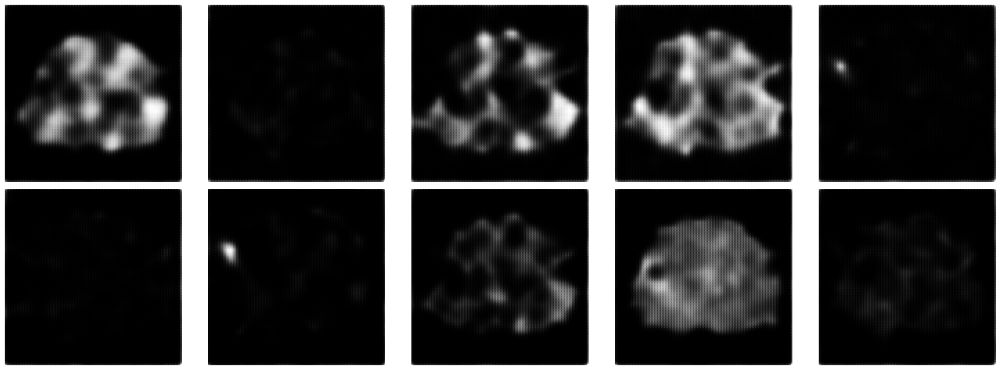

In [31]:
np.random.seed(SEED)
for epoch in range(10):
    for batch in tqdm(range(STEPS_PER_EPOCH)):

        noise = np.random.normal(0,1, size=(BATCH_SIZE, NOISE_DIM))
        fake_X = generator.predict(noise)
        
        idx = np.random.randint(0, X_train.shape[0], size=BATCH_SIZE)
        real_X = X_train[idx]

        X = np.concatenate((real_X, fake_X))

        disc_y = np.zeros(2*BATCH_SIZE)
        disc_y[:BATCH_SIZE] = 1

        d_loss = discriminator.train_on_batch(X, disc_y)
        
        y_gen = np.ones(BATCH_SIZE)
        g_loss = gan.train_on_batch(noise, y_gen)

    print(f"EPOCH: {epoch + 1} Generator Loss: {g_loss:.4f} Discriminator Loss: {d_loss:.4f}")
    noise = np.random.normal(0, 1, size=(10,NOISE_DIM))
    sample_images(noise, (2,5))

# Let's generate some images !

4/4 [==============================] - 2s 586ms/step


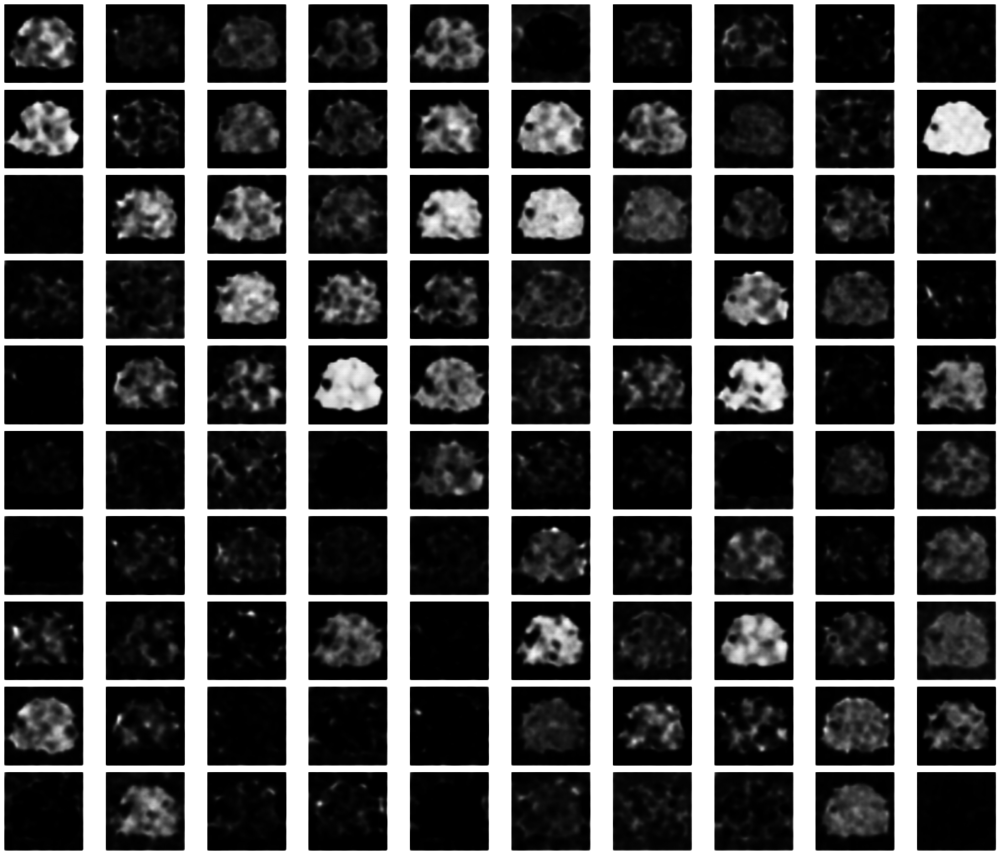

In [32]:
noise = np.random.normal(0, 1, size=(100, NOISE_DIM))
sample_images(noise, (10,10), (24,20), save=True)

# Testing the Generated sample: Plotting the Distributions

<p style="font-size:20px">In this test, we compare the generated images with the real samples by plotting their distributions. If the distributions overlap, that indicates the generated samples are very close to the real ones
</p>

In [33]:
generated_images = generator.predict(noise)
generated_images.shape

4/4 [==============================] - 1s 183ms/step


(100, 128, 128, 1)

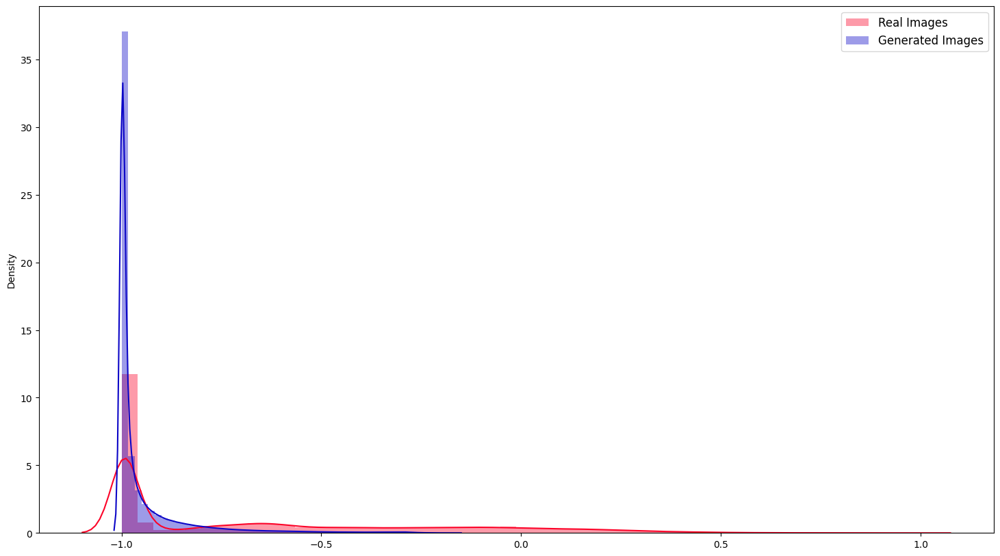

In [34]:
fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(18,10))

sns.distplot(X_train, label='Real Images', hist=True, color='#fc0328', ax=axs)
sns.distplot(generated_images, label='Generated Images', hist=True, color='#0c06c7', ax=axs)

axs.legend(loc='upper right', prop={'size': 12})

plt.show()

# Conclusion

<p style="font-size:20px">
    As we can see from the plot, the distribution of Generated Images is approximately the same as that of the Real Images. From this we can conclude that the generated images are a true representative of the real ones, capturing most of the variations.
</p>

# References

<p style="font-size:20px">
<ul>
    <li style="font-size:20px"><a href="https://arxiv.org/abs/1406.2661">Generative Adversarial Networks</a> (2014)</li>
    <li style="font-size:20px"><a href="https://arxiv.org/abs/1606.03498">Improved Techniques for Training GANs</a> (2016)</li>
    <li style="font-size:20px"><a href="https://arxiv.org/abs/2108.03235">SMOTified-GAN for class imbalanced pattern classification problems</a> (2021)</li>
</ul>
</p>